In [1]:
import gc
gc.collect()

123

# <font color='#cec748'>This notebook is to get the individual filters for all the galaxies</font>
The notebook uses data from the get_spec_example file to:
- w

## <font color='#e55730' size=3 >Imports</font>

In [2]:
from dustmaps.config import config
config.reset()

In [3]:
from hetdex_api.detections import Detections
import astropy.units as u
from astropy.coordinates import SkyCoord
from astropy.coordinates import match_coordinates_sky
from astropy.convolution import convolve, Gaussian1DKernel, Box1DKernel
import tables
import numpy as np
import os.path as op
import math
import os
import h5py

from elixer import global_config as G
G.GLOBAL_LOGGING = True
from elixer import spectrum_utilities as ESU
from elixer import catalogs


from hetdex_api.elixer_widget_cls import ElixerWidget
from hetdex_api.config import HDRconfig
from hetdex_tools.get_spec import get_spectra
from hetdex_api.shot import *
from hetdex_api.survey import FiberIndex
from hetdex_api.detections import Detections

from multiprocessing import Pool
from astropy.table import QTable, Table, Column
from scipy.ndimage import gaussian_filter1d
from scipy.interpolate import interp1d
from scipy import interpolate

import inspect
import scipy.stats as stats
from astropy.table import Table
from astropy.table import QTable, Table, Column
import warnings
from astropy.modeling import models
from specutils.spectra import Spectrum1D, SpectralRegion
from specutils.fitting import fit_generic_continuum
from specutils.fitting.continuum import fit_continuum
from lmfit.models import GaussianModel
from lmfit.models import ExponentialModel
from lmfit.models import DoniachModel
from lmfit.models import PseudoVoigtModel
from astropy.stats import biweight_location
from scipy.integrate import quad as quad
from numpy.polynomial.polynomial import polyfit
from numpy.polynomial.polynomial import polyval
from photutils.centroids import centroid_2dg, centroid_sources
from photutils.datasets import make_4gaussians_image
from numpy import inf
from photutils.datasets import make_4gaussians_image
from photutils.centroids import centroid_quadratic
from matplotlib.patches import Circle
import statistics
from scipy.interpolate import CubicSpline
import emcee
from scipy.optimize import minimize
from scipy.optimize import curve_fit
from matplotlib.backends.backend_pdf import PdfPages


Populating dustmaps config with /home/jovyan/Hobby-Eberly-Telesco/hdr3/calib/dustmaps


## <font color='#e55730' size=3 >Plotting imports and settings</font>

In [4]:
import matplotlib.pyplot as plt
import matplotlib
from matplotlib import rc
import matplotlib.ticker
import matplotlib.patches as patches

%matplotlib ipympl
plt.style.use('default')
plt.rcParams['axes.linewidth'] = 1.5
plt.rcParams.update({'font.size': 14})
plt.rcParams['lines.linewidth'] = 2
plt.rcParams['font.family'] = 'serif'
plt.rcParams['mathtext.fontset'] = 'dejavuserif'
plt.rcParams['mathtext.default'] = 'regular'
plt.rcParams['xtick.direction']= 'in'
plt.rcParams['ytick.direction']= 'in'
plt.rcParams['xtick.labelsize']= 14.0
plt.rcParams['ytick.labelsize']= 14.0

## <font color='#e55730' size=3 >Values</font>

In [5]:
c = 299792.5 #km s^-1
H_0 = 70 #km s^-1 MpC^-1
R = 800
PSF = 0.79
Mag_Zero_Point = 27 #mag

V = c/R
print(V)

374.740625


## <font color='#e55730' size=3 >Definitions</font>

In [6]:
# 1. Define the model
def gaussian(x, amp, wid):
    """1D Gaussian function."""
    return amp * np.exp(-0.5 * ((x - 0) / wid)**2)

def two_gaussian(x, amp1, wid1, amp2, wid2):
    """Sum of two 1D Gaussians."""
    return gaussian(x, amp1, wid1) + gaussian(x, amp2, wid2)

def Area_for_broad_and_narrow(amplitude, width):
    area = amplitude * np.sqrt(2*np.pi*width**2)
    return area

#def MC_Error_broad_narrow_area(x,amp,sig,err_amp_l, err_amp_p,err_sig_l, err_sig_p,num_run):
#    results = []
#
#    sd_amp = np.sqrt(max(err_amp_l, err_amp_p))
#    sd_sig = np.sqrt(max(err_sig_l, err_sig_p))
#
#
#
#    rand_amp = np.random.normal(amp, sd_amp, num_run)
#    rand_sig = np.random.normal(sig, sd_sig, num_run)
#
#    for i in np.arange(len(rand_amp)):
#        
#        results.append(np.trapz(gaussian(x, amp + rand_amp[i], sig + rand_sig[i]), x=x))
#        
#
#    results_sd = np.std(results)
#    results_variance = results_sd**2
#
#    return [results_sd, results_variance]


def MC_Error_broad_narrow_area(x, amp, sig, err_amp_l, err_amp_p, err_sig_l, err_sig_p, num_run):
    results = []
    
    # Calculate the asymmetric error bounds for amplitude and sigma
    lower_amp = amp - err_amp_l  # Lower bound for amplitude
    upper_amp = amp + err_amp_p  # Upper bound for amplitude
    
    lower_sig = sig - err_sig_l  # Lower bound for sigma
    upper_sig = sig + err_sig_p  # Upper bound for sigma

    # Randomly sample from a uniform distribution between the asymmetric error bounds
    rand_amp = np.random.uniform(lower_amp, upper_amp, num_run)
    rand_sig = np.random.uniform(lower_sig, upper_sig, num_run)

    # Calculate results using the random samples
    for i in np.arange(len(rand_amp)):
        results.append(np.trapz(gaussian(x, rand_amp[i], rand_sig[i]), x=x))

    # Calculate standard deviation of results (MC error) and variance
    results_sd = np.std(results)
    results_variance = results_sd**2

    return [results_sd, results_variance]



def MC_Error_Frac_broad_narrow_area(area_broad, area_narrow, area_broad_sd, area_narrow_sd, num_run=1000):
    results = []

    for _ in range(num_run):
        # Generate random fluctuations for broad and narrow areas based on their standard deviations
        rand_broad = np.random.uniform(area_broad - area_broad_sd, area_broad + area_broad_sd)
        rand_narrow = np.random.uniform(area_narrow - area_narrow_sd, area_narrow + area_narrow_sd)

    
        # Calculate the equation (area_broad + rand_broad) / (area_broad + rand_broad + area_narrow + rand_narrow)
        result = rand_broad / (area_broad + rand_narrow)
        results.append(result)

    # Convert results to a numpy array for easier manipulation
    results = np.array(results)

    # Calculate the mean and standard deviation of the results
    result_std = np.std(results)
    result_variance = np.var(results)

    return [result_std, result_variance]


#def MC_Error_flux(g_mag, g_mag_err, num_run):
#    results = []
#    results_sd_Array = []
#    results_variance_Array = []
#
#
#    for i in np.arange(len(g_mag)):
#        rand = []
#
#        g_mag_l = g_mag[i] - g_mag_err[i]  # Lower bound for magnitude
#        g_mag_p = g_mag[i] + g_mag_err[i]  # Upper bound for magnitude
#        
#        rand.append(np.random.uniform(g_mag_l, g_mag_p, num_run))
#    
#
#        for i in np.arange(len(rand)):
#        
#            results.append(10**( (1/-2.5) * (g_mag[i]+rand[i] - Mag_Zero_Point)))
#        
#            results_sd = np.std(results)
#
#            
#            results_sd_Array.append(results_sd)
#            results_variance_Array.append(results_sd**2)
#
#    return [results_sd_Array, results_variance_Array]


# Function to perform Monte Carlo error estimation using maximum and minimum errors
def MC_Error_flux(g_mag, g_mag_err, num_run):
    results_sd_Array = []
    results_variance_Array = []

    # Loop over all magnitudes
    for i in range(len(g_mag)):
        # Generate random samples within the bounds of the magnitude error (using uniform distribution)
        rand_mags = np.random.uniform(g_mag[i] - g_mag_err[i], g_mag[i] + g_mag_err[i], num_run)

        # Calculate the flux for each random magnitude sample
        flux_samples = 10**( (1/-2.5) * (rand_mags - Mag_Zero_Point)) #Jy
        
        # Calculate the standard deviation and variance of the flux samples
        results_sd = np.std(flux_samples)
        
        results_sd_Array.append(results_sd)
        results_variance_Array.append(results_sd**2)


    return [results_sd_Array, results_variance_Array]


def MC_Error_med_flux(flux, flux_sd, num_run):
    results = []
    rand = []


    for i in np.arange(len(flux)):
        val = []

        rand.append(np.random.uniform(flux[i] - flux_sd[i],flux[i] + flux_sd[i], num_run))
        

    ELL = []
    
    for i in np.arange((num_run)):
        EL = []
        for j in np.arange(len(rand)):
            first_elements = [rand[j][i]]
            
            EL.append(first_elements)

        ELL.append(EL)
        
    for h in np.arange(len(ELL)):
        results.append(np.median(ELL[h]))
       
    results_sd = np.std(results)
    results_variance = (results_sd**2)

    return [results_sd, results_variance]


def MC_Error_mag_tot(flux, flux_sd, num_run):
    results = []


    rand = np.random.normal(flux, flux_sd, num_run)


    for i in np.arange(len(rand)):
        
        results.append( -2.5*np.log10(rand[i]) + Mag_Zero_Point   )
        

    results_sd = np.std(results)
    results_variance = results_sd**2

    return [results_sd, results_variance]


def MC_Error_mag_gal(mag_tot, mag_tot_sd, frac_area_broad, frac_area_broad_sd, num_run):
    results = []


    rand_mag = np.random.normal(mag_tot, mag_tot_sd, num_run)
    rand_area = np.random.normal(frac_area_broad, frac_area_broad_sd, num_run)

    for i in np.arange(len(rand_mag)):
        
        results.append( (mag_tot+rand_mag[i]) - 2.5*np.log10((frac_area_broad+rand_area[i]))   )
        

    results_sd = np.std(results)
    results_variance = results_sd**2

    return [results_sd, results_variance]


def find_closest(list_of_numbers, target_number):
    """
    Finds the value in a list closest to a target number.

    Args:
        list_of_numbers: A list of numbers.
        target_number: The number to find the closest value to.

    Returns:
        The value in the list closest to the target number.
    """
    if not list_of_numbers:
        return None  # Handle empty list case

    closest_number = min(list_of_numbers, key=lambda x: abs(x - target_number))
    return closest_number

def find_point_of_increase(y_data):
    ind = []
    
    for i in np.arange(1, len(y_data), 1):
        low = y_data[i - 1]
        high = y_data[i]
        #print(i)
        #print(low, high)
        if low < high:
            ind.append(i-1)
        
    start_to_rise = min(ind)
    y_value = y_data[start_to_rise]

    return y_value, start_to_rise

def sersic_fit(x, I_e, r_e, n):
    """
    Computes a single Sérsic profile.
    """
    b_n = 2 * n - 1 / 3  # Approximate formula for b_n
    return I_e * np.exp(-b_n * ((x / r_e) ** (1 / n) - 1))

def sersic(x_data, y_data, I_e, r_e, n):
    popt, pcov = curve_fit(sersic_fit, x_data, y_data, p0=[I_e, r_e, n], bounds=(0, np.inf))
    b_n = 2 * popt[2] - 1 / 3 
    #print(len(popt[0] * np.exp(-b_n * ((x_data / popt[1]) ** (1 / popt[2]) - 1))))
    return popt[0] * np.exp(-b_n * ((x_data / popt[1]) ** (1 / popt[2]) - 1))

def gaussian_3(x, a, sigma):
    return a * np.exp(-((x - 0) ** 2) / (2 * sigma ** 2))

def Sersic_Gauss(x, i_e, r_e, n, a, sigma):
    
    Ser = sersic_fit(x, i_e, r_e, n)
    Gaus = gaussian_3(x, a, sigma)

    return Ser+Gaus

def getting_the_centers(data):
    
    Centroid_X_Array = []
    Centroid_Y_Array = []
    
    for i in np.arange(len(data)):
        X, Y = centroid_quadratic(data[i], xpeak=42, ypeak=43, search_boxsize = 21)
        #print(i)
        Centroid_X_Array.append(X)
        Centroid_Y_Array.append(Y)

    return Centroid_X_Array, Centroid_Y_Array

def getting_the_centers_a(data):
    
    Centroid_X_Array = []
    Centroid_Y_Array = []
    
    for i in np.arange(len(data)):
        X, Y = centroid_quadratic(data[i], xpeak=45, ypeak=47, search_boxsize = 25)
        #print(i)
        Centroid_X_Array.append(X)
        Centroid_Y_Array.append(Y)

    return Centroid_X_Array, Centroid_Y_Array

def shifting_in_the_y_direction(data, y_center):

    shifted_y_array = []

    for i in np.arange(len(data)):
        dif_y = y_center[i] - len(data[i])/2

        #print(dif_y)
        if dif_y > 0:
            shift_y_pos = np.delete(data[i], slice(0,int(dif_y)),0)#This moves everything down ... #Array, slice(start,stop), 0=row 1=column
            zero_col = np.zeros((int(dif_y), shift_y_pos.shape[1]))
            shifted = np.vstack((shift_y_pos, zero_col))
            shifted_y_array.append(shifted)
            #print(len(shifted))

        if dif_y < 0:
            shift_y_pos = np.delete(data[i], slice(len(data[i]) + int(dif_y), len(data[i])),0)#This moves everything up ... #Array, slice(start,stop), 0=row 1=column
            #print("dif_y = " +str(dif_y))
            #print("Shift_y_pos = " +str(len(shift_y_pos)))
            zero_col = np.zeros((abs(int(dif_y)), shift_y_pos.shape[1]))
            #print("zero_col = " +str(len(zero_col)))
            shifted = np.vstack((zero_col, shift_y_pos))
            shifted_y_array.append(shifted)
            #print("shifted = " +str(len(shifted)))

        else:
            continue

    return shifted_y_array

def shifting_in_the_x_direction(data, x_center):

    shifted_x_array = []

    for i in np.arange(len(data)):
        dif_x = x_center[i] - len(data[i])/2

        #print(dif_x)
        if dif_x > 0:
            shift_x_pos = np.delete(data[i], slice(0,int(dif_x)),1)#This moves everything left ... #Array, slice(start,stop), 0=row 1=column
            zero_col = np.zeros((shift_x_pos.shape[0], int(dif_x)))
            shifted = np.hstack((shift_x_pos, zero_col))
            shifted_x_array.append(shifted)
            #print(len(shifted))
        if dif_x < 0:
            shift_x_pos = np.delete(data[i], slice(len(data[i]) + int(dif_x), len(data[i])),1)#This moves everything right ... #Array, slice(start,stop), 0=row 1=column
            #print("dif_x = " +str(dif_x))
            #print("Shift_y_pos = " +str(len(shift_x_pos)))
            zero_col = np.zeros((shift_x_pos.shape[0], abs(int(dif_x))))
            #print("zero_col = " +str(len(zero_col)))
            shifted = np.hstack((zero_col, shift_x_pos))
            shifted_x_array.append(shifted)
            #print("shifted = " +str(len(shifted)))
        else:
            continue

    return shifted_x_array

def single_rows(data, num):
    Single_Row_Arrays = []
    
    for i in data:
        single_row_array = i[num]
        Single_Row_Arrays.append(single_row_array)

    return Single_Row_Arrays

def all_the_rows(data):
    
    All_the_Single_Rows = []

    for i in np.arange(data[0].shape[1]):
        All_the_Single_Rows.append(single_rows(data, i))

    return All_the_Single_Rows

def row_median(all_the_single_rows):
    Row_Median = []

    for i in all_the_single_rows:
        Row_median = np.median(i, axis=0)
        Row_Median.append(Row_median)

    return Row_Median

def mag(flux_ratio, mag_2):
    mag_1 = -2.5*np.log10(flux_ratio) + mag_2

    return mag_1

def absolute_mag(z, apparent_mag):

    def integrand(redshift):
        return 1/(np.sqrt(0.3*(1+redshift)**3+0.7))
    
    dm = ((c/H_0) * quad(integrand,0,z)[0])

    dl = ((1+z)*dm) * 10**6
    
    absolute_mag = -5*np.log10(dl) + 5 + apparent_mag

    return absolute_mag

def luminosity(Abs_Mag):
    lum = (3.828*10**26) * 10 ** (0.4*(np.subtract(4.83, Abs_Mag)))

    return lum

def mass_from_lum(lum):
    mass = (lum/(3.828*10**26))**(2/7) #* (1.989*10**30)
    return mass

def sersic_fit_Fixed(x, I_e, r_e):
    """
    Computes a single Sérsic profile.
    """
    b_n = 2 * 1 - 1 / 3  # Approximate formula for b_n
    return I_e * np.exp(-b_n * ((x / r_e) ** (1 / 1) - 1))

def gaussian_3_Fixed(x, a):
    return a * np.exp(-((x - 0) ** 2) / (2 * PSF ** 2))

def Sersic_Gauss_Fixed(x, i_e, r_e, a):
    
    Ser = sersic_fit_Fixed(x, i_e, r_e)
    Gaus = gaussian_3_Fixed(x, a)

    return Ser+Gaus

## <font color='#e55730' size=3 >Creating Files</font>

In [7]:
File_Redshift_Confirmed = "Table_Spec_Redshift_Confirmed_New_Old.fits"


In [8]:
Data_Redshift_Confirmed = Table.read(File_Redshift_Confirmed, format = 'fits')


In [9]:
catlib = catalogs.CatalogLibrary()

In [10]:
#Let's just do 6 for now
##Making the groups


z_025_035 = []
z_035_045 = []
z_045_055 = []
z_055_065 = []
z_065_075 = []
z_075_085 = []
z_085_096 = []

z_025_035_index = []
z_035_045_index = []
z_045_055_index = []
z_055_065_index = []
z_065_075_index = []
z_075_085_index = []
z_085_096_index = [] 


a = -1
for i in Data_Redshift_Confirmed["z"]:
    a = a+1
    #print(i)
    if 0.25 <= i <= 0.35:
        #print(i)
        z_025_035.append(i)
        z_025_035_index.append(a)
    if 0.35 <= i <= 0.45:
        z_035_045.append(i)
        z_035_045_index.append(a)
    if 0.45 <= i <= 0.55:
        z_045_055.append(i)
        z_045_055_index.append(a)
    if 0.55 <= i <= 0.65:
        z_055_065.append(i)
        z_055_065_index.append(a)
    if 0.65 <= i <= 0.75:
        z_065_075.append(i)
        z_065_075_index.append(a)
    if 0.75 <= i <= 0.85:
        z_075_085.append(i)
        z_075_085_index.append(a)
    if 0.85<= i <= 0.96:
        z_085_096.append(i)
        z_085_096_index.append(a)
    else:
        continue

## <font color='#e55730' size=3 >Opening Files</font>

In [11]:
G_File_Filters_025_035 = "Table_Filters_025_035_G.fits"
R_File_Filters_025_035 = "Table_Filters_025_035_R.fits"
I_File_Filters_025_035 = "Table_Filters_025_035_I.fits"
Z_File_Filters_025_035 = "Table_Filters_025_035_Z.fits"
Y_File_Filters_025_035 = "Table_Filters_025_035_Y.fits"


G_File_Filters_035_045 = "Table_Filters_035_045_G.fits"
R_File_Filters_035_045 = "Table_Filters_035_045_R.fits"
I_File_Filters_035_045 = "Table_Filters_035_045_I.fits"
Z_File_Filters_035_045 = "Table_Filters_035_045_Z.fits"
Y_File_Filters_035_045 = "Table_Filters_035_045_Y.fits"


G_File_Filters_045_055 = "Table_Filters_045_055_G.fits"
R_File_Filters_045_055 = "Table_Filters_045_055_R.fits"
I_File_Filters_045_055 = "Table_Filters_045_055_I.fits"
Z_File_Filters_045_055 = "Table_Filters_045_055_Z.fits"
Y_File_Filters_045_055 = "Table_Filters_045_055_Y.fits"

G_File_Filters_055_065 = "Table_Filters_055_065_G.fits"
R_File_Filters_055_065 = "Table_Filters_055_065_R.fits"
I_File_Filters_055_065 = "Table_Filters_055_065_I.fits"
Z_File_Filters_055_065 = "Table_Filters_055_065_Z.fits"
Y_File_Filters_055_065 = "Table_Filters_055_065_Y.fits"

G_File_Filters_065_075 = "Table_Filters_065_075_G.fits"
R_File_Filters_065_075 = "Table_Filters_065_075_R.fits"
I_File_Filters_065_075 = "Table_Filters_065_075_I.fits"
Z_File_Filters_065_075 = "Table_Filters_065_075_Z.fits"
Y_File_Filters_065_075 = "Table_Filters_065_075_Y.fits"

G_File_Filters_075_085 = "Table_Filters_075_085_G.fits"
R_File_Filters_075_085 = "Table_Filters_075_085_R.fits"
I_File_Filters_075_085 = "Table_Filters_075_085_I.fits"
Z_File_Filters_075_085 = "Table_Filters_075_085_Z.fits"
Y_File_Filters_075_085 = "Table_Filters_075_085_Y.fits"

G_File_Filters_085_096 = "Table_Filters_085_096_G.fits"
R_File_Filters_085_096 = "Table_Filters_085_096_R.fits"
I_File_Filters_085_096 = "Table_Filters_085_096_I.fits"
Z_File_Filters_085_096 = "Table_Filters_085_096_Z.fits"
Y_File_Filters_085_096 = "Table_Filters_085_096_Y.fits"



In [12]:
G_Filters_025_035 = Table.read(G_File_Filters_025_035, format = 'fits')
R_Filters_025_035 = Table.read(R_File_Filters_025_035, format = 'fits')
I_Filters_025_035 = Table.read(I_File_Filters_025_035, format = 'fits')
Z_Filters_025_035 = Table.read(Z_File_Filters_025_035, format = 'fits')
Y_Filters_025_035 = Table.read(Y_File_Filters_025_035, format = 'fits')


G_Filters_035_045 = Table.read(G_File_Filters_035_045, format = 'fits')
R_Filters_035_045 = Table.read(R_File_Filters_035_045, format = 'fits')
I_Filters_035_045 = Table.read(I_File_Filters_035_045, format = 'fits')
Z_Filters_035_045 = Table.read(Z_File_Filters_035_045, format = 'fits')
Y_Filters_035_045 = Table.read(Y_File_Filters_035_045, format = 'fits')


G_Filters_045_055 = Table.read(G_File_Filters_045_055, format = 'fits')
R_Filters_045_055 = Table.read(R_File_Filters_045_055, format = 'fits')
I_Filters_045_055 = Table.read(I_File_Filters_045_055, format = 'fits')
Z_Filters_045_055 = Table.read(Z_File_Filters_045_055, format = 'fits')
Y_Filters_045_055 = Table.read(Y_File_Filters_045_055, format = 'fits')


G_Filters_055_065 = Table.read(G_File_Filters_055_065, format = 'fits')
R_Filters_055_065 = Table.read(R_File_Filters_055_065, format = 'fits')
I_Filters_055_065 = Table.read(I_File_Filters_055_065, format = 'fits')
Z_Filters_055_065 = Table.read(Z_File_Filters_055_065, format = 'fits')
Y_Filters_055_065 = Table.read(Y_File_Filters_055_065, format = 'fits')


G_Filters_065_075 = Table.read(G_File_Filters_065_075, format = 'fits')
R_Filters_065_075 = Table.read(R_File_Filters_065_075, format = 'fits')
I_Filters_065_075 = Table.read(I_File_Filters_065_075, format = 'fits')
Z_Filters_065_075 = Table.read(Z_File_Filters_065_075, format = 'fits')
Y_Filters_065_075 = Table.read(Y_File_Filters_065_075, format = 'fits')


G_Filters_075_085 = Table.read(G_File_Filters_075_085, format = 'fits')
R_Filters_075_085 = Table.read(R_File_Filters_075_085, format = 'fits')
I_Filters_075_085 = Table.read(I_File_Filters_075_085, format = 'fits')
Z_Filters_075_085 = Table.read(Z_File_Filters_075_085, format = 'fits')
Y_Filters_075_085 = Table.read(Y_File_Filters_075_085, format = 'fits')

G_Filters_085_096 = Table.read(G_File_Filters_085_096, format = 'fits')
R_Filters_085_096 = Table.read(R_File_Filters_085_096, format = 'fits')
I_Filters_085_096 = Table.read(I_File_Filters_085_096, format = 'fits')
Z_Filters_085_096 = Table.read(Z_File_Filters_085_096, format = 'fits')
Y_Filters_085_096 = Table.read(Y_File_Filters_085_096, format = 'fits')

In [13]:
G_Filters_025_035 = Table(G_Filters_025_035)
R_Filters_025_035 = Table(R_Filters_025_035)
I_Filters_025_035 = Table(I_Filters_025_035)
Z_Filters_025_035 = Table(Z_Filters_025_035)
Y_Filters_025_035 = Table(Y_Filters_025_035)

G_Filters_035_045 = Table(G_Filters_035_045)
R_Filters_035_045 = Table(R_Filters_035_045)
I_Filters_035_045 = Table(I_Filters_035_045)
Z_Filters_035_045 = Table(Z_Filters_035_045)
Y_Filters_035_045 = Table(Y_Filters_035_045)


G_Filters_045_055 = Table(G_Filters_045_055)
R_Filters_045_055 = Table(R_Filters_045_055)
I_Filters_045_055 = Table(I_Filters_045_055)
Z_Filters_045_055 = Table(Z_Filters_045_055)
Y_Filters_045_055 = Table(Y_Filters_045_055)


G_Filters_055_065 = Table(G_Filters_055_065)
R_Filters_055_065 = Table(R_Filters_055_065)
I_Filters_055_065 = Table(I_Filters_055_065)
Z_Filters_055_065 = Table(Z_Filters_055_065)
Y_Filters_055_065 = Table(Y_Filters_055_065)


G_Filters_065_075 = Table(G_Filters_065_075)
R_Filters_065_075 = Table(R_Filters_065_075)
I_Filters_065_075 = Table(I_Filters_065_075)
Z_Filters_065_075 = Table(Z_Filters_065_075)
Y_Filters_065_075 = Table(Y_Filters_065_075)


G_Filters_075_085 = Table(G_Filters_075_085)
R_Filters_075_085 = Table(R_Filters_075_085)
I_Filters_075_085 = Table(I_Filters_075_085)
Z_Filters_075_085 = Table(Z_Filters_075_085)
Y_Filters_075_085 = Table(Y_Filters_075_085)


G_Filters_085_096 = Table(G_Filters_085_096)
R_Filters_085_096 = Table(R_Filters_085_096)
I_Filters_085_096 = Table(I_Filters_085_096)
Z_Filters_085_096 = Table(Z_Filters_085_096)
Y_Filters_085_096 = Table(Y_Filters_085_096)


In [14]:
G_Filters_025_035.remove_row(1) #These are not the index numbers because removing a value changes the index for the next one
G_Filters_025_035.remove_row(6)
G_Filters_025_035.remove_row(25)
G_Filters_025_035.remove_row(25)

G_Filters_035_045.remove_row(18)
G_Filters_035_045.remove_row(24)
G_Filters_035_045.remove_row(29)
G_Filters_035_045.remove_row(37)
G_Filters_035_045.remove_row(49)
G_Filters_035_045.remove_row(60)
G_Filters_035_045.remove_row(77)
G_Filters_035_045.remove_row(80)


G_Filters_045_055.remove_row(3)
G_Filters_045_055.remove_row(14)
G_Filters_045_055.remove_row(23)
G_Filters_045_055.remove_row(35)
G_Filters_045_055.remove_row(50)

G_Filters_055_065.remove_row(12)
G_Filters_055_065.remove_row(13)
G_Filters_055_065.remove_row(21)
G_Filters_055_065.remove_row(37)
G_Filters_055_065.remove_row(39)
G_Filters_055_065.remove_row(48)


G_Filters_065_075.remove_row(6)
G_Filters_065_075.remove_row(9)
G_Filters_065_075.remove_row(53)

G_Filters_075_085.remove_row(16)
G_Filters_075_085.remove_row(17)
G_Filters_075_085.remove_row(43)
G_Filters_075_085.remove_row(59)


G_Filters_085_096.remove_row(5)
G_Filters_085_096.remove_row(8)
G_Filters_085_096.remove_row(29)
G_Filters_085_096.remove_row(40)
G_Filters_085_096.remove_row(59)
G_Filters_085_096.remove_row(84)







R_Filters_025_035.remove_row(1)
R_Filters_025_035.remove_row(26)
R_Filters_025_035.remove_row(26)

R_Filters_035_045.remove_row(18)
R_Filters_035_045.remove_row(22)
R_Filters_035_045.remove_row(23)
R_Filters_035_045.remove_row(28)
R_Filters_035_045.remove_row(36)
R_Filters_035_045.remove_row(41)
R_Filters_035_045.remove_row(47)
R_Filters_035_045.remove_row(47)
R_Filters_035_045.remove_row(52)
R_Filters_035_045.remove_row(56)
R_Filters_035_045.remove_row(73)
R_Filters_035_045.remove_row(75)
R_Filters_035_045.remove_row(75)

R_Filters_045_055.remove_row(3)
R_Filters_045_055.remove_row(10)
R_Filters_045_055.remove_row(13)
R_Filters_045_055.remove_row(15)
R_Filters_045_055.remove_row(21)
R_Filters_045_055.remove_row(33)
R_Filters_045_055.remove_row(43)
R_Filters_045_055.remove_row(47)

R_Filters_055_065.remove_row(7)
R_Filters_055_065.remove_row(11)
R_Filters_055_065.remove_row(12)
R_Filters_055_065.remove_row(12)
R_Filters_055_065.remove_row(19)
R_Filters_055_065.remove_row(25)
R_Filters_055_065.remove_row(34)
R_Filters_055_065.remove_row(36)
R_Filters_055_065.remove_row(45)

R_Filters_065_075.remove_row(6)
R_Filters_065_075.remove_row(9)
R_Filters_065_075.remove_row(15)
R_Filters_065_075.remove_row(26)

R_Filters_075_085.remove_row(16)
R_Filters_075_085.remove_row(17)
R_Filters_075_085.remove_row(18)
R_Filters_075_085.remove_row(18)
R_Filters_075_085.remove_row(18)
R_Filters_075_085.remove_row(40)
R_Filters_075_085.remove_row(48)
R_Filters_075_085.remove_row(55)
R_Filters_075_085.remove_row(74)

R_Filters_085_096.remove_row(5)
R_Filters_085_096.remove_row(8)
R_Filters_085_096.remove_row(35)
R_Filters_085_096.remove_row(40)
R_Filters_085_096.remove_row(59)
R_Filters_085_096.remove_row(84)





I_Filters_025_035.remove_row(1)
I_Filters_025_035.remove_row(23)

I_Filters_035_045.remove_row(1)
I_Filters_035_045.remove_row(15)
I_Filters_035_045.remove_row(15)
I_Filters_035_045.remove_row(16)
I_Filters_035_045.remove_row(20)
I_Filters_035_045.remove_row(28)
I_Filters_035_045.remove_row(35)
I_Filters_035_045.remove_row(46)
I_Filters_035_045.remove_row(60)
I_Filters_035_045.remove_row(60)
I_Filters_035_045.remove_row(62)
I_Filters_035_045.remove_row(62)

I_Filters_045_055.remove_row(3)
I_Filters_045_055.remove_row(6)
I_Filters_045_055.remove_row(8)
I_Filters_045_055.remove_row(10)
I_Filters_045_055.remove_row(15)
I_Filters_045_055.remove_row(22)
I_Filters_045_055.remove_row(24)
I_Filters_045_055.remove_row(31)
I_Filters_045_055.remove_row(35)

I_Filters_055_065.remove_row(10)
I_Filters_055_065.remove_row(11)
I_Filters_055_065.remove_row(11)
I_Filters_055_065.remove_row(13)
I_Filters_055_065.remove_row(16)
I_Filters_055_065.remove_row(24)
I_Filters_055_065.remove_row(28)
I_Filters_055_065.remove_row(35)
I_Filters_055_065.remove_row(35)

I_Filters_065_075.remove_row(6)
I_Filters_065_075.remove_row(8)
I_Filters_065_075.remove_row(8)
I_Filters_065_075.remove_row(13)
I_Filters_065_075.remove_row(13)
I_Filters_065_075.remove_row(13)
I_Filters_065_075.remove_row(18)
I_Filters_065_075.remove_row(20)
I_Filters_065_075.remove_row(27)
I_Filters_065_075.remove_row(35)
I_Filters_065_075.remove_row(38)

I_Filters_075_085.remove_row(5)
I_Filters_075_085.remove_row(12)
I_Filters_075_085.remove_row(12)
I_Filters_075_085.remove_row(13)
I_Filters_075_085.remove_row(13)
I_Filters_075_085.remove_row(13)
I_Filters_075_085.remove_row(30)
I_Filters_075_085.remove_row(30)
I_Filters_075_085.remove_row(36)
I_Filters_075_085.remove_row(41)
I_Filters_075_085.remove_row(41)
I_Filters_075_085.remove_row(47)

I_Filters_085_096.remove_row(5)
I_Filters_085_096.remove_row(7)
I_Filters_085_096.remove_row(14)
I_Filters_085_096.remove_row(14)
I_Filters_085_096.remove_row(28)
I_Filters_085_096.remove_row(32)
I_Filters_085_096.remove_row(35)
I_Filters_085_096.remove_row(48)
I_Filters_085_096.remove_row(58)
I_Filters_085_096.remove_row(70)
I_Filters_085_096.remove_row(70)








Z_Filters_025_035.remove_row(20)
Z_Filters_025_035.remove_row(26)

Z_Filters_035_045.remove_row(2)
Z_Filters_035_045.remove_row(17)
Z_Filters_035_045.remove_row(21)
Z_Filters_035_045.remove_row(28)
Z_Filters_035_045.remove_row(44)
Z_Filters_035_045.remove_row(47)
Z_Filters_035_045.remove_row(74)

Z_Filters_045_055.remove_row(11)
Z_Filters_045_055.remove_row(14)
Z_Filters_045_055.remove_row(23)
Z_Filters_045_055.remove_row(25)
Z_Filters_045_055.remove_row(41)
Z_Filters_045_055.remove_row(49)

Z_Filters_055_065.remove_row(12)
Z_Filters_055_065.remove_row(13)
Z_Filters_055_065.remove_row(21)
Z_Filters_055_065.remove_row(36)
Z_Filters_055_065.remove_row(38)
Z_Filters_055_065.remove_row(47)

Z_Filters_065_075.remove_row(6)
Z_Filters_065_075.remove_row(8)
Z_Filters_065_075.remove_row(8)
Z_Filters_065_075.remove_row(14)
Z_Filters_065_075.remove_row(25)
Z_Filters_065_075.remove_row(26)
Z_Filters_065_075.remove_row(43)
Z_Filters_065_075.remove_row(47)

Z_Filters_075_085.remove_row(16)
Z_Filters_075_085.remove_row(17)
Z_Filters_075_085.remove_row(18)
Z_Filters_075_085.remove_row(18)
Z_Filters_075_085.remove_row(18)
Z_Filters_075_085.remove_row(26)
Z_Filters_075_085.remove_row(39)
Z_Filters_075_085.remove_row(47)
Z_Filters_075_085.remove_row(52)
Z_Filters_075_085.remove_row(63)

Z_Filters_085_096.remove_row(5)
Z_Filters_085_096.remove_row(5)
Z_Filters_085_096.remove_row(7)
Z_Filters_085_096.remove_row(18)
Z_Filters_085_096.remove_row(39)
Z_Filters_085_096.remove_row(58)
Z_Filters_085_096.remove_row(67)
Z_Filters_085_096.remove_row(68)
Z_Filters_085_096.remove_row(81)





Y_Filters_025_035.remove_row(1)
Y_Filters_025_035.remove_row(20)
Y_Filters_025_035.remove_row(20)

Y_Filters_035_045.remove_row(2)
Y_Filters_035_045.remove_row(10)
Y_Filters_035_045.remove_row(12)
Y_Filters_035_045.remove_row(15)
Y_Filters_035_045.remove_row(22)
Y_Filters_035_045.remove_row(37)
Y_Filters_035_045.remove_row(49)
Y_Filters_035_045.remove_row(53)

Y_Filters_045_055.remove_row(6)
Y_Filters_045_055.remove_row(8)
Y_Filters_045_055.remove_row(10)
Y_Filters_045_055.remove_row(13)
Y_Filters_045_055.remove_row(21)
Y_Filters_045_055.remove_row(22)

Y_Filters_055_065.remove_row(2)
Y_Filters_055_065.remove_row(8)
Y_Filters_055_065.remove_row(12)
Y_Filters_055_065.remove_row(28)
Y_Filters_055_065.remove_row(28)

Y_Filters_065_075.remove_row(5)
Y_Filters_065_075.remove_row(12)
Y_Filters_065_075.remove_row(37)

Y_Filters_075_085.remove_row(4)
Y_Filters_075_085.remove_row(8)
Y_Filters_075_085.remove_row(8)
Y_Filters_075_085.remove_row(15)
Y_Filters_075_085.remove_row(25)
Y_Filters_075_085.remove_row(30)

Y_Filters_085_096.remove_row(7)
Y_Filters_085_096.remove_row(12)
Y_Filters_085_096.remove_row(17)
Y_Filters_085_096.remove_row(19)
Y_Filters_085_096.remove_row(42)
Y_Filters_085_096.remove_row(52)
Y_Filters_085_096.remove_row(59)





In [15]:
hstack_for_max = np.array([len(G_Filters_025_035["G_Detect_ID"]), len(G_Filters_035_045["G_Detect_ID"]), len(G_Filters_045_055["G_Detect_ID"]), len(G_Filters_055_065["G_Detect_ID"]), len(G_Filters_065_075["G_Detect_ID"]), len(G_Filters_075_085["G_Detect_ID"]), len(G_Filters_085_096["G_Detect_ID"]), len(R_Filters_025_035["R_Detect_ID"]), len(R_Filters_035_045["R_Detect_ID"]), len(R_Filters_045_055["R_Detect_ID"]), len(R_Filters_055_065["R_Detect_ID"]), len(R_Filters_065_075["R_Detect_ID"]), len(R_Filters_075_085["R_Detect_ID"]), len(R_Filters_085_096["R_Detect_ID"]), len(I_Filters_025_035["I_Detect_ID"]), len(I_Filters_035_045["I_Detect_ID"]), len(I_Filters_045_055["I_Detect_ID"]), len(I_Filters_055_065["I_Detect_ID"]), len(I_Filters_065_075["I_Detect_ID"]), len(I_Filters_075_085["I_Detect_ID"]), len(I_Filters_085_096["I_Detect_ID"]), len(Z_Filters_025_035["Z_Detect_ID"]), len(Z_Filters_035_045["Z_Detect_ID"]), len(Z_Filters_045_055["Z_Detect_ID"]), len(Z_Filters_055_065["Z_Detect_ID"]), len(Z_Filters_065_075["Z_Detect_ID"]), len(Z_Filters_075_085["Z_Detect_ID"]), len(Z_Filters_085_096["Z_Detect_ID"]), len(Y_Filters_025_035["Y_Detect_ID"]), len(Y_Filters_035_045["Y_Detect_ID"]), len(Y_Filters_045_055["Y_Detect_ID"]), len(Y_Filters_055_065["Y_Detect_ID"]), len(Y_Filters_065_075["Y_Detect_ID"]), len(Y_Filters_075_085["Y_Detect_ID"]), len(Y_Filters_085_096["Y_Detect_ID"])])
max_num_zeros = max(hstack_for_max)



G_Filters_For_Table_025_035 =  np.pad(G_Filters_025_035["G_Detect_ID"], (0, max_num_zeros - len(G_Filters_025_035["G_Detect_ID"])), 'constant')
R_Filters_For_Table_025_035 =  np.pad(R_Filters_025_035["R_Detect_ID"], (0, max_num_zeros - len(R_Filters_025_035["R_Detect_ID"])), 'constant')
I_Filters_For_Table_025_035 =  np.pad(I_Filters_025_035["I_Detect_ID"], (0, max_num_zeros - len(I_Filters_025_035["I_Detect_ID"])), 'constant')
Z_Filters_For_Table_025_035 =  np.pad(Z_Filters_025_035["Z_Detect_ID"], (0, max_num_zeros - len(Z_Filters_025_035["Z_Detect_ID"])), 'constant')
Y_Filters_For_Table_025_035 =  np.pad(Y_Filters_025_035["Y_Detect_ID"], (0, max_num_zeros - len(Y_Filters_025_035["Y_Detect_ID"])), 'constant')
G_Filters_For_Table_035_045 =  np.pad(G_Filters_035_045["G_Detect_ID"], (0, max_num_zeros - len(G_Filters_035_045["G_Detect_ID"])), 'constant')
R_Filters_For_Table_035_045 =  np.pad(R_Filters_035_045["R_Detect_ID"], (0, max_num_zeros - len(R_Filters_035_045["R_Detect_ID"])), 'constant')
I_Filters_For_Table_035_045 =  np.pad(I_Filters_035_045["I_Detect_ID"], (0, max_num_zeros - len(I_Filters_035_045["I_Detect_ID"])), 'constant')
Z_Filters_For_Table_035_045 =  np.pad(Z_Filters_035_045["Z_Detect_ID"], (0, max_num_zeros - len(Z_Filters_035_045["Z_Detect_ID"])), 'constant')
Y_Filters_For_Table_035_045 =  np.pad(Y_Filters_035_045["Y_Detect_ID"], (0, max_num_zeros - len(Y_Filters_035_045["Y_Detect_ID"])), 'constant')
G_Filters_For_Table_045_055 =  np.pad(G_Filters_045_055["G_Detect_ID"], (0, max_num_zeros - len(G_Filters_045_055["G_Detect_ID"])), 'constant')
R_Filters_For_Table_045_055 =  np.pad(R_Filters_045_055["R_Detect_ID"], (0, max_num_zeros - len(R_Filters_045_055["R_Detect_ID"])), 'constant')
I_Filters_For_Table_045_055 =  np.pad(I_Filters_045_055["I_Detect_ID"], (0, max_num_zeros - len(I_Filters_045_055["I_Detect_ID"])), 'constant')
Z_Filters_For_Table_045_055 =  np.pad(Z_Filters_045_055["Z_Detect_ID"], (0, max_num_zeros - len(Z_Filters_045_055["Z_Detect_ID"])), 'constant')
Y_Filters_For_Table_045_055 =  np.pad(Y_Filters_045_055["Y_Detect_ID"], (0, max_num_zeros - len(Y_Filters_045_055["Y_Detect_ID"])), 'constant')
G_Filters_For_Table_055_065 =  np.pad(G_Filters_055_065["G_Detect_ID"], (0, max_num_zeros - len(G_Filters_055_065["G_Detect_ID"])), 'constant')
R_Filters_For_Table_055_065 =  np.pad(R_Filters_055_065["R_Detect_ID"], (0, max_num_zeros - len(R_Filters_055_065["R_Detect_ID"])), 'constant')
I_Filters_For_Table_055_065 =  np.pad(I_Filters_055_065["I_Detect_ID"], (0, max_num_zeros - len(I_Filters_055_065["I_Detect_ID"])), 'constant')
Z_Filters_For_Table_055_065 =  np.pad(Z_Filters_055_065["Z_Detect_ID"], (0, max_num_zeros - len(Z_Filters_055_065["Z_Detect_ID"])), 'constant')
Y_Filters_For_Table_055_065 =  np.pad(Y_Filters_055_065["Y_Detect_ID"], (0, max_num_zeros - len(Y_Filters_055_065["Y_Detect_ID"])), 'constant')
G_Filters_For_Table_065_075 =  np.pad(G_Filters_065_075["G_Detect_ID"], (0, max_num_zeros - len(G_Filters_065_075["G_Detect_ID"])), 'constant')
R_Filters_For_Table_065_075 =  np.pad(R_Filters_065_075["R_Detect_ID"], (0, max_num_zeros - len(R_Filters_065_075["R_Detect_ID"])), 'constant')
I_Filters_For_Table_065_075 =  np.pad(I_Filters_065_075["I_Detect_ID"], (0, max_num_zeros - len(I_Filters_065_075["I_Detect_ID"])), 'constant')
Z_Filters_For_Table_065_075 =  np.pad(Z_Filters_065_075["Z_Detect_ID"], (0, max_num_zeros - len(Z_Filters_065_075["Z_Detect_ID"])), 'constant')
Y_Filters_For_Table_065_075 =  np.pad(Y_Filters_065_075["Y_Detect_ID"], (0, max_num_zeros - len(Y_Filters_065_075["Y_Detect_ID"])), 'constant')
G_Filters_For_Table_075_085 =  np.pad(G_Filters_075_085["G_Detect_ID"], (0, max_num_zeros - len(G_Filters_075_085["G_Detect_ID"])), 'constant')
R_Filters_For_Table_075_085 =  np.pad(R_Filters_075_085["R_Detect_ID"], (0, max_num_zeros - len(R_Filters_075_085["R_Detect_ID"])), 'constant')
I_Filters_For_Table_075_085 =  np.pad(I_Filters_075_085["I_Detect_ID"], (0, max_num_zeros - len(I_Filters_075_085["I_Detect_ID"])), 'constant')
Z_Filters_For_Table_075_085 =  np.pad(Z_Filters_075_085["Z_Detect_ID"], (0, max_num_zeros - len(Z_Filters_075_085["Z_Detect_ID"])), 'constant')
Y_Filters_For_Table_075_085 =  np.pad(Y_Filters_075_085["Y_Detect_ID"], (0, max_num_zeros - len(Y_Filters_075_085["Y_Detect_ID"])), 'constant')
G_Filters_For_Table_085_096 =  np.pad(G_Filters_085_096["G_Detect_ID"], (0, max_num_zeros - len(G_Filters_085_096["G_Detect_ID"])), 'constant')
R_Filters_For_Table_085_096 =  np.pad(R_Filters_085_096["R_Detect_ID"], (0, max_num_zeros - len(R_Filters_085_096["R_Detect_ID"])), 'constant')
I_Filters_For_Table_085_096 =  np.pad(I_Filters_085_096["I_Detect_ID"], (0, max_num_zeros - len(I_Filters_085_096["I_Detect_ID"])), 'constant')
Z_Filters_For_Table_085_096 =  np.pad(Z_Filters_085_096["Z_Detect_ID"], (0, max_num_zeros - len(Z_Filters_085_096["Z_Detect_ID"])), 'constant')
Y_Filters_For_Table_085_096 =  np.pad(Y_Filters_085_096["Y_Detect_ID"], (0, max_num_zeros - len(Y_Filters_085_096["Y_Detect_ID"])), 'constant')



print(len(G_Filters_For_Table_025_035))
print(len(R_Filters_For_Table_025_035))
print(len(I_Filters_For_Table_025_035))
print(len(Z_Filters_For_Table_025_035))
print(len(Y_Filters_For_Table_025_035))
print(len(G_Filters_For_Table_035_045))
print(len(R_Filters_For_Table_035_045))
print(len(I_Filters_For_Table_035_045))
print(len(Z_Filters_For_Table_035_045))
print(len(Y_Filters_For_Table_035_045))
print(len(G_Filters_For_Table_045_055))
print(len(R_Filters_For_Table_045_055))
print(len(I_Filters_For_Table_045_055))
print(len(Z_Filters_For_Table_045_055))
print(len(Y_Filters_For_Table_045_055))
print(len(G_Filters_For_Table_055_065))
print(len(R_Filters_For_Table_055_065))
print(len(I_Filters_For_Table_055_065))
print(len(Z_Filters_For_Table_055_065))
print(len(Y_Filters_For_Table_055_065))
print(len(G_Filters_For_Table_065_075))
print(len(R_Filters_For_Table_065_075))
print(len(I_Filters_For_Table_065_075))
print(len(Z_Filters_For_Table_065_075))
print(len(Y_Filters_For_Table_065_075))
print(len(G_Filters_For_Table_075_085))
print(len(R_Filters_For_Table_075_085))
print(len(I_Filters_For_Table_075_085))
print(len(Z_Filters_For_Table_075_085))
print(len(Y_Filters_For_Table_075_085))
print(len(G_Filters_For_Table_085_096))
print(len(R_Filters_For_Table_085_096))
print(len(I_Filters_For_Table_085_096))
print(len(Z_Filters_For_Table_085_096))
print(len(Y_Filters_For_Table_085_096))


98
98
98
98
98
98
98
98
98
98
98
98
98
98
98
98
98
98
98
98
98
98
98
98
98
98
98
98
98
98
98
98
98
98
98


In [16]:
IDs = np.hstack((G_Filters_For_Table_025_035, R_Filters_For_Table_025_035, I_Filters_For_Table_025_035, Z_Filters_For_Table_025_035, Y_Filters_For_Table_025_035, G_Filters_For_Table_035_045, R_Filters_For_Table_035_045, I_Filters_For_Table_035_045, Z_Filters_For_Table_035_045, Y_Filters_For_Table_035_045, G_Filters_For_Table_045_055, R_Filters_For_Table_045_055, I_Filters_For_Table_045_055, Z_Filters_For_Table_045_055, Y_Filters_For_Table_045_055, G_Filters_For_Table_055_065, R_Filters_For_Table_055_065, I_Filters_For_Table_055_065, Z_Filters_For_Table_055_065, Y_Filters_For_Table_055_065, G_Filters_For_Table_065_075, R_Filters_For_Table_065_075, I_Filters_For_Table_065_075, Z_Filters_For_Table_065_075, Y_Filters_For_Table_065_075, G_Filters_For_Table_075_085, R_Filters_For_Table_075_085, I_Filters_For_Table_075_085, Z_Filters_For_Table_075_085, Y_Filters_For_Table_075_085, G_Filters_For_Table_085_096, R_Filters_For_Table_085_096, I_Filters_For_Table_085_096, Z_Filters_For_Table_085_096, Y_Filters_For_Table_085_096))
second_col = np.full(len(IDs), 0)

print(len(IDs))
print(len(second_col))
print(len(IDs[np.where(IDs > 0)[0]]))

3430
3430
1953


In [17]:
Table_start_a = ([(IDs[0])])
Table_start_b = ([(second_col[0])])

Table_b = QTable([Table_start_a, Table_start_b], names=("Detect_ID", "Zeros"))

In [18]:
for i in np.arange(1,len(IDs),1):
    a = ([(IDs[i])])
    b = ([(second_col[i])])
    
    Table_b.add_row([a,b])

In [19]:
Table_b.write("/home/jovyan/work/stampede3/Table_Detect_IDs_From_Images.fits", overwrite = True)

In [20]:
print(Table_b[0])

Detect_ID  Zeros
---------- -----
2190046583     0


In [21]:
G_Data_025_035 = G_Filters_025_035["G_Data"]
G_RA_025_035 = G_Filters_025_035["G_RA"]
G_DEC_025_035 = G_Filters_025_035["G_DEC"]
G_Detect_ID_025_035 = G_Filters_025_035["G_Detect_ID"]
G_Z_025_035 = G_Filters_025_035["G_Z"]
G_Mag_025_035 = G_Filters_025_035["G_Mag"]
G_Mag_Err_025_035 = G_Filters_025_035["G_Mag_Err"]

R_Data_025_035 = R_Filters_025_035["R_Data"]
R_RA_025_035 = R_Filters_025_035["R_RA"]
R_DEC_025_035 = R_Filters_025_035["R_DEC"]
R_Detect_ID_025_035 = R_Filters_025_035["R_Detect_ID"]
R_Z_025_035 = R_Filters_025_035["R_Z"]
R_Mag_025_035 = R_Filters_025_035["R_Mag"]
R_Mag_Err_025_035 = R_Filters_025_035["R_Mag_Err"]


I_Data_025_035 = I_Filters_025_035["I_Data"]
I_RA_025_035 = I_Filters_025_035["I_RA"]
I_DEC_025_035 = I_Filters_025_035["I_DEC"]
I_Detect_ID_025_035 = I_Filters_025_035["I_Detect_ID"]
I_Z_025_035 = I_Filters_025_035["I_Z"]
I_Mag_025_035 = I_Filters_025_035["I_Mag"]
I_Mag_Err_025_035 = I_Filters_025_035["I_Mag_Err"]


Z_Data_025_035 = Z_Filters_025_035["Z_Data"]
Z_RA_025_035 = Z_Filters_025_035["Z_RA"]
Z_DEC_025_035 = Z_Filters_025_035["Z_DEC"]
Z_Detect_ID_025_035 = Z_Filters_025_035["Z_Detect_ID"]
Z_Z_025_035 = Z_Filters_025_035["Z_Z"]
Z_Mag_025_035 = Z_Filters_025_035["Z_Mag"]
Z_Mag_Err_025_035 = Z_Filters_025_035["Z_Mag_Err"]


Y_Data_025_035 = Y_Filters_025_035["Y_Data"]
Y_RA_025_035 = Y_Filters_025_035["Y_RA"]
Y_DEC_025_035 = Y_Filters_025_035["Y_DEC"]
Y_Detect_ID_025_035 = Y_Filters_025_035["Y_Detect_ID"]
Y_Z_025_035 = Y_Filters_025_035["Y_Z"]
Y_Mag_025_035 = Y_Filters_025_035["Y_Mag"]
Y_Mag_Err_025_035 = Y_Filters_025_035["Y_Mag_Err"]



In [22]:
G_Data_035_045 = G_Filters_035_045["G_Data"]
G_RA_035_045 = G_Filters_035_045["G_RA"]
G_DEC_035_045 = G_Filters_035_045["G_DEC"]
G_Detect_ID_035_045 = G_Filters_035_045["G_Detect_ID"]
G_Z_035_045 = G_Filters_035_045["G_Z"]
G_Mag_035_045 = G_Filters_035_045["G_Mag"]
G_Mag_Err_035_045 = G_Filters_035_045["G_Mag_Err"]

R_Data_035_045 = R_Filters_035_045["R_Data"]
R_RA_035_045 = R_Filters_035_045["R_RA"]
R_DEC_035_045 = R_Filters_035_045["R_DEC"]
R_Detect_ID_035_045 = R_Filters_035_045["R_Detect_ID"]
R_Z_035_045 = R_Filters_035_045["R_Z"]
R_Mag_035_045 = R_Filters_035_045["R_Mag"]
R_Mag_Err_035_045 = R_Filters_035_045["R_Mag_Err"]


I_Data_035_045 = I_Filters_035_045["I_Data"]
I_RA_035_045 = I_Filters_035_045["I_RA"]
I_DEC_035_045 = I_Filters_035_045["I_DEC"]
I_Detect_ID_035_045 = I_Filters_035_045["I_Detect_ID"]
I_Z_035_045 = I_Filters_035_045["I_Z"]
I_Mag_035_045 = I_Filters_035_045["I_Mag"]
I_Mag_Err_035_045 = I_Filters_035_045["I_Mag_Err"]


Z_Data_035_045 = Z_Filters_035_045["Z_Data"]
Z_RA_035_045 = Z_Filters_035_045["Z_RA"]
Z_DEC_035_045 = Z_Filters_035_045["Z_DEC"]
Z_Detect_ID_035_045 = Z_Filters_035_045["Z_Detect_ID"]
Z_Z_035_045 = Z_Filters_035_045["Z_Z"]
Z_Mag_035_045 = Z_Filters_035_045["Z_Mag"]
Z_Mag_Err_035_045 = Z_Filters_035_045["Z_Mag_Err"]


Y_Data_035_045 = Y_Filters_035_045["Y_Data"]
Y_RA_035_045 = Y_Filters_035_045["Y_RA"]
Y_DEC_035_045 = Y_Filters_035_045["Y_DEC"]
Y_Detect_ID_035_045 = Y_Filters_035_045["Y_Detect_ID"]
Y_Z_035_045 = Y_Filters_035_045["Y_Z"]
Y_Mag_035_045 = Y_Filters_035_045["Y_Mag"]
Y_Mag_Err_035_045 = Y_Filters_035_045["Y_Mag_Err"]


In [23]:
G_Data_045_055 = G_Filters_045_055["G_Data"]
G_RA_045_055 = G_Filters_045_055["G_RA"]
G_DEC_045_055 = G_Filters_045_055["G_DEC"]
G_Detect_ID_045_055 = G_Filters_045_055["G_Detect_ID"]
G_Z_045_055 = G_Filters_045_055["G_Z"]
G_Mag_045_055 = G_Filters_045_055["G_Mag"]
G_Mag_Err_045_055 = G_Filters_045_055["G_Mag_Err"]

R_Data_045_055 = R_Filters_045_055["R_Data"]
R_RA_045_055 = R_Filters_045_055["R_RA"]
R_DEC_045_055 = R_Filters_045_055["R_DEC"]
R_Detect_ID_045_055 = R_Filters_045_055["R_Detect_ID"]
R_Z_045_055 = R_Filters_045_055["R_Z"]
R_Mag_045_055 = R_Filters_045_055["R_Mag"]
R_Mag_Err_045_055 = R_Filters_045_055["R_Mag_Err"]


I_Data_045_055 = I_Filters_045_055["I_Data"]
I_RA_045_055 = I_Filters_045_055["I_RA"]
I_DEC_045_055 = I_Filters_045_055["I_DEC"]
I_Detect_ID_045_055 = I_Filters_045_055["I_Detect_ID"]
I_Z_045_055 = I_Filters_045_055["I_Z"]
I_Mag_045_055 = I_Filters_045_055["I_Mag"]
I_Mag_Err_045_055 = I_Filters_045_055["I_Mag_Err"]


Z_Data_045_055 = Z_Filters_045_055["Z_Data"]
Z_RA_045_055 = Z_Filters_045_055["Z_RA"]
Z_DEC_045_055 = Z_Filters_045_055["Z_DEC"]
Z_Detect_ID_045_055 = Z_Filters_045_055["Z_Detect_ID"]
Z_Z_045_055 = Z_Filters_045_055["Z_Z"]
Z_Mag_045_055 = Z_Filters_045_055["Z_Mag"]
Z_Mag_Err_045_055 = Z_Filters_045_055["Z_Mag_Err"]


Y_Data_045_055 = Y_Filters_045_055["Y_Data"]
Y_RA_045_055 = Y_Filters_045_055["Y_RA"]
Y_DEC_045_055 = Y_Filters_045_055["Y_DEC"]
Y_Detect_ID_045_055 = Y_Filters_045_055["Y_Detect_ID"]
Y_Z_045_055 = Y_Filters_045_055["Y_Z"]
Y_Mag_045_055 = Y_Filters_045_055["Y_Mag"]
Y_Mag_Err_045_055 = Y_Filters_045_055["Y_Mag_Err"]


In [24]:
G_Data_055_065 = G_Filters_055_065["G_Data"]
G_RA_055_065 = G_Filters_055_065["G_RA"]
G_DEC_055_065 = G_Filters_055_065["G_DEC"]
G_Detect_ID_055_065 = G_Filters_055_065["G_Detect_ID"]
G_Z_055_065 = G_Filters_055_065["G_Z"]
G_Mag_055_065 = G_Filters_055_065["G_Mag"]
G_Mag_Err_055_065 = G_Filters_055_065["G_Mag_Err"]

R_Data_055_065 = R_Filters_055_065["R_Data"]
R_RA_055_065 = R_Filters_055_065["R_RA"]
R_DEC_055_065 = R_Filters_055_065["R_DEC"]
R_Detect_ID_055_065 = R_Filters_055_065["R_Detect_ID"]
R_Z_055_065 = R_Filters_055_065["R_Z"]
R_Mag_055_065 = R_Filters_055_065["R_Mag"]
R_Mag_Err_055_065 = R_Filters_055_065["R_Mag_Err"]


I_Data_055_065 = I_Filters_055_065["I_Data"]
I_RA_055_065 = I_Filters_055_065["I_RA"]
I_DEC_055_065 = I_Filters_055_065["I_DEC"]
I_Detect_ID_055_065 = I_Filters_055_065["I_Detect_ID"]
I_Z_055_065 = I_Filters_055_065["I_Z"]
I_Mag_055_065 = I_Filters_055_065["I_Mag"]
I_Mag_Err_055_065 = I_Filters_055_065["I_Mag_Err"]


Z_Data_055_065 = Z_Filters_055_065["Z_Data"]
Z_RA_055_065 = Z_Filters_055_065["Z_RA"]
Z_DEC_055_065 = Z_Filters_055_065["Z_DEC"]
Z_Detect_ID_055_065 = Z_Filters_055_065["Z_Detect_ID"]
Z_Z_055_065 = Z_Filters_055_065["Z_Z"]
Z_Mag_055_065 = Z_Filters_055_065["Z_Mag"]
Z_Mag_Err_055_065 = Z_Filters_055_065["Z_Mag_Err"]


Y_Data_055_065 = Y_Filters_055_065["Y_Data"]
Y_RA_055_065 = Y_Filters_055_065["Y_RA"]
Y_DEC_055_065 = Y_Filters_055_065["Y_DEC"]
Y_Detect_ID_055_065 = Y_Filters_055_065["Y_Detect_ID"]
Y_Z_055_065 = Y_Filters_055_065["Y_Z"]
Y_Mag_055_065 = Y_Filters_055_065["Y_Mag"]
Y_Mag_Err_055_065 = Y_Filters_055_065["Y_Mag_Err"]


In [25]:
G_Data_065_075 = G_Filters_065_075["G_Data"]
G_RA_065_075 = G_Filters_065_075["G_RA"]
G_DEC_065_075 = G_Filters_065_075["G_DEC"]
G_Detect_ID_065_075 = G_Filters_065_075["G_Detect_ID"]
G_Z_065_075 = G_Filters_065_075["G_Z"]
G_Mag_065_075 = G_Filters_065_075["G_Mag"]
G_Mag_Err_065_075 = G_Filters_065_075["G_Mag_Err"]

R_Data_065_075 = R_Filters_065_075["R_Data"]
R_RA_065_075 = R_Filters_065_075["R_RA"]
R_DEC_065_075 = R_Filters_065_075["R_DEC"]
R_Detect_ID_065_075 = R_Filters_065_075["R_Detect_ID"]
R_Z_065_075 = R_Filters_065_075["R_Z"]
R_Mag_065_075 = R_Filters_065_075["R_Mag"]
R_Mag_Err_065_075 = R_Filters_065_075["R_Mag_Err"]


I_Data_065_075 = I_Filters_065_075["I_Data"]
I_RA_065_075 = I_Filters_065_075["I_RA"]
I_DEC_065_075 = I_Filters_065_075["I_DEC"]
I_Detect_ID_065_075 = I_Filters_065_075["I_Detect_ID"]
I_Z_065_075 = I_Filters_065_075["I_Z"]
I_Mag_065_075 = I_Filters_065_075["I_Mag"]
I_Mag_Err_065_075 = I_Filters_065_075["I_Mag_Err"]


Z_Data_065_075 = Z_Filters_065_075["Z_Data"]
Z_RA_065_075 = Z_Filters_065_075["Z_RA"]
Z_DEC_065_075 = Z_Filters_065_075["Z_DEC"]
Z_Detect_ID_065_075 = Z_Filters_065_075["Z_Detect_ID"]
Z_Z_065_075 = Z_Filters_065_075["Z_Z"]
Z_Mag_065_075 = Z_Filters_065_075["Z_Mag"]
Z_Mag_Err_065_075 = Z_Filters_065_075["Z_Mag_Err"]


Y_Data_065_075 = Y_Filters_065_075["Y_Data"]
Y_RA_065_075 = Y_Filters_065_075["Y_RA"]
Y_DEC_065_075 = Y_Filters_065_075["Y_DEC"]
Y_Detect_ID_065_075 = Y_Filters_065_075["Y_Detect_ID"]
Y_Z_065_075 = Y_Filters_065_075["Y_Z"]
Y_Mag_065_075 = Y_Filters_065_075["Y_Mag"]
Y_Mag_Err_065_075 = Y_Filters_065_075["Y_Mag_Err"]


In [26]:
G_Data_075_085 = G_Filters_075_085["G_Data"]
G_RA_075_085 = G_Filters_075_085["G_RA"]
G_DEC_075_085 = G_Filters_075_085["G_DEC"]
G_Detect_ID_075_085 = G_Filters_075_085["G_Detect_ID"]
G_Z_075_085 = G_Filters_075_085["G_Z"]
G_Mag_075_085 = G_Filters_075_085["G_Mag"]
G_Mag_Err_075_085 = G_Filters_075_085["G_Mag_Err"]

R_Data_075_085 = R_Filters_075_085["R_Data"]
R_RA_075_085 = R_Filters_075_085["R_RA"]
R_DEC_075_085 = R_Filters_075_085["R_DEC"]
R_Detect_ID_075_085 = R_Filters_075_085["R_Detect_ID"]
R_Z_075_085 = R_Filters_075_085["R_Z"]
R_Mag_075_085 = R_Filters_075_085["R_Mag"]
R_Mag_Err_075_085 = R_Filters_075_085["R_Mag_Err"]


I_Data_075_085 = I_Filters_075_085["I_Data"]
I_RA_075_085 = I_Filters_075_085["I_RA"]
I_DEC_075_085 = I_Filters_075_085["I_DEC"]
I_Detect_ID_075_085 = I_Filters_075_085["I_Detect_ID"]
I_Z_075_085 = I_Filters_075_085["I_Z"]
I_Mag_075_085 = I_Filters_075_085["I_Mag"]
I_Mag_Err_075_085 = I_Filters_075_085["I_Mag_Err"]


Z_Data_075_085 = Z_Filters_075_085["Z_Data"]
Z_RA_075_085 = Z_Filters_075_085["Z_RA"]
Z_DEC_075_085 = Z_Filters_075_085["Z_DEC"]
Z_Detect_ID_075_085 = Z_Filters_075_085["Z_Detect_ID"]
Z_Z_075_085 = Z_Filters_075_085["Z_Z"]
Z_Mag_075_085 = Z_Filters_075_085["Z_Mag"]
Z_Mag_Err_075_085 = Z_Filters_075_085["Z_Mag_Err"]


Y_Data_075_085 = Y_Filters_075_085["Y_Data"]
Y_RA_075_085 = Y_Filters_075_085["Y_RA"]
Y_DEC_075_085 = Y_Filters_075_085["Y_DEC"]
Y_Detect_ID_075_085 = Y_Filters_075_085["Y_Detect_ID"]
Y_Z_075_085 = Y_Filters_075_085["Y_Z"]
Y_Mag_075_085 = Y_Filters_075_085["Y_Mag"]
Y_Mag_Err_075_085 = Y_Filters_075_085["Y_Mag_Err"]


In [27]:
G_Data_085_096 = G_Filters_085_096["G_Data"]
G_RA_085_096 = G_Filters_085_096["G_RA"]
G_DEC_085_096 = G_Filters_085_096["G_DEC"]
G_Detect_ID_085_096 = G_Filters_085_096["G_Detect_ID"]
G_Z_085_096 = G_Filters_085_096["G_Z"]
G_Mag_085_096 = G_Filters_085_096["G_Mag"]
G_Mag_Err_085_096 = G_Filters_085_096["G_Mag_Err"]

R_Data_085_096 = R_Filters_085_096["R_Data"]
R_RA_085_096 = R_Filters_085_096["R_RA"]
R_DEC_085_096 = R_Filters_085_096["R_DEC"]
R_Detect_ID_085_096 = R_Filters_085_096["R_Detect_ID"]
R_Z_085_096 = R_Filters_085_096["R_Z"]
R_Mag_085_096 = R_Filters_085_096["R_Mag"]
R_Mag_Err_085_096 = R_Filters_085_096["R_Mag_Err"]


I_Data_085_096 = I_Filters_085_096["I_Data"]
I_RA_085_096 = I_Filters_085_096["I_RA"]
I_DEC_085_096 = I_Filters_085_096["I_DEC"]
I_Detect_ID_085_096 = I_Filters_085_096["I_Detect_ID"]
I_Z_085_096 = I_Filters_085_096["I_Z"]
I_Mag_085_096 = I_Filters_085_096["I_Mag"]
I_Mag_Err_085_096 = I_Filters_085_096["I_Mag_Err"]


Z_Data_085_096 = Z_Filters_085_096["Z_Data"]
Z_RA_085_096 = Z_Filters_085_096["Z_RA"]
Z_DEC_085_096 = Z_Filters_085_096["Z_DEC"]
Z_Detect_ID_085_096 = Z_Filters_085_096["Z_Detect_ID"]
Z_Z_085_096 = Z_Filters_085_096["Z_Z"]
Z_Mag_085_096 = Z_Filters_085_096["Z_Mag"]
Z_Mag_Err_085_096 = Z_Filters_085_096["Z_Mag_Err"]


Y_Data_085_096 = Y_Filters_085_096["Y_Data"]
Y_RA_085_096 = Y_Filters_085_096["Y_RA"]
Y_DEC_085_096 = Y_Filters_085_096["Y_DEC"]
Y_Detect_ID_085_096 = Y_Filters_085_096["Y_Detect_ID"]
Y_Z_085_096 = Y_Filters_085_096["Y_Z"]
Y_Mag_085_096 = Y_Filters_085_096["Y_Mag"]
Y_Mag_Err_085_096 = Y_Filters_085_096["Y_Mag_Err"]


## <font color='#e55730' size=3 >Getting everything shifted</font>

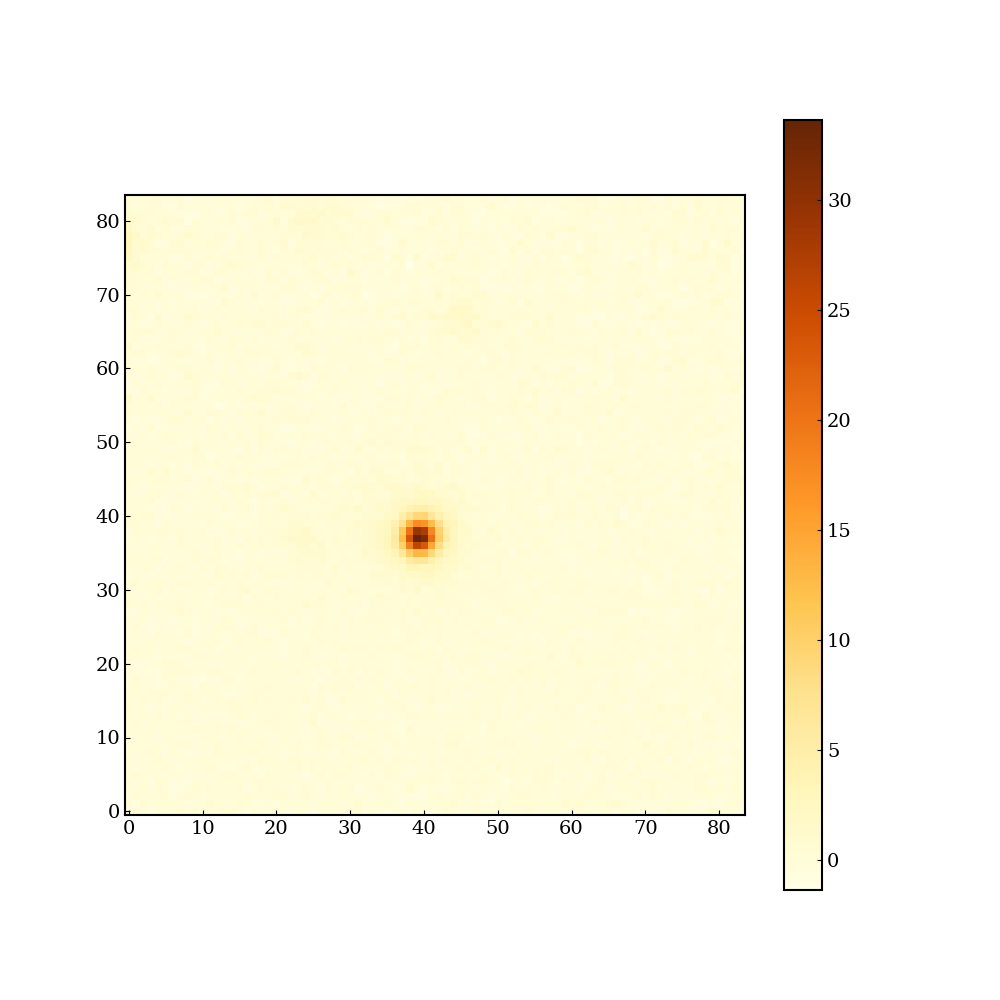

In [28]:
fig = plt.figure(figsize=(10,10))

ax = fig.add_subplot(1,1, 1)

im = ax.imshow(Y_Data_085_096[0], origin="lower", cmap="YlOrBr")

#plt.scatter(X, Y, color="skyblue", s=200, marker="+")

#sep_ap = cutout['details']['sep_objects'][cutout['details']['sep_obj_idx']]

coord_offset = 0.5 * (ax.get_xlim()[0] + ax.get_xlim()[1])

plt.colorbar(im, ax=ax)

#filename = str(Data_Redshift_Confirmed["Detectid"][200])

#plt.title(str(filename))

In [29]:
G_X_Array_025_035, G_Y_Array_025_035 = getting_the_centers(G_Data_025_035)
R_X_Array_025_035, R_Y_Array_025_035 = getting_the_centers(R_Data_025_035)
I_X_Array_025_035, I_Y_Array_025_035 = getting_the_centers(I_Data_025_035)
Z_X_Array_025_035, Z_Y_Array_025_035 = getting_the_centers(Z_Data_025_035)
Y_X_Array_025_035, Y_Y_Array_025_035 = getting_the_centers(Y_Data_025_035)

In [30]:
G_X_Array_035_045, G_Y_Array_035_045 = getting_the_centers(G_Data_035_045)
R_X_Array_035_045, R_Y_Array_035_045 = getting_the_centers(R_Data_035_045)
I_X_Array_035_045, I_Y_Array_035_045 = getting_the_centers(I_Data_035_045)
Z_X_Array_035_045, Z_Y_Array_035_045 = getting_the_centers(Z_Data_035_045)
Y_X_Array_035_045, Y_Y_Array_035_045 = getting_the_centers(Y_Data_035_045)

In [31]:
G_X_Array_045_055, G_Y_Array_045_055 = getting_the_centers(G_Data_045_055)
R_X_Array_045_055, R_Y_Array_045_055 = getting_the_centers(R_Data_045_055)
I_X_Array_045_055, I_Y_Array_045_055 = getting_the_centers(I_Data_045_055)
Z_X_Array_045_055, Z_Y_Array_045_055 = getting_the_centers(Z_Data_045_055)
Y_X_Array_045_055, Y_Y_Array_045_055 = getting_the_centers(Y_Data_045_055)

In [32]:
G_X_Array_055_065, G_Y_Array_055_065 = getting_the_centers(G_Data_055_065)
R_X_Array_055_065, R_Y_Array_055_065 = getting_the_centers(R_Data_055_065)
I_X_Array_055_065, I_Y_Array_055_065 = getting_the_centers(I_Data_055_065)
Z_X_Array_055_065, Z_Y_Array_055_065 = getting_the_centers(Z_Data_055_065)
Y_X_Array_055_065, Y_Y_Array_055_065 = getting_the_centers(Y_Data_055_065)

In [33]:
G_X_Array_065_075, G_Y_Array_065_075 = getting_the_centers(G_Data_065_075)
R_X_Array_065_075, R_Y_Array_065_075 = getting_the_centers(R_Data_065_075)
I_X_Array_065_075, I_Y_Array_065_075 = getting_the_centers(I_Data_065_075)
Z_X_Array_065_075, Z_Y_Array_065_075 = getting_the_centers(Z_Data_065_075)
Y_X_Array_065_075, Y_Y_Array_065_075 = getting_the_centers(Y_Data_065_075)

In [34]:
G_X_Array_075_085, G_Y_Array_075_085 = getting_the_centers(G_Data_075_085)
R_X_Array_075_085, R_Y_Array_075_085 = getting_the_centers(R_Data_075_085)
I_X_Array_075_085, I_Y_Array_075_085 = getting_the_centers(I_Data_075_085)
Z_X_Array_075_085, Z_Y_Array_075_085 = getting_the_centers(Z_Data_075_085)
Y_X_Array_075_085, Y_Y_Array_075_085 = getting_the_centers(Y_Data_075_085)

In [35]:
G_X_Array_085_096, G_Y_Array_085_096 = getting_the_centers(G_Data_085_096)
R_X_Array_085_096, R_Y_Array_085_096 = getting_the_centers(R_Data_085_096)
I_X_Array_085_096, I_Y_Array_085_096 = getting_the_centers(I_Data_085_096)
Z_X_Array_085_096, Z_Y_Array_085_096 = getting_the_centers(Z_Data_085_096)
Y_X_Array_085_096, Y_Y_Array_085_096 = getting_the_centers(Y_Data_085_096)

In [36]:
G_Shifted_X_Data_025_035 = shifting_in_the_x_direction(G_Data_025_035, G_X_Array_025_035)


In [37]:
G_Shifted_Y_Data_025_035 = shifting_in_the_y_direction(G_Shifted_X_Data_025_035, G_Y_Array_025_035)


In [38]:
G_Shifted_X_Data_025_035 = shifting_in_the_x_direction(G_Data_025_035, G_X_Array_025_035)
R_Shifted_X_Data_025_035 = shifting_in_the_x_direction(R_Data_025_035, R_X_Array_025_035)
I_Shifted_X_Data_025_035 = shifting_in_the_x_direction(I_Data_025_035, I_X_Array_025_035)
Z_Shifted_X_Data_025_035 = shifting_in_the_x_direction(Z_Data_025_035, Z_X_Array_025_035)
Y_Shifted_X_Data_025_035 = shifting_in_the_x_direction(Y_Data_025_035, Y_X_Array_025_035)


In [39]:
G_Shifted_X_Data_035_045 = shifting_in_the_x_direction(G_Data_035_045, G_X_Array_035_045)
R_Shifted_X_Data_035_045 = shifting_in_the_x_direction(R_Data_035_045, R_X_Array_035_045)
I_Shifted_X_Data_035_045 = shifting_in_the_x_direction(I_Data_035_045, I_X_Array_035_045)
Z_Shifted_X_Data_035_045 = shifting_in_the_x_direction(Z_Data_035_045, Z_X_Array_035_045)
Y_Shifted_X_Data_035_045 = shifting_in_the_x_direction(Y_Data_035_045, Y_X_Array_035_045)

In [40]:
G_Shifted_X_Data_045_055 = shifting_in_the_x_direction(G_Data_045_055, G_X_Array_045_055)
R_Shifted_X_Data_045_055 = shifting_in_the_x_direction(R_Data_045_055, R_X_Array_045_055)
I_Shifted_X_Data_045_055 = shifting_in_the_x_direction(I_Data_045_055, I_X_Array_045_055)
Z_Shifted_X_Data_045_055 = shifting_in_the_x_direction(Z_Data_045_055, Z_X_Array_045_055)
Y_Shifted_X_Data_045_055 = shifting_in_the_x_direction(Y_Data_045_055, Y_X_Array_045_055)

In [41]:
G_Shifted_X_Data_055_065 = shifting_in_the_x_direction(G_Data_055_065, G_X_Array_055_065)
R_Shifted_X_Data_055_065 = shifting_in_the_x_direction(R_Data_055_065, R_X_Array_055_065)
I_Shifted_X_Data_055_065 = shifting_in_the_x_direction(I_Data_055_065, I_X_Array_055_065)
Z_Shifted_X_Data_055_065 = shifting_in_the_x_direction(Z_Data_055_065, Z_X_Array_055_065)
Y_Shifted_X_Data_055_065 = shifting_in_the_x_direction(Y_Data_055_065, Y_X_Array_055_065)

In [42]:
G_Shifted_X_Data_065_075 = shifting_in_the_x_direction(G_Data_065_075, G_X_Array_065_075)
R_Shifted_X_Data_065_075 = shifting_in_the_x_direction(R_Data_065_075, R_X_Array_065_075)
I_Shifted_X_Data_065_075 = shifting_in_the_x_direction(I_Data_065_075, I_X_Array_065_075)
Z_Shifted_X_Data_065_075 = shifting_in_the_x_direction(Z_Data_065_075, Z_X_Array_065_075)
Y_Shifted_X_Data_065_075 = shifting_in_the_x_direction(Y_Data_065_075, Y_X_Array_065_075)

In [43]:
G_Shifted_X_Data_075_085 = shifting_in_the_x_direction(G_Data_075_085, G_X_Array_075_085)
R_Shifted_X_Data_075_085 = shifting_in_the_x_direction(R_Data_075_085, R_X_Array_075_085)
I_Shifted_X_Data_075_085 = shifting_in_the_x_direction(I_Data_075_085, I_X_Array_075_085)
Z_Shifted_X_Data_075_085 = shifting_in_the_x_direction(Z_Data_075_085, Z_X_Array_075_085)
Y_Shifted_X_Data_075_085 = shifting_in_the_x_direction(Y_Data_075_085, Y_X_Array_075_085)

In [44]:
G_Shifted_X_Data_085_096 = shifting_in_the_x_direction(G_Data_085_096, G_X_Array_085_096)
R_Shifted_X_Data_085_096 = shifting_in_the_x_direction(R_Data_085_096, R_X_Array_085_096)
I_Shifted_X_Data_085_096 = shifting_in_the_x_direction(I_Data_085_096, I_X_Array_085_096)
Z_Shifted_X_Data_085_096 = shifting_in_the_x_direction(Z_Data_085_096, Z_X_Array_085_096)
Y_Shifted_X_Data_085_096 = shifting_in_the_x_direction(Y_Data_085_096, Y_X_Array_085_096)

In [45]:
G_Shifted_Y_Data_025_035 = shifting_in_the_y_direction(G_Shifted_X_Data_025_035, G_Y_Array_025_035)
R_Shifted_Y_Data_025_035 = shifting_in_the_y_direction(R_Shifted_X_Data_025_035, R_Y_Array_025_035)
I_Shifted_Y_Data_025_035 = shifting_in_the_y_direction(I_Shifted_X_Data_025_035, I_Y_Array_025_035)
Z_Shifted_Y_Data_025_035 = shifting_in_the_y_direction(Z_Shifted_X_Data_025_035, Z_Y_Array_025_035)
Y_Shifted_Y_Data_025_035 = shifting_in_the_y_direction(Y_Shifted_X_Data_025_035, Y_Y_Array_025_035)

In [46]:
G_Shifted_Y_Data_035_045 = shifting_in_the_y_direction(G_Shifted_X_Data_035_045, G_Y_Array_035_045)
R_Shifted_Y_Data_035_045 = shifting_in_the_y_direction(R_Shifted_X_Data_035_045, R_Y_Array_035_045)
I_Shifted_Y_Data_035_045 = shifting_in_the_y_direction(I_Shifted_X_Data_035_045, I_Y_Array_035_045)
Z_Shifted_Y_Data_035_045 = shifting_in_the_y_direction(Z_Shifted_X_Data_035_045, Z_Y_Array_035_045)
Y_Shifted_Y_Data_035_045 = shifting_in_the_y_direction(Y_Shifted_X_Data_035_045, Y_Y_Array_035_045)

In [47]:
G_Shifted_Y_Data_045_055 = shifting_in_the_y_direction(G_Shifted_X_Data_045_055, G_Y_Array_045_055)
R_Shifted_Y_Data_045_055 = shifting_in_the_y_direction(R_Shifted_X_Data_045_055, R_Y_Array_045_055)
I_Shifted_Y_Data_045_055 = shifting_in_the_y_direction(I_Shifted_X_Data_045_055, I_Y_Array_045_055)
Z_Shifted_Y_Data_045_055 = shifting_in_the_y_direction(Z_Shifted_X_Data_045_055, Z_Y_Array_045_055)
Y_Shifted_Y_Data_045_055 = shifting_in_the_y_direction(Y_Shifted_X_Data_045_055, Y_Y_Array_045_055)

In [48]:
G_Shifted_Y_Data_055_065 = shifting_in_the_y_direction(G_Shifted_X_Data_055_065, G_Y_Array_055_065)
R_Shifted_Y_Data_055_065 = shifting_in_the_y_direction(R_Shifted_X_Data_055_065, R_Y_Array_055_065)
I_Shifted_Y_Data_055_065 = shifting_in_the_y_direction(I_Shifted_X_Data_055_065, I_Y_Array_055_065)
Z_Shifted_Y_Data_055_065 = shifting_in_the_y_direction(Z_Shifted_X_Data_055_065, Z_Y_Array_055_065)
Y_Shifted_Y_Data_055_065 = shifting_in_the_y_direction(Y_Shifted_X_Data_055_065, Y_Y_Array_055_065)

In [49]:
G_Shifted_Y_Data_065_075 = shifting_in_the_y_direction(G_Shifted_X_Data_065_075, G_Y_Array_065_075)
R_Shifted_Y_Data_065_075 = shifting_in_the_y_direction(R_Shifted_X_Data_065_075, R_Y_Array_065_075)
I_Shifted_Y_Data_065_075 = shifting_in_the_y_direction(I_Shifted_X_Data_065_075, I_Y_Array_065_075)
Z_Shifted_Y_Data_065_075 = shifting_in_the_y_direction(Z_Shifted_X_Data_065_075, Z_Y_Array_065_075)
Y_Shifted_Y_Data_065_075 = shifting_in_the_y_direction(Y_Shifted_X_Data_065_075, Y_Y_Array_065_075)

In [50]:
G_Shifted_Y_Data_075_085 = shifting_in_the_y_direction(G_Shifted_X_Data_075_085, G_Y_Array_075_085)
R_Shifted_Y_Data_075_085 = shifting_in_the_y_direction(R_Shifted_X_Data_075_085, R_Y_Array_075_085)
I_Shifted_Y_Data_075_085 = shifting_in_the_y_direction(I_Shifted_X_Data_075_085, I_Y_Array_075_085)
Z_Shifted_Y_Data_075_085 = shifting_in_the_y_direction(Z_Shifted_X_Data_075_085, Z_Y_Array_075_085)
Y_Shifted_Y_Data_075_085 = shifting_in_the_y_direction(Y_Shifted_X_Data_075_085, Y_Y_Array_075_085)

In [51]:
G_Shifted_Y_Data_085_096 = shifting_in_the_y_direction(G_Shifted_X_Data_085_096, G_Y_Array_085_096)
R_Shifted_Y_Data_085_096 = shifting_in_the_y_direction(R_Shifted_X_Data_085_096, R_Y_Array_085_096)
I_Shifted_Y_Data_085_096 = shifting_in_the_y_direction(I_Shifted_X_Data_085_096, I_Y_Array_085_096)
Z_Shifted_Y_Data_085_096 = shifting_in_the_y_direction(Z_Shifted_X_Data_085_096, Z_Y_Array_085_096)
Y_Shifted_Y_Data_085_096 = shifting_in_the_y_direction(Y_Shifted_X_Data_085_096, Y_Y_Array_085_096)

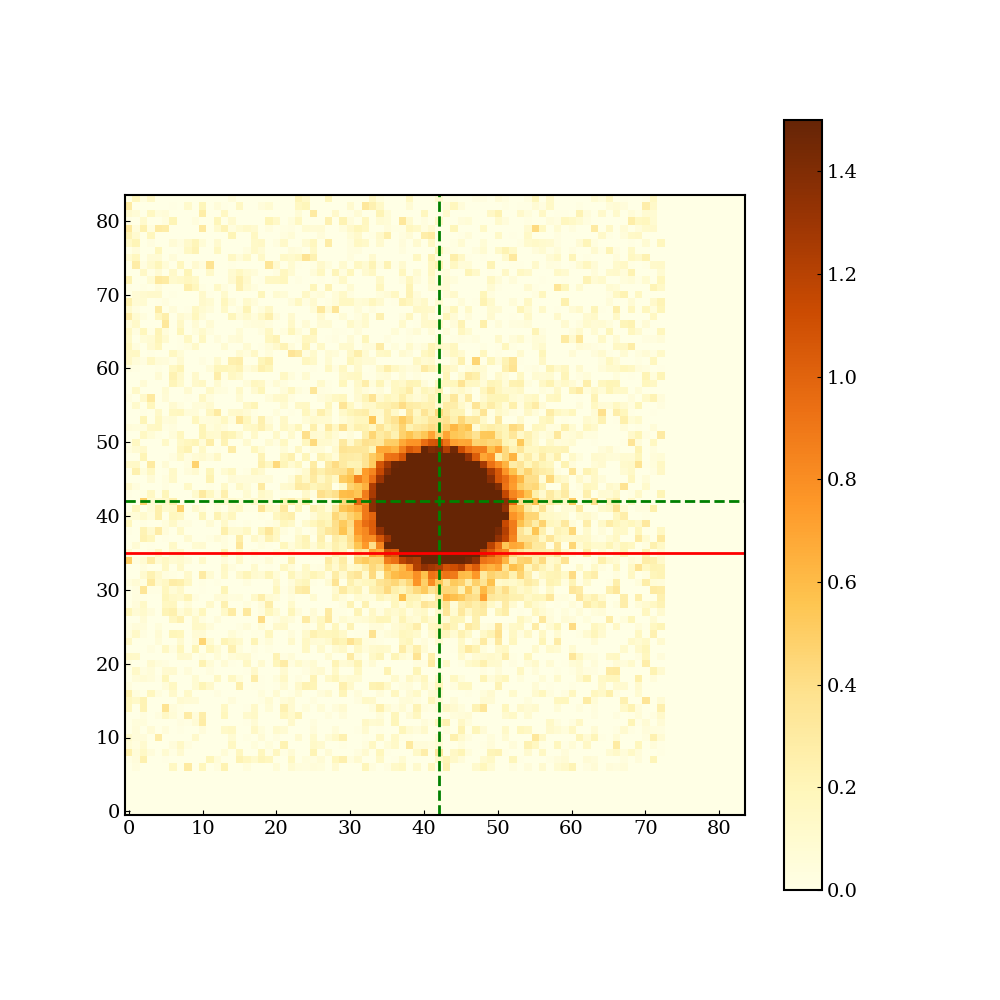

In [52]:
num=6

fig = plt.figure(figsize=(10,10))

ax = fig.add_subplot(1,1, 1)

im = ax.imshow(Z_Shifted_Y_Data_025_035[num], origin="lower", cmap="YlOrBr", vmin=0, vmax=1.5)

plt.axhline(y=Z_Y_Array_025_035[num], color='red', linewidth=2)
plt.axvline(x=42, color='green', linestyle='--', linewidth=2)
plt.axhline(y=42, color='green', linestyle='--', linewidth=2)

#sep_ap = cutout['details']['sep_objects'][cutout['details']['sep_obj_idx']]

coord_offset = 0.5 * (ax.get_xlim()[0] + ax.get_xlim()[1])

plt.colorbar(im, ax=ax)

#filename = str(Data_Redshift_Confirmed["Detectid"][200])

#plt.title(str(filename))

In [53]:
Single_Rows_G_025_035 = all_the_rows(G_Shifted_Y_Data_025_035)
Single_Rows_R_025_035 = all_the_rows(R_Shifted_Y_Data_025_035)
Single_Rows_I_025_035 = all_the_rows(I_Shifted_Y_Data_025_035)
Single_Rows_Z_025_035 = all_the_rows(Z_Shifted_Y_Data_025_035)
Single_Rows_Y_025_035 = all_the_rows(Y_Shifted_Y_Data_025_035)

In [54]:
Single_Rows_G_035_045 = all_the_rows(G_Shifted_Y_Data_035_045)
Single_Rows_R_035_045 = all_the_rows(R_Shifted_Y_Data_035_045)
Single_Rows_I_035_045 = all_the_rows(I_Shifted_Y_Data_035_045)
Single_Rows_Z_035_045 = all_the_rows(Z_Shifted_Y_Data_035_045)
Single_Rows_Y_035_045 = all_the_rows(Y_Shifted_Y_Data_035_045)

In [55]:
Single_Rows_G_045_055 = all_the_rows(G_Shifted_Y_Data_045_055)
Single_Rows_R_045_055 = all_the_rows(R_Shifted_Y_Data_045_055)
Single_Rows_I_045_055 = all_the_rows(I_Shifted_Y_Data_045_055)
Single_Rows_Z_045_055 = all_the_rows(Z_Shifted_Y_Data_045_055)
Single_Rows_Y_045_055 = all_the_rows(Y_Shifted_Y_Data_045_055)

In [56]:
Single_Rows_G_055_065 = all_the_rows(G_Shifted_Y_Data_055_065)
Single_Rows_R_055_065 = all_the_rows(R_Shifted_Y_Data_055_065)
Single_Rows_I_055_065 = all_the_rows(I_Shifted_Y_Data_055_065)
Single_Rows_Z_055_065 = all_the_rows(Z_Shifted_Y_Data_055_065)
Single_Rows_Y_055_065 = all_the_rows(Y_Shifted_Y_Data_055_065)

In [57]:
Single_Rows_G_065_075 = all_the_rows(G_Shifted_Y_Data_065_075)
Single_Rows_R_065_075 = all_the_rows(R_Shifted_Y_Data_065_075)
Single_Rows_I_065_075 = all_the_rows(I_Shifted_Y_Data_065_075)
Single_Rows_Z_065_075 = all_the_rows(Z_Shifted_Y_Data_065_075)
Single_Rows_Y_065_075 = all_the_rows(Y_Shifted_Y_Data_065_075)

In [58]:
Single_Rows_G_075_085 = all_the_rows(G_Shifted_Y_Data_075_085)
Single_Rows_R_075_085 = all_the_rows(R_Shifted_Y_Data_075_085)
Single_Rows_I_075_085 = all_the_rows(I_Shifted_Y_Data_075_085)
Single_Rows_Z_075_085 = all_the_rows(Z_Shifted_Y_Data_075_085)
Single_Rows_Y_075_085 = all_the_rows(Y_Shifted_Y_Data_075_085)

In [59]:
Single_Rows_G_085_096 = all_the_rows(G_Shifted_Y_Data_085_096)
Single_Rows_R_085_096 = all_the_rows(R_Shifted_Y_Data_085_096)
Single_Rows_I_085_096 = all_the_rows(I_Shifted_Y_Data_085_096)
Single_Rows_Z_085_096 = all_the_rows(Z_Shifted_Y_Data_085_096)
Single_Rows_Y_085_096 = all_the_rows(Y_Shifted_Y_Data_085_096)

In [60]:
print(len(Single_Rows_G_085_096))
print(len(G_Shifted_Y_Data_085_096))
print(84*103)

84
98
8652


In [61]:
Row_Median_G_025_035 = row_median(Single_Rows_G_025_035)
Row_Median_R_025_035 = row_median(Single_Rows_R_025_035)
Row_Median_I_025_035 = row_median(Single_Rows_I_025_035)
Row_Median_Z_025_035 = row_median(Single_Rows_Z_025_035)
Row_Median_Y_025_035 = row_median(Single_Rows_Y_025_035)

In [62]:
Row_Median_G_035_045 = row_median(Single_Rows_G_035_045)
Row_Median_R_035_045 = row_median(Single_Rows_R_035_045)
Row_Median_I_035_045 = row_median(Single_Rows_I_035_045)
Row_Median_Z_035_045 = row_median(Single_Rows_Z_035_045)
Row_Median_Y_035_045 = row_median(Single_Rows_Y_035_045)

In [63]:
Row_Median_G_045_055 = row_median(Single_Rows_G_045_055)
Row_Median_R_045_055 = row_median(Single_Rows_R_045_055)
Row_Median_I_045_055 = row_median(Single_Rows_I_045_055)
Row_Median_Z_045_055 = row_median(Single_Rows_Z_045_055)
Row_Median_Y_045_055 = row_median(Single_Rows_Y_045_055)

In [64]:
Row_Median_G_055_065 = row_median(Single_Rows_G_055_065)
Row_Median_R_055_065 = row_median(Single_Rows_R_055_065)
Row_Median_I_055_065 = row_median(Single_Rows_I_055_065)
Row_Median_Z_055_065 = row_median(Single_Rows_Z_055_065)
Row_Median_Y_055_065 = row_median(Single_Rows_Y_055_065)

In [65]:
Row_Median_G_065_075 = row_median(Single_Rows_G_065_075)
Row_Median_R_065_075 = row_median(Single_Rows_R_065_075)
Row_Median_I_065_075 = row_median(Single_Rows_I_065_075)
Row_Median_Z_065_075 = row_median(Single_Rows_Z_065_075)
Row_Median_Y_065_075 = row_median(Single_Rows_Y_065_075)

In [66]:
Row_Median_G_075_085 = row_median(Single_Rows_G_075_085)
Row_Median_R_075_085 = row_median(Single_Rows_R_075_085)
Row_Median_I_075_085 = row_median(Single_Rows_I_075_085)
Row_Median_Z_075_085 = row_median(Single_Rows_Z_075_085)
Row_Median_Y_075_085 = row_median(Single_Rows_Y_075_085)

In [67]:
Row_Median_G_085_096 = row_median(Single_Rows_G_085_096)
Row_Median_R_085_096 = row_median(Single_Rows_R_085_096)
Row_Median_I_085_096 = row_median(Single_Rows_I_085_096)
Row_Median_Z_085_096 = row_median(Single_Rows_Z_085_096)
Row_Median_Y_085_096 = row_median(Single_Rows_Y_085_096)

In [68]:
Table_A = ([(Row_Median_Z_085_096)])

Table_b = QTable([Table_A], names=["Data"])

Table_b.write("/home/jovyan/work/stampede3/Z_085_096_Median_Stack.fits", overwrite = True)

In [69]:
Table_A = ([(Row_Median_Z_075_085)])

Table_b = QTable([Table_A], names=["Data"])

Table_b.write("/home/jovyan/work/stampede3/Z_075_085_Median_Stack.fits", overwrite = True)

In [70]:
#File = "Z_085_096_Median_Stack.fits"

In [71]:
#Table = Table.read(File, format = 'fits')

In [72]:
#Data = Table["Data"][0]

In [73]:
#print(Data)

Text(0.5, 1.0, 'G        0.85 < Z < 0.96')

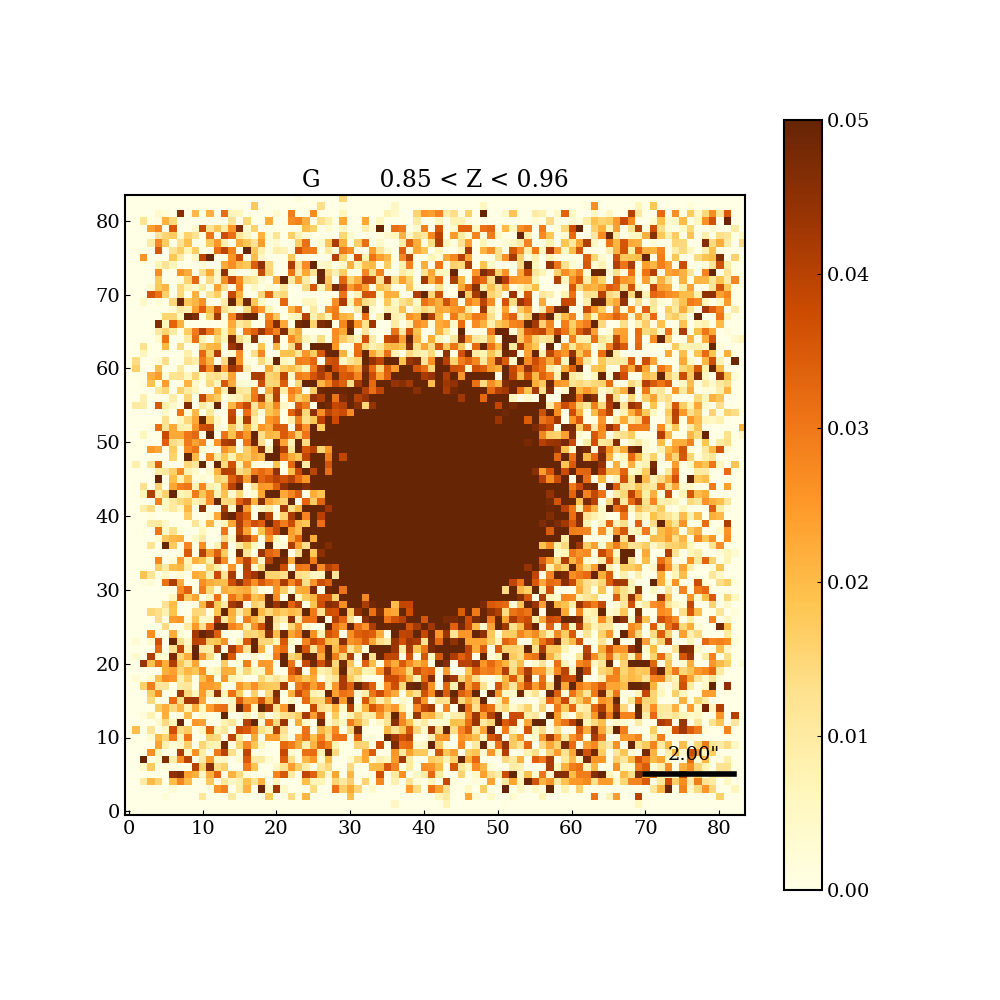

In [74]:
num=7

fig = plt.figure(figsize=(10,10))

ax = fig.add_subplot(1,1, 1)

im = ax.imshow(Row_Median_Z_085_096, origin="lower", cmap="YlOrBr", vmin=0, vmax=0.05)

#plt.axhline(y=Z_Y_Array_025_035[num], color='red', linewidth=2)
#plt.axvline(x=42, color='green', linestyle='--', linewidth=2)
#plt.axhline(y=42, color='green', linestyle='--', linewidth=2)

#sep_ap = cutout['details']['sep_objects'][cutout['details']['sep_obj_idx']]

coord_offset = 0.5 * (ax.get_xlim()[0] + ax.get_xlim()[1])

plt.colorbar(im, ax=ax)

plt.plot([70, 82], [5,5], color="black", linewidth=4)
plt.text(73, 7, '2.00"')

#filename = str(Data_Redshift_Confirmed["Detectid"][200])

plt.title("G        0.85 < Z < 0.96")

In [75]:
File_Table_3by7_025_035 = "Table_For_3by7_plot_025_035.fits"
File_Table_3by7_035_045 = "Table_For_3by7_plot_035_045.fits"
File_Table_3by7_045_055 = "Table_For_3by7_plot_045_055.fits"
File_Table_3by7_055_065 = "Table_For_3by7_plot_055_065.fits"
File_Table_3by7_065_075 = "Table_For_3by7_plot_065_075.fits"
File_Table_3by7_075_085 = "Table_For_3by7_plot_075_085.fits"
File_Table_3by7_085_096 = "Table_For_3by7_plot_085_096.fits"


In [76]:
Table_3by7_025_035 = Table.read(File_Table_3by7_025_035, format = 'fits')
Table_3by7_035_045 = Table.read(File_Table_3by7_035_045, format = 'fits')
Table_3by7_045_055 = Table.read(File_Table_3by7_045_055, format = 'fits')
Table_3by7_055_065 = Table.read(File_Table_3by7_055_065, format = 'fits')
Table_3by7_065_075 = Table.read(File_Table_3by7_065_075, format = 'fits')
Table_3by7_075_085 = Table.read(File_Table_3by7_075_085, format = 'fits')
Table_3by7_085_096 = Table.read(File_Table_3by7_085_096, format = 'fits')


In [77]:
Table_3by7_Velocity_025_035 = Table_3by7_025_035["Velocity_Array"][0]
Table_3by7_Flux_025_035 = Table_3by7_025_035["Flux_Array"][0]
Table_3by7_Narrow_025_035 = Table_3by7_025_035["Narrow"][0]
Table_3by7_Broad_025_035 = Table_3by7_025_035["Broad"][0]
Table_3by7_Exponential_025_035 = Table_3by7_025_035["Exponential"][0]
Table_3by7_Full_025_035 = Table_3by7_025_035["Full"][0]

In [78]:
Table_3by7_Velocity_035_045 = Table_3by7_035_045["Velocity_Array"][0]
Table_3by7_Flux_035_045 = Table_3by7_035_045["Flux_Array"][0]
Table_3by7_Narrow_035_045 = Table_3by7_035_045["Narrow"][0]
Table_3by7_Broad_035_045 = Table_3by7_035_045["Broad"][0]
Table_3by7_Exponential_035_045 = Table_3by7_035_045["Exponential"][0]
Table_3by7_Full_035_045 = Table_3by7_035_045["Full"][0]

In [79]:
Table_3by7_Velocity_045_055 = Table_3by7_045_055["Velocity_Array"][0]
Table_3by7_Flux_045_055 = Table_3by7_045_055["Flux_Array"][0]
Table_3by7_Narrow_045_055 = Table_3by7_045_055["Narrow"][0]
Table_3by7_Broad_045_055 = Table_3by7_045_055["Broad"][0]
Table_3by7_Exponential_045_055 = Table_3by7_045_055["Exponential"][0]
Table_3by7_Full_045_055 = Table_3by7_045_055["Full"][0]

In [80]:
Table_3by7_Velocity_055_065 = Table_3by7_055_065["Velocity_Array"][0]
Table_3by7_Flux_055_065 = Table_3by7_055_065["Flux_Array"][0]
Table_3by7_Narrow_055_065 = Table_3by7_055_065["Narrow"][0]
Table_3by7_Broad_055_065 = Table_3by7_055_065["Broad"][0]
Table_3by7_Exponential_055_065 = Table_3by7_055_065["Exponential"][0]
Table_3by7_Full_055_065 = Table_3by7_055_065["Full"][0]

In [81]:
Table_3by7_Velocity_065_075 = Table_3by7_065_075["Velocity_Array"][0]
Table_3by7_Flux_065_075 = Table_3by7_065_075["Flux_Array"][0]
Table_3by7_Narrow_065_075 = Table_3by7_065_075["Narrow"][0]
Table_3by7_Broad_065_075 = Table_3by7_065_075["Broad"][0]
Table_3by7_Exponential_065_075 = Table_3by7_065_075["Exponential"][0]
Table_3by7_Full_065_075 = Table_3by7_065_075["Full"][0]

In [82]:
Table_3by7_Velocity_075_085 = Table_3by7_075_085["Velocity_Array"][0]
Table_3by7_Flux_075_085 = Table_3by7_075_085["Flux_Array"][0]
Table_3by7_Narrow_075_085 = Table_3by7_075_085["Narrow"][0]
Table_3by7_Broad_075_085 = Table_3by7_075_085["Broad"][0]
Table_3by7_Exponential_075_085 = Table_3by7_075_085["Exponential"][0]
Table_3by7_Full_075_085 = Table_3by7_075_085["Full"][0]

In [83]:
Table_3by7_Velocity_085_096 = Table_3by7_085_096["Velocity_Array"][0]
Table_3by7_Flux_085_096 = Table_3by7_085_096["Flux_Array"][0]
Table_3by7_Narrow_085_096 = Table_3by7_085_096["Narrow"][0]
Table_3by7_Broad_085_096 = Table_3by7_085_096["Broad"][0]
Table_3by7_Exponential_085_096 = Table_3by7_085_096["Exponential"][0]
Table_3by7_Full_085_096 = Table_3by7_085_096["Full"][0]

In [84]:
print(len(Table_3by7_045_055["Broad"][0]), len(Table_3by7_Full_035_045))

465 435


Text(0.5, 1.0, 'Uniform Narrow Broad')

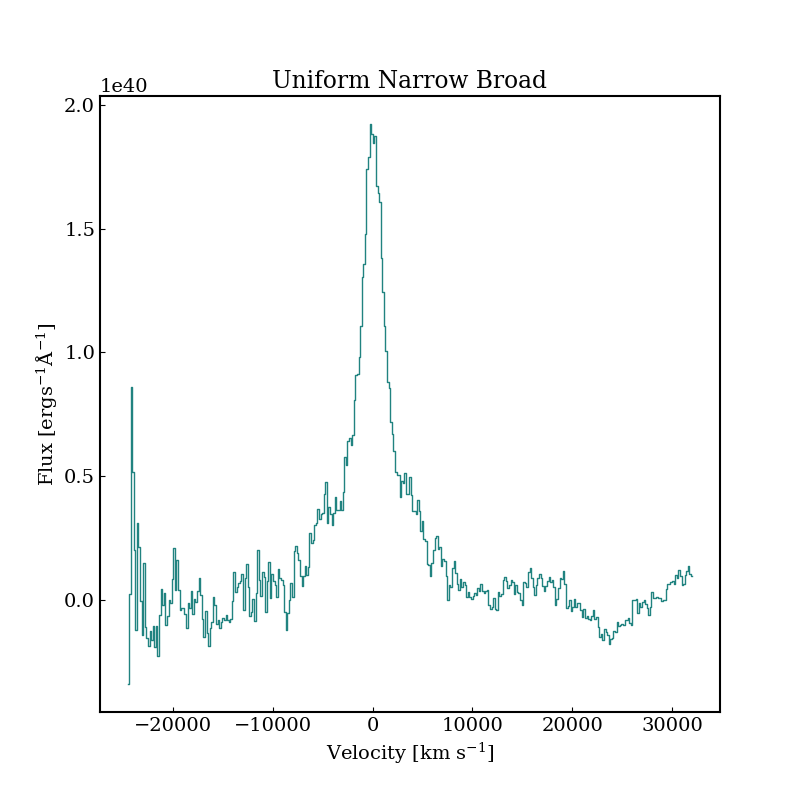

In [85]:
fig = plt.figure(figsize = (8,8), facecolor='white')
ax = plt.subplot(1,1,1)

plt.step(Table_3by7_Velocity_025_035, Table_3by7_Flux_025_035, where = 'mid', color = '#218380', label = "spectrum", linewidth=1)

#plt.legend()

ax.set_ylabel("Flux [$erg s^{-1} \AA^{-1}$]")
ax.set_xlabel("Velocity [km s$^{-1}$]")

#ax.set_yscale('log')
#ax.set_xscale('log')

plt.title("Uniform Narrow Broad")

#plt.xlim(3400, 3440)
#plt.ylim(0.1e41, 1.1e41)

Text(0.5, 0, 'Velocity [km s$^{-1}$]')

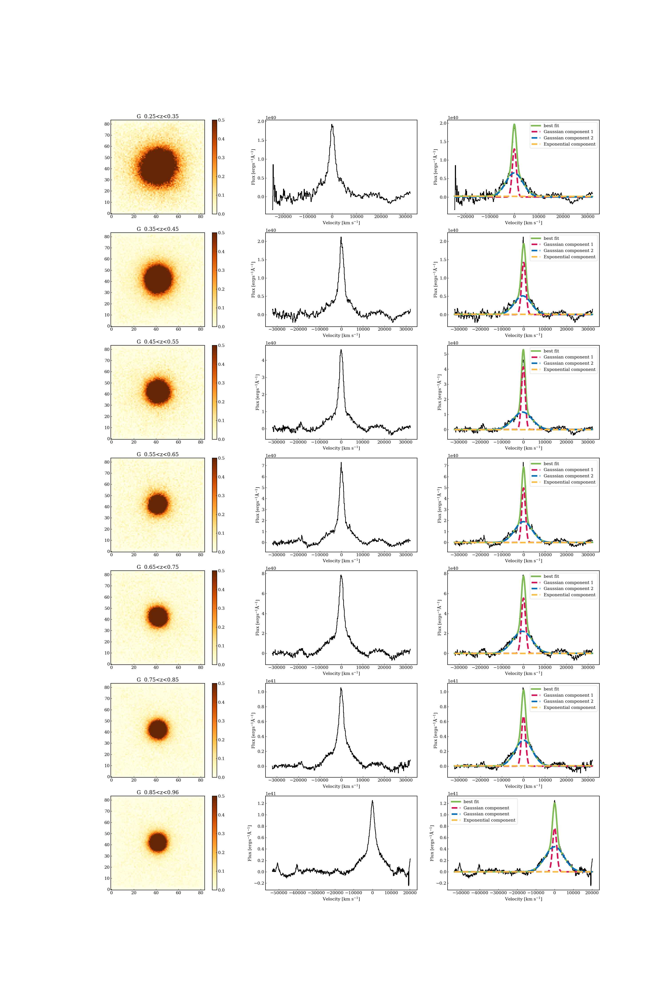

In [86]:
fig = plt.figure(figsize = (30,45), facecolor='white')

ax = fig.add_subplot(7,3, 1)

im = ax.imshow(Row_Median_Z_025_035, origin="lower", cmap="YlOrBr", vmin=0, vmax=0.5)

coord_offset = 0.5 * (ax.get_xlim()[0] + ax.get_xlim()[1])

filename = "G  0.25<z<0.35"

plt.colorbar(im, ax=ax)

plt.title(str(filename))

##########################################################################################

ax = plt.subplot(7,3,2)

plt.step(Table_3by7_Velocity_025_035, Table_3by7_Flux_025_035, where = 'mid', color = 'black', label = "spectrum", linewidth=2)

#plt.legend()

ax.set_ylabel("Flux [$erg s^{-1} \AA^{-1}$]")
ax.set_xlabel("Velocity [km s$^{-1}$]")

#ax.set_yscale('log')
#ax.set_xscale('log')


#plt.xlim(3400, 3440)
#plt.ylim(0.1e41, 1.1e41)
 
##########################################################################################

ax = plt.subplot(7,3,3)


plt.plot(Table_3by7_Velocity_025_035, Table_3by7_Full_025_035, '-', linewidth=5, color='#7fbb54', label='best fit', zorder=1)

plt.step(Table_3by7_Velocity_025_035, Table_3by7_Flux_025_035, where='mid', linewidth=2, color='black', zorder=0)
plt.plot(Table_3by7_Velocity_025_035, Table_3by7_Narrow_025_035, '--', linewidth=5, color='#d81159', label='Gaussian component 1', zorder=2)
plt.plot(Table_3by7_Velocity_025_035, Table_3by7_Broad_025_035, '--', linewidth=5, color='#0070be', label='Gaussian component 2', zorder=3)
plt.plot(Table_3by7_Velocity_025_035, Table_3by7_Exponential_025_035, '--', linewidth=5, color='#ffbc42', label='Exponential component', zorder=4)

plt.legend()

ax.set_ylabel("Flux [$erg s^{-1} \AA^{-1}$]")
ax.set_xlabel("Velocity [km s$^{-1}$]")

#ax.set_yscale('log')
#ax.set_xscale('log')

#plt.xlim(3400, 3440)
#plt.ylim(0.1e41, 1.1e41)

##########################################################################################

ax = fig.add_subplot(7,3, 4)

im = ax.imshow(Row_Median_Z_035_045, origin="lower", cmap="YlOrBr", vmin=0, vmax=0.5)

coord_offset = 0.5 * (ax.get_xlim()[0] + ax.get_xlim()[1])

filename = "G  0.35<z<0.45"

plt.colorbar(im, ax=ax)

plt.title(str(filename))

##########################################################################################

ax = plt.subplot(7,3,5)

plt.step(Table_3by7_Velocity_035_045, Table_3by7_Flux_035_045, where = 'mid', color = 'black', label = "spectrum", linewidth=2)

#plt.legend()

ax.set_ylabel("Flux [$erg s^{-1} \AA^{-1}$]")
ax.set_xlabel("Velocity [km s$^{-1}$]")

#ax.set_yscale('log')
#ax.set_xscale('log')


#plt.xlim(3400, 3440)
#plt.ylim(0.1e41, 1.1e41)
 
##########################################################################################

ax = plt.subplot(7,3,6)


plt.plot(Table_3by7_Velocity_035_045, Table_3by7_Full_035_045, '-', linewidth=5, color='#7fbb54', label='best fit', zorder=1)

plt.step(Table_3by7_Velocity_035_045, Table_3by7_Flux_035_045, where='mid', linewidth=2, color='black', zorder=0)
plt.plot(Table_3by7_Velocity_035_045, Table_3by7_Narrow_035_045, '--', linewidth=5, color='#d81159', label='Gaussian component 1', zorder=2)
plt.plot(Table_3by7_Velocity_035_045, Table_3by7_Broad_035_045, '--', linewidth=5, color='#0070be', label='Gaussian component 2', zorder=3)
plt.plot(Table_3by7_Velocity_035_045, Table_3by7_Exponential_035_045, '--', linewidth=5, color='#ffbc42', label='Exponential component', zorder=4)

plt.legend()

ax.set_ylabel("Flux [$erg s^{-1} \AA^{-1}$]")
ax.set_xlabel("Velocity [km s$^{-1}$]")

#ax.set_yscale('log')
#ax.set_xscale('log')


#plt.xlim(3400, 3440)
#plt.ylim(0.1e41, 1.1e41)

##########################################################################################

ax = fig.add_subplot(7,3, 7)

im = ax.imshow(Row_Median_Z_045_055, origin="lower", cmap="YlOrBr", vmin=0, vmax=0.5)

coord_offset = 0.5 * (ax.get_xlim()[0] + ax.get_xlim()[1])

filename = "G  0.45<z<0.55"
plt.colorbar(im, ax=ax)


plt.title(str(filename))

##########################################################################################

ax = plt.subplot(7,3,8)

plt.step(Table_3by7_Velocity_045_055, Table_3by7_Flux_045_055, where = 'mid', color = 'black', label = "spectrum", linewidth=2)

#plt.legend()

ax.set_ylabel("Flux [$erg s^{-1} \AA^{-1}$]")
ax.set_xlabel("Velocity [km s$^{-1}$]")

#ax.set_yscale('log')
#ax.set_xscale('log')


#plt.xlim(3400, 3440)
#plt.ylim(0.1e41, 1.1e41)
 
##########################################################################################

ax = plt.subplot(7,3,9)


plt.plot(Table_3by7_Velocity_045_055, Table_3by7_Full_045_055, '-', linewidth=5, color='#7fbb54', label='best fit', zorder=1)

plt.step(Table_3by7_Velocity_045_055, Table_3by7_Flux_045_055, where='mid', linewidth=2, color='black', zorder=0)
plt.plot(Table_3by7_Velocity_045_055, Table_3by7_Narrow_045_055, '--', linewidth=5, color='#d81159', label='Gaussian component 1', zorder=2)
plt.plot(Table_3by7_Velocity_045_055, Table_3by7_Broad_045_055, '--', linewidth=5, color='#0070be', label='Gaussian component 2', zorder=3)
plt.plot(Table_3by7_Velocity_045_055, Table_3by7_Exponential_045_055, '--', linewidth=5, color='#ffbc42', label='Exponential component', zorder=4)

plt.legend()

ax.set_ylabel("Flux [$erg s^{-1} \AA^{-1}$]")
ax.set_xlabel("Velocity [km s$^{-1}$]")

#ax.set_yscale('log')
#ax.set_xscale('log')


#plt.xlim(3400, 3440)
#plt.ylim(0.1e41, 1.1e41)

##########################################################################################

ax = fig.add_subplot(7,3, 10)

im = ax.imshow(Row_Median_Z_055_065, origin="lower", cmap="YlOrBr", vmin=0, vmax=0.5)

coord_offset = 0.5 * (ax.get_xlim()[0] + ax.get_xlim()[1])

filename = "G  0.55<z<0.65"
plt.colorbar(im, ax=ax)


plt.title(str(filename))

##########################################################################################

ax = plt.subplot(7,3,11)

plt.step(Table_3by7_Velocity_055_065, Table_3by7_Flux_055_065, where = 'mid', color = 'black', label = "spectrum", linewidth=2)

#plt.legend()

ax.set_ylabel("Flux [$erg s^{-1} \AA^{-1}$]")
ax.set_xlabel("Velocity [km s$^{-1}$]")

#ax.set_yscale('log')
#ax.set_xscale('log')


#plt.xlim(3400, 3440)
#plt.ylim(0.1e41, 1.1e41)
 
##########################################################################################

ax = plt.subplot(7,3,12)


plt.plot(Table_3by7_Velocity_055_065, Table_3by7_Full_055_065, '-', linewidth=5, color='#7fbb54', label='best fit', zorder=1)

plt.step(Table_3by7_Velocity_055_065, Table_3by7_Flux_055_065, where='mid', linewidth=2, color='black', zorder=0)
plt.plot(Table_3by7_Velocity_055_065, Table_3by7_Narrow_055_065, '--', linewidth=5, color='#d81159', label='Gaussian component 1', zorder=2)
plt.plot(Table_3by7_Velocity_055_065, Table_3by7_Broad_055_065, '--', linewidth=5, color='#0070be', label='Gaussian component 2', zorder=3)
plt.plot(Table_3by7_Velocity_055_065, Table_3by7_Exponential_055_065, '--', linewidth=5, color='#ffbc42', label='Exponential component', zorder=4)

plt.legend()

ax.set_ylabel("Flux [$erg s^{-1} \AA^{-1}$]")
ax.set_xlabel("Velocity [km s$^{-1}$]")

#ax.set_yscale('log')
#ax.set_xscale('log')


#plt.xlim(3400, 3440)
#plt.ylim(0.1e41, 1.1e41)

##########################################################################################

ax = fig.add_subplot(7,3, 13)

im = ax.imshow(Row_Median_Z_065_075, origin="lower", cmap="YlOrBr", vmin=0, vmax=0.5)

coord_offset = 0.5 * (ax.get_xlim()[0] + ax.get_xlim()[1])

filename = "G  0.65<z<0.75"
plt.colorbar(im, ax=ax)


plt.title(str(filename))

##########################################################################################

ax = plt.subplot(7,3,14)

plt.step(Table_3by7_Velocity_065_075, Table_3by7_Flux_065_075, where = 'mid', color = 'black', label = "spectrum", linewidth=2)

#plt.legend()

ax.set_ylabel("Flux [$erg s^{-1} \AA^{-1}$]")
ax.set_xlabel("Velocity [km s$^{-1}$]")

#ax.set_yscale('log')
#ax.set_xscale('log')


#plt.xlim(3400, 3440)
#plt.ylim(0.1e41, 1.1e41)
 
##########################################################################################

ax = plt.subplot(7,3,15)


plt.plot(Table_3by7_Velocity_065_075, Table_3by7_Full_065_075, '-', linewidth=5, color='#7fbb54', label='best fit', zorder=1)

plt.step(Table_3by7_Velocity_065_075, Table_3by7_Flux_065_075, where='mid', linewidth=2, color='black', zorder=0)
plt.plot(Table_3by7_Velocity_065_075, Table_3by7_Narrow_065_075, '--', linewidth=5, color='#d81159', label='Gaussian component 1', zorder=2)
plt.plot(Table_3by7_Velocity_065_075, Table_3by7_Broad_065_075, '--', linewidth=5, color='#0070be', label='Gaussian component 2', zorder=3)
plt.plot(Table_3by7_Velocity_065_075, Table_3by7_Exponential_065_075, '--', linewidth=5, color='#ffbc42', label='Exponential component', zorder=4)

plt.legend()

ax.set_ylabel("Flux [$erg s^{-1} \AA^{-1}$]")
ax.set_xlabel("Velocity [km s$^{-1}$]")

#ax.set_yscale('log')
#ax.set_xscale('log')


#plt.xlim(3400, 3440)
#plt.ylim(0.1e41, 1.1e41)

##########################################################################################

ax = fig.add_subplot(7,3, 16)

im = ax.imshow(Row_Median_Z_075_085, origin="lower", cmap="YlOrBr", vmin=0, vmax=0.5)

coord_offset = 0.5 * (ax.get_xlim()[0] + ax.get_xlim()[1])

filename = "G  0.75<z<0.85"

plt.colorbar(im, ax=ax)

plt.title(str(filename))

##########################################################################################

ax = plt.subplot(7,3,17)

plt.step(Table_3by7_Velocity_075_085, Table_3by7_Flux_075_085, where = 'mid', color = 'black', label = "spectrum", linewidth=2)

#plt.legend()

ax.set_ylabel("Flux [$erg s^{-1} \AA^{-1}$]")
ax.set_xlabel("Velocity [km s$^{-1}$]")

#ax.set_yscale('log')
#ax.set_xscale('log')


#plt.xlim(3400, 3440)
#plt.ylim(0.1e41, 1.1e41)
 
##########################################################################################

ax = plt.subplot(7,3,18)


plt.plot(Table_3by7_Velocity_075_085, Table_3by7_Full_075_085, '-', linewidth=5, color='#7fbb54', label='best fit', zorder=1)

plt.step(Table_3by7_Velocity_075_085, Table_3by7_Flux_075_085, where='mid', linewidth=2, color='black', zorder=0)
plt.plot(Table_3by7_Velocity_075_085, Table_3by7_Narrow_075_085, '--', linewidth=5, color='#d81159', label='Gaussian component 1', zorder=2)
plt.plot(Table_3by7_Velocity_075_085, Table_3by7_Broad_075_085, '--', linewidth=5, color='#0070be', label='Gaussian component 2', zorder=3)
plt.plot(Table_3by7_Velocity_075_085, Table_3by7_Exponential_075_085, '--', linewidth=5, color='#ffbc42', label='Exponential component', zorder=4)

plt.legend()

ax.set_ylabel("Flux [$erg s^{-1} \AA^{-1}$]")
ax.set_xlabel("Velocity [km s$^{-1}$]")

#ax.set_yscale('log')
#ax.set_xscale('log')


#plt.xlim(3400, 3440)
#plt.ylim(0.1e41, 1.1e41)

##########################################################################################

ax = fig.add_subplot(7,3, 19)

im = ax.imshow(Row_Median_Z_085_096, origin="lower", cmap="YlOrBr", vmin=0, vmax=0.5)

coord_offset = 0.5 * (ax.get_xlim()[0] + ax.get_xlim()[1])

filename = "G  0.85<z<0.96"

plt.colorbar(im, ax=ax)

plt.title(str(filename))

##########################################################################################

ax = plt.subplot(7,3,20)

plt.step(Table_3by7_Velocity_085_096, Table_3by7_Flux_085_096, where = 'mid', color = 'black', label = "spectrum", linewidth=2)

#plt.legend()

ax.set_ylabel("Flux [$erg s^{-1} \AA^{-1}$]")
ax.set_xlabel("Velocity [km s$^{-1}$]")

#ax.set_yscale('log')
#ax.set_xscale('log')


#plt.xlim(3400, 3440)
#plt.ylim(0.1e41, 1.1e41)
 
##########################################################################################

ax = plt.subplot(7,3,21)


plt.plot(Table_3by7_Velocity_085_096, Table_3by7_Full_085_096, '-', linewidth=5, color='#7fbb54', label='best fit', zorder=1)

plt.step(Table_3by7_Velocity_085_096, Table_3by7_Flux_085_096, where='mid', linewidth=2, color='black', zorder=0)
plt.plot(Table_3by7_Velocity_085_096, Table_3by7_Narrow_085_096, '--', linewidth=5, color='#d81159', label='Gaussian component', zorder=2)
plt.plot(Table_3by7_Velocity_085_096, Table_3by7_Broad_085_096, '--', linewidth=5, color='#0070be', label='Gaussian component', zorder=3)
plt.plot(Table_3by7_Velocity_085_096, Table_3by7_Exponential_085_096, '--', linewidth=5, color='#ffbc42', label='Exponential component', zorder=4)

plt.legend()

ax.set_ylabel("Flux [$erg s^{-1} \AA^{-1}$]")
ax.set_xlabel("Velocity [km s$^{-1}$]")

#ax.set_yscale('log')
#ax.set_xscale('log')


#plt.xlim(3400, 3440)
#plt.ylim(0.1e41, 1.1e41)

##########################################################################################



In [87]:
def circle_gather(Data, start, finish):
    B_circle = []
    
    for i in np.arange(84):
        for j in np.arange(84):
            if (i+j-84)**(2) <= finish**2 and (i+j-84)**(2) >= start**2:
                B_circle.append(Data[i][j])

    return B_circle

In [88]:
A_circle_025_035 = []

for i in np.arange(84):
    for j in np.arange(84):
        if (i+j-84)**(2) <= 2**2:
            A_circle_025_035.append(Row_Median_Z_025_035[i][j])

In [89]:
B_circle_025_035 = circle_gather(Row_Median_Z_025_035, 2, 4)
C_circle_025_035 = circle_gather(Row_Median_Z_025_035, 4, 6)
D_circle_025_035 = circle_gather(Row_Median_Z_025_035, 6, 8)
E_circle_025_035 = circle_gather(Row_Median_Z_025_035, 8, 10)
F_circle_025_035 = circle_gather(Row_Median_Z_025_035, 10, 12)
G_circle_025_035 = circle_gather(Row_Median_Z_025_035, 12, 14)
H_circle_025_035 = circle_gather(Row_Median_Z_025_035, 14, 16)
I_circle_025_035 = circle_gather(Row_Median_Z_025_035, 16, 18)
J_circle_025_035 = circle_gather(Row_Median_Z_025_035, 18, 20)
K_circle_025_035 = circle_gather(Row_Median_Z_025_035, 20, 22)
L_circle_025_035 = circle_gather(Row_Median_Z_025_035, 22, 24)
M_circle_025_035 = circle_gather(Row_Median_Z_025_035, 24, 26)
N_circle_025_035 = circle_gather(Row_Median_Z_025_035, 26, 28)
O_circle_025_035 = circle_gather(Row_Median_Z_025_035, 28, 30)
P_circle_025_035 = circle_gather(Row_Median_Z_025_035, 30, 32)
Q_circle_025_035 = circle_gather(Row_Median_Z_025_035, 32, 34)
R_circle_025_035 = circle_gather(Row_Median_Z_025_035, 34, 36)
S_circle_025_035 = circle_gather(Row_Median_Z_025_035, 36, 38)
T_circle_025_035 = circle_gather(Row_Median_Z_025_035, 38, 40)
U_circle_025_035 = circle_gather(Row_Median_Z_025_035, 40, 42)
V_circle_025_035 = circle_gather(Row_Median_Z_025_035, 42, 44)
W_circle_025_035 = circle_gather(Row_Median_Z_025_035, 44, 46)
X_circle_025_035 = circle_gather(Row_Median_Z_025_035, 46, 48)
Y_circle_025_035 = circle_gather(Row_Median_Z_025_035, 48, 50)
Z_circle_025_035 = circle_gather(Row_Median_Z_025_035, 50, 52)
AA_circle_025_035 = circle_gather(Row_Median_Z_025_035, 52, 54)
BB_circle_025_035 = circle_gather(Row_Median_Z_025_035, 54, 56)
CC_circle_025_035 = circle_gather(Row_Median_Z_025_035, 56, 58)
DD_circle_025_035 = circle_gather(Row_Median_Z_025_035, 58, 60)
EE_circle_025_035 = circle_gather(Row_Median_Z_025_035, 60, 62)
FF_circle_025_035 = circle_gather(Row_Median_Z_025_035, 62, 64)
GG_circle_025_035 = circle_gather(Row_Median_Z_025_035, 64, 66)
HH_circle_025_035 = circle_gather(Row_Median_Z_025_035, 66, 68)
II_circle_025_035 = circle_gather(Row_Median_Z_025_035, 68, 70)
JJ_circle_025_035 = circle_gather(Row_Median_Z_025_035, 70, 72)
KK_circle_025_035 = circle_gather(Row_Median_Z_025_035, 72, 74)
LL_circle_025_035 = circle_gather(Row_Median_Z_025_035, 74, 76)
MM_circle_025_035 = circle_gather(Row_Median_Z_025_035, 76, 78)
NN_circle_025_035 = circle_gather(Row_Median_Z_025_035, 78, 80)
OO_circle_025_035 = circle_gather(Row_Median_Z_025_035, 80, 82)
PP_circle_025_035 = circle_gather(Row_Median_Z_025_035, 82, 84)



Text(0.5, 1.0, 'G  0.25<z<0.35')

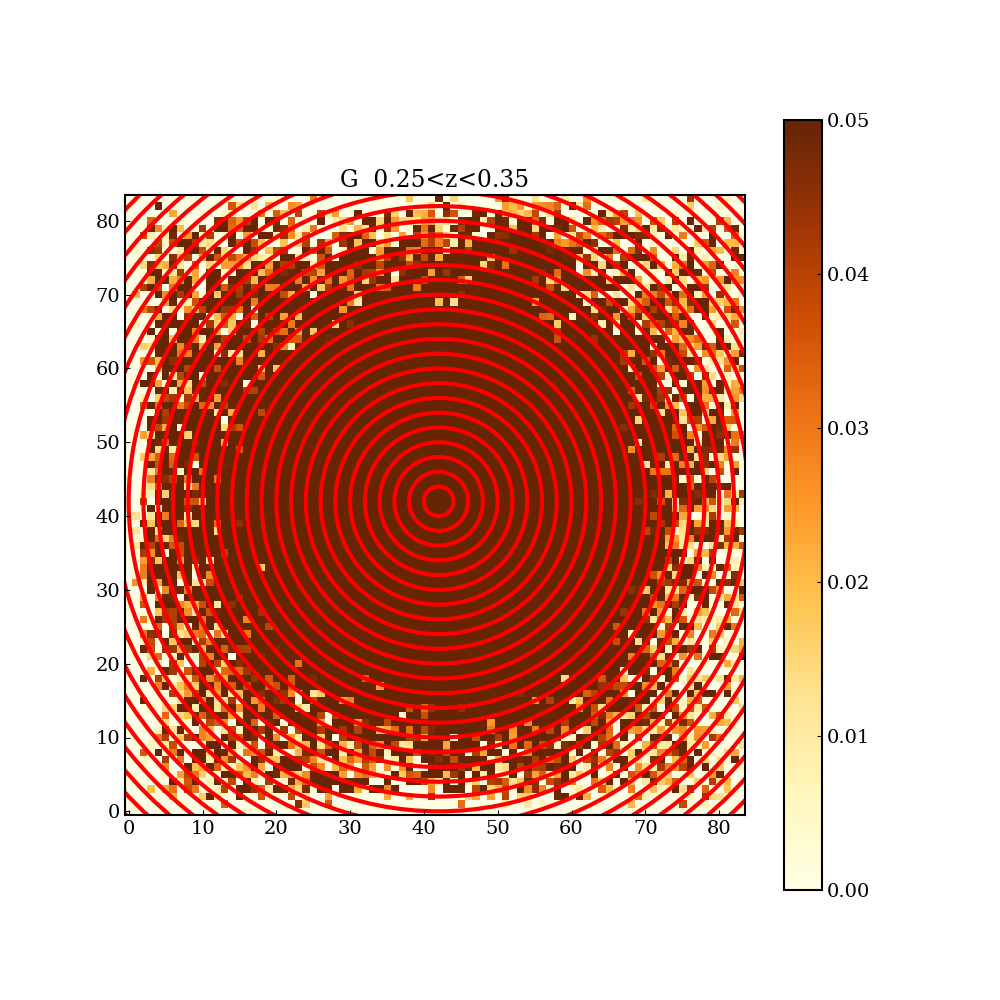

In [90]:
fig = plt.figure(figsize = (10,10), facecolor='white')

ax = fig.add_subplot(1,1, 1)

im = ax.imshow(Row_Median_Z_025_035, origin="lower", cmap="YlOrBr", vmin=0, vmax=0.05)

coord_offset = 0.5 * (ax.get_xlim()[0] + ax.get_xlim()[1])


circle1 = Circle((42,42), 2, edgecolor='r', facecolor="None", linewidth=3)
circle2 = Circle((42,42), 4, edgecolor='r', facecolor="None", linewidth=3)
circle3 = Circle((42,42), 6, edgecolor='r', facecolor="None", linewidth=3)
circle4 = Circle((42,42), 8, edgecolor='r', facecolor="None", linewidth=3)
circle5 = Circle((42,42), 10, edgecolor='r', facecolor="None", linewidth=3)
circle6 = Circle((42,42), 12, edgecolor='r', facecolor="None", linewidth=3)
circle7 = Circle((42,42), 14, edgecolor='r', facecolor="None", linewidth=3)
circle8 = Circle((42,42), 16, edgecolor='r', facecolor="None", linewidth=3)
circle9 = Circle((42,42), 18, edgecolor='r', facecolor="None", linewidth=3)
circle10 = Circle((42,42), 20, edgecolor='r', facecolor="None", linewidth=3)
circle11 = Circle((42,42), 22, edgecolor='r', facecolor="None", linewidth=3)
circle12 = Circle((42,42), 24, edgecolor='r', facecolor="None", linewidth=3)
circle13 = Circle((42,42), 26, edgecolor='r', facecolor="None", linewidth=3)
circle14 = Circle((42,42), 28, edgecolor='r', facecolor="None", linewidth=3)
circle15 = Circle((42,42), 30, edgecolor='r', facecolor="None", linewidth=3)
circle16 = Circle((42,42), 32, edgecolor='r', facecolor="None", linewidth=3)
circle17 = Circle((42,42), 34, edgecolor='r', facecolor="None", linewidth=3)
circle18 = Circle((42,42), 36, edgecolor='r', facecolor="None", linewidth=3)
circle19 = Circle((42,42), 38, edgecolor='r', facecolor="None", linewidth=3)
circle20 = Circle((42,42), 40, edgecolor='r', facecolor="None", linewidth=3)
circle21 = Circle((42,42), 42, edgecolor='r', facecolor="None", linewidth=3)
circle22 = Circle((42,42), 44, edgecolor='r', facecolor="None", linewidth=3)
circle23 = Circle((42,42), 46, edgecolor='r', facecolor="None", linewidth=3)
circle24 = Circle((42,42), 48, edgecolor='r', facecolor="None", linewidth=3)
circle25 = Circle((42,42), 50, edgecolor='r', facecolor="None", linewidth=3)
circle26 = Circle((42,42), 52, edgecolor='r', facecolor="None", linewidth=3)
circle27 = Circle((42,42), 54, edgecolor='r', facecolor="None", linewidth=3)
circle28 = Circle((42,42), 56, edgecolor='r', facecolor="None", linewidth=3)
circle29 = Circle((42,42), 58, edgecolor='r', facecolor="None", linewidth=3)
circle30 = Circle((42,42), 60, edgecolor='r', facecolor="None", linewidth=3)
circle31 = Circle((42,42), 62, edgecolor='r', facecolor="None", linewidth=3)
circle32 = Circle((42,42), 64, edgecolor='r', facecolor="None", linewidth=3)
circle33 = Circle((42,42), 66, edgecolor='r', facecolor="None", linewidth=3)
circle34 = Circle((42,42), 68, edgecolor='r', facecolor="None", linewidth=3)
circle35 = Circle((42,42), 70, edgecolor='r', facecolor="None", linewidth=3)
circle36 = Circle((42,42), 72, edgecolor='r', facecolor="None", linewidth=3)
circle37 = Circle((42,42), 74, edgecolor='r', facecolor="None", linewidth=3)
circle38 = Circle((42,42), 76, edgecolor='r', facecolor="None", linewidth=3)
circle39 = Circle((42,42), 78, edgecolor='r', facecolor="None", linewidth=3)
circle40 = Circle((42,42), 80, edgecolor='r', facecolor="None", linewidth=3)
circle41 = Circle((42,42), 82, edgecolor='r', facecolor="None", linewidth=3)
circle42 = Circle((42,42), 84, edgecolor='r', facecolor="None", linewidth=3)



# Add the circle to the axes
ax.add_patch(circle1)
ax.add_patch(circle2)
ax.add_patch(circle3)
ax.add_patch(circle4)
ax.add_patch(circle5)
ax.add_patch(circle6)
ax.add_patch(circle7)
ax.add_patch(circle8)
ax.add_patch(circle9)
ax.add_patch(circle10)
ax.add_patch(circle11)
ax.add_patch(circle12)
ax.add_patch(circle13)
ax.add_patch(circle14)
ax.add_patch(circle15)
ax.add_patch(circle16)
ax.add_patch(circle17)
ax.add_patch(circle18)
ax.add_patch(circle19)
ax.add_patch(circle20)
ax.add_patch(circle21)
ax.add_patch(circle22)
ax.add_patch(circle23)
ax.add_patch(circle24)
ax.add_patch(circle25)
ax.add_patch(circle26)
ax.add_patch(circle27)
ax.add_patch(circle28)
ax.add_patch(circle29)
ax.add_patch(circle30)
ax.add_patch(circle31)
ax.add_patch(circle32)
ax.add_patch(circle33)
ax.add_patch(circle34)
ax.add_patch(circle35)
ax.add_patch(circle36)
ax.add_patch(circle37)
ax.add_patch(circle38)
ax.add_patch(circle39)
ax.add_patch(circle40)
ax.add_patch(circle41)
ax.add_patch(circle42)






filename = "G  0.25<z<0.35"

plt.colorbar(im, ax=ax)

#plt.xlim(30,50)
#plt.ylim(30,50)

plt.title(str(filename))

In [91]:
A_average_025_035 = np.mean(A_circle_025_035)
B_average_025_035 = np.mean(B_circle_025_035)
C_average_025_035 = np.mean(C_circle_025_035)
D_average_025_035 = np.mean(D_circle_025_035)
E_average_025_035 = np.mean(E_circle_025_035)
F_average_025_035 = np.mean(F_circle_025_035)
G_average_025_035 = np.mean(G_circle_025_035)
H_average_025_035 = np.mean(H_circle_025_035)
I_average_025_035 = np.mean(I_circle_025_035)
J_average_025_035 = np.mean(J_circle_025_035)
K_average_025_035 = np.mean(K_circle_025_035)
L_average_025_035 = np.mean(L_circle_025_035)
M_average_025_035 = np.mean(M_circle_025_035)
N_average_025_035 = np.mean(N_circle_025_035)
O_average_025_035 = np.mean(O_circle_025_035)
P_average_025_035 = np.mean(P_circle_025_035)
Q_average_025_035 = np.mean(Q_circle_025_035)
R_average_025_035 = np.mean(R_circle_025_035)
S_average_025_035 = np.mean(S_circle_025_035)
T_average_025_035 = np.mean(T_circle_025_035)
U_average_025_035 = np.mean(U_circle_025_035)
V_average_025_035 = np.mean(V_circle_025_035)
W_average_025_035 = np.mean(W_circle_025_035)
X_average_025_035 = np.mean(X_circle_025_035)
Y_average_025_035 = np.mean(Y_circle_025_035)
Z_average_025_035 = np.mean(Z_circle_025_035)
AA_average_025_035 = np.mean(AA_circle_025_035)
BB_average_025_035 = np.mean(BB_circle_025_035)
CC_average_025_035 = np.mean(CC_circle_025_035)
DD_average_025_035 = np.mean(DD_circle_025_035)
EE_average_025_035 = np.mean(EE_circle_025_035)
FF_average_025_035 = np.mean(FF_circle_025_035)
GG_average_025_035 = np.mean(GG_circle_025_035)
HH_average_025_035 = np.mean(HH_circle_025_035)
II_average_025_035 = np.mean(II_circle_025_035)
JJ_average_025_035 = np.mean(JJ_circle_025_035)
KK_average_025_035 = np.mean(KK_circle_025_035)
LL_average_025_035 = np.mean(LL_circle_025_035)
MM_average_025_035 = np.mean(MM_circle_025_035)
NN_average_025_035 = np.mean(NN_circle_025_035)
OO_average_025_035 = np.mean(OO_circle_025_035)
PP_average_025_035 = np.mean(PP_circle_025_035)


In [92]:
A_circle_SDE_025_035 = statistics.stdev(A_circle_025_035)/np.sqrt(len(A_circle_025_035))
B_circle_SDE_025_035 = statistics.stdev(B_circle_025_035)/np.sqrt(len(B_circle_025_035))
C_circle_SDE_025_035 = statistics.stdev(C_circle_025_035)/np.sqrt(len(C_circle_025_035))
D_circle_SDE_025_035 = statistics.stdev(D_circle_025_035)/np.sqrt(len(D_circle_025_035))
E_circle_SDE_025_035 = statistics.stdev(E_circle_025_035)/np.sqrt(len(E_circle_025_035))
F_circle_SDE_025_035 = statistics.stdev(F_circle_025_035)/np.sqrt(len(F_circle_025_035))
G_circle_SDE_025_035 = statistics.stdev(G_circle_025_035)/np.sqrt(len(G_circle_025_035))
H_circle_SDE_025_035 = statistics.stdev(H_circle_025_035)/np.sqrt(len(H_circle_025_035))
I_circle_SDE_025_035 = statistics.stdev(I_circle_025_035)/np.sqrt(len(I_circle_025_035))
J_circle_SDE_025_035 = statistics.stdev(J_circle_025_035)/np.sqrt(len(J_circle_025_035))
K_circle_SDE_025_035 = statistics.stdev(K_circle_025_035)/np.sqrt(len(K_circle_025_035))
L_circle_SDE_025_035 = statistics.stdev(L_circle_025_035)/np.sqrt(len(L_circle_025_035))
M_circle_SDE_025_035 = statistics.stdev(M_circle_025_035)/np.sqrt(len(M_circle_025_035))
N_circle_SDE_025_035 = statistics.stdev(N_circle_025_035)/np.sqrt(len(N_circle_025_035))
O_circle_SDE_025_035 = statistics.stdev(O_circle_025_035)/np.sqrt(len(O_circle_025_035))
P_circle_SDE_025_035 = statistics.stdev(P_circle_025_035)/np.sqrt(len(P_circle_025_035))
Q_circle_SDE_025_035 = statistics.stdev(Q_circle_025_035)/np.sqrt(len(Q_circle_025_035))
R_circle_SDE_025_035 = statistics.stdev(R_circle_025_035)/np.sqrt(len(R_circle_025_035))
S_circle_SDE_025_035 = statistics.stdev(S_circle_025_035)/np.sqrt(len(S_circle_025_035))
T_circle_SDE_025_035 = statistics.stdev(T_circle_025_035)/np.sqrt(len(T_circle_025_035))
U_circle_SDE_025_035 = statistics.stdev(U_circle_025_035)/np.sqrt(len(U_circle_025_035))
V_circle_SDE_025_035 = statistics.stdev(V_circle_025_035)/np.sqrt(len(V_circle_025_035))
W_circle_SDE_025_035 = statistics.stdev(W_circle_025_035)/np.sqrt(len(W_circle_025_035))
X_circle_SDE_025_035 = statistics.stdev(X_circle_025_035)/np.sqrt(len(X_circle_025_035))
Y_circle_SDE_025_035 = statistics.stdev(Y_circle_025_035)/np.sqrt(len(Y_circle_025_035))
Z_circle_SDE_025_035 = statistics.stdev(Z_circle_025_035)/np.sqrt(len(Z_circle_025_035))
AA_circle_SDE_025_035 = statistics.stdev(AA_circle_025_035)/np.sqrt(len(AA_circle_025_035))
BB_circle_SDE_025_035 = statistics.stdev(BB_circle_025_035)/np.sqrt(len(BB_circle_025_035))
CC_circle_SDE_025_035 = statistics.stdev(CC_circle_025_035)/np.sqrt(len(CC_circle_025_035))
DD_circle_SDE_025_035 = statistics.stdev(DD_circle_025_035)/np.sqrt(len(DD_circle_025_035))
EE_circle_SDE_025_035 = statistics.stdev(EE_circle_025_035)/np.sqrt(len(EE_circle_025_035))
FF_circle_SDE_025_035 = statistics.stdev(FF_circle_025_035)/np.sqrt(len(FF_circle_025_035))
GG_circle_SDE_025_035 = statistics.stdev(GG_circle_025_035)/np.sqrt(len(GG_circle_025_035))
HH_circle_SDE_025_035 = statistics.stdev(HH_circle_025_035)/np.sqrt(len(HH_circle_025_035))
II_circle_SDE_025_035 = statistics.stdev(II_circle_025_035)/np.sqrt(len(II_circle_025_035))
JJ_circle_SDE_025_035 = statistics.stdev(JJ_circle_025_035)/np.sqrt(len(JJ_circle_025_035))
KK_circle_SDE_025_035 = statistics.stdev(KK_circle_025_035)/np.sqrt(len(KK_circle_025_035))
LL_circle_SDE_025_035 = statistics.stdev(LL_circle_025_035)/np.sqrt(len(LL_circle_025_035))
MM_circle_SDE_025_035 = statistics.stdev(MM_circle_025_035)/np.sqrt(len(MM_circle_025_035))
NN_circle_SDE_025_035 = statistics.stdev(NN_circle_025_035)/np.sqrt(len(NN_circle_025_035))
OO_circle_SDE_025_035 = statistics.stdev(OO_circle_025_035)/np.sqrt(len(OO_circle_025_035))
PP_circle_SDE_025_035 = statistics.stdev(PP_circle_025_035)/np.sqrt(len(PP_circle_025_035))

In [93]:
Radius_array_025_035 = np.array([A_average_025_035 , B_average_025_035 , C_average_025_035 , D_average_025_035 , E_average_025_035 , F_average_025_035 , G_average_025_035 , H_average_025_035 , I_average_025_035 , J_average_025_035 , K_average_025_035 , L_average_025_035 , M_average_025_035 , N_average_025_035 , O_average_025_035 , P_average_025_035 , Q_average_025_035 , R_average_025_035 , S_average_025_035 , T_average_025_035 , U_average_025_035 , V_average_025_035 , W_average_025_035 , X_average_025_035 , Y_average_025_035 , Z_average_025_035 , AA_average_025_035, BB_average_025_035, CC_average_025_035, DD_average_025_035, EE_average_025_035, FF_average_025_035, GG_average_025_035, HH_average_025_035, II_average_025_035, JJ_average_025_035, KK_average_025_035, LL_average_025_035, MM_average_025_035,NN_average_025_035, OO_average_025_035, PP_average_025_035])
Radius_array_SDE_025_035 = np.array([A_circle_SDE_025_035 , B_circle_SDE_025_035 , C_circle_SDE_025_035 , D_circle_SDE_025_035 , E_circle_SDE_025_035 , F_circle_SDE_025_035 , G_circle_SDE_025_035 , H_circle_SDE_025_035 , I_circle_SDE_025_035 , J_circle_SDE_025_035 , K_circle_SDE_025_035 , L_circle_SDE_025_035 , M_circle_SDE_025_035 , N_circle_SDE_025_035 , O_circle_SDE_025_035 , P_circle_SDE_025_035 , Q_circle_SDE_025_035 , R_circle_SDE_025_035 , S_circle_SDE_025_035 , T_circle_SDE_025_035 , U_circle_SDE_025_035 , V_circle_SDE_025_035 , W_circle_SDE_025_035 , X_circle_SDE_025_035 , Y_circle_SDE_025_035 , Z_circle_SDE_025_035 , AA_circle_SDE_025_035, BB_circle_SDE_025_035, CC_circle_SDE_025_035, DD_circle_SDE_025_035, EE_circle_SDE_025_035, FF_circle_SDE_025_035, GG_circle_SDE_025_035, HH_circle_SDE_025_035, II_circle_SDE_025_035, JJ_circle_SDE_025_035, KK_circle_SDE_025_035, LL_circle_SDE_025_035, MM_circle_SDE_025_035, NN_circle_SDE_025_035, OO_circle_SDE_025_035, PP_circle_SDE_025_035])


In [94]:
A_circle_035_045 = []

for i in np.arange(84):
    for j in np.arange(84):
        if (i+j-84)**(2) <= 2**2:
            A_circle_035_045.append(Row_Median_Y_035_045[i][j])

In [95]:
B_circle_035_045 = circle_gather(Row_Median_Z_035_045, 2, 4)
C_circle_035_045 = circle_gather(Row_Median_Z_035_045, 4, 6)
D_circle_035_045 = circle_gather(Row_Median_Z_035_045, 6, 8)
E_circle_035_045 = circle_gather(Row_Median_Z_035_045, 8, 10)
F_circle_035_045 = circle_gather(Row_Median_Z_035_045, 10, 12)
G_circle_035_045 = circle_gather(Row_Median_Z_035_045, 12, 14)
H_circle_035_045 = circle_gather(Row_Median_Z_035_045, 14, 16)
I_circle_035_045 = circle_gather(Row_Median_Z_035_045, 16, 18)
J_circle_035_045 = circle_gather(Row_Median_Z_035_045, 18, 20)
K_circle_035_045 = circle_gather(Row_Median_Z_035_045, 20, 22)
L_circle_035_045 = circle_gather(Row_Median_Z_035_045, 22, 24)
M_circle_035_045 = circle_gather(Row_Median_Z_035_045, 24, 26)
N_circle_035_045 = circle_gather(Row_Median_Z_035_045, 26, 28)
O_circle_035_045 = circle_gather(Row_Median_Z_035_045, 28, 30)
P_circle_035_045 = circle_gather(Row_Median_Z_035_045, 30, 32)
Q_circle_035_045 = circle_gather(Row_Median_Z_035_045, 32, 34)
R_circle_035_045 = circle_gather(Row_Median_Z_035_045, 34, 36)
S_circle_035_045 = circle_gather(Row_Median_Z_035_045, 36, 38)
T_circle_035_045 = circle_gather(Row_Median_Z_035_045, 38, 40)
U_circle_035_045 = circle_gather(Row_Median_Z_035_045, 40, 42)
V_circle_035_045 = circle_gather(Row_Median_Z_035_045, 42, 44)
W_circle_035_045 = circle_gather(Row_Median_Z_035_045, 44, 46)
X_circle_035_045 = circle_gather(Row_Median_Z_035_045, 46, 48)
Y_circle_035_045 = circle_gather(Row_Median_Z_035_045, 48, 50)
Z_circle_035_045 = circle_gather(Row_Median_Z_035_045, 50, 52)
AA_circle_035_045 = circle_gather(Row_Median_Z_035_045, 52, 54)
BB_circle_035_045 = circle_gather(Row_Median_Z_035_045, 54, 56)
CC_circle_035_045 = circle_gather(Row_Median_Z_035_045, 56, 58)
DD_circle_035_045 = circle_gather(Row_Median_Z_035_045, 58, 60)
EE_circle_035_045 = circle_gather(Row_Median_Z_035_045, 60, 62)
FF_circle_035_045 = circle_gather(Row_Median_Z_035_045, 62, 64)
GG_circle_035_045 = circle_gather(Row_Median_Z_035_045, 64, 66)
HH_circle_035_045 = circle_gather(Row_Median_Z_035_045, 66, 68)
II_circle_035_045 = circle_gather(Row_Median_Z_035_045, 68, 70)
JJ_circle_035_045 = circle_gather(Row_Median_Z_035_045, 70, 72)
KK_circle_035_045 = circle_gather(Row_Median_Z_035_045, 72, 74)
LL_circle_035_045 = circle_gather(Row_Median_Z_035_045, 74, 76)
MM_circle_035_045 = circle_gather(Row_Median_Z_035_045, 76, 78)
NN_circle_035_045 = circle_gather(Row_Median_Z_035_045, 78, 80)
OO_circle_035_045 = circle_gather(Row_Median_Z_035_045, 80, 82)
PP_circle_035_045 = circle_gather(Row_Median_Z_035_045, 82, 84)


Text(0.5, 1.0, 'G  0.35<z<0.45')

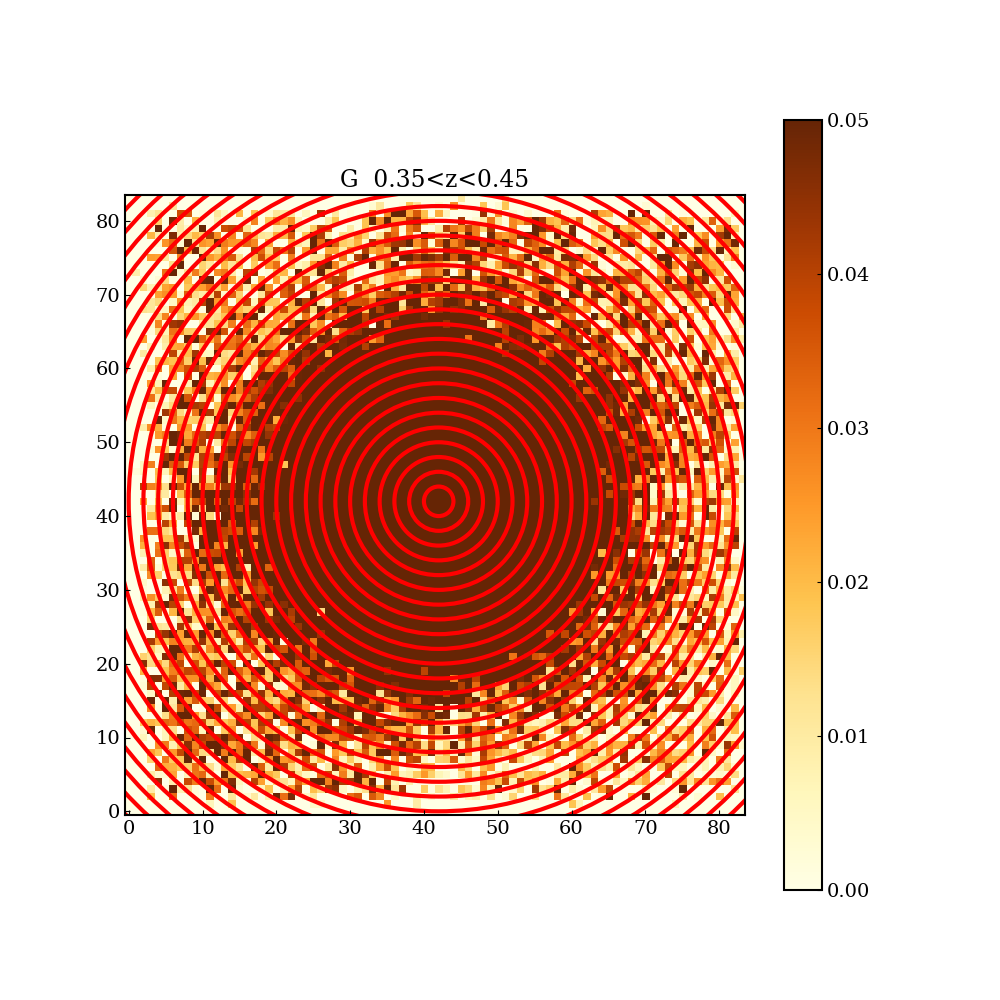

In [96]:
fig = plt.figure(figsize = (10,10), facecolor='white')

ax = fig.add_subplot(1,1, 1)

im = ax.imshow(Row_Median_Z_035_045, origin="lower", cmap="YlOrBr", vmin=0, vmax=0.05)

coord_offset = 0.5 * (ax.get_xlim()[0] + ax.get_xlim()[1])


circle1 = Circle((42,42), 2, edgecolor='r', facecolor="None", linewidth=3)
circle2 = Circle((42,42), 4, edgecolor='r', facecolor="None", linewidth=3)
circle3 = Circle((42,42), 6, edgecolor='r', facecolor="None", linewidth=3)
circle4 = Circle((42,42), 8, edgecolor='r', facecolor="None", linewidth=3)
circle5 = Circle((42,42), 10, edgecolor='r', facecolor="None", linewidth=3)
circle6 = Circle((42,42), 12, edgecolor='r', facecolor="None", linewidth=3)
circle7 = Circle((42,42), 14, edgecolor='r', facecolor="None", linewidth=3)
circle8 = Circle((42,42), 16, edgecolor='r', facecolor="None", linewidth=3)
circle9 = Circle((42,42), 18, edgecolor='r', facecolor="None", linewidth=3)
circle10 = Circle((42,42), 20, edgecolor='r', facecolor="None", linewidth=3)
circle11 = Circle((42,42), 22, edgecolor='r', facecolor="None", linewidth=3)
circle12 = Circle((42,42), 24, edgecolor='r', facecolor="None", linewidth=3)
circle13 = Circle((42,42), 26, edgecolor='r', facecolor="None", linewidth=3)
circle14 = Circle((42,42), 28, edgecolor='r', facecolor="None", linewidth=3)
circle15 = Circle((42,42), 30, edgecolor='r', facecolor="None", linewidth=3)
circle16 = Circle((42,42), 32, edgecolor='r', facecolor="None", linewidth=3)
circle17 = Circle((42,42), 34, edgecolor='r', facecolor="None", linewidth=3)
circle18 = Circle((42,42), 36, edgecolor='r', facecolor="None", linewidth=3)
circle19 = Circle((42,42), 38, edgecolor='r', facecolor="None", linewidth=3)
circle20 = Circle((42,42), 40, edgecolor='r', facecolor="None", linewidth=3)
circle21 = Circle((42,42), 42, edgecolor='r', facecolor="None", linewidth=3)
circle22 = Circle((42,42), 44, edgecolor='r', facecolor="None", linewidth=3)
circle23 = Circle((42,42), 46, edgecolor='r', facecolor="None", linewidth=3)
circle24 = Circle((42,42), 48, edgecolor='r', facecolor="None", linewidth=3)
circle25 = Circle((42,42), 50, edgecolor='r', facecolor="None", linewidth=3)
circle26 = Circle((42,42), 52, edgecolor='r', facecolor="None", linewidth=3)
circle27 = Circle((42,42), 54, edgecolor='r', facecolor="None", linewidth=3)
circle28 = Circle((42,42), 56, edgecolor='r', facecolor="None", linewidth=3)
circle29 = Circle((42,42), 58, edgecolor='r', facecolor="None", linewidth=3)
circle30 = Circle((42,42), 60, edgecolor='r', facecolor="None", linewidth=3)
circle31 = Circle((42,42), 62, edgecolor='r', facecolor="None", linewidth=3)
circle32 = Circle((42,42), 64, edgecolor='r', facecolor="None", linewidth=3)
circle33 = Circle((42,42), 66, edgecolor='r', facecolor="None", linewidth=3)
circle34 = Circle((42,42), 68, edgecolor='r', facecolor="None", linewidth=3)
circle35 = Circle((42,42), 70, edgecolor='r', facecolor="None", linewidth=3)
circle36 = Circle((42,42), 72, edgecolor='r', facecolor="None", linewidth=3)
circle37 = Circle((42,42), 74, edgecolor='r', facecolor="None", linewidth=3)
circle38 = Circle((42,42), 76, edgecolor='r', facecolor="None", linewidth=3)
circle39 = Circle((42,42), 78, edgecolor='r', facecolor="None", linewidth=3)
circle40 = Circle((42,42), 80, edgecolor='r', facecolor="None", linewidth=3)
circle41 = Circle((42,42), 82, edgecolor='r', facecolor="None", linewidth=3)
circle42 = Circle((42,42), 84, edgecolor='r', facecolor="None", linewidth=3)



# Add the circle to the axes
ax.add_patch(circle1)
ax.add_patch(circle2)
ax.add_patch(circle3)
ax.add_patch(circle4)
ax.add_patch(circle5)
ax.add_patch(circle6)
ax.add_patch(circle7)
ax.add_patch(circle8)
ax.add_patch(circle9)
ax.add_patch(circle10)
ax.add_patch(circle11)
ax.add_patch(circle12)
ax.add_patch(circle13)
ax.add_patch(circle14)
ax.add_patch(circle15)
ax.add_patch(circle16)
ax.add_patch(circle17)
ax.add_patch(circle18)
ax.add_patch(circle19)
ax.add_patch(circle20)
ax.add_patch(circle21)
ax.add_patch(circle22)
ax.add_patch(circle23)
ax.add_patch(circle24)
ax.add_patch(circle25)
ax.add_patch(circle26)
ax.add_patch(circle27)
ax.add_patch(circle28)
ax.add_patch(circle29)
ax.add_patch(circle30)
ax.add_patch(circle31)
ax.add_patch(circle32)
ax.add_patch(circle33)
ax.add_patch(circle34)
ax.add_patch(circle35)
ax.add_patch(circle36)
ax.add_patch(circle37)
ax.add_patch(circle38)
ax.add_patch(circle39)
ax.add_patch(circle40)
ax.add_patch(circle41)
ax.add_patch(circle42)






filename = "G  0.35<z<0.45"

plt.colorbar(im, ax=ax)

plt.title(str(filename))

In [97]:
A_average_035_045 = np.mean(A_circle_035_045)
B_average_035_045 = np.mean(B_circle_035_045)
C_average_035_045 = np.mean(C_circle_035_045)
D_average_035_045 = np.mean(D_circle_035_045)
E_average_035_045 = np.mean(E_circle_035_045)
F_average_035_045 = np.mean(F_circle_035_045)
G_average_035_045 = np.mean(G_circle_035_045)
H_average_035_045 = np.mean(H_circle_035_045)
I_average_035_045 = np.mean(I_circle_035_045)
J_average_035_045 = np.mean(J_circle_035_045)
K_average_035_045 = np.mean(K_circle_035_045)
L_average_035_045 = np.mean(L_circle_035_045)
M_average_035_045 = np.mean(M_circle_035_045)
N_average_035_045 = np.mean(N_circle_035_045)
O_average_035_045 = np.mean(O_circle_035_045)
P_average_035_045 = np.mean(P_circle_035_045)
Q_average_035_045 = np.mean(Q_circle_035_045)
R_average_035_045 = np.mean(R_circle_035_045)
S_average_035_045 = np.mean(S_circle_035_045)
T_average_035_045 = np.mean(T_circle_035_045)
U_average_035_045 = np.mean(U_circle_035_045)
V_average_035_045 = np.mean(V_circle_035_045)
W_average_035_045 = np.mean(W_circle_035_045)
X_average_035_045 = np.mean(X_circle_035_045)
Y_average_035_045 = np.mean(Y_circle_035_045)
Z_average_035_045 = np.mean(Z_circle_035_045)
AA_average_035_045 = np.mean(AA_circle_035_045)
BB_average_035_045 = np.mean(BB_circle_035_045)
CC_average_035_045 = np.mean(CC_circle_035_045)
DD_average_035_045 = np.mean(DD_circle_035_045)
EE_average_035_045 = np.mean(EE_circle_035_045)
FF_average_035_045 = np.mean(FF_circle_035_045)
GG_average_035_045 = np.mean(GG_circle_035_045)
HH_average_035_045 = np.mean(HH_circle_035_045)
II_average_035_045 = np.mean(II_circle_035_045)
JJ_average_035_045 = np.mean(JJ_circle_035_045)
KK_average_035_045 = np.mean(KK_circle_035_045)
LL_average_035_045 = np.mean(LL_circle_035_045)
MM_average_035_045 = np.mean(MM_circle_035_045)
NN_average_035_045 = np.mean(NN_circle_035_045)
OO_average_035_045 = np.mean(OO_circle_035_045)
PP_average_035_045 = np.mean(PP_circle_035_045)


In [98]:
A_cirlce_SDE_035_045 = statistics.stdev(A_circle_035_045)/np.sqrt(len(A_circle_035_045))
B_circle_SDE_035_045 = statistics.stdev(B_circle_035_045)/np.sqrt(len(B_circle_035_045))
C_circle_SDE_035_045 = statistics.stdev(C_circle_035_045)/np.sqrt(len(C_circle_035_045))
D_circle_SDE_035_045 = statistics.stdev(D_circle_035_045)/np.sqrt(len(D_circle_035_045))
E_circle_SDE_035_045 = statistics.stdev(E_circle_035_045)/np.sqrt(len(E_circle_035_045))
F_circle_SDE_035_045 = statistics.stdev(F_circle_035_045)/np.sqrt(len(F_circle_035_045))
G_circle_SDE_035_045 = statistics.stdev(G_circle_035_045)/np.sqrt(len(G_circle_035_045))
H_circle_SDE_035_045 = statistics.stdev(H_circle_035_045)/np.sqrt(len(H_circle_035_045))
I_circle_SDE_035_045 = statistics.stdev(I_circle_035_045)/np.sqrt(len(I_circle_035_045))
J_circle_SDE_035_045 = statistics.stdev(J_circle_035_045)/np.sqrt(len(J_circle_035_045))
K_circle_SDE_035_045 = statistics.stdev(K_circle_035_045)/np.sqrt(len(K_circle_035_045))
L_circle_SDE_035_045 = statistics.stdev(L_circle_035_045)/np.sqrt(len(L_circle_035_045))
M_circle_SDE_035_045 = statistics.stdev(M_circle_035_045)/np.sqrt(len(M_circle_035_045))
N_circle_SDE_035_045 = statistics.stdev(N_circle_035_045)/np.sqrt(len(N_circle_035_045))
O_circle_SDE_035_045 = statistics.stdev(O_circle_035_045)/np.sqrt(len(O_circle_035_045))
P_circle_SDE_035_045 = statistics.stdev(P_circle_035_045)/np.sqrt(len(P_circle_035_045))
Q_circle_SDE_035_045 = statistics.stdev(Q_circle_035_045)/np.sqrt(len(Q_circle_035_045))
R_circle_SDE_035_045 = statistics.stdev(R_circle_035_045)/np.sqrt(len(R_circle_035_045))
S_circle_SDE_035_045 = statistics.stdev(S_circle_035_045)/np.sqrt(len(S_circle_035_045))
T_circle_SDE_035_045 = statistics.stdev(T_circle_035_045)/np.sqrt(len(T_circle_035_045))
U_circle_SDE_035_045 = statistics.stdev(U_circle_035_045)/np.sqrt(len(U_circle_035_045))
V_circle_SDE_035_045 = statistics.stdev(V_circle_035_045)/np.sqrt(len(V_circle_035_045))
W_circle_SDE_035_045 = statistics.stdev(W_circle_035_045)/np.sqrt(len(W_circle_035_045))
X_circle_SDE_035_045 = statistics.stdev(X_circle_035_045)/np.sqrt(len(X_circle_035_045))
Y_circle_SDE_035_045 = statistics.stdev(Y_circle_035_045)/np.sqrt(len(Y_circle_035_045))
Z_circle_SDE_035_045 = statistics.stdev(Z_circle_035_045)/np.sqrt(len(Z_circle_035_045))
AA_circle_SDE_035_045 = statistics.stdev(AA_circle_035_045)/np.sqrt(len(AA_circle_035_045))
BB_circle_SDE_035_045 = statistics.stdev(BB_circle_035_045)/np.sqrt(len(BB_circle_035_045))
CC_circle_SDE_035_045 = statistics.stdev(CC_circle_035_045)/np.sqrt(len(CC_circle_035_045))
DD_circle_SDE_035_045 = statistics.stdev(DD_circle_035_045)/np.sqrt(len(DD_circle_035_045))
EE_circle_SDE_035_045 = statistics.stdev(EE_circle_035_045)/np.sqrt(len(EE_circle_035_045))
FF_circle_SDE_035_045 = statistics.stdev(FF_circle_035_045)/np.sqrt(len(FF_circle_035_045))
GG_circle_SDE_035_045 = statistics.stdev(GG_circle_035_045)/np.sqrt(len(GG_circle_035_045))
HH_circle_SDE_035_045 = statistics.stdev(HH_circle_035_045)/np.sqrt(len(HH_circle_035_045))
II_circle_SDE_035_045 = statistics.stdev(II_circle_035_045)/np.sqrt(len(II_circle_035_045))
JJ_circle_SDE_035_045 = statistics.stdev(JJ_circle_035_045)/np.sqrt(len(JJ_circle_035_045))
KK_circle_SDE_035_045 = statistics.stdev(KK_circle_035_045)/np.sqrt(len(KK_circle_035_045))
LL_circle_SDE_035_045 = statistics.stdev(LL_circle_035_045)/np.sqrt(len(LL_circle_035_045))
MM_circle_SDE_035_045 = statistics.stdev(MM_circle_035_045)/np.sqrt(len(MM_circle_035_045))
NN_circle_SDE_035_045 = statistics.stdev(NN_circle_035_045)/np.sqrt(len(NN_circle_035_045))
OO_circle_SDE_035_045 = statistics.stdev(OO_circle_035_045)/np.sqrt(len(OO_circle_035_045))
PP_circle_SDE_035_045 = statistics.stdev(PP_circle_035_045)/np.sqrt(len(PP_circle_035_045))


In [99]:
Radius_array_035_045 = np.array([A_average_035_045 , B_average_035_045 , C_average_035_045 , D_average_035_045 , E_average_035_045 , F_average_035_045 , G_average_035_045 , H_average_035_045 , I_average_035_045 , J_average_035_045 , K_average_035_045 , L_average_035_045 , M_average_035_045 , N_average_035_045 , O_average_035_045 , P_average_035_045 , Q_average_035_045 , R_average_035_045 , S_average_035_045 , T_average_035_045 , U_average_035_045 , V_average_035_045 , W_average_035_045 , X_average_035_045 , Y_average_035_045 , Z_average_035_045 , AA_average_035_045, BB_average_035_045, CC_average_035_045, DD_average_035_045, EE_average_035_045, FF_average_035_045, GG_average_035_045, HH_average_035_045, II_average_035_045, JJ_average_035_045, KK_average_035_045, LL_average_035_045, MM_average_035_045,NN_average_035_045, OO_average_035_045, PP_average_035_045])
Radius_array_SDE_035_045 = np.array([A_cirlce_SDE_035_045 , B_circle_SDE_035_045 , C_circle_SDE_035_045 , D_circle_SDE_035_045 , E_circle_SDE_035_045 , F_circle_SDE_035_045 , G_circle_SDE_035_045 , H_circle_SDE_035_045 , I_circle_SDE_035_045 , J_circle_SDE_035_045 , K_circle_SDE_035_045 , L_circle_SDE_035_045 , M_circle_SDE_035_045 , N_circle_SDE_035_045 , O_circle_SDE_035_045 , P_circle_SDE_035_045 , Q_circle_SDE_035_045 , R_circle_SDE_035_045 , S_circle_SDE_035_045 , T_circle_SDE_035_045 , U_circle_SDE_035_045 , V_circle_SDE_035_045 , W_circle_SDE_035_045 , X_circle_SDE_035_045 , Y_circle_SDE_035_045 , Z_circle_SDE_035_045 , AA_circle_SDE_035_045, BB_circle_SDE_035_045, CC_circle_SDE_035_045, DD_circle_SDE_035_045, EE_circle_SDE_035_045, FF_circle_SDE_035_045, GG_circle_SDE_035_045, HH_circle_SDE_035_045, II_circle_SDE_035_045, JJ_circle_SDE_035_045, KK_circle_SDE_035_045, LL_circle_SDE_035_045, MM_circle_SDE_035_045, NN_circle_SDE_035_045, OO_circle_SDE_035_045, PP_circle_SDE_035_045])


In [100]:
A_circle_045_055 = []

for i in np.arange(84):
    for j in np.arange(84):
        if (i+j-84)**(2) <= 2**2:
            A_circle_045_055.append(Row_Median_Z_045_055[i][j])

In [101]:
B_circle_045_055 = circle_gather(Row_Median_Z_045_055, 2, 4)
C_circle_045_055 = circle_gather(Row_Median_Z_045_055, 4, 6)
D_circle_045_055 = circle_gather(Row_Median_Z_045_055, 6, 8)
E_circle_045_055 = circle_gather(Row_Median_Z_045_055, 8, 10)
F_circle_045_055 = circle_gather(Row_Median_Z_045_055, 10, 12)
G_circle_045_055 = circle_gather(Row_Median_Z_045_055, 12, 14)
H_circle_045_055 = circle_gather(Row_Median_Z_045_055, 14, 16)
I_circle_045_055 = circle_gather(Row_Median_Z_045_055, 16, 18)
J_circle_045_055 = circle_gather(Row_Median_Z_045_055, 18, 20)
K_circle_045_055 = circle_gather(Row_Median_Z_045_055, 20, 22)
L_circle_045_055 = circle_gather(Row_Median_Z_045_055, 22, 24)
M_circle_045_055 = circle_gather(Row_Median_Z_045_055, 24, 26)
N_circle_045_055 = circle_gather(Row_Median_Z_045_055, 26, 28)
O_circle_045_055 = circle_gather(Row_Median_Z_045_055, 28, 30)
P_circle_045_055 = circle_gather(Row_Median_Z_045_055, 30, 32)
Q_circle_045_055 = circle_gather(Row_Median_Z_045_055, 32, 34)
R_circle_045_055 = circle_gather(Row_Median_Z_045_055, 34, 36)
S_circle_045_055 = circle_gather(Row_Median_Z_045_055, 36, 38)
T_circle_045_055 = circle_gather(Row_Median_Z_045_055, 38, 40)
U_circle_045_055 = circle_gather(Row_Median_Z_045_055, 40, 42)
V_circle_045_055 = circle_gather(Row_Median_Z_045_055, 42, 44)
W_circle_045_055 = circle_gather(Row_Median_Z_045_055, 44, 46)
X_circle_045_055 = circle_gather(Row_Median_Z_045_055, 46, 48)
Y_circle_045_055 = circle_gather(Row_Median_Z_045_055, 48, 50)
Z_circle_045_055 = circle_gather(Row_Median_Z_045_055, 50, 52)
AA_circle_045_055 = circle_gather(Row_Median_Z_045_055, 52, 54)
BB_circle_045_055 = circle_gather(Row_Median_Z_045_055, 54, 56)
CC_circle_045_055 = circle_gather(Row_Median_Z_045_055, 56, 58)
DD_circle_045_055 = circle_gather(Row_Median_Z_045_055, 58, 60)
EE_circle_045_055 = circle_gather(Row_Median_Z_045_055, 60, 62)
FF_circle_045_055 = circle_gather(Row_Median_Z_045_055, 62, 64)
GG_circle_045_055 = circle_gather(Row_Median_Z_045_055, 64, 66)
HH_circle_045_055 = circle_gather(Row_Median_Z_045_055, 66, 68)
II_circle_045_055 = circle_gather(Row_Median_Z_045_055, 68, 70)
JJ_circle_045_055 = circle_gather(Row_Median_Z_045_055, 70, 72)
KK_circle_045_055 = circle_gather(Row_Median_Z_045_055, 72, 74)
LL_circle_045_055 = circle_gather(Row_Median_Z_045_055, 74, 76)
MM_circle_045_055 = circle_gather(Row_Median_Z_045_055, 76, 78)
NN_circle_045_055 = circle_gather(Row_Median_Z_045_055, 78, 80)
OO_circle_045_055 = circle_gather(Row_Median_Z_045_055, 80, 82)
PP_circle_045_055 = circle_gather(Row_Median_Z_045_055, 82, 84)


Text(0.5, 1.0, 'G  0.45<z<0.55')

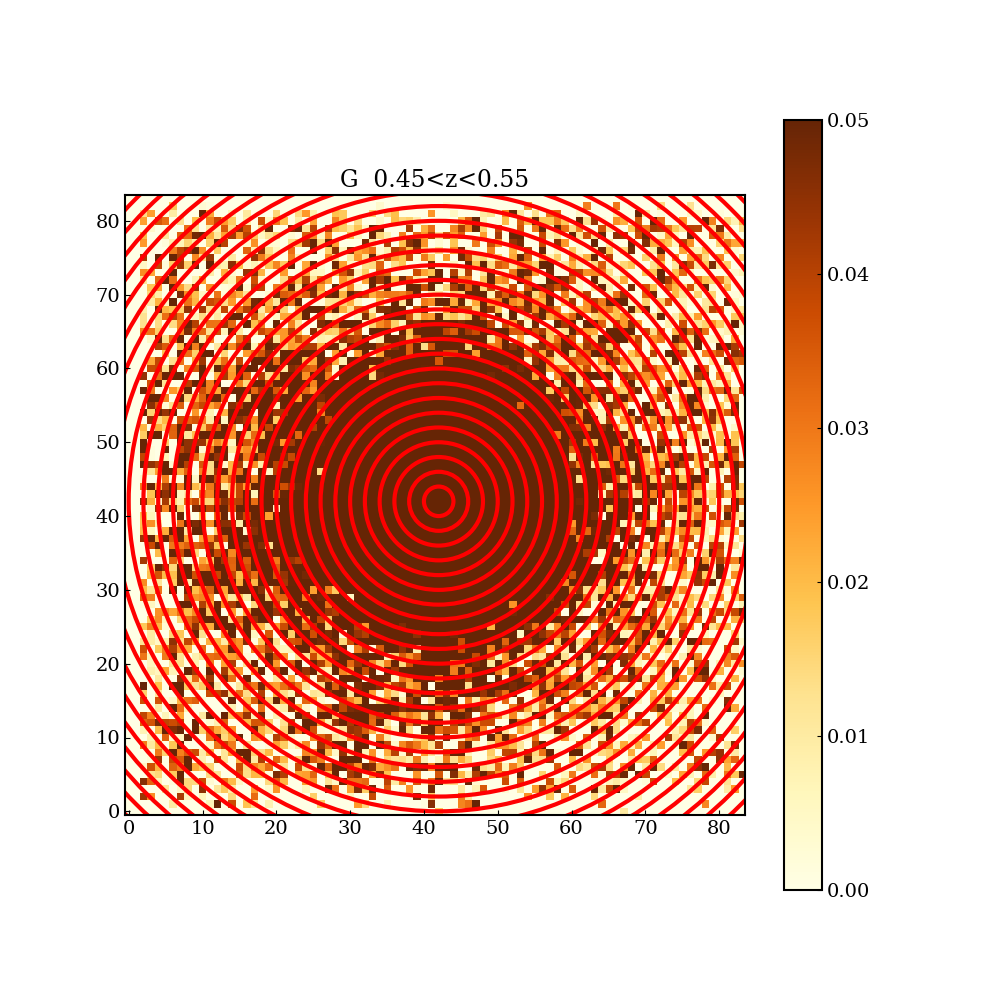

In [102]:
fig = plt.figure(figsize = (10,10), facecolor='white')

ax = fig.add_subplot(1,1, 1)

im = ax.imshow(Row_Median_Z_045_055, origin="lower", cmap="YlOrBr", vmin=0, vmax=0.05)

coord_offset = 0.5 * (ax.get_xlim()[0] + ax.get_xlim()[1])


circle1 = Circle((42,42), 2, edgecolor='r', facecolor="None", linewidth=3)
circle2 = Circle((42,42), 4, edgecolor='r', facecolor="None", linewidth=3)
circle3 = Circle((42,42), 6, edgecolor='r', facecolor="None", linewidth=3)
circle4 = Circle((42,42), 8, edgecolor='r', facecolor="None", linewidth=3)
circle5 = Circle((42,42), 10, edgecolor='r', facecolor="None", linewidth=3)
circle6 = Circle((42,42), 12, edgecolor='r', facecolor="None", linewidth=3)
circle7 = Circle((42,42), 14, edgecolor='r', facecolor="None", linewidth=3)
circle8 = Circle((42,42), 16, edgecolor='r', facecolor="None", linewidth=3)
circle9 = Circle((42,42), 18, edgecolor='r', facecolor="None", linewidth=3)
circle10 = Circle((42,42), 20, edgecolor='r', facecolor="None", linewidth=3)
circle11 = Circle((42,42), 22, edgecolor='r', facecolor="None", linewidth=3)
circle12 = Circle((42,42), 24, edgecolor='r', facecolor="None", linewidth=3)
circle13 = Circle((42,42), 26, edgecolor='r', facecolor="None", linewidth=3)
circle14 = Circle((42,42), 28, edgecolor='r', facecolor="None", linewidth=3)
circle15 = Circle((42,42), 30, edgecolor='r', facecolor="None", linewidth=3)
circle16 = Circle((42,42), 32, edgecolor='r', facecolor="None", linewidth=3)
circle17 = Circle((42,42), 34, edgecolor='r', facecolor="None", linewidth=3)
circle18 = Circle((42,42), 36, edgecolor='r', facecolor="None", linewidth=3)
circle19 = Circle((42,42), 38, edgecolor='r', facecolor="None", linewidth=3)
circle20 = Circle((42,42), 40, edgecolor='r', facecolor="None", linewidth=3)
circle21 = Circle((42,42), 42, edgecolor='r', facecolor="None", linewidth=3)
circle22 = Circle((42,42), 44, edgecolor='r', facecolor="None", linewidth=3)
circle23 = Circle((42,42), 46, edgecolor='r', facecolor="None", linewidth=3)
circle24 = Circle((42,42), 48, edgecolor='r', facecolor="None", linewidth=3)
circle25 = Circle((42,42), 50, edgecolor='r', facecolor="None", linewidth=3)
circle26 = Circle((42,42), 52, edgecolor='r', facecolor="None", linewidth=3)
circle27 = Circle((42,42), 54, edgecolor='r', facecolor="None", linewidth=3)
circle28 = Circle((42,42), 56, edgecolor='r', facecolor="None", linewidth=3)
circle29 = Circle((42,42), 58, edgecolor='r', facecolor="None", linewidth=3)
circle30 = Circle((42,42), 60, edgecolor='r', facecolor="None", linewidth=3)
circle31 = Circle((42,42), 62, edgecolor='r', facecolor="None", linewidth=3)
circle32 = Circle((42,42), 64, edgecolor='r', facecolor="None", linewidth=3)
circle33 = Circle((42,42), 66, edgecolor='r', facecolor="None", linewidth=3)
circle34 = Circle((42,42), 68, edgecolor='r', facecolor="None", linewidth=3)
circle35 = Circle((42,42), 70, edgecolor='r', facecolor="None", linewidth=3)
circle36 = Circle((42,42), 72, edgecolor='r', facecolor="None", linewidth=3)
circle37 = Circle((42,42), 74, edgecolor='r', facecolor="None", linewidth=3)
circle38 = Circle((42,42), 76, edgecolor='r', facecolor="None", linewidth=3)
circle39 = Circle((42,42), 78, edgecolor='r', facecolor="None", linewidth=3)
circle40 = Circle((42,42), 80, edgecolor='r', facecolor="None", linewidth=3)
circle41 = Circle((42,42), 82, edgecolor='r', facecolor="None", linewidth=3)
circle42 = Circle((42,42), 84, edgecolor='r', facecolor="None", linewidth=3)



# Add the circle to the axes
ax.add_patch(circle1)
ax.add_patch(circle2)
ax.add_patch(circle3)
ax.add_patch(circle4)
ax.add_patch(circle5)
ax.add_patch(circle6)
ax.add_patch(circle7)
ax.add_patch(circle8)
ax.add_patch(circle9)
ax.add_patch(circle10)
ax.add_patch(circle11)
ax.add_patch(circle12)
ax.add_patch(circle13)
ax.add_patch(circle14)
ax.add_patch(circle15)
ax.add_patch(circle16)
ax.add_patch(circle17)
ax.add_patch(circle18)
ax.add_patch(circle19)
ax.add_patch(circle20)
ax.add_patch(circle21)
ax.add_patch(circle22)
ax.add_patch(circle23)
ax.add_patch(circle24)
ax.add_patch(circle25)
ax.add_patch(circle26)
ax.add_patch(circle27)
ax.add_patch(circle28)
ax.add_patch(circle29)
ax.add_patch(circle30)
ax.add_patch(circle31)
ax.add_patch(circle32)
ax.add_patch(circle33)
ax.add_patch(circle34)
ax.add_patch(circle35)
ax.add_patch(circle36)
ax.add_patch(circle37)
ax.add_patch(circle38)
ax.add_patch(circle39)
ax.add_patch(circle40)
ax.add_patch(circle41)
ax.add_patch(circle42)






filename = "G  0.45<z<0.55"

plt.colorbar(im, ax=ax)

plt.title(str(filename))

In [103]:
A_average_045_055 = np.mean(A_circle_045_055)
B_average_045_055 = np.mean(B_circle_045_055)
C_average_045_055 = np.mean(C_circle_045_055)
D_average_045_055 = np.mean(D_circle_045_055)
E_average_045_055 = np.mean(E_circle_045_055)
F_average_045_055 = np.mean(F_circle_045_055)
G_average_045_055 = np.mean(G_circle_045_055)
H_average_045_055 = np.mean(H_circle_045_055)
I_average_045_055 = np.mean(I_circle_045_055)
J_average_045_055 = np.mean(J_circle_045_055)
K_average_045_055 = np.mean(K_circle_045_055)
L_average_045_055 = np.mean(L_circle_045_055)
M_average_045_055 = np.mean(M_circle_045_055)
N_average_045_055 = np.mean(N_circle_045_055)
O_average_045_055 = np.mean(O_circle_045_055)
P_average_045_055 = np.mean(P_circle_045_055)
Q_average_045_055 = np.mean(Q_circle_045_055)
R_average_045_055 = np.mean(R_circle_045_055)
S_average_045_055 = np.mean(S_circle_045_055)
T_average_045_055 = np.mean(T_circle_045_055)
U_average_045_055 = np.mean(U_circle_045_055)
V_average_045_055 = np.mean(V_circle_045_055)
W_average_045_055 = np.mean(W_circle_045_055)
X_average_045_055 = np.mean(X_circle_045_055)
Y_average_045_055 = np.mean(Y_circle_045_055)
Z_average_045_055 = np.mean(Z_circle_045_055)
AA_average_045_055 = np.mean(AA_circle_045_055)
BB_average_045_055 = np.mean(BB_circle_045_055)
CC_average_045_055 = np.mean(CC_circle_045_055)
DD_average_045_055 = np.mean(DD_circle_045_055)
EE_average_045_055 = np.mean(EE_circle_045_055)
FF_average_045_055 = np.mean(FF_circle_045_055)
GG_average_045_055 = np.mean(GG_circle_045_055)
HH_average_045_055 = np.mean(HH_circle_045_055)
II_average_045_055 = np.mean(II_circle_045_055)
JJ_average_045_055 = np.mean(JJ_circle_045_055)
KK_average_045_055 = np.mean(KK_circle_045_055)
LL_average_045_055 = np.mean(LL_circle_045_055)
MM_average_045_055 = np.mean(MM_circle_045_055)
NN_average_045_055 = np.mean(NN_circle_045_055)
OO_average_045_055 = np.mean(OO_circle_045_055)
PP_average_045_055 = np.mean(PP_circle_045_055)


In [104]:
A_cirlce_SDE_045_055 = statistics.stdev(A_circle_045_055)/np.sqrt(len(A_circle_045_055))
B_circle_SDE_045_055 = statistics.stdev(B_circle_045_055)/np.sqrt(len(B_circle_045_055))
C_circle_SDE_045_055 = statistics.stdev(C_circle_045_055)/np.sqrt(len(C_circle_045_055))
D_circle_SDE_045_055 = statistics.stdev(D_circle_045_055)/np.sqrt(len(D_circle_045_055))
E_circle_SDE_045_055 = statistics.stdev(E_circle_045_055)/np.sqrt(len(E_circle_045_055))
F_circle_SDE_045_055 = statistics.stdev(F_circle_045_055)/np.sqrt(len(F_circle_045_055))
G_circle_SDE_045_055 = statistics.stdev(G_circle_045_055)/np.sqrt(len(G_circle_045_055))
H_circle_SDE_045_055 = statistics.stdev(H_circle_045_055)/np.sqrt(len(H_circle_045_055))
I_circle_SDE_045_055 = statistics.stdev(I_circle_045_055)/np.sqrt(len(I_circle_045_055))
J_circle_SDE_045_055 = statistics.stdev(J_circle_045_055)/np.sqrt(len(J_circle_045_055))
K_circle_SDE_045_055 = statistics.stdev(K_circle_045_055)/np.sqrt(len(K_circle_045_055))
L_circle_SDE_045_055 = statistics.stdev(L_circle_045_055)/np.sqrt(len(L_circle_045_055))
M_circle_SDE_045_055 = statistics.stdev(M_circle_045_055)/np.sqrt(len(M_circle_045_055))
N_circle_SDE_045_055 = statistics.stdev(N_circle_045_055)/np.sqrt(len(N_circle_045_055))
O_circle_SDE_045_055 = statistics.stdev(O_circle_045_055)/np.sqrt(len(O_circle_045_055))
P_circle_SDE_045_055 = statistics.stdev(P_circle_045_055)/np.sqrt(len(P_circle_045_055))
Q_circle_SDE_045_055 = statistics.stdev(Q_circle_045_055)/np.sqrt(len(Q_circle_045_055))
R_circle_SDE_045_055 = statistics.stdev(R_circle_045_055)/np.sqrt(len(R_circle_045_055))
S_circle_SDE_045_055 = statistics.stdev(S_circle_045_055)/np.sqrt(len(S_circle_045_055))
T_circle_SDE_045_055 = statistics.stdev(T_circle_045_055)/np.sqrt(len(T_circle_045_055))
U_circle_SDE_045_055 = statistics.stdev(U_circle_045_055)/np.sqrt(len(U_circle_045_055))
V_circle_SDE_045_055 = statistics.stdev(V_circle_045_055)/np.sqrt(len(V_circle_045_055))
W_circle_SDE_045_055 = statistics.stdev(W_circle_045_055)/np.sqrt(len(W_circle_045_055))
X_circle_SDE_045_055 = statistics.stdev(X_circle_045_055)/np.sqrt(len(X_circle_045_055))
Y_circle_SDE_045_055 = statistics.stdev(Y_circle_045_055)/np.sqrt(len(Y_circle_045_055))
Z_circle_SDE_045_055 = statistics.stdev(Z_circle_045_055)/np.sqrt(len(Z_circle_045_055))
AA_circle_SDE_045_055 = statistics.stdev(AA_circle_045_055)/np.sqrt(len(AA_circle_045_055))
BB_circle_SDE_045_055 = statistics.stdev(BB_circle_045_055)/np.sqrt(len(BB_circle_045_055))
CC_circle_SDE_045_055 = statistics.stdev(CC_circle_045_055)/np.sqrt(len(CC_circle_045_055))
DD_circle_SDE_045_055 = statistics.stdev(DD_circle_045_055)/np.sqrt(len(DD_circle_045_055))
EE_circle_SDE_045_055 = statistics.stdev(EE_circle_045_055)/np.sqrt(len(EE_circle_045_055))
FF_circle_SDE_045_055 = statistics.stdev(FF_circle_045_055)/np.sqrt(len(FF_circle_045_055))
GG_circle_SDE_045_055 = statistics.stdev(GG_circle_045_055)/np.sqrt(len(GG_circle_045_055))
HH_circle_SDE_045_055 = statistics.stdev(HH_circle_045_055)/np.sqrt(len(HH_circle_045_055))
II_circle_SDE_045_055 = statistics.stdev(II_circle_045_055)/np.sqrt(len(II_circle_045_055))
JJ_circle_SDE_045_055 = statistics.stdev(JJ_circle_045_055)/np.sqrt(len(JJ_circle_045_055))
KK_circle_SDE_045_055 = statistics.stdev(KK_circle_045_055)/np.sqrt(len(KK_circle_045_055))
LL_circle_SDE_045_055 = statistics.stdev(LL_circle_045_055)/np.sqrt(len(LL_circle_045_055))
MM_circle_SDE_045_055 = statistics.stdev(MM_circle_045_055)/np.sqrt(len(MM_circle_045_055))
NN_circle_SDE_045_055 = statistics.stdev(NN_circle_045_055)/np.sqrt(len(NN_circle_045_055))
OO_circle_SDE_045_055 = statistics.stdev(OO_circle_045_055)/np.sqrt(len(OO_circle_045_055))
PP_circle_SDE_045_055 = statistics.stdev(PP_circle_045_055)/np.sqrt(len(PP_circle_045_055))


In [105]:
Radius_array_045_055 = np.array([A_average_045_055 , B_average_045_055 , C_average_045_055 , D_average_045_055 , E_average_045_055 , F_average_045_055 , G_average_045_055 , H_average_045_055 , I_average_045_055 , J_average_045_055 , K_average_045_055 , L_average_045_055 , M_average_045_055 , N_average_045_055 , O_average_045_055 , P_average_045_055 , Q_average_045_055 , R_average_045_055 , S_average_045_055 , T_average_045_055 , U_average_045_055 , V_average_045_055 , W_average_045_055 , X_average_045_055 , Y_average_045_055 , Z_average_045_055 , AA_average_045_055, BB_average_045_055, CC_average_045_055, DD_average_045_055, EE_average_045_055, FF_average_045_055, GG_average_045_055, HH_average_045_055, II_average_045_055, JJ_average_045_055, KK_average_045_055, LL_average_045_055, MM_average_045_055,NN_average_045_055, OO_average_045_055, PP_average_045_055])
Radius_array_SDE_045_055 = np.array([A_cirlce_SDE_045_055 , B_circle_SDE_045_055 , C_circle_SDE_045_055 , D_circle_SDE_045_055 , E_circle_SDE_045_055 , F_circle_SDE_045_055 , G_circle_SDE_045_055 , H_circle_SDE_045_055 , I_circle_SDE_045_055 , J_circle_SDE_045_055 , K_circle_SDE_045_055 , L_circle_SDE_045_055 , M_circle_SDE_045_055 , N_circle_SDE_045_055 , O_circle_SDE_045_055 , P_circle_SDE_045_055 , Q_circle_SDE_045_055 , R_circle_SDE_045_055 , S_circle_SDE_045_055 , T_circle_SDE_045_055 , U_circle_SDE_045_055 , V_circle_SDE_045_055 , W_circle_SDE_045_055 , X_circle_SDE_045_055 , Y_circle_SDE_045_055 , Z_circle_SDE_045_055 , AA_circle_SDE_045_055, BB_circle_SDE_045_055, CC_circle_SDE_045_055, DD_circle_SDE_045_055, EE_circle_SDE_045_055, FF_circle_SDE_045_055, GG_circle_SDE_045_055, HH_circle_SDE_045_055, II_circle_SDE_045_055, JJ_circle_SDE_045_055, KK_circle_SDE_045_055, LL_circle_SDE_045_055, MM_circle_SDE_045_055, NN_circle_SDE_045_055, OO_circle_SDE_045_055, PP_circle_SDE_045_055])


In [106]:
A_circle_055_065 = []

for i in np.arange(84):
    for j in np.arange(84):
        if (i+j-84)**(2) <= 2**2:
            A_circle_055_065.append(Row_Median_Z_055_065[i][j])

In [107]:
B_circle_055_065 = circle_gather(Row_Median_Z_055_065, 2, 4)
C_circle_055_065 = circle_gather(Row_Median_Z_055_065, 4, 6)
D_circle_055_065 = circle_gather(Row_Median_Z_055_065, 6, 8)
E_circle_055_065 = circle_gather(Row_Median_Z_055_065, 8, 10)
F_circle_055_065 = circle_gather(Row_Median_Z_055_065, 10, 12)
G_circle_055_065 = circle_gather(Row_Median_Z_055_065, 12, 14)
H_circle_055_065 = circle_gather(Row_Median_Z_055_065, 14, 16)
I_circle_055_065 = circle_gather(Row_Median_Z_055_065, 16, 18)
J_circle_055_065 = circle_gather(Row_Median_Z_055_065, 18, 20)
K_circle_055_065 = circle_gather(Row_Median_Z_055_065, 20, 22)
L_circle_055_065 = circle_gather(Row_Median_Z_055_065, 22, 24)
M_circle_055_065 = circle_gather(Row_Median_Z_055_065, 24, 26)
N_circle_055_065 = circle_gather(Row_Median_Z_055_065, 26, 28)
O_circle_055_065 = circle_gather(Row_Median_Z_055_065, 28, 30)
P_circle_055_065 = circle_gather(Row_Median_Z_055_065, 30, 32)
Q_circle_055_065 = circle_gather(Row_Median_Z_055_065, 32, 34)
R_circle_055_065 = circle_gather(Row_Median_Z_055_065, 34, 36)
S_circle_055_065 = circle_gather(Row_Median_Z_055_065, 36, 38)
T_circle_055_065 = circle_gather(Row_Median_Z_055_065, 38, 40)
U_circle_055_065 = circle_gather(Row_Median_Z_055_065, 40, 42)
V_circle_055_065 = circle_gather(Row_Median_Z_055_065, 42, 44)
W_circle_055_065 = circle_gather(Row_Median_Z_055_065, 44, 46)
X_circle_055_065 = circle_gather(Row_Median_Z_055_065, 46, 48)
Y_circle_055_065 = circle_gather(Row_Median_Z_055_065, 48, 50)
Z_circle_055_065 = circle_gather(Row_Median_Z_055_065, 50, 52)
AA_circle_055_065 = circle_gather(Row_Median_Z_055_065, 52, 54)
BB_circle_055_065 = circle_gather(Row_Median_Z_055_065, 54, 56)
CC_circle_055_065 = circle_gather(Row_Median_Z_055_065, 56, 58)
DD_circle_055_065 = circle_gather(Row_Median_Z_055_065, 58, 60)
EE_circle_055_065 = circle_gather(Row_Median_Z_055_065, 60, 62)
FF_circle_055_065 = circle_gather(Row_Median_Z_055_065, 62, 64)
GG_circle_055_065 = circle_gather(Row_Median_Z_055_065, 64, 66)
HH_circle_055_065 = circle_gather(Row_Median_Z_055_065, 66, 68)
II_circle_055_065 = circle_gather(Row_Median_Z_055_065, 68, 70)
JJ_circle_055_065 = circle_gather(Row_Median_Z_055_065, 70, 72)
KK_circle_055_065 = circle_gather(Row_Median_Z_055_065, 72, 74)
LL_circle_055_065 = circle_gather(Row_Median_Z_055_065, 74, 76)
MM_circle_055_065 = circle_gather(Row_Median_Z_055_065, 76, 78)
NN_circle_055_065 = circle_gather(Row_Median_Z_055_065, 78, 80)
OO_circle_055_065 = circle_gather(Row_Median_Z_055_065, 80, 82)
PP_circle_055_065 = circle_gather(Row_Median_Z_055_065, 82, 84)


Text(0.5, 1.0, 'G  0.55<z<0.65')

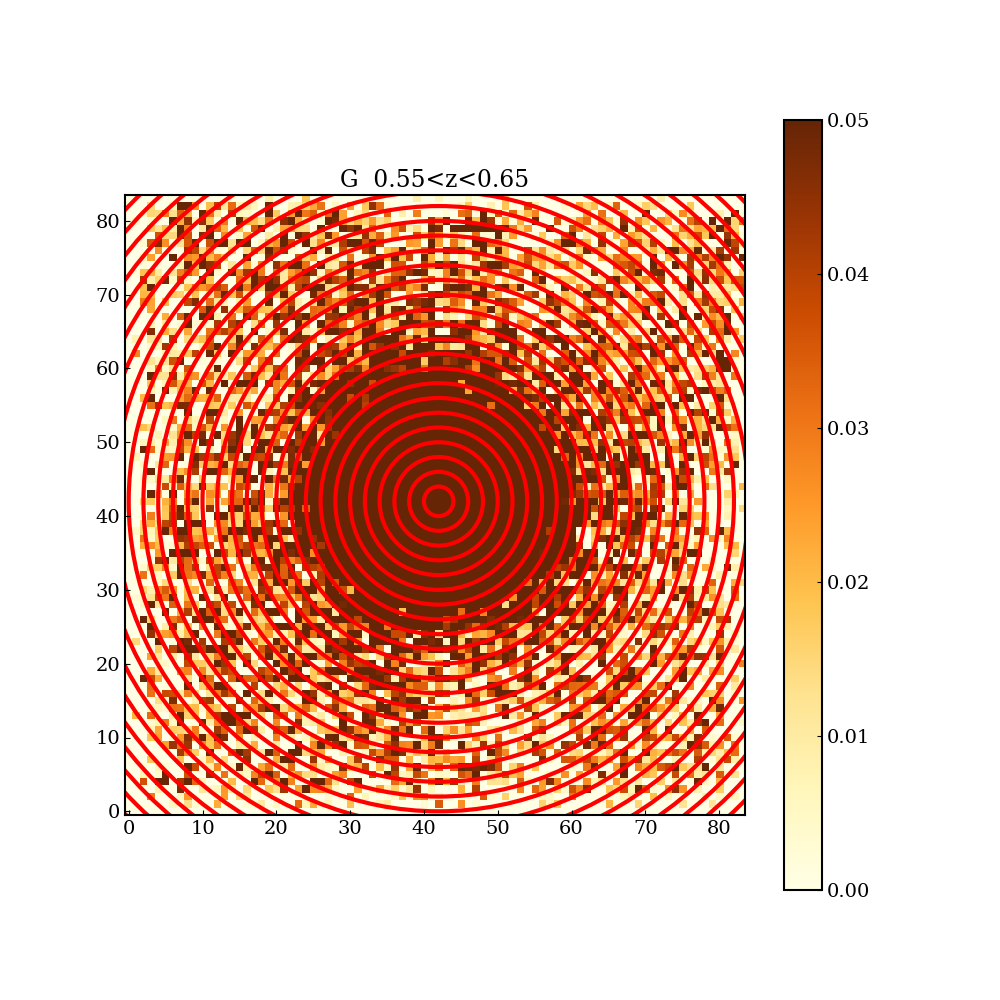

In [108]:
fig = plt.figure(figsize = (10,10), facecolor='white')

ax = fig.add_subplot(1,1, 1)

im = ax.imshow(Row_Median_Z_055_065, origin="lower", cmap="YlOrBr", vmin=0, vmax=0.05)

coord_offset = 0.5 * (ax.get_xlim()[0] + ax.get_xlim()[1])


circle1 = Circle((42,42), 2, edgecolor='r', facecolor="None", linewidth=3)
circle2 = Circle((42,42), 4, edgecolor='r', facecolor="None", linewidth=3)
circle3 = Circle((42,42), 6, edgecolor='r', facecolor="None", linewidth=3)
circle4 = Circle((42,42), 8, edgecolor='r', facecolor="None", linewidth=3)
circle5 = Circle((42,42), 10, edgecolor='r', facecolor="None", linewidth=3)
circle6 = Circle((42,42), 12, edgecolor='r', facecolor="None", linewidth=3)
circle7 = Circle((42,42), 14, edgecolor='r', facecolor="None", linewidth=3)
circle8 = Circle((42,42), 16, edgecolor='r', facecolor="None", linewidth=3)
circle9 = Circle((42,42), 18, edgecolor='r', facecolor="None", linewidth=3)
circle10 = Circle((42,42), 20, edgecolor='r', facecolor="None", linewidth=3)
circle11 = Circle((42,42), 22, edgecolor='r', facecolor="None", linewidth=3)
circle12 = Circle((42,42), 24, edgecolor='r', facecolor="None", linewidth=3)
circle13 = Circle((42,42), 26, edgecolor='r', facecolor="None", linewidth=3)
circle14 = Circle((42,42), 28, edgecolor='r', facecolor="None", linewidth=3)
circle15 = Circle((42,42), 30, edgecolor='r', facecolor="None", linewidth=3)
circle16 = Circle((42,42), 32, edgecolor='r', facecolor="None", linewidth=3)
circle17 = Circle((42,42), 34, edgecolor='r', facecolor="None", linewidth=3)
circle18 = Circle((42,42), 36, edgecolor='r', facecolor="None", linewidth=3)
circle19 = Circle((42,42), 38, edgecolor='r', facecolor="None", linewidth=3)
circle20 = Circle((42,42), 40, edgecolor='r', facecolor="None", linewidth=3)
circle21 = Circle((42,42), 42, edgecolor='r', facecolor="None", linewidth=3)
circle22 = Circle((42,42), 44, edgecolor='r', facecolor="None", linewidth=3)
circle23 = Circle((42,42), 46, edgecolor='r', facecolor="None", linewidth=3)
circle24 = Circle((42,42), 48, edgecolor='r', facecolor="None", linewidth=3)
circle25 = Circle((42,42), 50, edgecolor='r', facecolor="None", linewidth=3)
circle26 = Circle((42,42), 52, edgecolor='r', facecolor="None", linewidth=3)
circle27 = Circle((42,42), 54, edgecolor='r', facecolor="None", linewidth=3)
circle28 = Circle((42,42), 56, edgecolor='r', facecolor="None", linewidth=3)
circle29 = Circle((42,42), 58, edgecolor='r', facecolor="None", linewidth=3)
circle30 = Circle((42,42), 60, edgecolor='r', facecolor="None", linewidth=3)
circle31 = Circle((42,42), 62, edgecolor='r', facecolor="None", linewidth=3)
circle32 = Circle((42,42), 64, edgecolor='r', facecolor="None", linewidth=3)
circle33 = Circle((42,42), 66, edgecolor='r', facecolor="None", linewidth=3)
circle34 = Circle((42,42), 68, edgecolor='r', facecolor="None", linewidth=3)
circle35 = Circle((42,42), 70, edgecolor='r', facecolor="None", linewidth=3)
circle36 = Circle((42,42), 72, edgecolor='r', facecolor="None", linewidth=3)
circle37 = Circle((42,42), 74, edgecolor='r', facecolor="None", linewidth=3)
circle38 = Circle((42,42), 76, edgecolor='r', facecolor="None", linewidth=3)
circle39 = Circle((42,42), 78, edgecolor='r', facecolor="None", linewidth=3)
circle40 = Circle((42,42), 80, edgecolor='r', facecolor="None", linewidth=3)
circle41 = Circle((42,42), 82, edgecolor='r', facecolor="None", linewidth=3)
circle42 = Circle((42,42), 84, edgecolor='r', facecolor="None", linewidth=3)



# Add the circle to the axes
ax.add_patch(circle1)
ax.add_patch(circle2)
ax.add_patch(circle3)
ax.add_patch(circle4)
ax.add_patch(circle5)
ax.add_patch(circle6)
ax.add_patch(circle7)
ax.add_patch(circle8)
ax.add_patch(circle9)
ax.add_patch(circle10)
ax.add_patch(circle11)
ax.add_patch(circle12)
ax.add_patch(circle13)
ax.add_patch(circle14)
ax.add_patch(circle15)
ax.add_patch(circle16)
ax.add_patch(circle17)
ax.add_patch(circle18)
ax.add_patch(circle19)
ax.add_patch(circle20)
ax.add_patch(circle21)
ax.add_patch(circle22)
ax.add_patch(circle23)
ax.add_patch(circle24)
ax.add_patch(circle25)
ax.add_patch(circle26)
ax.add_patch(circle27)
ax.add_patch(circle28)
ax.add_patch(circle29)
ax.add_patch(circle30)
ax.add_patch(circle31)
ax.add_patch(circle32)
ax.add_patch(circle33)
ax.add_patch(circle34)
ax.add_patch(circle35)
ax.add_patch(circle36)
ax.add_patch(circle37)
ax.add_patch(circle38)
ax.add_patch(circle39)
ax.add_patch(circle40)
ax.add_patch(circle41)
ax.add_patch(circle42)






filename = "G  0.55<z<0.65"

plt.colorbar(im, ax=ax)

plt.title(str(filename))

In [109]:
A_average_055_065 = np.mean(A_circle_055_065)
B_average_055_065 = np.mean(B_circle_055_065)
C_average_055_065 = np.mean(C_circle_055_065)
D_average_055_065 = np.mean(D_circle_055_065)
E_average_055_065 = np.mean(E_circle_055_065)
F_average_055_065 = np.mean(F_circle_055_065)
G_average_055_065 = np.mean(G_circle_055_065)
H_average_055_065 = np.mean(H_circle_055_065)
I_average_055_065 = np.mean(I_circle_055_065)
J_average_055_065 = np.mean(J_circle_055_065)
K_average_055_065 = np.mean(K_circle_055_065)
L_average_055_065 = np.mean(L_circle_055_065)
M_average_055_065 = np.mean(M_circle_055_065)
N_average_055_065 = np.mean(N_circle_055_065)
O_average_055_065 = np.mean(O_circle_055_065)
P_average_055_065 = np.mean(P_circle_055_065)
Q_average_055_065 = np.mean(Q_circle_055_065)
R_average_055_065 = np.mean(R_circle_055_065)
S_average_055_065 = np.mean(S_circle_055_065)
T_average_055_065 = np.mean(T_circle_055_065)
U_average_055_065 = np.mean(U_circle_055_065)
V_average_055_065 = np.mean(V_circle_055_065)
W_average_055_065 = np.mean(W_circle_055_065)
X_average_055_065 = np.mean(X_circle_055_065)
Y_average_055_065 = np.mean(Y_circle_055_065)
Z_average_055_065 = np.mean(Z_circle_055_065)
AA_average_055_065 = np.mean(AA_circle_055_065)
BB_average_055_065 = np.mean(BB_circle_055_065)
CC_average_055_065 = np.mean(CC_circle_055_065)
DD_average_055_065 = np.mean(DD_circle_055_065)
EE_average_055_065 = np.mean(EE_circle_055_065)
FF_average_055_065 = np.mean(FF_circle_055_065)
GG_average_055_065 = np.mean(GG_circle_055_065)
HH_average_055_065 = np.mean(HH_circle_055_065)
II_average_055_065 = np.mean(II_circle_055_065)
JJ_average_055_065 = np.mean(JJ_circle_055_065)
KK_average_055_065 = np.mean(KK_circle_055_065)
LL_average_055_065 = np.mean(LL_circle_055_065)
MM_average_055_065 = np.mean(MM_circle_055_065)
NN_average_055_065 = np.mean(NN_circle_055_065)
OO_average_055_065 = np.mean(OO_circle_055_065)
PP_average_055_065 = np.mean(PP_circle_055_065)


In [110]:
A_cirlce_SDE_055_065 = statistics.stdev(A_circle_055_065)/np.sqrt(len(A_circle_055_065))
B_circle_SDE_055_065 = statistics.stdev(B_circle_055_065)/np.sqrt(len(B_circle_055_065))
C_circle_SDE_055_065 = statistics.stdev(C_circle_055_065)/np.sqrt(len(C_circle_055_065))
D_circle_SDE_055_065 = statistics.stdev(D_circle_055_065)/np.sqrt(len(D_circle_055_065))
E_circle_SDE_055_065 = statistics.stdev(E_circle_055_065)/np.sqrt(len(E_circle_055_065))
F_circle_SDE_055_065 = statistics.stdev(F_circle_055_065)/np.sqrt(len(F_circle_055_065))
G_circle_SDE_055_065 = statistics.stdev(G_circle_055_065)/np.sqrt(len(G_circle_055_065))
H_circle_SDE_055_065 = statistics.stdev(H_circle_055_065)/np.sqrt(len(H_circle_055_065))
I_circle_SDE_055_065 = statistics.stdev(I_circle_055_065)/np.sqrt(len(I_circle_055_065))
J_circle_SDE_055_065 = statistics.stdev(J_circle_055_065)/np.sqrt(len(J_circle_055_065))
K_circle_SDE_055_065 = statistics.stdev(K_circle_055_065)/np.sqrt(len(K_circle_055_065))
L_circle_SDE_055_065 = statistics.stdev(L_circle_055_065)/np.sqrt(len(L_circle_055_065))
M_circle_SDE_055_065 = statistics.stdev(M_circle_055_065)/np.sqrt(len(M_circle_055_065))
N_circle_SDE_055_065 = statistics.stdev(N_circle_055_065)/np.sqrt(len(N_circle_055_065))
O_circle_SDE_055_065 = statistics.stdev(O_circle_055_065)/np.sqrt(len(O_circle_055_065))
P_circle_SDE_055_065 = statistics.stdev(P_circle_055_065)/np.sqrt(len(P_circle_055_065))
Q_circle_SDE_055_065 = statistics.stdev(Q_circle_055_065)/np.sqrt(len(Q_circle_055_065))
R_circle_SDE_055_065 = statistics.stdev(R_circle_055_065)/np.sqrt(len(R_circle_055_065))
S_circle_SDE_055_065 = statistics.stdev(S_circle_055_065)/np.sqrt(len(S_circle_055_065))
T_circle_SDE_055_065 = statistics.stdev(T_circle_055_065)/np.sqrt(len(T_circle_055_065))
U_circle_SDE_055_065 = statistics.stdev(U_circle_055_065)/np.sqrt(len(U_circle_055_065))
V_circle_SDE_055_065 = statistics.stdev(V_circle_055_065)/np.sqrt(len(V_circle_055_065))
W_circle_SDE_055_065 = statistics.stdev(W_circle_055_065)/np.sqrt(len(W_circle_055_065))
X_circle_SDE_055_065 = statistics.stdev(X_circle_055_065)/np.sqrt(len(X_circle_055_065))
Y_circle_SDE_055_065 = statistics.stdev(Y_circle_055_065)/np.sqrt(len(Y_circle_055_065))
Z_circle_SDE_055_065 = statistics.stdev(Z_circle_055_065)/np.sqrt(len(Z_circle_055_065))
AA_circle_SDE_055_065 = statistics.stdev(AA_circle_055_065)/np.sqrt(len(AA_circle_055_065))
BB_circle_SDE_055_065 = statistics.stdev(BB_circle_055_065)/np.sqrt(len(BB_circle_055_065))
CC_circle_SDE_055_065 = statistics.stdev(CC_circle_055_065)/np.sqrt(len(CC_circle_055_065))
DD_circle_SDE_055_065 = statistics.stdev(DD_circle_055_065)/np.sqrt(len(DD_circle_055_065))
EE_circle_SDE_055_065 = statistics.stdev(EE_circle_055_065)/np.sqrt(len(EE_circle_055_065))
FF_circle_SDE_055_065 = statistics.stdev(FF_circle_055_065)/np.sqrt(len(FF_circle_055_065))
GG_circle_SDE_055_065 = statistics.stdev(GG_circle_055_065)/np.sqrt(len(GG_circle_055_065))
HH_circle_SDE_055_065 = statistics.stdev(HH_circle_055_065)/np.sqrt(len(HH_circle_055_065))
II_circle_SDE_055_065 = statistics.stdev(II_circle_055_065)/np.sqrt(len(II_circle_055_065))
JJ_circle_SDE_055_065 = statistics.stdev(JJ_circle_055_065)/np.sqrt(len(JJ_circle_055_065))
KK_circle_SDE_055_065 = statistics.stdev(KK_circle_055_065)/np.sqrt(len(KK_circle_055_065))
LL_circle_SDE_055_065 = statistics.stdev(LL_circle_055_065)/np.sqrt(len(LL_circle_055_065))
MM_circle_SDE_055_065 = statistics.stdev(MM_circle_055_065)/np.sqrt(len(MM_circle_055_065))
NN_circle_SDE_055_065 = statistics.stdev(NN_circle_055_065)/np.sqrt(len(NN_circle_055_065))
OO_circle_SDE_055_065 = statistics.stdev(OO_circle_055_065)/np.sqrt(len(OO_circle_055_065))
PP_circle_SDE_055_065 = statistics.stdev(PP_circle_055_065)/np.sqrt(len(PP_circle_055_065))


In [111]:
Radius_array_055_065 = np.array([A_average_055_065 , B_average_055_065 , C_average_055_065 , D_average_055_065 , E_average_055_065 , F_average_055_065 , G_average_055_065 , H_average_055_065 , I_average_055_065 , J_average_055_065 , K_average_055_065 , L_average_055_065 , M_average_055_065 , N_average_055_065 , O_average_055_065 , P_average_055_065 , Q_average_055_065 , R_average_055_065 , S_average_055_065 , T_average_055_065 , U_average_055_065 , V_average_055_065 , W_average_055_065 , X_average_055_065 , Y_average_055_065 , Z_average_055_065 , AA_average_055_065, BB_average_055_065, CC_average_055_065, DD_average_055_065, EE_average_055_065, FF_average_055_065, GG_average_055_065, HH_average_055_065, II_average_055_065, JJ_average_055_065, KK_average_055_065, LL_average_055_065, MM_average_055_065,NN_average_055_065, OO_average_055_065, PP_average_055_065])
Radius_array_SDE_055_065 = np.array([A_cirlce_SDE_055_065 , B_circle_SDE_055_065 , C_circle_SDE_055_065 , D_circle_SDE_055_065 , E_circle_SDE_055_065 , F_circle_SDE_055_065 , G_circle_SDE_055_065 , H_circle_SDE_055_065 , I_circle_SDE_055_065 , J_circle_SDE_055_065 , K_circle_SDE_055_065 , L_circle_SDE_055_065 , M_circle_SDE_055_065 , N_circle_SDE_055_065 , O_circle_SDE_055_065 , P_circle_SDE_055_065 , Q_circle_SDE_055_065 , R_circle_SDE_055_065 , S_circle_SDE_055_065 , T_circle_SDE_055_065 , U_circle_SDE_055_065 , V_circle_SDE_055_065 , W_circle_SDE_055_065 , X_circle_SDE_055_065 , Y_circle_SDE_055_065 , Z_circle_SDE_055_065 , AA_circle_SDE_055_065, BB_circle_SDE_055_065, CC_circle_SDE_055_065, DD_circle_SDE_055_065, EE_circle_SDE_055_065, FF_circle_SDE_055_065, GG_circle_SDE_055_065, HH_circle_SDE_055_065, II_circle_SDE_055_065, JJ_circle_SDE_055_065, KK_circle_SDE_055_065, LL_circle_SDE_055_065, MM_circle_SDE_055_065, NN_circle_SDE_055_065, OO_circle_SDE_055_065, PP_circle_SDE_055_065])


In [112]:
A_circle_065_075 = []

for i in np.arange(84):
    for j in np.arange(84):
        if (i+j-84)**(2) <= 2**2:
            A_circle_065_075.append(Row_Median_Z_065_075[i][j])

In [113]:
B_circle_065_075 = circle_gather(Row_Median_Z_065_075, 2, 4)
C_circle_065_075 = circle_gather(Row_Median_Z_065_075, 4, 6)
D_circle_065_075 = circle_gather(Row_Median_Z_065_075, 6, 8)
E_circle_065_075 = circle_gather(Row_Median_Z_065_075, 8, 10)
F_circle_065_075 = circle_gather(Row_Median_Z_065_075, 10, 12)
G_circle_065_075 = circle_gather(Row_Median_Z_065_075, 12, 14)
H_circle_065_075 = circle_gather(Row_Median_Z_065_075, 14, 16)
I_circle_065_075 = circle_gather(Row_Median_Z_065_075, 16, 18)
J_circle_065_075 = circle_gather(Row_Median_Z_065_075, 18, 20)
K_circle_065_075 = circle_gather(Row_Median_Z_065_075, 20, 22)
L_circle_065_075 = circle_gather(Row_Median_Z_065_075, 22, 24)
M_circle_065_075 = circle_gather(Row_Median_Z_065_075, 24, 26)
N_circle_065_075 = circle_gather(Row_Median_Z_065_075, 26, 28)
O_circle_065_075 = circle_gather(Row_Median_Z_065_075, 28, 30)
P_circle_065_075 = circle_gather(Row_Median_Z_065_075, 30, 32)
Q_circle_065_075 = circle_gather(Row_Median_Z_065_075, 32, 34)
R_circle_065_075 = circle_gather(Row_Median_Z_065_075, 34, 36)
S_circle_065_075 = circle_gather(Row_Median_Z_065_075, 36, 38)
T_circle_065_075 = circle_gather(Row_Median_Z_065_075, 38, 40)
U_circle_065_075 = circle_gather(Row_Median_Z_065_075, 40, 42)
V_circle_065_075 = circle_gather(Row_Median_Z_065_075, 42, 44)
W_circle_065_075 = circle_gather(Row_Median_Z_065_075, 44, 46)
X_circle_065_075 = circle_gather(Row_Median_Z_065_075, 46, 48)
Y_circle_065_075 = circle_gather(Row_Median_Z_065_075, 48, 50)
Z_circle_065_075 = circle_gather(Row_Median_Z_065_075, 50, 52)
AA_circle_065_075 = circle_gather(Row_Median_Z_065_075, 52, 54)
BB_circle_065_075 = circle_gather(Row_Median_Z_065_075, 54, 56)
CC_circle_065_075 = circle_gather(Row_Median_Z_065_075, 56, 58)
DD_circle_065_075 = circle_gather(Row_Median_Z_065_075, 58, 60)
EE_circle_065_075 = circle_gather(Row_Median_Z_065_075, 60, 62)
FF_circle_065_075 = circle_gather(Row_Median_Z_065_075, 62, 64)
GG_circle_065_075 = circle_gather(Row_Median_Z_065_075, 64, 66)
HH_circle_065_075 = circle_gather(Row_Median_Z_065_075, 66, 68)
II_circle_065_075 = circle_gather(Row_Median_Z_065_075, 68, 70)
JJ_circle_065_075 = circle_gather(Row_Median_Z_065_075, 70, 72)
KK_circle_065_075 = circle_gather(Row_Median_Z_065_075, 72, 74)
LL_circle_065_075 = circle_gather(Row_Median_Z_065_075, 74, 76)
MM_circle_065_075 = circle_gather(Row_Median_Z_065_075, 76, 78)
NN_circle_065_075 = circle_gather(Row_Median_Z_065_075, 78, 80)
OO_circle_065_075 = circle_gather(Row_Median_Z_065_075, 80, 82)
PP_circle_065_075 = circle_gather(Row_Median_Z_065_075, 82, 84)


Text(0.5, 1.0, 'G  0.65<z<0.75')

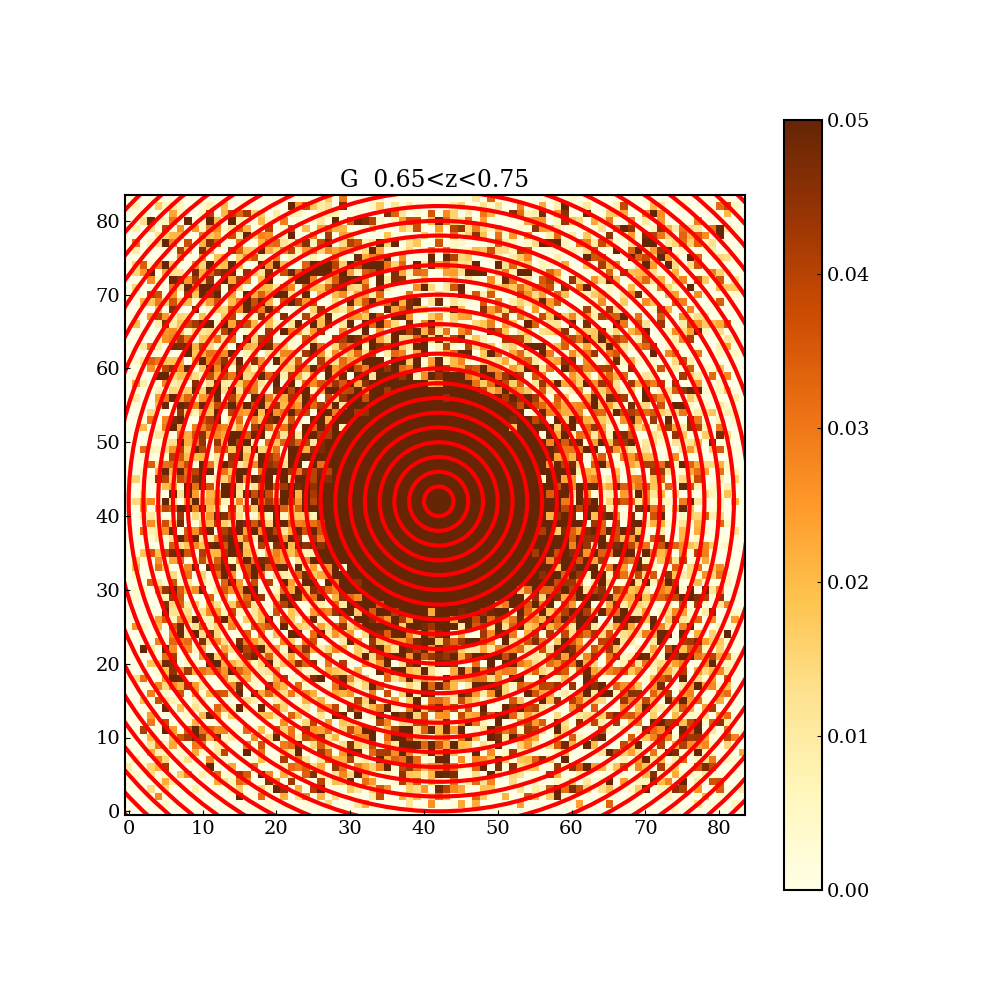

In [114]:
fig = plt.figure(figsize = (10,10), facecolor='white')

ax = fig.add_subplot(1,1, 1)

im = ax.imshow(Row_Median_Z_065_075, origin="lower", cmap="YlOrBr", vmin=0, vmax=0.05)

coord_offset = 0.5 * (ax.get_xlim()[0] + ax.get_xlim()[1])


circle1 = Circle((42,42), 2, edgecolor='r', facecolor="None", linewidth=3)
circle2 = Circle((42,42), 4, edgecolor='r', facecolor="None", linewidth=3)
circle3 = Circle((42,42), 6, edgecolor='r', facecolor="None", linewidth=3)
circle4 = Circle((42,42), 8, edgecolor='r', facecolor="None", linewidth=3)
circle5 = Circle((42,42), 10, edgecolor='r', facecolor="None", linewidth=3)
circle6 = Circle((42,42), 12, edgecolor='r', facecolor="None", linewidth=3)
circle7 = Circle((42,42), 14, edgecolor='r', facecolor="None", linewidth=3)
circle8 = Circle((42,42), 16, edgecolor='r', facecolor="None", linewidth=3)
circle9 = Circle((42,42), 18, edgecolor='r', facecolor="None", linewidth=3)
circle10 = Circle((42,42), 20, edgecolor='r', facecolor="None", linewidth=3)
circle11 = Circle((42,42), 22, edgecolor='r', facecolor="None", linewidth=3)
circle12 = Circle((42,42), 24, edgecolor='r', facecolor="None", linewidth=3)
circle13 = Circle((42,42), 26, edgecolor='r', facecolor="None", linewidth=3)
circle14 = Circle((42,42), 28, edgecolor='r', facecolor="None", linewidth=3)
circle15 = Circle((42,42), 30, edgecolor='r', facecolor="None", linewidth=3)
circle16 = Circle((42,42), 32, edgecolor='r', facecolor="None", linewidth=3)
circle17 = Circle((42,42), 34, edgecolor='r', facecolor="None", linewidth=3)
circle18 = Circle((42,42), 36, edgecolor='r', facecolor="None", linewidth=3)
circle19 = Circle((42,42), 38, edgecolor='r', facecolor="None", linewidth=3)
circle20 = Circle((42,42), 40, edgecolor='r', facecolor="None", linewidth=3)
circle21 = Circle((42,42), 42, edgecolor='r', facecolor="None", linewidth=3)
circle22 = Circle((42,42), 44, edgecolor='r', facecolor="None", linewidth=3)
circle23 = Circle((42,42), 46, edgecolor='r', facecolor="None", linewidth=3)
circle24 = Circle((42,42), 48, edgecolor='r', facecolor="None", linewidth=3)
circle25 = Circle((42,42), 50, edgecolor='r', facecolor="None", linewidth=3)
circle26 = Circle((42,42), 52, edgecolor='r', facecolor="None", linewidth=3)
circle27 = Circle((42,42), 54, edgecolor='r', facecolor="None", linewidth=3)
circle28 = Circle((42,42), 56, edgecolor='r', facecolor="None", linewidth=3)
circle29 = Circle((42,42), 58, edgecolor='r', facecolor="None", linewidth=3)
circle30 = Circle((42,42), 60, edgecolor='r', facecolor="None", linewidth=3)
circle31 = Circle((42,42), 62, edgecolor='r', facecolor="None", linewidth=3)
circle32 = Circle((42,42), 64, edgecolor='r', facecolor="None", linewidth=3)
circle33 = Circle((42,42), 66, edgecolor='r', facecolor="None", linewidth=3)
circle34 = Circle((42,42), 68, edgecolor='r', facecolor="None", linewidth=3)
circle35 = Circle((42,42), 70, edgecolor='r', facecolor="None", linewidth=3)
circle36 = Circle((42,42), 72, edgecolor='r', facecolor="None", linewidth=3)
circle37 = Circle((42,42), 74, edgecolor='r', facecolor="None", linewidth=3)
circle38 = Circle((42,42), 76, edgecolor='r', facecolor="None", linewidth=3)
circle39 = Circle((42,42), 78, edgecolor='r', facecolor="None", linewidth=3)
circle40 = Circle((42,42), 80, edgecolor='r', facecolor="None", linewidth=3)
circle41 = Circle((42,42), 82, edgecolor='r', facecolor="None", linewidth=3)
circle42 = Circle((42,42), 84, edgecolor='r', facecolor="None", linewidth=3)



# Add the circle to the axes
ax.add_patch(circle1)
ax.add_patch(circle2)
ax.add_patch(circle3)
ax.add_patch(circle4)
ax.add_patch(circle5)
ax.add_patch(circle6)
ax.add_patch(circle7)
ax.add_patch(circle8)
ax.add_patch(circle9)
ax.add_patch(circle10)
ax.add_patch(circle11)
ax.add_patch(circle12)
ax.add_patch(circle13)
ax.add_patch(circle14)
ax.add_patch(circle15)
ax.add_patch(circle16)
ax.add_patch(circle17)
ax.add_patch(circle18)
ax.add_patch(circle19)
ax.add_patch(circle20)
ax.add_patch(circle21)
ax.add_patch(circle22)
ax.add_patch(circle23)
ax.add_patch(circle24)
ax.add_patch(circle25)
ax.add_patch(circle26)
ax.add_patch(circle27)
ax.add_patch(circle28)
ax.add_patch(circle29)
ax.add_patch(circle30)
ax.add_patch(circle31)
ax.add_patch(circle32)
ax.add_patch(circle33)
ax.add_patch(circle34)
ax.add_patch(circle35)
ax.add_patch(circle36)
ax.add_patch(circle37)
ax.add_patch(circle38)
ax.add_patch(circle39)
ax.add_patch(circle40)
ax.add_patch(circle41)
ax.add_patch(circle42)






filename = "G  0.65<z<0.75"

plt.colorbar(im, ax=ax)

plt.title(str(filename))

In [115]:
A_average_065_075 = np.mean(A_circle_065_075)
B_average_065_075 = np.mean(B_circle_065_075)
C_average_065_075 = np.mean(C_circle_065_075)
D_average_065_075 = np.mean(D_circle_065_075)
E_average_065_075 = np.mean(E_circle_065_075)
F_average_065_075 = np.mean(F_circle_065_075)
G_average_065_075 = np.mean(G_circle_065_075)
H_average_065_075 = np.mean(H_circle_065_075)
I_average_065_075 = np.mean(I_circle_065_075)
J_average_065_075 = np.mean(J_circle_065_075)
K_average_065_075 = np.mean(K_circle_065_075)
L_average_065_075 = np.mean(L_circle_065_075)
M_average_065_075 = np.mean(M_circle_065_075)
N_average_065_075 = np.mean(N_circle_065_075)
O_average_065_075 = np.mean(O_circle_065_075)
P_average_065_075 = np.mean(P_circle_065_075)
Q_average_065_075 = np.mean(Q_circle_065_075)
R_average_065_075 = np.mean(R_circle_065_075)
S_average_065_075 = np.mean(S_circle_065_075)
T_average_065_075 = np.mean(T_circle_065_075)
U_average_065_075 = np.mean(U_circle_065_075)
V_average_065_075 = np.mean(V_circle_065_075)
W_average_065_075 = np.mean(W_circle_065_075)
X_average_065_075 = np.mean(X_circle_065_075)
Y_average_065_075 = np.mean(Y_circle_065_075)
Z_average_065_075 = np.mean(Z_circle_065_075)
AA_average_065_075 = np.mean(AA_circle_065_075)
BB_average_065_075 = np.mean(BB_circle_065_075)
CC_average_065_075 = np.mean(CC_circle_065_075)
DD_average_065_075 = np.mean(DD_circle_065_075)
EE_average_065_075 = np.mean(EE_circle_065_075)
FF_average_065_075 = np.mean(FF_circle_065_075)
GG_average_065_075 = np.mean(GG_circle_065_075)
HH_average_065_075 = np.mean(HH_circle_065_075)
II_average_065_075 = np.mean(II_circle_065_075)
JJ_average_065_075 = np.mean(JJ_circle_065_075)
KK_average_065_075 = np.mean(KK_circle_065_075)
LL_average_065_075 = np.mean(LL_circle_065_075)
MM_average_065_075 = np.mean(MM_circle_065_075)
NN_average_065_075 = np.mean(NN_circle_065_075)
OO_average_065_075 = np.mean(OO_circle_065_075)
PP_average_065_075 = np.mean(PP_circle_065_075)


In [116]:
A_cirlce_SDE_065_075 = statistics.stdev(A_circle_065_075)/np.sqrt(len(A_circle_065_075))
B_circle_SDE_065_075 = statistics.stdev(B_circle_065_075)/np.sqrt(len(B_circle_065_075))
C_circle_SDE_065_075 = statistics.stdev(C_circle_065_075)/np.sqrt(len(C_circle_065_075))
D_circle_SDE_065_075 = statistics.stdev(D_circle_065_075)/np.sqrt(len(D_circle_065_075))
E_circle_SDE_065_075 = statistics.stdev(E_circle_065_075)/np.sqrt(len(E_circle_065_075))
F_circle_SDE_065_075 = statistics.stdev(F_circle_065_075)/np.sqrt(len(F_circle_065_075))
G_circle_SDE_065_075 = statistics.stdev(G_circle_065_075)/np.sqrt(len(G_circle_065_075))
H_circle_SDE_065_075 = statistics.stdev(H_circle_065_075)/np.sqrt(len(H_circle_065_075))
I_circle_SDE_065_075 = statistics.stdev(I_circle_065_075)/np.sqrt(len(I_circle_065_075))
J_circle_SDE_065_075 = statistics.stdev(J_circle_065_075)/np.sqrt(len(J_circle_065_075))
K_circle_SDE_065_075 = statistics.stdev(K_circle_065_075)/np.sqrt(len(K_circle_065_075))
L_circle_SDE_065_075 = statistics.stdev(L_circle_065_075)/np.sqrt(len(L_circle_065_075))
M_circle_SDE_065_075 = statistics.stdev(M_circle_065_075)/np.sqrt(len(M_circle_065_075))
N_circle_SDE_065_075 = statistics.stdev(N_circle_065_075)/np.sqrt(len(N_circle_065_075))
O_circle_SDE_065_075 = statistics.stdev(O_circle_065_075)/np.sqrt(len(O_circle_065_075))
P_circle_SDE_065_075 = statistics.stdev(P_circle_065_075)/np.sqrt(len(P_circle_065_075))
Q_circle_SDE_065_075 = statistics.stdev(Q_circle_065_075)/np.sqrt(len(Q_circle_065_075))
R_circle_SDE_065_075 = statistics.stdev(R_circle_065_075)/np.sqrt(len(R_circle_065_075))
S_circle_SDE_065_075 = statistics.stdev(S_circle_065_075)/np.sqrt(len(S_circle_065_075))
T_circle_SDE_065_075 = statistics.stdev(T_circle_065_075)/np.sqrt(len(T_circle_065_075))
U_circle_SDE_065_075 = statistics.stdev(U_circle_065_075)/np.sqrt(len(U_circle_065_075))
V_circle_SDE_065_075 = statistics.stdev(V_circle_065_075)/np.sqrt(len(V_circle_065_075))
W_circle_SDE_065_075 = statistics.stdev(W_circle_065_075)/np.sqrt(len(W_circle_065_075))
X_circle_SDE_065_075 = statistics.stdev(X_circle_065_075)/np.sqrt(len(X_circle_065_075))
Y_circle_SDE_065_075 = statistics.stdev(Y_circle_065_075)/np.sqrt(len(Y_circle_065_075))
Z_circle_SDE_065_075 = statistics.stdev(Z_circle_065_075)/np.sqrt(len(Z_circle_065_075))
AA_circle_SDE_065_075 = statistics.stdev(AA_circle_065_075)/np.sqrt(len(AA_circle_065_075))
BB_circle_SDE_065_075 = statistics.stdev(BB_circle_065_075)/np.sqrt(len(BB_circle_065_075))
CC_circle_SDE_065_075 = statistics.stdev(CC_circle_065_075)/np.sqrt(len(CC_circle_065_075))
DD_circle_SDE_065_075 = statistics.stdev(DD_circle_065_075)/np.sqrt(len(DD_circle_065_075))
EE_circle_SDE_065_075 = statistics.stdev(EE_circle_065_075)/np.sqrt(len(EE_circle_065_075))
FF_circle_SDE_065_075 = statistics.stdev(FF_circle_065_075)/np.sqrt(len(FF_circle_065_075))
GG_circle_SDE_065_075 = statistics.stdev(GG_circle_065_075)/np.sqrt(len(GG_circle_065_075))
HH_circle_SDE_065_075 = statistics.stdev(HH_circle_065_075)/np.sqrt(len(HH_circle_065_075))
II_circle_SDE_065_075 = statistics.stdev(II_circle_065_075)/np.sqrt(len(II_circle_065_075))
JJ_circle_SDE_065_075 = statistics.stdev(JJ_circle_065_075)/np.sqrt(len(JJ_circle_065_075))
KK_circle_SDE_065_075 = statistics.stdev(KK_circle_065_075)/np.sqrt(len(KK_circle_065_075))
LL_circle_SDE_065_075 = statistics.stdev(LL_circle_065_075)/np.sqrt(len(LL_circle_065_075))
MM_circle_SDE_065_075 = statistics.stdev(MM_circle_065_075)/np.sqrt(len(MM_circle_065_075))
NN_circle_SDE_065_075 = statistics.stdev(NN_circle_065_075)/np.sqrt(len(NN_circle_065_075))
OO_circle_SDE_065_075 = statistics.stdev(OO_circle_065_075)/np.sqrt(len(OO_circle_065_075))
PP_circle_SDE_065_075 = statistics.stdev(PP_circle_065_075)/np.sqrt(len(PP_circle_065_075))


In [117]:
Radius_array_065_075 = np.array([A_average_065_075 , B_average_065_075 , C_average_065_075 , D_average_065_075 , E_average_065_075 , F_average_065_075 , G_average_065_075 , H_average_065_075 , I_average_065_075 , J_average_065_075 , K_average_065_075 , L_average_065_075 , M_average_065_075 , N_average_065_075 , O_average_065_075 , P_average_065_075 , Q_average_065_075 , R_average_065_075 , S_average_065_075 , T_average_065_075 , U_average_065_075 , V_average_065_075 , W_average_065_075 , X_average_065_075 , Y_average_065_075 , Z_average_065_075 , AA_average_065_075, BB_average_065_075, CC_average_065_075, DD_average_065_075, EE_average_065_075, FF_average_065_075, GG_average_065_075, HH_average_065_075, II_average_065_075, JJ_average_065_075, KK_average_065_075, LL_average_065_075, MM_average_065_075,NN_average_065_075, OO_average_065_075, PP_average_065_075])
Radius_array_SDE_065_075 = np.array([A_cirlce_SDE_065_075 , B_circle_SDE_065_075 , C_circle_SDE_065_075 , D_circle_SDE_065_075 , E_circle_SDE_065_075 , F_circle_SDE_065_075 , G_circle_SDE_065_075 , H_circle_SDE_065_075 , I_circle_SDE_065_075 , J_circle_SDE_065_075 , K_circle_SDE_065_075 , L_circle_SDE_065_075 , M_circle_SDE_065_075 , N_circle_SDE_065_075 , O_circle_SDE_065_075 , P_circle_SDE_065_075 , Q_circle_SDE_065_075 , R_circle_SDE_065_075 , S_circle_SDE_065_075 , T_circle_SDE_065_075 , U_circle_SDE_065_075 , V_circle_SDE_065_075 , W_circle_SDE_065_075 , X_circle_SDE_065_075 , Y_circle_SDE_065_075 , Z_circle_SDE_065_075 , AA_circle_SDE_065_075, BB_circle_SDE_065_075, CC_circle_SDE_065_075, DD_circle_SDE_065_075, EE_circle_SDE_065_075, FF_circle_SDE_065_075, GG_circle_SDE_065_075, HH_circle_SDE_065_075, II_circle_SDE_065_075, JJ_circle_SDE_065_075, KK_circle_SDE_065_075, LL_circle_SDE_065_075, MM_circle_SDE_065_075, NN_circle_SDE_065_075, OO_circle_SDE_065_075, PP_circle_SDE_065_075])


In [118]:
A_circle_075_085 = []

for i in np.arange(84):
    for j in np.arange(84):
        if (i+j-84)**(2) <= 2**2:
            A_circle_075_085.append(Row_Median_Z_075_085[i][j])

In [119]:
B_circle_075_085 = circle_gather(Row_Median_Z_075_085, 2, 4)
C_circle_075_085 = circle_gather(Row_Median_Z_075_085, 4, 6)
D_circle_075_085 = circle_gather(Row_Median_Z_075_085, 6, 8)
E_circle_075_085 = circle_gather(Row_Median_Z_075_085, 8, 10)
F_circle_075_085 = circle_gather(Row_Median_Z_075_085, 10, 12)
G_circle_075_085 = circle_gather(Row_Median_Z_075_085, 12, 14)
H_circle_075_085 = circle_gather(Row_Median_Z_075_085, 14, 16)
I_circle_075_085 = circle_gather(Row_Median_Z_075_085, 16, 18)
J_circle_075_085 = circle_gather(Row_Median_Z_075_085, 18, 20)
K_circle_075_085 = circle_gather(Row_Median_Z_075_085, 20, 22)
L_circle_075_085 = circle_gather(Row_Median_Z_075_085, 22, 24)
M_circle_075_085 = circle_gather(Row_Median_Z_075_085, 24, 26)
N_circle_075_085 = circle_gather(Row_Median_Z_075_085, 26, 28)
O_circle_075_085 = circle_gather(Row_Median_Z_075_085, 28, 30)
P_circle_075_085 = circle_gather(Row_Median_Z_075_085, 30, 32)
Q_circle_075_085 = circle_gather(Row_Median_Z_075_085, 32, 34)
R_circle_075_085 = circle_gather(Row_Median_Z_075_085, 34, 36)
S_circle_075_085 = circle_gather(Row_Median_Z_075_085, 36, 38)
T_circle_075_085 = circle_gather(Row_Median_Z_075_085, 38, 40)
U_circle_075_085 = circle_gather(Row_Median_Z_075_085, 40, 42)
V_circle_075_085 = circle_gather(Row_Median_Z_075_085, 42, 44)
W_circle_075_085 = circle_gather(Row_Median_Z_075_085, 44, 46)
X_circle_075_085 = circle_gather(Row_Median_Z_075_085, 46, 48)
Y_circle_075_085 = circle_gather(Row_Median_Z_075_085, 48, 50)
Z_circle_075_085 = circle_gather(Row_Median_Z_075_085, 50, 52)
AA_circle_075_085 = circle_gather(Row_Median_Z_075_085, 52, 54)
BB_circle_075_085 = circle_gather(Row_Median_Z_075_085, 54, 56)
CC_circle_075_085 = circle_gather(Row_Median_Z_075_085, 56, 58)
DD_circle_075_085 = circle_gather(Row_Median_Z_075_085, 58, 60)
EE_circle_075_085 = circle_gather(Row_Median_Z_075_085, 60, 62)
FF_circle_075_085 = circle_gather(Row_Median_Z_075_085, 62, 64)
GG_circle_075_085 = circle_gather(Row_Median_Z_075_085, 64, 66)
HH_circle_075_085 = circle_gather(Row_Median_Z_075_085, 66, 68)
II_circle_075_085 = circle_gather(Row_Median_Z_075_085, 68, 70)
JJ_circle_075_085 = circle_gather(Row_Median_Z_075_085, 70, 72)
KK_circle_075_085 = circle_gather(Row_Median_Z_075_085, 72, 74)
LL_circle_075_085 = circle_gather(Row_Median_Z_075_085, 74, 76)
MM_circle_075_085 = circle_gather(Row_Median_Z_075_085, 76, 78)
NN_circle_075_085 = circle_gather(Row_Median_Z_075_085, 78, 80)
OO_circle_075_085 = circle_gather(Row_Median_Z_075_085, 80, 82)
PP_circle_075_085 = circle_gather(Row_Median_Z_075_085, 82, 84)


Text(0.5, 1.0, 'G  0.75<z<0.85')

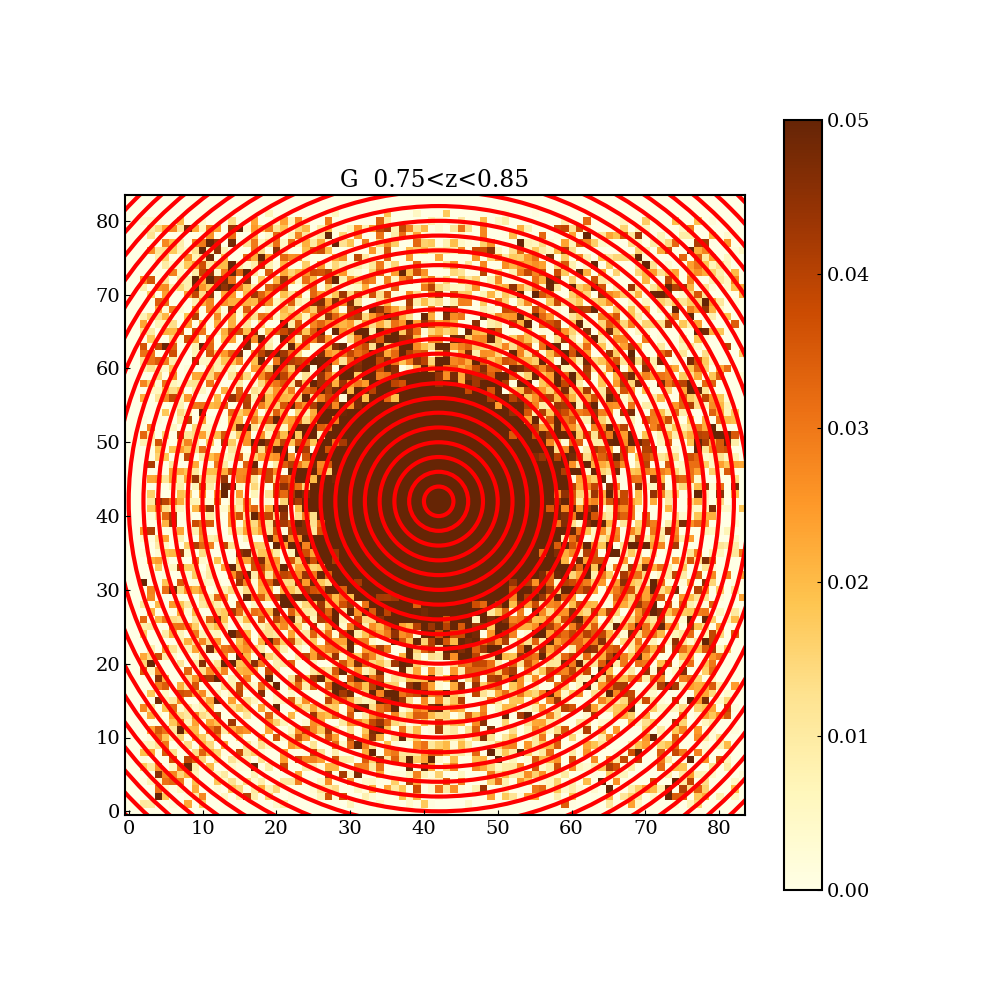

In [120]:
fig = plt.figure(figsize = (10,10), facecolor='white')

ax = fig.add_subplot(1,1, 1)

im = ax.imshow(Row_Median_Z_075_085, origin="lower", cmap="YlOrBr", vmin=0, vmax=0.05)

coord_offset = 0.5 * (ax.get_xlim()[0] + ax.get_xlim()[1])


circle1 = Circle((42,42), 2, edgecolor='r', facecolor="None", linewidth=3)
circle2 = Circle((42,42), 4, edgecolor='r', facecolor="None", linewidth=3)
circle3 = Circle((42,42), 6, edgecolor='r', facecolor="None", linewidth=3)
circle4 = Circle((42,42), 8, edgecolor='r', facecolor="None", linewidth=3)
circle5 = Circle((42,42), 10, edgecolor='r', facecolor="None", linewidth=3)
circle6 = Circle((42,42), 12, edgecolor='r', facecolor="None", linewidth=3)
circle7 = Circle((42,42), 14, edgecolor='r', facecolor="None", linewidth=3)
circle8 = Circle((42,42), 16, edgecolor='r', facecolor="None", linewidth=3)
circle9 = Circle((42,42), 18, edgecolor='r', facecolor="None", linewidth=3)
circle10 = Circle((42,42), 20, edgecolor='r', facecolor="None", linewidth=3)
circle11 = Circle((42,42), 22, edgecolor='r', facecolor="None", linewidth=3)
circle12 = Circle((42,42), 24, edgecolor='r', facecolor="None", linewidth=3)
circle13 = Circle((42,42), 26, edgecolor='r', facecolor="None", linewidth=3)
circle14 = Circle((42,42), 28, edgecolor='r', facecolor="None", linewidth=3)
circle15 = Circle((42,42), 30, edgecolor='r', facecolor="None", linewidth=3)
circle16 = Circle((42,42), 32, edgecolor='r', facecolor="None", linewidth=3)
circle17 = Circle((42,42), 34, edgecolor='r', facecolor="None", linewidth=3)
circle18 = Circle((42,42), 36, edgecolor='r', facecolor="None", linewidth=3)
circle19 = Circle((42,42), 38, edgecolor='r', facecolor="None", linewidth=3)
circle20 = Circle((42,42), 40, edgecolor='r', facecolor="None", linewidth=3)
circle21 = Circle((42,42), 42, edgecolor='r', facecolor="None", linewidth=3)
circle22 = Circle((42,42), 44, edgecolor='r', facecolor="None", linewidth=3)
circle23 = Circle((42,42), 46, edgecolor='r', facecolor="None", linewidth=3)
circle24 = Circle((42,42), 48, edgecolor='r', facecolor="None", linewidth=3)
circle25 = Circle((42,42), 50, edgecolor='r', facecolor="None", linewidth=3)
circle26 = Circle((42,42), 52, edgecolor='r', facecolor="None", linewidth=3)
circle27 = Circle((42,42), 54, edgecolor='r', facecolor="None", linewidth=3)
circle28 = Circle((42,42), 56, edgecolor='r', facecolor="None", linewidth=3)
circle29 = Circle((42,42), 58, edgecolor='r', facecolor="None", linewidth=3)
circle30 = Circle((42,42), 60, edgecolor='r', facecolor="None", linewidth=3)
circle31 = Circle((42,42), 62, edgecolor='r', facecolor="None", linewidth=3)
circle32 = Circle((42,42), 64, edgecolor='r', facecolor="None", linewidth=3)
circle33 = Circle((42,42), 66, edgecolor='r', facecolor="None", linewidth=3)
circle34 = Circle((42,42), 68, edgecolor='r', facecolor="None", linewidth=3)
circle35 = Circle((42,42), 70, edgecolor='r', facecolor="None", linewidth=3)
circle36 = Circle((42,42), 72, edgecolor='r', facecolor="None", linewidth=3)
circle37 = Circle((42,42), 74, edgecolor='r', facecolor="None", linewidth=3)
circle38 = Circle((42,42), 76, edgecolor='r', facecolor="None", linewidth=3)
circle39 = Circle((42,42), 78, edgecolor='r', facecolor="None", linewidth=3)
circle40 = Circle((42,42), 80, edgecolor='r', facecolor="None", linewidth=3)
circle41 = Circle((42,42), 82, edgecolor='r', facecolor="None", linewidth=3)
circle42 = Circle((42,42), 84, edgecolor='r', facecolor="None", linewidth=3)



# Add the circle to the axes
ax.add_patch(circle1)
ax.add_patch(circle2)
ax.add_patch(circle3)
ax.add_patch(circle4)
ax.add_patch(circle5)
ax.add_patch(circle6)
ax.add_patch(circle7)
ax.add_patch(circle8)
ax.add_patch(circle9)
ax.add_patch(circle10)
ax.add_patch(circle11)
ax.add_patch(circle12)
ax.add_patch(circle13)
ax.add_patch(circle14)
ax.add_patch(circle15)
ax.add_patch(circle16)
ax.add_patch(circle17)
ax.add_patch(circle18)
ax.add_patch(circle19)
ax.add_patch(circle20) #This is the last ring inside of the box
ax.add_patch(circle21)
ax.add_patch(circle22)
ax.add_patch(circle23)
ax.add_patch(circle24)
ax.add_patch(circle25)
ax.add_patch(circle26)
ax.add_patch(circle27)
ax.add_patch(circle28)
ax.add_patch(circle29)
ax.add_patch(circle30)
ax.add_patch(circle31)
ax.add_patch(circle32)
ax.add_patch(circle33)
ax.add_patch(circle34)
ax.add_patch(circle35)
ax.add_patch(circle36)
ax.add_patch(circle37)
ax.add_patch(circle38)
ax.add_patch(circle39)
ax.add_patch(circle40)
ax.add_patch(circle41)
ax.add_patch(circle42)






filename = "G  0.75<z<0.85"

plt.colorbar(im, ax=ax)

plt.title(str(filename))

In [121]:
A_average_075_085 = np.mean(A_circle_075_085)
B_average_075_085 = np.mean(B_circle_075_085)
C_average_075_085 = np.mean(C_circle_075_085)
D_average_075_085 = np.mean(D_circle_075_085)
E_average_075_085 = np.mean(E_circle_075_085)
F_average_075_085 = np.mean(F_circle_075_085)
G_average_075_085 = np.mean(G_circle_075_085)
H_average_075_085 = np.mean(H_circle_075_085)
I_average_075_085 = np.mean(I_circle_075_085)
J_average_075_085 = np.mean(J_circle_075_085)
K_average_075_085 = np.mean(K_circle_075_085)
L_average_075_085 = np.mean(L_circle_075_085)
M_average_075_085 = np.mean(M_circle_075_085)
N_average_075_085 = np.mean(N_circle_075_085)
O_average_075_085 = np.mean(O_circle_075_085)
P_average_075_085 = np.mean(P_circle_075_085)
Q_average_075_085 = np.mean(Q_circle_075_085)
R_average_075_085 = np.mean(R_circle_075_085)
S_average_075_085 = np.mean(S_circle_075_085)
T_average_075_085 = np.mean(T_circle_075_085)
U_average_075_085 = np.mean(U_circle_075_085)
V_average_075_085 = np.mean(V_circle_075_085)
W_average_075_085 = np.mean(W_circle_075_085)
X_average_075_085 = np.mean(X_circle_075_085)
Y_average_075_085 = np.mean(Y_circle_075_085)
Z_average_075_085 = np.mean(Z_circle_075_085)
AA_average_075_085 = np.mean(AA_circle_075_085)
BB_average_075_085 = np.mean(BB_circle_075_085)
CC_average_075_085 = np.mean(CC_circle_075_085)
DD_average_075_085 = np.mean(DD_circle_075_085)
EE_average_075_085 = np.mean(EE_circle_075_085)
FF_average_075_085 = np.mean(FF_circle_075_085)
GG_average_075_085 = np.mean(GG_circle_075_085)
HH_average_075_085 = np.mean(HH_circle_075_085)
II_average_075_085 = np.mean(II_circle_075_085)
JJ_average_075_085 = np.mean(JJ_circle_075_085)
KK_average_075_085 = np.mean(KK_circle_075_085)
LL_average_075_085 = np.mean(LL_circle_075_085)
MM_average_075_085 = np.mean(MM_circle_075_085)
NN_average_075_085 = np.mean(NN_circle_075_085)
OO_average_075_085 = np.mean(OO_circle_075_085)
PP_average_075_085 = np.mean(PP_circle_075_085)


In [122]:
A_cirlce_SDE_075_085 = statistics.stdev(A_circle_075_085)/np.sqrt(len(A_circle_075_085))
B_circle_SDE_075_085 = statistics.stdev(B_circle_075_085)/np.sqrt(len(B_circle_075_085))
C_circle_SDE_075_085 = statistics.stdev(C_circle_075_085)/np.sqrt(len(C_circle_075_085))
D_circle_SDE_075_085 = statistics.stdev(D_circle_075_085)/np.sqrt(len(D_circle_075_085))
E_circle_SDE_075_085 = statistics.stdev(E_circle_075_085)/np.sqrt(len(E_circle_075_085))
F_circle_SDE_075_085 = statistics.stdev(F_circle_075_085)/np.sqrt(len(F_circle_075_085))
G_circle_SDE_075_085 = statistics.stdev(G_circle_075_085)/np.sqrt(len(G_circle_075_085))
H_circle_SDE_075_085 = statistics.stdev(H_circle_075_085)/np.sqrt(len(H_circle_075_085))
I_circle_SDE_075_085 = statistics.stdev(I_circle_075_085)/np.sqrt(len(I_circle_075_085))
J_circle_SDE_075_085 = statistics.stdev(J_circle_075_085)/np.sqrt(len(J_circle_075_085))
K_circle_SDE_075_085 = statistics.stdev(K_circle_075_085)/np.sqrt(len(K_circle_075_085))
L_circle_SDE_075_085 = statistics.stdev(L_circle_075_085)/np.sqrt(len(L_circle_075_085))
M_circle_SDE_075_085 = statistics.stdev(M_circle_075_085)/np.sqrt(len(M_circle_075_085))
N_circle_SDE_075_085 = statistics.stdev(N_circle_075_085)/np.sqrt(len(N_circle_075_085))
O_circle_SDE_075_085 = statistics.stdev(O_circle_075_085)/np.sqrt(len(O_circle_075_085))
P_circle_SDE_075_085 = statistics.stdev(P_circle_075_085)/np.sqrt(len(P_circle_075_085))
Q_circle_SDE_075_085 = statistics.stdev(Q_circle_075_085)/np.sqrt(len(Q_circle_075_085))
R_circle_SDE_075_085 = statistics.stdev(R_circle_075_085)/np.sqrt(len(R_circle_075_085))
S_circle_SDE_075_085 = statistics.stdev(S_circle_075_085)/np.sqrt(len(S_circle_075_085))
T_circle_SDE_075_085 = statistics.stdev(T_circle_075_085)/np.sqrt(len(T_circle_075_085))
U_circle_SDE_075_085 = statistics.stdev(U_circle_075_085)/np.sqrt(len(U_circle_075_085))
V_circle_SDE_075_085 = statistics.stdev(V_circle_075_085)/np.sqrt(len(V_circle_075_085))
W_circle_SDE_075_085 = statistics.stdev(W_circle_075_085)/np.sqrt(len(W_circle_075_085))
X_circle_SDE_075_085 = statistics.stdev(X_circle_075_085)/np.sqrt(len(X_circle_075_085))
Y_circle_SDE_075_085 = statistics.stdev(Y_circle_075_085)/np.sqrt(len(Y_circle_075_085))
Z_circle_SDE_075_085 = statistics.stdev(Z_circle_075_085)/np.sqrt(len(Z_circle_075_085))
AA_circle_SDE_075_085 = statistics.stdev(AA_circle_075_085)/np.sqrt(len(AA_circle_075_085))
BB_circle_SDE_075_085 = statistics.stdev(BB_circle_075_085)/np.sqrt(len(BB_circle_075_085))
CC_circle_SDE_075_085 = statistics.stdev(CC_circle_075_085)/np.sqrt(len(CC_circle_075_085))
DD_circle_SDE_075_085 = statistics.stdev(DD_circle_075_085)/np.sqrt(len(DD_circle_075_085))
EE_circle_SDE_075_085 = statistics.stdev(EE_circle_075_085)/np.sqrt(len(EE_circle_075_085))
FF_circle_SDE_075_085 = statistics.stdev(FF_circle_075_085)/np.sqrt(len(FF_circle_075_085))
GG_circle_SDE_075_085 = statistics.stdev(GG_circle_075_085)/np.sqrt(len(GG_circle_075_085))
HH_circle_SDE_075_085 = statistics.stdev(HH_circle_075_085)/np.sqrt(len(HH_circle_075_085))
II_circle_SDE_075_085 = statistics.stdev(II_circle_075_085)/np.sqrt(len(II_circle_075_085))
JJ_circle_SDE_075_085 = statistics.stdev(JJ_circle_075_085)/np.sqrt(len(JJ_circle_075_085))
KK_circle_SDE_075_085 = statistics.stdev(KK_circle_075_085)/np.sqrt(len(KK_circle_075_085))
LL_circle_SDE_075_085 = statistics.stdev(LL_circle_075_085)/np.sqrt(len(LL_circle_075_085))
MM_circle_SDE_075_085 = statistics.stdev(MM_circle_075_085)/np.sqrt(len(MM_circle_075_085))
NN_circle_SDE_075_085 = statistics.stdev(NN_circle_075_085)/np.sqrt(len(NN_circle_075_085))
OO_circle_SDE_075_085 = statistics.stdev(OO_circle_075_085)/np.sqrt(len(OO_circle_075_085))
PP_circle_SDE_075_085 = statistics.stdev(PP_circle_075_085)/np.sqrt(len(PP_circle_075_085))


In [123]:
Radius_array_075_085 = np.array([A_average_075_085 , B_average_075_085 , C_average_075_085 , D_average_075_085 , E_average_075_085 , F_average_075_085 , G_average_075_085 , H_average_075_085 , I_average_075_085 , J_average_075_085 , K_average_075_085 , L_average_075_085 , M_average_075_085 , N_average_075_085 , O_average_075_085 , P_average_075_085 , Q_average_075_085 , R_average_075_085 , S_average_075_085 , T_average_075_085 , U_average_075_085 , V_average_075_085 , W_average_075_085 , X_average_075_085 , Y_average_075_085 , Z_average_075_085 , AA_average_075_085, BB_average_075_085, CC_average_075_085, DD_average_075_085, EE_average_075_085, FF_average_075_085, GG_average_075_085, HH_average_075_085, II_average_075_085, JJ_average_075_085, KK_average_075_085, LL_average_075_085, MM_average_075_085,NN_average_075_085, OO_average_075_085, PP_average_075_085])
Radius_array_SDE_075_085 = np.array([A_cirlce_SDE_075_085 , B_circle_SDE_075_085 , C_circle_SDE_075_085 , D_circle_SDE_075_085 , E_circle_SDE_075_085 , F_circle_SDE_075_085 , G_circle_SDE_075_085 , H_circle_SDE_075_085 , I_circle_SDE_075_085 , J_circle_SDE_075_085 , K_circle_SDE_075_085 , L_circle_SDE_075_085 , M_circle_SDE_075_085 , N_circle_SDE_075_085 , O_circle_SDE_075_085 , P_circle_SDE_075_085 , Q_circle_SDE_075_085 , R_circle_SDE_075_085 , S_circle_SDE_075_085 , T_circle_SDE_075_085 , U_circle_SDE_075_085 , V_circle_SDE_075_085 , W_circle_SDE_075_085 , X_circle_SDE_075_085 , Y_circle_SDE_075_085 , Z_circle_SDE_075_085 , AA_circle_SDE_075_085, BB_circle_SDE_075_085, CC_circle_SDE_075_085, DD_circle_SDE_075_085, EE_circle_SDE_075_085, FF_circle_SDE_075_085, GG_circle_SDE_075_085, HH_circle_SDE_075_085, II_circle_SDE_075_085, JJ_circle_SDE_075_085, KK_circle_SDE_075_085, LL_circle_SDE_075_085, MM_circle_SDE_075_085, NN_circle_SDE_075_085, OO_circle_SDE_075_085, PP_circle_SDE_075_085])


In [124]:
A_circle_085_096 = []

for i in np.arange(84):
    for j in np.arange(84):
        if (i+j-84)**(2) <= 2**2:
            A_circle_085_096.append(Row_Median_Z_085_096[i][j])

In [125]:
B_circle_085_096 = circle_gather(Row_Median_Z_085_096, 2, 4)
C_circle_085_096 = circle_gather(Row_Median_Z_085_096, 4, 6)
D_circle_085_096 = circle_gather(Row_Median_Z_085_096, 6, 8)
E_circle_085_096 = circle_gather(Row_Median_Z_085_096, 8, 10)
F_circle_085_096 = circle_gather(Row_Median_Z_085_096, 10, 12)
G_circle_085_096 = circle_gather(Row_Median_Z_085_096, 12, 14)
H_circle_085_096 = circle_gather(Row_Median_Z_085_096, 14, 16)
I_circle_085_096 = circle_gather(Row_Median_Z_085_096, 16, 18)
J_circle_085_096 = circle_gather(Row_Median_Z_085_096, 18, 20)
K_circle_085_096 = circle_gather(Row_Median_Z_085_096, 20, 22)
L_circle_085_096 = circle_gather(Row_Median_Z_085_096, 22, 24)
M_circle_085_096 = circle_gather(Row_Median_Z_085_096, 24, 26)
N_circle_085_096 = circle_gather(Row_Median_Z_085_096, 26, 28)
O_circle_085_096 = circle_gather(Row_Median_Z_085_096, 28, 30)
P_circle_085_096 = circle_gather(Row_Median_Z_085_096, 30, 32)
Q_circle_085_096 = circle_gather(Row_Median_Z_085_096, 32, 34)
R_circle_085_096 = circle_gather(Row_Median_Z_085_096, 34, 36)
S_circle_085_096 = circle_gather(Row_Median_Z_085_096, 36, 38)
T_circle_085_096 = circle_gather(Row_Median_Z_085_096, 38, 40)
U_circle_085_096 = circle_gather(Row_Median_Z_085_096, 40, 42)
V_circle_085_096 = circle_gather(Row_Median_Z_085_096, 42, 44)
W_circle_085_096 = circle_gather(Row_Median_Z_085_096, 44, 46)
X_circle_085_096 = circle_gather(Row_Median_Z_085_096, 46, 48)
Y_circle_085_096 = circle_gather(Row_Median_Z_085_096, 48, 50)
Z_circle_085_096 = circle_gather(Row_Median_Z_085_096, 50, 52)
AA_circle_085_096 = circle_gather(Row_Median_Z_085_096, 52, 54)
BB_circle_085_096 = circle_gather(Row_Median_Z_085_096, 54, 56)
CC_circle_085_096 = circle_gather(Row_Median_Z_085_096, 56, 58)
DD_circle_085_096 = circle_gather(Row_Median_Z_085_096, 58, 60)
EE_circle_085_096 = circle_gather(Row_Median_Z_085_096, 60, 62)
FF_circle_085_096 = circle_gather(Row_Median_Z_085_096, 62, 64)
GG_circle_085_096 = circle_gather(Row_Median_Z_085_096, 64, 66)
HH_circle_085_096 = circle_gather(Row_Median_Z_085_096, 66, 68)
II_circle_085_096 = circle_gather(Row_Median_Z_085_096, 68, 70)
JJ_circle_085_096 = circle_gather(Row_Median_Z_085_096, 70, 72)
KK_circle_085_096 = circle_gather(Row_Median_Z_085_096, 72, 74)
LL_circle_085_096 = circle_gather(Row_Median_Z_085_096, 74, 76)
MM_circle_085_096 = circle_gather(Row_Median_Z_085_096, 76, 78)
NN_circle_085_096 = circle_gather(Row_Median_Z_085_096, 78, 80)
OO_circle_085_096 = circle_gather(Row_Median_Z_085_096, 80, 82)
PP_circle_085_096 = circle_gather(Row_Median_Z_085_096, 82, 84)


Text(0.5, 1.0, 'G  0.85<z<0.96')

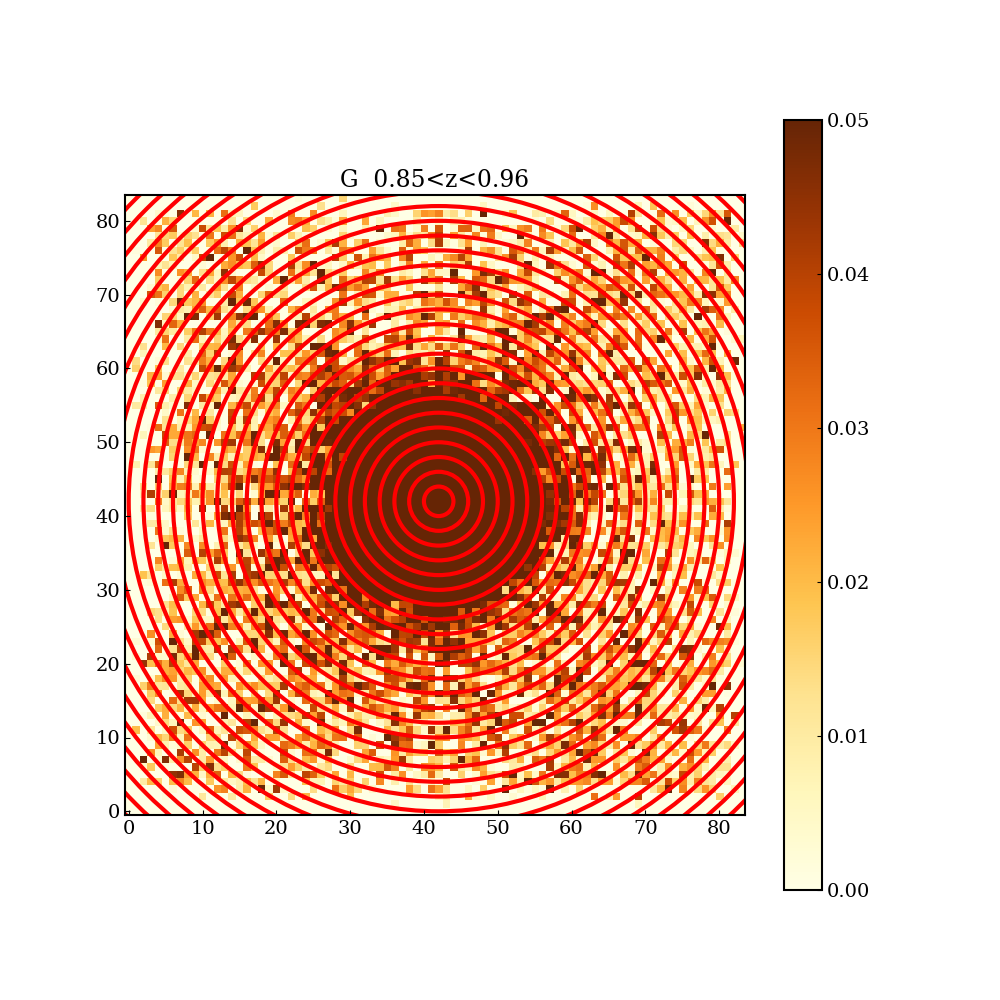

In [126]:
fig = plt.figure(figsize = (10,10), facecolor='white')

ax = fig.add_subplot(1,1, 1)

im = ax.imshow(Row_Median_Z_085_096, origin="lower", cmap="YlOrBr", vmin=0, vmax=0.05)

coord_offset = 0.5 * (ax.get_xlim()[0] + ax.get_xlim()[1])


circle1 = Circle((42,42), 2, edgecolor='r', facecolor="None", linewidth=3)
circle2 = Circle((42,42), 4, edgecolor='r', facecolor="None", linewidth=3)
circle3 = Circle((42,42), 6, edgecolor='r', facecolor="None", linewidth=3)
circle4 = Circle((42,42), 8, edgecolor='r', facecolor="None", linewidth=3)
circle5 = Circle((42,42), 10, edgecolor='r', facecolor="None", linewidth=3)
circle6 = Circle((42,42), 12, edgecolor='r', facecolor="None", linewidth=3)
circle7 = Circle((42,42), 14, edgecolor='r', facecolor="None", linewidth=3)
circle8 = Circle((42,42), 16, edgecolor='r', facecolor="None", linewidth=3)
circle9 = Circle((42,42), 18, edgecolor='r', facecolor="None", linewidth=3)
circle10 = Circle((42,42), 20, edgecolor='r', facecolor="None", linewidth=3)
circle11 = Circle((42,42), 22, edgecolor='r', facecolor="None", linewidth=3)
circle12 = Circle((42,42), 24, edgecolor='r', facecolor="None", linewidth=3)
circle13 = Circle((42,42), 26, edgecolor='r', facecolor="None", linewidth=3)
circle14 = Circle((42,42), 28, edgecolor='r', facecolor="None", linewidth=3)
circle15 = Circle((42,42), 30, edgecolor='r', facecolor="None", linewidth=3)
circle16 = Circle((42,42), 32, edgecolor='r', facecolor="None", linewidth=3)
circle17 = Circle((42,42), 34, edgecolor='r', facecolor="None", linewidth=3)
circle18 = Circle((42,42), 36, edgecolor='r', facecolor="None", linewidth=3)
circle19 = Circle((42,42), 38, edgecolor='r', facecolor="None", linewidth=3)
circle20 = Circle((42,42), 40, edgecolor='r', facecolor="None", linewidth=3)
circle21 = Circle((42,42), 42, edgecolor='r', facecolor="None", linewidth=3)
circle22 = Circle((42,42), 44, edgecolor='r', facecolor="None", linewidth=3)
circle23 = Circle((42,42), 46, edgecolor='r', facecolor="None", linewidth=3)
circle24 = Circle((42,42), 48, edgecolor='r', facecolor="None", linewidth=3)
circle25 = Circle((42,42), 50, edgecolor='r', facecolor="None", linewidth=3)
circle26 = Circle((42,42), 52, edgecolor='r', facecolor="None", linewidth=3)
circle27 = Circle((42,42), 54, edgecolor='r', facecolor="None", linewidth=3)
circle28 = Circle((42,42), 56, edgecolor='r', facecolor="None", linewidth=3)
circle29 = Circle((42,42), 58, edgecolor='r', facecolor="None", linewidth=3)
circle30 = Circle((42,42), 60, edgecolor='r', facecolor="None", linewidth=3)
circle31 = Circle((42,42), 62, edgecolor='r', facecolor="None", linewidth=3)
circle32 = Circle((42,42), 64, edgecolor='r', facecolor="None", linewidth=3)
circle33 = Circle((42,42), 66, edgecolor='r', facecolor="None", linewidth=3)
circle34 = Circle((42,42), 68, edgecolor='r', facecolor="None", linewidth=3)
circle35 = Circle((42,42), 70, edgecolor='r', facecolor="None", linewidth=3)
circle36 = Circle((42,42), 72, edgecolor='r', facecolor="None", linewidth=3)
circle37 = Circle((42,42), 74, edgecolor='r', facecolor="None", linewidth=3)
circle38 = Circle((42,42), 76, edgecolor='r', facecolor="None", linewidth=3)
circle39 = Circle((42,42), 78, edgecolor='r', facecolor="None", linewidth=3)
circle40 = Circle((42,42), 80, edgecolor='r', facecolor="None", linewidth=3)
circle41 = Circle((42,42), 82, edgecolor='r', facecolor="None", linewidth=3)
circle42 = Circle((42,42), 84, edgecolor='r', facecolor="None", linewidth=3)



# Add the circle to the axes
ax.add_patch(circle1)
ax.add_patch(circle2)
ax.add_patch(circle3)
ax.add_patch(circle4)
ax.add_patch(circle5)
ax.add_patch(circle6)
ax.add_patch(circle7)
ax.add_patch(circle8)
ax.add_patch(circle9)
ax.add_patch(circle10)
ax.add_patch(circle11)
ax.add_patch(circle12)
ax.add_patch(circle13)
ax.add_patch(circle14)
ax.add_patch(circle15)
ax.add_patch(circle16)
ax.add_patch(circle17)
ax.add_patch(circle18)
ax.add_patch(circle19)
ax.add_patch(circle20)
ax.add_patch(circle21)
ax.add_patch(circle22)
ax.add_patch(circle23)
ax.add_patch(circle24)
ax.add_patch(circle25)
ax.add_patch(circle26)
ax.add_patch(circle27)
ax.add_patch(circle28)
ax.add_patch(circle29)
ax.add_patch(circle30)
ax.add_patch(circle31)
ax.add_patch(circle32)
ax.add_patch(circle33)
ax.add_patch(circle34)
ax.add_patch(circle35)
ax.add_patch(circle36)
ax.add_patch(circle37)
ax.add_patch(circle38)
ax.add_patch(circle39)
ax.add_patch(circle40)
ax.add_patch(circle41)
ax.add_patch(circle42)






filename = "G  0.85<z<0.96"

plt.colorbar(im, ax=ax)

plt.title(str(filename))

In [127]:
A_average_085_096 = np.mean(A_circle_085_096)
B_average_085_096 = np.mean(B_circle_085_096)
C_average_085_096 = np.mean(C_circle_085_096)
D_average_085_096 = np.mean(D_circle_085_096)
E_average_085_096 = np.mean(E_circle_085_096)
F_average_085_096 = np.mean(F_circle_085_096)
G_average_085_096 = np.mean(G_circle_085_096)
H_average_085_096 = np.mean(H_circle_085_096)
I_average_085_096 = np.mean(I_circle_085_096)
J_average_085_096 = np.mean(J_circle_085_096)
K_average_085_096 = np.mean(K_circle_085_096)
L_average_085_096 = np.mean(L_circle_085_096)
M_average_085_096 = np.mean(M_circle_085_096)
N_average_085_096 = np.mean(N_circle_085_096)
O_average_085_096 = np.mean(O_circle_085_096)
P_average_085_096 = np.mean(P_circle_085_096)
Q_average_085_096 = np.mean(Q_circle_085_096)
R_average_085_096 = np.mean(R_circle_085_096)
S_average_085_096 = np.mean(S_circle_085_096)
T_average_085_096 = np.mean(T_circle_085_096)
U_average_085_096 = np.mean(U_circle_085_096)
V_average_085_096 = np.mean(V_circle_085_096)
W_average_085_096 = np.mean(W_circle_085_096)
X_average_085_096 = np.mean(X_circle_085_096)
Y_average_085_096 = np.mean(Y_circle_085_096)
Z_average_085_096 = np.mean(Z_circle_085_096)
AA_average_085_096 = np.mean(AA_circle_085_096)
BB_average_085_096 = np.mean(BB_circle_085_096)
CC_average_085_096 = np.mean(CC_circle_085_096)
DD_average_085_096 = np.mean(DD_circle_085_096)
EE_average_085_096 = np.mean(EE_circle_085_096)
FF_average_085_096 = np.mean(FF_circle_085_096)
GG_average_085_096 = np.mean(GG_circle_085_096)
HH_average_085_096 = np.mean(HH_circle_085_096)
II_average_085_096 = np.mean(II_circle_085_096)
JJ_average_085_096 = np.mean(JJ_circle_085_096)
KK_average_085_096 = np.mean(KK_circle_085_096)
LL_average_085_096 = np.mean(LL_circle_085_096)
MM_average_085_096 = np.mean(MM_circle_085_096)
NN_average_085_096 = np.mean(NN_circle_085_096)
OO_average_085_096 = np.mean(OO_circle_085_096)
PP_average_085_096 = np.mean(PP_circle_085_096)


In [128]:
A_cirlce_SDE_085_096 = statistics.stdev(A_circle_085_096)/np.sqrt(len(A_circle_085_096))
B_circle_SDE_085_096 = statistics.stdev(B_circle_085_096)/np.sqrt(len(B_circle_085_096))
C_circle_SDE_085_096 = statistics.stdev(C_circle_085_096)/np.sqrt(len(C_circle_085_096))
D_circle_SDE_085_096 = statistics.stdev(D_circle_085_096)/np.sqrt(len(D_circle_085_096))
E_circle_SDE_085_096 = statistics.stdev(E_circle_085_096)/np.sqrt(len(E_circle_085_096))
F_circle_SDE_085_096 = statistics.stdev(F_circle_085_096)/np.sqrt(len(F_circle_085_096))
G_circle_SDE_085_096 = statistics.stdev(G_circle_085_096)/np.sqrt(len(G_circle_085_096))
H_circle_SDE_085_096 = statistics.stdev(H_circle_085_096)/np.sqrt(len(H_circle_085_096))
I_circle_SDE_085_096 = statistics.stdev(I_circle_085_096)/np.sqrt(len(I_circle_085_096))
J_circle_SDE_085_096 = statistics.stdev(J_circle_085_096)/np.sqrt(len(J_circle_085_096))
K_circle_SDE_085_096 = statistics.stdev(K_circle_085_096)/np.sqrt(len(K_circle_085_096))
L_circle_SDE_085_096 = statistics.stdev(L_circle_085_096)/np.sqrt(len(L_circle_085_096))
M_circle_SDE_085_096 = statistics.stdev(M_circle_085_096)/np.sqrt(len(M_circle_085_096))
N_circle_SDE_085_096 = statistics.stdev(N_circle_085_096)/np.sqrt(len(N_circle_085_096))
O_circle_SDE_085_096 = statistics.stdev(O_circle_085_096)/np.sqrt(len(O_circle_085_096))
P_circle_SDE_085_096 = statistics.stdev(P_circle_085_096)/np.sqrt(len(P_circle_085_096))
Q_circle_SDE_085_096 = statistics.stdev(Q_circle_085_096)/np.sqrt(len(Q_circle_085_096))
R_circle_SDE_085_096 = statistics.stdev(R_circle_085_096)/np.sqrt(len(R_circle_085_096))
S_circle_SDE_085_096 = statistics.stdev(S_circle_085_096)/np.sqrt(len(S_circle_085_096))
T_circle_SDE_085_096 = statistics.stdev(T_circle_085_096)/np.sqrt(len(T_circle_085_096))
U_circle_SDE_085_096 = statistics.stdev(U_circle_085_096)/np.sqrt(len(U_circle_085_096))
V_circle_SDE_085_096 = statistics.stdev(V_circle_085_096)/np.sqrt(len(V_circle_085_096))
W_circle_SDE_085_096 = statistics.stdev(W_circle_085_096)/np.sqrt(len(W_circle_085_096))
X_circle_SDE_085_096 = statistics.stdev(X_circle_085_096)/np.sqrt(len(X_circle_085_096))
Y_circle_SDE_085_096 = statistics.stdev(Y_circle_085_096)/np.sqrt(len(Y_circle_085_096))
Z_circle_SDE_085_096 = statistics.stdev(Z_circle_085_096)/np.sqrt(len(Z_circle_085_096))
AA_circle_SDE_085_096 = statistics.stdev(AA_circle_085_096)/np.sqrt(len(AA_circle_085_096))
BB_circle_SDE_085_096 = statistics.stdev(BB_circle_085_096)/np.sqrt(len(BB_circle_085_096))
CC_circle_SDE_085_096 = statistics.stdev(CC_circle_085_096)/np.sqrt(len(CC_circle_085_096))
DD_circle_SDE_085_096 = statistics.stdev(DD_circle_085_096)/np.sqrt(len(DD_circle_085_096))
EE_circle_SDE_085_096 = statistics.stdev(EE_circle_085_096)/np.sqrt(len(EE_circle_085_096))
FF_circle_SDE_085_096 = statistics.stdev(FF_circle_085_096)/np.sqrt(len(FF_circle_085_096))
GG_circle_SDE_085_096 = statistics.stdev(GG_circle_085_096)/np.sqrt(len(GG_circle_085_096))
HH_circle_SDE_085_096 = statistics.stdev(HH_circle_085_096)/np.sqrt(len(HH_circle_085_096))
II_circle_SDE_085_096 = statistics.stdev(II_circle_085_096)/np.sqrt(len(II_circle_085_096))
JJ_circle_SDE_085_096 = statistics.stdev(JJ_circle_085_096)/np.sqrt(len(JJ_circle_085_096))
KK_circle_SDE_085_096 = statistics.stdev(KK_circle_085_096)/np.sqrt(len(KK_circle_085_096))
LL_circle_SDE_085_096 = statistics.stdev(LL_circle_085_096)/np.sqrt(len(LL_circle_085_096))
MM_circle_SDE_085_096 = statistics.stdev(MM_circle_085_096)/np.sqrt(len(MM_circle_085_096))
NN_circle_SDE_085_096 = statistics.stdev(NN_circle_085_096)/np.sqrt(len(NN_circle_085_096))
OO_circle_SDE_085_096 = statistics.stdev(OO_circle_085_096)/np.sqrt(len(OO_circle_085_096))
PP_circle_SDE_085_096 = statistics.stdev(PP_circle_085_096)/np.sqrt(len(PP_circle_085_096))


In [129]:
Radius_array_085_096 = np.array([A_average_085_096 , B_average_085_096 , C_average_085_096 , D_average_085_096 , E_average_085_096 , F_average_085_096 , G_average_085_096 , H_average_085_096 , I_average_085_096 , J_average_085_096 , K_average_085_096 , L_average_085_096 , M_average_085_096 , N_average_085_096 , O_average_085_096 , P_average_085_096 , Q_average_085_096 , R_average_085_096 , S_average_085_096 , T_average_085_096 , U_average_085_096 , V_average_085_096 , W_average_085_096 , X_average_085_096 , Y_average_085_096 , Z_average_085_096 , AA_average_085_096, BB_average_085_096, CC_average_085_096, DD_average_085_096, EE_average_085_096, FF_average_085_096, GG_average_085_096, HH_average_085_096, II_average_085_096, JJ_average_085_096, KK_average_085_096, LL_average_085_096, MM_average_085_096,NN_average_085_096, OO_average_085_096, PP_average_085_096])
Radius_array_SDE_085_096 = np.array([A_cirlce_SDE_085_096 , B_circle_SDE_085_096 , C_circle_SDE_085_096 , D_circle_SDE_085_096 , E_circle_SDE_085_096 , F_circle_SDE_085_096 , G_circle_SDE_085_096 , H_circle_SDE_085_096 , I_circle_SDE_085_096 , J_circle_SDE_085_096 , K_circle_SDE_085_096 , L_circle_SDE_085_096 , M_circle_SDE_085_096 , N_circle_SDE_085_096 , O_circle_SDE_085_096 , P_circle_SDE_085_096 , Q_circle_SDE_085_096 , R_circle_SDE_085_096 , S_circle_SDE_085_096 , T_circle_SDE_085_096 , U_circle_SDE_085_096 , V_circle_SDE_085_096 , W_circle_SDE_085_096 , X_circle_SDE_085_096 , Y_circle_SDE_085_096 , Z_circle_SDE_085_096 , AA_circle_SDE_085_096, BB_circle_SDE_085_096, CC_circle_SDE_085_096, DD_circle_SDE_085_096, EE_circle_SDE_085_096, FF_circle_SDE_085_096, GG_circle_SDE_085_096, HH_circle_SDE_085_096, II_circle_SDE_085_096, JJ_circle_SDE_085_096, KK_circle_SDE_085_096, LL_circle_SDE_085_096, MM_circle_SDE_085_096, NN_circle_SDE_085_096, OO_circle_SDE_085_096, PP_circle_SDE_085_096])


In [130]:
Median_Mag_G_025_035 = np.median(G_Mag_025_035, axis=0)
Median_Mag_R_025_035 = np.median(R_Mag_025_035, axis=0)
Median_Mag_I_025_035 = np.median(I_Mag_025_035, axis=0)
Median_Mag_Z_025_035 = np.median(Z_Mag_025_035, axis=0)
Median_Mag_Y_025_035 = np.median(Y_Mag_025_035, axis=0)


Median_Z_G_025_035 = np.median(G_Z_025_035, axis=0)
Median_Z_R_025_035 = np.median(R_Z_025_035, axis=0)
Median_Z_I_025_035 = np.median(I_Z_025_035, axis=0)
Median_Z_Z_025_035 = np.median(Z_Z_025_035, axis=0)
Median_Z_Y_025_035 = np.median(Y_Z_025_035, axis=0)


In [131]:
Median_Mag_G_035_045 = np.median(G_Mag_035_045, axis=0)
Median_Mag_R_035_045 = np.median(R_Mag_035_045, axis=0)
Median_Mag_I_035_045 = np.median(I_Mag_035_045, axis=0)
Median_Mag_Z_035_045 = np.median(Z_Mag_035_045, axis=0)
Median_Mag_Y_035_045 = np.median(Y_Mag_035_045, axis=0)

Median_Z_G_035_045 = np.median(G_Z_035_045, axis=0)
Median_Z_R_035_045 = np.median(R_Z_035_045, axis=0)
Median_Z_I_035_045 = np.median(I_Z_035_045, axis=0)
Median_Z_Z_035_045 = np.median(Z_Z_035_045, axis=0)
Median_Z_Y_035_045 = np.median(Y_Z_035_045, axis=0)


In [132]:
Median_Mag_G_045_055 = np.median(G_Mag_045_055, axis=0)
Median_Mag_R_045_055 = np.median(R_Mag_045_055, axis=0)
Median_Mag_I_045_055 = np.median(I_Mag_045_055, axis=0)
Median_Mag_Z_045_055 = np.median(Z_Mag_045_055, axis=0)
Median_Mag_Y_045_055 = np.median(Y_Mag_045_055, axis=0)

Median_Z_G_045_055 = np.median(G_Z_045_055, axis=0)
Median_Z_R_045_055 = np.median(R_Z_045_055, axis=0)
Median_Z_I_045_055 = np.median(I_Z_045_055, axis=0)
Median_Z_Z_045_055 = np.median(Z_Z_045_055, axis=0)
Median_Z_Y_045_055 = np.median(Y_Z_045_055, axis=0)


In [133]:
Median_Mag_G_055_065 = np.median(G_Mag_055_065, axis=0)
Median_Mag_R_055_065 = np.median(R_Mag_055_065, axis=0)
Median_Mag_I_055_065 = np.median(I_Mag_055_065, axis=0)
Median_Mag_Z_055_065 = np.median(Z_Mag_055_065, axis=0)
Median_Mag_Y_055_065 = np.median(Y_Mag_055_065, axis=0)

Median_Z_G_055_065 = np.median(G_Z_055_065, axis=0)
Median_Z_R_055_065 = np.median(R_Z_055_065, axis=0)
Median_Z_I_055_065 = np.median(I_Z_055_065, axis=0)
Median_Z_Z_055_065 = np.median(Z_Z_055_065, axis=0)
Median_Z_Y_055_065 = np.median(Y_Z_055_065, axis=0)


In [134]:
Median_Mag_G_065_075 = np.median(G_Mag_065_075, axis=0)
Median_Mag_R_065_075 = np.median(R_Mag_065_075, axis=0)
Median_Mag_I_065_075 = np.median(I_Mag_065_075, axis=0)
Median_Mag_Z_065_075 = np.median(Z_Mag_065_075, axis=0)
Median_Mag_Y_065_075 = np.median(Y_Mag_065_075, axis=0)

Median_Z_G_065_075 = np.median(G_Z_065_075, axis=0)
Median_Z_R_065_075 = np.median(R_Z_065_075, axis=0)
Median_Z_I_065_075 = np.median(I_Z_065_075, axis=0)
Median_Z_Z_065_075 = np.median(Z_Z_065_075, axis=0)
Median_Z_Y_065_075 = np.median(Y_Z_065_075, axis=0)


In [135]:
Median_Mag_G_075_085 = np.median(G_Mag_075_085, axis=0)
Median_Mag_R_075_085 = np.median(R_Mag_075_085, axis=0)
Median_Mag_I_075_085 = np.median(I_Mag_075_085, axis=0)
Median_Mag_Z_075_085 = np.median(Z_Mag_075_085, axis=0)
Median_Mag_Y_075_085 = np.median(Y_Mag_075_085, axis=0)

Median_Z_G_075_085 = np.median(G_Z_075_085, axis=0)
Median_Z_R_075_085 = np.median(R_Z_075_085, axis=0)
Median_Z_I_075_085 = np.median(I_Z_075_085, axis=0)
Median_Z_Z_075_085 = np.median(Z_Z_075_085, axis=0)
Median_Z_Y_075_085 = np.median(Y_Z_075_085, axis=0)


In [136]:
Median_Mag_G_085_096 = np.median(G_Mag_085_096, axis=0)
Median_Mag_R_085_096 = np.median(R_Mag_085_096, axis=0)
Median_Mag_I_085_096 = np.median(I_Mag_085_096, axis=0)
Median_Mag_Z_085_096 = np.median(Z_Mag_085_096, axis=0)
Median_Mag_Y_085_096 = np.median(Y_Mag_085_096, axis=0)

Median_Z_G_085_096 = np.median(G_Z_085_096, axis=0)
Median_Z_R_085_096 = np.median(R_Z_085_096, axis=0)
Median_Z_I_085_096 = np.median(I_Z_085_096, axis=0)
Median_Z_Z_085_096 = np.median(Z_Z_085_096, axis=0)
Median_Z_Y_085_096 = np.median(Y_Z_085_096, axis=0)


## Fitting without the min PSF

## Flipping the half guass and refitting

In [137]:
Mirrored_Radius_array_025_035 = np.concatenate((np.flip(Radius_array_025_035), Radius_array_025_035))
Mirrored_Radius_array_035_045 = np.concatenate((np.flip(Radius_array_035_045), Radius_array_035_045))
Mirrored_Radius_array_045_055 = np.concatenate((np.flip(Radius_array_045_055), Radius_array_045_055))
Mirrored_Radius_array_055_065 = np.concatenate((np.flip(Radius_array_055_065), Radius_array_055_065))
Mirrored_Radius_array_065_075 = np.concatenate((np.flip(Radius_array_065_075), Radius_array_065_075))
Mirrored_Radius_array_075_085 = np.concatenate((np.flip(Radius_array_075_085), Radius_array_075_085))
Mirrored_Radius_array_085_096 = np.concatenate((np.flip(Radius_array_085_096), Radius_array_085_096))


In [138]:
Mirrored_Radius_array_SDE_025_035 = np.concatenate((np.flip(Radius_array_SDE_025_035), Radius_array_SDE_025_035))
Mirrored_Radius_array_SDE_035_045 = np.concatenate((np.flip(Radius_array_SDE_035_045), Radius_array_SDE_035_045))
Mirrored_Radius_array_SDE_045_055 = np.concatenate((np.flip(Radius_array_SDE_045_055), Radius_array_SDE_045_055))
Mirrored_Radius_array_SDE_055_065 = np.concatenate((np.flip(Radius_array_SDE_055_065), Radius_array_SDE_055_065))
Mirrored_Radius_array_SDE_065_075 = np.concatenate((np.flip(Radius_array_SDE_065_075), Radius_array_SDE_065_075))
Mirrored_Radius_array_SDE_075_085 = np.concatenate((np.flip(Radius_array_SDE_075_085), Radius_array_SDE_075_085))
Mirrored_Radius_array_SDE_085_096 = np.concatenate((np.flip(Radius_array_SDE_085_096), Radius_array_SDE_085_096))


100%|██████████| 5000/5000 [00:08<00:00, 598.86it/s]


Amplitude Red = 1.8473127309795927 +0.020948669027168965 - 0.14648942015963984

Width Red = 0.39565414390731224 +0.004283139937641345 - 0.03255051815854537

Amplitude Blue = 0.592290453922954 +0.0076477198438641425 - 0.06030863523487573

Width Blue = 1.4714887763020776 +0.028421002757585967 - 0.20766079942865012


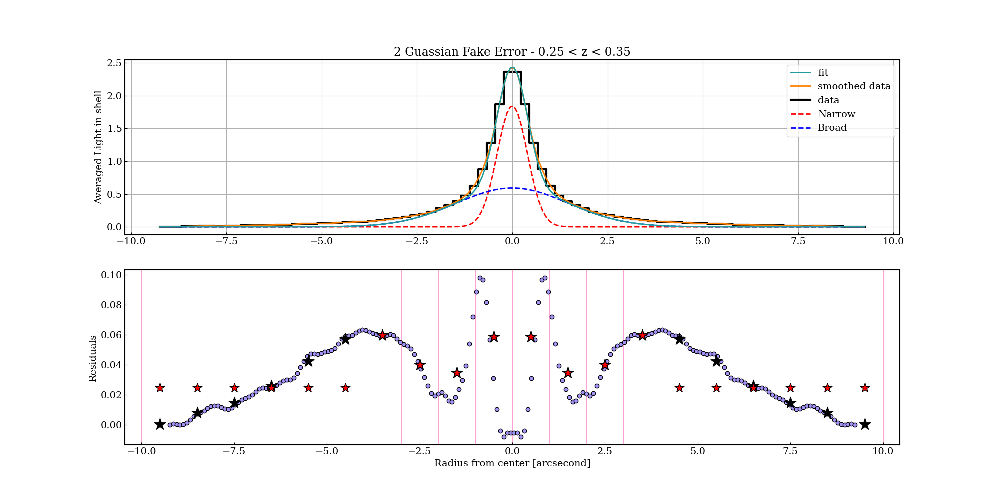

In [139]:
# 1. Generate or load data
x_Mirror_025_035 = np.linspace(-84,84,84)

x_data_Mirror_025_035 = np.multiply(x_Mirror_025_035, 0.11)
y_data_Mirror_025_035 = Mirrored_Radius_array_025_035

y_err_Mirror_025_035 = 1.0 #Mirrored_Radius_array_SDE_025_035[0:84]

initial_Mirror_025_035 = np.array([0.6, 0.4, 0.1, 1.0]) #amp,wid ... red/narrow, blue/broad


Amplitude_Narrow_Red_Lower_Lim_Mirror_025_035 = 0
Amplitude_Narrow_Red_Upperr_Lim_Mirror_025_035 = 1.87

Width_Narrow_Red_Lower_Lim_Mirror_025_035 = 0
Width_Narrow_Red_Upper_Lim_Mirror_025_035 = 0.4


Amplitude_Broad_Blue_Lower_Lim_Mirror_025_035 = 0
Amplitude_Broad_Blue_Upperr_Lim_Mirror_025_035 = 0.6

Width_Broad_Blue_Lower_Lim_Mirror_025_035 = 0
Width_Broad_Blue_Upper_Lim_Mirror_025_035 = 1.5




# 2. Define the likelihood function ############################################################################################################################################
def log_likelihood(theta, x, y, yerr):
    amp1, wid1, amp2, wid2 = theta
    model = two_gaussian(x, amp1, wid1, amp2, wid2)
    sigma2 = yerr**2
    return -0.5 * np.sum((y - model)**2 / sigma2 + np.log(sigma2))

# 4. Define the prior (optional, but recommended) ############################################################################################################################################
#def log_prior(theta):
#    amp1, wid1, amp2, wid2 = theta
#    if not all(0 < param < 10 for param in [amp1, amp2, wid1, wid2]):
#        return -np.inf
#    return 0.0

def log_prior(theta):
    amp1, wid1, amp2, wid2 = theta
    if (Amplitude_Narrow_Red_Lower_Lim_Mirror_025_035 < amp1 < Amplitude_Narrow_Red_Upperr_Lim_Mirror_025_035 and Amplitude_Broad_Blue_Lower_Lim_Mirror_025_035 < amp2 <  Amplitude_Broad_Blue_Upperr_Lim_Mirror_025_035 and Width_Narrow_Red_Lower_Lim_Mirror_025_035 < wid1 < Width_Narrow_Red_Upper_Lim_Mirror_025_035 and Width_Broad_Blue_Lower_Lim_Mirror_025_035 < wid2 <  Width_Broad_Blue_Upper_Lim_Mirror_025_035):
        return 0.0
    return -np.inf

# 5. Define the probability function ############################################################################################################################################
def log_probability(theta, x, y, yerr):
    lp = log_prior(theta)
    if not np.isfinite(lp):
        return -np.inf
    return lp + log_likelihood(theta, x, y, yerr)

# 3. Optimization (finding a good starting point) ############################################################################################################################################

bounds_Mirror_025_035 = [(Amplitude_Narrow_Red_Lower_Lim_Mirror_025_035, Amplitude_Narrow_Red_Upperr_Lim_Mirror_025_035), (Width_Narrow_Red_Lower_Lim_Mirror_025_035, Width_Narrow_Red_Upper_Lim_Mirror_025_035), (Amplitude_Broad_Blue_Lower_Lim_Mirror_025_035, Amplitude_Broad_Blue_Upperr_Lim_Mirror_025_035), (Width_Broad_Blue_Lower_Lim_Mirror_025_035, Width_Broad_Blue_Upper_Lim_Mirror_025_035)] # Parameter bounds for optimization
soln_Mirror_025_035 = minimize(lambda *args: -log_likelihood(*args), initial_Mirror_025_035, args=(x_data_Mirror_025_035, y_data_Mirror_025_035, y_err_Mirror_025_035), bounds=bounds_Mirror_025_035)

#soln = minimize(lambda *args: -log_likelihood(*args), initial, args=(x_data, y_data, y_err))
pos_Mirror_025_035 = soln_Mirror_025_035.x + 1e-4 * np.random.randn(32, len(soln_Mirror_025_035.x))
nwalkers_Mirror_025_035, ndim_Mirror_025_035 = pos_Mirror_025_035.shape


# 4. MCMC sampling ############################################################################################################################################
sampler_Mirror_025_035 = emcee.EnsembleSampler(nwalkers_Mirror_025_035, ndim_Mirror_025_035, log_probability, args=(x_data_Mirror_025_035, y_data_Mirror_025_035, y_err_Mirror_025_035))
sampler_Mirror_025_035.run_mcmc(pos_Mirror_025_035, 5000, progress=True)

# 5. Analyze results
samples_Mirror_025_035 = sampler_Mirror_025_035.get_chain(flat=True)

# 6. Best fit parameters ############################################################################################################################################
best_fit_params_Mirror_025_035 = []
for i in range(ndim_Mirror_025_035):
    mcmc_Mirror_025_035 = np.percentile(samples_Mirror_025_035[:, i], [68, 95, 99.7])
    best_fit_params_Mirror_025_035.append(mcmc_Mirror_025_035[1])

# 10. Error estimation ############################################################################################################################################
errors_Mirror_025_035 = []
for i in range(ndim_Mirror_025_035):
     mcmc_Mirror_025_035 = np.percentile(samples_Mirror_025_035[:, i], [68, 95, 99.7])
     errors_Mirror_025_035.append([mcmc_Mirror_025_035[2]-mcmc_Mirror_025_035[1],mcmc_Mirror_025_035[1]-mcmc_Mirror_025_035[0]])
     
# 11. Getting the RMS Values ############################################################################################################################################
x_new_Mirror_025_035 = np.linspace(min(x_data_Mirror_025_035),max(x_data_Mirror_025_035), 200)

y_new_Mirror_025_035 = CubicSpline(x_data_Mirror_025_035, y_data_Mirror_025_035)

yy_new_Mirror_025_035 = y_new_Mirror_025_035(x_new_Mirror_025_035)

x_plot_Mirror_025_035 = np.linspace(min(x_data_Mirror_025_035), max(x_data_Mirror_025_035), 200)


RMS_Bins_Mirrored_025_035 = np.arange(-10, 10, 1) # -10-10 bins of size 2
X_Array_RMS_025_035 = np.arange(-9.5, 10.5, 1) 


RMS_Array_025_035 = []
RMS_Len_Array_025_035 = []
RMS_Len_Array_Old_025_035 = []


for i in RMS_Bins_Mirrored_025_035:
    #print(np.where(np.logical_and(i < x_new_Mirror_025_035, x_new_Mirror_025_035 < i+2)))
    #print(len(x_new_Mirror_025_035[np.where(np.logical_and(i < x_new_Mirror_025_035, x_new_Mirror_025_035 < i+2))]))

    index = np.where(np.logical_and(i < x_new_Mirror_025_035, x_new_Mirror_025_035 < i+1))[0]

    index_2 = np.where(np.logical_and(i < x_data_Mirror_025_035, x_data_Mirror_025_035 < i+1))[0]
    
    values = yy_new_Mirror_025_035 - two_gaussian(x_plot_Mirror_025_035, *best_fit_params_Mirror_025_035)

    indexed_values = values[index]

    RMS = np.sqrt( (1/len(indexed_values)) * (np.sum(indexed_values**2)) )


    RMS_Array_025_035.append(RMS)
    RMS_Len_Array_025_035.append(len(index))
    RMS_Len_Array_Old_025_035.append(len(index_2))



index_1_025_035 = np.where(np.logical_and(X_Array_RMS_025_035 > (40*0.11), X_Array_RMS_025_035 > 0))[0]
index_2_025_035 = np.where(np.logical_and(X_Array_RMS_025_035 < -(40*0.11), X_Array_RMS_025_035 < 0))[0]
index_3_025_035 = np.concatenate((index_2_025_035,index_1_025_035))

Average_RMS_OutBox_025_035 = np.average(np.array(RMS_Array_025_035)[index_1_025_035])

RMS_Array_InBox_025_035 = np.array(RMS_Array_025_035)

RMS_Array_InBox_025_035[index_3_025_035] = Average_RMS_OutBox_025_035
     
# 12. Plot results ############################################################################################################################################
fig = plt.figure(figsize = (20, 10),  facecolor = "white")
ax = plt.subplot(2,1,1)

plt.plot(x_plot_Mirror_025_035, two_gaussian(x_plot_Mirror_025_035, *best_fit_params_Mirror_025_035), color = "#219B9D", linewidth=2.0, label="fit", zorder=10)
plt.plot(x_new_Mirror_025_035, yy_new_Mirror_025_035, color = "#FF8000", linewidth=2.0, label="smoothed data")
plt.step(x_data_Mirror_025_035, y_data_Mirror_025_035, color = "black", linewidth=3.0, where="mid", zorder=0, label="data")

plt.plot(x_plot_Mirror_025_035, gaussian(x_plot_Mirror_025_035, best_fit_params_Mirror_025_035[0], best_fit_params_Mirror_025_035[1]), color="red", linestyle="--", label="Narrow")
plt.plot(x_plot_Mirror_025_035, gaussian(x_plot_Mirror_025_035, best_fit_params_Mirror_025_035[2], best_fit_params_Mirror_025_035[3]), color="blue", linestyle="--", label="Broad")

plt.legend()

ax1 = plt.subplot(2,1,2)

ax1.scatter(x_new_Mirror_025_035, yy_new_Mirror_025_035 - two_gaussian(x_plot_Mirror_025_035, *best_fit_params_Mirror_025_035), c = "#A294F9", edgecolor="black") 

ax1.scatter(X_Array_RMS_025_035, RMS_Array_025_035, c = "black", edgecolor="black", marker="*", s=300, zorder=10)
ax1.scatter(X_Array_RMS_025_035, RMS_Array_InBox_025_035, c = "Red", edgecolor="black", marker="*", s=200, zorder=10)



plt.axvline(x = -10, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -9, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -8, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -7, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -6, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -5, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -4, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -3, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -2, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -1, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 0, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 1, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 2, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 3, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 4, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 5, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 6, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 7, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 8, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 9, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 10, color = "#FF78C4", linewidth=0.5, zorder = 0)

#plt.ylim(-0.001,0.001)

ax.set_title("2 Guassian Fake Error - 0.25 < z < 0.35")

ax1.set_xlabel("Radius from center [arcsecond]")

ax.set_ylabel("Averaged Light in shell")
ax1.set_ylabel("Residuals")

ax.grid()


############################################################################################################################################
Best_Fit_Mirrored_025_035 = yy_new_Mirror_025_035
Best_Fit_Mirrored_Fit_X_Array_025_035 = x_new_Mirror_025_035

Narrow_Amplitude_Fit_Mirrored_025_035 = best_fit_params_Mirror_025_035[0]
Narrow_Amplitude_Fit_Mirrored_Error_P_025_035 = errors_Mirror_025_035[0][0]
Narrow_Amplitude_Fit_Mirrored_Error_M_025_035 = errors_Mirror_025_035[0][1]
Narrow_Width_Fit_Mirrored_025_035 = best_fit_params_Mirror_025_035[1]
Narrow_Width_Fit_Mirrored_Error_P_025_035 = errors_Mirror_025_035[1][0]
Narrow_Width_Fit_Mirrored_Error_M_025_035 = errors_Mirror_025_035[1][1]

Broad_Amplitude_Fit_Mirrored_025_035 = best_fit_params_Mirror_025_035[2]
Broad_Amplitude_Fit_Mirrored_Error_P_025_035 = errors_Mirror_025_035[2][0]
Broad_Amplitude_Fit_Mirrored_Error_M_025_035 = errors_Mirror_025_035[2][1]
Broad_Width_Fit_Mirrored_025_035 = best_fit_params_Mirror_025_035[3]
Broad_Width_Fit_Mirrored_Error_P_025_035 = errors_Mirror_025_035[3][0]
Broad_Width_Fit_Mirrored_Error_M_025_035 = errors_Mirror_025_035[3][1]

Best_Fit_Mirrored_Fit_Residuals_025_035 = yy_new_Mirror_025_035 - two_gaussian(x_plot_Mirror_025_035, *best_fit_params_Mirror_025_035)
Gaussian_Fit_Mirrored_X_Array_025_035 = x_plot_Mirror_025_035

############################################################################################################################################
print("Amplitude Red = " +str(best_fit_params_Mirror_025_035[0]) + " +" +str(errors_Mirror_025_035[0][0]) + " - " +str(errors_Mirror_025_035[0][1]))
print("")
print("Width Red = " +str(best_fit_params_Mirror_025_035[1]) + " +" +str(errors_Mirror_025_035[1][0]) + " - " +str(errors_Mirror_025_035[1][1]))
print("")
print("Amplitude Blue = " +str(best_fit_params_Mirror_025_035[2]) + " +" +str(errors_Mirror_025_035[2][0]) + " - " +str(errors_Mirror_025_035[2][1]))
print("")
print("Width Blue = " +str(best_fit_params_Mirror_025_035[3]) + " +" +str(errors_Mirror_025_035[3][0]) + " - " +str(errors_Mirror_025_035[3][1]))


100%|██████████| 5000/5000 [00:07<00:00, 662.20it/s]


Amplitude Red = 0.9517744805301789 +0.01814041173131098 - 0.15339861356752094

Width Red = 0.3420191885198669 +0.007430097611919928 - 0.055437264202873426

Amplitude Blue = 0.5903629466779092 +0.00903900748272446 - 0.0786534959497952

Width Blue = 0.9788469252511968 +0.021060287542375877 - 0.18037481310359482


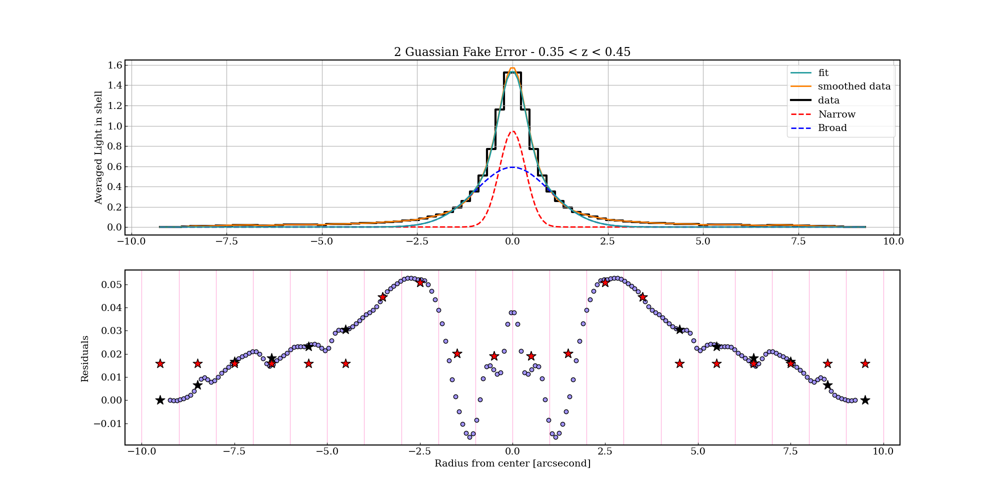

In [140]:
# 1. Generate or load data
x_Mirror_035_045 = np.linspace(-84,84,84)

x_data_Mirror_035_045 = np.multiply(x_Mirror_035_045, 0.11)
y_data_Mirror_035_045 = Mirrored_Radius_array_035_045

y_err_Mirror_035_045 = 1.0 #Mirrored_Radius_array_SDE_035_045[0:84]

initial_Mirror_035_045 = np.array([0.6, 0.4, 0.1, 1.1]) #amp,wid ... red/narrow, blue/broad


Amplitude_Narrow_Red_Lower_Lim_Mirror_035_045 = 0
Amplitude_Narrow_Red_Upperr_Lim_Mirror_035_045 = 0.97

Width_Narrow_Red_Lower_Lim_Mirror_035_045 = 0
Width_Narrow_Red_Upper_Lim_Mirror_035_045 = 0.35


Amplitude_Broad_Blue_Lower_Lim_Mirror_035_045 = 0
Amplitude_Broad_Blue_Upperr_Lim_Mirror_035_045 = 0.6

Width_Broad_Blue_Lower_Lim_Mirror_035_045 = 0
Width_Broad_Blue_Upper_Lim_Mirror_035_045 = 1.0



# 2. Define the likelihood function ############################################################################################################################################
def log_likelihood(theta, x, y, yerr):
    amp1, wid1, amp2, wid2 = theta
    model = two_gaussian(x, amp1, wid1, amp2, wid2)
    sigma2 = yerr**2
    return -0.5 * np.sum((y - model)**2 / sigma2 + np.log(sigma2))

# 4. Define the prior (optional, but recommended) ############################################################################################################################################
#def log_prior(theta):
#    amp1, wid1, amp2, wid2 = theta
#    if not all(0 < param < 10 for param in [amp1, amp2, wid1, wid2]):
#        return -np.inf
#    return 0.0

def log_prior(theta):
    amp1, wid1, amp2, wid2 = theta
    if (Amplitude_Narrow_Red_Lower_Lim_Mirror_035_045 < amp1 < Amplitude_Narrow_Red_Upperr_Lim_Mirror_035_045 and Amplitude_Broad_Blue_Lower_Lim_Mirror_035_045 < amp2 <  Amplitude_Broad_Blue_Upperr_Lim_Mirror_035_045 and Width_Narrow_Red_Lower_Lim_Mirror_035_045 < wid1 < Width_Narrow_Red_Upper_Lim_Mirror_035_045 and Width_Broad_Blue_Lower_Lim_Mirror_035_045 < wid2 <  Width_Broad_Blue_Upper_Lim_Mirror_035_045):
        return 0.0
    return -np.inf

# 5. Define the probability function ############################################################################################################################################
def log_probability(theta, x, y, yerr):
    lp = log_prior(theta)
    if not np.isfinite(lp):
        return -np.inf
    return lp + log_likelihood(theta, x, y, yerr)

# 3. Optimization (finding a good starting point) ############################################################################################################################################

bounds_Mirror_035_045 = [(Amplitude_Narrow_Red_Lower_Lim_Mirror_035_045, Amplitude_Narrow_Red_Upperr_Lim_Mirror_035_045), (Width_Narrow_Red_Lower_Lim_Mirror_035_045, Width_Narrow_Red_Upper_Lim_Mirror_035_045), (Amplitude_Broad_Blue_Lower_Lim_Mirror_035_045, Amplitude_Broad_Blue_Upperr_Lim_Mirror_035_045), (Width_Broad_Blue_Lower_Lim_Mirror_035_045, Width_Broad_Blue_Upper_Lim_Mirror_035_045)] # Parameter bounds for optimization
soln_Mirror_035_045 = minimize(lambda *args: -log_likelihood(*args), initial_Mirror_035_045, args=(x_data_Mirror_035_045, y_data_Mirror_035_045, y_err_Mirror_035_045), bounds=bounds_Mirror_035_045)

#soln = minimize(lambda *args: -log_likelihood(*args), initial, args=(x_data, y_data, y_err))
pos_Mirror_035_045 = soln_Mirror_035_045.x + 1e-4 * np.random.randn(32, len(soln_Mirror_035_045.x))
nwalkers_Mirror_035_045, ndim_Mirror_035_045 = pos_Mirror_035_045.shape


# 4. MCMC sampling ############################################################################################################################################
sampler_Mirror_035_045 = emcee.EnsembleSampler(nwalkers_Mirror_035_045, ndim_Mirror_035_045, log_probability, args=(x_data_Mirror_035_045, y_data_Mirror_035_045, y_err_Mirror_035_045))
sampler_Mirror_035_045.run_mcmc(pos_Mirror_035_045, 5000, progress=True)

# 5. Analyze results
samples_Mirror_035_045 = sampler_Mirror_035_045.get_chain(flat=True)

# 6. Best fit parameters ############################################################################################################################################
best_fit_params_Mirror_035_045 = []
for i in range(ndim_Mirror_035_045):
    mcmc_Mirror_035_045 = np.percentile(samples_Mirror_035_045[:, i], [68, 95, 99.7])
    best_fit_params_Mirror_035_045.append(mcmc_Mirror_035_045[1])

# 10. Error estimation ############################################################################################################################################
errors_Mirror_035_045 = []
for i in range(ndim_Mirror_035_045):
     mcmc_Mirror_035_045 = np.percentile(samples_Mirror_035_045[:, i], [68, 95, 99.7])
     errors_Mirror_035_045.append([mcmc_Mirror_035_045[2]-mcmc_Mirror_035_045[1],mcmc_Mirror_035_045[1]-mcmc_Mirror_035_045[0]])
     
# 11. Getting the RMS Values ############################################################################################################################################
x_new_Mirror_035_045 = np.linspace(min(x_data_Mirror_035_045),max(x_data_Mirror_035_045), 200)

y_new_Mirror_035_045 = CubicSpline(x_data_Mirror_035_045, y_data_Mirror_035_045)

yy_new_Mirror_035_045 = y_new_Mirror_035_045(x_new_Mirror_035_045)

x_plot_Mirror_035_045 = np.linspace(min(x_data_Mirror_035_045), max(x_data_Mirror_035_045), 200)


RMS_Bins_Mirrored_035_045 = np.arange(-10, 10, 1) # -10-10 bins of size 2
X_Array_RMS_035_045 = np.arange(-9.5, 10.5, 1) 


RMS_Array_035_045 = []
RMS_Len_Array_035_045 = []
RMS_Len_Array_Old_035_045 = []


for i in RMS_Bins_Mirrored_035_045:
    #print(np.where(np.logical_and(i < x_new_Mirror_035_045, x_new_Mirror_035_045 < i+2)))
    #print(len(x_new_Mirror_035_045[np.where(np.logical_and(i < x_new_Mirror_035_045, x_new_Mirror_035_045 < i+2))]))

    index = np.where(np.logical_and(i < x_new_Mirror_035_045, x_new_Mirror_035_045 < i+1))[0]

    index_2 = np.where(np.logical_and(i < x_data_Mirror_035_045, x_data_Mirror_035_045 < i+1))[0]
    
    values = yy_new_Mirror_035_045 - two_gaussian(x_plot_Mirror_035_045, *best_fit_params_Mirror_035_045)

    indexed_values = values[index]

    RMS = np.sqrt( (1/len(indexed_values)) * (np.sum(indexed_values**2)) )


    RMS_Array_035_045.append(RMS)
    RMS_Len_Array_035_045.append(len(index))
    RMS_Len_Array_Old_035_045.append(len(index_2))


index_1_035_045 = np.where(np.logical_and(X_Array_RMS_035_045 > (40*0.11), X_Array_RMS_035_045 > 0))[0]
index_2_035_045 = np.where(np.logical_and(X_Array_RMS_035_045 < -(40*0.11), X_Array_RMS_035_045 < 0))[0]
index_3_035_045 = np.concatenate((index_2_035_045,index_1_035_045))

Average_RMS_OutBox_035_045 = np.average(np.array(RMS_Array_035_045)[index_1_035_045])

RMS_Array_InBox_035_045 = np.array(RMS_Array_035_045)

RMS_Array_InBox_035_045[index_3_035_045] = Average_RMS_OutBox_035_045
     
# 12. Plot results ############################################################################################################################################
fig = plt.figure(figsize = (20, 10),  facecolor = "white")
ax = plt.subplot(2,1,1)

plt.plot(x_plot_Mirror_035_045, two_gaussian(x_plot_Mirror_035_045, *best_fit_params_Mirror_035_045), color = "#219B9D", linewidth=2.0, label="fit", zorder=10)
plt.plot(x_new_Mirror_035_045, yy_new_Mirror_035_045, color = "#FF8000", linewidth=2.0, label="smoothed data")
plt.step(x_data_Mirror_035_045, y_data_Mirror_035_045, color = "black", linewidth=3.0, where="mid", zorder=0, label="data")

plt.plot(x_plot_Mirror_035_045, gaussian(x_plot_Mirror_035_045, best_fit_params_Mirror_035_045[0], best_fit_params_Mirror_035_045[1]), color="red", linestyle="--", label="Narrow")
plt.plot(x_plot_Mirror_035_045, gaussian(x_plot_Mirror_035_045, best_fit_params_Mirror_035_045[2], best_fit_params_Mirror_035_045[3]), color="blue", linestyle="--", label="Broad")

plt.legend()

ax1 = plt.subplot(2,1,2)

ax1.scatter(x_new_Mirror_035_045, yy_new_Mirror_035_045 - two_gaussian(x_plot_Mirror_035_045, *best_fit_params_Mirror_035_045), c = "#A294F9", edgecolor="black") 

ax1.scatter(X_Array_RMS_035_045, RMS_Array_035_045, c = "black", edgecolor="black", marker="*", s=200, zorder=10)
ax1.scatter(X_Array_RMS_035_045, RMS_Array_InBox_035_045, c = "Red", edgecolor="black", marker="*", s=200, zorder=10)


plt.axvline(x = -10, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -9, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -8, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -7, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -6, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -5, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -4, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -3, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -2, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -1, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 0, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 1, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 2, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 3, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 4, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 5, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 6, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 7, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 8, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 9, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 10, color = "#FF78C4", linewidth=0.5, zorder = 0)

#plt.ylim(-0.001,0.001)

ax.set_title("2 Guassian Fake Error - 0.35 < z < 0.45")

ax1.set_xlabel("Radius from center [arcsecond]")

ax.set_ylabel("Averaged Light in shell")
ax1.set_ylabel("Residuals")

ax.grid()

############################################################################################################################################
Best_Fit_Mirrored_035_045 = yy_new_Mirror_035_045
Best_Fit_Mirrored_Fit_X_Array_035_045 = x_new_Mirror_035_045

Narrow_Amplitude_Fit_Mirrored_035_045 = best_fit_params_Mirror_035_045[0]
Narrow_Amplitude_Fit_Mirrored_Error_P_035_045 = errors_Mirror_035_045[0][0]
Narrow_Amplitude_Fit_Mirrored_Error_M_035_045 = errors_Mirror_035_045[0][1]
Narrow_Width_Fit_Mirrored_035_045 = best_fit_params_Mirror_035_045[1]
Narrow_Width_Fit_Mirrored_Error_P_035_045 = errors_Mirror_035_045[1][0]
Narrow_Width_Fit_Mirrored_Error_M_035_045 = errors_Mirror_035_045[1][1]

Broad_Amplitude_Fit_Mirrored_035_045 = best_fit_params_Mirror_035_045[2]
Broad_Amplitude_Fit_Mirrored_Error_P_035_045 = errors_Mirror_035_045[2][0]
Broad_Amplitude_Fit_Mirrored_Error_M_035_045 = errors_Mirror_035_045[2][1]
Broad_Width_Fit_Mirrored_035_045 = best_fit_params_Mirror_035_045[3]
Broad_Width_Fit_Mirrored_Error_P_035_045 = errors_Mirror_035_045[3][0]
Broad_Width_Fit_Mirrored_Error_M_035_045 = errors_Mirror_035_045[3][1]

Best_Fit_Mirrored_Fit_Residuals_035_045 = yy_new_Mirror_035_045 - two_gaussian(x_plot_Mirror_035_045, *best_fit_params_Mirror_035_045)
Gaussian_Fit_Mirrored_X_Array_035_045 = x_plot_Mirror_035_045

############################################################################################################################################
print("Amplitude Red = " +str(best_fit_params_Mirror_035_045[0]) + " +" +str(errors_Mirror_035_045[0][0]) + " - " +str(errors_Mirror_035_045[0][1]))
print("")
print("Width Red = " +str(best_fit_params_Mirror_035_045[1]) + " +" +str(errors_Mirror_035_045[1][0]) + " - " +str(errors_Mirror_035_045[1][1]))
print("")
print("Amplitude Blue = " +str(best_fit_params_Mirror_035_045[2]) + " +" +str(errors_Mirror_035_045[2][0]) + " - " +str(errors_Mirror_035_045[2][1]))
print("")
print("Width Blue = " +str(best_fit_params_Mirror_035_045[3]) + " +" +str(errors_Mirror_035_045[3][0]) + " - " +str(errors_Mirror_035_045[3][1]))

100%|██████████| 5000/5000 [00:07<00:00, 685.26it/s]


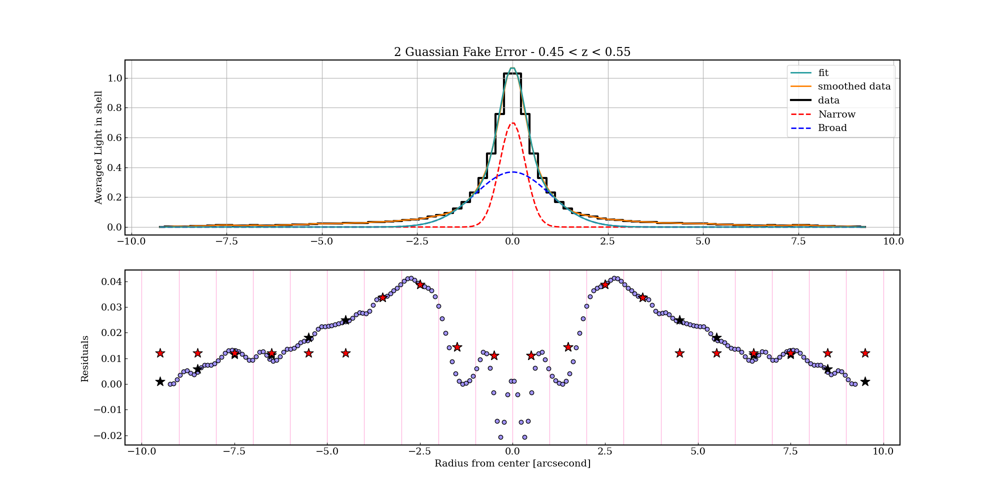

Amplitude Red = 0.7031909280532316 +0.024926826668835167 - 0.15545151285429926

Width Red = 0.3362603791756369 +0.013061070612573222 - 0.07359975349295644

Amplitude Blue = 0.36918830803368013 +0.01068266074080021 - 0.0771942046981694

Width Blue = 0.9708781234575564 +0.02899078179746417 - 0.20500939250832306


In [141]:
# 1. Generate or load data
x_Mirror_045_055 = np.linspace(-84,84,84)

x_data_Mirror_045_055 = np.multiply(x_Mirror_045_055, 0.11)
y_data_Mirror_045_055 = Mirrored_Radius_array_045_055

y_err_Mirror_045_055 = 1.0 #Mirrored_Radius_array_SDE_045_055[0:84]

initial_Mirror_045_055 = np.array([0.6, 0.4, 0.1, 1.1]) #amp,wid ... red/narrow, blue/broad


Amplitude_Narrow_Red_Lower_Lim_Mirror_045_055 = 0
Amplitude_Narrow_Red_Upperr_Lim_Mirror_045_055 = 0.73

Width_Narrow_Red_Lower_Lim_Mirror_045_055 = 0
Width_Narrow_Red_Upper_Lim_Mirror_045_055 = 0.35


Amplitude_Broad_Blue_Lower_Lim_Mirror_045_055 = 0
Amplitude_Broad_Blue_Upperr_Lim_Mirror_045_055 = 0.38

Width_Broad_Blue_Lower_Lim_Mirror_045_055 = 0
Width_Broad_Blue_Upper_Lim_Mirror_045_055 = 1.0




# 2. Define the likelihood function ############################################################################################################################################
def log_likelihood(theta, x, y, yerr):
    amp1, wid1, amp2, wid2 = theta
    model = two_gaussian(x, amp1, wid1, amp2, wid2)
    sigma2 = yerr**2
    return -0.5 * np.sum((y - model)**2 / sigma2 + np.log(sigma2))

# 4. Define the prior (optional, but recommended) ############################################################################################################################################
#def log_prior(theta):
#    amp1, wid1, amp2, wid2 = theta
#    if not all(0 < param < 10 for param in [amp1, amp2, wid1, wid2]):
#        return -np.inf
#    return 0.0

def log_prior(theta):
    amp1, wid1, amp2, wid2 = theta
    if (Amplitude_Narrow_Red_Lower_Lim_Mirror_045_055 < amp1 < Amplitude_Narrow_Red_Upperr_Lim_Mirror_045_055 and Amplitude_Broad_Blue_Lower_Lim_Mirror_045_055 < amp2 <  Amplitude_Broad_Blue_Upperr_Lim_Mirror_045_055 and Width_Narrow_Red_Lower_Lim_Mirror_045_055 < wid1 < Width_Narrow_Red_Upper_Lim_Mirror_045_055 and Width_Broad_Blue_Lower_Lim_Mirror_045_055 < wid2 <  Width_Broad_Blue_Upper_Lim_Mirror_045_055):
        return 0.0
    return -np.inf

# 5. Define the probability function ############################################################################################################################################
def log_probability(theta, x, y, yerr):
    lp = log_prior(theta)
    if not np.isfinite(lp):
        return -np.inf
    return lp + log_likelihood(theta, x, y, yerr)

# 3. Optimization (finding a good starting point) ############################################################################################################################################

bounds_Mirror_045_055 = [(Amplitude_Narrow_Red_Lower_Lim_Mirror_045_055, Amplitude_Narrow_Red_Upperr_Lim_Mirror_045_055), (Width_Narrow_Red_Lower_Lim_Mirror_045_055, Width_Narrow_Red_Upper_Lim_Mirror_045_055), (Amplitude_Broad_Blue_Lower_Lim_Mirror_045_055, Amplitude_Broad_Blue_Upperr_Lim_Mirror_045_055), (Width_Broad_Blue_Lower_Lim_Mirror_045_055, Width_Broad_Blue_Upper_Lim_Mirror_045_055)] # Parameter bounds for optimization
soln_Mirror_045_055 = minimize(lambda *args: -log_likelihood(*args), initial_Mirror_045_055, args=(x_data_Mirror_045_055, y_data_Mirror_045_055, y_err_Mirror_045_055), bounds=bounds_Mirror_045_055)

#soln = minimize(lambda *args: -log_likelihood(*args), initial, args=(x_data, y_data, y_err))
pos_Mirror_045_055 = soln_Mirror_045_055.x + 1e-4 * np.random.randn(32, len(soln_Mirror_045_055.x))
nwalkers_Mirror_045_055, ndim_Mirror_045_055 = pos_Mirror_045_055.shape


# 4. MCMC sampling ############################################################################################################################################
sampler_Mirror_045_055 = emcee.EnsembleSampler(nwalkers_Mirror_045_055, ndim_Mirror_045_055, log_probability, args=(x_data_Mirror_045_055, y_data_Mirror_045_055, y_err_Mirror_045_055))
sampler_Mirror_045_055.run_mcmc(pos_Mirror_045_055, 5000, progress=True)

# 5. Analyze results
samples_Mirror_045_055 = sampler_Mirror_045_055.get_chain(flat=True)

# 6. Best fit parameters ############################################################################################################################################
best_fit_params_Mirror_045_055 = []
for i in range(ndim_Mirror_045_055):
    mcmc_Mirror_045_055 = np.percentile(samples_Mirror_045_055[:, i], [68, 95, 99.7])
    best_fit_params_Mirror_045_055.append(mcmc_Mirror_045_055[1])

# 10. Error estimation ############################################################################################################################################
errors_Mirror_045_055 = []
for i in range(ndim_Mirror_045_055):
     mcmc_Mirror_045_055 = np.percentile(samples_Mirror_045_055[:, i], [68, 95, 99.7])
     errors_Mirror_045_055.append([mcmc_Mirror_045_055[2]-mcmc_Mirror_045_055[1],mcmc_Mirror_045_055[1]-mcmc_Mirror_045_055[0]])
     
# 11. Getting the RMS Values ############################################################################################################################################
x_new_Mirror_045_055 = np.linspace(min(x_data_Mirror_045_055),max(x_data_Mirror_045_055), 200)

y_new_Mirror_045_055 = CubicSpline(x_data_Mirror_045_055, y_data_Mirror_045_055)

yy_new_Mirror_045_055 = y_new_Mirror_045_055(x_new_Mirror_045_055)

x_plot_Mirror_045_055 = np.linspace(min(x_data_Mirror_045_055), max(x_data_Mirror_045_055), 200)


RMS_Bins_Mirrored_045_055 = np.arange(-10, 10, 1) # -10-10 bins of size 2
X_Array_RMS_045_055 = np.arange(-9.5, 10.5, 1) 


RMS_Array_045_055 = []
RMS_Len_Array_045_055 = []
RMS_Len_Array_Old_045_055 = []


for i in RMS_Bins_Mirrored_045_055:
    #print(np.where(np.logical_and(i < x_new_Mirror_045_055, x_new_Mirror_045_055 < i+2)))
    #print(len(x_new_Mirror_045_055[np.where(np.logical_and(i < x_new_Mirror_045_055, x_new_Mirror_045_055 < i+2))]))

    index = np.where(np.logical_and(i < x_new_Mirror_045_055, x_new_Mirror_045_055 < i+1))[0]

    index_2 = np.where(np.logical_and(i < x_data_Mirror_045_055, x_data_Mirror_045_055 < i+1))[0]
    
    values = yy_new_Mirror_045_055 - two_gaussian(x_plot_Mirror_045_055, *best_fit_params_Mirror_045_055)

    indexed_values = values[index]

    RMS = np.sqrt( (1/len(indexed_values)) * (np.sum(indexed_values**2)) )


    RMS_Array_045_055.append(RMS)
    RMS_Len_Array_045_055.append(len(index))
    RMS_Len_Array_Old_045_055.append(len(index_2))

index_1_045_055 = np.where(np.logical_and(X_Array_RMS_045_055 > (40*0.11), X_Array_RMS_045_055 > 0))[0]
index_2_045_055 = np.where(np.logical_and(X_Array_RMS_045_055 < -(40*0.11), X_Array_RMS_045_055 < 0))[0]
index_3_045_055 = np.concatenate((index_2_045_055,index_1_045_055))

Average_RMS_OutBox_045_055 = np.average(np.array(RMS_Array_045_055)[index_1_045_055])

RMS_Array_InBox_045_055 = np.array(RMS_Array_045_055)

RMS_Array_InBox_045_055[index_3_045_055] = Average_RMS_OutBox_045_055
     
# 12. Plot results ############################################################################################################################################
fig = plt.figure(figsize = (20, 10),  facecolor = "white")
ax = plt.subplot(2,1,1)

plt.plot(x_plot_Mirror_045_055, two_gaussian(x_plot_Mirror_045_055, *best_fit_params_Mirror_045_055), color = "#219B9D", linewidth=2.0, label="fit", zorder=10)
plt.plot(x_new_Mirror_045_055, yy_new_Mirror_045_055, color = "#FF8000", linewidth=2.0, label="smoothed data")
plt.step(x_data_Mirror_045_055, y_data_Mirror_045_055, color = "black", linewidth=3.0, where="mid", zorder=0, label="data")

plt.plot(x_plot_Mirror_045_055, gaussian(x_plot_Mirror_045_055, best_fit_params_Mirror_045_055[0], best_fit_params_Mirror_045_055[1]), color="red", linestyle="--", label="Narrow")
plt.plot(x_plot_Mirror_045_055, gaussian(x_plot_Mirror_045_055, best_fit_params_Mirror_045_055[2], best_fit_params_Mirror_045_055[3]), color="blue", linestyle="--", label="Broad")

plt.legend()

ax1 = plt.subplot(2,1,2)

ax1.scatter(x_new_Mirror_045_055, yy_new_Mirror_045_055 - two_gaussian(x_plot_Mirror_045_055, *best_fit_params_Mirror_045_055), c = "#A294F9", edgecolor="black") 

ax1.scatter(X_Array_RMS_045_055, RMS_Array_045_055, c = "black", edgecolor="black", marker="*", s=200, zorder=10)
ax1.scatter(X_Array_RMS_045_055, RMS_Array_InBox_045_055, c = "Red", edgecolor="black", marker="*", s=200, zorder=10)


plt.axvline(x = -10, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -9, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -8, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -7, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -6, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -5, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -4, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -3, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -2, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -1, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 0, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 1, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 2, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 3, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 4, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 5, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 6, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 7, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 8, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 9, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 10, color = "#FF78C4", linewidth=0.5, zorder = 0)

#plt.ylim(-0.001,0.001)

ax.set_title("2 Guassian Fake Error - 0.45 < z < 0.55")

ax1.set_xlabel("Radius from center [arcsecond]")

ax.set_ylabel("Averaged Light in shell")
ax1.set_ylabel("Residuals")

ax.grid()

# Show the plot
plt.show(block=False)

# Close the figure

############################################################################################################################################
Best_Fit_Mirrored_045_055 = yy_new_Mirror_045_055
Best_Fit_Mirrored_Fit_X_Array_045_055 = x_new_Mirror_045_055

Narrow_Amplitude_Fit_Mirrored_045_055 = best_fit_params_Mirror_045_055[0]
Narrow_Amplitude_Fit_Mirrored_Error_P_045_055 = errors_Mirror_045_055[0][0]
Narrow_Amplitude_Fit_Mirrored_Error_M_045_055 = errors_Mirror_045_055[0][1]
Narrow_Width_Fit_Mirrored_045_055 = best_fit_params_Mirror_045_055[1]
Narrow_Width_Fit_Mirrored_Error_P_045_055 = errors_Mirror_045_055[1][0]
Narrow_Width_Fit_Mirrored_Error_M_045_055 = errors_Mirror_045_055[1][1]

Broad_Amplitude_Fit_Mirrored_045_055 = best_fit_params_Mirror_045_055[2]
Broad_Amplitude_Fit_Mirrored_Error_P_045_055 = errors_Mirror_045_055[2][0]
Broad_Amplitude_Fit_Mirrored_Error_M_045_055 = errors_Mirror_045_055[2][1]
Broad_Width_Fit_Mirrored_045_055 = best_fit_params_Mirror_045_055[3]
Broad_Width_Fit_Mirrored_Error_P_045_055 = errors_Mirror_045_055[3][0]
Broad_Width_Fit_Mirrored_Error_M_045_055 = errors_Mirror_045_055[3][1]

Best_Fit_Mirrored_Fit_Residuals_045_055 = yy_new_Mirror_045_055 - two_gaussian(x_plot_Mirror_045_055, *best_fit_params_Mirror_045_055)
Gaussian_Fit_Mirrored_X_Array_045_055 = x_plot_Mirror_045_055

############################################################################################################################################
print("Amplitude Red = " +str(best_fit_params_Mirror_045_055[0]) + " +" +str(errors_Mirror_045_055[0][0]) + " - " +str(errors_Mirror_045_055[0][1]))
print("")
print("Width Red = " +str(best_fit_params_Mirror_045_055[1]) + " +" +str(errors_Mirror_045_055[1][0]) + " - " +str(errors_Mirror_045_055[1][1]))
print("")
print("Amplitude Blue = " +str(best_fit_params_Mirror_045_055[2]) + " +" +str(errors_Mirror_045_055[2][0]) + " - " +str(errors_Mirror_045_055[2][1]))
print("")
print("Width Blue = " +str(best_fit_params_Mirror_045_055[3]) + " +" +str(errors_Mirror_045_055[3][0]) + " - " +str(errors_Mirror_045_055[3][1]))

100%|██████████| 5000/5000 [00:07<00:00, 668.13it/s]


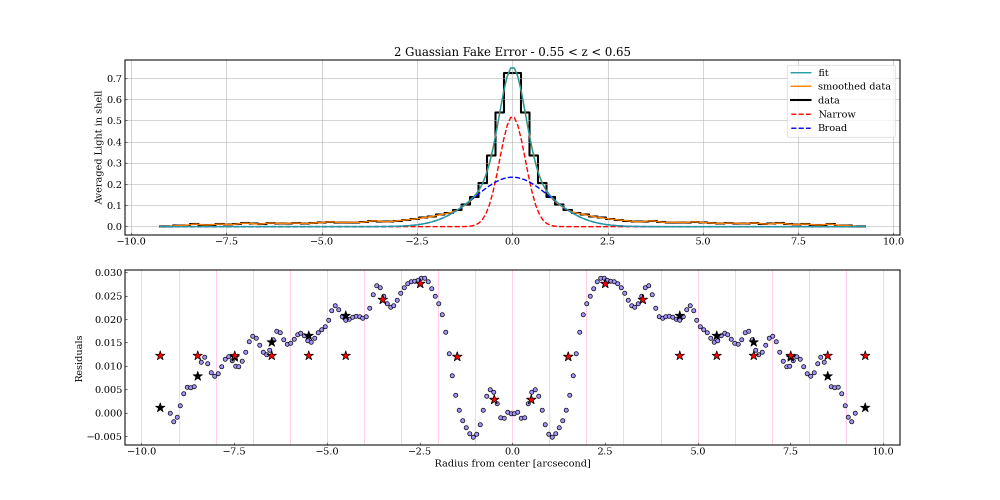

Amplitude Red = 0.5208098363535365 +0.01801607539482175 - 0.11772369633365859

Width Red = 0.33661911043787807 +0.012675517094255295 - 0.08041779783554559

Amplitude Blue = 0.23359785621905474 +0.006037565309123555 - 0.05379757834521376

Width Blue = 0.9781885601992195 +0.02172178093391064 - 0.23296416409441167


In [142]:
# 1. Generate or load data
x_Mirror_055_065 = np.linspace(-84,84,84)

x_data_Mirror_055_065 = np.multiply(x_Mirror_055_065, 0.11)
y_data_Mirror_055_065 = Mirrored_Radius_array_055_065

y_err_Mirror_055_065 = 1.0 #Mirrored_Radius_array_SDE_055_065[0:84]

initial_Mirror_055_065 = np.array([0.6, 0.4, 0.1, 1.1]) #amp,wid ... red/narrow, blue/broad


Amplitude_Narrow_Red_Lower_Lim_Mirror_055_065 = 0
Amplitude_Narrow_Red_Upperr_Lim_Mirror_055_065 = 0.54

Width_Narrow_Red_Lower_Lim_Mirror_055_065 = 0
Width_Narrow_Red_Upper_Lim_Mirror_055_065 = 0.35


Amplitude_Broad_Blue_Lower_Lim_Mirror_055_065 = 0
Amplitude_Broad_Blue_Upperr_Lim_Mirror_055_065 = 0.24

Width_Broad_Blue_Lower_Lim_Mirror_055_065 = 0
Width_Broad_Blue_Upper_Lim_Mirror_055_065 = 1.0




# 2. Define the likelihood function ############################################################################################################################################
def log_likelihood(theta, x, y, yerr):
    amp1, wid1, amp2, wid2 = theta
    model = two_gaussian(x, amp1, wid1, amp2, wid2)
    sigma2 = yerr**2
    return -0.5 * np.sum((y - model)**2 / sigma2 + np.log(sigma2))

# 4. Define the prior (optional, but recommended) ############################################################################################################################################
#def log_prior(theta):
#    amp1, wid1, amp2, wid2 = theta
#    if not all(0 < param < 10 for param in [amp1, amp2, wid1, wid2]):
#        return -np.inf
#    return 0.0

def log_prior(theta):
    amp1, wid1, amp2, wid2 = theta
    if (Amplitude_Narrow_Red_Lower_Lim_Mirror_055_065 < amp1 < Amplitude_Narrow_Red_Upperr_Lim_Mirror_055_065 and Amplitude_Broad_Blue_Lower_Lim_Mirror_055_065 < amp2 <  Amplitude_Broad_Blue_Upperr_Lim_Mirror_055_065 and Width_Narrow_Red_Lower_Lim_Mirror_055_065 < wid1 < Width_Narrow_Red_Upper_Lim_Mirror_055_065 and Width_Broad_Blue_Lower_Lim_Mirror_055_065 < wid2 <  Width_Broad_Blue_Upper_Lim_Mirror_055_065):
        return 0.0
    return -np.inf

# 5. Define the probability function ############################################################################################################################################
def log_probability(theta, x, y, yerr):
    lp = log_prior(theta)
    if not np.isfinite(lp):
        return -np.inf
    return lp + log_likelihood(theta, x, y, yerr)

# 3. Optimization (finding a good starting point) ############################################################################################################################################

bounds_Mirror_055_065 = [(Amplitude_Narrow_Red_Lower_Lim_Mirror_055_065, Amplitude_Narrow_Red_Upperr_Lim_Mirror_055_065), (Width_Narrow_Red_Lower_Lim_Mirror_055_065, Width_Narrow_Red_Upper_Lim_Mirror_055_065), (Amplitude_Broad_Blue_Lower_Lim_Mirror_055_065, Amplitude_Broad_Blue_Upperr_Lim_Mirror_055_065), (Width_Broad_Blue_Lower_Lim_Mirror_055_065, Width_Broad_Blue_Upper_Lim_Mirror_055_065)] # Parameter bounds for optimization
soln_Mirror_055_065 = minimize(lambda *args: -log_likelihood(*args), initial_Mirror_055_065, args=(x_data_Mirror_055_065, y_data_Mirror_055_065, y_err_Mirror_055_065), bounds=bounds_Mirror_055_065)

#soln = minimize(lambda *args: -log_likelihood(*args), initial, args=(x_data, y_data, y_err))
pos_Mirror_055_065 = soln_Mirror_055_065.x + 1e-4 * np.random.randn(32, len(soln_Mirror_055_065.x))
nwalkers_Mirror_055_065, ndim_Mirror_055_065 = pos_Mirror_055_065.shape


# 4. MCMC sampling ############################################################################################################################################
sampler_Mirror_055_065 = emcee.EnsembleSampler(nwalkers_Mirror_055_065, ndim_Mirror_055_065, log_probability, args=(x_data_Mirror_055_065, y_data_Mirror_055_065, y_err_Mirror_055_065))
sampler_Mirror_055_065.run_mcmc(pos_Mirror_055_065, 5000, progress=True)

# 5. Analyze results
samples_Mirror_055_065 = sampler_Mirror_055_065.get_chain(flat=True)

# 6. Best fit parameters ############################################################################################################################################
best_fit_params_Mirror_055_065 = []
for i in range(ndim_Mirror_055_065):
    mcmc_Mirror_055_065 = np.percentile(samples_Mirror_055_065[:, i], [68, 95, 99.7])
    best_fit_params_Mirror_055_065.append(mcmc_Mirror_055_065[1])

# 10. Error estimation ############################################################################################################################################
errors_Mirror_055_065 = []
for i in range(ndim_Mirror_055_065):
     mcmc_Mirror_055_065 = np.percentile(samples_Mirror_055_065[:, i], [68, 95, 99.7])
     errors_Mirror_055_065.append([mcmc_Mirror_055_065[2]-mcmc_Mirror_055_065[1],mcmc_Mirror_055_065[1]-mcmc_Mirror_055_065[0]])
     
# 11. Getting the RMS Values ############################################################################################################################################
x_new_Mirror_055_065 = np.linspace(min(x_data_Mirror_055_065),max(x_data_Mirror_055_065), 200)

y_new_Mirror_055_065 = CubicSpline(x_data_Mirror_055_065, y_data_Mirror_055_065)

yy_new_Mirror_055_065 = y_new_Mirror_055_065(x_new_Mirror_055_065)

x_plot_Mirror_055_065 = np.linspace(min(x_data_Mirror_055_065), max(x_data_Mirror_055_065), 200)


RMS_Bins_Mirrored_055_065 = np.arange(-10, 10, 1) # -10-10 bins of size 2
X_Array_RMS_055_065 = np.arange(-9.5, 10.5, 1) 


RMS_Array_055_065 = []
RMS_Len_Array_055_065 = []
RMS_Len_Array_Old_055_065 = []


for i in RMS_Bins_Mirrored_055_065:
    #print(np.where(np.logical_and(i < x_new_Mirror_055_065, x_new_Mirror_055_065 < i+2)))
    #print(len(x_new_Mirror_055_065[np.where(np.logical_and(i < x_new_Mirror_055_065, x_new_Mirror_055_065 < i+2))]))

    index = np.where(np.logical_and(i < x_new_Mirror_055_065, x_new_Mirror_055_065 < i+1))[0]

    index_2 = np.where(np.logical_and(i < x_data_Mirror_055_065, x_data_Mirror_055_065 < i+1))[0]
    
    values = yy_new_Mirror_055_065 - two_gaussian(x_plot_Mirror_055_065, *best_fit_params_Mirror_055_065)

    indexed_values = values[index]

    RMS = np.sqrt( (1/len(indexed_values)) * (np.sum(indexed_values**2)) )


    RMS_Array_055_065.append(RMS)
    RMS_Len_Array_055_065.append(len(index))
    RMS_Len_Array_Old_055_065.append(len(index_2))

index_1_055_065 = np.where(np.logical_and(X_Array_RMS_055_065 > (40*0.11), X_Array_RMS_055_065 > 0))[0]
index_2_055_065 = np.where(np.logical_and(X_Array_RMS_055_065 < -(40*0.11), X_Array_RMS_055_065 < 0))[0]
index_3_055_065 = np.concatenate((index_2_055_065,index_1_055_065))

Average_RMS_OutBox_055_065 = np.average(np.array(RMS_Array_055_065)[index_1_055_065])

RMS_Array_InBox_055_065 = np.array(RMS_Array_055_065)

RMS_Array_InBox_055_065[index_3_055_065] = Average_RMS_OutBox_055_065
     
# 12. Plot results ############################################################################################################################################
fig = plt.figure(figsize = (20, 10),  facecolor = "white")
ax = plt.subplot(2,1,1)

plt.plot(x_plot_Mirror_055_065, two_gaussian(x_plot_Mirror_055_065, *best_fit_params_Mirror_055_065), color = "#219B9D", linewidth=2.0, label="fit", zorder=10)
plt.plot(x_new_Mirror_055_065, yy_new_Mirror_055_065, color = "#FF8000", linewidth=2.0, label="smoothed data")
plt.step(x_data_Mirror_055_065, y_data_Mirror_055_065, color = "black", linewidth=3.0, where="mid", zorder=0, label="data")

plt.plot(x_plot_Mirror_055_065, gaussian(x_plot_Mirror_055_065, best_fit_params_Mirror_055_065[0], best_fit_params_Mirror_055_065[1]), color="red", linestyle="--", label="Narrow")
plt.plot(x_plot_Mirror_055_065, gaussian(x_plot_Mirror_055_065, best_fit_params_Mirror_055_065[2], best_fit_params_Mirror_055_065[3]), color="blue", linestyle="--", label="Broad")

plt.legend()

ax1 = plt.subplot(2,1,2)

ax1.scatter(x_new_Mirror_055_065, yy_new_Mirror_055_065 - two_gaussian(x_plot_Mirror_055_065, *best_fit_params_Mirror_055_065), c = "#A294F9", edgecolor="black") 

ax1.scatter(X_Array_RMS_055_065, RMS_Array_055_065, c = "black", edgecolor="black", marker="*", s=200, zorder=10)
ax1.scatter(X_Array_RMS_055_065, RMS_Array_InBox_055_065, c = "Red", edgecolor="black", marker="*", s=200, zorder=10)


plt.axvline(x = -10, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -9, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -8, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -7, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -6, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -5, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -4, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -3, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -2, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -1, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 0, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 1, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 2, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 3, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 4, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 5, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 6, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 7, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 8, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 9, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 10, color = "#FF78C4", linewidth=0.5, zorder = 0)

#plt.ylim(-0.001,0.001)

ax.set_title("2 Guassian Fake Error - 0.55 < z < 0.65")

ax1.set_xlabel("Radius from center [arcsecond]")

ax.set_ylabel("Averaged Light in shell")
ax1.set_ylabel("Residuals")

ax.grid()

# Show the plot
plt.show(block=False)

# Close the figure

############################################################################################################################################
Best_Fit_Mirrored_055_065 = yy_new_Mirror_055_065
Best_Fit_Mirrored_Fit_X_Array_055_065 = x_new_Mirror_055_065

Narrow_Amplitude_Fit_Mirrored_055_065 = best_fit_params_Mirror_055_065[0]
Narrow_Amplitude_Fit_Mirrored_Error_P_055_065 = errors_Mirror_055_065[0][0]
Narrow_Amplitude_Fit_Mirrored_Error_M_055_065 = errors_Mirror_055_065[0][1]
Narrow_Width_Fit_Mirrored_055_065 = best_fit_params_Mirror_055_065[1]
Narrow_Width_Fit_Mirrored_Error_P_055_065 = errors_Mirror_055_065[1][0]
Narrow_Width_Fit_Mirrored_Error_M_055_065 = errors_Mirror_055_065[1][1]

Broad_Amplitude_Fit_Mirrored_055_065 = best_fit_params_Mirror_055_065[2]
Broad_Amplitude_Fit_Mirrored_Error_P_055_065 = errors_Mirror_055_065[2][0]
Broad_Amplitude_Fit_Mirrored_Error_M_055_065 = errors_Mirror_055_065[2][1]
Broad_Width_Fit_Mirrored_055_065 = best_fit_params_Mirror_055_065[3]
Broad_Width_Fit_Mirrored_Error_P_055_065 = errors_Mirror_055_065[3][0]
Broad_Width_Fit_Mirrored_Error_M_055_065 = errors_Mirror_055_065[3][1]

Best_Fit_Mirrored_Fit_Residuals_055_065 = yy_new_Mirror_055_065 - two_gaussian(x_plot_Mirror_055_065, *best_fit_params_Mirror_055_065)
Gaussian_Fit_Mirrored_X_Array_055_065 = x_plot_Mirror_055_065

############################################################################################################################################
print("Amplitude Red = " +str(best_fit_params_Mirror_055_065[0]) + " +" +str(errors_Mirror_055_065[0][0]) + " - " +str(errors_Mirror_055_065[0][1]))
print("")
print("Width Red = " +str(best_fit_params_Mirror_055_065[1]) + " +" +str(errors_Mirror_055_065[1][0]) + " - " +str(errors_Mirror_055_065[1][1]))
print("")
print("Amplitude Blue = " +str(best_fit_params_Mirror_055_065[2]) + " +" +str(errors_Mirror_055_065[2][0]) + " - " +str(errors_Mirror_055_065[2][1]))
print("")
print("Width Blue = " +str(best_fit_params_Mirror_055_065[3]) + " +" +str(errors_Mirror_055_065[3][0]) + " - " +str(errors_Mirror_055_065[3][1]))


100%|██████████| 5000/5000 [00:08<00:00, 623.41it/s]


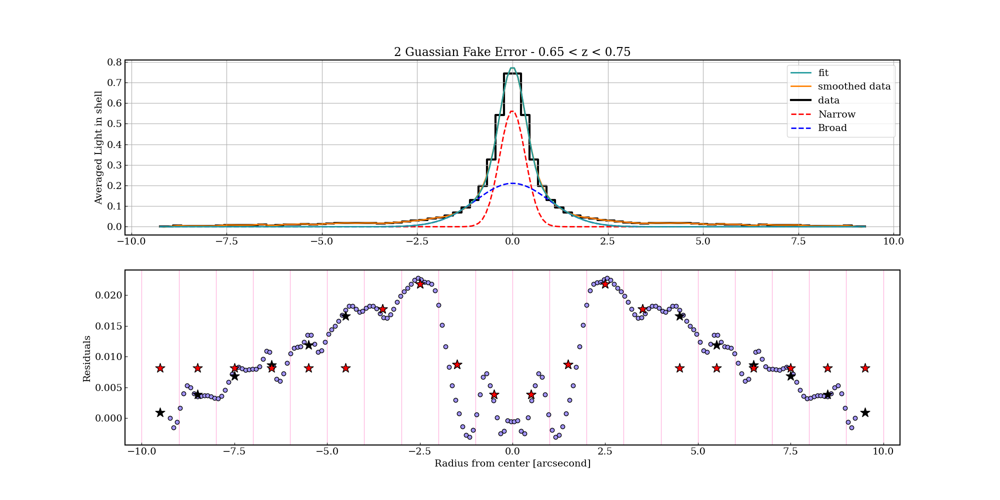

Amplitude Red = 0.5655731347406353 +0.022878534447116072 - 0.14491929741198661

Width Red = 0.3364273513137322 +0.012645724885085308 - 0.08213768366166962

Amplitude Blue = 0.21068115457695488 +0.008632180470497797 - 0.055764614686560215

Width Blue = 0.9675093045155526 +0.03242844300402703 - 0.23658550766645048


In [143]:
# 1. Generate or load data
x_Mirror_065_075 = np.linspace(-84,84,84)

x_data_Mirror_065_075 = np.multiply(x_Mirror_065_075, 0.11)
y_data_Mirror_065_075 = Mirrored_Radius_array_065_075

y_err_Mirror_065_075 = 1.0 #Mirrored_Radius_array_SDE_065_075[0:84]

initial_Mirror_065_075 = np.array([0.6, 0.4, 0.1, 1.1]) #amp,wid ... red/narrow, blue/broad


Amplitude_Narrow_Red_Lower_Lim_Mirror_065_075 = 0
Amplitude_Narrow_Red_Upperr_Lim_Mirror_065_075 = 0.59

Width_Narrow_Red_Lower_Lim_Mirror_065_075 = 0
Width_Narrow_Red_Upper_Lim_Mirror_065_075 = 0.35


Amplitude_Broad_Blue_Lower_Lim_Mirror_065_075 = 0
Amplitude_Broad_Blue_Upperr_Lim_Mirror_065_075 = 0.22

Width_Broad_Blue_Lower_Lim_Mirror_065_075 = 0
Width_Broad_Blue_Upper_Lim_Mirror_065_075 = 1.0




# 2. Define the likelihood function ############################################################################################################################################
def log_likelihood(theta, x, y, yerr):
    amp1, wid1, amp2, wid2 = theta
    model = two_gaussian(x, amp1, wid1, amp2, wid2)
    sigma2 = yerr**2
    return -0.5 * np.sum((y - model)**2 / sigma2 + np.log(sigma2))

# 4. Define the prior (optional, but recommended) ############################################################################################################################################
#def log_prior(theta):
#    amp1, wid1, amp2, wid2 = theta
#    if not all(0 < param < 10 for param in [amp1, amp2, wid1, wid2]):
#        return -np.inf
#    return 0.0

def log_prior(theta):
    amp1, wid1, amp2, wid2 = theta
    if (Amplitude_Narrow_Red_Lower_Lim_Mirror_065_075 < amp1 < Amplitude_Narrow_Red_Upperr_Lim_Mirror_065_075 and Amplitude_Broad_Blue_Lower_Lim_Mirror_065_075 < amp2 <  Amplitude_Broad_Blue_Upperr_Lim_Mirror_065_075 and Width_Narrow_Red_Lower_Lim_Mirror_065_075 < wid1 < Width_Narrow_Red_Upper_Lim_Mirror_065_075 and Width_Broad_Blue_Lower_Lim_Mirror_065_075 < wid2 <  Width_Broad_Blue_Upper_Lim_Mirror_065_075):
        return 0.0
    return -np.inf

# 5. Define the probability function ############################################################################################################################################
def log_probability(theta, x, y, yerr):
    lp = log_prior(theta)
    if not np.isfinite(lp):
        return -np.inf
    return lp + log_likelihood(theta, x, y, yerr)

# 3. Optimization (finding a good starting point) ############################################################################################################################################

bounds_Mirror_065_075 = [(Amplitude_Narrow_Red_Lower_Lim_Mirror_065_075, Amplitude_Narrow_Red_Upperr_Lim_Mirror_065_075), (Width_Narrow_Red_Lower_Lim_Mirror_065_075, Width_Narrow_Red_Upper_Lim_Mirror_065_075), (Amplitude_Broad_Blue_Lower_Lim_Mirror_065_075, Amplitude_Broad_Blue_Upperr_Lim_Mirror_065_075), (Width_Broad_Blue_Lower_Lim_Mirror_065_075, Width_Broad_Blue_Upper_Lim_Mirror_065_075)] # Parameter bounds for optimization
soln_Mirror_065_075 = minimize(lambda *args: -log_likelihood(*args), initial_Mirror_065_075, args=(x_data_Mirror_065_075, y_data_Mirror_065_075, y_err_Mirror_065_075), bounds=bounds_Mirror_065_075)

#soln = minimize(lambda *args: -log_likelihood(*args), initial, args=(x_data, y_data, y_err))
pos_Mirror_065_075 = soln_Mirror_065_075.x + 1e-4 * np.random.randn(32, len(soln_Mirror_065_075.x))
nwalkers_Mirror_065_075, ndim_Mirror_065_075 = pos_Mirror_065_075.shape


# 4. MCMC sampling ############################################################################################################################################
sampler_Mirror_065_075 = emcee.EnsembleSampler(nwalkers_Mirror_065_075, ndim_Mirror_065_075, log_probability, args=(x_data_Mirror_065_075, y_data_Mirror_065_075, y_err_Mirror_065_075))
sampler_Mirror_065_075.run_mcmc(pos_Mirror_065_075, 5000, progress=True)

# 5. Analyze results
samples_Mirror_065_075 = sampler_Mirror_065_075.get_chain(flat=True)

# 6. Best fit parameters ############################################################################################################################################
best_fit_params_Mirror_065_075 = []
for i in range(ndim_Mirror_065_075):
    mcmc_Mirror_065_075 = np.percentile(samples_Mirror_065_075[:, i], [68, 95, 99.7])
    best_fit_params_Mirror_065_075.append(mcmc_Mirror_065_075[1])

# 10. Error estimation ############################################################################################################################################
errors_Mirror_065_075 = []
for i in range(ndim_Mirror_065_075):
     mcmc_Mirror_065_075 = np.percentile(samples_Mirror_065_075[:, i], [68, 95, 99.7])
     errors_Mirror_065_075.append([mcmc_Mirror_065_075[2]-mcmc_Mirror_065_075[1],mcmc_Mirror_065_075[1]-mcmc_Mirror_065_075[0]])
     
# 11. Getting the RMS Values ############################################################################################################################################
x_new_Mirror_065_075 = np.linspace(min(x_data_Mirror_065_075),max(x_data_Mirror_065_075), 200)

y_new_Mirror_065_075 = CubicSpline(x_data_Mirror_065_075, y_data_Mirror_065_075)

yy_new_Mirror_065_075 = y_new_Mirror_065_075(x_new_Mirror_065_075)

x_plot_Mirror_065_075 = np.linspace(min(x_data_Mirror_065_075), max(x_data_Mirror_065_075), 200)


RMS_Bins_Mirrored_065_075 = np.arange(-10, 10, 1) # -10-10 bins of size 2
X_Array_RMS_065_075 = np.arange(-9.5, 10.5, 1) 


RMS_Array_065_075 = []
RMS_Len_Array_065_075 = []
RMS_Len_Array_Old_065_075 = []


for i in RMS_Bins_Mirrored_065_075:
    #print(np.where(np.logical_and(i < x_new_Mirror_065_075, x_new_Mirror_065_075 < i+2)))
    #print(len(x_new_Mirror_065_075[np.where(np.logical_and(i < x_new_Mirror_065_075, x_new_Mirror_065_075 < i+2))]))

    index = np.where(np.logical_and(i < x_new_Mirror_065_075, x_new_Mirror_065_075 < i+1))[0]

    index_2 = np.where(np.logical_and(i < x_data_Mirror_065_075, x_data_Mirror_065_075 < i+1))[0]
    
    values = yy_new_Mirror_065_075 - two_gaussian(x_plot_Mirror_065_075, *best_fit_params_Mirror_065_075)

    indexed_values = values[index]

    RMS = np.sqrt( (1/len(indexed_values)) * (np.sum(indexed_values**2)) )


    RMS_Array_065_075.append(RMS)
    RMS_Len_Array_065_075.append(len(index))
    RMS_Len_Array_Old_065_075.append(len(index_2))

index_1_065_075 = np.where(np.logical_and(X_Array_RMS_065_075 > (40*0.11), X_Array_RMS_065_075 > 0))[0]
index_2_065_075 = np.where(np.logical_and(X_Array_RMS_065_075 < -(40*0.11), X_Array_RMS_065_075 < 0))[0]
index_3_065_075 = np.concatenate((index_2_065_075,index_1_065_075))

Average_RMS_OutBox_065_075 = np.average(np.array(RMS_Array_065_075)[index_1_065_075])

RMS_Array_InBox_065_075 = np.array(RMS_Array_065_075)

RMS_Array_InBox_065_075[index_3_065_075] = Average_RMS_OutBox_065_075
     
# 12. Plot results ############################################################################################################################################
fig = plt.figure(figsize = (20, 10),  facecolor = "white")
ax = plt.subplot(2,1,1)

plt.plot(x_plot_Mirror_065_075, two_gaussian(x_plot_Mirror_065_075, *best_fit_params_Mirror_065_075), color = "#219B9D", linewidth=2.0, label="fit", zorder=10)
plt.plot(x_new_Mirror_065_075, yy_new_Mirror_065_075, color = "#FF8000", linewidth=2.0, label="smoothed data")
plt.step(x_data_Mirror_065_075, y_data_Mirror_065_075, color = "black", linewidth=3.0, where="mid", zorder=0, label="data")

plt.plot(x_plot_Mirror_065_075, gaussian(x_plot_Mirror_065_075, best_fit_params_Mirror_065_075[0], best_fit_params_Mirror_065_075[1]), color="red", linestyle="--", label="Narrow")
plt.plot(x_plot_Mirror_065_075, gaussian(x_plot_Mirror_065_075, best_fit_params_Mirror_065_075[2], best_fit_params_Mirror_065_075[3]), color="blue", linestyle="--", label="Broad")

plt.legend()

ax1 = plt.subplot(2,1,2)

ax1.scatter(x_new_Mirror_065_075, yy_new_Mirror_065_075 - two_gaussian(x_plot_Mirror_065_075, *best_fit_params_Mirror_065_075), c = "#A294F9", edgecolor="black") 

ax1.scatter(X_Array_RMS_065_075, RMS_Array_065_075, c = "black", edgecolor="black", marker="*", s=200, zorder=10)
ax1.scatter(X_Array_RMS_065_075, RMS_Array_InBox_065_075, c = "Red", edgecolor="black", marker="*", s=200, zorder=10)


plt.axvline(x = -10, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -9, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -8, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -7, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -6, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -5, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -4, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -3, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -2, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -1, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 0, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 1, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 2, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 3, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 4, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 5, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 6, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 7, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 8, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 9, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 10, color = "#FF78C4", linewidth=0.5, zorder = 0)

#plt.ylim(-0.001,0.001)

ax.set_title("2 Guassian Fake Error - 0.65 < z < 0.75")

ax1.set_xlabel("Radius from center [arcsecond]")

ax.set_ylabel("Averaged Light in shell")
ax1.set_ylabel("Residuals")

ax.grid()
# Show the plot
plt.show(block=False)

# Close the figure

############################################################################################################################################
Best_Fit_Mirrored_065_075 = yy_new_Mirror_065_075
Best_Fit_Mirrored_Fit_X_Array_065_075 = x_new_Mirror_065_075

Narrow_Amplitude_Fit_Mirrored_065_075 = best_fit_params_Mirror_065_075[0]
Narrow_Amplitude_Fit_Mirrored_Error_P_065_075 = errors_Mirror_065_075[0][0]
Narrow_Amplitude_Fit_Mirrored_Error_M_065_075 = errors_Mirror_065_075[0][1]
Narrow_Width_Fit_Mirrored_065_075 = best_fit_params_Mirror_065_075[1]
Narrow_Width_Fit_Mirrored_Error_P_065_075 = errors_Mirror_065_075[1][0]
Narrow_Width_Fit_Mirrored_Error_M_065_075 = errors_Mirror_065_075[1][1]

Broad_Amplitude_Fit_Mirrored_065_075 = best_fit_params_Mirror_065_075[2]
Broad_Amplitude_Fit_Mirrored_Error_P_065_075 = errors_Mirror_065_075[2][0]
Broad_Amplitude_Fit_Mirrored_Error_M_065_075 = errors_Mirror_065_075[2][1]
Broad_Width_Fit_Mirrored_065_075 = best_fit_params_Mirror_065_075[3]
Broad_Width_Fit_Mirrored_Error_P_065_075 = errors_Mirror_065_075[3][0]
Broad_Width_Fit_Mirrored_Error_M_065_075 = errors_Mirror_065_075[3][1]

Best_Fit_Mirrored_Fit_Residuals_065_075 = yy_new_Mirror_065_075 - two_gaussian(x_plot_Mirror_065_075, *best_fit_params_Mirror_065_075)
Gaussian_Fit_Mirrored_X_Array_065_075 = x_plot_Mirror_065_075

############################################################################################################################################
print("Amplitude Red = " +str(best_fit_params_Mirror_065_075[0]) + " +" +str(errors_Mirror_065_075[0][0]) + " - " +str(errors_Mirror_065_075[0][1]))
print("")
print("Width Red = " +str(best_fit_params_Mirror_065_075[1]) + " +" +str(errors_Mirror_065_075[1][0]) + " - " +str(errors_Mirror_065_075[1][1]))
print("")
print("Amplitude Blue = " +str(best_fit_params_Mirror_065_075[2]) + " +" +str(errors_Mirror_065_075[2][0]) + " - " +str(errors_Mirror_065_075[2][1]))
print("")
print("Width Blue = " +str(best_fit_params_Mirror_065_075[3]) + " +" +str(errors_Mirror_065_075[3][0]) + " - " +str(errors_Mirror_065_075[3][1]))


100%|██████████| 5000/5000 [00:07<00:00, 673.95it/s]


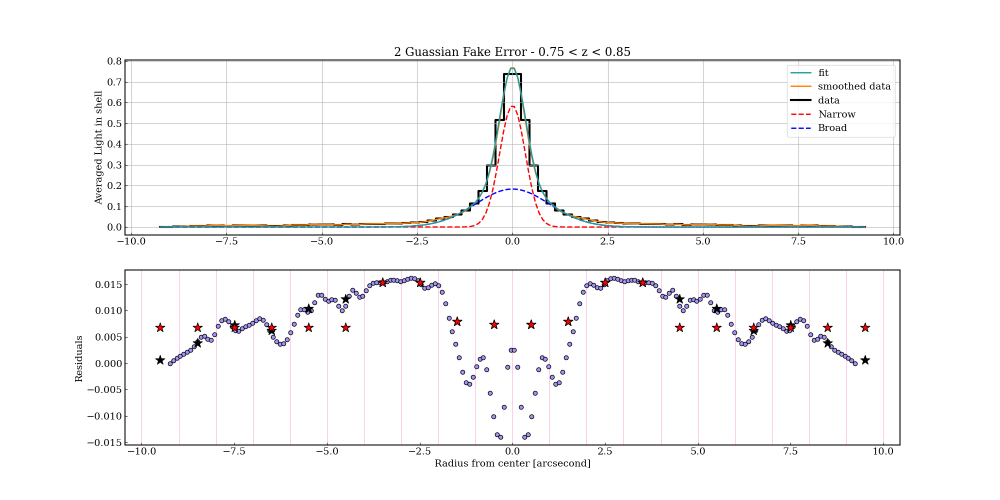

Amplitude Red = 0.5874091410737089 +0.02144188006417569 - 0.13658430686294004

Width Red = 0.33603359735075905 +0.013118944619162576 - 0.08210998575512457

Amplitude Blue = 0.18342285727036928 +0.006155127862396359 - 0.04466812799630765

Width Blue = 0.968574723206592 +0.03132160085291913 - 0.2522336930233353


In [144]:
# 1. Generate or load data
x_Mirror_075_085 = np.linspace(-84,84,84)

x_data_Mirror_075_085 = np.multiply(x_Mirror_075_085, 0.11)
y_data_Mirror_075_085 = Mirrored_Radius_array_075_085

y_err_Mirror_075_085 = 1.0 #Mirrored_Radius_array_SDE_075_085[0:84]

initial_Mirror_075_085 = np.array([0.6, 0.4, 0.1, 1.1673286672194352]) #amp,wid ... red/narrow, blue/broad


Amplitude_Narrow_Red_Lower_Lim_Mirror_075_085 = 0
Amplitude_Narrow_Red_Upperr_Lim_Mirror_075_085 = 0.61

Width_Narrow_Red_Lower_Lim_Mirror_075_085 = 0
Width_Narrow_Red_Upper_Lim_Mirror_075_085 = 0.35


Amplitude_Broad_Blue_Lower_Lim_Mirror_075_085 = 0
Amplitude_Broad_Blue_Upperr_Lim_Mirror_075_085 = 0.19

Width_Broad_Blue_Lower_Lim_Mirror_075_085 = 0
Width_Broad_Blue_Upper_Lim_Mirror_075_085 = 1.0




# 2. Define the likelihood function ############################################################################################################################################
def log_likelihood(theta, x, y, yerr):
    amp1, wid1, amp2, wid2 = theta
    model = two_gaussian(x, amp1, wid1, amp2, wid2)
    sigma2 = yerr**2
    return -0.5 * np.sum((y - model)**2 / sigma2 + np.log(sigma2))

# 4. Define the prior (optional, but recommended) ############################################################################################################################################
#def log_prior(theta):
#    amp1, wid1, amp2, wid2 = theta
#    if not all(0 < param < 10 for param in [amp1, amp2, wid1, wid2]):
#        return -np.inf
#    return 0.0

def log_prior(theta):
    amp1, wid1, amp2, wid2 = theta
    if (Amplitude_Narrow_Red_Lower_Lim_Mirror_075_085 < amp1 < Amplitude_Narrow_Red_Upperr_Lim_Mirror_075_085 and Amplitude_Broad_Blue_Lower_Lim_Mirror_075_085 < amp2 <  Amplitude_Broad_Blue_Upperr_Lim_Mirror_075_085 and Width_Narrow_Red_Lower_Lim_Mirror_075_085 < wid1 < Width_Narrow_Red_Upper_Lim_Mirror_075_085 and Width_Broad_Blue_Lower_Lim_Mirror_075_085 < wid2 <  Width_Broad_Blue_Upper_Lim_Mirror_075_085):
        return 0.0
    return -np.inf

# 5. Define the probability function ############################################################################################################################################
def log_probability(theta, x, y, yerr):
    lp = log_prior(theta)
    if not np.isfinite(lp):
        return -np.inf
    return lp + log_likelihood(theta, x, y, yerr)

# 3. Optimization (finding a good starting point) ############################################################################################################################################

bounds_Mirror_075_085 = [(Amplitude_Narrow_Red_Lower_Lim_Mirror_075_085, Amplitude_Narrow_Red_Upperr_Lim_Mirror_075_085), (Width_Narrow_Red_Lower_Lim_Mirror_075_085, Width_Narrow_Red_Upper_Lim_Mirror_075_085), (Amplitude_Broad_Blue_Lower_Lim_Mirror_075_085, Amplitude_Broad_Blue_Upperr_Lim_Mirror_075_085), (Width_Broad_Blue_Lower_Lim_Mirror_075_085, Width_Broad_Blue_Upper_Lim_Mirror_075_085)] # Parameter bounds for optimization
soln_Mirror_075_085 = minimize(lambda *args: -log_likelihood(*args), initial_Mirror_075_085, args=(x_data_Mirror_075_085, y_data_Mirror_075_085, y_err_Mirror_075_085), bounds=bounds_Mirror_075_085)

#soln = minimize(lambda *args: -log_likelihood(*args), initial, args=(x_data, y_data, y_err))
pos_Mirror_075_085 = soln_Mirror_075_085.x + 1e-4 * np.random.randn(32, len(soln_Mirror_075_085.x))
nwalkers_Mirror_075_085, ndim_Mirror_075_085 = pos_Mirror_075_085.shape


# 4. MCMC sampling ############################################################################################################################################
sampler_Mirror_075_085 = emcee.EnsembleSampler(nwalkers_Mirror_075_085, ndim_Mirror_075_085, log_probability, args=(x_data_Mirror_075_085, y_data_Mirror_075_085, y_err_Mirror_075_085))
sampler_Mirror_075_085.run_mcmc(pos_Mirror_075_085, 5000, progress=True)

# 5. Analyze results
samples_Mirror_075_085 = sampler_Mirror_075_085.get_chain(flat=True)

# 6. Best fit parameters ############################################################################################################################################
best_fit_params_Mirror_075_085 = []
for i in range(ndim_Mirror_075_085):
    mcmc_Mirror_075_085 = np.percentile(samples_Mirror_075_085[:, i], [68, 95, 99.7])
    best_fit_params_Mirror_075_085.append(mcmc_Mirror_075_085[1])

# 10. Error estimation ############################################################################################################################################
errors_Mirror_075_085 = []
for i in range(ndim_Mirror_075_085):
     mcmc_Mirror_075_085 = np.percentile(samples_Mirror_075_085[:, i], [68, 95, 99.7])
     errors_Mirror_075_085.append([mcmc_Mirror_075_085[2]-mcmc_Mirror_075_085[1],mcmc_Mirror_075_085[1]-mcmc_Mirror_075_085[0]])
     
# 11. Getting the RMS Values ############################################################################################################################################
x_new_Mirror_075_085 = np.linspace(min(x_data_Mirror_075_085),max(x_data_Mirror_075_085), 200)

y_new_Mirror_075_085 = CubicSpline(x_data_Mirror_075_085, y_data_Mirror_075_085)

yy_new_Mirror_075_085 = y_new_Mirror_075_085(x_new_Mirror_075_085)

x_plot_Mirror_075_085 = np.linspace(min(x_data_Mirror_075_085), max(x_data_Mirror_075_085), 200)


RMS_Bins_Mirrored_075_085 = np.arange(-10, 10, 1) # -10-10 bins of size 2
X_Array_RMS_075_085 = np.arange(-9.5, 10.5, 1) 


RMS_Array_075_085 = []
RMS_Len_Array_075_085 = []
RMS_Len_Array_Old_075_085 = []


for i in RMS_Bins_Mirrored_075_085:
    #print(np.where(np.logical_and(i < x_new_Mirror_075_085, x_new_Mirror_075_085 < i+2)))
    #print(len(x_new_Mirror_075_085[np.where(np.logical_and(i < x_new_Mirror_075_085, x_new_Mirror_075_085 < i+2))]))

    index = np.where(np.logical_and(i < x_new_Mirror_075_085, x_new_Mirror_075_085 < i+1))[0]

    index_2 = np.where(np.logical_and(i < x_data_Mirror_075_085, x_data_Mirror_075_085 < i+1))[0]
    
    values = yy_new_Mirror_075_085 - two_gaussian(x_plot_Mirror_075_085, *best_fit_params_Mirror_075_085)

    indexed_values = values[index]

    RMS = np.sqrt( (1/len(indexed_values)) * (np.sum(indexed_values**2)) )


    RMS_Array_075_085.append(RMS)
    RMS_Len_Array_075_085.append(len(index))
    RMS_Len_Array_Old_075_085.append(len(index_2))

index_1_075_085 = np.where(np.logical_and(X_Array_RMS_075_085 > (40*0.11), X_Array_RMS_075_085 > 0))[0]
index_2_075_085 = np.where(np.logical_and(X_Array_RMS_075_085 < -(40*0.11), X_Array_RMS_075_085 < 0))[0]
index_3_075_085 = np.concatenate((index_2_075_085,index_1_075_085))

Average_RMS_OutBox_075_085 = np.average(np.array(RMS_Array_075_085)[index_1_075_085])

RMS_Array_InBox_075_085 = np.array(RMS_Array_075_085)

RMS_Array_InBox_075_085[index_3_075_085] = Average_RMS_OutBox_075_085
     
# 12. Plot results ############################################################################################################################################
fig = plt.figure(figsize = (20, 10),  facecolor = "white")
ax = plt.subplot(2,1,1)

plt.plot(x_plot_Mirror_075_085, two_gaussian(x_plot_Mirror_075_085, *best_fit_params_Mirror_075_085), color = "#219B9D", linewidth=2.0, label="fit", zorder=10)
plt.plot(x_new_Mirror_075_085, yy_new_Mirror_075_085, color = "#FF8000", linewidth=2.0, label="smoothed data")
plt.step(x_data_Mirror_075_085, y_data_Mirror_075_085, color = "black", linewidth=3.0, where="mid", zorder=0, label="data")

plt.plot(x_plot_Mirror_075_085, gaussian(x_plot_Mirror_075_085, best_fit_params_Mirror_075_085[0], best_fit_params_Mirror_075_085[1]), color="red", linestyle="--", label="Narrow")
plt.plot(x_plot_Mirror_075_085, gaussian(x_plot_Mirror_075_085, best_fit_params_Mirror_075_085[2], best_fit_params_Mirror_075_085[3]), color="blue", linestyle="--", label="Broad")

plt.legend()

ax1 = plt.subplot(2,1,2)

ax1.scatter(x_new_Mirror_075_085, yy_new_Mirror_075_085 - two_gaussian(x_plot_Mirror_075_085, *best_fit_params_Mirror_075_085), c = "#A294F9", edgecolor="black") 

ax1.scatter(X_Array_RMS_075_085, RMS_Array_075_085, c = "black", edgecolor="black", marker="*", s=200, zorder=10)
ax1.scatter(X_Array_RMS_075_085, RMS_Array_InBox_075_085, c = "Red", edgecolor="black", marker="*", s=200, zorder=10)


plt.axvline(x = -10, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -9, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -8, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -7, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -6, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -5, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -4, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -3, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -2, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -1, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 0, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 1, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 2, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 3, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 4, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 5, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 6, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 7, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 8, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 9, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 10, color = "#FF78C4", linewidth=0.5, zorder = 0)

#plt.ylim(-0.001,0.001)

ax.set_title("2 Guassian Fake Error - 0.75 < z < 0.85")

ax1.set_xlabel("Radius from center [arcsecond]")

ax.set_ylabel("Averaged Light in shell")
ax1.set_ylabel("Residuals")

ax.grid()

# Show the plot
plt.show(block=False)

# Close the figure

############################################################################################################################################
Best_Fit_Mirrored_075_085 = yy_new_Mirror_075_085
Best_Fit_Mirrored_Fit_X_Array_075_085 = x_new_Mirror_075_085

Narrow_Amplitude_Fit_Mirrored_075_085 = best_fit_params_Mirror_075_085[0]
Narrow_Amplitude_Fit_Mirrored_Error_P_075_085 = errors_Mirror_075_085[0][0]
Narrow_Amplitude_Fit_Mirrored_Error_M_075_085 = errors_Mirror_075_085[0][1]
Narrow_Width_Fit_Mirrored_075_085 = best_fit_params_Mirror_075_085[1]
Narrow_Width_Fit_Mirrored_Error_P_075_085 = errors_Mirror_075_085[1][0]
Narrow_Width_Fit_Mirrored_Error_M_075_085 = errors_Mirror_075_085[1][1]

Broad_Amplitude_Fit_Mirrored_075_085 = best_fit_params_Mirror_075_085[2]
Broad_Amplitude_Fit_Mirrored_Error_P_075_085 = errors_Mirror_075_085[2][0]
Broad_Amplitude_Fit_Mirrored_Error_M_075_085 = errors_Mirror_075_085[2][1]
Broad_Width_Fit_Mirrored_075_085 = best_fit_params_Mirror_075_085[3]
Broad_Width_Fit_Mirrored_Error_P_075_085 = errors_Mirror_075_085[3][0]
Broad_Width_Fit_Mirrored_Error_M_075_085 = errors_Mirror_075_085[3][1]

Best_Fit_Mirrored_Fit_Residuals_075_085 = yy_new_Mirror_075_085 - two_gaussian(x_plot_Mirror_075_085, *best_fit_params_Mirror_075_085)
Gaussian_Fit_Mirrored_X_Array_075_085 = x_plot_Mirror_075_085

############################################################################################################################################
print("Amplitude Red = " +str(best_fit_params_Mirror_075_085[0]) + " +" +str(errors_Mirror_075_085[0][0]) + " - " +str(errors_Mirror_075_085[0][1]))
print("")
print("Width Red = " +str(best_fit_params_Mirror_075_085[1]) + " +" +str(errors_Mirror_075_085[1][0]) + " - " +str(errors_Mirror_075_085[1][1]))
print("")
print("Amplitude Blue = " +str(best_fit_params_Mirror_075_085[2]) + " +" +str(errors_Mirror_075_085[2][0]) + " - " +str(errors_Mirror_075_085[2][1]))
print("")
print("Width Blue = " +str(best_fit_params_Mirror_075_085[3]) + " +" +str(errors_Mirror_075_085[3][0]) + " - " +str(errors_Mirror_075_085[3][1]))


100%|██████████| 5000/5000 [00:07<00:00, 668.60it/s]


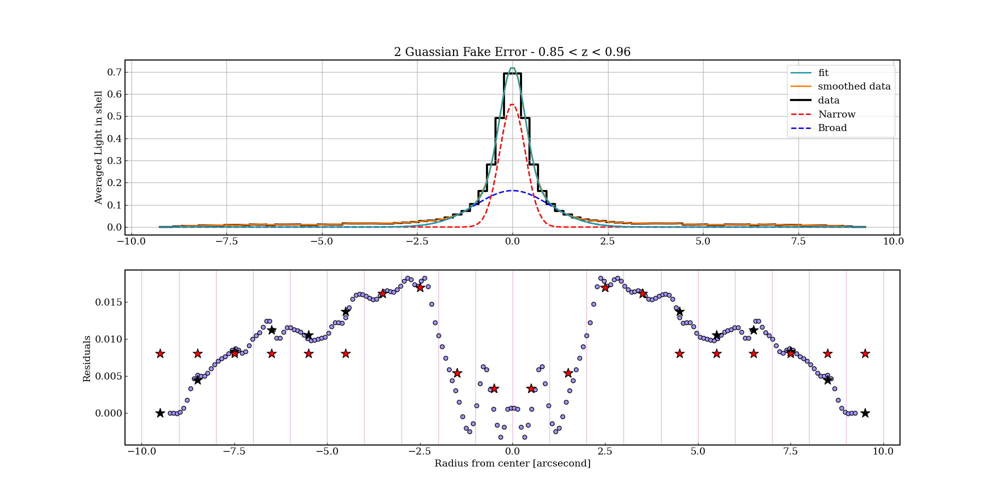

Amplitude Red = 0.5577333433334491 +0.021072306577816557 - 0.12880587379461644

Width Red = 0.33550863498640376 +0.01342617787444994 - 0.08411042449354988

Amplitude Blue = 0.16431999718508047 +0.005367681511422889 - 0.041277791780643724

Width Blue = 0.9752113698888611 +0.024671838010751346 - 0.2530412953017239


In [145]:
# 1. Generate or load data
x_Mirror_085_096 = np.linspace(-84,84,84)

x_data_Mirror_085_096 = np.multiply(x_Mirror_085_096, 0.11)
y_data_Mirror_085_096 = Mirrored_Radius_array_085_096

y_err_Mirror_085_096 = 1.0 #Mirrored_Radius_array_SDE_085_096[0:84]

initial_Mirror_085_096 = np.array([0.6, 0.4, 0.1, 1.1]) #amp,wid ... red/narrow, blue/broad


Amplitude_Narrow_Red_Lower_Lim_Mirror_085_096 = 0
Amplitude_Narrow_Red_Upperr_Lim_Mirror_085_096 = 0.58

Width_Narrow_Red_Lower_Lim_Mirror_085_096 = 0
Width_Narrow_Red_Upper_Lim_Mirror_085_096 = 0.35


Amplitude_Broad_Blue_Lower_Lim_Mirror_085_096 = 0
Amplitude_Broad_Blue_Upperr_Lim_Mirror_085_096 = 0.17

Width_Broad_Blue_Lower_Lim_Mirror_085_096 = 0
Width_Broad_Blue_Upper_Lim_Mirror_085_096 = 1.0



# 2. Define the likelihood function ############################################################################################################################################
def log_likelihood(theta, x, y, yerr):
    amp1, wid1, amp2, wid2 = theta
    model = two_gaussian(x, amp1, wid1, amp2, wid2)
    sigma2 = yerr**2
    return -0.5 * np.sum((y - model)**2 / sigma2 + np.log(sigma2))

# 4. Define the prior (optional, but recommended) ############################################################################################################################################
#def log_prior(theta):
#    amp1, wid1, amp2, wid2 = theta
#    if not all(0 < param < 10 for param in [amp1, amp2, wid1, wid2]):
#        return -np.inf
#    return 0.0

def log_prior(theta):
    amp1, wid1, amp2, wid2 = theta
    if (Amplitude_Narrow_Red_Lower_Lim_Mirror_085_096 < amp1 < Amplitude_Narrow_Red_Upperr_Lim_Mirror_085_096 and Amplitude_Broad_Blue_Lower_Lim_Mirror_085_096 < amp2 <  Amplitude_Broad_Blue_Upperr_Lim_Mirror_085_096 and Width_Narrow_Red_Lower_Lim_Mirror_085_096 < wid1 < Width_Narrow_Red_Upper_Lim_Mirror_085_096 and Width_Broad_Blue_Lower_Lim_Mirror_085_096 < wid2 <  Width_Broad_Blue_Upper_Lim_Mirror_085_096):
        return 0.0
    return -np.inf

# 5. Define the probability function ############################################################################################################################################
def log_probability(theta, x, y, yerr):
    lp = log_prior(theta)
    if not np.isfinite(lp):
        return -np.inf
    return lp + log_likelihood(theta, x, y, yerr)

# 3. Optimization (finding a good starting point) ############################################################################################################################################

bounds_Mirror_085_096 = [(Amplitude_Narrow_Red_Lower_Lim_Mirror_085_096, Amplitude_Narrow_Red_Upperr_Lim_Mirror_085_096), (Width_Narrow_Red_Lower_Lim_Mirror_085_096, Width_Narrow_Red_Upper_Lim_Mirror_085_096), (Amplitude_Broad_Blue_Lower_Lim_Mirror_085_096, Amplitude_Broad_Blue_Upperr_Lim_Mirror_085_096), (Width_Broad_Blue_Lower_Lim_Mirror_085_096, Width_Broad_Blue_Upper_Lim_Mirror_085_096)] # Parameter bounds for optimization
soln_Mirror_085_096 = minimize(lambda *args: -log_likelihood(*args), initial_Mirror_085_096, args=(x_data_Mirror_085_096, y_data_Mirror_085_096, y_err_Mirror_085_096), bounds=bounds_Mirror_085_096)

#soln = minimize(lambda *args: -log_likelihood(*args), initial, args=(x_data, y_data, y_err))
pos_Mirror_085_096 = soln_Mirror_085_096.x + 1e-4 * np.random.randn(32, len(soln_Mirror_085_096.x))
nwalkers_Mirror_085_096, ndim_Mirror_085_096 = pos_Mirror_085_096.shape


# 4. MCMC sampling ############################################################################################################################################
sampler_Mirror_085_096 = emcee.EnsembleSampler(nwalkers_Mirror_085_096, ndim_Mirror_085_096, log_probability, args=(x_data_Mirror_085_096, y_data_Mirror_085_096, y_err_Mirror_085_096))
sampler_Mirror_085_096.run_mcmc(pos_Mirror_085_096, 5000, progress=True)

# 5. Analyze results
samples_Mirror_085_096 = sampler_Mirror_085_096.get_chain(flat=True)

# 6. Best fit parameters ############################################################################################################################################
best_fit_params_Mirror_085_096 = []
for i in range(ndim_Mirror_085_096):
    mcmc_Mirror_085_096 = np.percentile(samples_Mirror_085_096[:, i], [68, 95, 99.7])
    best_fit_params_Mirror_085_096.append(mcmc_Mirror_085_096[1])

# 10. Error estimation ############################################################################################################################################
errors_Mirror_085_096 = []
for i in range(ndim_Mirror_085_096):
     mcmc_Mirror_085_096 = np.percentile(samples_Mirror_085_096[:, i], [68, 95, 99.7])
     errors_Mirror_085_096.append([mcmc_Mirror_085_096[2]-mcmc_Mirror_085_096[1],mcmc_Mirror_085_096[1]-mcmc_Mirror_085_096[0]])

# 11. Getting the RMS Values ############################################################################################################################################
x_new_Mirror_085_096 = np.linspace(min(x_data_Mirror_085_096),max(x_data_Mirror_085_096), 200)

y_new_Mirror_085_096 = CubicSpline(x_data_Mirror_085_096, y_data_Mirror_085_096)

yy_new_Mirror_085_096 = y_new_Mirror_085_096(x_new_Mirror_085_096)

x_plot_Mirror_085_096 = np.linspace(min(x_data_Mirror_085_096), max(x_data_Mirror_085_096), 200)


RMS_Bins_Mirrored_085_096 = np.arange(-10, 10, 1) # -10-10 bins of size 2
X_Array_RMS_085_096 = np.arange(-9.5, 10.5, 1) 


RMS_Array_085_096 = []
RMS_Len_Array_085_096 = []
RMS_Len_Array_Old_085_096 = []


for i in RMS_Bins_Mirrored_085_096:
    #print(np.where(np.logical_and(i < x_new_Mirror_085_096, x_new_Mirror_085_096 < i+2)))
    #print(len(x_new_Mirror_085_096[np.where(np.logical_and(i < x_new_Mirror_085_096, x_new_Mirror_085_096 < i+2))]))

    index = np.where(np.logical_and(i < x_new_Mirror_085_096, x_new_Mirror_085_096 < i+1))[0]

    index_2 = np.where(np.logical_and(i < x_data_Mirror_085_096, x_data_Mirror_085_096 < i+1))[0]
    
    values = yy_new_Mirror_085_096 - two_gaussian(x_plot_Mirror_085_096, *best_fit_params_Mirror_085_096)

    indexed_values = values[index]

    RMS = np.sqrt( (1/len(indexed_values)) * (np.sum(indexed_values**2)) )


    RMS_Array_085_096.append(RMS)
    RMS_Len_Array_085_096.append(len(index))
    RMS_Len_Array_Old_085_096.append(len(index_2))

index_1_085_096 = np.where(np.logical_and(X_Array_RMS_085_096 > (40*0.11), X_Array_RMS_085_096 > 0))[0]
index_2_085_096 = np.where(np.logical_and(X_Array_RMS_085_096 < -(40*0.11), X_Array_RMS_085_096 < 0))[0]
index_3_085_096 = np.concatenate((index_2_085_096,index_1_085_096))

Average_RMS_OutBox_085_096 = np.average(np.array(RMS_Array_085_096)[index_1_085_096])

RMS_Array_InBox_085_096 = np.array(RMS_Array_085_096)

RMS_Array_InBox_085_096[index_3_085_096] = Average_RMS_OutBox_085_096
     
# 12. Plot results ############################################################################################################################################
fig = plt.figure(figsize = (20, 10),  facecolor = "white")
ax = plt.subplot(2,1,1)

plt.plot(x_plot_Mirror_085_096, two_gaussian(x_plot_Mirror_085_096, *best_fit_params_Mirror_085_096), color = "#219B9D", linewidth=2.0, label="fit", zorder=10)
plt.plot(x_new_Mirror_085_096, yy_new_Mirror_085_096, color = "#FF8000", linewidth=2.0, label="smoothed data")
plt.step(x_data_Mirror_085_096, y_data_Mirror_085_096, color = "black", linewidth=3.0, where="mid", zorder=0, label="data")

plt.plot(x_plot_Mirror_085_096, gaussian(x_plot_Mirror_085_096, best_fit_params_Mirror_085_096[0], best_fit_params_Mirror_085_096[1]), color="red", linestyle="--", label="Narrow")
plt.plot(x_plot_Mirror_085_096, gaussian(x_plot_Mirror_085_096, best_fit_params_Mirror_085_096[2], best_fit_params_Mirror_085_096[3]), color="blue", linestyle="--", label="Broad")

plt.legend()

ax1 = plt.subplot(2,1,2)

ax1.scatter(x_new_Mirror_085_096, yy_new_Mirror_085_096 - two_gaussian(x_plot_Mirror_085_096, *best_fit_params_Mirror_085_096), c = "#A294F9", edgecolor="black") 

ax1.scatter(X_Array_RMS_085_096, RMS_Array_085_096, c = "black", edgecolor="black", marker="*", s=200, zorder=10)
ax1.scatter(X_Array_RMS_085_096, RMS_Array_InBox_085_096, c = "Red", edgecolor="black", marker="*", s=200, zorder=10)


plt.axvline(x = -10, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -9, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -8, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -7, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -6, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -5, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -4, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -3, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -2, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = -1, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 0, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 1, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 2, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 3, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 4, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 5, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 6, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 7, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 8, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 9, color = "#FF78C4", linewidth=0.5, zorder = 0)
plt.axvline(x = 10, color = "#FF78C4", linewidth=0.5, zorder = 0)

#plt.ylim(-0.001,0.001)

ax.set_title("2 Guassian Fake Error - 0.85 < z < 0.96")

ax1.set_xlabel("Radius from center [arcsecond]")

ax.set_ylabel("Averaged Light in shell")
ax1.set_ylabel("Residuals")

ax.grid()

# Show the plot
plt.show(block=False)

# Close the figure

############################################################################################################################################
Best_Fit_Mirrored_085_096 = yy_new_Mirror_085_096
Best_Fit_Mirrored_Fit_X_Array_085_096 = x_new_Mirror_085_096

Narrow_Amplitude_Fit_Mirrored_085_096 = best_fit_params_Mirror_085_096[0]
Narrow_Amplitude_Fit_Mirrored_Error_P_085_096 = errors_Mirror_085_096[0][0]
Narrow_Amplitude_Fit_Mirrored_Error_M_085_096 = errors_Mirror_085_096[0][1]
Narrow_Width_Fit_Mirrored_085_096 = best_fit_params_Mirror_085_096[1]
Narrow_Width_Fit_Mirrored_Error_P_085_096 = errors_Mirror_085_096[1][0]
Narrow_Width_Fit_Mirrored_Error_M_085_096 = errors_Mirror_085_096[1][1]

Broad_Amplitude_Fit_Mirrored_085_096 = best_fit_params_Mirror_085_096[2]
Broad_Amplitude_Fit_Mirrored_Error_P_085_096 = errors_Mirror_085_096[2][0]
Broad_Amplitude_Fit_Mirrored_Error_M_085_096 = errors_Mirror_085_096[2][1]
Broad_Width_Fit_Mirrored_085_096 = best_fit_params_Mirror_085_096[3]
Broad_Width_Fit_Mirrored_Error_P_085_096 = errors_Mirror_085_096[3][0]
Broad_Width_Fit_Mirrored_Error_M_085_096 = errors_Mirror_085_096[3][1]

Best_Fit_Mirrored_Fit_Residuals_085_096 = yy_new_Mirror_085_096 - two_gaussian(x_plot_Mirror_085_096, *best_fit_params_Mirror_085_096)
Gaussian_Fit_Mirrored_X_Array_085_096 = x_plot_Mirror_085_096

############################################################################################################################################
print("Amplitude Red = " +str(best_fit_params_Mirror_085_096[0]) + " +" +str(errors_Mirror_085_096[0][0]) + " - " +str(errors_Mirror_085_096[0][1]))
print("")
print("Width Red = " +str(best_fit_params_Mirror_085_096[1]) + " +" +str(errors_Mirror_085_096[1][0]) + " - " +str(errors_Mirror_085_096[1][1]))
print("")
print("Amplitude Blue = " +str(best_fit_params_Mirror_085_096[2]) + " +" +str(errors_Mirror_085_096[2][0]) + " - " +str(errors_Mirror_085_096[2][1]))
print("")
print("Width Blue = " +str(best_fit_params_Mirror_085_096[3]) + " +" +str(errors_Mirror_085_096[3][0]) + " - " +str(errors_Mirror_085_096[3][1]))



## Fitting with the New Error Instead of the Fake Error

In [146]:
New_Err_RMS_N10_N9_025_035 = np.full(RMS_Len_Array_Old_025_035[0], RMS_Array_025_035[0])
New_Err_RMS_N9_N8_025_035 = np.full(RMS_Len_Array_Old_025_035[1], RMS_Array_025_035[1])
New_Err_RMS_N8_N7_025_035 = np.full(RMS_Len_Array_Old_025_035[2], RMS_Array_025_035[2])
New_Err_RMS_N7_N6_025_035 = np.full(RMS_Len_Array_Old_025_035[3], RMS_Array_025_035[3])
New_Err_RMS_N6_N5_025_035 = np.full(RMS_Len_Array_Old_025_035[4], RMS_Array_025_035[4])
New_Err_RMS_N5_N4_025_035 = np.full(RMS_Len_Array_Old_025_035[5], RMS_Array_025_035[5])
New_Err_RMS_N4_N3_025_035 = np.full(RMS_Len_Array_Old_025_035[6], RMS_Array_025_035[6])
New_Err_RMS_N3_N2_025_035 = np.full(RMS_Len_Array_Old_025_035[7], RMS_Array_025_035[7])
New_Err_RMS_N2_N1_025_035 = np.full(RMS_Len_Array_Old_025_035[8], RMS_Array_025_035[8])
New_Err_RMS_N1_N0_025_035 = np.full(RMS_Len_Array_Old_025_035[9], RMS_Array_025_035[9])
New_Err_RMS_N0_1_025_035 = np.full(RMS_Len_Array_Old_025_035[10], RMS_Array_025_035[10])
New_Err_RMS_1_2_025_035 = np.full(RMS_Len_Array_Old_025_035[11], RMS_Array_025_035[11])
New_Err_RMS_2_3_025_035 = np.full(RMS_Len_Array_Old_025_035[12], RMS_Array_025_035[12])
New_Err_RMS_3_4_025_035 = np.full(RMS_Len_Array_Old_025_035[13], RMS_Array_025_035[13])
New_Err_RMS_4_5_025_035 = np.full(RMS_Len_Array_Old_025_035[14], RMS_Array_025_035[14])
New_Err_RMS_5_6_025_035 = np.full(RMS_Len_Array_Old_025_035[15], RMS_Array_025_035[15])
New_Err_RMS_6_7_025_035 = np.full(RMS_Len_Array_Old_025_035[16], RMS_Array_025_035[16])
New_Err_RMS_7_8_025_035 = np.full(RMS_Len_Array_Old_025_035[17], RMS_Array_025_035[17])
New_Err_RMS_8_9_025_035 = np.full(RMS_Len_Array_Old_025_035[18], RMS_Array_025_035[18])
New_Err_RMS_9_10_025_035 = np.full(RMS_Len_Array_Old_025_035[19], RMS_Array_025_035[19])


New_Err_RMS_025_035 = np.concatenate((New_Err_RMS_N10_N9_025_035 ,New_Err_RMS_N9_N8_025_035 ,New_Err_RMS_N8_N7_025_035 ,New_Err_RMS_N7_N6_025_035 ,New_Err_RMS_N6_N5_025_035 ,New_Err_RMS_N5_N4_025_035 ,New_Err_RMS_N4_N3_025_035 ,New_Err_RMS_N3_N2_025_035 ,New_Err_RMS_N2_N1_025_035 ,New_Err_RMS_N1_N0_025_035 ,New_Err_RMS_N0_1_025_035 ,New_Err_RMS_1_2_025_035 ,New_Err_RMS_2_3_025_035 ,New_Err_RMS_3_4_025_035 ,New_Err_RMS_4_5_025_035 ,New_Err_RMS_5_6_025_035 ,New_Err_RMS_6_7_025_035 ,New_Err_RMS_7_8_025_035 ,New_Err_RMS_8_9_025_035 ,New_Err_RMS_9_10_025_035))



In [147]:
New_Err_RMS_N10_N9_035_045 = np.full(RMS_Len_Array_Old_035_045[0], RMS_Array_035_045[0])
New_Err_RMS_N9_N8_035_045 = np.full(RMS_Len_Array_Old_035_045[1], RMS_Array_035_045[1])
New_Err_RMS_N8_N7_035_045 = np.full(RMS_Len_Array_Old_035_045[2], RMS_Array_035_045[2])
New_Err_RMS_N7_N6_035_045 = np.full(RMS_Len_Array_Old_035_045[3], RMS_Array_035_045[3])
New_Err_RMS_N6_N5_035_045 = np.full(RMS_Len_Array_Old_035_045[4], RMS_Array_035_045[4])
New_Err_RMS_N5_N4_035_045 = np.full(RMS_Len_Array_Old_035_045[5], RMS_Array_035_045[5])
New_Err_RMS_N4_N3_035_045 = np.full(RMS_Len_Array_Old_035_045[6], RMS_Array_035_045[6])
New_Err_RMS_N3_N2_035_045 = np.full(RMS_Len_Array_Old_035_045[7], RMS_Array_035_045[7])
New_Err_RMS_N2_N1_035_045 = np.full(RMS_Len_Array_Old_035_045[8], RMS_Array_035_045[8])
New_Err_RMS_N1_N0_035_045 = np.full(RMS_Len_Array_Old_035_045[9], RMS_Array_035_045[9])
New_Err_RMS_N0_1_035_045 = np.full(RMS_Len_Array_Old_035_045[10], RMS_Array_035_045[10])
New_Err_RMS_1_2_035_045 = np.full(RMS_Len_Array_Old_035_045[11], RMS_Array_035_045[11])
New_Err_RMS_2_3_035_045 = np.full(RMS_Len_Array_Old_035_045[12], RMS_Array_035_045[12])
New_Err_RMS_3_4_035_045 = np.full(RMS_Len_Array_Old_035_045[13], RMS_Array_035_045[13])
New_Err_RMS_4_5_035_045 = np.full(RMS_Len_Array_Old_035_045[14], RMS_Array_035_045[14])
New_Err_RMS_5_6_035_045 = np.full(RMS_Len_Array_Old_035_045[15], RMS_Array_035_045[15])
New_Err_RMS_6_7_035_045 = np.full(RMS_Len_Array_Old_035_045[16], RMS_Array_035_045[16])
New_Err_RMS_7_8_035_045 = np.full(RMS_Len_Array_Old_035_045[17], RMS_Array_035_045[17])
New_Err_RMS_8_9_035_045 = np.full(RMS_Len_Array_Old_035_045[18], RMS_Array_035_045[18])
New_Err_RMS_9_10_035_045 = np.full(RMS_Len_Array_Old_035_045[19], RMS_Array_035_045[19])


New_Err_RMS_035_045 = np.concatenate((New_Err_RMS_N10_N9_035_045 ,New_Err_RMS_N9_N8_035_045 ,New_Err_RMS_N8_N7_035_045 ,New_Err_RMS_N7_N6_035_045 ,New_Err_RMS_N6_N5_035_045 ,New_Err_RMS_N5_N4_035_045 ,New_Err_RMS_N4_N3_035_045 ,New_Err_RMS_N3_N2_035_045 ,New_Err_RMS_N2_N1_035_045 ,New_Err_RMS_N1_N0_035_045 ,New_Err_RMS_N0_1_035_045 ,New_Err_RMS_1_2_035_045 ,New_Err_RMS_2_3_035_045 ,New_Err_RMS_3_4_035_045 ,New_Err_RMS_4_5_035_045 ,New_Err_RMS_5_6_035_045 ,New_Err_RMS_6_7_035_045 ,New_Err_RMS_7_8_035_045 ,New_Err_RMS_8_9_035_045 ,New_Err_RMS_9_10_035_045))



In [148]:
New_Err_RMS_N10_N9_045_055 = np.full(RMS_Len_Array_Old_045_055[0], RMS_Array_045_055[0])
New_Err_RMS_N9_N8_045_055 = np.full(RMS_Len_Array_Old_045_055[1], RMS_Array_045_055[1])
New_Err_RMS_N8_N7_045_055 = np.full(RMS_Len_Array_Old_045_055[2], RMS_Array_045_055[2])
New_Err_RMS_N7_N6_045_055 = np.full(RMS_Len_Array_Old_045_055[3], RMS_Array_045_055[3])
New_Err_RMS_N6_N5_045_055 = np.full(RMS_Len_Array_Old_045_055[4], RMS_Array_045_055[4])
New_Err_RMS_N5_N4_045_055 = np.full(RMS_Len_Array_Old_045_055[5], RMS_Array_045_055[5])
New_Err_RMS_N4_N3_045_055 = np.full(RMS_Len_Array_Old_045_055[6], RMS_Array_045_055[6])
New_Err_RMS_N3_N2_045_055 = np.full(RMS_Len_Array_Old_045_055[7], RMS_Array_045_055[7])
New_Err_RMS_N2_N1_045_055 = np.full(RMS_Len_Array_Old_045_055[8], RMS_Array_045_055[8])
New_Err_RMS_N1_N0_045_055 = np.full(RMS_Len_Array_Old_045_055[9], RMS_Array_045_055[9])
New_Err_RMS_N0_1_045_055 = np.full(RMS_Len_Array_Old_045_055[10], RMS_Array_045_055[10])
New_Err_RMS_1_2_045_055 = np.full(RMS_Len_Array_Old_045_055[11], RMS_Array_045_055[11])
New_Err_RMS_2_3_045_055 = np.full(RMS_Len_Array_Old_045_055[12], RMS_Array_045_055[12])
New_Err_RMS_3_4_045_055 = np.full(RMS_Len_Array_Old_045_055[13], RMS_Array_045_055[13])
New_Err_RMS_4_5_045_055 = np.full(RMS_Len_Array_Old_045_055[14], RMS_Array_045_055[14])
New_Err_RMS_5_6_045_055 = np.full(RMS_Len_Array_Old_045_055[15], RMS_Array_045_055[15])
New_Err_RMS_6_7_045_055 = np.full(RMS_Len_Array_Old_045_055[16], RMS_Array_045_055[16])
New_Err_RMS_7_8_045_055 = np.full(RMS_Len_Array_Old_045_055[17], RMS_Array_045_055[17])
New_Err_RMS_8_9_045_055 = np.full(RMS_Len_Array_Old_045_055[18], RMS_Array_045_055[18])
New_Err_RMS_9_10_045_055 = np.full(RMS_Len_Array_Old_045_055[19], RMS_Array_045_055[19])


New_Err_RMS_045_055 = np.concatenate((New_Err_RMS_N10_N9_045_055 ,New_Err_RMS_N9_N8_045_055 ,New_Err_RMS_N8_N7_045_055 ,New_Err_RMS_N7_N6_045_055 ,New_Err_RMS_N6_N5_045_055 ,New_Err_RMS_N5_N4_045_055 ,New_Err_RMS_N4_N3_045_055 ,New_Err_RMS_N3_N2_045_055 ,New_Err_RMS_N2_N1_045_055 ,New_Err_RMS_N1_N0_045_055 ,New_Err_RMS_N0_1_045_055 ,New_Err_RMS_1_2_045_055 ,New_Err_RMS_2_3_045_055 ,New_Err_RMS_3_4_045_055 ,New_Err_RMS_4_5_045_055 ,New_Err_RMS_5_6_045_055 ,New_Err_RMS_6_7_045_055 ,New_Err_RMS_7_8_045_055 ,New_Err_RMS_8_9_045_055 ,New_Err_RMS_9_10_045_055))
print(New_Err_RMS_045_055)
print("")
print(two_gaussian(x_plot_Mirror_045_055, *best_fit_params_Mirror_045_055))

[0.00099639 0.00099639 0.00593007 0.00593007 0.00593007 0.00593007
 0.01143261 0.01143261 0.01143261 0.01143261 0.01143261 0.01134571
 0.01134571 0.01134571 0.01134571 0.01810968 0.01810968 0.01810968
 0.01810968 0.01810968 0.024929   0.024929   0.024929   0.024929
 0.03379448 0.03379448 0.03379448 0.03379448 0.03379448 0.03878514
 0.03878514 0.03878514 0.03878514 0.01441641 0.01441641 0.01441641
 0.01441641 0.01441641 0.01106466 0.01106466 0.01106466 0.01106466
 0.01106466 0.01106466 0.01106466 0.01106466 0.01441641 0.01441641
 0.01441641 0.01441641 0.01441641 0.03878514 0.03878514 0.03878514
 0.03878514 0.03379448 0.03379448 0.03379448 0.03379448 0.03379448
 0.024929   0.024929   0.024929   0.024929   0.01810968 0.01810968
 0.01810968 0.01810968 0.01810968 0.01134571 0.01134571 0.01134571
 0.01134571 0.01143261 0.01143261 0.01143261 0.01143261 0.01143261
 0.00593007 0.00593007 0.00593007 0.00593007 0.00099639 0.00099639]

[7.92240806e-21 1.95981505e-20 4.80396305e-20 1.16683895e-19
 

In [149]:
New_Err_RMS_N10_N9_055_065 = np.full(RMS_Len_Array_Old_055_065[0], RMS_Array_055_065[0])
New_Err_RMS_N9_N8_055_065 = np.full(RMS_Len_Array_Old_055_065[1], RMS_Array_055_065[1])
New_Err_RMS_N8_N7_055_065 = np.full(RMS_Len_Array_Old_055_065[2], RMS_Array_055_065[2])
New_Err_RMS_N7_N6_055_065 = np.full(RMS_Len_Array_Old_055_065[3], RMS_Array_055_065[3])
New_Err_RMS_N6_N5_055_065 = np.full(RMS_Len_Array_Old_055_065[4], RMS_Array_055_065[4])
New_Err_RMS_N5_N4_055_065 = np.full(RMS_Len_Array_Old_055_065[5], RMS_Array_055_065[5])
New_Err_RMS_N4_N3_055_065 = np.full(RMS_Len_Array_Old_055_065[6], RMS_Array_055_065[6])
New_Err_RMS_N3_N2_055_065 = np.full(RMS_Len_Array_Old_055_065[7], RMS_Array_055_065[7])
New_Err_RMS_N2_N1_055_065 = np.full(RMS_Len_Array_Old_055_065[8], RMS_Array_055_065[8])
New_Err_RMS_N1_N0_055_065 = np.full(RMS_Len_Array_Old_055_065[9], RMS_Array_055_065[9])
New_Err_RMS_N0_1_055_065 = np.full(RMS_Len_Array_Old_055_065[10], RMS_Array_055_065[10])
New_Err_RMS_1_2_055_065 = np.full(RMS_Len_Array_Old_055_065[11], RMS_Array_055_065[11])
New_Err_RMS_2_3_055_065 = np.full(RMS_Len_Array_Old_055_065[12], RMS_Array_055_065[12])
New_Err_RMS_3_4_055_065 = np.full(RMS_Len_Array_Old_055_065[13], RMS_Array_055_065[13])
New_Err_RMS_4_5_055_065 = np.full(RMS_Len_Array_Old_055_065[14], RMS_Array_055_065[14])
New_Err_RMS_5_6_055_065 = np.full(RMS_Len_Array_Old_055_065[15], RMS_Array_055_065[15])
New_Err_RMS_6_7_055_065 = np.full(RMS_Len_Array_Old_055_065[16], RMS_Array_055_065[16])
New_Err_RMS_7_8_055_065 = np.full(RMS_Len_Array_Old_055_065[17], RMS_Array_055_065[17])
New_Err_RMS_8_9_055_065 = np.full(RMS_Len_Array_Old_055_065[18], RMS_Array_055_065[18])
New_Err_RMS_9_10_055_065 = np.full(RMS_Len_Array_Old_055_065[19], RMS_Array_055_065[19])


New_Err_RMS_055_065 = np.concatenate((New_Err_RMS_N10_N9_055_065 ,New_Err_RMS_N9_N8_055_065 ,New_Err_RMS_N8_N7_055_065 ,New_Err_RMS_N7_N6_055_065 ,New_Err_RMS_N6_N5_055_065 ,New_Err_RMS_N5_N4_055_065 ,New_Err_RMS_N4_N3_055_065 ,New_Err_RMS_N3_N2_055_065 ,New_Err_RMS_N2_N1_055_065 ,New_Err_RMS_N1_N0_055_065 ,New_Err_RMS_N0_1_055_065 ,New_Err_RMS_1_2_055_065 ,New_Err_RMS_2_3_055_065 ,New_Err_RMS_3_4_055_065 ,New_Err_RMS_4_5_055_065 ,New_Err_RMS_5_6_055_065 ,New_Err_RMS_6_7_055_065 ,New_Err_RMS_7_8_055_065 ,New_Err_RMS_8_9_055_065 ,New_Err_RMS_9_10_055_065))



In [150]:
New_Err_RMS_N10_N9_065_075 = np.full(RMS_Len_Array_Old_065_075[0], RMS_Array_065_075[0])
New_Err_RMS_N9_N8_065_075 = np.full(RMS_Len_Array_Old_065_075[1], RMS_Array_065_075[1])
New_Err_RMS_N8_N7_065_075 = np.full(RMS_Len_Array_Old_065_075[2], RMS_Array_065_075[2])
New_Err_RMS_N7_N6_065_075 = np.full(RMS_Len_Array_Old_065_075[3], RMS_Array_065_075[3])
New_Err_RMS_N6_N5_065_075 = np.full(RMS_Len_Array_Old_065_075[4], RMS_Array_065_075[4])
New_Err_RMS_N5_N4_065_075 = np.full(RMS_Len_Array_Old_065_075[5], RMS_Array_065_075[5])
New_Err_RMS_N4_N3_065_075 = np.full(RMS_Len_Array_Old_065_075[6], RMS_Array_065_075[6])
New_Err_RMS_N3_N2_065_075 = np.full(RMS_Len_Array_Old_065_075[7], RMS_Array_065_075[7])
New_Err_RMS_N2_N1_065_075 = np.full(RMS_Len_Array_Old_065_075[8], RMS_Array_065_075[8])
New_Err_RMS_N1_N0_065_075 = np.full(RMS_Len_Array_Old_065_075[9], RMS_Array_065_075[9])
New_Err_RMS_N0_1_065_075 = np.full(RMS_Len_Array_Old_065_075[10], RMS_Array_065_075[10])
New_Err_RMS_1_2_065_075 = np.full(RMS_Len_Array_Old_065_075[11], RMS_Array_065_075[11])
New_Err_RMS_2_3_065_075 = np.full(RMS_Len_Array_Old_065_075[12], RMS_Array_065_075[12])
New_Err_RMS_3_4_065_075 = np.full(RMS_Len_Array_Old_065_075[13], RMS_Array_065_075[13])
New_Err_RMS_4_5_065_075 = np.full(RMS_Len_Array_Old_065_075[14], RMS_Array_065_075[14])
New_Err_RMS_5_6_065_075 = np.full(RMS_Len_Array_Old_065_075[15], RMS_Array_065_075[15])
New_Err_RMS_6_7_065_075 = np.full(RMS_Len_Array_Old_065_075[16], RMS_Array_065_075[16])
New_Err_RMS_7_8_065_075 = np.full(RMS_Len_Array_Old_065_075[17], RMS_Array_065_075[17])
New_Err_RMS_8_9_065_075 = np.full(RMS_Len_Array_Old_065_075[18], RMS_Array_065_075[18])
New_Err_RMS_9_10_065_075 = np.full(RMS_Len_Array_Old_065_075[19], RMS_Array_065_075[19])


New_Err_RMS_065_075 = np.concatenate((New_Err_RMS_N10_N9_065_075 ,New_Err_RMS_N9_N8_065_075 ,New_Err_RMS_N8_N7_065_075 ,New_Err_RMS_N7_N6_065_075 ,New_Err_RMS_N6_N5_065_075 ,New_Err_RMS_N5_N4_065_075 ,New_Err_RMS_N4_N3_065_075 ,New_Err_RMS_N3_N2_065_075 ,New_Err_RMS_N2_N1_065_075 ,New_Err_RMS_N1_N0_065_075 ,New_Err_RMS_N0_1_065_075 ,New_Err_RMS_1_2_065_075 ,New_Err_RMS_2_3_065_075 ,New_Err_RMS_3_4_065_075 ,New_Err_RMS_4_5_065_075 ,New_Err_RMS_5_6_065_075 ,New_Err_RMS_6_7_065_075 ,New_Err_RMS_7_8_065_075 ,New_Err_RMS_8_9_065_075 ,New_Err_RMS_9_10_065_075))



In [151]:
New_Err_RMS_N10_N9_075_085 = np.full(RMS_Len_Array_Old_075_085[0], RMS_Array_075_085[0])
New_Err_RMS_N9_N8_075_085 = np.full(RMS_Len_Array_Old_075_085[1], RMS_Array_075_085[1])
New_Err_RMS_N8_N7_075_085 = np.full(RMS_Len_Array_Old_075_085[2], RMS_Array_075_085[2])
New_Err_RMS_N7_N6_075_085 = np.full(RMS_Len_Array_Old_075_085[3], RMS_Array_075_085[3])
New_Err_RMS_N6_N5_075_085 = np.full(RMS_Len_Array_Old_075_085[4], RMS_Array_075_085[4])
New_Err_RMS_N5_N4_075_085 = np.full(RMS_Len_Array_Old_075_085[5], RMS_Array_075_085[5])
New_Err_RMS_N4_N3_075_085 = np.full(RMS_Len_Array_Old_075_085[6], RMS_Array_075_085[6])
New_Err_RMS_N3_N2_075_085 = np.full(RMS_Len_Array_Old_075_085[7], RMS_Array_075_085[7])
New_Err_RMS_N2_N1_075_085 = np.full(RMS_Len_Array_Old_075_085[8], RMS_Array_075_085[8])
New_Err_RMS_N1_N0_075_085 = np.full(RMS_Len_Array_Old_075_085[9], RMS_Array_075_085[9])
New_Err_RMS_N0_1_075_085 = np.full(RMS_Len_Array_Old_075_085[10], RMS_Array_075_085[10])
New_Err_RMS_1_2_075_085 = np.full(RMS_Len_Array_Old_075_085[11], RMS_Array_075_085[11])
New_Err_RMS_2_3_075_085 = np.full(RMS_Len_Array_Old_075_085[12], RMS_Array_075_085[12])
New_Err_RMS_3_4_075_085 = np.full(RMS_Len_Array_Old_075_085[13], RMS_Array_075_085[13])
New_Err_RMS_4_5_075_085 = np.full(RMS_Len_Array_Old_075_085[14], RMS_Array_075_085[14])
New_Err_RMS_5_6_075_085 = np.full(RMS_Len_Array_Old_075_085[15], RMS_Array_075_085[15])
New_Err_RMS_6_7_075_085 = np.full(RMS_Len_Array_Old_075_085[16], RMS_Array_075_085[16])
New_Err_RMS_7_8_075_085 = np.full(RMS_Len_Array_Old_075_085[17], RMS_Array_075_085[17])
New_Err_RMS_8_9_075_085 = np.full(RMS_Len_Array_Old_075_085[18], RMS_Array_075_085[18])
New_Err_RMS_9_10_075_085 = np.full(RMS_Len_Array_Old_075_085[19], RMS_Array_075_085[19])


New_Err_RMS_075_085 = np.concatenate((New_Err_RMS_N10_N9_075_085 ,New_Err_RMS_N9_N8_075_085 ,New_Err_RMS_N8_N7_075_085 ,New_Err_RMS_N7_N6_075_085 ,New_Err_RMS_N6_N5_075_085 ,New_Err_RMS_N5_N4_075_085 ,New_Err_RMS_N4_N3_075_085 ,New_Err_RMS_N3_N2_075_085 ,New_Err_RMS_N2_N1_075_085 ,New_Err_RMS_N1_N0_075_085 ,New_Err_RMS_N0_1_075_085 ,New_Err_RMS_1_2_075_085 ,New_Err_RMS_2_3_075_085 ,New_Err_RMS_3_4_075_085 ,New_Err_RMS_4_5_075_085 ,New_Err_RMS_5_6_075_085 ,New_Err_RMS_6_7_075_085 ,New_Err_RMS_7_8_075_085 ,New_Err_RMS_8_9_075_085 ,New_Err_RMS_9_10_075_085))



In [152]:
New_Err_RMS_N10_N9_085_096 = np.full(RMS_Len_Array_Old_085_096[0], RMS_Array_085_096[0])
New_Err_RMS_N9_N8_085_096 = np.full(RMS_Len_Array_Old_085_096[1], RMS_Array_085_096[1])
New_Err_RMS_N8_N7_085_096 = np.full(RMS_Len_Array_Old_085_096[2], RMS_Array_085_096[2])
New_Err_RMS_N7_N6_085_096 = np.full(RMS_Len_Array_Old_085_096[3], RMS_Array_085_096[3])
New_Err_RMS_N6_N5_085_096 = np.full(RMS_Len_Array_Old_085_096[4], RMS_Array_085_096[4])
New_Err_RMS_N5_N4_085_096 = np.full(RMS_Len_Array_Old_085_096[5], RMS_Array_085_096[5])
New_Err_RMS_N4_N3_085_096 = np.full(RMS_Len_Array_Old_085_096[6], RMS_Array_085_096[6])
New_Err_RMS_N3_N2_085_096 = np.full(RMS_Len_Array_Old_085_096[7], RMS_Array_085_096[7])
New_Err_RMS_N2_N1_085_096 = np.full(RMS_Len_Array_Old_085_096[8], RMS_Array_085_096[8])
New_Err_RMS_N1_N0_085_096 = np.full(RMS_Len_Array_Old_085_096[9], RMS_Array_085_096[9])
New_Err_RMS_N0_1_085_096 = np.full(RMS_Len_Array_Old_085_096[10], RMS_Array_085_096[10])
New_Err_RMS_1_2_085_096 = np.full(RMS_Len_Array_Old_085_096[11], RMS_Array_085_096[11])
New_Err_RMS_2_3_085_096 = np.full(RMS_Len_Array_Old_085_096[12], RMS_Array_085_096[12])
New_Err_RMS_3_4_085_096 = np.full(RMS_Len_Array_Old_085_096[13], RMS_Array_085_096[13])
New_Err_RMS_4_5_085_096 = np.full(RMS_Len_Array_Old_085_096[14], RMS_Array_085_096[14])
New_Err_RMS_5_6_085_096 = np.full(RMS_Len_Array_Old_085_096[15], RMS_Array_085_096[15])
New_Err_RMS_6_7_085_096 = np.full(RMS_Len_Array_Old_085_096[16], RMS_Array_085_096[16])
New_Err_RMS_7_8_085_096 = np.full(RMS_Len_Array_Old_085_096[17], RMS_Array_085_096[17])
New_Err_RMS_8_9_085_096 = np.full(RMS_Len_Array_Old_085_096[18], RMS_Array_085_096[18])
New_Err_RMS_9_10_085_096 = np.full(RMS_Len_Array_Old_085_096[19], RMS_Array_085_096[19])


New_Err_RMS_085_096 = np.concatenate((New_Err_RMS_N10_N9_085_096 ,New_Err_RMS_N9_N8_085_096 ,New_Err_RMS_N8_N7_085_096 ,New_Err_RMS_N7_N6_085_096 ,New_Err_RMS_N6_N5_085_096 ,New_Err_RMS_N5_N4_085_096 ,New_Err_RMS_N4_N3_085_096 ,New_Err_RMS_N3_N2_085_096 ,New_Err_RMS_N2_N1_085_096 ,New_Err_RMS_N1_N0_085_096 ,New_Err_RMS_N0_1_085_096 ,New_Err_RMS_1_2_085_096 ,New_Err_RMS_2_3_085_096 ,New_Err_RMS_3_4_085_096 ,New_Err_RMS_4_5_085_096 ,New_Err_RMS_5_6_085_096 ,New_Err_RMS_6_7_085_096 ,New_Err_RMS_7_8_085_096 ,New_Err_RMS_8_9_085_096 ,New_Err_RMS_9_10_085_096))



100%|██████████| 5000/5000 [00:07<00:00, 649.10it/s]


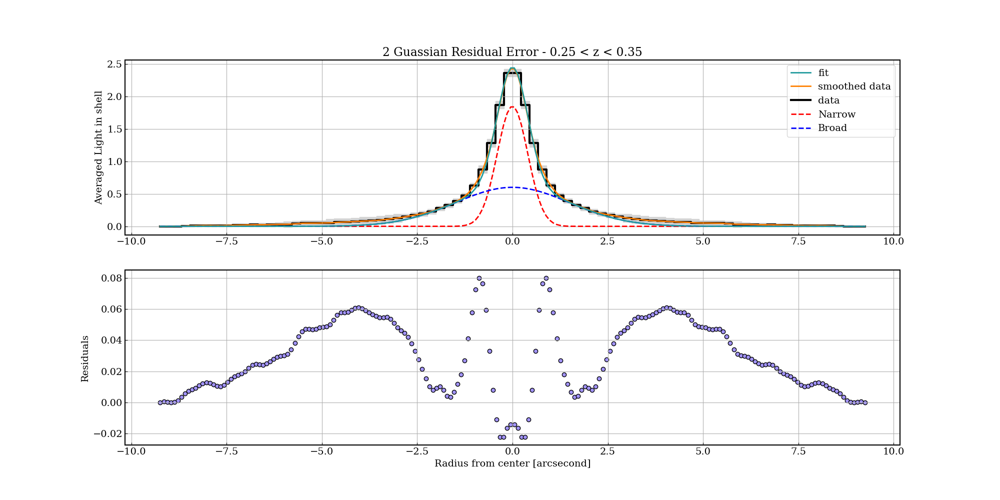

Amplitude Red = 1.8482323078794596 +0.001663168772636503 - 0.009774243805613425

Width Red = 0.3998877517611142 +0.00011024506587664629 - 0.0008428417280896272

Amplitude Blue = 0.5998325573528076 +0.00016386799335699198 - 0.001075558528841114

Width Blue = 1.4996415820486646 +0.0003524205036733452 - 0.0026656761169878695


In [153]:
# 1. Generate or load data
x_Mirror_RE_025_035 = np.linspace(-84,84,84)

x_data_Mirror_RE_025_035 = np.multiply(x_Mirror_025_035, 0.11)
y_data_Mirror_RE_025_035 = Mirrored_Radius_array_025_035

y_err_Mirror_RE_025_035 = New_Err_RMS_025_035 #1.0 #Mirrored_Radius_array_SDE_025_035[0:84]

initial_Mirror_RE_025_035 = np.array([0.6, 0.4, 0.1, 1.0]) #amp,wid ... red/narrow, blue/broad


Amplitude_Narrow_Red_Lower_Lim_Mirror_RE_025_035 = 0
Amplitude_Narrow_Red_Upperr_Lim_Mirror_RE_025_035 = 1.85

Width_Narrow_Red_Lower_Lim_Mirror_RE_025_035 = 0
Width_Narrow_Red_Upper_Lim_Mirror_RE_025_035 = 0.4


Amplitude_Broad_Blue_Lower_Lim_Mirror_RE_025_035 = 0
Amplitude_Broad_Blue_Upperr_Lim_Mirror_RE_025_035 = 0.6

Width_Broad_Blue_Lower_Lim_Mirror_RE_025_035 = 0
Width_Broad_Blue_Upper_Lim_Mirror_RE_025_035 = 1.5




# 2. Define the likelihood function ############################################################################################################################################
def log_likelihood(theta, x, y, yerr):
    amp1, wid1, amp2, wid2 = theta
    model = two_gaussian(x, amp1, wid1, amp2, wid2)
    sigma2 = yerr**2
    return -0.5 * np.sum((y - model)**2 / sigma2 + np.log(sigma2))

# 4. Define the prior (optional, but recommended) ############################################################################################################################################
#def log_prior(theta):
#    amp1, wid1, amp2, wid2 = theta
#    if not all(0 < param < 10 for param in [amp1, amp2, wid1, wid2]):
#        return -np.inf
#    return 0.0

def log_prior(theta):
    amp1, wid1, amp2, wid2 = theta
    if (Amplitude_Narrow_Red_Lower_Lim_Mirror_RE_025_035 < amp1 < Amplitude_Narrow_Red_Upperr_Lim_Mirror_RE_025_035 and Amplitude_Broad_Blue_Lower_Lim_Mirror_RE_025_035 < amp2 <  Amplitude_Broad_Blue_Upperr_Lim_Mirror_RE_025_035 and Width_Narrow_Red_Lower_Lim_Mirror_RE_025_035 < wid1 < Width_Narrow_Red_Upper_Lim_Mirror_RE_025_035 and Width_Broad_Blue_Lower_Lim_Mirror_RE_025_035 < wid2 <  Width_Broad_Blue_Upper_Lim_Mirror_RE_025_035):
        return 0.0
    return -np.inf

# 5. Define the probability function ############################################################################################################################################
def log_probability(theta, x, y, yerr):
    lp = log_prior(theta)
    if not np.isfinite(lp):
        return -np.inf
    return lp + log_likelihood(theta, x, y, yerr)

# 3. Optimization (finding a good starting point) ############################################################################################################################################

bounds_Mirror_RE_025_035 = [(Amplitude_Narrow_Red_Lower_Lim_Mirror_RE_025_035, Amplitude_Narrow_Red_Upperr_Lim_Mirror_RE_025_035), (Width_Narrow_Red_Lower_Lim_Mirror_RE_025_035, Width_Narrow_Red_Upper_Lim_Mirror_RE_025_035), (Amplitude_Broad_Blue_Lower_Lim_Mirror_RE_025_035, Amplitude_Broad_Blue_Upperr_Lim_Mirror_RE_025_035), (Width_Broad_Blue_Lower_Lim_Mirror_RE_025_035, Width_Broad_Blue_Upper_Lim_Mirror_RE_025_035)] # Parameter bounds for optimization
soln_Mirror_RE_025_035 = minimize(lambda *args: -log_likelihood(*args), initial_Mirror_RE_025_035, args=(x_data_Mirror_RE_025_035, y_data_Mirror_RE_025_035, y_err_Mirror_RE_025_035), bounds=bounds_Mirror_RE_025_035)

#soln = minimize(lambda *args: -log_likelihood(*args), initial, args=(x_data, y_data, y_err))
pos_Mirror_RE_025_035 = soln_Mirror_RE_025_035.x + 1e-4 * np.random.randn(32, len(soln_Mirror_RE_025_035.x))
nwalkers_Mirror_RE_025_035, ndim_Mirror_RE_025_035 = pos_Mirror_RE_025_035.shape


# 4. MCMC sampling ############################################################################################################################################
sampler_Mirror_RE_025_035 = emcee.EnsembleSampler(nwalkers_Mirror_RE_025_035, ndim_Mirror_RE_025_035, log_probability, args=(x_data_Mirror_RE_025_035, y_data_Mirror_RE_025_035, y_err_Mirror_RE_025_035))
sampler_Mirror_RE_025_035.run_mcmc(pos_Mirror_RE_025_035, 5000, progress=True)

# 5. Analyze results
samples_Mirror_RE_025_035 = sampler_Mirror_RE_025_035.get_chain(flat=True)

# 6. Best fit parameters ############################################################################################################################################
best_fit_params_Mirror_RE_025_035 = []
for i in range(ndim_Mirror_RE_025_035):
    mcmc_Mirror_RE_025_035 = np.percentile(samples_Mirror_RE_025_035[:, i], [68, 95, 99.7])
    best_fit_params_Mirror_RE_025_035.append(mcmc_Mirror_RE_025_035[1])

# 10. Error estimation ############################################################################################################################################
errors_Mirror_RE_025_035 = []
for i in range(ndim_Mirror_RE_025_035):
     mcmc_Mirror_RE_025_035 = np.percentile(samples_Mirror_RE_025_035[:, i], [68, 95, 99.7])
     errors_Mirror_RE_025_035.append([mcmc_Mirror_RE_025_035[2]-mcmc_Mirror_RE_025_035[1],mcmc_Mirror_RE_025_035[1]-mcmc_Mirror_RE_025_035[0]])

# 11. Getting the RMS Values ############################################################################################################################################
x_new_Mirror_RE_025_035 = np.linspace(min(x_data_Mirror_RE_025_035),max(x_data_Mirror_RE_025_035), 200)

y_new_Mirror_RE_025_035 = CubicSpline(x_data_Mirror_RE_025_035, y_data_Mirror_RE_025_035)

yy_new_Mirror_RE_025_035 = y_new_Mirror_RE_025_035(x_new_Mirror_RE_025_035)

x_plot_Mirror_RE_025_035 = np.linspace(min(x_data_Mirror_RE_025_035), max(x_data_Mirror_RE_025_035), 200)
     
# 12. Plot results ############################################################################################################################################
fig = plt.figure(figsize = (20, 10),  facecolor = "white")
ax = plt.subplot(2,1,1)

plt.plot(x_plot_Mirror_RE_025_035, two_gaussian(x_plot_Mirror_RE_025_035, *best_fit_params_Mirror_RE_025_035), color = "#219B9D", linewidth=2.0, label="fit", zorder=10)
plt.plot(x_new_Mirror_RE_025_035, yy_new_Mirror_RE_025_035, color = "#FF8000", linewidth=2.0, label="smoothed data")
plt.step(x_data_Mirror_RE_025_035, y_data_Mirror_RE_025_035, color = "black", linewidth=3.0, where="mid", zorder=1, label="data")

plt.plot(x_plot_Mirror_RE_025_035, gaussian(x_plot_Mirror_RE_025_035, best_fit_params_Mirror_RE_025_035[0], best_fit_params_Mirror_RE_025_035[1]), color="red", linestyle="--", label="Narrow")
plt.plot(x_plot_Mirror_RE_025_035, gaussian(x_plot_Mirror_RE_025_035, best_fit_params_Mirror_RE_025_035[2], best_fit_params_Mirror_RE_025_035[3]), color="blue", linestyle="--", label="Broad")

plt.fill_between(x_data_Mirror_RE_025_035, y_data_Mirror_RE_025_035 - y_err_Mirror_RE_025_035, y_data_Mirror_RE_025_035 + y_err_Mirror_RE_025_035, step="mid", color = "lightgrey", zorder=0)

plt.legend()

ax1 = plt.subplot(2,1,2)

ax1.scatter(x_new_Mirror_RE_025_035, yy_new_Mirror_RE_025_035 - two_gaussian(x_plot_Mirror_RE_025_035, *best_fit_params_Mirror_RE_025_035), c = "#A294F9", edgecolor="black") 

ax.set_title("2 Guassian Residual Error - 0.25 < z < 0.35")

ax1.set_xlabel("Radius from center [arcsecond]")

ax.set_ylabel("Averaged Light in shell")
ax1.set_ylabel("Residuals")

ax.grid()
ax1.grid()

# Show the plot
plt.show(block=False)

# Close the figure

############################################################################################################################################
Best_Fit_Mirrored_RE_025_035 = yy_new_Mirror_RE_025_035
Best_Fit_Mirrored_Fit_X_Array_RE_025_035 = x_new_Mirror_RE_025_035

Narrow_Amplitude_Fit_Mirrored_RE_025_035 = best_fit_params_Mirror_RE_025_035[0]
Narrow_Amplitude_Fit_Mirrored_Error_P_RE_025_035 = errors_Mirror_RE_025_035[0][0]
Narrow_Amplitude_Fit_Mirrored_Error_M_RE_025_035 = errors_Mirror_RE_025_035[0][1]
Narrow_Width_Fit_Mirrored_RE_025_035 = best_fit_params_Mirror_RE_025_035[1]
Narrow_Width_Fit_Mirrored_Error_P_RE_025_035 = errors_Mirror_RE_025_035[1][0]
Narrow_Width_Fit_Mirrored_Error_M_RE_025_035 = errors_Mirror_RE_025_035[1][1]

Broad_Amplitude_Fit_Mirrored_RE_025_035 = best_fit_params_Mirror_RE_025_035[2]
Broad_Amplitude_Fit_Mirrored_Error_P_RE_025_035 = errors_Mirror_RE_025_035[2][0]
Broad_Amplitude_Fit_Mirrored_Error_M_RE_025_035 = errors_Mirror_RE_025_035[2][1]
Broad_Width_Fit_Mirrored_RE_025_035 = best_fit_params_Mirror_RE_025_035[3]
Broad_Width_Fit_Mirrored_Error_P_RE_025_035 = errors_Mirror_RE_025_035[3][0]
Broad_Width_Fit_Mirrored_Error_M_RE_025_035 = errors_Mirror_RE_025_035[3][1]

Best_Fit_Mirrored_Fit_Residuals_RE_025_035 = yy_new_Mirror_RE_025_035 - two_gaussian(x_plot_Mirror_RE_025_035, *best_fit_params_Mirror_RE_025_035)
Gaussian_Fit_Mirrored_X_Array_RE_025_035 = x_plot_Mirror_RE_025_035

############################################################################################################################################
print("Amplitude Red = " +str(best_fit_params_Mirror_RE_025_035[0]) + " +" +str(errors_Mirror_RE_025_035[0][0]) + " - " +str(errors_Mirror_RE_025_035[0][1]))
print("")
print("Width Red = " +str(best_fit_params_Mirror_RE_025_035[1]) + " +" +str(errors_Mirror_RE_025_035[1][0]) + " - " +str(errors_Mirror_RE_025_035[1][1]))
print("")
print("Amplitude Blue = " +str(best_fit_params_Mirror_RE_025_035[2]) + " +" +str(errors_Mirror_RE_025_035[2][0]) + " - " +str(errors_Mirror_RE_025_035[2][1]))
print("")
print("Width Blue = " +str(best_fit_params_Mirror_RE_025_035[3]) + " +" +str(errors_Mirror_RE_025_035[3][0]) + " - " +str(errors_Mirror_RE_025_035[3][1]))



100%|██████████| 5000/5000 [00:07<00:00, 626.26it/s]


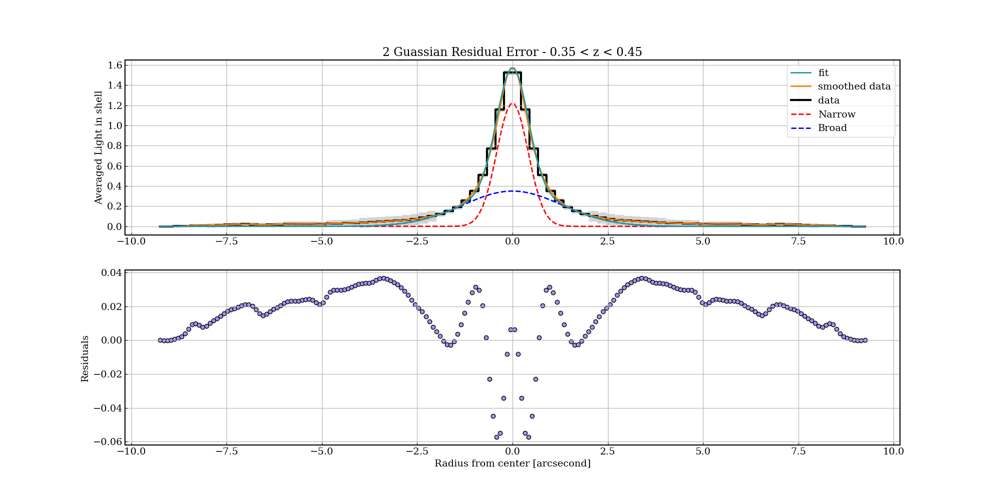

Amplitude Red = 1.2225556489554783 +0.015518459123510242 - 0.015045957840853497

Width Red = 0.4095711198218083 +0.0004040532556793819 - 0.0022645051128377114

Amplitude Blue = 0.34984736685148654 +0.0001442768059730648 - 0.0010585999428726622

Width Blue = 1.2994897041808209 +0.0004929244894054108 - 0.0036635884599658386


In [154]:
# 1. Generate or load data
x_Mirror_RE_035_045 = np.linspace(-84,84,84)

x_data_Mirror_RE_035_045 = np.multiply(x_Mirror_RE_035_045, 0.11)
y_data_Mirror_RE_035_045 = Mirrored_Radius_array_035_045

y_err_Mirror_RE_035_045 = New_Err_RMS_035_045 #1.0 #Mirrored_Radius_array_SDE_025_035[0:84]

initial_Mirror_RE_035_045 = np.array([0.6, 0.4, 0.1, 1.1]) #amp,wid ... red/narrow, blue/broad


Amplitude_Narrow_Red_Lower_Lim_Mirror_RE_035_045 = 0
Amplitude_Narrow_Red_Upperr_Lim_Mirror_RE_035_045 = 1.3

Width_Narrow_Red_Lower_Lim_Mirror_RE_035_045 = 0
Width_Narrow_Red_Upper_Lim_Mirror_RE_035_045 = 0.41


Amplitude_Broad_Blue_Lower_Lim_Mirror_RE_035_045 = 0
Amplitude_Broad_Blue_Upperr_Lim_Mirror_RE_035_045 = 0.35

Width_Broad_Blue_Lower_Lim_Mirror_RE_035_045 = 0
Width_Broad_Blue_Upper_Lim_Mirror_RE_035_045 = 1.3




# 2. Define the likelihood function ############################################################################################################################################
def log_likelihood(theta, x, y, yerr):
    amp1, wid1, amp2, wid2 = theta
    model = two_gaussian(x, amp1, wid1, amp2, wid2)
    sigma2 = yerr**2
    return -0.5 * np.sum((y - model)**2 / sigma2 + np.log(sigma2))

# 4. Define the prior (optional, but recommended) ############################################################################################################################################
#def log_prior(theta):
#    amp1, wid1, amp2, wid2 = theta
#    if not all(0 < param < 10 for param in [amp1, amp2, wid1, wid2]):
#        return -np.inf
#    return 0.0

def log_prior(theta):
    amp1, wid1, amp2, wid2 = theta
    if (Amplitude_Narrow_Red_Lower_Lim_Mirror_RE_035_045 < amp1 < Amplitude_Narrow_Red_Upperr_Lim_Mirror_RE_035_045 and Amplitude_Broad_Blue_Lower_Lim_Mirror_RE_035_045 < amp2 <  Amplitude_Broad_Blue_Upperr_Lim_Mirror_RE_035_045 and Width_Narrow_Red_Lower_Lim_Mirror_RE_035_045 < wid1 < Width_Narrow_Red_Upper_Lim_Mirror_RE_035_045 and Width_Broad_Blue_Lower_Lim_Mirror_RE_035_045 < wid2 <  Width_Broad_Blue_Upper_Lim_Mirror_RE_035_045):
        return 0.0
    return -np.inf

# 5. Define the probability function ############################################################################################################################################
def log_probability(theta, x, y, yerr):
    lp = log_prior(theta)
    if not np.isfinite(lp):
        return -np.inf
    return lp + log_likelihood(theta, x, y, yerr)

# 3. Optimization (finding a good starting point) ############################################################################################################################################

bounds_Mirror_RE_035_045 = [(Amplitude_Narrow_Red_Lower_Lim_Mirror_RE_035_045, Amplitude_Narrow_Red_Upperr_Lim_Mirror_RE_035_045), (Width_Narrow_Red_Lower_Lim_Mirror_RE_035_045, Width_Narrow_Red_Upper_Lim_Mirror_RE_035_045), (Amplitude_Broad_Blue_Lower_Lim_Mirror_RE_035_045, Amplitude_Broad_Blue_Upperr_Lim_Mirror_RE_035_045), (Width_Broad_Blue_Lower_Lim_Mirror_RE_035_045, Width_Broad_Blue_Upper_Lim_Mirror_RE_035_045)] # Parameter bounds for optimization
soln_Mirror_RE_035_045 = minimize(lambda *args: -log_likelihood(*args), initial_Mirror_RE_035_045, args=(x_data_Mirror_RE_035_045, y_data_Mirror_RE_035_045, y_err_Mirror_RE_035_045), bounds=bounds_Mirror_RE_035_045)

#soln = minimize(lambda *args: -log_likelihood(*args), initial, args=(x_data, y_data, y_err))
pos_Mirror_RE_035_045 = soln_Mirror_RE_035_045.x + 1e-4 * np.random.randn(32, len(soln_Mirror_RE_035_045.x))
nwalkers_Mirror_RE_035_045, ndim_Mirror_RE_035_045 = pos_Mirror_RE_035_045.shape


# 4. MCMC sampling ############################################################################################################################################
sampler_Mirror_RE_035_045 = emcee.EnsembleSampler(nwalkers_Mirror_RE_035_045, ndim_Mirror_RE_035_045, log_probability, args=(x_data_Mirror_RE_035_045, y_data_Mirror_RE_035_045, y_err_Mirror_RE_035_045))
sampler_Mirror_RE_035_045.run_mcmc(pos_Mirror_RE_035_045, 5000, progress=True)

# 5. Analyze results
samples_Mirror_RE_035_045 = sampler_Mirror_RE_035_045.get_chain(flat=True)

# 6. Best fit parameters ############################################################################################################################################
best_fit_params_Mirror_RE_035_045 = []
for i in range(ndim_Mirror_RE_035_045):
    mcmc_Mirror_RE_035_045 = np.percentile(samples_Mirror_RE_035_045[:, i], [68, 95, 99.7])
    best_fit_params_Mirror_RE_035_045.append(mcmc_Mirror_RE_035_045[1])

# 10. Error estimation ############################################################################################################################################
errors_Mirror_RE_035_045 = []
for i in range(ndim_Mirror_RE_035_045):
     mcmc_Mirror_RE_035_045 = np.percentile(samples_Mirror_RE_035_045[:, i], [68, 95, 99.7])
     errors_Mirror_RE_035_045.append([mcmc_Mirror_RE_035_045[2]-mcmc_Mirror_RE_035_045[1],mcmc_Mirror_RE_035_045[1]-mcmc_Mirror_RE_035_045[0]])

# 11. Getting the RMS Values ############################################################################################################################################
x_new_Mirror_RE_035_045 = np.linspace(min(x_data_Mirror_RE_035_045),max(x_data_Mirror_RE_035_045), 200)

y_new_Mirror_RE_035_045 = CubicSpline(x_data_Mirror_RE_035_045, y_data_Mirror_RE_035_045)

yy_new_Mirror_RE_035_045 = y_new_Mirror_RE_035_045(x_new_Mirror_RE_035_045)

x_plot_Mirror_RE_035_045 = np.linspace(min(x_data_Mirror_RE_035_045), max(x_data_Mirror_RE_035_045), 200)
     
# 12. Plot results ############################################################################################################################################
fig = plt.figure(figsize = (20, 10),  facecolor = "white")
ax = plt.subplot(2,1,1)

plt.plot(x_plot_Mirror_RE_035_045, two_gaussian(x_plot_Mirror_RE_035_045, *best_fit_params_Mirror_RE_035_045), color = "#219B9D", linewidth=2.0, label="fit", zorder=10)
plt.plot(x_new_Mirror_RE_035_045, yy_new_Mirror_RE_035_045, color = "#FF8000", linewidth=2.0, label="smoothed data")
plt.step(x_data_Mirror_RE_035_045, y_data_Mirror_RE_035_045, color = "black", linewidth=3.0, where="mid", zorder=1, label="data")

plt.plot(x_plot_Mirror_RE_035_045, gaussian(x_plot_Mirror_RE_035_045, best_fit_params_Mirror_RE_035_045[0], best_fit_params_Mirror_RE_035_045[1]), color="red", linestyle="--", label="Narrow")
plt.plot(x_plot_Mirror_RE_035_045, gaussian(x_plot_Mirror_RE_035_045, best_fit_params_Mirror_RE_035_045[2], best_fit_params_Mirror_RE_035_045[3]), color="blue", linestyle="--", label="Broad")

plt.fill_between(x_data_Mirror_RE_035_045, y_data_Mirror_RE_035_045 - y_err_Mirror_RE_035_045, y_data_Mirror_RE_035_045 + y_err_Mirror_RE_035_045, step="mid", color = "lightgrey", zorder=0)

plt.legend()

ax1 = plt.subplot(2,1,2)

ax1.scatter(x_new_Mirror_RE_035_045, yy_new_Mirror_RE_035_045 - two_gaussian(x_plot_Mirror_RE_035_045, *best_fit_params_Mirror_RE_035_045), c = "#A294F9", edgecolor="black") 

ax.set_title("2 Guassian Residual Error - 0.35 < z < 0.45")

ax1.set_xlabel("Radius from center [arcsecond]")

ax.set_ylabel("Averaged Light in shell")
ax1.set_ylabel("Residuals")

ax.grid()
ax1.grid()

# Show the plot
plt.show(block=False)

# Close the figure

############################################################################################################################################
Best_Fit_Mirrored_RE_035_045 = yy_new_Mirror_RE_035_045
Best_Fit_Mirrored_Fit_X_Array_RE_035_045 = x_new_Mirror_RE_035_045

Narrow_Amplitude_Fit_Mirrored_RE_035_045 = best_fit_params_Mirror_RE_035_045[0]
Narrow_Amplitude_Fit_Mirrored_Error_P_RE_035_045 = errors_Mirror_RE_035_045[0][0]
Narrow_Amplitude_Fit_Mirrored_Error_M_RE_035_045 = errors_Mirror_RE_035_045[0][1]
Narrow_Width_Fit_Mirrored_RE_035_045 = best_fit_params_Mirror_RE_035_045[1]
Narrow_Width_Fit_Mirrored_Error_P_RE_035_045 = errors_Mirror_RE_035_045[1][0]
Narrow_Width_Fit_Mirrored_Error_M_RE_035_045 = errors_Mirror_RE_035_045[1][1]

Broad_Amplitude_Fit_Mirrored_RE_035_045 = best_fit_params_Mirror_RE_035_045[2]
Broad_Amplitude_Fit_Mirrored_Error_P_RE_035_045 = errors_Mirror_RE_035_045[2][0]
Broad_Amplitude_Fit_Mirrored_Error_M_RE_035_045 = errors_Mirror_RE_035_045[2][1]
Broad_Width_Fit_Mirrored_RE_035_045 = best_fit_params_Mirror_RE_035_045[3]
Broad_Width_Fit_Mirrored_Error_P_RE_035_045 = errors_Mirror_RE_035_045[3][0]
Broad_Width_Fit_Mirrored_Error_M_RE_035_045 = errors_Mirror_RE_035_045[3][1]

Best_Fit_Mirrored_Fit_Residuals_RE_035_045 = yy_new_Mirror_RE_035_045 - two_gaussian(x_plot_Mirror_RE_035_045, *best_fit_params_Mirror_RE_035_045)
Gaussian_Fit_Mirrored_X_Array_RE_035_045 = x_plot_Mirror_RE_035_045

############################################################################################################################################
print("Amplitude Red = " +str(best_fit_params_Mirror_RE_035_045[0]) + " +" +str(errors_Mirror_RE_035_045[0][0]) + " - " +str(errors_Mirror_RE_035_045[0][1]))
print("")
print("Width Red = " +str(best_fit_params_Mirror_RE_035_045[1]) + " +" +str(errors_Mirror_RE_035_045[1][0]) + " - " +str(errors_Mirror_RE_035_045[1][1]))
print("")
print("Amplitude Blue = " +str(best_fit_params_Mirror_RE_035_045[2]) + " +" +str(errors_Mirror_RE_035_045[2][0]) + " - " +str(errors_Mirror_RE_035_045[2][1]))
print("")
print("Width Blue = " +str(best_fit_params_Mirror_RE_035_045[3]) + " +" +str(errors_Mirror_RE_035_045[3][0]) + " - " +str(errors_Mirror_RE_035_045[3][1]))

100%|██████████| 5000/5000 [00:07<00:00, 659.97it/s]


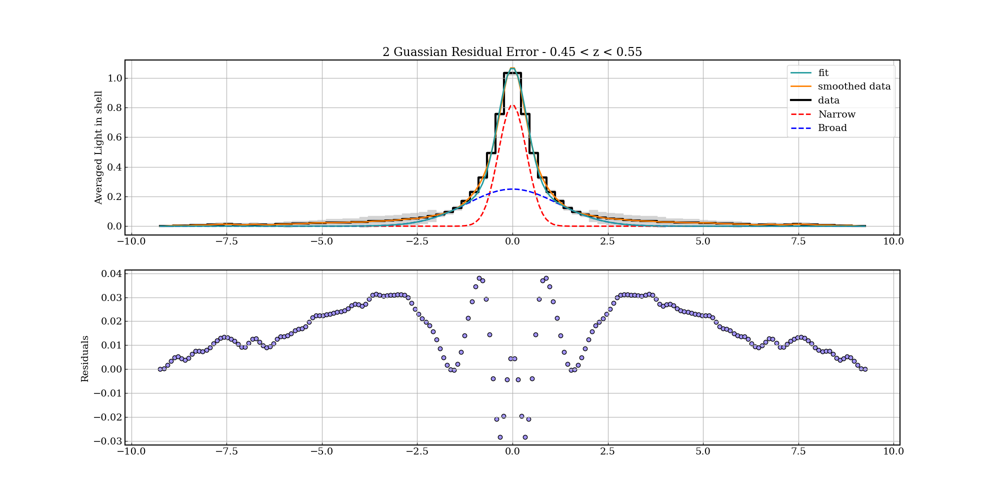

Amplitude Red = 0.8187748793308891 +0.0011415077132527207 - 0.0046072010026299015

Width Red = 0.3699328313820234 +6.528836811459104e-05 - 0.00042015124151961736

Amplitude Blue = 0.24994632606623923 +5.1841443398592535e-05 - 0.0003628816226944609

Width Blue = 1.1997104608891402 +0.00027624670440529187 - 0.002155377527811364


In [155]:
# 1. Generate or load data
x_Mirror_RE_045_055 = np.linspace(-84,84,84)

x_data_Mirror_RE_045_055 = np.multiply(x_Mirror_RE_045_055, 0.11)
y_data_Mirror_RE_045_055 = Mirrored_Radius_array_045_055

y_err_Mirror_RE_045_055 = New_Err_RMS_045_055 #1.0 #Mirrored_Radius_array_SDE_025_035[0:84]

initial_Mirror_RE_045_055 = np.array([0.6, 0.4, 0.1, 1.1]) #amp,wid ... red/narrow, blue/broad


Amplitude_Narrow_Red_Lower_Lim_Mirror_RE_045_055 = 0
Amplitude_Narrow_Red_Upperr_Lim_Mirror_RE_045_055 = 0.82

Width_Narrow_Red_Lower_Lim_Mirror_RE_045_055 = 0
Width_Narrow_Red_Upper_Lim_Mirror_RE_045_055 = 0.37


Amplitude_Broad_Blue_Lower_Lim_Mirror_RE_045_055 = 0
Amplitude_Broad_Blue_Upperr_Lim_Mirror_RE_045_055 = 0.25

Width_Broad_Blue_Lower_Lim_Mirror_RE_045_055 = 0
Width_Broad_Blue_Upper_Lim_Mirror_RE_045_055 = 1.2




# 2. Define the likelihood function ############################################################################################################################################
def log_likelihood(theta, x, y, yerr):
    amp1, wid1, amp2, wid2 = theta
    model = two_gaussian(x, amp1, wid1, amp2, wid2)
    sigma2 = yerr**2
    return -0.5 * np.sum((y - model)**2 / sigma2 + np.log(sigma2))

# 4. Define the prior (optional, but recommended) ############################################################################################################################################
#def log_prior(theta):
#    amp1, wid1, amp2, wid2 = theta
#    if not all(0 < param < 10 for param in [amp1, amp2, wid1, wid2]):
#        return -np.inf
#    return 0.0

def log_prior(theta):
    amp1, wid1, amp2, wid2 = theta
    if (Amplitude_Narrow_Red_Lower_Lim_Mirror_RE_045_055 < amp1 < Amplitude_Narrow_Red_Upperr_Lim_Mirror_RE_045_055 and Amplitude_Broad_Blue_Lower_Lim_Mirror_RE_045_055 < amp2 <  Amplitude_Broad_Blue_Upperr_Lim_Mirror_RE_045_055 and Width_Narrow_Red_Lower_Lim_Mirror_RE_045_055 < wid1 < Width_Narrow_Red_Upper_Lim_Mirror_RE_045_055 and Width_Broad_Blue_Lower_Lim_Mirror_RE_045_055 < wid2 <  Width_Broad_Blue_Upper_Lim_Mirror_RE_045_055):
        return 0.0
    return -np.inf

# 5. Define the probability function ############################################################################################################################################
def log_probability(theta, x, y, yerr):
    lp = log_prior(theta)
    if not np.isfinite(lp):
        return -np.inf
    return lp + log_likelihood(theta, x, y, yerr)

# 3. Optimization (finding a good starting point) ############################################################################################################################################

bounds_Mirror_RE_045_055 = [(Amplitude_Narrow_Red_Lower_Lim_Mirror_RE_045_055, Amplitude_Narrow_Red_Upperr_Lim_Mirror_RE_045_055), (Width_Narrow_Red_Lower_Lim_Mirror_RE_045_055, Width_Narrow_Red_Upper_Lim_Mirror_RE_045_055), (Amplitude_Broad_Blue_Lower_Lim_Mirror_RE_045_055, Amplitude_Broad_Blue_Upperr_Lim_Mirror_RE_045_055), (Width_Broad_Blue_Lower_Lim_Mirror_RE_045_055, Width_Broad_Blue_Upper_Lim_Mirror_RE_045_055)] # Parameter bounds for optimization
soln_Mirror_RE_045_055 = minimize(lambda *args: -log_likelihood(*args), initial_Mirror_RE_045_055, args=(x_data_Mirror_RE_045_055, y_data_Mirror_RE_045_055, y_err_Mirror_RE_045_055), bounds=bounds_Mirror_RE_045_055)

#soln = minimize(lambda *args: -log_likelihood(*args), initial, args=(x_data, y_data, y_err))
pos_Mirror_RE_045_055 = soln_Mirror_RE_045_055.x + 1e-4 * np.random.randn(32, len(soln_Mirror_RE_045_055.x))
nwalkers_Mirror_RE_045_055, ndim_Mirror_RE_045_055 = pos_Mirror_RE_045_055.shape


# 4. MCMC sampling ############################################################################################################################################
sampler_Mirror_RE_045_055 = emcee.EnsembleSampler(nwalkers_Mirror_RE_045_055, ndim_Mirror_RE_045_055, log_probability, args=(x_data_Mirror_RE_045_055, y_data_Mirror_RE_045_055, y_err_Mirror_RE_045_055))
sampler_Mirror_RE_045_055.run_mcmc(pos_Mirror_RE_045_055, 5000, progress=True)

# 5. Analyze results
samples_Mirror_RE_045_055 = sampler_Mirror_RE_045_055.get_chain(flat=True)

# 6. Best fit parameters ############################################################################################################################################
best_fit_params_Mirror_RE_045_055 = []
for i in range(ndim_Mirror_RE_045_055):
    mcmc_Mirror_RE_045_055 = np.percentile(samples_Mirror_RE_045_055[:, i], [68, 95, 99.7])
    best_fit_params_Mirror_RE_045_055.append(mcmc_Mirror_RE_045_055[1])

# 10. Error estimation ############################################################################################################################################
errors_Mirror_RE_045_055 = []
for i in range(ndim_Mirror_RE_045_055):
     mcmc_Mirror_RE_045_055 = np.percentile(samples_Mirror_RE_045_055[:, i], [68, 95, 99.7])
     errors_Mirror_RE_045_055.append([mcmc_Mirror_RE_045_055[2]-mcmc_Mirror_RE_045_055[1],mcmc_Mirror_RE_045_055[1]-mcmc_Mirror_RE_045_055[0]])

# 11. Getting the RMS Values ############################################################################################################################################
x_new_Mirror_RE_045_055 = np.linspace(min(x_data_Mirror_RE_045_055),max(x_data_Mirror_RE_045_055), 200)

y_new_Mirror_RE_045_055 = CubicSpline(x_data_Mirror_RE_045_055, y_data_Mirror_RE_045_055)

yy_new_Mirror_RE_045_055 = y_new_Mirror_RE_045_055(x_new_Mirror_RE_045_055)

x_plot_Mirror_RE_045_055 = np.linspace(min(x_data_Mirror_RE_045_055), max(x_data_Mirror_RE_045_055), 200)
     
# 12. Plot results ############################################################################################################################################
fig = plt.figure(figsize = (20, 10),  facecolor = "white")
ax = plt.subplot(2,1,1)

plt.plot(x_plot_Mirror_RE_045_055, two_gaussian(x_plot_Mirror_RE_045_055, *best_fit_params_Mirror_RE_045_055), color = "#219B9D", linewidth=2.0, label="fit", zorder=10)
plt.plot(x_new_Mirror_RE_045_055, yy_new_Mirror_RE_045_055, color = "#FF8000", linewidth=2.0, label="smoothed data")
plt.step(x_data_Mirror_RE_045_055, y_data_Mirror_RE_045_055, color = "black", linewidth=3.0, where="mid", zorder=1, label="data")

plt.plot(x_plot_Mirror_RE_045_055, gaussian(x_plot_Mirror_RE_045_055, best_fit_params_Mirror_RE_045_055[0], best_fit_params_Mirror_RE_045_055[1]), color="red", linestyle="--", label="Narrow")
plt.plot(x_plot_Mirror_RE_045_055, gaussian(x_plot_Mirror_RE_045_055, best_fit_params_Mirror_RE_045_055[2], best_fit_params_Mirror_RE_045_055[3]), color="blue", linestyle="--", label="Broad")

plt.fill_between(x_data_Mirror_RE_045_055, y_data_Mirror_RE_045_055 - y_err_Mirror_RE_045_055, y_data_Mirror_RE_045_055 + y_err_Mirror_RE_045_055, step="mid", color = "lightgrey", zorder=0)

plt.legend()

ax1 = plt.subplot(2,1,2)

ax1.scatter(x_new_Mirror_RE_045_055, yy_new_Mirror_RE_045_055 - two_gaussian(x_plot_Mirror_RE_045_055, *best_fit_params_Mirror_RE_045_055), c = "#A294F9", edgecolor="black") 

ax.set_title("2 Guassian Residual Error - 0.45 < z < 0.55")

ax.set_ylabel("Averaged Light in shell")
ax1.set_ylabel("Residuals")

ax.grid()
ax1.grid()

# Show the plot
plt.show(block=False)

# Close the figure

############################################################################################################################################
Best_Fit_Mirrored_RE_045_055 = yy_new_Mirror_RE_045_055
Best_Fit_Mirrored_Fit_X_Array_RE_045_055 = x_new_Mirror_RE_045_055

Narrow_Amplitude_Fit_Mirrored_RE_045_055 = best_fit_params_Mirror_RE_045_055[0]
Narrow_Amplitude_Fit_Mirrored_Error_P_RE_045_055 = errors_Mirror_RE_045_055[0][0]
Narrow_Amplitude_Fit_Mirrored_Error_M_RE_045_055 = errors_Mirror_RE_045_055[0][1]
Narrow_Width_Fit_Mirrored_RE_045_055 = best_fit_params_Mirror_RE_045_055[1]
Narrow_Width_Fit_Mirrored_Error_P_RE_045_055 = errors_Mirror_RE_045_055[1][0]
Narrow_Width_Fit_Mirrored_Error_M_RE_045_055 = errors_Mirror_RE_045_055[1][1]

Broad_Amplitude_Fit_Mirrored_RE_045_055 = best_fit_params_Mirror_RE_045_055[2]
Broad_Amplitude_Fit_Mirrored_Error_P_RE_045_055 = errors_Mirror_RE_045_055[2][0]
Broad_Amplitude_Fit_Mirrored_Error_M_RE_045_055 = errors_Mirror_RE_045_055[2][1]
Broad_Width_Fit_Mirrored_RE_045_055 = best_fit_params_Mirror_RE_045_055[3]
Broad_Width_Fit_Mirrored_Error_P_RE_045_055 = errors_Mirror_RE_045_055[3][0]
Broad_Width_Fit_Mirrored_Error_M_RE_045_055 = errors_Mirror_RE_045_055[3][1]

Best_Fit_Mirrored_Fit_Residuals_RE_045_055 = yy_new_Mirror_RE_045_055 - two_gaussian(x_plot_Mirror_RE_045_055, *best_fit_params_Mirror_RE_045_055)
Gaussian_Fit_Mirrored_X_Array_RE_045_055 = x_plot_Mirror_RE_045_055

############################################################################################################################################
print("Amplitude Red = " +str(best_fit_params_Mirror_RE_045_055[0]) + " +" +str(errors_Mirror_RE_045_055[0][0]) + " - " +str(errors_Mirror_RE_045_055[0][1]))
print("")
print("Width Red = " +str(best_fit_params_Mirror_RE_045_055[1]) + " +" +str(errors_Mirror_RE_045_055[1][0]) + " - " +str(errors_Mirror_RE_045_055[1][1]))
print("")
print("Amplitude Blue = " +str(best_fit_params_Mirror_RE_045_055[2]) + " +" +str(errors_Mirror_RE_045_055[2][0]) + " - " +str(errors_Mirror_RE_045_055[2][1]))
print("")
print("Width Blue = " +str(best_fit_params_Mirror_RE_045_055[3]) + " +" +str(errors_Mirror_RE_045_055[3][0]) + " - " +str(errors_Mirror_RE_045_055[3][1]))

100%|██████████| 5000/5000 [00:08<00:00, 623.79it/s]


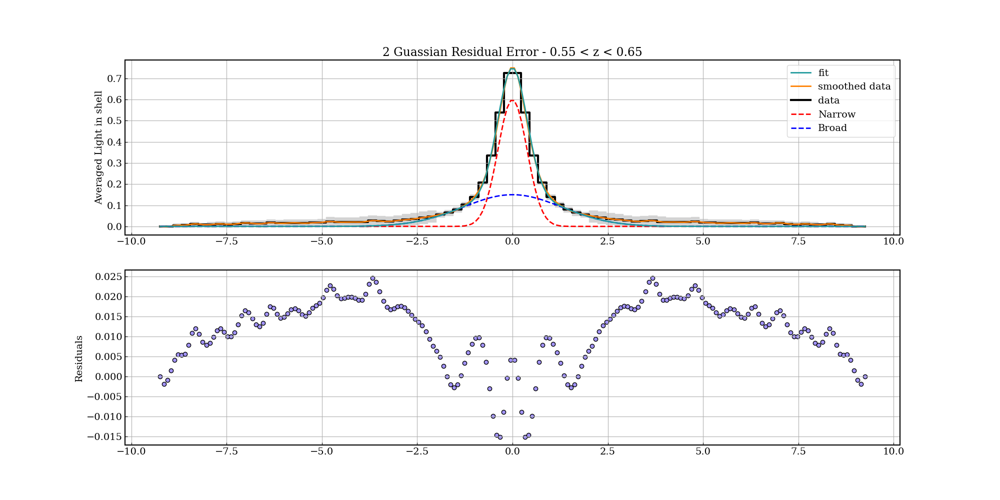

Amplitude Red = 0.5995505347620923 +0.002566895930557589 - 0.0026146736294826445

Width Red = 0.3808948897066505 +0.001929448831120506 - 0.0019996888134763413

Amplitude Blue = 0.14996529736267172 +3.322296939256564e-05 - 0.00023946034060243204

Width Blue = 1.2995717804992049 +0.00040952911819380766 - 0.0029479614323431047


In [156]:
# 1. Generate or load data
x_Mirror_RE_055_065 = np.linspace(-84,84,84)

x_data_Mirror_RE_055_065 = np.multiply(x_Mirror_RE_055_065, 0.11)
y_data_Mirror_RE_055_065 = Mirrored_Radius_array_055_065

y_err_Mirror_RE_055_065 = New_Err_RMS_055_065 #1.0 #Mirrored_Radius_array_SDE_025_035[0:84]

initial_Mirror_RE_055_065 = np.array([0.6, 0.4, 0.1, 1.1]) #amp,wid ... red/narrow, blue/broad


Amplitude_Narrow_Red_Lower_Lim_Mirror_RE_055_065 = 0
Amplitude_Narrow_Red_Upperr_Lim_Mirror_RE_055_065 = 0.7

Width_Narrow_Red_Lower_Lim_Mirror_RE_055_065 = 0
Width_Narrow_Red_Upper_Lim_Mirror_RE_055_065 = 0.5


Amplitude_Broad_Blue_Lower_Lim_Mirror_RE_055_065 = 0
Amplitude_Broad_Blue_Upperr_Lim_Mirror_RE_055_065 = 0.15

Width_Broad_Blue_Lower_Lim_Mirror_RE_055_065 = 0
Width_Broad_Blue_Upper_Lim_Mirror_RE_055_065 = 1.3




# 2. Define the likelihood function ############################################################################################################################################
def log_likelihood(theta, x, y, yerr):
    amp1, wid1, amp2, wid2 = theta
    model = two_gaussian(x, amp1, wid1, amp2, wid2)
    sigma2 = yerr**2
    return -0.5 * np.sum((y - model)**2 / sigma2 + np.log(sigma2))

# 4. Define the prior (optional, but recommended) ############################################################################################################################################
#def log_prior(theta):
#    amp1, wid1, amp2, wid2 = theta
#    if not all(0 < param < 10 for param in [amp1, amp2, wid1, wid2]):
#        return -np.inf
#    return 0.0

def log_prior(theta):
    amp1, wid1, amp2, wid2 = theta
    if (Amplitude_Narrow_Red_Lower_Lim_Mirror_RE_055_065 < amp1 < Amplitude_Narrow_Red_Upperr_Lim_Mirror_RE_055_065 and Amplitude_Broad_Blue_Lower_Lim_Mirror_RE_055_065 < amp2 <  Amplitude_Broad_Blue_Upperr_Lim_Mirror_RE_055_065 and Width_Narrow_Red_Lower_Lim_Mirror_RE_055_065 < wid1 < Width_Narrow_Red_Upper_Lim_Mirror_RE_055_065 and Width_Broad_Blue_Lower_Lim_Mirror_RE_055_065 < wid2 <  Width_Broad_Blue_Upper_Lim_Mirror_RE_055_065):
        return 0.0
    return -np.inf

# 5. Define the probability function ############################################################################################################################################
def log_probability(theta, x, y, yerr):
    lp = log_prior(theta)
    if not np.isfinite(lp):
        return -np.inf
    return lp + log_likelihood(theta, x, y, yerr)

# 3. Optimization (finding a good starting point) ############################################################################################################################################

bounds_Mirror_RE_055_065 = [(Amplitude_Narrow_Red_Lower_Lim_Mirror_RE_055_065, Amplitude_Narrow_Red_Upperr_Lim_Mirror_RE_055_065), (Width_Narrow_Red_Lower_Lim_Mirror_RE_055_065, Width_Narrow_Red_Upper_Lim_Mirror_RE_055_065), (Amplitude_Broad_Blue_Lower_Lim_Mirror_RE_055_065, Amplitude_Broad_Blue_Upperr_Lim_Mirror_RE_055_065), (Width_Broad_Blue_Lower_Lim_Mirror_RE_055_065, Width_Broad_Blue_Upper_Lim_Mirror_RE_055_065)] # Parameter bounds for optimization
soln_Mirror_RE_055_065 = minimize(lambda *args: -log_likelihood(*args), initial_Mirror_RE_055_065, args=(x_data_Mirror_RE_055_065, y_data_Mirror_RE_055_065, y_err_Mirror_RE_055_065), bounds=bounds_Mirror_RE_055_065)

#soln = minimize(lambda *args: -log_likelihood(*args), initial, args=(x_data, y_data, y_err))
pos_Mirror_RE_055_065 = soln_Mirror_RE_055_065.x + 1e-4 * np.random.randn(32, len(soln_Mirror_RE_055_065.x))
nwalkers_Mirror_RE_055_065, ndim_Mirror_RE_055_065 = pos_Mirror_RE_055_065.shape


# 4. MCMC sampling ############################################################################################################################################
sampler_Mirror_RE_055_065 = emcee.EnsembleSampler(nwalkers_Mirror_RE_055_065, ndim_Mirror_RE_055_065, log_probability, args=(x_data_Mirror_RE_055_065, y_data_Mirror_RE_055_065, y_err_Mirror_RE_055_065))
sampler_Mirror_RE_055_065.run_mcmc(pos_Mirror_RE_055_065, 5000, progress=True)

# 5. Analyze results
samples_Mirror_RE_055_065 = sampler_Mirror_RE_055_065.get_chain(flat=True)

# 6. Best fit parameters ############################################################################################################################################
best_fit_params_Mirror_RE_055_065 = []
for i in range(ndim_Mirror_RE_055_065):
    mcmc_Mirror_RE_055_065 = np.percentile(samples_Mirror_RE_055_065[:, i], [68, 95, 99.7])
    best_fit_params_Mirror_RE_055_065.append(mcmc_Mirror_RE_055_065[1])

# 10. Error estimation ############################################################################################################################################
errors_Mirror_RE_055_065 = []
for i in range(ndim_Mirror_RE_055_065):
     mcmc_Mirror_RE_055_065 = np.percentile(samples_Mirror_RE_055_065[:, i], [68, 95, 99.7])
     errors_Mirror_RE_055_065.append([mcmc_Mirror_RE_055_065[2]-mcmc_Mirror_RE_055_065[1],mcmc_Mirror_RE_055_065[1]-mcmc_Mirror_RE_055_065[0]])

# 11. Getting the RMS Values ############################################################################################################################################
x_new_Mirror_RE_055_065 = np.linspace(min(x_data_Mirror_RE_055_065),max(x_data_Mirror_RE_055_065), 200)

y_new_Mirror_RE_055_065 = CubicSpline(x_data_Mirror_RE_055_065, y_data_Mirror_RE_055_065)

yy_new_Mirror_RE_055_065 = y_new_Mirror_RE_055_065(x_new_Mirror_RE_055_065)

x_plot_Mirror_RE_055_065 = np.linspace(min(x_data_Mirror_RE_055_065), max(x_data_Mirror_RE_055_065), 200)
     
# 12. Plot results ############################################################################################################################################
fig = plt.figure(figsize = (20, 10),  facecolor = "white")
ax = plt.subplot(2,1,1)

plt.plot(x_plot_Mirror_RE_055_065, two_gaussian(x_plot_Mirror_RE_055_065, *best_fit_params_Mirror_RE_055_065), color = "#219B9D", linewidth=2.0, label="fit", zorder=10)
plt.plot(x_new_Mirror_RE_055_065, yy_new_Mirror_RE_055_065, color = "#FF8000", linewidth=2.0, label="smoothed data")
plt.step(x_data_Mirror_RE_055_065, y_data_Mirror_RE_055_065, color = "black", linewidth=3.0, where="mid", zorder=1, label="data")

plt.plot(x_plot_Mirror_RE_055_065, gaussian(x_plot_Mirror_RE_055_065, best_fit_params_Mirror_RE_055_065[0], best_fit_params_Mirror_RE_055_065[1]), color="red", linestyle="--", label="Narrow")
plt.plot(x_plot_Mirror_RE_055_065, gaussian(x_plot_Mirror_RE_055_065, best_fit_params_Mirror_RE_055_065[2], best_fit_params_Mirror_RE_055_065[3]), color="blue", linestyle="--", label="Broad")

plt.fill_between(x_data_Mirror_RE_055_065, y_data_Mirror_RE_055_065 - y_err_Mirror_RE_055_065, y_data_Mirror_RE_055_065 + y_err_Mirror_RE_055_065, step="mid", color = "lightgrey", zorder=0)

plt.legend()

ax1 = plt.subplot(2,1,2)

ax1.scatter(x_new_Mirror_RE_055_065, yy_new_Mirror_RE_055_065 - two_gaussian(x_plot_Mirror_RE_055_065, *best_fit_params_Mirror_RE_055_065), c = "#A294F9", edgecolor="black") 

ax.set_title("2 Guassian Residual Error - 0.55 < z < 0.65")

ax.set_ylabel("Averaged Light in shell")
ax1.set_ylabel("Residuals")

ax.grid()
ax1.grid()

# Show the plot
plt.show(block=False)

# Close the figure

############################################################################################################################################
Best_Fit_Mirrored_RE_055_065 = yy_new_Mirror_RE_055_065
Best_Fit_Mirrored_Fit_X_Array_RE_055_065 = x_new_Mirror_RE_055_065

Narrow_Amplitude_Fit_Mirrored_RE_055_065 = best_fit_params_Mirror_RE_055_065[0]
Narrow_Amplitude_Fit_Mirrored_Error_P_RE_055_065 = errors_Mirror_RE_055_065[0][0]
Narrow_Amplitude_Fit_Mirrored_Error_M_RE_055_065 = errors_Mirror_RE_055_065[0][1]
Narrow_Width_Fit_Mirrored_RE_055_065 = best_fit_params_Mirror_RE_055_065[1]
Narrow_Width_Fit_Mirrored_Error_P_RE_055_065 = errors_Mirror_RE_055_065[1][0]
Narrow_Width_Fit_Mirrored_Error_M_RE_055_065 = errors_Mirror_RE_055_065[1][1]

Broad_Amplitude_Fit_Mirrored_RE_055_065 = best_fit_params_Mirror_RE_055_065[2]
Broad_Amplitude_Fit_Mirrored_Error_P_RE_055_065 = errors_Mirror_RE_055_065[2][0]
Broad_Amplitude_Fit_Mirrored_Error_M_RE_055_065 = errors_Mirror_RE_055_065[2][1]
Broad_Width_Fit_Mirrored_RE_055_065 = best_fit_params_Mirror_RE_055_065[3]
Broad_Width_Fit_Mirrored_Error_P_RE_055_065 = errors_Mirror_RE_055_065[3][0]
Broad_Width_Fit_Mirrored_Error_M_RE_055_065 = errors_Mirror_RE_055_065[3][1]

Best_Fit_Mirrored_Fit_Residuals_RE_055_065 = yy_new_Mirror_RE_055_065 - two_gaussian(x_plot_Mirror_RE_055_065, *best_fit_params_Mirror_RE_055_065)
Gaussian_Fit_Mirrored_X_Array_RE_055_065 = x_plot_Mirror_RE_055_065

############################################################################################################################################
print("Amplitude Red = " +str(best_fit_params_Mirror_RE_055_065[0]) + " +" +str(errors_Mirror_RE_055_065[0][0]) + " - " +str(errors_Mirror_RE_055_065[0][1]))
print("")
print("Width Red = " +str(best_fit_params_Mirror_RE_055_065[1]) + " +" +str(errors_Mirror_RE_055_065[1][0]) + " - " +str(errors_Mirror_RE_055_065[1][1]))
print("")
print("Amplitude Blue = " +str(best_fit_params_Mirror_RE_055_065[2]) + " +" +str(errors_Mirror_RE_055_065[2][0]) + " - " +str(errors_Mirror_RE_055_065[2][1]))
print("")
print("Width Blue = " +str(best_fit_params_Mirror_RE_055_065[3]) + " +" +str(errors_Mirror_RE_055_065[3][0]) + " - " +str(errors_Mirror_RE_055_065[3][1]))

100%|██████████| 5000/5000 [00:07<00:00, 679.72it/s]


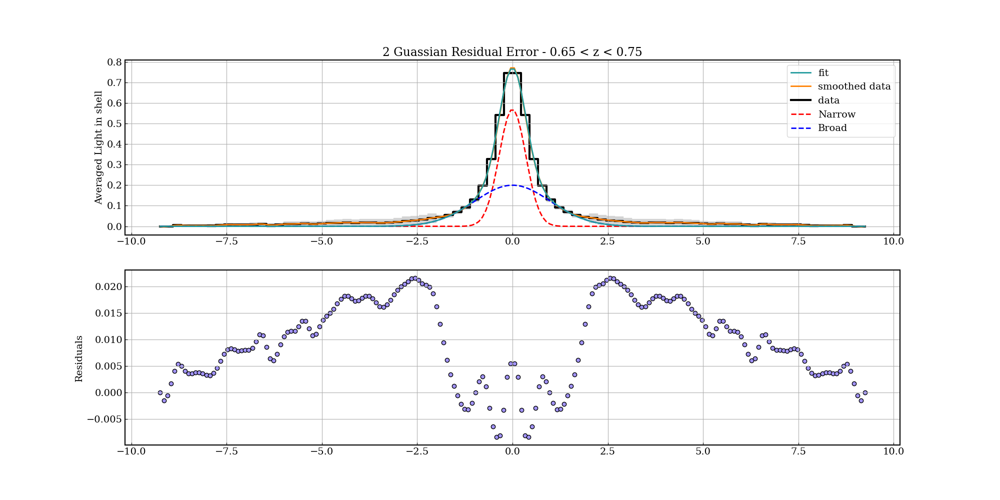

Amplitude Red = 0.5699155927605908 +8.193541573076057e-05 - 0.0005407490950734006

Width Red = 0.3494010009501066 +0.0005579303413816294 - 0.0017352749603434248

Amplitude Blue = 0.19995336595258598 +4.570227679409622e-05 - 0.00030829538702265014

Width Blue = 0.9997190061581136 +0.0002783679455889976 - 0.002066857017361756


In [157]:
# 1. Generate or load data
x_Mirror_RE_065_075 = np.linspace(-84,84,84)

x_data_Mirror_RE_065_075 = np.multiply(x_Mirror_RE_065_075, 0.11)
y_data_Mirror_RE_065_075 = Mirrored_Radius_array_065_075

y_err_Mirror_RE_065_075 = New_Err_RMS_065_075 #1.0 #Mirrored_Radius_array_SDE_025_035[0:84]

initial_Mirror_RE_065_075 = np.array([0.6, 0.4, 0.1, 1.1]) #amp,wid ... red/narrow, blue/broad


Amplitude_Narrow_Red_Lower_Lim_Mirror_RE_065_075 = 0
Amplitude_Narrow_Red_Upperr_Lim_Mirror_RE_065_075 = 0.57

Width_Narrow_Red_Lower_Lim_Mirror_RE_065_075 = 0
Width_Narrow_Red_Upper_Lim_Mirror_RE_065_075 = 0.35


Amplitude_Broad_Blue_Lower_Lim_Mirror_RE_065_075 = 0
Amplitude_Broad_Blue_Upperr_Lim_Mirror_RE_065_075 = 0.20

Width_Broad_Blue_Lower_Lim_Mirror_RE_065_075 = 0
Width_Broad_Blue_Upper_Lim_Mirror_RE_065_075 = 1.0




# 2. Define the likelihood function ############################################################################################################################################
def log_likelihood(theta, x, y, yerr):
    amp1, wid1, amp2, wid2 = theta
    model = two_gaussian(x, amp1, wid1, amp2, wid2)
    sigma2 = yerr**2
    return -0.5 * np.sum((y - model)**2 / sigma2 + np.log(sigma2))

# 4. Define the prior (optional, but recommended) ############################################################################################################################################
#def log_prior(theta):
#    amp1, wid1, amp2, wid2 = theta
#    if not all(0 < param < 10 for param in [amp1, amp2, wid1, wid2]):
#        return -np.inf
#    return 0.0

def log_prior(theta):
    amp1, wid1, amp2, wid2 = theta
    if (Amplitude_Narrow_Red_Lower_Lim_Mirror_RE_065_075 < amp1 < Amplitude_Narrow_Red_Upperr_Lim_Mirror_RE_065_075 and Amplitude_Broad_Blue_Lower_Lim_Mirror_RE_065_075 < amp2 <  Amplitude_Broad_Blue_Upperr_Lim_Mirror_RE_065_075 and Width_Narrow_Red_Lower_Lim_Mirror_RE_065_075 < wid1 < Width_Narrow_Red_Upper_Lim_Mirror_RE_065_075 and Width_Broad_Blue_Lower_Lim_Mirror_RE_065_075 < wid2 <  Width_Broad_Blue_Upper_Lim_Mirror_RE_065_075):
        return 0.0
    return -np.inf

# 5. Define the probability function ############################################################################################################################################
def log_probability(theta, x, y, yerr):
    lp = log_prior(theta)
    if not np.isfinite(lp):
        return -np.inf
    return lp + log_likelihood(theta, x, y, yerr)

# 3. Optimization (finding a good starting point) ############################################################################################################################################

bounds_Mirror_RE_065_075 = [(Amplitude_Narrow_Red_Lower_Lim_Mirror_RE_065_075, Amplitude_Narrow_Red_Upperr_Lim_Mirror_RE_065_075), (Width_Narrow_Red_Lower_Lim_Mirror_RE_065_075, Width_Narrow_Red_Upper_Lim_Mirror_RE_065_075), (Amplitude_Broad_Blue_Lower_Lim_Mirror_RE_065_075, Amplitude_Broad_Blue_Upperr_Lim_Mirror_RE_065_075), (Width_Broad_Blue_Lower_Lim_Mirror_RE_065_075, Width_Broad_Blue_Upper_Lim_Mirror_RE_065_075)] # Parameter bounds for optimization
soln_Mirror_RE_065_075 = minimize(lambda *args: -log_likelihood(*args), initial_Mirror_RE_065_075, args=(x_data_Mirror_RE_065_075, y_data_Mirror_RE_065_075, y_err_Mirror_RE_065_075), bounds=bounds_Mirror_RE_065_075)

#soln = minimize(lambda *args: -log_likelihood(*args), initial, args=(x_data, y_data, y_err))
pos_Mirror_RE_065_075 = soln_Mirror_RE_065_075.x + 1e-4 * np.random.randn(32, len(soln_Mirror_RE_065_075.x))
nwalkers_Mirror_RE_065_075, ndim_Mirror_RE_065_075 = pos_Mirror_RE_065_075.shape


# 4. MCMC sampling ############################################################################################################################################
sampler_Mirror_RE_065_075 = emcee.EnsembleSampler(nwalkers_Mirror_RE_065_075, ndim_Mirror_RE_065_075, log_probability, args=(x_data_Mirror_RE_065_075, y_data_Mirror_RE_065_075, y_err_Mirror_RE_065_075))
sampler_Mirror_RE_065_075.run_mcmc(pos_Mirror_RE_065_075, 5000, progress=True)

# 5. Analyze results
samples_Mirror_RE_065_075 = sampler_Mirror_RE_065_075.get_chain(flat=True)

# 6. Best fit parameters ############################################################################################################################################
best_fit_params_Mirror_RE_065_075 = []
for i in range(ndim_Mirror_RE_065_075):
    mcmc_Mirror_RE_065_075 = np.percentile(samples_Mirror_RE_065_075[:, i], [68, 95, 99.7])
    best_fit_params_Mirror_RE_065_075.append(mcmc_Mirror_RE_065_075[1])

# 10. Error estimation ############################################################################################################################################
errors_Mirror_RE_065_075 = []
for i in range(ndim_Mirror_RE_065_075):
     mcmc_Mirror_RE_065_075 = np.percentile(samples_Mirror_RE_065_075[:, i], [68, 95, 99.7])
     errors_Mirror_RE_065_075.append([mcmc_Mirror_RE_065_075[2]-mcmc_Mirror_RE_065_075[1],mcmc_Mirror_RE_065_075[1]-mcmc_Mirror_RE_065_075[0]])

# 11. Getting the RMS Values ############################################################################################################################################
x_new_Mirror_RE_065_075 = np.linspace(min(x_data_Mirror_RE_065_075),max(x_data_Mirror_RE_065_075), 200)

y_new_Mirror_RE_065_075 = CubicSpline(x_data_Mirror_RE_065_075, y_data_Mirror_RE_065_075)

yy_new_Mirror_RE_065_075 = y_new_Mirror_RE_065_075(x_new_Mirror_RE_065_075)

x_plot_Mirror_RE_065_075 = np.linspace(min(x_data_Mirror_RE_065_075), max(x_data_Mirror_RE_065_075), 200)
     
# 12. Plot results ############################################################################################################################################
fig = plt.figure(figsize = (20, 10),  facecolor = "white")
ax = plt.subplot(2,1,1)

plt.plot(x_plot_Mirror_RE_065_075, two_gaussian(x_plot_Mirror_RE_065_075, *best_fit_params_Mirror_RE_065_075), color = "#219B9D", linewidth=2.0, label="fit", zorder=10)
plt.plot(x_new_Mirror_RE_065_075, yy_new_Mirror_RE_065_075, color = "#FF8000", linewidth=2.0, label="smoothed data")
plt.step(x_data_Mirror_RE_065_075, y_data_Mirror_RE_065_075, color = "black", linewidth=3.0, where="mid", zorder=1, label="data")

plt.plot(x_plot_Mirror_RE_065_075, gaussian(x_plot_Mirror_RE_065_075, best_fit_params_Mirror_RE_065_075[0], best_fit_params_Mirror_RE_065_075[1]), color="red", linestyle="--", label="Narrow")
plt.plot(x_plot_Mirror_RE_065_075, gaussian(x_plot_Mirror_RE_065_075, best_fit_params_Mirror_RE_065_075[2], best_fit_params_Mirror_RE_065_075[3]), color="blue", linestyle="--", label="Broad")

plt.fill_between(x_data_Mirror_RE_065_075, y_data_Mirror_RE_065_075 - y_err_Mirror_RE_065_075, y_data_Mirror_RE_065_075 + y_err_Mirror_RE_065_075, step="mid", color = "lightgrey", zorder=0)

plt.legend()

ax1 = plt.subplot(2,1,2)

ax1.scatter(x_new_Mirror_RE_065_075, yy_new_Mirror_RE_065_075 - two_gaussian(x_plot_Mirror_RE_065_075, *best_fit_params_Mirror_RE_065_075), c = "#A294F9", edgecolor="black") 

ax.set_title("2 Guassian Residual Error - 0.65 < z < 0.75")

ax.set_ylabel("Averaged Light in shell")
ax1.set_ylabel("Residuals")

ax.grid()
ax1.grid()

# Show the plot
plt.show(block=False)

# Close the figure

############################################################################################################################################
Best_Fit_Mirrored_RE_065_075 = yy_new_Mirror_RE_065_075
Best_Fit_Mirrored_Fit_X_Array_RE_065_075 = x_new_Mirror_RE_065_075

Narrow_Amplitude_Fit_Mirrored_RE_065_075 = best_fit_params_Mirror_RE_065_075[0]
Narrow_Amplitude_Fit_Mirrored_Error_P_RE_065_075 = errors_Mirror_RE_065_075[0][0]
Narrow_Amplitude_Fit_Mirrored_Error_M_RE_065_075 = errors_Mirror_RE_065_075[0][1]
Narrow_Width_Fit_Mirrored_RE_065_075 = best_fit_params_Mirror_RE_065_075[1]
Narrow_Width_Fit_Mirrored_Error_P_RE_065_075 = errors_Mirror_RE_065_075[1][0]
Narrow_Width_Fit_Mirrored_Error_M_RE_065_075 = errors_Mirror_RE_065_075[1][1]

Broad_Amplitude_Fit_Mirrored_RE_065_075 = best_fit_params_Mirror_RE_065_075[2]
Broad_Amplitude_Fit_Mirrored_Error_P_RE_065_075 = errors_Mirror_RE_065_075[2][0]
Broad_Amplitude_Fit_Mirrored_Error_M_RE_065_075 = errors_Mirror_RE_065_075[2][1]
Broad_Width_Fit_Mirrored_RE_065_075 = best_fit_params_Mirror_RE_065_075[3]
Broad_Width_Fit_Mirrored_Error_P_RE_065_075 = errors_Mirror_RE_065_075[3][0]
Broad_Width_Fit_Mirrored_Error_M_RE_065_075 = errors_Mirror_RE_065_075[3][1]

Best_Fit_Mirrored_Fit_Residuals_RE_065_075 = yy_new_Mirror_RE_065_075 - two_gaussian(x_plot_Mirror_RE_065_075, *best_fit_params_Mirror_RE_065_075)
Gaussian_Fit_Mirrored_X_Array_RE_065_075 = x_plot_Mirror_RE_065_075

############################################################################################################################################
print("Amplitude Red = " +str(best_fit_params_Mirror_RE_065_075[0]) + " +" +str(errors_Mirror_RE_065_075[0][0]) + " - " +str(errors_Mirror_RE_065_075[0][1]))
print("")
print("Width Red = " +str(best_fit_params_Mirror_RE_065_075[1]) + " +" +str(errors_Mirror_RE_065_075[1][0]) + " - " +str(errors_Mirror_RE_065_075[1][1]))
print("")
print("Amplitude Blue = " +str(best_fit_params_Mirror_RE_065_075[2]) + " +" +str(errors_Mirror_RE_065_075[2][0]) + " - " +str(errors_Mirror_RE_065_075[2][1]))
print("")
print("Width Blue = " +str(best_fit_params_Mirror_RE_065_075[3]) + " +" +str(errors_Mirror_RE_065_075[3][0]) + " - " +str(errors_Mirror_RE_065_075[3][1]))

100%|██████████| 5000/5000 [00:08<00:00, 621.86it/s]


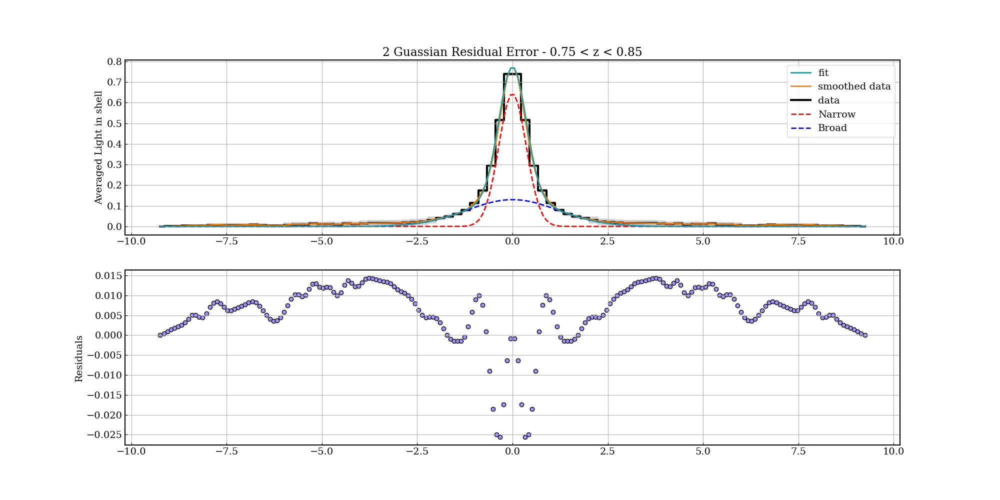

Amplitude Red = 0.6439018123262623 +0.006257557351004861 - 0.0065630150322883996

Width Red = 0.3592742915042343 +0.004366071342016997 - 0.004484061157688346

Amplitude Blue = 0.12992276850274825 +7.406819374344842e-05 - 0.0005501065877548394

Width Blue = 1.1994572460180817 +0.0005239563975907302 - 0.004041160102088437


In [158]:
# 1. Generate or load data
x_Mirror_RE_075_085 = np.linspace(-84,84,84)

x_data_Mirror_RE_075_085 = np.multiply(x_Mirror_RE_075_085, 0.11)
y_data_Mirror_RE_075_085 = Mirrored_Radius_array_075_085

y_err_Mirror_RE_075_085 = New_Err_RMS_075_085 #1.0 #Mirrored_Radius_array_SDE_025_035[0:84]

initial_Mirror_RE_075_085 = np.array([0.6, 0.4, 0.1, 1.1673286672194352]) #amp,wid ... red/narrow, blue/broad


Amplitude_Narrow_Red_Lower_Lim_Mirror_RE_075_085 = 0
Amplitude_Narrow_Red_Upperr_Lim_Mirror_RE_075_085 = 0.9

Width_Narrow_Red_Lower_Lim_Mirror_RE_075_085 = 0
Width_Narrow_Red_Upper_Lim_Mirror_RE_075_085 = 0.4


Amplitude_Broad_Blue_Lower_Lim_Mirror_RE_075_085 = 0
Amplitude_Broad_Blue_Upperr_Lim_Mirror_RE_075_085 = 0.13

Width_Broad_Blue_Lower_Lim_Mirror_RE_075_085 = 0
Width_Broad_Blue_Upper_Lim_Mirror_RE_075_085 = 1.2



# 2. Define the likelihood function ############################################################################################################################################
def log_likelihood(theta, x, y, yerr):
    amp1, wid1, amp2, wid2 = theta
    model = two_gaussian(x, amp1, wid1, amp2, wid2)
    sigma2 = yerr**2
    return -0.5 * np.sum((y - model)**2 / sigma2 + np.log(sigma2))

# 4. Define the prior (optional, but recommended) ############################################################################################################################################
#def log_prior(theta):
#    amp1, wid1, amp2, wid2 = theta
#    if not all(0 < param < 10 for param in [amp1, amp2, wid1, wid2]):
#        return -np.inf
#    return 0.0

def log_prior(theta):
    amp1, wid1, amp2, wid2 = theta
    if (Amplitude_Narrow_Red_Lower_Lim_Mirror_RE_075_085 < amp1 < Amplitude_Narrow_Red_Upperr_Lim_Mirror_RE_075_085 and Amplitude_Broad_Blue_Lower_Lim_Mirror_RE_075_085 < amp2 <  Amplitude_Broad_Blue_Upperr_Lim_Mirror_RE_075_085 and Width_Narrow_Red_Lower_Lim_Mirror_RE_075_085 < wid1 < Width_Narrow_Red_Upper_Lim_Mirror_RE_075_085 and Width_Broad_Blue_Lower_Lim_Mirror_RE_075_085 < wid2 <  Width_Broad_Blue_Upper_Lim_Mirror_RE_075_085):
        return 0.0
    return -np.inf

# 5. Define the probability function ############################################################################################################################################
def log_probability(theta, x, y, yerr):
    lp = log_prior(theta)
    if not np.isfinite(lp):
        return -np.inf
    return lp + log_likelihood(theta, x, y, yerr)

# 3. Optimization (finding a good starting point) ############################################################################################################################################

bounds_Mirror_RE_075_085 = [(Amplitude_Narrow_Red_Lower_Lim_Mirror_RE_075_085, Amplitude_Narrow_Red_Upperr_Lim_Mirror_RE_075_085), (Width_Narrow_Red_Lower_Lim_Mirror_RE_075_085, Width_Narrow_Red_Upper_Lim_Mirror_RE_075_085), (Amplitude_Broad_Blue_Lower_Lim_Mirror_RE_075_085, Amplitude_Broad_Blue_Upperr_Lim_Mirror_RE_075_085), (Width_Broad_Blue_Lower_Lim_Mirror_RE_075_085, Width_Broad_Blue_Upper_Lim_Mirror_RE_075_085)] # Parameter bounds for optimization
soln_Mirror_RE_075_085 = minimize(lambda *args: -log_likelihood(*args), initial_Mirror_RE_075_085, args=(x_data_Mirror_RE_075_085, y_data_Mirror_RE_075_085, y_err_Mirror_RE_075_085), bounds=bounds_Mirror_RE_075_085)

#soln = minimize(lambda *args: -log_likelihood(*args), initial, args=(x_data, y_data, y_err))
pos_Mirror_RE_075_085 = soln_Mirror_RE_075_085.x + 1e-4 * np.random.randn(32, len(soln_Mirror_RE_075_085.x))
nwalkers_Mirror_RE_075_085, ndim_Mirror_RE_075_085 = pos_Mirror_RE_075_085.shape


# 4. MCMC sampling ############################################################################################################################################
sampler_Mirror_RE_075_085 = emcee.EnsembleSampler(nwalkers_Mirror_RE_075_085, ndim_Mirror_RE_075_085, log_probability, args=(x_data_Mirror_RE_075_085, y_data_Mirror_RE_075_085, y_err_Mirror_RE_075_085))
sampler_Mirror_RE_075_085.run_mcmc(pos_Mirror_RE_075_085, 5000, progress=True)

# 5. Analyze results
samples_Mirror_RE_075_085 = sampler_Mirror_RE_075_085.get_chain(flat=True)

# 6. Best fit parameters ############################################################################################################################################
best_fit_params_Mirror_RE_075_085 = []
for i in range(ndim_Mirror_RE_075_085):
    mcmc_Mirror_RE_075_085 = np.percentile(samples_Mirror_RE_075_085[:, i], [68, 95, 99.7])
    best_fit_params_Mirror_RE_075_085.append(mcmc_Mirror_RE_075_085[1])

# 10. Error estimation ############################################################################################################################################
errors_Mirror_RE_075_085 = []
for i in range(ndim_Mirror_RE_075_085):
     mcmc_Mirror_RE_075_085 = np.percentile(samples_Mirror_RE_075_085[:, i], [68, 95, 99.7])
     errors_Mirror_RE_075_085.append([mcmc_Mirror_RE_075_085[2]-mcmc_Mirror_RE_075_085[1],mcmc_Mirror_RE_075_085[1]-mcmc_Mirror_RE_075_085[0]])

# 11. Getting the RMS Values ############################################################################################################################################
x_new_Mirror_RE_075_085 = np.linspace(min(x_data_Mirror_RE_075_085),max(x_data_Mirror_RE_075_085), 200)

y_new_Mirror_RE_075_085 = CubicSpline(x_data_Mirror_RE_075_085, y_data_Mirror_RE_075_085)

yy_new_Mirror_RE_075_085 = y_new_Mirror_RE_075_085(x_new_Mirror_RE_075_085)

x_plot_Mirror_RE_075_085 = np.linspace(min(x_data_Mirror_RE_075_085), max(x_data_Mirror_RE_075_085), 200)
     
# 12. Plot results ############################################################################################################################################
fig = plt.figure(figsize = (20, 10),  facecolor = "white")
ax = plt.subplot(2,1,1)

plt.plot(x_plot_Mirror_RE_075_085, two_gaussian(x_plot_Mirror_RE_075_085, *best_fit_params_Mirror_RE_075_085), color = "#219B9D", linewidth=2.0, label="fit", zorder=10)
plt.plot(x_new_Mirror_RE_075_085, yy_new_Mirror_RE_075_085, color = "#FF8000", linewidth=2.0, label="smoothed data")
plt.step(x_data_Mirror_RE_075_085, y_data_Mirror_RE_075_085, color = "black", linewidth=3.0, where="mid", zorder=1, label="data")

plt.plot(x_plot_Mirror_RE_075_085, gaussian(x_plot_Mirror_RE_075_085, best_fit_params_Mirror_RE_075_085[0], best_fit_params_Mirror_RE_075_085[1]), color="red", linestyle="--", label="Narrow")
plt.plot(x_plot_Mirror_RE_075_085, gaussian(x_plot_Mirror_RE_075_085, best_fit_params_Mirror_RE_075_085[2], best_fit_params_Mirror_RE_075_085[3]), color="blue", linestyle="--", label="Broad")

plt.fill_between(x_data_Mirror_RE_075_085, y_data_Mirror_RE_075_085 - y_err_Mirror_RE_075_085, y_data_Mirror_RE_075_085 + y_err_Mirror_RE_075_085, step="mid", color = "lightgrey", zorder=0)

plt.legend()

ax1 = plt.subplot(2,1,2)

ax1.scatter(x_new_Mirror_RE_075_085, yy_new_Mirror_RE_075_085 - two_gaussian(x_plot_Mirror_RE_075_085, *best_fit_params_Mirror_RE_075_085), c = "#A294F9", edgecolor="black") 

ax.set_title("2 Guassian Residual Error - 0.75 < z < 0.85")

ax.set_ylabel("Averaged Light in shell")
ax1.set_ylabel("Residuals")

ax.grid()
ax1.grid()

# Show the plot
plt.show(block=False)

# Close the figure

############################################################################################################################################
Best_Fit_Mirrored_RE_075_085 = yy_new_Mirror_RE_075_085
Best_Fit_Mirrored_Fit_X_Array_RE_075_085 = x_new_Mirror_RE_075_085

Narrow_Amplitude_Fit_Mirrored_RE_075_085 = best_fit_params_Mirror_RE_075_085[0]
Narrow_Amplitude_Fit_Mirrored_Error_P_RE_075_085 = errors_Mirror_RE_075_085[0][0]
Narrow_Amplitude_Fit_Mirrored_Error_M_RE_075_085 = errors_Mirror_RE_075_085[0][1]
Narrow_Width_Fit_Mirrored_RE_075_085 = best_fit_params_Mirror_RE_075_085[1]
Narrow_Width_Fit_Mirrored_Error_P_RE_075_085 = errors_Mirror_RE_075_085[1][0]
Narrow_Width_Fit_Mirrored_Error_M_RE_075_085 = errors_Mirror_RE_075_085[1][1]

Broad_Amplitude_Fit_Mirrored_RE_075_085 = best_fit_params_Mirror_RE_075_085[2]
Broad_Amplitude_Fit_Mirrored_Error_P_RE_075_085 = errors_Mirror_RE_075_085[2][0]
Broad_Amplitude_Fit_Mirrored_Error_M_RE_075_085 = errors_Mirror_RE_075_085[2][1]
Broad_Width_Fit_Mirrored_RE_075_085 = best_fit_params_Mirror_RE_075_085[3]
Broad_Width_Fit_Mirrored_Error_P_RE_075_085 = errors_Mirror_RE_075_085[3][0]
Broad_Width_Fit_Mirrored_Error_M_RE_075_085 = errors_Mirror_RE_075_085[3][1]

Best_Fit_Mirrored_Fit_Residuals_RE_075_085 = yy_new_Mirror_RE_075_085 - two_gaussian(x_plot_Mirror_RE_075_085, *best_fit_params_Mirror_RE_075_085)
Gaussian_Fit_Mirrored_X_Array_RE_075_085 = x_plot_Mirror_RE_075_085

############################################################################################################################################
print("Amplitude Red = " +str(best_fit_params_Mirror_RE_075_085[0]) + " +" +str(errors_Mirror_RE_075_085[0][0]) + " - " +str(errors_Mirror_RE_075_085[0][1]))
print("")
print("Width Red = " +str(best_fit_params_Mirror_RE_075_085[1]) + " +" +str(errors_Mirror_RE_075_085[1][0]) + " - " +str(errors_Mirror_RE_075_085[1][1]))
print("")
print("Amplitude Blue = " +str(best_fit_params_Mirror_RE_075_085[2]) + " +" +str(errors_Mirror_RE_075_085[2][0]) + " - " +str(errors_Mirror_RE_075_085[2][1]))
print("")
print("Width Blue = " +str(best_fit_params_Mirror_RE_075_085[3]) + " +" +str(errors_Mirror_RE_075_085[3][0]) + " - " +str(errors_Mirror_RE_075_085[3][1]))

100%|██████████| 5000/5000 [00:08<00:00, 613.24it/s]


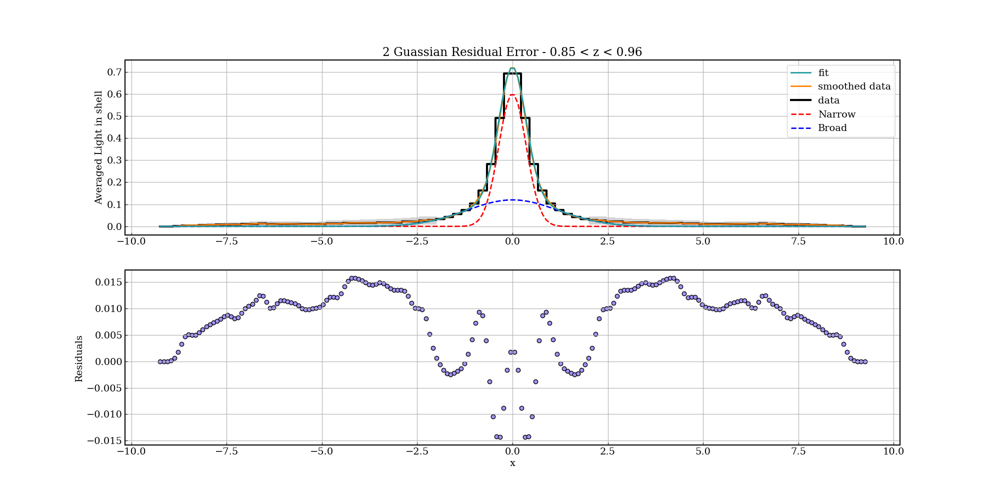

Amplitude Red = 0.6006336622070766 +0.0028064726345267133 - 0.0029942904260470415

Width Red = 0.3601784945402591 +0.0021263675524010317 - 0.0021772113928786307

Amplitude Blue = 0.11996108723439822 +3.787162983320824e-05 - 0.0002602371654007868

Width Blue = 1.1995695931756434 +0.0004167701886821362 - 0.003054162162003715


In [159]:
# 1. Generate or load data
x_Mirror_RE_085_096 = np.linspace(-84,84,84)

x_data_Mirror_RE_085_096 = np.multiply(x_Mirror_RE_085_096, 0.11)
y_data_Mirror_RE_085_096 = Mirrored_Radius_array_085_096

y_err_Mirror_RE_085_096 = New_Err_RMS_085_096 #1.0 #Mirrored_Radius_array_SDE_025_035[0:84]

initial_Mirror_RE_085_096 = np.array([0.6, 0.4, 0.1, 1.1]) #amp,wid ... red/narrow, blue/broad


Amplitude_Narrow_Red_Lower_Lim_Mirror_RE_085_096 = 0
Amplitude_Narrow_Red_Upperr_Lim_Mirror_RE_085_096 = 0.9

Width_Narrow_Red_Lower_Lim_Mirror_RE_085_096 = 0
Width_Narrow_Red_Upper_Lim_Mirror_RE_085_096 = 0.5


Amplitude_Broad_Blue_Lower_Lim_Mirror_RE_085_096 = 0
Amplitude_Broad_Blue_Upperr_Lim_Mirror_RE_085_096 = 0.12

Width_Broad_Blue_Lower_Lim_Mirror_RE_085_096 = 0
Width_Broad_Blue_Upper_Lim_Mirror_RE_085_096 = 1.2




# 2. Define the likelihood function ############################################################################################################################################
def log_likelihood(theta, x, y, yerr):
    amp1, wid1, amp2, wid2 = theta
    model = two_gaussian(x, amp1, wid1, amp2, wid2)
    sigma2 = yerr**2
    return -0.5 * np.sum((y - model)**2 / sigma2 + np.log(sigma2))

# 4. Define the prior (optional, but recommended) ############################################################################################################################################
#def log_prior(theta):
#    amp1, wid1, amp2, wid2 = theta
#    if not all(0 < param < 10 for param in [amp1, amp2, wid1, wid2]):
#        return -np.inf
#    return 0.0

def log_prior(theta):
    amp1, wid1, amp2, wid2 = theta
    if (Amplitude_Narrow_Red_Lower_Lim_Mirror_RE_085_096 < amp1 < Amplitude_Narrow_Red_Upperr_Lim_Mirror_RE_085_096 and Amplitude_Broad_Blue_Lower_Lim_Mirror_RE_085_096 < amp2 <  Amplitude_Broad_Blue_Upperr_Lim_Mirror_RE_085_096 and Width_Narrow_Red_Lower_Lim_Mirror_RE_085_096 < wid1 < Width_Narrow_Red_Upper_Lim_Mirror_RE_085_096 and Width_Broad_Blue_Lower_Lim_Mirror_RE_085_096 < wid2 <  Width_Broad_Blue_Upper_Lim_Mirror_RE_085_096):
        return 0.0
    return -np.inf

# 5. Define the probability function ############################################################################################################################################
def log_probability(theta, x, y, yerr):
    lp = log_prior(theta)
    if not np.isfinite(lp):
        return -np.inf
    return lp + log_likelihood(theta, x, y, yerr)

# 3. Optimization (finding a good starting point) ############################################################################################################################################

bounds_Mirror_RE_085_096 = [(Amplitude_Narrow_Red_Lower_Lim_Mirror_RE_085_096, Amplitude_Narrow_Red_Upperr_Lim_Mirror_RE_085_096), (Width_Narrow_Red_Lower_Lim_Mirror_RE_085_096, Width_Narrow_Red_Upper_Lim_Mirror_RE_085_096), (Amplitude_Broad_Blue_Lower_Lim_Mirror_RE_085_096, Amplitude_Broad_Blue_Upperr_Lim_Mirror_RE_085_096), (Width_Broad_Blue_Lower_Lim_Mirror_RE_085_096, Width_Broad_Blue_Upper_Lim_Mirror_RE_085_096)] # Parameter bounds for optimization
soln_Mirror_RE_085_096 = minimize(lambda *args: -log_likelihood(*args), initial_Mirror_RE_085_096, args=(x_data_Mirror_RE_085_096, y_data_Mirror_RE_085_096, y_err_Mirror_RE_085_096), bounds=bounds_Mirror_RE_085_096)

#soln = minimize(lambda *args: -log_likelihood(*args), initial, args=(x_data, y_data, y_err))
pos_Mirror_RE_085_096 = soln_Mirror_RE_085_096.x + 1e-4 * np.random.randn(32, len(soln_Mirror_RE_085_096.x))
nwalkers_Mirror_RE_085_096, ndim_Mirror_RE_085_096 = pos_Mirror_RE_085_096.shape


# 4. MCMC sampling ############################################################################################################################################
sampler_Mirror_RE_085_096 = emcee.EnsembleSampler(nwalkers_Mirror_RE_085_096, ndim_Mirror_RE_085_096, log_probability, args=(x_data_Mirror_RE_085_096, y_data_Mirror_RE_085_096, y_err_Mirror_RE_085_096))
sampler_Mirror_RE_085_096.run_mcmc(pos_Mirror_RE_085_096, 5000, progress=True)

# 5. Analyze results
samples_Mirror_RE_085_096 = sampler_Mirror_RE_085_096.get_chain(flat=True)

# 6. Best fit parameters ############################################################################################################################################
best_fit_params_Mirror_RE_085_096 = []
for i in range(ndim_Mirror_RE_085_096):
    mcmc_Mirror_RE_085_096 = np.percentile(samples_Mirror_RE_085_096[:, i], [68, 95, 99.7])
    best_fit_params_Mirror_RE_085_096.append(mcmc_Mirror_RE_085_096[1])

# 10. Error estimation ############################################################################################################################################
errors_Mirror_RE_085_096 = []
for i in range(ndim_Mirror_RE_085_096):
     mcmc_Mirror_RE_085_096 = np.percentile(samples_Mirror_RE_085_096[:, i], [68, 95, 99.7])
     errors_Mirror_RE_085_096.append([mcmc_Mirror_RE_085_096[2]-mcmc_Mirror_RE_085_096[1],mcmc_Mirror_RE_085_096[1]-mcmc_Mirror_RE_085_096[0]])

# 11. Getting the RMS Values ############################################################################################################################################
x_new_Mirror_RE_085_096 = np.linspace(min(x_data_Mirror_RE_085_096),max(x_data_Mirror_RE_085_096), 200)

y_new_Mirror_RE_085_096 = CubicSpline(x_data_Mirror_RE_085_096, y_data_Mirror_RE_085_096)

yy_new_Mirror_RE_085_096 = y_new_Mirror_RE_085_096(x_new_Mirror_RE_085_096)

x_plot_Mirror_RE_085_096 = np.linspace(min(x_data_Mirror_RE_085_096), max(x_data_Mirror_RE_085_096), 200)
     
# 12. Plot results ############################################################################################################################################
fig = plt.figure(figsize = (20, 10),  facecolor = "white")
ax = plt.subplot(2,1,1)

plt.plot(x_plot_Mirror_RE_085_096, two_gaussian(x_plot_Mirror_RE_085_096, *best_fit_params_Mirror_RE_085_096), color = "#219B9D", linewidth=2.0, label="fit", zorder=10)
plt.plot(x_new_Mirror_RE_085_096, yy_new_Mirror_RE_085_096, color = "#FF8000", linewidth=2.0, label="smoothed data")
plt.step(x_data_Mirror_RE_085_096, y_data_Mirror_RE_085_096, color = "black", linewidth=3.0, where="mid", zorder=1, label="data")

plt.plot(x_plot_Mirror_RE_085_096, gaussian(x_plot_Mirror_RE_085_096, best_fit_params_Mirror_RE_085_096[0], best_fit_params_Mirror_RE_085_096[1]), color="red", linestyle="--", label="Narrow")
plt.plot(x_plot_Mirror_RE_085_096, gaussian(x_plot_Mirror_RE_085_096, best_fit_params_Mirror_RE_085_096[2], best_fit_params_Mirror_RE_085_096[3]), color="blue", linestyle="--", label="Broad")

plt.fill_between(x_data_Mirror_RE_085_096, y_data_Mirror_RE_085_096 - y_err_Mirror_RE_085_096, y_data_Mirror_RE_085_096 + y_err_Mirror_RE_085_096, step="mid", color = "lightgrey", zorder=0)

plt.legend()

ax1 = plt.subplot(2,1,2)

ax1.scatter(x_new_Mirror_RE_085_096, yy_new_Mirror_RE_085_096 - two_gaussian(x_plot_Mirror_RE_085_096, *best_fit_params_Mirror_RE_085_096), c = "#A294F9", edgecolor="black") 

plt.xlabel("x")
plt.ylabel("y")

ax.set_title("2 Guassian Residual Error - 0.85 < z < 0.96")

ax.set_ylabel("Averaged Light in shell")
ax1.set_ylabel("Residuals")

ax.grid()
ax1.grid()

# Show the plot
plt.show(block=False)

# Close the figure

############################################################################################################################################
Best_Fit_Mirrored_RE_085_096 = yy_new_Mirror_RE_085_096
Best_Fit_Mirrored_Fit_X_Array_RE_085_096 = x_new_Mirror_RE_085_096

Narrow_Amplitude_Fit_Mirrored_RE_085_096 = best_fit_params_Mirror_RE_085_096[0]
Narrow_Amplitude_Fit_Mirrored_Error_P_RE_085_096 = errors_Mirror_RE_085_096[0][0]
Narrow_Amplitude_Fit_Mirrored_Error_M_RE_085_096 = errors_Mirror_RE_085_096[0][1]
Narrow_Width_Fit_Mirrored_RE_085_096 = best_fit_params_Mirror_RE_085_096[1]
Narrow_Width_Fit_Mirrored_Error_P_RE_085_096 = errors_Mirror_RE_085_096[1][0]
Narrow_Width_Fit_Mirrored_Error_M_RE_085_096 = errors_Mirror_RE_085_096[1][1]

Broad_Amplitude_Fit_Mirrored_RE_085_096 = best_fit_params_Mirror_RE_085_096[2]
Broad_Amplitude_Fit_Mirrored_Error_P_RE_085_096 = errors_Mirror_RE_085_096[2][0]
Broad_Amplitude_Fit_Mirrored_Error_M_RE_085_096 = errors_Mirror_RE_085_096[2][1]
Broad_Width_Fit_Mirrored_RE_085_096 = best_fit_params_Mirror_RE_085_096[3]
Broad_Width_Fit_Mirrored_Error_P_RE_085_096 = errors_Mirror_RE_085_096[3][0]
Broad_Width_Fit_Mirrored_Error_M_RE_085_096 = errors_Mirror_RE_085_096[3][1]

Best_Fit_Mirrored_Fit_Residuals_RE_085_096 = yy_new_Mirror_RE_085_096 - two_gaussian(x_plot_Mirror_RE_085_096, *best_fit_params_Mirror_RE_085_096)
Gaussian_Fit_Mirrored_X_Array_RE_085_096 = x_plot_Mirror_RE_085_096

############################################################################################################################################
print("Amplitude Red = " +str(best_fit_params_Mirror_RE_085_096[0]) + " +" +str(errors_Mirror_RE_085_096[0][0]) + " - " +str(errors_Mirror_RE_085_096[0][1]))
print("")
print("Width Red = " +str(best_fit_params_Mirror_RE_085_096[1]) + " +" +str(errors_Mirror_RE_085_096[1][0]) + " - " +str(errors_Mirror_RE_085_096[1][1]))
print("")
print("Amplitude Blue = " +str(best_fit_params_Mirror_RE_085_096[2]) + " +" +str(errors_Mirror_RE_085_096[2][0]) + " - " +str(errors_Mirror_RE_085_096[2][1]))
print("")
print("Width Blue = " +str(best_fit_params_Mirror_RE_085_096[3]) + " +" +str(errors_Mirror_RE_085_096[3][0]) + " - " +str(errors_Mirror_RE_085_096[3][1]))



In [160]:
New_Err_RMS_InBox_N10_N9_025_035 = np.full(RMS_Len_Array_Old_025_035[0], RMS_Array_InBox_025_035[0])
New_Err_RMS_InBox_N9_N8_025_035 = np.full(RMS_Len_Array_Old_025_035[1], RMS_Array_InBox_025_035[1])
New_Err_RMS_InBox_N8_N7_025_035 = np.full(RMS_Len_Array_Old_025_035[2], RMS_Array_InBox_025_035[2])
New_Err_RMS_InBox_N7_N6_025_035 = np.full(RMS_Len_Array_Old_025_035[3], RMS_Array_InBox_025_035[3])
New_Err_RMS_InBox_N6_N5_025_035 = np.full(RMS_Len_Array_Old_025_035[4], RMS_Array_InBox_025_035[4])
New_Err_RMS_InBox_N5_N4_025_035 = np.full(RMS_Len_Array_Old_025_035[5], RMS_Array_InBox_025_035[5])
New_Err_RMS_InBox_N4_N3_025_035 = np.full(RMS_Len_Array_Old_025_035[6], RMS_Array_025_035[6])
New_Err_RMS_InBox_N3_N2_025_035 = np.full(RMS_Len_Array_Old_025_035[7], RMS_Array_025_035[7])
New_Err_RMS_InBox_N2_N1_025_035 = np.full(RMS_Len_Array_Old_025_035[8], RMS_Array_025_035[8])
New_Err_RMS_InBox_N1_N0_025_035 = np.full(RMS_Len_Array_Old_025_035[9], RMS_Array_025_035[9])
New_Err_RMS_InBox_N0_1_025_035 = np.full(RMS_Len_Array_Old_025_035[10], RMS_Array_025_035[10])
New_Err_RMS_InBox_1_2_025_035 = np.full(RMS_Len_Array_Old_025_035[11], RMS_Array_025_035[11])
New_Err_RMS_InBox_2_3_025_035 = np.full(RMS_Len_Array_Old_025_035[12], RMS_Array_025_035[12])
New_Err_RMS_InBox_3_4_025_035 = np.full(RMS_Len_Array_Old_025_035[13], RMS_Array_025_035[13])
New_Err_RMS_InBox_4_5_025_035 = np.full(RMS_Len_Array_Old_025_035[14], RMS_Array_InBox_025_035[14])
New_Err_RMS_InBox_5_6_025_035 = np.full(RMS_Len_Array_Old_025_035[15], RMS_Array_InBox_025_035[15])
New_Err_RMS_InBox_6_7_025_035 = np.full(RMS_Len_Array_Old_025_035[16], RMS_Array_InBox_025_035[16])
New_Err_RMS_InBox_7_8_025_035 = np.full(RMS_Len_Array_Old_025_035[17], RMS_Array_InBox_025_035[17])
New_Err_RMS_InBox_8_9_025_035 = np.full(RMS_Len_Array_Old_025_035[18], RMS_Array_InBox_025_035[18])
New_Err_RMS_InBox_9_10_025_035 = np.full(RMS_Len_Array_Old_025_035[19], RMS_Array_InBox_025_035[19])


New_Err_RMS_InBox_025_035 = np.concatenate((New_Err_RMS_N10_N9_025_035 ,New_Err_RMS_N9_N8_025_035 ,New_Err_RMS_N8_N7_025_035 ,New_Err_RMS_N7_N6_025_035 ,New_Err_RMS_N6_N5_025_035 ,New_Err_RMS_N5_N4_025_035 ,New_Err_RMS_N4_N3_025_035 ,New_Err_RMS_N3_N2_025_035 ,New_Err_RMS_N2_N1_025_035 ,New_Err_RMS_N1_N0_025_035 ,New_Err_RMS_N0_1_025_035 ,New_Err_RMS_1_2_025_035 ,New_Err_RMS_2_3_025_035 ,New_Err_RMS_3_4_025_035 ,New_Err_RMS_4_5_025_035 ,New_Err_RMS_5_6_025_035 ,New_Err_RMS_6_7_025_035 ,New_Err_RMS_7_8_025_035 ,New_Err_RMS_8_9_025_035 ,New_Err_RMS_9_10_025_035))



In [161]:
New_Err_RMS_InBox_N9_N8_035_045 = np.full(RMS_Len_Array_Old_035_045[1], RMS_Array_InBox_035_045[1])
New_Err_RMS_InBox_N8_N7_035_045 = np.full(RMS_Len_Array_Old_035_045[2], RMS_Array_InBox_035_045[2])
New_Err_RMS_InBox_N7_N6_035_045 = np.full(RMS_Len_Array_Old_035_045[3], RMS_Array_InBox_035_045[3])
New_Err_RMS_InBox_N6_N5_035_045 = np.full(RMS_Len_Array_Old_035_045[4], RMS_Array_InBox_035_045[4])
New_Err_RMS_InBox_N5_N4_035_045 = np.full(RMS_Len_Array_Old_035_045[5], RMS_Array_InBox_035_045[5])
New_Err_RMS_InBox_N4_N3_035_045 = np.full(RMS_Len_Array_Old_035_045[6], RMS_Array_035_045[6])
New_Err_RMS_InBox_N3_N2_035_045 = np.full(RMS_Len_Array_Old_035_045[7], RMS_Array_035_045[7])
New_Err_RMS_InBox_N2_N1_035_045 = np.full(RMS_Len_Array_Old_035_045[8], RMS_Array_035_045[8])
New_Err_RMS_InBox_N1_N0_035_045 = np.full(RMS_Len_Array_Old_035_045[9], RMS_Array_035_045[9])
New_Err_RMS_InBox_N0_1_035_045 = np.full(RMS_Len_Array_Old_035_045[10], RMS_Array_035_045[10])
New_Err_RMS_InBox_1_2_035_045 = np.full(RMS_Len_Array_Old_035_045[11], RMS_Array_035_045[11])
New_Err_RMS_InBox_2_3_035_045 = np.full(RMS_Len_Array_Old_035_045[12], RMS_Array_035_045[12])
New_Err_RMS_InBox_3_4_035_045 = np.full(RMS_Len_Array_Old_035_045[13], RMS_Array_035_045[13])
New_Err_RMS_InBox_4_5_035_045 = np.full(RMS_Len_Array_Old_035_045[14], RMS_Array_InBox_035_045[14])
New_Err_RMS_InBox_5_6_035_045 = np.full(RMS_Len_Array_Old_035_045[15], RMS_Array_InBox_035_045[15])
New_Err_RMS_InBox_6_7_035_045 = np.full(RMS_Len_Array_Old_035_045[16], RMS_Array_InBox_035_045[16])
New_Err_RMS_InBox_7_8_035_045 = np.full(RMS_Len_Array_Old_035_045[17], RMS_Array_InBox_035_045[17])
New_Err_RMS_InBox_8_9_035_045 = np.full(RMS_Len_Array_Old_035_045[18], RMS_Array_InBox_035_045[18])
New_Err_RMS_InBox_9_10_035_045 = np.full(RMS_Len_Array_Old_035_045[19], RMS_Array_InBox_035_045[19])


New_Err_RMS_InBox_035_045 = np.concatenate((New_Err_RMS_N10_N9_035_045 ,New_Err_RMS_N9_N8_035_045 ,New_Err_RMS_N8_N7_035_045 ,New_Err_RMS_N7_N6_035_045 ,New_Err_RMS_N6_N5_035_045 ,New_Err_RMS_N5_N4_035_045 ,New_Err_RMS_N4_N3_035_045 ,New_Err_RMS_N3_N2_035_045 ,New_Err_RMS_N2_N1_035_045 ,New_Err_RMS_N1_N0_035_045 ,New_Err_RMS_N0_1_035_045 ,New_Err_RMS_1_2_035_045 ,New_Err_RMS_2_3_035_045 ,New_Err_RMS_3_4_035_045 ,New_Err_RMS_4_5_035_045 ,New_Err_RMS_5_6_035_045 ,New_Err_RMS_6_7_035_045 ,New_Err_RMS_7_8_035_045 ,New_Err_RMS_8_9_035_045 ,New_Err_RMS_9_10_035_045))



In [162]:
New_Err_RMS_InBox_N9_N8_045_055 = np.full(RMS_Len_Array_Old_045_055[1], RMS_Array_InBox_045_055[1])
New_Err_RMS_InBox_N8_N7_045_055 = np.full(RMS_Len_Array_Old_045_055[2], RMS_Array_InBox_045_055[2])
New_Err_RMS_InBox_N7_N6_045_055 = np.full(RMS_Len_Array_Old_045_055[3], RMS_Array_InBox_045_055[3])
New_Err_RMS_InBox_N6_N5_045_055 = np.full(RMS_Len_Array_Old_045_055[4], RMS_Array_InBox_045_055[4])
New_Err_RMS_InBox_N5_N4_045_055 = np.full(RMS_Len_Array_Old_045_055[5], RMS_Array_InBox_045_055[5])
New_Err_RMS_InBox_N4_N3_045_055 = np.full(RMS_Len_Array_Old_045_055[6], RMS_Array_045_055[6])
New_Err_RMS_InBox_N3_N2_045_055 = np.full(RMS_Len_Array_Old_045_055[7], RMS_Array_045_055[7])
New_Err_RMS_InBox_N2_N1_045_055 = np.full(RMS_Len_Array_Old_045_055[8], RMS_Array_045_055[8])
New_Err_RMS_InBox_N1_N0_045_055 = np.full(RMS_Len_Array_Old_045_055[9], RMS_Array_045_055[9])
New_Err_RMS_InBox_N0_1_045_055 = np.full(RMS_Len_Array_Old_045_055[10], RMS_Array_045_055[10])
New_Err_RMS_InBox_1_2_045_055 = np.full(RMS_Len_Array_Old_045_055[11], RMS_Array_045_055[11])
New_Err_RMS_InBox_2_3_045_055 = np.full(RMS_Len_Array_Old_045_055[12], RMS_Array_045_055[12])
New_Err_RMS_InBox_3_4_045_055 = np.full(RMS_Len_Array_Old_045_055[13], RMS_Array_045_055[13])
New_Err_RMS_InBox_4_5_045_055 = np.full(RMS_Len_Array_Old_045_055[14], RMS_Array_InBox_045_055[14])
New_Err_RMS_InBox_5_6_045_055 = np.full(RMS_Len_Array_Old_045_055[15], RMS_Array_InBox_045_055[15])
New_Err_RMS_InBox_6_7_045_055 = np.full(RMS_Len_Array_Old_045_055[16], RMS_Array_InBox_045_055[16])
New_Err_RMS_InBox_7_8_045_055 = np.full(RMS_Len_Array_Old_045_055[17], RMS_Array_InBox_045_055[17])
New_Err_RMS_InBox_8_9_045_055 = np.full(RMS_Len_Array_Old_045_055[18], RMS_Array_InBox_045_055[18])
New_Err_RMS_InBox_9_10_045_055 = np.full(RMS_Len_Array_Old_045_055[19], RMS_Array_InBox_045_055[19])


New_Err_RMS_InBox_045_055 = np.concatenate((New_Err_RMS_N10_N9_045_055 ,New_Err_RMS_N9_N8_045_055 ,New_Err_RMS_N8_N7_045_055 ,New_Err_RMS_N7_N6_045_055 ,New_Err_RMS_N6_N5_045_055 ,New_Err_RMS_N5_N4_045_055 ,New_Err_RMS_N4_N3_045_055 ,New_Err_RMS_N3_N2_045_055 ,New_Err_RMS_N2_N1_045_055 ,New_Err_RMS_N1_N0_045_055 ,New_Err_RMS_N0_1_045_055 ,New_Err_RMS_1_2_045_055 ,New_Err_RMS_2_3_045_055 ,New_Err_RMS_3_4_045_055 ,New_Err_RMS_4_5_045_055 ,New_Err_RMS_5_6_045_055 ,New_Err_RMS_6_7_045_055 ,New_Err_RMS_7_8_045_055 ,New_Err_RMS_8_9_045_055 ,New_Err_RMS_9_10_045_055))



In [163]:
New_Err_RMS_InBox_N9_N8_055_065 = np.full(RMS_Len_Array_Old_055_065[1], RMS_Array_InBox_055_065[1])
New_Err_RMS_InBox_N8_N7_055_065 = np.full(RMS_Len_Array_Old_055_065[2], RMS_Array_InBox_055_065[2])
New_Err_RMS_InBox_N7_N6_055_065 = np.full(RMS_Len_Array_Old_055_065[3], RMS_Array_InBox_055_065[3])
New_Err_RMS_InBox_N6_N5_055_065 = np.full(RMS_Len_Array_Old_055_065[4], RMS_Array_InBox_055_065[4])
New_Err_RMS_InBox_N5_N4_055_065 = np.full(RMS_Len_Array_Old_055_065[5], RMS_Array_InBox_055_065[5])
New_Err_RMS_InBox_N4_N3_055_065 = np.full(RMS_Len_Array_Old_055_065[6], RMS_Array_055_065[6])
New_Err_RMS_InBox_N3_N2_055_065 = np.full(RMS_Len_Array_Old_055_065[7], RMS_Array_055_065[7])
New_Err_RMS_InBox_N2_N1_055_065 = np.full(RMS_Len_Array_Old_055_065[8], RMS_Array_055_065[8])
New_Err_RMS_InBox_N1_N0_055_065 = np.full(RMS_Len_Array_Old_055_065[9], RMS_Array_055_065[9])
New_Err_RMS_InBox_N0_1_055_065 = np.full(RMS_Len_Array_Old_055_065[10], RMS_Array_055_065[10])
New_Err_RMS_InBox_1_2_055_065 = np.full(RMS_Len_Array_Old_055_065[11], RMS_Array_055_065[11])
New_Err_RMS_InBox_2_3_055_065 = np.full(RMS_Len_Array_Old_055_065[12], RMS_Array_055_065[12])
New_Err_RMS_InBox_3_4_055_065 = np.full(RMS_Len_Array_Old_055_065[13], RMS_Array_055_065[13])
New_Err_RMS_InBox_4_5_055_065 = np.full(RMS_Len_Array_Old_055_065[14], RMS_Array_InBox_055_065[14])
New_Err_RMS_InBox_5_6_055_065 = np.full(RMS_Len_Array_Old_055_065[15], RMS_Array_InBox_055_065[15])
New_Err_RMS_InBox_6_7_055_065 = np.full(RMS_Len_Array_Old_055_065[16], RMS_Array_InBox_055_065[16])
New_Err_RMS_InBox_7_8_055_065 = np.full(RMS_Len_Array_Old_055_065[17], RMS_Array_InBox_055_065[17])
New_Err_RMS_InBox_8_9_055_065 = np.full(RMS_Len_Array_Old_055_065[18], RMS_Array_InBox_055_065[18])
New_Err_RMS_InBox_9_10_055_065 = np.full(RMS_Len_Array_Old_055_065[19], RMS_Array_InBox_055_065[19])


New_Err_RMS_InBox_055_065 = np.concatenate((New_Err_RMS_N10_N9_055_065 ,New_Err_RMS_N9_N8_055_065 ,New_Err_RMS_N8_N7_055_065 ,New_Err_RMS_N7_N6_055_065 ,New_Err_RMS_N6_N5_055_065 ,New_Err_RMS_N5_N4_055_065 ,New_Err_RMS_N4_N3_055_065 ,New_Err_RMS_N3_N2_055_065 ,New_Err_RMS_N2_N1_055_065 ,New_Err_RMS_N1_N0_055_065 ,New_Err_RMS_N0_1_055_065 ,New_Err_RMS_1_2_055_065 ,New_Err_RMS_2_3_055_065 ,New_Err_RMS_3_4_055_065 ,New_Err_RMS_4_5_055_065 ,New_Err_RMS_5_6_055_065 ,New_Err_RMS_6_7_055_065 ,New_Err_RMS_7_8_055_065 ,New_Err_RMS_8_9_055_065 ,New_Err_RMS_9_10_055_065))



In [164]:
New_Err_RMS_InBox_N9_N8_065_075 = np.full(RMS_Len_Array_Old_065_075[1], RMS_Array_InBox_065_075[1])
New_Err_RMS_InBox_N8_N7_065_075 = np.full(RMS_Len_Array_Old_065_075[2], RMS_Array_InBox_065_075[2])
New_Err_RMS_InBox_N7_N6_065_075 = np.full(RMS_Len_Array_Old_065_075[3], RMS_Array_InBox_065_075[3])
New_Err_RMS_InBox_N6_N5_065_075 = np.full(RMS_Len_Array_Old_065_075[4], RMS_Array_InBox_065_075[4])
New_Err_RMS_InBox_N5_N4_065_075 = np.full(RMS_Len_Array_Old_065_075[5], RMS_Array_InBox_065_075[5])
New_Err_RMS_InBox_N4_N3_065_075 = np.full(RMS_Len_Array_Old_065_075[6], RMS_Array_065_075[6])
New_Err_RMS_InBox_N3_N2_065_075 = np.full(RMS_Len_Array_Old_065_075[7], RMS_Array_065_075[7])
New_Err_RMS_InBox_N2_N1_065_075 = np.full(RMS_Len_Array_Old_065_075[8], RMS_Array_065_075[8])
New_Err_RMS_InBox_N1_N0_065_075 = np.full(RMS_Len_Array_Old_065_075[9], RMS_Array_065_075[9])
New_Err_RMS_InBox_N0_1_065_075 = np.full(RMS_Len_Array_Old_065_075[10], RMS_Array_065_075[10])
New_Err_RMS_InBox_1_2_065_075 = np.full(RMS_Len_Array_Old_065_075[11], RMS_Array_065_075[11])
New_Err_RMS_InBox_2_3_065_075 = np.full(RMS_Len_Array_Old_065_075[12], RMS_Array_065_075[12])
New_Err_RMS_InBox_3_4_065_075 = np.full(RMS_Len_Array_Old_065_075[13], RMS_Array_065_075[13])
New_Err_RMS_InBox_4_5_065_075 = np.full(RMS_Len_Array_Old_065_075[14], RMS_Array_InBox_065_075[14])
New_Err_RMS_InBox_5_6_065_075 = np.full(RMS_Len_Array_Old_065_075[15], RMS_Array_InBox_065_075[15])
New_Err_RMS_InBox_6_7_065_075 = np.full(RMS_Len_Array_Old_065_075[16], RMS_Array_InBox_065_075[16])
New_Err_RMS_InBox_7_8_065_075 = np.full(RMS_Len_Array_Old_065_075[17], RMS_Array_InBox_065_075[17])
New_Err_RMS_InBox_8_9_065_075 = np.full(RMS_Len_Array_Old_065_075[18], RMS_Array_InBox_065_075[18])
New_Err_RMS_InBox_9_10_065_075 = np.full(RMS_Len_Array_Old_065_075[19], RMS_Array_InBox_065_075[19])


New_Err_RMS_InBox_065_075 = np.concatenate((New_Err_RMS_N10_N9_065_075 ,New_Err_RMS_N9_N8_065_075 ,New_Err_RMS_N8_N7_065_075 ,New_Err_RMS_N7_N6_065_075 ,New_Err_RMS_N6_N5_065_075 ,New_Err_RMS_N5_N4_065_075 ,New_Err_RMS_N4_N3_065_075 ,New_Err_RMS_N3_N2_065_075 ,New_Err_RMS_N2_N1_065_075 ,New_Err_RMS_N1_N0_065_075 ,New_Err_RMS_N0_1_065_075 ,New_Err_RMS_1_2_065_075 ,New_Err_RMS_2_3_065_075 ,New_Err_RMS_3_4_065_075 ,New_Err_RMS_4_5_065_075 ,New_Err_RMS_5_6_065_075 ,New_Err_RMS_6_7_065_075 ,New_Err_RMS_7_8_065_075 ,New_Err_RMS_8_9_065_075 ,New_Err_RMS_9_10_065_075))



In [165]:
New_Err_RMS_InBox_N9_N8_075_085 = np.full(RMS_Len_Array_Old_075_085[1], RMS_Array_InBox_075_085[1])
New_Err_RMS_InBox_N8_N7_075_085 = np.full(RMS_Len_Array_Old_075_085[2], RMS_Array_InBox_075_085[2])
New_Err_RMS_InBox_N7_N6_075_085 = np.full(RMS_Len_Array_Old_075_085[3], RMS_Array_InBox_075_085[3])
New_Err_RMS_InBox_N6_N5_075_085 = np.full(RMS_Len_Array_Old_075_085[4], RMS_Array_InBox_075_085[4])
New_Err_RMS_InBox_N5_N4_075_085 = np.full(RMS_Len_Array_Old_075_085[5], RMS_Array_InBox_075_085[5])
New_Err_RMS_InBox_N4_N3_075_085 = np.full(RMS_Len_Array_Old_075_085[6], RMS_Array_075_085[6])
New_Err_RMS_InBox_N3_N2_075_085 = np.full(RMS_Len_Array_Old_075_085[7], RMS_Array_075_085[7])
New_Err_RMS_InBox_N2_N1_075_085 = np.full(RMS_Len_Array_Old_075_085[8], RMS_Array_075_085[8])
New_Err_RMS_InBox_N1_N0_075_085 = np.full(RMS_Len_Array_Old_075_085[9], RMS_Array_075_085[9])
New_Err_RMS_InBox_N0_1_075_085 = np.full(RMS_Len_Array_Old_075_085[10], RMS_Array_075_085[10])
New_Err_RMS_InBox_1_2_075_085 = np.full(RMS_Len_Array_Old_075_085[11], RMS_Array_075_085[11])
New_Err_RMS_InBox_2_3_075_085 = np.full(RMS_Len_Array_Old_075_085[12], RMS_Array_075_085[12])
New_Err_RMS_InBox_3_4_075_085 = np.full(RMS_Len_Array_Old_075_085[13], RMS_Array_075_085[13])
New_Err_RMS_InBox_4_5_075_085 = np.full(RMS_Len_Array_Old_075_085[14], RMS_Array_InBox_075_085[14])
New_Err_RMS_InBox_5_6_075_085 = np.full(RMS_Len_Array_Old_075_085[15], RMS_Array_InBox_075_085[15])
New_Err_RMS_InBox_6_7_075_085 = np.full(RMS_Len_Array_Old_075_085[16], RMS_Array_InBox_075_085[16])
New_Err_RMS_InBox_7_8_075_085 = np.full(RMS_Len_Array_Old_075_085[17], RMS_Array_InBox_075_085[17])
New_Err_RMS_InBox_8_9_075_085 = np.full(RMS_Len_Array_Old_075_085[18], RMS_Array_InBox_075_085[18])
New_Err_RMS_InBox_9_10_075_085 = np.full(RMS_Len_Array_Old_075_085[19], RMS_Array_InBox_075_085[19])


New_Err_RMS_InBox_075_085 = np.concatenate((New_Err_RMS_N10_N9_075_085 ,New_Err_RMS_N9_N8_075_085 ,New_Err_RMS_N8_N7_075_085 ,New_Err_RMS_N7_N6_075_085 ,New_Err_RMS_N6_N5_075_085 ,New_Err_RMS_N5_N4_075_085 ,New_Err_RMS_N4_N3_075_085 ,New_Err_RMS_N3_N2_075_085 ,New_Err_RMS_N2_N1_075_085 ,New_Err_RMS_N1_N0_075_085 ,New_Err_RMS_N0_1_075_085 ,New_Err_RMS_1_2_075_085 ,New_Err_RMS_2_3_075_085 ,New_Err_RMS_3_4_075_085 ,New_Err_RMS_4_5_075_085 ,New_Err_RMS_5_6_075_085 ,New_Err_RMS_6_7_075_085 ,New_Err_RMS_7_8_075_085 ,New_Err_RMS_8_9_075_085 ,New_Err_RMS_9_10_075_085))



In [166]:
New_Err_RMS_InBox_N9_N8_085_096 = np.full(RMS_Len_Array_Old_085_096[1], RMS_Array_InBox_085_096[1])
New_Err_RMS_InBox_N8_N7_085_096 = np.full(RMS_Len_Array_Old_085_096[2], RMS_Array_InBox_085_096[2])
New_Err_RMS_InBox_N7_N6_085_096 = np.full(RMS_Len_Array_Old_085_096[3], RMS_Array_InBox_085_096[3])
New_Err_RMS_InBox_N6_N5_085_096 = np.full(RMS_Len_Array_Old_085_096[4], RMS_Array_InBox_085_096[4])
New_Err_RMS_InBox_N5_N4_085_096 = np.full(RMS_Len_Array_Old_085_096[5], RMS_Array_InBox_085_096[5])
New_Err_RMS_InBox_N4_N3_085_096 = np.full(RMS_Len_Array_Old_085_096[6], RMS_Array_085_096[6])
New_Err_RMS_InBox_N3_N2_085_096 = np.full(RMS_Len_Array_Old_085_096[7], RMS_Array_085_096[7])
New_Err_RMS_InBox_N2_N1_085_096 = np.full(RMS_Len_Array_Old_085_096[8], RMS_Array_085_096[8])
New_Err_RMS_InBox_N1_N0_085_096 = np.full(RMS_Len_Array_Old_085_096[9], RMS_Array_085_096[9])
New_Err_RMS_InBox_N0_1_085_096 = np.full(RMS_Len_Array_Old_085_096[10], RMS_Array_085_096[10])
New_Err_RMS_InBox_1_2_085_096 = np.full(RMS_Len_Array_Old_085_096[11], RMS_Array_085_096[11])
New_Err_RMS_InBox_2_3_085_096 = np.full(RMS_Len_Array_Old_085_096[12], RMS_Array_085_096[12])
New_Err_RMS_InBox_3_4_085_096 = np.full(RMS_Len_Array_Old_085_096[13], RMS_Array_085_096[13])
New_Err_RMS_InBox_4_5_085_096 = np.full(RMS_Len_Array_Old_085_096[14], RMS_Array_InBox_085_096[14])
New_Err_RMS_InBox_5_6_085_096 = np.full(RMS_Len_Array_Old_085_096[15], RMS_Array_InBox_085_096[15])
New_Err_RMS_InBox_6_7_085_096 = np.full(RMS_Len_Array_Old_085_096[16], RMS_Array_InBox_085_096[16])
New_Err_RMS_InBox_7_8_085_096 = np.full(RMS_Len_Array_Old_085_096[17], RMS_Array_InBox_085_096[17])
New_Err_RMS_InBox_8_9_085_096 = np.full(RMS_Len_Array_Old_085_096[18], RMS_Array_InBox_085_096[18])
New_Err_RMS_InBox_9_10_085_096 = np.full(RMS_Len_Array_Old_085_096[19], RMS_Array_InBox_085_096[19])


New_Err_RMS_InBox_085_096 = np.concatenate((New_Err_RMS_N10_N9_085_096 ,New_Err_RMS_N9_N8_085_096 ,New_Err_RMS_N8_N7_085_096 ,New_Err_RMS_N7_N6_085_096 ,New_Err_RMS_N6_N5_085_096 ,New_Err_RMS_N5_N4_085_096 ,New_Err_RMS_N4_N3_085_096 ,New_Err_RMS_N3_N2_085_096 ,New_Err_RMS_N2_N1_085_096 ,New_Err_RMS_N1_N0_085_096 ,New_Err_RMS_N0_1_085_096 ,New_Err_RMS_1_2_085_096 ,New_Err_RMS_2_3_085_096 ,New_Err_RMS_3_4_085_096 ,New_Err_RMS_4_5_085_096 ,New_Err_RMS_5_6_085_096 ,New_Err_RMS_6_7_085_096 ,New_Err_RMS_7_8_085_096 ,New_Err_RMS_8_9_085_096 ,New_Err_RMS_9_10_085_096))



100%|██████████| 5000/5000 [00:07<00:00, 669.07it/s]


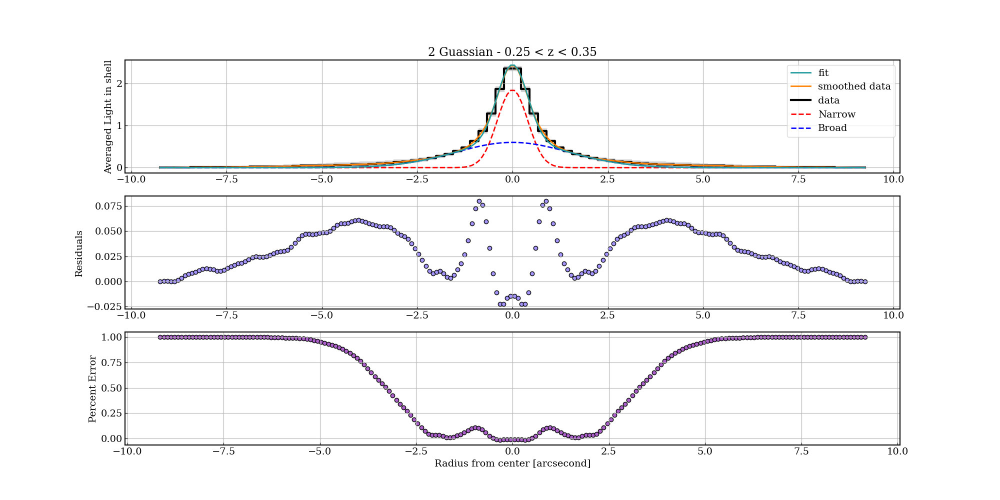

Amplitude Red = 1.8483634270082898 +0.0015509322916715806 - 0.009617287706222166

Width Red = 0.3998873229515743 +0.0001076658705366218 - 0.0008114899694406374

Amplitude Blue = 0.5998508176446067 +0.00014489945238427282 - 0.0010438862098938184

Width Blue = 1.4996167897997346 +0.00037348988502494684 - 0.0026589745063618775


In [167]:
# 1. Generate or load data
x_Mirror_InBox_025_035 = np.linspace(-84,84,84)

x_data_Mirror_InBox_025_035 = np.multiply(x_Mirror_025_035, 0.11)
y_data_Mirror_InBox_025_035 = Mirrored_Radius_array_025_035

y_err_Mirror_InBox_025_035 = New_Err_RMS_InBox_025_035 #1.0 #Mirrored_Radius_array_SDE_025_035[0:84]

initial_Mirror_InBox_025_035 = np.array([0.6, 0.4, 0.1, 1.0]) #amp,wid ... red/narrow, blue/broad


Amplitude_Narrow_Red_Lower_Lim_Mirror_InBox_025_035 = 0
Amplitude_Narrow_Red_Upperr_Lim_Mirror_InBox_025_035 = 1.85

Width_Narrow_Red_Lower_Lim_Mirror_InBox_025_035 = 0
Width_Narrow_Red_Upper_Lim_Mirror_InBox_025_035 = 0.4


Amplitude_Broad_Blue_Lower_Lim_Mirror_InBox_025_035 = 0
Amplitude_Broad_Blue_Upperr_Lim_Mirror_InBox_025_035 = 0.6

Width_Broad_Blue_Lower_Lim_Mirror_InBox_025_035 = 0
Width_Broad_Blue_Upper_Lim_Mirror_InBox_025_035 = 1.5




# 2. Define the likelihood function ############################################################################################################################################
def log_likelihood(theta, x, y, yerr):
    amp1, wid1, amp2, wid2 = theta
    model = two_gaussian(x, amp1, wid1, amp2, wid2)
    sigma2 = yerr**2
    return -0.5 * np.sum((y - model)**2 / sigma2 + np.log(sigma2))

# 4. Define the prior (optional, but recommended) ############################################################################################################################################
#def log_prior(theta):
#    amp1, wid1, amp2, wid2 = theta
#    if not all(0 < param < 10 for param in [amp1, amp2, wid1, wid2]):
#        return -np.inf
#    return 0.0

def log_prior(theta):
    amp1, wid1, amp2, wid2 = theta
    if (Amplitude_Narrow_Red_Lower_Lim_Mirror_InBox_025_035 < amp1 < Amplitude_Narrow_Red_Upperr_Lim_Mirror_InBox_025_035 and Amplitude_Broad_Blue_Lower_Lim_Mirror_InBox_025_035 < amp2 <  Amplitude_Broad_Blue_Upperr_Lim_Mirror_InBox_025_035 and Width_Narrow_Red_Lower_Lim_Mirror_InBox_025_035 < wid1 < Width_Narrow_Red_Upper_Lim_Mirror_InBox_025_035 and Width_Broad_Blue_Lower_Lim_Mirror_InBox_025_035 < wid2 <  Width_Broad_Blue_Upper_Lim_Mirror_InBox_025_035):
        return 0.0
    return -np.inf

# 5. Define the probability function ############################################################################################################################################
def log_probability(theta, x, y, yerr):
    lp = log_prior(theta)
    if not np.isfinite(lp):
        return -np.inf
    return lp + log_likelihood(theta, x, y, yerr)

# 3. Optimization (finding a good starting point) ############################################################################################################################################

bounds_Mirror_InBox_025_035 = [(Amplitude_Narrow_Red_Lower_Lim_Mirror_InBox_025_035, Amplitude_Narrow_Red_Upperr_Lim_Mirror_InBox_025_035), (Width_Narrow_Red_Lower_Lim_Mirror_InBox_025_035, Width_Narrow_Red_Upper_Lim_Mirror_InBox_025_035), (Amplitude_Broad_Blue_Lower_Lim_Mirror_InBox_025_035, Amplitude_Broad_Blue_Upperr_Lim_Mirror_InBox_025_035), (Width_Broad_Blue_Lower_Lim_Mirror_InBox_025_035, Width_Broad_Blue_Upper_Lim_Mirror_InBox_025_035)] # Parameter bounds for optimization
soln_Mirror_InBox_025_035 = minimize(lambda *args: -log_likelihood(*args), initial_Mirror_InBox_025_035, args=(x_data_Mirror_InBox_025_035, y_data_Mirror_InBox_025_035, y_err_Mirror_InBox_025_035), bounds=bounds_Mirror_InBox_025_035)

#soln = minimize(lambda *args: -log_likelihood(*args), initial, args=(x_data, y_data, y_err))
pos_Mirror_InBox_025_035 = soln_Mirror_InBox_025_035.x + 1e-4 * np.random.randn(32, len(soln_Mirror_InBox_025_035.x))
nwalkers_Mirror_InBox_025_035, ndim_Mirror_InBox_025_035 = pos_Mirror_InBox_025_035.shape


# 4. MCMC sampling ############################################################################################################################################
sampler_Mirror_InBox_025_035 = emcee.EnsembleSampler(nwalkers_Mirror_InBox_025_035, ndim_Mirror_InBox_025_035, log_probability, args=(x_data_Mirror_InBox_025_035, y_data_Mirror_InBox_025_035, y_err_Mirror_InBox_025_035))
sampler_Mirror_InBox_025_035.run_mcmc(pos_Mirror_InBox_025_035, 5000, progress=True)

# 5. Analyze results
samples_Mirror_InBox_025_035 = sampler_Mirror_InBox_025_035.get_chain(flat=True)

# 6. Best fit parameters ############################################################################################################################################
best_fit_params_Mirror_InBox_025_035 = []
for i in range(ndim_Mirror_InBox_025_035):
    mcmc_Mirror_InBox_025_035 = np.percentile(samples_Mirror_InBox_025_035[:, i], [68, 95, 99.7])
    best_fit_params_Mirror_InBox_025_035.append(mcmc_Mirror_InBox_025_035[1])

# 10. Error estimation ############################################################################################################################################
errors_Mirror_InBox_025_035 = []
for i in range(ndim_Mirror_InBox_025_035):
     mcmc_Mirror_InBox_025_035 = np.percentile(samples_Mirror_InBox_025_035[:, i], [68, 95, 99.7])
     errors_Mirror_InBox_025_035.append([mcmc_Mirror_InBox_025_035[2]-mcmc_Mirror_InBox_025_035[1],mcmc_Mirror_InBox_025_035[1]-mcmc_Mirror_InBox_025_035[0]])

# 11. Getting the RMS Values ############################################################################################################################################
x_new_Mirror_InBox_025_035 = np.linspace(min(x_data_Mirror_InBox_025_035),max(x_data_Mirror_InBox_025_035), 200)

y_new_Mirror_InBox_025_035 = CubicSpline(x_data_Mirror_InBox_025_035, y_data_Mirror_InBox_025_035)

yy_new_Mirror_InBox_025_035 = y_new_Mirror_InBox_025_035(x_new_Mirror_InBox_025_035)

x_plot_Mirror_InBox_025_035 = np.linspace(min(x_data_Mirror_InBox_025_035), max(x_data_Mirror_InBox_025_035), 200)
     
# 12. Plot results ############################################################################################################################################
fig = plt.figure(figsize = (20, 10),  facecolor = "white")
ax = plt.subplot(3,1,1)

plt.plot(x_plot_Mirror_InBox_025_035, two_gaussian(x_plot_Mirror_InBox_025_035, *best_fit_params_Mirror_InBox_025_035), color = "#219B9D", linewidth=2.0, label="fit", zorder=10)
plt.plot(x_new_Mirror_InBox_025_035, yy_new_Mirror_InBox_025_035, color = "#FF8000", linewidth=2.0, label="smoothed data")
plt.step(x_data_Mirror_InBox_025_035, y_data_Mirror_InBox_025_035, color = "black", linewidth=3.0, where="mid", zorder=1, label="data")

plt.plot(x_plot_Mirror_InBox_025_035, gaussian(x_plot_Mirror_InBox_025_035, best_fit_params_Mirror_InBox_025_035[0], best_fit_params_Mirror_InBox_025_035[1]), color="red", linestyle="--", label="Narrow")
plt.plot(x_plot_Mirror_InBox_025_035, gaussian(x_plot_Mirror_InBox_025_035, best_fit_params_Mirror_InBox_025_035[2], best_fit_params_Mirror_InBox_025_035[3]), color="blue", linestyle="--", label="Broad")

plt.fill_between(x_data_Mirror_InBox_025_035, y_data_Mirror_InBox_025_035 - y_err_Mirror_InBox_025_035, y_data_Mirror_InBox_025_035 + y_err_Mirror_InBox_025_035, step="mid", color = "lightgrey", zorder=0)

plt.legend()

ax1 = plt.subplot(3,1,2)

ax1.scatter(x_new_Mirror_InBox_025_035, yy_new_Mirror_InBox_025_035 - two_gaussian(x_plot_Mirror_InBox_025_035, *best_fit_params_Mirror_InBox_025_035), c = "#A294F9", edgecolor="black") 

ax2 = plt.subplot(3,1,3)
ax2.scatter(x_new_Mirror_InBox_025_035, (yy_new_Mirror_InBox_025_035 - two_gaussian(x_plot_Mirror_InBox_025_035, *best_fit_params_Mirror_InBox_025_035))/yy_new_Mirror_InBox_025_035, c = "#AA60C8", edgecolor="black") 

plt.xlabel("x")
plt.ylabel("y")

ax.set_title("2 Guassian - 0.25 < z < 0.35")

ax2.set_xlabel("Radius from center [arcsecond]")

ax.set_ylabel("Averaged Light in shell")
ax1.set_ylabel("Residuals")
ax2.set_ylabel("Percent Error")

ax.grid()
ax1.grid()
ax2.grid()

# Show the plot
plt.show(block=False)

# Close the figure

############################################################################################################################################
Best_Fit_Mirrored_InBox_025_035 = yy_new_Mirror_InBox_025_035
Best_Fit_Mirrored_Fit_X_Array_InBox_025_035 = x_new_Mirror_InBox_025_035

Narrow_Amplitude_Fit_Mirrored_InBox_025_035 = best_fit_params_Mirror_InBox_025_035[0]
Narrow_Amplitude_Fit_Mirrored_Error_P_InBox_025_035 = errors_Mirror_InBox_025_035[0][0]
Narrow_Amplitude_Fit_Mirrored_Error_M_InBox_025_035 = errors_Mirror_InBox_025_035[0][1]
Narrow_Width_Fit_Mirrored_InBox_025_035 = best_fit_params_Mirror_InBox_025_035[1]
Narrow_Width_Fit_Mirrored_Error_P_InBox_025_035 = errors_Mirror_InBox_025_035[1][0]
Narrow_Width_Fit_Mirrored_Error_M_InBox_025_035 = errors_Mirror_InBox_025_035[1][1]

Broad_Amplitude_Fit_Mirrored_InBox_025_035 = best_fit_params_Mirror_InBox_025_035[2]
Broad_Amplitude_Fit_Mirrored_Error_P_InBox_025_035 = errors_Mirror_InBox_025_035[2][0]
Broad_Amplitude_Fit_Mirrored_Error_M_InBox_025_035 = errors_Mirror_InBox_025_035[2][1]
Broad_Width_Fit_Mirrored_InBox_025_035 = best_fit_params_Mirror_InBox_025_035[3]
Broad_Width_Fit_Mirrored_Error_P_InBox_025_035 = errors_Mirror_InBox_025_035[3][0]
Broad_Width_Fit_Mirrored_Error_M_InBox_025_035 = errors_Mirror_InBox_025_035[3][1]

Best_Fit_Mirrored_Fit_Residuals_InBox_025_035 = yy_new_Mirror_InBox_025_035 - two_gaussian(x_plot_Mirror_InBox_025_035, *best_fit_params_Mirror_InBox_025_035)
Gaussian_Fit_Mirrored_X_Array_InBox_025_035 = x_plot_Mirror_InBox_025_035

############################################################################################################################################
print("Amplitude Red = " +str(best_fit_params_Mirror_InBox_025_035[0]) + " +" +str(errors_Mirror_InBox_025_035[0][0]) + " - " +str(errors_Mirror_InBox_025_035[0][1]))
print("")
print("Width Red = " +str(best_fit_params_Mirror_InBox_025_035[1]) + " +" +str(errors_Mirror_InBox_025_035[1][0]) + " - " +str(errors_Mirror_InBox_025_035[1][1]))
print("")
print("Amplitude Blue = " +str(best_fit_params_Mirror_InBox_025_035[2]) + " +" +str(errors_Mirror_InBox_025_035[2][0]) + " - " +str(errors_Mirror_InBox_025_035[2][1]))
print("")
print("Width Blue = " +str(best_fit_params_Mirror_InBox_025_035[3]) + " +" +str(errors_Mirror_InBox_025_035[3][0]) + " - " +str(errors_Mirror_InBox_025_035[3][1]))



100%|██████████| 5000/5000 [00:07<00:00, 644.93it/s]


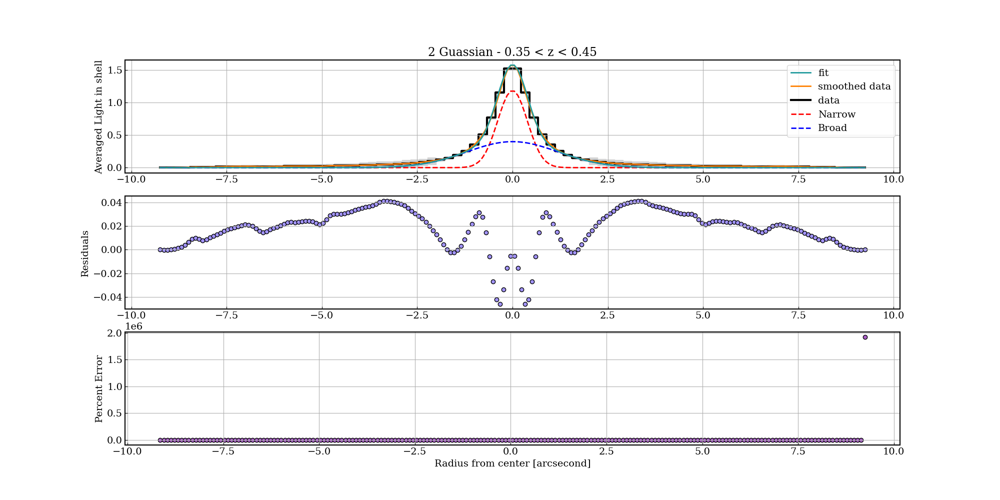

Amplitude Red = 1.1850633049096688 +0.013901557696502254 - 0.014738648814003108

Width Red = 0.38980726383185976 +0.0001885992015559501 - 0.001201004559059915

Amplitude Blue = 0.39984490897556907 +0.00015007557336399469 - 0.0011096269314839202

Width Blue = 1.1995530274411212 +0.00043853301960417035 - 0.0030483783934383


In [168]:
# 1. Generate or load data
x_Mirror_InBox_035_045 = np.linspace(-84,84,84)

x_data_Mirror_InBox_035_045 = np.multiply(x_Mirror_035_045, 0.11)
y_data_Mirror_InBox_035_045 = Mirrored_Radius_array_035_045

y_err_Mirror_InBox_035_045 = New_Err_RMS_InBox_035_045 #1.0 #Mirrored_Radius_array_SDE_035_045[0:84]

initial_Mirror_InBox_035_045 = np.array([0.6, 0.4, 0.1, 1.0]) #amp,wid ... red/narrow, blue/broad


Amplitude_Narrow_Red_Lower_Lim_Mirror_InBox_035_045 = 0
Amplitude_Narrow_Red_Upperr_Lim_Mirror_InBox_035_045 = 10

Width_Narrow_Red_Lower_Lim_Mirror_InBox_035_045 = 0
Width_Narrow_Red_Upper_Lim_Mirror_InBox_035_045 = 0.39


Amplitude_Broad_Blue_Lower_Lim_Mirror_InBox_035_045 = 0
Amplitude_Broad_Blue_Upperr_Lim_Mirror_InBox_035_045 = 0.4

Width_Broad_Blue_Lower_Lim_Mirror_InBox_035_045 = 0
Width_Broad_Blue_Upper_Lim_Mirror_InBox_035_045 = 1.2




# 2. Define the likelihood function ############################################################################################################################################
def log_likelihood(theta, x, y, yerr):
    amp1, wid1, amp2, wid2 = theta
    model = two_gaussian(x, amp1, wid1, amp2, wid2)
    sigma2 = yerr**2
    return -0.5 * np.sum((y - model)**2 / sigma2 + np.log(sigma2))

# 4. Define the prior (optional, but recommended) ############################################################################################################################################
#def log_prior(theta):
#    amp1, wid1, amp2, wid2 = theta
#    if not all(0 < param < 10 for param in [amp1, amp2, wid1, wid2]):
#        return -np.inf
#    return 0.0

def log_prior(theta):
    amp1, wid1, amp2, wid2 = theta
    if (Amplitude_Narrow_Red_Lower_Lim_Mirror_InBox_035_045 < amp1 < Amplitude_Narrow_Red_Upperr_Lim_Mirror_InBox_035_045 and Amplitude_Broad_Blue_Lower_Lim_Mirror_InBox_035_045 < amp2 <  Amplitude_Broad_Blue_Upperr_Lim_Mirror_InBox_035_045 and Width_Narrow_Red_Lower_Lim_Mirror_InBox_035_045 < wid1 < Width_Narrow_Red_Upper_Lim_Mirror_InBox_035_045 and Width_Broad_Blue_Lower_Lim_Mirror_InBox_035_045 < wid2 <  Width_Broad_Blue_Upper_Lim_Mirror_InBox_035_045):
        return 0.0
    return -np.inf

# 5. Define the probability function ############################################################################################################################################
def log_probability(theta, x, y, yerr):
    lp = log_prior(theta)
    if not np.isfinite(lp):
        return -np.inf
    return lp + log_likelihood(theta, x, y, yerr)

# 3. Optimization (finding a good starting point) ############################################################################################################################################

bounds_Mirror_InBox_035_045 = [(Amplitude_Narrow_Red_Lower_Lim_Mirror_InBox_035_045, Amplitude_Narrow_Red_Upperr_Lim_Mirror_InBox_035_045), (Width_Narrow_Red_Lower_Lim_Mirror_InBox_035_045, Width_Narrow_Red_Upper_Lim_Mirror_InBox_035_045), (Amplitude_Broad_Blue_Lower_Lim_Mirror_InBox_035_045, Amplitude_Broad_Blue_Upperr_Lim_Mirror_InBox_035_045), (Width_Broad_Blue_Lower_Lim_Mirror_InBox_035_045, Width_Broad_Blue_Upper_Lim_Mirror_InBox_035_045)] # Parameter bounds for optimization
soln_Mirror_InBox_035_045 = minimize(lambda *args: -log_likelihood(*args), initial_Mirror_InBox_035_045, args=(x_data_Mirror_InBox_035_045, y_data_Mirror_InBox_035_045, y_err_Mirror_InBox_035_045), bounds=bounds_Mirror_InBox_035_045)

#soln = minimize(lambda *args: -log_likelihood(*args), initial, args=(x_data, y_data, y_err))
pos_Mirror_InBox_035_045 = soln_Mirror_InBox_035_045.x + 1e-4 * np.random.randn(32, len(soln_Mirror_InBox_035_045.x))
nwalkers_Mirror_InBox_035_045, ndim_Mirror_InBox_035_045 = pos_Mirror_InBox_035_045.shape


# 4. MCMC sampling ############################################################################################################################################
sampler_Mirror_InBox_035_045 = emcee.EnsembleSampler(nwalkers_Mirror_InBox_035_045, ndim_Mirror_InBox_035_045, log_probability, args=(x_data_Mirror_InBox_035_045, y_data_Mirror_InBox_035_045, y_err_Mirror_InBox_035_045))
sampler_Mirror_InBox_035_045.run_mcmc(pos_Mirror_InBox_035_045, 5000, progress=True)

# 5. Analyze results
samples_Mirror_InBox_035_045 = sampler_Mirror_InBox_035_045.get_chain(flat=True)

# 6. Best fit parameters ############################################################################################################################################
best_fit_params_Mirror_InBox_035_045 = []
for i in range(ndim_Mirror_InBox_035_045):
    mcmc_Mirror_InBox_035_045 = np.percentile(samples_Mirror_InBox_035_045[:, i], [68, 95, 99.7])
    best_fit_params_Mirror_InBox_035_045.append(mcmc_Mirror_InBox_035_045[1])

# 10. Error estimation ############################################################################################################################################
errors_Mirror_InBox_035_045 = []
for i in range(ndim_Mirror_InBox_035_045):
     mcmc_Mirror_InBox_035_045 = np.percentile(samples_Mirror_InBox_035_045[:, i], [68, 95, 99.7])
     errors_Mirror_InBox_035_045.append([mcmc_Mirror_InBox_035_045[2]-mcmc_Mirror_InBox_035_045[1],mcmc_Mirror_InBox_035_045[1]-mcmc_Mirror_InBox_035_045[0]])

# 11. Getting the RMS Values ############################################################################################################################################
x_new_Mirror_InBox_035_045 = np.linspace(min(x_data_Mirror_InBox_035_045),max(x_data_Mirror_InBox_035_045), 200)

y_new_Mirror_InBox_035_045 = CubicSpline(x_data_Mirror_InBox_035_045, y_data_Mirror_InBox_035_045)

yy_new_Mirror_InBox_035_045 = y_new_Mirror_InBox_035_045(x_new_Mirror_InBox_035_045)

x_plot_Mirror_InBox_035_045 = np.linspace(min(x_data_Mirror_InBox_035_045), max(x_data_Mirror_InBox_035_045), 200)
     
# 12. Plot results ############################################################################################################################################
fig = plt.figure(figsize = (20, 10),  facecolor = "white")
ax = plt.subplot(3,1,1)

plt.plot(x_plot_Mirror_InBox_035_045, two_gaussian(x_plot_Mirror_InBox_035_045, *best_fit_params_Mirror_InBox_035_045), color = "#219B9D", linewidth=2.0, label="fit", zorder=10)
plt.plot(x_new_Mirror_InBox_035_045, yy_new_Mirror_InBox_035_045, color = "#FF8000", linewidth=2.0, label="smoothed data")
plt.step(x_data_Mirror_InBox_035_045, y_data_Mirror_InBox_035_045, color = "black", linewidth=3.0, where="mid", zorder=1, label="data")

plt.plot(x_plot_Mirror_InBox_035_045, gaussian(x_plot_Mirror_InBox_035_045, best_fit_params_Mirror_InBox_035_045[0], best_fit_params_Mirror_InBox_035_045[1]), color="red", linestyle="--", label="Narrow")
plt.plot(x_plot_Mirror_InBox_035_045, gaussian(x_plot_Mirror_InBox_035_045, best_fit_params_Mirror_InBox_035_045[2], best_fit_params_Mirror_InBox_035_045[3]), color="blue", linestyle="--", label="Broad")

plt.fill_between(x_data_Mirror_InBox_035_045, y_data_Mirror_InBox_035_045 - y_err_Mirror_InBox_035_045, y_data_Mirror_InBox_035_045 + y_err_Mirror_InBox_035_045, step="mid", color = "lightgrey", zorder=0)

plt.legend()

ax1 = plt.subplot(3,1,2)

ax1.scatter(x_new_Mirror_InBox_035_045, yy_new_Mirror_InBox_035_045 - two_gaussian(x_plot_Mirror_InBox_035_045, *best_fit_params_Mirror_InBox_035_045), c = "#A294F9", edgecolor="black") 

ax2 = plt.subplot(3,1,3)
ax2.scatter(x_new_Mirror_InBox_035_045, (yy_new_Mirror_InBox_035_045 - two_gaussian(x_plot_Mirror_InBox_035_045, *best_fit_params_Mirror_InBox_035_045))/yy_new_Mirror_InBox_035_045, c = "#AA60C8", edgecolor="black") 

plt.xlabel("x")
plt.ylabel("y")

ax.set_title("2 Guassian - 0.35 < z < 0.45")

ax2.set_xlabel("Radius from center [arcsecond]")

ax.set_ylabel("Averaged Light in shell")
ax1.set_ylabel("Residuals")
ax2.set_ylabel("Percent Error")

ax.grid()
ax1.grid()
ax2.grid()

# Show the plot
plt.show(block=False)

# Close the figure

############################################################################################################################################
Best_Fit_Mirrored_InBox_035_045 = yy_new_Mirror_InBox_035_045
Best_Fit_Mirrored_Fit_X_Array_InBox_035_045 = x_new_Mirror_InBox_035_045

Narrow_Amplitude_Fit_Mirrored_InBox_035_045 = best_fit_params_Mirror_InBox_035_045[0]
Narrow_Amplitude_Fit_Mirrored_Error_P_InBox_035_045 = errors_Mirror_InBox_035_045[0][0]
Narrow_Amplitude_Fit_Mirrored_Error_M_InBox_035_045 = errors_Mirror_InBox_035_045[0][1]
Narrow_Width_Fit_Mirrored_InBox_035_045 = best_fit_params_Mirror_InBox_035_045[1]
Narrow_Width_Fit_Mirrored_Error_P_InBox_035_045 = errors_Mirror_InBox_035_045[1][0]
Narrow_Width_Fit_Mirrored_Error_M_InBox_035_045 = errors_Mirror_InBox_035_045[1][1]

Broad_Amplitude_Fit_Mirrored_InBox_035_045 = best_fit_params_Mirror_InBox_035_045[2]
Broad_Amplitude_Fit_Mirrored_Error_P_InBox_035_045 = errors_Mirror_InBox_035_045[2][0]
Broad_Amplitude_Fit_Mirrored_Error_M_InBox_035_045 = errors_Mirror_InBox_035_045[2][1]
Broad_Width_Fit_Mirrored_InBox_035_045 = best_fit_params_Mirror_InBox_035_045[3]
Broad_Width_Fit_Mirrored_Error_P_InBox_035_045 = errors_Mirror_InBox_035_045[3][0]
Broad_Width_Fit_Mirrored_Error_M_InBox_035_045 = errors_Mirror_InBox_035_045[3][1]

Best_Fit_Mirrored_Fit_Residuals_InBox_035_045 = yy_new_Mirror_InBox_035_045 - two_gaussian(x_plot_Mirror_InBox_035_045, *best_fit_params_Mirror_InBox_035_045)
Gaussian_Fit_Mirrored_X_Array_InBox_035_045 = x_plot_Mirror_InBox_035_045

############################################################################################################################################
print("Amplitude Red = " +str(best_fit_params_Mirror_InBox_035_045[0]) + " +" +str(errors_Mirror_InBox_035_045[0][0]) + " - " +str(errors_Mirror_InBox_035_045[0][1]))
print("")
print("Width Red = " +str(best_fit_params_Mirror_InBox_035_045[1]) + " +" +str(errors_Mirror_InBox_035_045[1][0]) + " - " +str(errors_Mirror_InBox_035_045[1][1]))
print("")
print("Amplitude Blue = " +str(best_fit_params_Mirror_InBox_035_045[2]) + " +" +str(errors_Mirror_InBox_035_045[2][0]) + " - " +str(errors_Mirror_InBox_035_045[2][1]))
print("")
print("Width Blue = " +str(best_fit_params_Mirror_InBox_035_045[3]) + " +" +str(errors_Mirror_InBox_035_045[3][0]) + " - " +str(errors_Mirror_InBox_035_045[3][1]))



100%|██████████| 5000/5000 [00:08<00:00, 592.18it/s]


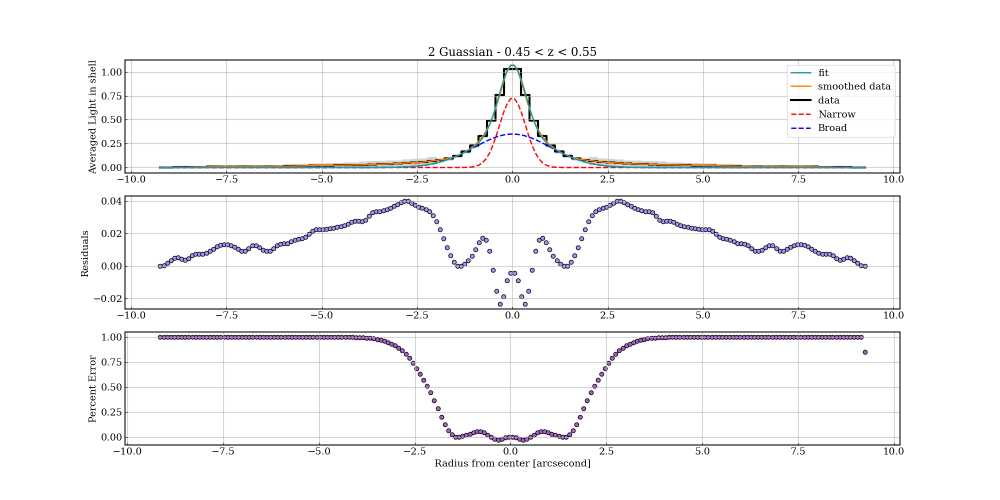

Amplitude Red = 0.7279462743214783 +0.0019031206435865533 - 0.0062901960612187224

Width Red = 0.33985430357578816 +0.00014349079529762943 - 0.0009073902273065149

Amplitude Blue = 0.3499078094864821 +8.989058979358422e-05 - 0.0006741923472567413

Width Blue = 0.9997788032290184 +0.0002156843722979085 - 0.0016842481917461738


In [169]:
# 1. Generate or load data
x_Mirror_InBox_045_055 = np.linspace(-84,84,84)

x_data_Mirror_InBox_045_055 = np.multiply(x_Mirror_045_055, 0.11)
y_data_Mirror_InBox_045_055 = Mirrored_Radius_array_045_055

y_err_Mirror_InBox_045_055 = New_Err_RMS_InBox_045_055 #1.0 #Mirrored_Radius_array_SDE_045_055[0:84]

initial_Mirror_InBox_045_055 = np.array([0.6, 0.4, 0.1, 1.0]) #amp,wid ... red/narrow, blue/broad


Amplitude_Narrow_Red_Lower_Lim_Mirror_InBox_045_055 = 0
Amplitude_Narrow_Red_Upperr_Lim_Mirror_InBox_045_055 = 0.73

Width_Narrow_Red_Lower_Lim_Mirror_InBox_045_055 = 0
Width_Narrow_Red_Upper_Lim_Mirror_InBox_045_055 = 0.34


Amplitude_Broad_Blue_Lower_Lim_Mirror_InBox_045_055 = 0
Amplitude_Broad_Blue_Upperr_Lim_Mirror_InBox_045_055 = 0.35

Width_Broad_Blue_Lower_Lim_Mirror_InBox_045_055 = 0
Width_Broad_Blue_Upper_Lim_Mirror_InBox_045_055 = 1.0



# 2. Define the likelihood function ############################################################################################################################################
def log_likelihood(theta, x, y, yerr):
    amp1, wid1, amp2, wid2 = theta
    model = two_gaussian(x, amp1, wid1, amp2, wid2)
    sigma2 = yerr**2
    return -0.5 * np.sum((y - model)**2 / sigma2 + np.log(sigma2))

# 4. Define the prior (optional, but recommended) ############################################################################################################################################
#def log_prior(theta):
#    amp1, wid1, amp2, wid2 = theta
#    if not all(0 < param < 10 for param in [amp1, amp2, wid1, wid2]):
#        return -np.inf
#    return 0.0

def log_prior(theta):
    amp1, wid1, amp2, wid2 = theta
    if (Amplitude_Narrow_Red_Lower_Lim_Mirror_InBox_045_055 < amp1 < Amplitude_Narrow_Red_Upperr_Lim_Mirror_InBox_045_055 and Amplitude_Broad_Blue_Lower_Lim_Mirror_InBox_045_055 < amp2 <  Amplitude_Broad_Blue_Upperr_Lim_Mirror_InBox_045_055 and Width_Narrow_Red_Lower_Lim_Mirror_InBox_045_055 < wid1 < Width_Narrow_Red_Upper_Lim_Mirror_InBox_045_055 and Width_Broad_Blue_Lower_Lim_Mirror_InBox_045_055 < wid2 <  Width_Broad_Blue_Upper_Lim_Mirror_InBox_045_055):
        return 0.0
    return -np.inf

# 5. Define the probability function ############################################################################################################################################
def log_probability(theta, x, y, yerr):
    lp = log_prior(theta)
    if not np.isfinite(lp):
        return -np.inf
    return lp + log_likelihood(theta, x, y, yerr)

# 3. Optimization (finding a good starting point) ############################################################################################################################################

bounds_Mirror_InBox_045_055 = [(Amplitude_Narrow_Red_Lower_Lim_Mirror_InBox_045_055, Amplitude_Narrow_Red_Upperr_Lim_Mirror_InBox_045_055), (Width_Narrow_Red_Lower_Lim_Mirror_InBox_045_055, Width_Narrow_Red_Upper_Lim_Mirror_InBox_045_055), (Amplitude_Broad_Blue_Lower_Lim_Mirror_InBox_045_055, Amplitude_Broad_Blue_Upperr_Lim_Mirror_InBox_045_055), (Width_Broad_Blue_Lower_Lim_Mirror_InBox_045_055, Width_Broad_Blue_Upper_Lim_Mirror_InBox_045_055)] # Parameter bounds for optimization
soln_Mirror_InBox_045_055 = minimize(lambda *args: -log_likelihood(*args), initial_Mirror_InBox_045_055, args=(x_data_Mirror_InBox_045_055, y_data_Mirror_InBox_045_055, y_err_Mirror_InBox_045_055), bounds=bounds_Mirror_InBox_045_055)

#soln = minimize(lambda *args: -log_likelihood(*args), initial, args=(x_data, y_data, y_err))
pos_Mirror_InBox_045_055 = soln_Mirror_InBox_045_055.x + 1e-4 * np.random.randn(32, len(soln_Mirror_InBox_045_055.x))
nwalkers_Mirror_InBox_045_055, ndim_Mirror_InBox_045_055 = pos_Mirror_InBox_045_055.shape


# 4. MCMC sampling ############################################################################################################################################
sampler_Mirror_InBox_045_055 = emcee.EnsembleSampler(nwalkers_Mirror_InBox_045_055, ndim_Mirror_InBox_045_055, log_probability, args=(x_data_Mirror_InBox_045_055, y_data_Mirror_InBox_045_055, y_err_Mirror_InBox_045_055))
sampler_Mirror_InBox_045_055.run_mcmc(pos_Mirror_InBox_045_055, 5000, progress=True)

# 5. Analyze results
samples_Mirror_InBox_045_055 = sampler_Mirror_InBox_045_055.get_chain(flat=True)

# 6. Best fit parameters ############################################################################################################################################
best_fit_params_Mirror_InBox_045_055 = []
for i in range(ndim_Mirror_InBox_045_055):
    mcmc_Mirror_InBox_045_055 = np.percentile(samples_Mirror_InBox_045_055[:, i], [68, 95, 99.7])
    best_fit_params_Mirror_InBox_045_055.append(mcmc_Mirror_InBox_045_055[1])

# 10. Error estimation ############################################################################################################################################
errors_Mirror_InBox_045_055 = []
for i in range(ndim_Mirror_InBox_045_055):
     mcmc_Mirror_InBox_045_055 = np.percentile(samples_Mirror_InBox_045_055[:, i], [68, 95, 99.7])
     errors_Mirror_InBox_045_055.append([mcmc_Mirror_InBox_045_055[2]-mcmc_Mirror_InBox_045_055[1],mcmc_Mirror_InBox_045_055[1]-mcmc_Mirror_InBox_045_055[0]])

# 11. Getting the RMS Values ############################################################################################################################################
x_new_Mirror_InBox_045_055 = np.linspace(min(x_data_Mirror_InBox_045_055),max(x_data_Mirror_InBox_045_055), 200)

y_new_Mirror_InBox_045_055 = CubicSpline(x_data_Mirror_InBox_045_055, y_data_Mirror_InBox_045_055)

yy_new_Mirror_InBox_045_055 = y_new_Mirror_InBox_045_055(x_new_Mirror_InBox_045_055)

x_plot_Mirror_InBox_045_055 = np.linspace(min(x_data_Mirror_InBox_045_055), max(x_data_Mirror_InBox_045_055), 200)
     
# 12. Plot results ############################################################################################################################################
fig = plt.figure(figsize = (20, 10),  facecolor = "white")
ax = plt.subplot(3,1,1)

plt.plot(x_plot_Mirror_InBox_045_055, two_gaussian(x_plot_Mirror_InBox_045_055, *best_fit_params_Mirror_InBox_045_055), color = "#219B9D", linewidth=2.0, label="fit", zorder=10)
plt.plot(x_new_Mirror_InBox_045_055, yy_new_Mirror_InBox_045_055, color = "#FF8000", linewidth=2.0, label="smoothed data")
plt.step(x_data_Mirror_InBox_045_055, y_data_Mirror_InBox_045_055, color = "black", linewidth=3.0, where="mid", zorder=1, label="data")

plt.plot(x_plot_Mirror_InBox_045_055, gaussian(x_plot_Mirror_InBox_045_055, best_fit_params_Mirror_InBox_045_055[0], best_fit_params_Mirror_InBox_045_055[1]), color="red", linestyle="--", label="Narrow")
plt.plot(x_plot_Mirror_InBox_045_055, gaussian(x_plot_Mirror_InBox_045_055, best_fit_params_Mirror_InBox_045_055[2], best_fit_params_Mirror_InBox_045_055[3]), color="blue", linestyle="--", label="Broad")

plt.fill_between(x_data_Mirror_InBox_045_055, y_data_Mirror_InBox_045_055 - y_err_Mirror_InBox_045_055, y_data_Mirror_InBox_045_055 + y_err_Mirror_InBox_045_055, step="mid", color = "lightgrey", zorder=0)

plt.legend()

ax1 = plt.subplot(3,1,2)

ax1.scatter(x_new_Mirror_InBox_045_055, yy_new_Mirror_InBox_045_055 - two_gaussian(x_plot_Mirror_InBox_045_055, *best_fit_params_Mirror_InBox_045_055), c = "#A294F9", edgecolor="black") 

ax2 = plt.subplot(3,1,3)
ax2.scatter(x_new_Mirror_InBox_045_055, (yy_new_Mirror_InBox_045_055 - two_gaussian(x_plot_Mirror_InBox_045_055, *best_fit_params_Mirror_InBox_045_055))/yy_new_Mirror_InBox_045_055, c = "#AA60C8", edgecolor="black") 

plt.xlabel("x")
plt.ylabel("y")

ax.set_title("2 Guassian - 0.45 < z < 0.55")

ax2.set_xlabel("Radius from center [arcsecond]")

ax.set_ylabel("Averaged Light in shell")
ax1.set_ylabel("Residuals")
ax2.set_ylabel("Percent Error")

ax.grid()
ax1.grid()
ax2.grid()

# Show the plot
plt.show(block=False)

# Close the figure

############################################################################################################################################
Best_Fit_Mirrored_InBox_045_055 = yy_new_Mirror_InBox_045_055
Best_Fit_Mirrored_Fit_X_Array_InBox_045_055 = x_new_Mirror_InBox_045_055

Narrow_Amplitude_Fit_Mirrored_InBox_045_055 = best_fit_params_Mirror_InBox_045_055[0]
Narrow_Amplitude_Fit_Mirrored_Error_P_InBox_045_055 = errors_Mirror_InBox_045_055[0][0]
Narrow_Amplitude_Fit_Mirrored_Error_M_InBox_045_055 = errors_Mirror_InBox_045_055[0][1]
Narrow_Width_Fit_Mirrored_InBox_045_055 = best_fit_params_Mirror_InBox_045_055[1]
Narrow_Width_Fit_Mirrored_Error_P_InBox_045_055 = errors_Mirror_InBox_045_055[1][0]
Narrow_Width_Fit_Mirrored_Error_M_InBox_045_055 = errors_Mirror_InBox_045_055[1][1]

Broad_Amplitude_Fit_Mirrored_InBox_045_055 = best_fit_params_Mirror_InBox_045_055[2]
Broad_Amplitude_Fit_Mirrored_Error_P_InBox_045_055 = errors_Mirror_InBox_045_055[2][0]
Broad_Amplitude_Fit_Mirrored_Error_M_InBox_045_055 = errors_Mirror_InBox_045_055[2][1]
Broad_Width_Fit_Mirrored_InBox_045_055 = best_fit_params_Mirror_InBox_045_055[3]
Broad_Width_Fit_Mirrored_Error_P_InBox_045_055 = errors_Mirror_InBox_045_055[3][0]
Broad_Width_Fit_Mirrored_Error_M_InBox_045_055 = errors_Mirror_InBox_045_055[3][1]

Best_Fit_Mirrored_Fit_Residuals_InBox_045_055 = yy_new_Mirror_InBox_045_055 - two_gaussian(x_plot_Mirror_InBox_045_055, *best_fit_params_Mirror_InBox_045_055)
Gaussian_Fit_Mirrored_X_Array_InBox_045_055 = x_plot_Mirror_InBox_045_055

############################################################################################################################################
print("Amplitude Red = " +str(best_fit_params_Mirror_InBox_045_055[0]) + " +" +str(errors_Mirror_InBox_045_055[0][0]) + " - " +str(errors_Mirror_InBox_045_055[0][1]))
print("")
print("Width Red = " +str(best_fit_params_Mirror_InBox_045_055[1]) + " +" +str(errors_Mirror_InBox_045_055[1][0]) + " - " +str(errors_Mirror_InBox_045_055[1][1]))
print("")
print("Amplitude Blue = " +str(best_fit_params_Mirror_InBox_045_055[2]) + " +" +str(errors_Mirror_InBox_045_055[2][0]) + " - " +str(errors_Mirror_InBox_045_055[2][1]))
print("")
print("Width Blue = " +str(best_fit_params_Mirror_InBox_045_055[3]) + " +" +str(errors_Mirror_InBox_045_055[3][0]) + " - " +str(errors_Mirror_InBox_045_055[3][1]))



100%|██████████| 5000/5000 [00:07<00:00, 632.41it/s]


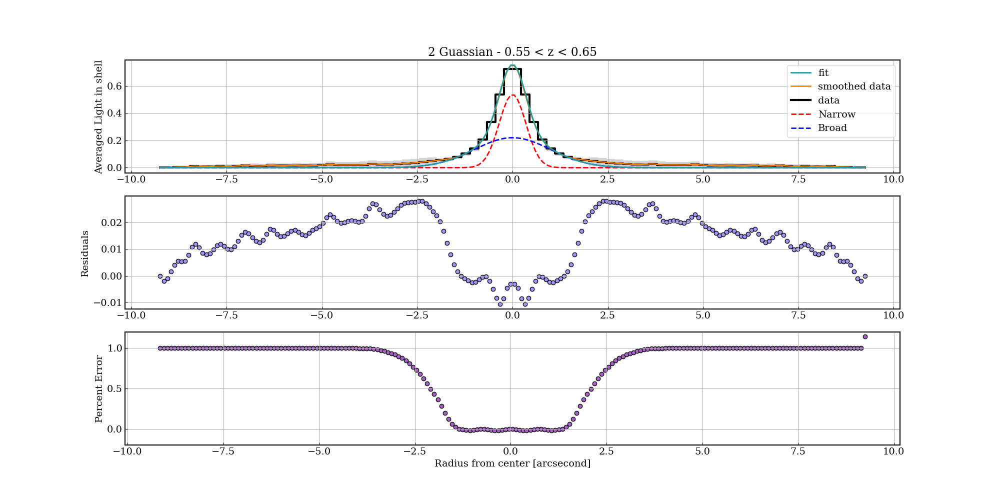

Amplitude Red = 0.5372019245008031 +0.003490921545996395 - 0.003088151902717051

Width Red = 0.3496124702491506 +0.0003634141204198471 - 0.0014096478925201272

Amplitude Blue = 0.21991913018400086 +7.871769542494578e-05 - 0.0005804048054182664

Width Blue = 0.9997368144636141 +0.00025446533456752185 - 0.0018504571641294598


In [170]:
# 1. Generate or load data
x_Mirror_InBox_055_065 = np.linspace(-84,84,84)

x_data_Mirror_InBox_055_065 = np.multiply(x_Mirror_055_065, 0.11)
y_data_Mirror_InBox_055_065 = Mirrored_Radius_array_055_065

y_err_Mirror_InBox_055_065 = New_Err_RMS_InBox_055_065 #1.0 #Mirrored_Radius_array_SDE_055_065[0:84]

initial_Mirror_InBox_055_065 = np.array([0.6, 0.4, 0.1, 1.0]) #amp,wid ... red/narrow, blue/broad


Amplitude_Narrow_Red_Lower_Lim_Mirror_InBox_055_065 = 0
Amplitude_Narrow_Red_Upperr_Lim_Mirror_InBox_055_065 = 0.63

Width_Narrow_Red_Lower_Lim_Mirror_InBox_055_065 = 0
Width_Narrow_Red_Upper_Lim_Mirror_InBox_055_065 = 0.35


Amplitude_Broad_Blue_Lower_Lim_Mirror_InBox_055_065 = 0
Amplitude_Broad_Blue_Upperr_Lim_Mirror_InBox_055_065 = 0.22

Width_Broad_Blue_Lower_Lim_Mirror_InBox_055_065 = 0
Width_Broad_Blue_Upper_Lim_Mirror_InBox_055_065 = 1.0




# 2. Define the likelihood function ############################################################################################################################################
def log_likelihood(theta, x, y, yerr):
    amp1, wid1, amp2, wid2 = theta
    model = two_gaussian(x, amp1, wid1, amp2, wid2)
    sigma2 = yerr**2
    return -0.5 * np.sum((y - model)**2 / sigma2 + np.log(sigma2))

# 4. Define the prior (optional, but recommended) ############################################################################################################################################
#def log_prior(theta):
#    amp1, wid1, amp2, wid2 = theta
#    if not all(0 < param < 10 for param in [amp1, amp2, wid1, wid2]):
#        return -np.inf
#    return 0.0

def log_prior(theta):
    amp1, wid1, amp2, wid2 = theta
    if (Amplitude_Narrow_Red_Lower_Lim_Mirror_InBox_055_065 < amp1 < Amplitude_Narrow_Red_Upperr_Lim_Mirror_InBox_055_065 and Amplitude_Broad_Blue_Lower_Lim_Mirror_InBox_055_065 < amp2 <  Amplitude_Broad_Blue_Upperr_Lim_Mirror_InBox_055_065 and Width_Narrow_Red_Lower_Lim_Mirror_InBox_055_065 < wid1 < Width_Narrow_Red_Upper_Lim_Mirror_InBox_055_065 and Width_Broad_Blue_Lower_Lim_Mirror_InBox_055_065 < wid2 <  Width_Broad_Blue_Upper_Lim_Mirror_InBox_055_065):
        return 0.0
    return -np.inf

# 5. Define the probability function ############################################################################################################################################
def log_probability(theta, x, y, yerr):
    lp = log_prior(theta)
    if not np.isfinite(lp):
        return -np.inf
    return lp + log_likelihood(theta, x, y, yerr)

# 3. Optimization (finding a good starting point) ############################################################################################################################################

bounds_Mirror_InBox_055_065 = [(Amplitude_Narrow_Red_Lower_Lim_Mirror_InBox_055_065, Amplitude_Narrow_Red_Upperr_Lim_Mirror_InBox_055_065), (Width_Narrow_Red_Lower_Lim_Mirror_InBox_055_065, Width_Narrow_Red_Upper_Lim_Mirror_InBox_055_065), (Amplitude_Broad_Blue_Lower_Lim_Mirror_InBox_055_065, Amplitude_Broad_Blue_Upperr_Lim_Mirror_InBox_055_065), (Width_Broad_Blue_Lower_Lim_Mirror_InBox_055_065, Width_Broad_Blue_Upper_Lim_Mirror_InBox_055_065)] # Parameter bounds for optimization
soln_Mirror_InBox_055_065 = minimize(lambda *args: -log_likelihood(*args), initial_Mirror_InBox_055_065, args=(x_data_Mirror_InBox_055_065, y_data_Mirror_InBox_055_065, y_err_Mirror_InBox_055_065), bounds=bounds_Mirror_InBox_055_065)

#soln = minimize(lambda *args: -log_likelihood(*args), initial, args=(x_data, y_data, y_err))
pos_Mirror_InBox_055_065 = soln_Mirror_InBox_055_065.x + 1e-4 * np.random.randn(32, len(soln_Mirror_InBox_055_065.x))
nwalkers_Mirror_InBox_055_065, ndim_Mirror_InBox_055_065 = pos_Mirror_InBox_055_065.shape


# 4. MCMC sampling ############################################################################################################################################
sampler_Mirror_InBox_055_065 = emcee.EnsembleSampler(nwalkers_Mirror_InBox_055_065, ndim_Mirror_InBox_055_065, log_probability, args=(x_data_Mirror_InBox_055_065, y_data_Mirror_InBox_055_065, y_err_Mirror_InBox_055_065))
sampler_Mirror_InBox_055_065.run_mcmc(pos_Mirror_InBox_055_065, 5000, progress=True)

# 5. Analyze results
samples_Mirror_InBox_055_065 = sampler_Mirror_InBox_055_065.get_chain(flat=True)

# 6. Best fit parameters ############################################################################################################################################
best_fit_params_Mirror_InBox_055_065 = []
for i in range(ndim_Mirror_InBox_055_065):
    mcmc_Mirror_InBox_055_065 = np.percentile(samples_Mirror_InBox_055_065[:, i], [68, 95, 99.7])
    best_fit_params_Mirror_InBox_055_065.append(mcmc_Mirror_InBox_055_065[1])

# 10. Error estimation ############################################################################################################################################
errors_Mirror_InBox_055_065 = []
for i in range(ndim_Mirror_InBox_055_065):
     mcmc_Mirror_InBox_055_065 = np.percentile(samples_Mirror_InBox_055_065[:, i], [68, 95, 99.7])
     errors_Mirror_InBox_055_065.append([mcmc_Mirror_InBox_055_065[2]-mcmc_Mirror_InBox_055_065[1],mcmc_Mirror_InBox_055_065[1]-mcmc_Mirror_InBox_055_065[0]])

# 11. Getting the RMS Values ############################################################################################################################################
x_new_Mirror_InBox_055_065 = np.linspace(min(x_data_Mirror_InBox_055_065),max(x_data_Mirror_InBox_055_065), 200)

y_new_Mirror_InBox_055_065 = CubicSpline(x_data_Mirror_InBox_055_065, y_data_Mirror_InBox_055_065)

yy_new_Mirror_InBox_055_065 = y_new_Mirror_InBox_055_065(x_new_Mirror_InBox_055_065)

x_plot_Mirror_InBox_055_065 = np.linspace(min(x_data_Mirror_InBox_055_065), max(x_data_Mirror_InBox_055_065), 200)
     
# 12. Plot results ############################################################################################################################################
fig = plt.figure(figsize = (20, 10),  facecolor = "white")
ax = plt.subplot(3,1,1)

plt.plot(x_plot_Mirror_InBox_055_065, two_gaussian(x_plot_Mirror_InBox_055_065, *best_fit_params_Mirror_InBox_055_065), color = "#219B9D", linewidth=2.0, label="fit", zorder=10)
plt.plot(x_new_Mirror_InBox_055_065, yy_new_Mirror_InBox_055_065, color = "#FF8000", linewidth=2.0, label="smoothed data")
plt.step(x_data_Mirror_InBox_055_065, y_data_Mirror_InBox_055_065, color = "black", linewidth=3.0, where="mid", zorder=1, label="data")

plt.plot(x_plot_Mirror_InBox_055_065, gaussian(x_plot_Mirror_InBox_055_065, best_fit_params_Mirror_InBox_055_065[0], best_fit_params_Mirror_InBox_055_065[1]), color="red", linestyle="--", label="Narrow")
plt.plot(x_plot_Mirror_InBox_055_065, gaussian(x_plot_Mirror_InBox_055_065, best_fit_params_Mirror_InBox_055_065[2], best_fit_params_Mirror_InBox_055_065[3]), color="blue", linestyle="--", label="Broad")

plt.fill_between(x_data_Mirror_InBox_055_065, y_data_Mirror_InBox_055_065 - y_err_Mirror_InBox_055_065, y_data_Mirror_InBox_055_065 + y_err_Mirror_InBox_055_065, step="mid", color = "lightgrey", zorder=0)

plt.legend()

ax1 = plt.subplot(3,1,2)

ax1.scatter(x_new_Mirror_InBox_055_065, yy_new_Mirror_InBox_055_065 - two_gaussian(x_plot_Mirror_InBox_055_065, *best_fit_params_Mirror_InBox_055_065), c = "#A294F9", edgecolor="black") 

ax2 = plt.subplot(3,1,3)
ax2.scatter(x_new_Mirror_InBox_055_065, (yy_new_Mirror_InBox_055_065 - two_gaussian(x_plot_Mirror_InBox_055_065, *best_fit_params_Mirror_InBox_055_065))/yy_new_Mirror_InBox_055_065, c = "#AA60C8", edgecolor="black") 

plt.ylim(-0.2,1.2)

plt.xlabel("x")
plt.ylabel("y")

ax.set_title("2 Guassian - 0.55 < z < 0.65")

ax2.set_xlabel("Radius from center [arcsecond]")

ax.set_ylabel("Averaged Light in shell")
ax1.set_ylabel("Residuals")
ax2.set_ylabel("Percent Error")

ax.grid()
ax1.grid()
ax2.grid()

# Show the plot
plt.show(block=False)


# Close the figure

############################################################################################################################################
Best_Fit_Mirrored_InBox_055_065 = yy_new_Mirror_InBox_055_065
Best_Fit_Mirrored_Fit_X_Array_InBox_055_065 = x_new_Mirror_InBox_055_065

Narrow_Amplitude_Fit_Mirrored_InBox_055_065 = best_fit_params_Mirror_InBox_055_065[0]
Narrow_Amplitude_Fit_Mirrored_Error_P_InBox_055_065 = errors_Mirror_InBox_055_065[0][0]
Narrow_Amplitude_Fit_Mirrored_Error_M_InBox_055_065 = errors_Mirror_InBox_055_065[0][1]
Narrow_Width_Fit_Mirrored_InBox_055_065 = best_fit_params_Mirror_InBox_055_065[1]
Narrow_Width_Fit_Mirrored_Error_P_InBox_055_065 = errors_Mirror_InBox_055_065[1][0]
Narrow_Width_Fit_Mirrored_Error_M_InBox_055_065 = errors_Mirror_InBox_055_065[1][1]

Broad_Amplitude_Fit_Mirrored_InBox_055_065 = best_fit_params_Mirror_InBox_055_065[2]
Broad_Amplitude_Fit_Mirrored_Error_P_InBox_055_065 = errors_Mirror_InBox_055_065[2][0]
Broad_Amplitude_Fit_Mirrored_Error_M_InBox_055_065 = errors_Mirror_InBox_055_065[2][1]
Broad_Width_Fit_Mirrored_InBox_055_065 = best_fit_params_Mirror_InBox_055_065[3]
Broad_Width_Fit_Mirrored_Error_P_InBox_055_065 = errors_Mirror_InBox_055_065[3][0]
Broad_Width_Fit_Mirrored_Error_M_InBox_055_065 = errors_Mirror_InBox_055_065[3][1]

Best_Fit_Mirrored_Fit_Residuals_InBox_055_065 = yy_new_Mirror_InBox_055_065 - two_gaussian(x_plot_Mirror_InBox_055_065, *best_fit_params_Mirror_InBox_055_065)
Gaussian_Fit_Mirrored_X_Array_InBox_055_065 = x_plot_Mirror_InBox_055_065

############################################################################################################################################
print("Amplitude Red = " +str(best_fit_params_Mirror_InBox_055_065[0]) + " +" +str(errors_Mirror_InBox_055_065[0][0]) + " - " +str(errors_Mirror_InBox_055_065[0][1]))
print("")
print("Width Red = " +str(best_fit_params_Mirror_InBox_055_065[1]) + " +" +str(errors_Mirror_InBox_055_065[1][0]) + " - " +str(errors_Mirror_InBox_055_065[1][1]))
print("")
print("Amplitude Blue = " +str(best_fit_params_Mirror_InBox_055_065[2]) + " +" +str(errors_Mirror_InBox_055_065[2][0]) + " - " +str(errors_Mirror_InBox_055_065[2][1]))
print("")
print("Width Blue = " +str(best_fit_params_Mirror_InBox_055_065[3]) + " +" +str(errors_Mirror_InBox_055_065[3][0]) + " - " +str(errors_Mirror_InBox_055_065[3][1]))



100%|██████████| 5000/5000 [00:08<00:00, 616.05it/s]


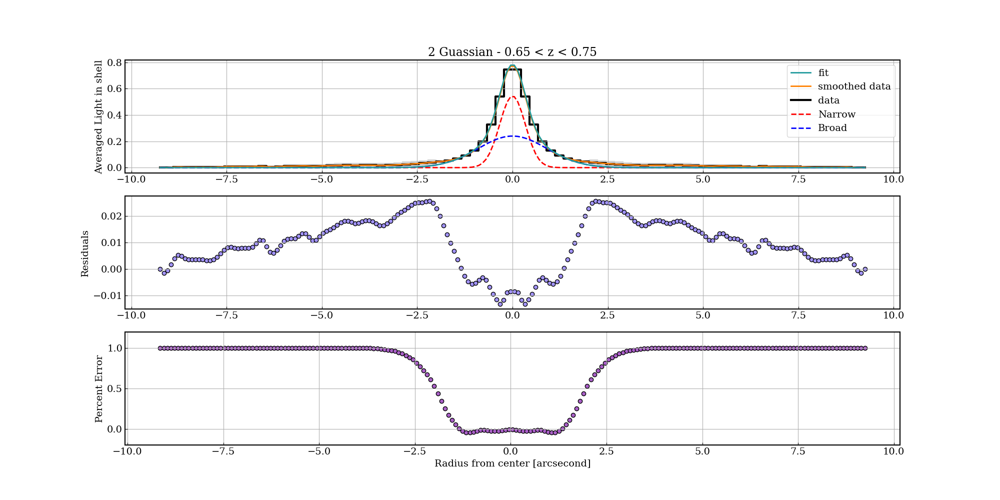

Amplitude Red = 0.5442937278572234 +0.005202916402310853 - 0.004837357983684787

Width Red = 0.33479453106143203 +0.0035575128594868 - 0.003299390410101133

Amplitude Blue = 0.2398358694802668 +0.00015551644779157603 - 0.0010903582303393722

Width Blue = 0.8997540171037326 +0.00023773009096506037 - 0.0015980888040122432


In [171]:
# 1. Generate or load data
x_Mirror_InBox_065_075 = np.linspace(-84,84,84)

x_data_Mirror_InBox_065_075 = np.multiply(x_Mirror_065_075, 0.11)
y_data_Mirror_InBox_065_075 = Mirrored_Radius_array_065_075

y_err_Mirror_InBox_065_075 = New_Err_RMS_InBox_065_075 #1.0 #Mirrored_Radius_array_SDE_065_075[0:84]

initial_Mirror_InBox_065_075 = np.array([0.6, 0.4, 0.1, 1.0]) #amp,wid ... red/narrow, blue/broad


Amplitude_Narrow_Red_Lower_Lim_Mirror_InBox_065_075 = 0
Amplitude_Narrow_Red_Upperr_Lim_Mirror_InBox_065_075 = 0.61

Width_Narrow_Red_Lower_Lim_Mirror_InBox_065_075 = 0
Width_Narrow_Red_Upper_Lim_Mirror_InBox_065_075 = 0.35


Amplitude_Broad_Blue_Lower_Lim_Mirror_InBox_065_075 = 0
Amplitude_Broad_Blue_Upperr_Lim_Mirror_InBox_065_075 = 0.24

Width_Broad_Blue_Lower_Lim_Mirror_InBox_065_075 = 0
Width_Broad_Blue_Upper_Lim_Mirror_InBox_065_075 = 0.9




# 2. Define the likelihood function ############################################################################################################################################
def log_likelihood(theta, x, y, yerr):
    amp1, wid1, amp2, wid2 = theta
    model = two_gaussian(x, amp1, wid1, amp2, wid2)
    sigma2 = yerr**2
    return -0.5 * np.sum((y - model)**2 / sigma2 + np.log(sigma2))

# 4. Define the prior (optional, but recommended) ############################################################################################################################################
#def log_prior(theta):
#    amp1, wid1, amp2, wid2 = theta
#    if not all(0 < param < 10 for param in [amp1, amp2, wid1, wid2]):
#        return -np.inf
#    return 0.0

def log_prior(theta):
    amp1, wid1, amp2, wid2 = theta
    if (Amplitude_Narrow_Red_Lower_Lim_Mirror_InBox_065_075 < amp1 < Amplitude_Narrow_Red_Upperr_Lim_Mirror_InBox_065_075 and Amplitude_Broad_Blue_Lower_Lim_Mirror_InBox_065_075 < amp2 <  Amplitude_Broad_Blue_Upperr_Lim_Mirror_InBox_065_075 and Width_Narrow_Red_Lower_Lim_Mirror_InBox_065_075 < wid1 < Width_Narrow_Red_Upper_Lim_Mirror_InBox_065_075 and Width_Broad_Blue_Lower_Lim_Mirror_InBox_065_075 < wid2 <  Width_Broad_Blue_Upper_Lim_Mirror_InBox_065_075):
        return 0.0
    return -np.inf

# 5. Define the probability function ############################################################################################################################################
def log_probability(theta, x, y, yerr):
    lp = log_prior(theta)
    if not np.isfinite(lp):
        return -np.inf
    return lp + log_likelihood(theta, x, y, yerr)

# 3. Optimization (finding a good starting point) ############################################################################################################################################

bounds_Mirror_InBox_065_075 = [(Amplitude_Narrow_Red_Lower_Lim_Mirror_InBox_065_075, Amplitude_Narrow_Red_Upperr_Lim_Mirror_InBox_065_075), (Width_Narrow_Red_Lower_Lim_Mirror_InBox_065_075, Width_Narrow_Red_Upper_Lim_Mirror_InBox_065_075), (Amplitude_Broad_Blue_Lower_Lim_Mirror_InBox_065_075, Amplitude_Broad_Blue_Upperr_Lim_Mirror_InBox_065_075), (Width_Broad_Blue_Lower_Lim_Mirror_InBox_065_075, Width_Broad_Blue_Upper_Lim_Mirror_InBox_065_075)] # Parameter bounds for optimization
soln_Mirror_InBox_065_075 = minimize(lambda *args: -log_likelihood(*args), initial_Mirror_InBox_065_075, args=(x_data_Mirror_InBox_065_075, y_data_Mirror_InBox_065_075, y_err_Mirror_InBox_065_075), bounds=bounds_Mirror_InBox_065_075)

#soln = minimize(lambda *args: -log_likelihood(*args), initial, args=(x_data, y_data, y_err))
pos_Mirror_InBox_065_075 = soln_Mirror_InBox_065_075.x + 1e-4 * np.random.randn(32, len(soln_Mirror_InBox_065_075.x))
nwalkers_Mirror_InBox_065_075, ndim_Mirror_InBox_065_075 = pos_Mirror_InBox_065_075.shape


# 4. MCMC sampling ############################################################################################################################################
sampler_Mirror_InBox_065_075 = emcee.EnsembleSampler(nwalkers_Mirror_InBox_065_075, ndim_Mirror_InBox_065_075, log_probability, args=(x_data_Mirror_InBox_065_075, y_data_Mirror_InBox_065_075, y_err_Mirror_InBox_065_075))
sampler_Mirror_InBox_065_075.run_mcmc(pos_Mirror_InBox_065_075, 5000, progress=True)

# 5. Analyze results
samples_Mirror_InBox_065_075 = sampler_Mirror_InBox_065_075.get_chain(flat=True)

# 6. Best fit parameters ############################################################################################################################################
best_fit_params_Mirror_InBox_065_075 = []
for i in range(ndim_Mirror_InBox_065_075):
    mcmc_Mirror_InBox_065_075 = np.percentile(samples_Mirror_InBox_065_075[:, i], [68, 95, 99.7])
    best_fit_params_Mirror_InBox_065_075.append(mcmc_Mirror_InBox_065_075[1])

# 10. Error estimation ############################################################################################################################################
errors_Mirror_InBox_065_075 = []
for i in range(ndim_Mirror_InBox_065_075):
     mcmc_Mirror_InBox_065_075 = np.percentile(samples_Mirror_InBox_065_075[:, i], [68, 95, 99.7])
     errors_Mirror_InBox_065_075.append([mcmc_Mirror_InBox_065_075[2]-mcmc_Mirror_InBox_065_075[1],mcmc_Mirror_InBox_065_075[1]-mcmc_Mirror_InBox_065_075[0]])

# 11. Getting the RMS Values ############################################################################################################################################
x_new_Mirror_InBox_065_075 = np.linspace(min(x_data_Mirror_InBox_065_075),max(x_data_Mirror_InBox_065_075), 200)

y_new_Mirror_InBox_065_075 = CubicSpline(x_data_Mirror_InBox_065_075, y_data_Mirror_InBox_065_075)

yy_new_Mirror_InBox_065_075 = y_new_Mirror_InBox_065_075(x_new_Mirror_InBox_065_075)

x_plot_Mirror_InBox_065_075 = np.linspace(min(x_data_Mirror_InBox_065_075), max(x_data_Mirror_InBox_065_075), 200)
     
# 12. Plot results ############################################################################################################################################
fig = plt.figure(figsize = (20, 10),  facecolor = "white")
ax = plt.subplot(3,1,1)

plt.plot(x_plot_Mirror_InBox_065_075, two_gaussian(x_plot_Mirror_InBox_065_075, *best_fit_params_Mirror_InBox_065_075), color = "#219B9D", linewidth=2.0, label="fit", zorder=10)
plt.plot(x_new_Mirror_InBox_065_075, yy_new_Mirror_InBox_065_075, color = "#FF8000", linewidth=2.0, label="smoothed data")
plt.step(x_data_Mirror_InBox_065_075, y_data_Mirror_InBox_065_075, color = "black", linewidth=3.0, where="mid", zorder=1, label="data")

plt.plot(x_plot_Mirror_InBox_065_075, gaussian(x_plot_Mirror_InBox_065_075, best_fit_params_Mirror_InBox_065_075[0], best_fit_params_Mirror_InBox_065_075[1]), color="red", linestyle="--", label="Narrow")
plt.plot(x_plot_Mirror_InBox_065_075, gaussian(x_plot_Mirror_InBox_065_075, best_fit_params_Mirror_InBox_065_075[2], best_fit_params_Mirror_InBox_065_075[3]), color="blue", linestyle="--", label="Broad")

plt.fill_between(x_data_Mirror_InBox_065_075, y_data_Mirror_InBox_065_075 - y_err_Mirror_InBox_065_075, y_data_Mirror_InBox_065_075 + y_err_Mirror_InBox_065_075, step="mid", color = "lightgrey", zorder=0)

plt.legend()

ax1 = plt.subplot(3,1,2)

ax1.scatter(x_new_Mirror_InBox_065_075, yy_new_Mirror_InBox_065_075 - two_gaussian(x_plot_Mirror_InBox_065_075, *best_fit_params_Mirror_InBox_065_075), c = "#A294F9", edgecolor="black") 

ax2 = plt.subplot(3,1,3)
ax2.scatter(x_new_Mirror_InBox_065_075, (yy_new_Mirror_InBox_065_075 - two_gaussian(x_plot_Mirror_InBox_065_075, *best_fit_params_Mirror_InBox_065_075))/yy_new_Mirror_InBox_065_075, c = "#AA60C8", edgecolor="black") 

plt.ylim(-0.2,1.2)

plt.xlabel("x")
plt.ylabel("y")

ax.set_title("2 Guassian - 0.65 < z < 0.75")

ax2.set_xlabel("Radius from center [arcsecond]")

ax.set_ylabel("Averaged Light in shell")
ax1.set_ylabel("Residuals")
ax2.set_ylabel("Percent Error")

ax.grid()
ax1.grid()
ax2.grid()

# Show the plot
plt.show(block=False)


# Close the figure

############################################################################################################################################
Best_Fit_Mirrored_InBox_065_075 = yy_new_Mirror_InBox_065_075
Best_Fit_Mirrored_Fit_X_Array_InBox_065_075 = x_new_Mirror_InBox_065_075

Narrow_Amplitude_Fit_Mirrored_InBox_065_075 = best_fit_params_Mirror_InBox_065_075[0]
Narrow_Amplitude_Fit_Mirrored_Error_P_InBox_065_075 = errors_Mirror_InBox_065_075[0][0]
Narrow_Amplitude_Fit_Mirrored_Error_M_InBox_065_075 = errors_Mirror_InBox_065_075[0][1]
Narrow_Width_Fit_Mirrored_InBox_065_075 = best_fit_params_Mirror_InBox_065_075[1]
Narrow_Width_Fit_Mirrored_Error_P_InBox_065_075 = errors_Mirror_InBox_065_075[1][0]
Narrow_Width_Fit_Mirrored_Error_M_InBox_065_075 = errors_Mirror_InBox_065_075[1][1]

Broad_Amplitude_Fit_Mirrored_InBox_065_075 = best_fit_params_Mirror_InBox_065_075[2]
Broad_Amplitude_Fit_Mirrored_Error_P_InBox_065_075 = errors_Mirror_InBox_065_075[2][0]
Broad_Amplitude_Fit_Mirrored_Error_M_InBox_065_075 = errors_Mirror_InBox_065_075[2][1]
Broad_Width_Fit_Mirrored_InBox_065_075 = best_fit_params_Mirror_InBox_065_075[3]
Broad_Width_Fit_Mirrored_Error_P_InBox_065_075 = errors_Mirror_InBox_065_075[3][0]
Broad_Width_Fit_Mirrored_Error_M_InBox_065_075 = errors_Mirror_InBox_065_075[3][1]

Best_Fit_Mirrored_Fit_Residuals_InBox_065_075 = yy_new_Mirror_InBox_065_075 - two_gaussian(x_plot_Mirror_InBox_065_075, *best_fit_params_Mirror_InBox_065_075)
Gaussian_Fit_Mirrored_X_Array_InBox_065_075 = x_plot_Mirror_InBox_065_075

############################################################################################################################################
print("Amplitude Red = " +str(best_fit_params_Mirror_InBox_065_075[0]) + " +" +str(errors_Mirror_InBox_065_075[0][0]) + " - " +str(errors_Mirror_InBox_065_075[0][1]))
print("")
print("Width Red = " +str(best_fit_params_Mirror_InBox_065_075[1]) + " +" +str(errors_Mirror_InBox_065_075[1][0]) + " - " +str(errors_Mirror_InBox_065_075[1][1]))
print("")
print("Amplitude Blue = " +str(best_fit_params_Mirror_InBox_065_075[2]) + " +" +str(errors_Mirror_InBox_065_075[2][0]) + " - " +str(errors_Mirror_InBox_065_075[2][1]))
print("")
print("Width Blue = " +str(best_fit_params_Mirror_InBox_065_075[3]) + " +" +str(errors_Mirror_InBox_065_075[3][0]) + " - " +str(errors_Mirror_InBox_065_075[3][1]))



100%|██████████| 5000/5000 [00:07<00:00, 691.31it/s]


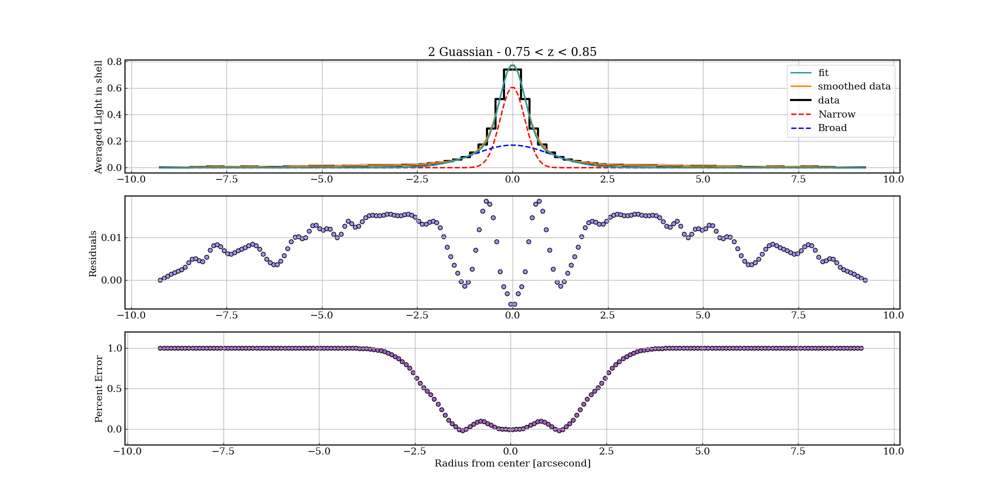

Amplitude Red = 0.6098416589430392 +0.00015473272694144224 - 0.0010776327266718289

Width Red = 0.319966910333338 +3.250793619341552e-05 - 0.00022157421509749753

Amplitude Blue = 0.16996615560366563 +3.291918789588566e-05 - 0.00021611772317903233

Width Blue = 0.999794539782676 +0.00020303092770035391 - 0.001493344102778904


In [172]:
# 1. Generate or load data
x_Mirror_InBox_075_085 = np.linspace(-84,84,84)

x_data_Mirror_InBox_075_085 = np.multiply(x_Mirror_075_085, 0.11)
y_data_Mirror_InBox_075_085 = Mirrored_Radius_array_075_085

y_err_Mirror_InBox_075_085 = New_Err_RMS_InBox_075_085 #1.0 #Mirrored_Radius_array_SDE_075_085[0:84]

initial_Mirror_InBox_075_085 = np.array([0.6, 0.4, 0.1, 1.0]) #amp,wid ... red/narrow, blue/broad


Amplitude_Narrow_Red_Lower_Lim_Mirror_InBox_075_085 = 0
Amplitude_Narrow_Red_Upperr_Lim_Mirror_InBox_075_085 = 0.61

Width_Narrow_Red_Lower_Lim_Mirror_InBox_075_085 = 0
Width_Narrow_Red_Upper_Lim_Mirror_InBox_075_085 = 0.32


Amplitude_Broad_Blue_Lower_Lim_Mirror_InBox_075_085 = 0
Amplitude_Broad_Blue_Upperr_Lim_Mirror_InBox_075_085 = 0.17

Width_Broad_Blue_Lower_Lim_Mirror_InBox_075_085 = 0
Width_Broad_Blue_Upper_Lim_Mirror_InBox_075_085 = 1.0




# 2. Define the likelihood function ############################################################################################################################################
def log_likelihood(theta, x, y, yerr):
    amp1, wid1, amp2, wid2 = theta
    model = two_gaussian(x, amp1, wid1, amp2, wid2)
    sigma2 = yerr**2
    return -0.5 * np.sum((y - model)**2 / sigma2 + np.log(sigma2))

# 4. Define the prior (optional, but recommended) ############################################################################################################################################
#def log_prior(theta):
#    amp1, wid1, amp2, wid2 = theta
#    if not all(0 < param < 10 for param in [amp1, amp2, wid1, wid2]):
#        return -np.inf
#    return 0.0

def log_prior(theta):
    amp1, wid1, amp2, wid2 = theta
    if (Amplitude_Narrow_Red_Lower_Lim_Mirror_InBox_075_085 < amp1 < Amplitude_Narrow_Red_Upperr_Lim_Mirror_InBox_075_085 and Amplitude_Broad_Blue_Lower_Lim_Mirror_InBox_075_085 < amp2 <  Amplitude_Broad_Blue_Upperr_Lim_Mirror_InBox_075_085 and Width_Narrow_Red_Lower_Lim_Mirror_InBox_075_085 < wid1 < Width_Narrow_Red_Upper_Lim_Mirror_InBox_075_085 and Width_Broad_Blue_Lower_Lim_Mirror_InBox_075_085 < wid2 <  Width_Broad_Blue_Upper_Lim_Mirror_InBox_075_085):
        return 0.0
    return -np.inf

# 5. Define the probability function ############################################################################################################################################
def log_probability(theta, x, y, yerr):
    lp = log_prior(theta)
    if not np.isfinite(lp):
        return -np.inf
    return lp + log_likelihood(theta, x, y, yerr)

# 3. Optimization (finding a good starting point) ############################################################################################################################################

bounds_Mirror_InBox_075_085 = [(Amplitude_Narrow_Red_Lower_Lim_Mirror_InBox_075_085, Amplitude_Narrow_Red_Upperr_Lim_Mirror_InBox_075_085), (Width_Narrow_Red_Lower_Lim_Mirror_InBox_075_085, Width_Narrow_Red_Upper_Lim_Mirror_InBox_075_085), (Amplitude_Broad_Blue_Lower_Lim_Mirror_InBox_075_085, Amplitude_Broad_Blue_Upperr_Lim_Mirror_InBox_075_085), (Width_Broad_Blue_Lower_Lim_Mirror_InBox_075_085, Width_Broad_Blue_Upper_Lim_Mirror_InBox_075_085)] # Parameter bounds for optimization
soln_Mirror_InBox_075_085 = minimize(lambda *args: -log_likelihood(*args), initial_Mirror_InBox_075_085, args=(x_data_Mirror_InBox_075_085, y_data_Mirror_InBox_075_085, y_err_Mirror_InBox_075_085), bounds=bounds_Mirror_InBox_075_085)

#soln = minimize(lambda *args: -log_likelihood(*args), initial, args=(x_data, y_data, y_err))
pos_Mirror_InBox_075_085 = soln_Mirror_InBox_075_085.x + 1e-4 * np.random.randn(32, len(soln_Mirror_InBox_075_085.x))
nwalkers_Mirror_InBox_075_085, ndim_Mirror_InBox_075_085 = pos_Mirror_InBox_075_085.shape


# 4. MCMC sampling ############################################################################################################################################
sampler_Mirror_InBox_075_085 = emcee.EnsembleSampler(nwalkers_Mirror_InBox_075_085, ndim_Mirror_InBox_075_085, log_probability, args=(x_data_Mirror_InBox_075_085, y_data_Mirror_InBox_075_085, y_err_Mirror_InBox_075_085))
sampler_Mirror_InBox_075_085.run_mcmc(pos_Mirror_InBox_075_085, 5000, progress=True)

# 5. Analyze results
samples_Mirror_InBox_075_085 = sampler_Mirror_InBox_075_085.get_chain(flat=True)

# 6. Best fit parameters ############################################################################################################################################
best_fit_params_Mirror_InBox_075_085 = []
for i in range(ndim_Mirror_InBox_075_085):
    mcmc_Mirror_InBox_075_085 = np.percentile(samples_Mirror_InBox_075_085[:, i], [68, 95, 99.7])
    best_fit_params_Mirror_InBox_075_085.append(mcmc_Mirror_InBox_075_085[1])

# 10. Error estimation ############################################################################################################################################
errors_Mirror_InBox_075_085 = []
for i in range(ndim_Mirror_InBox_075_085):
     mcmc_Mirror_InBox_075_085 = np.percentile(samples_Mirror_InBox_075_085[:, i], [68, 95, 99.7])
     errors_Mirror_InBox_075_085.append([mcmc_Mirror_InBox_075_085[2]-mcmc_Mirror_InBox_075_085[1],mcmc_Mirror_InBox_075_085[1]-mcmc_Mirror_InBox_075_085[0]])

# 11. Getting the RMS Values ############################################################################################################################################
x_new_Mirror_InBox_075_085 = np.linspace(min(x_data_Mirror_InBox_075_085),max(x_data_Mirror_InBox_075_085), 200)

y_new_Mirror_InBox_075_085 = CubicSpline(x_data_Mirror_InBox_075_085, y_data_Mirror_InBox_075_085)

yy_new_Mirror_InBox_075_085 = y_new_Mirror_InBox_075_085(x_new_Mirror_InBox_075_085)

x_plot_Mirror_InBox_075_085 = np.linspace(min(x_data_Mirror_InBox_075_085), max(x_data_Mirror_InBox_075_085), 200)
     
# 12. Plot results ############################################################################################################################################
fig = plt.figure(figsize = (20, 10),  facecolor = "white")
ax = plt.subplot(3,1,1)

plt.plot(x_plot_Mirror_InBox_075_085, two_gaussian(x_plot_Mirror_InBox_075_085, *best_fit_params_Mirror_InBox_075_085), color = "#219B9D", linewidth=2.0, label="fit", zorder=10)
plt.plot(x_new_Mirror_InBox_075_085, yy_new_Mirror_InBox_075_085, color = "#FF8000", linewidth=2.0, label="smoothed data")
plt.step(x_data_Mirror_InBox_075_085, y_data_Mirror_InBox_075_085, color = "black", linewidth=3.0, where="mid", zorder=1, label="data")

plt.plot(x_plot_Mirror_InBox_075_085, gaussian(x_plot_Mirror_InBox_075_085, best_fit_params_Mirror_InBox_075_085[0], best_fit_params_Mirror_InBox_075_085[1]), color="red", linestyle="--", label="Narrow")
plt.plot(x_plot_Mirror_InBox_075_085, gaussian(x_plot_Mirror_InBox_075_085, best_fit_params_Mirror_InBox_075_085[2], best_fit_params_Mirror_InBox_075_085[3]), color="blue", linestyle="--", label="Broad")

plt.fill_between(x_data_Mirror_InBox_075_085, y_data_Mirror_InBox_075_085 - y_err_Mirror_InBox_075_085, y_data_Mirror_InBox_075_085 + y_err_Mirror_InBox_075_085, step="mid", color = "lightgrey", zorder=0)

plt.legend()

ax1 = plt.subplot(3,1,2)

ax1.scatter(x_new_Mirror_InBox_075_085, yy_new_Mirror_InBox_075_085 - two_gaussian(x_plot_Mirror_InBox_075_085, *best_fit_params_Mirror_InBox_075_085), c = "#A294F9", edgecolor="black") 

ax2 = plt.subplot(3,1,3)
ax2.scatter(x_new_Mirror_InBox_075_085, (yy_new_Mirror_InBox_075_085 - two_gaussian(x_plot_Mirror_InBox_075_085, *best_fit_params_Mirror_InBox_075_085))/yy_new_Mirror_InBox_075_085, c = "#AA60C8", edgecolor="black") 

plt.ylim(-0.2,1.2)

plt.xlabel("x")
plt.ylabel("y")

ax.set_title("2 Guassian - 0.75 < z < 0.85")

ax2.set_xlabel("Radius from center [arcsecond]")

ax.set_ylabel("Averaged Light in shell")
ax1.set_ylabel("Residuals")
ax2.set_ylabel("Percent Error")

ax.grid()
ax1.grid()
ax2.grid()

# Show the plot
plt.show(block=False)


# Close the figure

############################################################################################################################################
Best_Fit_Mirrored_InBox_075_085 = yy_new_Mirror_InBox_075_085
Best_Fit_Mirrored_Fit_X_Array_InBox_075_085 = x_new_Mirror_InBox_075_085

Narrow_Amplitude_Fit_Mirrored_InBox_075_085 = best_fit_params_Mirror_InBox_075_085[0]
Narrow_Amplitude_Fit_Mirrored_Error_P_InBox_075_085 = errors_Mirror_InBox_075_085[0][0]
Narrow_Amplitude_Fit_Mirrored_Error_M_InBox_075_085 = errors_Mirror_InBox_075_085[0][1]
Narrow_Width_Fit_Mirrored_InBox_075_085 = best_fit_params_Mirror_InBox_075_085[1]
Narrow_Width_Fit_Mirrored_Error_P_InBox_075_085 = errors_Mirror_InBox_075_085[1][0]
Narrow_Width_Fit_Mirrored_Error_M_InBox_075_085 = errors_Mirror_InBox_075_085[1][1]

Broad_Amplitude_Fit_Mirrored_InBox_075_085 = best_fit_params_Mirror_InBox_075_085[2]
Broad_Amplitude_Fit_Mirrored_Error_P_InBox_075_085 = errors_Mirror_InBox_075_085[2][0]
Broad_Amplitude_Fit_Mirrored_Error_M_InBox_075_085 = errors_Mirror_InBox_075_085[2][1]
Broad_Width_Fit_Mirrored_InBox_075_085 = best_fit_params_Mirror_InBox_075_085[3]
Broad_Width_Fit_Mirrored_Error_P_InBox_075_085 = errors_Mirror_InBox_075_085[3][0]
Broad_Width_Fit_Mirrored_Error_M_InBox_075_085 = errors_Mirror_InBox_075_085[3][1]

Best_Fit_Mirrored_Fit_Residuals_InBox_075_085 = yy_new_Mirror_InBox_075_085 - two_gaussian(x_plot_Mirror_InBox_075_085, *best_fit_params_Mirror_InBox_075_085)
Gaussian_Fit_Mirrored_X_Array_InBox_075_085 = x_plot_Mirror_InBox_075_085

############################################################################################################################################
print("Amplitude Red = " +str(best_fit_params_Mirror_InBox_075_085[0]) + " +" +str(errors_Mirror_InBox_075_085[0][0]) + " - " +str(errors_Mirror_InBox_075_085[0][1]))
print("")
print("Width Red = " +str(best_fit_params_Mirror_InBox_075_085[1]) + " +" +str(errors_Mirror_InBox_075_085[1][0]) + " - " +str(errors_Mirror_InBox_075_085[1][1]))
print("")
print("Amplitude Blue = " +str(best_fit_params_Mirror_InBox_075_085[2]) + " +" +str(errors_Mirror_InBox_075_085[2][0]) + " - " +str(errors_Mirror_InBox_075_085[2][1]))
print("")
print("Width Blue = " +str(best_fit_params_Mirror_InBox_075_085[3]) + " +" +str(errors_Mirror_InBox_075_085[3][0]) + " - " +str(errors_Mirror_InBox_075_085[3][1]))



100%|██████████| 5000/5000 [00:08<00:00, 588.25it/s]


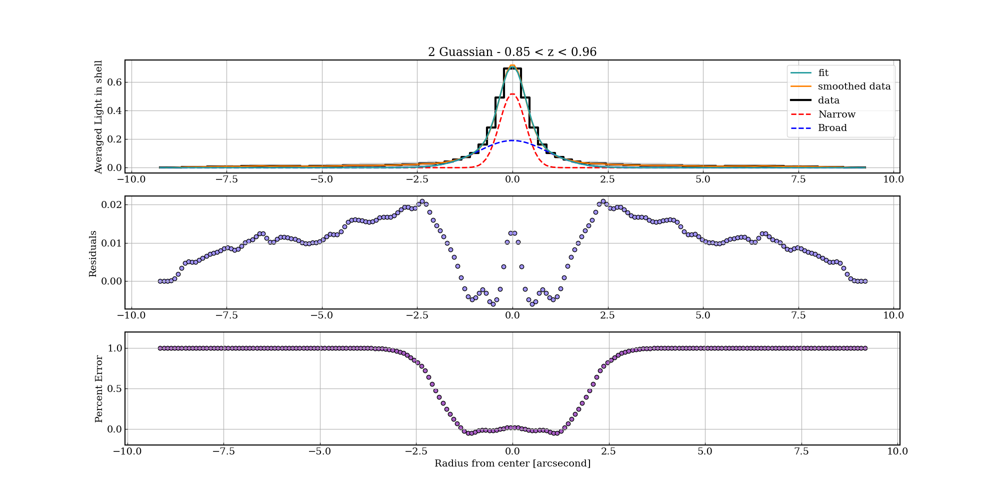

Amplitude Red = 0.5199785591226574 +2.083627902427221e-05 - 0.00014874811059528703

Width Red = 0.33547517550952244 +0.0018327442644855974 - 0.0018835622523259432

Amplitude Blue = 0.18997934174596895 +2.0043284046949994e-05 - 0.00013748104814984008

Width Blue = 0.8997747470588634 +0.00021791258650571965 - 0.0016737240205444426


In [173]:
# 1. Generate or load data
x_Mirror_InBox_085_096 = np.linspace(-84,84,84)

x_data_Mirror_InBox_085_096 = np.multiply(x_Mirror_085_096, 0.11)
y_data_Mirror_InBox_085_096 = Mirrored_Radius_array_085_096

y_err_Mirror_InBox_085_096 = New_Err_RMS_InBox_085_096 #1.0 #Mirrored_Radius_array_SDE_085_096[0:84]

initial_Mirror_InBox_085_096 = np.array([0.6, 0.4, 0.1, 1.0]) #amp,wid ... red/narrow, blue/broad


Amplitude_Narrow_Red_Lower_Lim_Mirror_InBox_085_096 = 0
Amplitude_Narrow_Red_Upperr_Lim_Mirror_InBox_085_096 = 0.52

Width_Narrow_Red_Lower_Lim_Mirror_InBox_085_096 = 0
Width_Narrow_Red_Upper_Lim_Mirror_InBox_085_096 = 10


Amplitude_Broad_Blue_Lower_Lim_Mirror_InBox_085_096 = 0
Amplitude_Broad_Blue_Upperr_Lim_Mirror_InBox_085_096 = 0.19

Width_Broad_Blue_Lower_Lim_Mirror_InBox_085_096 = 0
Width_Broad_Blue_Upper_Lim_Mirror_InBox_085_096 = 0.9




# 2. Define the likelihood function ############################################################################################################################################
def log_likelihood(theta, x, y, yerr):
    amp1, wid1, amp2, wid2 = theta
    model = two_gaussian(x, amp1, wid1, amp2, wid2)
    sigma2 = yerr**2
    return -0.5 * np.sum((y - model)**2 / sigma2 + np.log(sigma2))

# 4. Define the prior (optional, but recommended) ############################################################################################################################################
#def log_prior(theta):
#    amp1, wid1, amp2, wid2 = theta
#    if not all(0 < param < 10 for param in [amp1, amp2, wid1, wid2]):
#        return -np.inf
#    return 0.0

def log_prior(theta):
    amp1, wid1, amp2, wid2 = theta
    if (Amplitude_Narrow_Red_Lower_Lim_Mirror_InBox_085_096 < amp1 < Amplitude_Narrow_Red_Upperr_Lim_Mirror_InBox_085_096 and Amplitude_Broad_Blue_Lower_Lim_Mirror_InBox_085_096 < amp2 <  Amplitude_Broad_Blue_Upperr_Lim_Mirror_InBox_085_096 and Width_Narrow_Red_Lower_Lim_Mirror_InBox_085_096 < wid1 < Width_Narrow_Red_Upper_Lim_Mirror_InBox_085_096 and Width_Broad_Blue_Lower_Lim_Mirror_InBox_085_096 < wid2 <  Width_Broad_Blue_Upper_Lim_Mirror_InBox_085_096):
        return 0.0
    return -np.inf

# 5. Define the probability function ############################################################################################################################################
def log_probability(theta, x, y, yerr):
    lp = log_prior(theta)
    if not np.isfinite(lp):
        return -np.inf
    return lp + log_likelihood(theta, x, y, yerr)

# 3. Optimization (finding a good starting point) ############################################################################################################################################

bounds_Mirror_InBox_085_096 = [(Amplitude_Narrow_Red_Lower_Lim_Mirror_InBox_085_096, Amplitude_Narrow_Red_Upperr_Lim_Mirror_InBox_085_096), (Width_Narrow_Red_Lower_Lim_Mirror_InBox_085_096, Width_Narrow_Red_Upper_Lim_Mirror_InBox_085_096), (Amplitude_Broad_Blue_Lower_Lim_Mirror_InBox_085_096, Amplitude_Broad_Blue_Upperr_Lim_Mirror_InBox_085_096), (Width_Broad_Blue_Lower_Lim_Mirror_InBox_085_096, Width_Broad_Blue_Upper_Lim_Mirror_InBox_085_096)] # Parameter bounds for optimization
soln_Mirror_InBox_085_096 = minimize(lambda *args: -log_likelihood(*args), initial_Mirror_InBox_085_096, args=(x_data_Mirror_InBox_085_096, y_data_Mirror_InBox_085_096, y_err_Mirror_InBox_085_096), bounds=bounds_Mirror_InBox_085_096)

#soln = minimize(lambda *args: -log_likelihood(*args), initial, args=(x_data, y_data, y_err))
pos_Mirror_InBox_085_096 = soln_Mirror_InBox_085_096.x + 1e-4 * np.random.randn(32, len(soln_Mirror_InBox_085_096.x))
nwalkers_Mirror_InBox_085_096, ndim_Mirror_InBox_085_096 = pos_Mirror_InBox_085_096.shape


# 4. MCMC sampling ############################################################################################################################################
sampler_Mirror_InBox_085_096 = emcee.EnsembleSampler(nwalkers_Mirror_InBox_085_096, ndim_Mirror_InBox_085_096, log_probability, args=(x_data_Mirror_InBox_085_096, y_data_Mirror_InBox_085_096, y_err_Mirror_InBox_085_096))
sampler_Mirror_InBox_085_096.run_mcmc(pos_Mirror_InBox_085_096, 5000, progress=True)

# 5. Analyze results
samples_Mirror_InBox_085_096 = sampler_Mirror_InBox_085_096.get_chain(flat=True)

# 6. Best fit parameters ############################################################################################################################################
best_fit_params_Mirror_InBox_085_096 = []
for i in range(ndim_Mirror_InBox_085_096):
    mcmc_Mirror_InBox_085_096 = np.percentile(samples_Mirror_InBox_085_096[:, i], [68, 95, 99.7])
    best_fit_params_Mirror_InBox_085_096.append(mcmc_Mirror_InBox_085_096[1])

# 10. Error estimation ############################################################################################################################################
errors_Mirror_InBox_085_096 = []
for i in range(ndim_Mirror_InBox_085_096):
     mcmc_Mirror_InBox_085_096 = np.percentile(samples_Mirror_InBox_085_096[:, i], [68, 95, 99.7])
     errors_Mirror_InBox_085_096.append([mcmc_Mirror_InBox_085_096[2]-mcmc_Mirror_InBox_085_096[1],mcmc_Mirror_InBox_085_096[1]-mcmc_Mirror_InBox_085_096[0]])

# 11. Getting the RMS Values ############################################################################################################################################
x_new_Mirror_InBox_085_096 = np.linspace(min(x_data_Mirror_InBox_085_096),max(x_data_Mirror_InBox_085_096), 200)

y_new_Mirror_InBox_085_096 = CubicSpline(x_data_Mirror_InBox_085_096, y_data_Mirror_InBox_085_096)

yy_new_Mirror_InBox_085_096 = y_new_Mirror_InBox_085_096(x_new_Mirror_InBox_085_096)

x_plot_Mirror_InBox_085_096 = np.linspace(min(x_data_Mirror_InBox_085_096), max(x_data_Mirror_InBox_085_096), 200)
     
# 12. Plot results ############################################################################################################################################
fig = plt.figure(figsize = (20, 10),  facecolor = "white")
ax = plt.subplot(3,1,1)

plt.plot(x_plot_Mirror_InBox_085_096, two_gaussian(x_plot_Mirror_InBox_085_096, *best_fit_params_Mirror_InBox_085_096), color = "#219B9D", linewidth=2.0, label="fit", zorder=10)
plt.plot(x_new_Mirror_InBox_085_096, yy_new_Mirror_InBox_085_096, color = "#FF8000", linewidth=2.0, label="smoothed data")
plt.step(x_data_Mirror_InBox_085_096, y_data_Mirror_InBox_085_096, color = "black", linewidth=3.0, where="mid", zorder=1, label="data")

plt.plot(x_plot_Mirror_InBox_085_096, gaussian(x_plot_Mirror_InBox_085_096, best_fit_params_Mirror_InBox_085_096[0], best_fit_params_Mirror_InBox_085_096[1]), color="red", linestyle="--", label="Narrow")
plt.plot(x_plot_Mirror_InBox_085_096, gaussian(x_plot_Mirror_InBox_085_096, best_fit_params_Mirror_InBox_085_096[2], best_fit_params_Mirror_InBox_085_096[3]), color="blue", linestyle="--", label="Broad")

plt.fill_between(x_data_Mirror_InBox_085_096, y_data_Mirror_InBox_085_096 - y_err_Mirror_InBox_085_096, y_data_Mirror_InBox_085_096 + y_err_Mirror_InBox_085_096, step="mid", color = "lightgrey", zorder=0)

plt.legend()

ax1 = plt.subplot(3,1,2)

ax1.scatter(x_new_Mirror_InBox_085_096, yy_new_Mirror_InBox_085_096 - two_gaussian(x_plot_Mirror_InBox_085_096, *best_fit_params_Mirror_InBox_085_096), c = "#A294F9", edgecolor="black") 

ax2 = plt.subplot(3,1,3)
ax2.scatter(x_new_Mirror_InBox_085_096, (yy_new_Mirror_InBox_085_096 - two_gaussian(x_plot_Mirror_InBox_085_096, *best_fit_params_Mirror_InBox_085_096))/yy_new_Mirror_InBox_085_096, c = "#AA60C8", edgecolor="black") 

plt.ylim(-0.2,1.2)

#plt.ylim(-0.001,0.001)

plt.xlabel("x")
plt.ylabel("y")

ax.set_title("2 Guassian - 0.85 < z < 0.96")

ax2.set_xlabel("Radius from center [arcsecond]")

ax.set_ylabel("Averaged Light in shell")
ax1.set_ylabel("Residuals")
ax2.set_ylabel("Percent Error")

ax.grid()
ax1.grid()
ax2.grid()

# Show the plot
plt.show(block=False)


# Close the figure

############################################################################################################################################
Best_Fit_Mirrored_InBox_085_096 = yy_new_Mirror_InBox_085_096
Best_Fit_Mirrored_Fit_X_Array_InBox_085_096 = x_new_Mirror_InBox_085_096

Narrow_Amplitude_Fit_Mirrored_InBox_085_096 = best_fit_params_Mirror_InBox_085_096[0]
Narrow_Amplitude_Fit_Mirrored_Error_P_InBox_085_096 = errors_Mirror_InBox_085_096[0][0]
Narrow_Amplitude_Fit_Mirrored_Error_M_InBox_085_096 = errors_Mirror_InBox_085_096[0][1]
Narrow_Width_Fit_Mirrored_InBox_085_096 = best_fit_params_Mirror_InBox_085_096[1]
Narrow_Width_Fit_Mirrored_Error_P_InBox_085_096 = errors_Mirror_InBox_085_096[1][0]
Narrow_Width_Fit_Mirrored_Error_M_InBox_085_096 = errors_Mirror_InBox_085_096[1][1]

Broad_Amplitude_Fit_Mirrored_InBox_085_096 = best_fit_params_Mirror_InBox_085_096[2]
Broad_Amplitude_Fit_Mirrored_Error_P_InBox_085_096 = errors_Mirror_InBox_085_096[2][0]
Broad_Amplitude_Fit_Mirrored_Error_M_InBox_085_096 = errors_Mirror_InBox_085_096[2][1]
Broad_Width_Fit_Mirrored_InBox_085_096 = best_fit_params_Mirror_InBox_085_096[3]
Broad_Width_Fit_Mirrored_Error_P_InBox_085_096 = errors_Mirror_InBox_085_096[3][0]
Broad_Width_Fit_Mirrored_Error_M_InBox_085_096 = errors_Mirror_InBox_085_096[3][1]

Best_Fit_Mirrored_Fit_Residuals_InBox_085_096 = yy_new_Mirror_InBox_085_096 - two_gaussian(x_plot_Mirror_InBox_085_096, *best_fit_params_Mirror_InBox_085_096)
Gaussian_Fit_Mirrored_X_Array_InBox_085_096 = x_plot_Mirror_InBox_085_096

############################################################################################################################################
print("Amplitude Red = " +str(best_fit_params_Mirror_InBox_085_096[0]) + " +" +str(errors_Mirror_InBox_085_096[0][0]) + " - " +str(errors_Mirror_InBox_085_096[0][1]))
print("")
print("Width Red = " +str(best_fit_params_Mirror_InBox_085_096[1]) + " +" +str(errors_Mirror_InBox_085_096[1][0]) + " - " +str(errors_Mirror_InBox_085_096[1][1]))
print("")
print("Amplitude Blue = " +str(best_fit_params_Mirror_InBox_085_096[2]) + " +" +str(errors_Mirror_InBox_085_096[2][0]) + " - " +str(errors_Mirror_InBox_085_096[2][1]))
print("")
print("Width Blue = " +str(best_fit_params_Mirror_InBox_085_096[3]) + " +" +str(errors_Mirror_InBox_085_096[3][0]) + " - " +str(errors_Mirror_InBox_085_096[3][1]))



## Getting the Area Under the Curves

In [174]:
# Area under the broad and narrow curves for the OG fits (Fake errors)

Area_Under_Narrow_OG_025_035 = np.trapz(gaussian(x_plot_Mirror_025_035, best_fit_params_Mirror_025_035[0], best_fit_params_Mirror_025_035[1]), x=x_plot_Mirror_025_035)
Area_Under_Narrow_OG_035_045 = np.trapz(gaussian(x_plot_Mirror_035_045, best_fit_params_Mirror_035_045[0], best_fit_params_Mirror_035_045[1]), x=x_plot_Mirror_035_045)
Area_Under_Narrow_OG_045_055 = np.trapz(gaussian(x_plot_Mirror_045_055, best_fit_params_Mirror_045_055[0], best_fit_params_Mirror_045_055[1]), x=x_plot_Mirror_045_055)
Area_Under_Narrow_OG_055_065 = np.trapz(gaussian(x_plot_Mirror_055_065, best_fit_params_Mirror_055_065[0], best_fit_params_Mirror_055_065[1]), x=x_plot_Mirror_055_065)
Area_Under_Narrow_OG_065_075 = np.trapz(gaussian(x_plot_Mirror_065_075, best_fit_params_Mirror_065_075[0], best_fit_params_Mirror_065_075[1]), x=x_plot_Mirror_065_075)
Area_Under_Narrow_OG_075_085 = np.trapz(gaussian(x_plot_Mirror_075_085, best_fit_params_Mirror_075_085[0], best_fit_params_Mirror_075_085[1]), x=x_plot_Mirror_075_085)
Area_Under_Narrow_OG_085_096 = np.trapz(gaussian(x_plot_Mirror_085_096, best_fit_params_Mirror_085_096[0], best_fit_params_Mirror_085_096[1]), x=x_plot_Mirror_085_096)


Area_Under_Broad_OG_025_035 = np.trapz(gaussian(x_plot_Mirror_025_035, best_fit_params_Mirror_025_035[2], best_fit_params_Mirror_025_035[3]), x=x_plot_Mirror_025_035)
Area_Under_Broad_OG_035_045 = np.trapz(gaussian(x_plot_Mirror_035_045, best_fit_params_Mirror_035_045[2], best_fit_params_Mirror_035_045[3]), x=x_plot_Mirror_035_045)
Area_Under_Broad_OG_045_055 = np.trapz(gaussian(x_plot_Mirror_045_055, best_fit_params_Mirror_045_055[2], best_fit_params_Mirror_045_055[3]), x=x_plot_Mirror_045_055)
Area_Under_Broad_OG_055_065 = np.trapz(gaussian(x_plot_Mirror_055_065, best_fit_params_Mirror_055_065[2], best_fit_params_Mirror_055_065[3]), x=x_plot_Mirror_055_065)
Area_Under_Broad_OG_065_075 = np.trapz(gaussian(x_plot_Mirror_065_075, best_fit_params_Mirror_065_075[2], best_fit_params_Mirror_065_075[3]), x=x_plot_Mirror_065_075)
Area_Under_Broad_OG_075_085 = np.trapz(gaussian(x_plot_Mirror_075_085, best_fit_params_Mirror_075_085[2], best_fit_params_Mirror_075_085[3]), x=x_plot_Mirror_075_085)
Area_Under_Broad_OG_085_096 = np.trapz(gaussian(x_plot_Mirror_085_096, best_fit_params_Mirror_085_096[2], best_fit_params_Mirror_085_096[3]), x=x_plot_Mirror_085_096)


In [175]:
Area_Under_Narrow_OG_SD_025_035 = MC_Error_broad_narrow_area(x_plot_Mirror_025_035, best_fit_params_Mirror_025_035[0], best_fit_params_Mirror_025_035[1], errors_Mirror_025_035[0][0], errors_Mirror_025_035[0][1], errors_Mirror_025_035[1][0], errors_Mirror_025_035[1][1], 10000)[0]
Area_Under_Narrow_OG_SD_035_045 = MC_Error_broad_narrow_area(x_plot_Mirror_035_045, best_fit_params_Mirror_035_045[0], best_fit_params_Mirror_035_045[1], errors_Mirror_035_045[0][0], errors_Mirror_035_045[0][1], errors_Mirror_035_045[1][0], errors_Mirror_035_045[1][1], 10000)[0]
Area_Under_Narrow_OG_SD_045_055 = MC_Error_broad_narrow_area(x_plot_Mirror_045_055, best_fit_params_Mirror_045_055[0], best_fit_params_Mirror_045_055[1], errors_Mirror_045_055[0][0], errors_Mirror_045_055[0][1], errors_Mirror_045_055[1][0], errors_Mirror_045_055[1][1], 10000)[0]
Area_Under_Narrow_OG_SD_055_065 = MC_Error_broad_narrow_area(x_plot_Mirror_055_065, best_fit_params_Mirror_055_065[0], best_fit_params_Mirror_055_065[1], errors_Mirror_055_065[0][0], errors_Mirror_055_065[0][1], errors_Mirror_055_065[1][0], errors_Mirror_055_065[1][1], 10000)[0]
Area_Under_Narrow_OG_SD_065_075 = MC_Error_broad_narrow_area(x_plot_Mirror_065_075, best_fit_params_Mirror_065_075[0], best_fit_params_Mirror_065_075[1], errors_Mirror_065_075[0][0], errors_Mirror_065_075[0][1], errors_Mirror_065_075[1][0], errors_Mirror_065_075[1][1], 10000)[0]
Area_Under_Narrow_OG_SD_075_085 = MC_Error_broad_narrow_area(x_plot_Mirror_075_085, best_fit_params_Mirror_075_085[0], best_fit_params_Mirror_075_085[1], errors_Mirror_075_085[0][0], errors_Mirror_075_085[0][1], errors_Mirror_075_085[1][0], errors_Mirror_075_085[1][1], 10000)[0]
Area_Under_Narrow_OG_SD_085_096 = MC_Error_broad_narrow_area(x_plot_Mirror_085_096, best_fit_params_Mirror_085_096[0], best_fit_params_Mirror_085_096[1], errors_Mirror_085_096[0][0], errors_Mirror_085_096[0][1], errors_Mirror_085_096[1][0], errors_Mirror_085_096[1][1], 10000)[0]


Area_Under_Broad_OG_SD_025_035 = MC_Error_broad_narrow_area(x_plot_Mirror_025_035, best_fit_params_Mirror_025_035[2], best_fit_params_Mirror_025_035[3], errors_Mirror_025_035[2][0], errors_Mirror_025_035[2][1], errors_Mirror_025_035[3][0], errors_Mirror_025_035[3][1], 10000)[0]
Area_Under_Broad_OG_SD_035_045 = MC_Error_broad_narrow_area(x_plot_Mirror_035_045, best_fit_params_Mirror_035_045[2], best_fit_params_Mirror_035_045[3], errors_Mirror_035_045[2][0], errors_Mirror_035_045[2][1], errors_Mirror_035_045[3][0], errors_Mirror_035_045[3][1], 10000)[0]
Area_Under_Broad_OG_SD_045_055 = MC_Error_broad_narrow_area(x_plot_Mirror_045_055, best_fit_params_Mirror_045_055[2], best_fit_params_Mirror_045_055[3], errors_Mirror_045_055[2][0], errors_Mirror_045_055[2][1], errors_Mirror_045_055[3][0], errors_Mirror_045_055[3][1], 10000)[0]
Area_Under_Broad_OG_SD_055_065 = MC_Error_broad_narrow_area(x_plot_Mirror_055_065, best_fit_params_Mirror_055_065[2], best_fit_params_Mirror_055_065[3], errors_Mirror_055_065[2][0], errors_Mirror_055_065[2][1], errors_Mirror_055_065[3][0], errors_Mirror_055_065[3][1], 10000)[0]
Area_Under_Broad_OG_SD_065_075 = MC_Error_broad_narrow_area(x_plot_Mirror_065_075, best_fit_params_Mirror_065_075[2], best_fit_params_Mirror_065_075[3], errors_Mirror_065_075[2][0], errors_Mirror_065_075[2][1], errors_Mirror_065_075[3][0], errors_Mirror_065_075[3][1], 10000)[0]
Area_Under_Broad_OG_SD_075_085 = MC_Error_broad_narrow_area(x_plot_Mirror_075_085, best_fit_params_Mirror_075_085[2], best_fit_params_Mirror_075_085[3], errors_Mirror_075_085[2][0], errors_Mirror_075_085[2][1], errors_Mirror_075_085[3][0], errors_Mirror_075_085[3][1], 10000)[0]
Area_Under_Broad_OG_SD_085_096 = MC_Error_broad_narrow_area(x_plot_Mirror_085_096, best_fit_params_Mirror_085_096[2], best_fit_params_Mirror_085_096[3], errors_Mirror_085_096[2][0], errors_Mirror_085_096[2][1], errors_Mirror_085_096[3][0], errors_Mirror_085_096[3][1], 10000)[0]


In [176]:
# Area under the broad and narrow curves for the RE fits (The fits with errors from the RMS)

Area_Under_Narrow_RE_025_035 = np.trapz(gaussian(x_plot_Mirror_RE_025_035, best_fit_params_Mirror_RE_025_035[0], best_fit_params_Mirror_RE_025_035[1]), x=x_plot_Mirror_RE_025_035)
Area_Under_Narrow_RE_035_045 = np.trapz(gaussian(x_plot_Mirror_RE_035_045, best_fit_params_Mirror_RE_035_045[0], best_fit_params_Mirror_RE_035_045[1]), x=x_plot_Mirror_RE_035_045)
Area_Under_Narrow_RE_045_055 = np.trapz(gaussian(x_plot_Mirror_RE_045_055, best_fit_params_Mirror_RE_045_055[0], best_fit_params_Mirror_RE_045_055[1]), x=x_plot_Mirror_RE_045_055)
Area_Under_Narrow_RE_055_065 = np.trapz(gaussian(x_plot_Mirror_RE_055_065, best_fit_params_Mirror_RE_055_065[0], best_fit_params_Mirror_RE_055_065[1]), x=x_plot_Mirror_RE_055_065)
Area_Under_Narrow_RE_065_075 = np.trapz(gaussian(x_plot_Mirror_RE_065_075, best_fit_params_Mirror_RE_065_075[0], best_fit_params_Mirror_RE_065_075[1]), x=x_plot_Mirror_RE_065_075)
Area_Under_Narrow_RE_075_085 = np.trapz(gaussian(x_plot_Mirror_RE_075_085, best_fit_params_Mirror_RE_075_085[0], best_fit_params_Mirror_RE_075_085[1]), x=x_plot_Mirror_RE_075_085)
Area_Under_Narrow_RE_085_096 = np.trapz(gaussian(x_plot_Mirror_RE_085_096, best_fit_params_Mirror_RE_085_096[0], best_fit_params_Mirror_RE_085_096[1]), x=x_plot_Mirror_RE_085_096)


Area_Under_Broad_RE_025_035 = np.trapz(gaussian(x_plot_Mirror_RE_025_035, best_fit_params_Mirror_RE_025_035[2], best_fit_params_Mirror_RE_025_035[3]), x=x_plot_Mirror_RE_025_035)
Area_Under_Broad_RE_035_045 = np.trapz(gaussian(x_plot_Mirror_RE_035_045, best_fit_params_Mirror_RE_035_045[2], best_fit_params_Mirror_RE_035_045[3]), x=x_plot_Mirror_RE_035_045)
Area_Under_Broad_RE_045_055 = np.trapz(gaussian(x_plot_Mirror_RE_045_055, best_fit_params_Mirror_RE_045_055[2], best_fit_params_Mirror_RE_045_055[3]), x=x_plot_Mirror_RE_045_055)
Area_Under_Broad_RE_055_065 = np.trapz(gaussian(x_plot_Mirror_RE_055_065, best_fit_params_Mirror_RE_055_065[2], best_fit_params_Mirror_RE_055_065[3]), x=x_plot_Mirror_RE_055_065)
Area_Under_Broad_RE_065_075 = np.trapz(gaussian(x_plot_Mirror_RE_065_075, best_fit_params_Mirror_RE_065_075[2], best_fit_params_Mirror_RE_065_075[3]), x=x_plot_Mirror_RE_065_075)
Area_Under_Broad_RE_075_085 = np.trapz(gaussian(x_plot_Mirror_RE_075_085, best_fit_params_Mirror_RE_075_085[2], best_fit_params_Mirror_RE_075_085[3]), x=x_plot_Mirror_RE_075_085)
Area_Under_Broad_RE_085_096 = np.trapz(gaussian(x_plot_Mirror_RE_085_096, best_fit_params_Mirror_RE_085_096[2], best_fit_params_Mirror_RE_085_096[3]), x=x_plot_Mirror_RE_085_096)



In [177]:
Area_Under_Narrow_RE_SD_025_035 = MC_Error_broad_narrow_area(x_plot_Mirror_RE_025_035, best_fit_params_Mirror_RE_025_035[0], best_fit_params_Mirror_RE_025_035[1], errors_Mirror_RE_025_035[0][0], errors_Mirror_RE_025_035[0][1], errors_Mirror_RE_025_035[1][0], errors_Mirror_RE_025_035[1][1], 10000)[0]
Area_Under_Narrow_RE_SD_035_045 = MC_Error_broad_narrow_area(x_plot_Mirror_RE_035_045, best_fit_params_Mirror_RE_035_045[0], best_fit_params_Mirror_RE_035_045[1], errors_Mirror_RE_035_045[0][0], errors_Mirror_RE_035_045[0][1], errors_Mirror_RE_035_045[1][0], errors_Mirror_RE_035_045[1][1], 10000)[0]
Area_Under_Narrow_RE_SD_045_055 = MC_Error_broad_narrow_area(x_plot_Mirror_RE_045_055, best_fit_params_Mirror_RE_045_055[0], best_fit_params_Mirror_RE_045_055[1], errors_Mirror_RE_045_055[0][0], errors_Mirror_RE_045_055[0][1], errors_Mirror_RE_045_055[1][0], errors_Mirror_RE_045_055[1][1], 10000)[0]
Area_Under_Narrow_RE_SD_055_065 = MC_Error_broad_narrow_area(x_plot_Mirror_RE_055_065, best_fit_params_Mirror_RE_055_065[0], best_fit_params_Mirror_RE_055_065[1], errors_Mirror_RE_055_065[0][0], errors_Mirror_RE_055_065[0][1], errors_Mirror_RE_055_065[1][0], errors_Mirror_RE_055_065[1][1], 10000)[0]
Area_Under_Narrow_RE_SD_065_075 = MC_Error_broad_narrow_area(x_plot_Mirror_RE_065_075, best_fit_params_Mirror_RE_065_075[0], best_fit_params_Mirror_RE_065_075[1], errors_Mirror_RE_065_075[0][0], errors_Mirror_RE_065_075[0][1], errors_Mirror_RE_065_075[1][0], errors_Mirror_RE_065_075[1][1], 10000)[0]
Area_Under_Narrow_RE_SD_075_085 = MC_Error_broad_narrow_area(x_plot_Mirror_RE_075_085, best_fit_params_Mirror_RE_075_085[0], best_fit_params_Mirror_RE_075_085[1], errors_Mirror_RE_075_085[0][0], errors_Mirror_RE_075_085[0][1], errors_Mirror_RE_075_085[1][0], errors_Mirror_RE_075_085[1][1], 10000)[0]
Area_Under_Narrow_RE_SD_085_096 = MC_Error_broad_narrow_area(x_plot_Mirror_RE_085_096, best_fit_params_Mirror_RE_085_096[0], best_fit_params_Mirror_RE_085_096[1], errors_Mirror_RE_085_096[0][0], errors_Mirror_RE_085_096[0][1], errors_Mirror_RE_085_096[1][0], errors_Mirror_RE_085_096[1][1], 10000)[0]


Area_Under_Broad_RE_SD_025_035 = MC_Error_broad_narrow_area(x_plot_Mirror_RE_025_035, best_fit_params_Mirror_RE_025_035[2], best_fit_params_Mirror_RE_025_035[3], errors_Mirror_RE_025_035[2][0], errors_Mirror_RE_025_035[2][1], errors_Mirror_RE_025_035[3][0], errors_Mirror_RE_025_035[3][1], 10000)[0]
Area_Under_Broad_RE_SD_035_045 = MC_Error_broad_narrow_area(x_plot_Mirror_RE_035_045, best_fit_params_Mirror_RE_035_045[2], best_fit_params_Mirror_RE_035_045[3], errors_Mirror_RE_035_045[2][0], errors_Mirror_RE_035_045[2][1], errors_Mirror_RE_035_045[3][0], errors_Mirror_RE_035_045[3][1], 10000)[0]
Area_Under_Broad_RE_SD_045_055 = MC_Error_broad_narrow_area(x_plot_Mirror_RE_045_055, best_fit_params_Mirror_RE_045_055[2], best_fit_params_Mirror_RE_045_055[3], errors_Mirror_RE_045_055[2][0], errors_Mirror_RE_045_055[2][1], errors_Mirror_RE_045_055[3][0], errors_Mirror_RE_045_055[3][1], 10000)[0]
Area_Under_Broad_RE_SD_055_065 = MC_Error_broad_narrow_area(x_plot_Mirror_RE_055_065, best_fit_params_Mirror_RE_055_065[2], best_fit_params_Mirror_RE_055_065[3], errors_Mirror_RE_055_065[2][0], errors_Mirror_RE_055_065[2][1], errors_Mirror_RE_055_065[3][0], errors_Mirror_RE_055_065[3][1], 10000)[0]
Area_Under_Broad_RE_SD_065_075 = MC_Error_broad_narrow_area(x_plot_Mirror_RE_065_075, best_fit_params_Mirror_RE_065_075[2], best_fit_params_Mirror_RE_065_075[3], errors_Mirror_RE_065_075[2][0], errors_Mirror_RE_065_075[2][1], errors_Mirror_RE_065_075[3][0], errors_Mirror_RE_065_075[3][1], 10000)[0]
Area_Under_Broad_RE_SD_075_085 = MC_Error_broad_narrow_area(x_plot_Mirror_RE_075_085, best_fit_params_Mirror_RE_075_085[2], best_fit_params_Mirror_RE_075_085[3], errors_Mirror_RE_075_085[2][0], errors_Mirror_RE_075_085[2][1], errors_Mirror_RE_075_085[3][0], errors_Mirror_RE_075_085[3][1], 10000)[0]
Area_Under_Broad_RE_SD_085_096 = MC_Error_broad_narrow_area(x_plot_Mirror_RE_085_096, best_fit_params_Mirror_RE_085_096[2], best_fit_params_Mirror_RE_085_096[3], errors_Mirror_RE_085_096[2][0], errors_Mirror_RE_085_096[2][1], errors_Mirror_RE_085_096[3][0], errors_Mirror_RE_085_096[3][1], 10000)[0]


In [178]:
# Area under the broad and narrow curves for the wing averaged RE fits (The RMS errors but with the wings using a median error)

Area_Under_Narrow_InBox_025_035 = np.trapz(gaussian(x_plot_Mirror_InBox_025_035, best_fit_params_Mirror_InBox_025_035[0], best_fit_params_Mirror_InBox_025_035[1]), x=x_plot_Mirror_InBox_025_035)
Area_Under_Narrow_InBox_035_045 = np.trapz(gaussian(x_plot_Mirror_InBox_035_045, best_fit_params_Mirror_InBox_035_045[0], best_fit_params_Mirror_InBox_035_045[1]), x=x_plot_Mirror_InBox_035_045)
Area_Under_Narrow_InBox_045_055 = np.trapz(gaussian(x_plot_Mirror_InBox_045_055, best_fit_params_Mirror_InBox_045_055[0], best_fit_params_Mirror_InBox_045_055[1]), x=x_plot_Mirror_InBox_045_055)
Area_Under_Narrow_InBox_055_065 = np.trapz(gaussian(x_plot_Mirror_InBox_055_065, best_fit_params_Mirror_InBox_055_065[0], best_fit_params_Mirror_InBox_055_065[1]), x=x_plot_Mirror_InBox_055_065)
Area_Under_Narrow_InBox_065_075 = np.trapz(gaussian(x_plot_Mirror_InBox_065_075, best_fit_params_Mirror_InBox_065_075[0], best_fit_params_Mirror_InBox_065_075[1]), x=x_plot_Mirror_InBox_065_075)
Area_Under_Narrow_InBox_075_085 = np.trapz(gaussian(x_plot_Mirror_InBox_075_085, best_fit_params_Mirror_InBox_075_085[0], best_fit_params_Mirror_InBox_075_085[1]), x=x_plot_Mirror_InBox_075_085)
Area_Under_Narrow_InBox_085_096 = np.trapz(gaussian(x_plot_Mirror_InBox_085_096, best_fit_params_Mirror_InBox_085_096[0], best_fit_params_Mirror_InBox_085_096[1]), x=x_plot_Mirror_InBox_085_096)


Area_Under_Broad_InBox_025_035 = np.trapz(gaussian(x_plot_Mirror_InBox_025_035, best_fit_params_Mirror_InBox_025_035[2], best_fit_params_Mirror_InBox_025_035[3]), x=x_plot_Mirror_InBox_025_035)
Area_Under_Broad_InBox_035_045 = np.trapz(gaussian(x_plot_Mirror_InBox_035_045, best_fit_params_Mirror_InBox_035_045[2], best_fit_params_Mirror_InBox_035_045[3]), x=x_plot_Mirror_InBox_035_045)
Area_Under_Broad_InBox_045_055 = np.trapz(gaussian(x_plot_Mirror_InBox_045_055, best_fit_params_Mirror_InBox_045_055[2], best_fit_params_Mirror_InBox_045_055[3]), x=x_plot_Mirror_InBox_045_055)
Area_Under_Broad_InBox_055_065 = np.trapz(gaussian(x_plot_Mirror_InBox_055_065, best_fit_params_Mirror_InBox_055_065[2], best_fit_params_Mirror_InBox_055_065[3]), x=x_plot_Mirror_InBox_055_065)
Area_Under_Broad_InBox_065_075 = np.trapz(gaussian(x_plot_Mirror_InBox_065_075, best_fit_params_Mirror_InBox_065_075[2], best_fit_params_Mirror_InBox_065_075[3]), x=x_plot_Mirror_InBox_065_075)
Area_Under_Broad_InBox_075_085 = np.trapz(gaussian(x_plot_Mirror_InBox_075_085, best_fit_params_Mirror_InBox_075_085[2], best_fit_params_Mirror_InBox_075_085[3]), x=x_plot_Mirror_InBox_075_085)
Area_Under_Broad_InBox_085_096 = np.trapz(gaussian(x_plot_Mirror_InBox_085_096, best_fit_params_Mirror_InBox_085_096[2], best_fit_params_Mirror_InBox_085_096[3]), x=x_plot_Mirror_InBox_085_096)



In [179]:
Area_Under_Narrow_InBox_SD_025_035 = MC_Error_broad_narrow_area(x_plot_Mirror_InBox_025_035, best_fit_params_Mirror_InBox_025_035[0], best_fit_params_Mirror_InBox_025_035[1], errors_Mirror_InBox_025_035[0][0], errors_Mirror_InBox_025_035[0][1], errors_Mirror_InBox_025_035[1][0], errors_Mirror_InBox_025_035[1][1], 10000)[0]
Area_Under_Narrow_InBox_SD_035_045 = MC_Error_broad_narrow_area(x_plot_Mirror_InBox_035_045, best_fit_params_Mirror_InBox_035_045[0], best_fit_params_Mirror_InBox_035_045[1], errors_Mirror_InBox_035_045[0][0], errors_Mirror_InBox_035_045[0][1], errors_Mirror_InBox_035_045[1][0], errors_Mirror_InBox_035_045[1][1], 10000)[0]
Area_Under_Narrow_InBox_SD_045_055 = MC_Error_broad_narrow_area(x_plot_Mirror_InBox_045_055, best_fit_params_Mirror_InBox_045_055[0], best_fit_params_Mirror_InBox_045_055[1], errors_Mirror_InBox_045_055[0][0], errors_Mirror_InBox_045_055[0][1], errors_Mirror_InBox_045_055[1][0], errors_Mirror_InBox_045_055[1][1], 10000)[0]
Area_Under_Narrow_InBox_SD_055_065 = MC_Error_broad_narrow_area(x_plot_Mirror_InBox_055_065, best_fit_params_Mirror_InBox_055_065[0], best_fit_params_Mirror_InBox_055_065[1], errors_Mirror_InBox_055_065[0][0], errors_Mirror_InBox_055_065[0][1], errors_Mirror_InBox_055_065[1][0], errors_Mirror_InBox_055_065[1][1], 10000)[0]
Area_Under_Narrow_InBox_SD_065_075 = MC_Error_broad_narrow_area(x_plot_Mirror_InBox_065_075, best_fit_params_Mirror_InBox_065_075[0], best_fit_params_Mirror_InBox_065_075[1], errors_Mirror_InBox_065_075[0][0], errors_Mirror_InBox_065_075[0][1], errors_Mirror_InBox_065_075[1][0], errors_Mirror_InBox_065_075[1][1], 10000)[0]
Area_Under_Narrow_InBox_SD_075_085 = MC_Error_broad_narrow_area(x_plot_Mirror_InBox_075_085, best_fit_params_Mirror_InBox_075_085[0], best_fit_params_Mirror_InBox_075_085[1], errors_Mirror_InBox_075_085[0][0], errors_Mirror_InBox_075_085[0][1], errors_Mirror_InBox_075_085[1][0], errors_Mirror_InBox_075_085[1][1], 10000)[0]
Area_Under_Narrow_InBox_SD_085_096 = MC_Error_broad_narrow_area(x_plot_Mirror_InBox_085_096, best_fit_params_Mirror_InBox_085_096[0], best_fit_params_Mirror_InBox_085_096[1], errors_Mirror_InBox_085_096[0][0], errors_Mirror_InBox_085_096[0][1], errors_Mirror_InBox_085_096[1][0], errors_Mirror_InBox_085_096[1][1], 10000)[0]


Area_Under_Broad_InBox_SD_025_035 = MC_Error_broad_narrow_area(x_plot_Mirror_InBox_025_035, best_fit_params_Mirror_InBox_025_035[2], best_fit_params_Mirror_InBox_025_035[3], errors_Mirror_InBox_025_035[2][0], errors_Mirror_InBox_025_035[2][1], errors_Mirror_InBox_025_035[3][0], errors_Mirror_InBox_025_035[3][1], 10000)[0]
Area_Under_Broad_InBox_SD_035_045 = MC_Error_broad_narrow_area(x_plot_Mirror_InBox_035_045, best_fit_params_Mirror_InBox_035_045[2], best_fit_params_Mirror_InBox_035_045[3], errors_Mirror_InBox_035_045[2][0], errors_Mirror_InBox_035_045[2][1], errors_Mirror_InBox_035_045[3][0], errors_Mirror_InBox_035_045[3][1], 10000)[0]
Area_Under_Broad_InBox_SD_045_055 = MC_Error_broad_narrow_area(x_plot_Mirror_InBox_045_055, best_fit_params_Mirror_InBox_045_055[2], best_fit_params_Mirror_InBox_045_055[3], errors_Mirror_InBox_045_055[2][0], errors_Mirror_InBox_045_055[2][1], errors_Mirror_InBox_045_055[3][0], errors_Mirror_InBox_045_055[3][1], 10000)[0]
Area_Under_Broad_InBox_SD_055_065 = MC_Error_broad_narrow_area(x_plot_Mirror_InBox_055_065, best_fit_params_Mirror_InBox_055_065[2], best_fit_params_Mirror_InBox_055_065[3], errors_Mirror_InBox_055_065[2][0], errors_Mirror_InBox_055_065[2][1], errors_Mirror_InBox_055_065[3][0], errors_Mirror_InBox_055_065[3][1], 10000)[0]
Area_Under_Broad_InBox_SD_065_075 = MC_Error_broad_narrow_area(x_plot_Mirror_InBox_065_075, best_fit_params_Mirror_InBox_065_075[2], best_fit_params_Mirror_InBox_065_075[3], errors_Mirror_InBox_065_075[2][0], errors_Mirror_InBox_065_075[2][1], errors_Mirror_InBox_065_075[3][0], errors_Mirror_InBox_065_075[3][1], 10000)[0]
Area_Under_Broad_InBox_SD_075_085 = MC_Error_broad_narrow_area(x_plot_Mirror_InBox_075_085, best_fit_params_Mirror_InBox_075_085[2], best_fit_params_Mirror_InBox_075_085[3], errors_Mirror_InBox_075_085[2][0], errors_Mirror_InBox_075_085[2][1], errors_Mirror_InBox_075_085[3][0], errors_Mirror_InBox_075_085[3][1], 10000)[0]
Area_Under_Broad_InBox_SD_085_096 = MC_Error_broad_narrow_area(x_plot_Mirror_InBox_085_096, best_fit_params_Mirror_InBox_085_096[2], best_fit_params_Mirror_InBox_085_096[3], errors_Mirror_InBox_085_096[2][0], errors_Mirror_InBox_085_096[2][1], errors_Mirror_InBox_085_096[3][0], errors_Mirror_InBox_085_096[3][1], 10000)[0]


In [180]:
print(Area_Under_Narrow_InBox_025_035, Area_Under_Narrow_InBox_SD_025_035)
print(Area_Under_Narrow_InBox_035_045, Area_Under_Narrow_InBox_SD_035_045)
print(Area_Under_Narrow_InBox_045_055, Area_Under_Narrow_InBox_SD_045_055)
print(Area_Under_Narrow_InBox_055_065, Area_Under_Narrow_InBox_SD_055_065)
print(Area_Under_Narrow_InBox_065_075, Area_Under_Narrow_InBox_SD_065_075)
print(Area_Under_Narrow_InBox_075_085, Area_Under_Narrow_InBox_SD_075_085)
print(Area_Under_Narrow_InBox_085_096, Area_Under_Narrow_InBox_SD_085_096)
print("")
print(Area_Under_Broad_InBox_025_035, Area_Under_Broad_InBox_SD_025_035)
print(Area_Under_Broad_InBox_035_045, Area_Under_Broad_InBox_SD_035_045)
print(Area_Under_Broad_InBox_045_055, Area_Under_Broad_InBox_SD_045_055)
print(Area_Under_Broad_InBox_055_065, Area_Under_Broad_InBox_SD_055_065)
print(Area_Under_Broad_InBox_065_075, Area_Under_Broad_InBox_SD_065_075)
print(Area_Under_Broad_InBox_075_085, Area_Under_Broad_InBox_SD_075_085)
print(Area_Under_Broad_InBox_085_096, Area_Under_Broad_InBox_SD_085_096)

1.8527419603763018 0.003502400842219642
1.1579276177234186 0.008211729263497518
0.6201289917207462 0.0020935531280160424
0.4707761023934052 0.001800515205766447
0.4567742561512249 0.00363580771982116
0.4891162481154273 0.00030780788471156345
0.4372559815102407 0.0014025016161106582

2.2548283324441023 0.0018523936266143873
1.2022670813079213 0.0014721743408077075
0.8768947995606486 0.0007319303331556675
0.5511104273744265 0.0005890003579909311
0.540913554695923 0.0008791915696081665
0.42595443669045435 0.0002782528104056611
0.4284795634944556 0.0002779445775148366


## Getting the Fractional Areas

In [181]:
# Fractional mag for the OG fits (Fake errors)

Fractional_Area_Broad_OG_025_035 = Area_Under_Broad_OG_025_035 / (Area_Under_Broad_OG_025_035 + Area_Under_Narrow_OG_025_035)
Fractional_Area_Broad_OG_035_045 = Area_Under_Broad_OG_035_045 / (Area_Under_Broad_OG_035_045 + Area_Under_Narrow_OG_035_045)
Fractional_Area_Broad_OG_045_055 = Area_Under_Broad_OG_045_055 / (Area_Under_Broad_OG_045_055 + Area_Under_Narrow_OG_045_055)
Fractional_Area_Broad_OG_055_065 = Area_Under_Broad_OG_055_065 / (Area_Under_Broad_OG_055_065 + Area_Under_Narrow_OG_055_065)
Fractional_Area_Broad_OG_065_075 = Area_Under_Broad_OG_065_075 / (Area_Under_Broad_OG_065_075 + Area_Under_Narrow_OG_065_075)
Fractional_Area_Broad_OG_075_085 = Area_Under_Broad_OG_075_085 / (Area_Under_Broad_OG_075_085 + Area_Under_Narrow_OG_075_085)
Fractional_Area_Broad_OG_085_096 = Area_Under_Broad_OG_085_096 / (Area_Under_Broad_OG_085_096 + Area_Under_Narrow_OG_085_096)


In [182]:
Fractional_Area_Broad_OG_SD_025_035 = MC_Error_Frac_broad_narrow_area(Area_Under_Broad_OG_025_035, Area_Under_Narrow_OG_025_035, Area_Under_Broad_OG_SD_025_035, Area_Under_Narrow_OG_SD_025_035, 10000)[0]
Fractional_Area_Broad_OG_SD_035_045 = MC_Error_Frac_broad_narrow_area(Area_Under_Broad_OG_035_045, Area_Under_Narrow_OG_035_045, Area_Under_Broad_OG_SD_035_045, Area_Under_Narrow_OG_SD_035_045, 10000)[0]
Fractional_Area_Broad_OG_SD_045_055 = MC_Error_Frac_broad_narrow_area(Area_Under_Broad_OG_045_055, Area_Under_Narrow_OG_045_055, Area_Under_Broad_OG_SD_045_055, Area_Under_Narrow_OG_SD_045_055, 10000)[0]
Fractional_Area_Broad_OG_SD_055_065 = MC_Error_Frac_broad_narrow_area(Area_Under_Broad_OG_055_065, Area_Under_Narrow_OG_055_065, Area_Under_Broad_OG_SD_055_065, Area_Under_Narrow_OG_SD_055_065, 10000)[0]
Fractional_Area_Broad_OG_SD_065_075 = MC_Error_Frac_broad_narrow_area(Area_Under_Broad_OG_065_075, Area_Under_Narrow_OG_065_075, Area_Under_Broad_OG_SD_065_075, Area_Under_Narrow_OG_SD_065_075, 10000)[0]
Fractional_Area_Broad_OG_SD_075_085 = MC_Error_Frac_broad_narrow_area(Area_Under_Broad_OG_075_085, Area_Under_Narrow_OG_075_085, Area_Under_Broad_OG_SD_075_085, Area_Under_Narrow_OG_SD_075_085, 10000)[0]
Fractional_Area_Broad_OG_SD_085_096 = MC_Error_Frac_broad_narrow_area(Area_Under_Broad_OG_085_096, Area_Under_Narrow_OG_085_096, Area_Under_Broad_OG_SD_085_096, Area_Under_Narrow_OG_SD_085_096, 10000)[0]

In [183]:
# Fractional mag for the RE fits (The fits with errors from the RMS)

Fractional_Area_Broad_RE_025_035 = Area_Under_Broad_RE_025_035 / (Area_Under_Broad_RE_025_035 + Area_Under_Narrow_RE_025_035)
Fractional_Area_Broad_RE_035_045 = Area_Under_Broad_RE_035_045 / (Area_Under_Broad_RE_035_045 + Area_Under_Narrow_RE_035_045)
Fractional_Area_Broad_RE_045_055 = Area_Under_Broad_RE_045_055 / (Area_Under_Broad_RE_045_055 + Area_Under_Narrow_RE_045_055)
Fractional_Area_Broad_RE_055_065 = Area_Under_Broad_RE_055_065 / (Area_Under_Broad_RE_055_065 + Area_Under_Narrow_RE_055_065)
Fractional_Area_Broad_RE_065_075 = Area_Under_Broad_RE_065_075 / (Area_Under_Broad_RE_065_075 + Area_Under_Narrow_RE_065_075)
Fractional_Area_Broad_RE_075_085 = Area_Under_Broad_RE_075_085 / (Area_Under_Broad_RE_075_085 + Area_Under_Narrow_RE_075_085)
Fractional_Area_Broad_RE_085_096 = Area_Under_Broad_RE_085_096 / (Area_Under_Broad_RE_085_096 + Area_Under_Narrow_RE_085_096)


In [184]:
Fractional_Area_Broad_RE_SD_025_035 = MC_Error_Frac_broad_narrow_area(Area_Under_Broad_RE_025_035, Area_Under_Narrow_RE_025_035, Area_Under_Broad_RE_SD_025_035, Area_Under_Narrow_RE_SD_025_035, 10000)[0]
Fractional_Area_Broad_RE_SD_035_045 = MC_Error_Frac_broad_narrow_area(Area_Under_Broad_RE_035_045, Area_Under_Narrow_RE_035_045, Area_Under_Broad_RE_SD_035_045, Area_Under_Narrow_RE_SD_035_045, 10000)[0]
Fractional_Area_Broad_RE_SD_045_055 = MC_Error_Frac_broad_narrow_area(Area_Under_Broad_RE_045_055, Area_Under_Narrow_RE_045_055, Area_Under_Broad_RE_SD_045_055, Area_Under_Narrow_RE_SD_045_055, 10000)[0]
Fractional_Area_Broad_RE_SD_055_065 = MC_Error_Frac_broad_narrow_area(Area_Under_Broad_RE_055_065, Area_Under_Narrow_RE_055_065, Area_Under_Broad_RE_SD_055_065, Area_Under_Narrow_RE_SD_055_065, 10000)[0]
Fractional_Area_Broad_RE_SD_065_075 = MC_Error_Frac_broad_narrow_area(Area_Under_Broad_RE_065_075, Area_Under_Narrow_RE_065_075, Area_Under_Broad_RE_SD_065_075, Area_Under_Narrow_RE_SD_065_075, 10000)[0]
Fractional_Area_Broad_RE_SD_075_085 = MC_Error_Frac_broad_narrow_area(Area_Under_Broad_RE_075_085, Area_Under_Narrow_RE_075_085, Area_Under_Broad_RE_SD_075_085, Area_Under_Narrow_RE_SD_075_085, 10000)[0]
Fractional_Area_Broad_RE_SD_085_096 = MC_Error_Frac_broad_narrow_area(Area_Under_Broad_RE_085_096, Area_Under_Narrow_RE_085_096, Area_Under_Broad_RE_SD_085_096, Area_Under_Narrow_RE_SD_085_096, 10000)[0]

In [185]:
# Fractional mag for the wing averaged RE fits (The RMS errors but with the wings using a median error)

Fractional_Area_Broad_InBox_025_035 = Area_Under_Broad_InBox_025_035 / (Area_Under_Broad_InBox_025_035 + Area_Under_Narrow_InBox_025_035)
Fractional_Area_Broad_InBox_035_045 = Area_Under_Broad_InBox_035_045 / (Area_Under_Broad_InBox_035_045 + Area_Under_Narrow_InBox_035_045)
Fractional_Area_Broad_InBox_045_055 = Area_Under_Broad_InBox_045_055 / (Area_Under_Broad_InBox_045_055 + Area_Under_Narrow_InBox_045_055)
Fractional_Area_Broad_InBox_055_065 = Area_Under_Broad_InBox_055_065 / (Area_Under_Broad_InBox_055_065 + Area_Under_Narrow_InBox_055_065)
Fractional_Area_Broad_InBox_065_075 = Area_Under_Broad_InBox_065_075 / (Area_Under_Broad_InBox_065_075 + Area_Under_Narrow_InBox_065_075)
Fractional_Area_Broad_InBox_075_085 = Area_Under_Broad_InBox_075_085 / (Area_Under_Broad_InBox_075_085 + Area_Under_Narrow_InBox_075_085)
Fractional_Area_Broad_InBox_085_096 = Area_Under_Broad_InBox_085_096 / (Area_Under_Broad_InBox_085_096 + Area_Under_Narrow_InBox_085_096)



In [186]:
Fractional_Area_Broad_InBox_SD_025_035 = MC_Error_Frac_broad_narrow_area(Area_Under_Broad_InBox_025_035, Area_Under_Narrow_InBox_025_035, Area_Under_Broad_InBox_SD_025_035, Area_Under_Narrow_InBox_SD_025_035, 10000)[0]
Fractional_Area_Broad_InBox_SD_035_045 = MC_Error_Frac_broad_narrow_area(Area_Under_Broad_InBox_035_045, Area_Under_Narrow_InBox_035_045, Area_Under_Broad_InBox_SD_035_045, Area_Under_Narrow_InBox_SD_035_045, 10000)[0]
Fractional_Area_Broad_InBox_SD_045_055 = MC_Error_Frac_broad_narrow_area(Area_Under_Broad_InBox_045_055, Area_Under_Narrow_InBox_045_055, Area_Under_Broad_InBox_SD_045_055, Area_Under_Narrow_InBox_SD_045_055, 10000)[0]
Fractional_Area_Broad_InBox_SD_055_065 = MC_Error_Frac_broad_narrow_area(Area_Under_Broad_InBox_055_065, Area_Under_Narrow_InBox_055_065, Area_Under_Broad_InBox_SD_055_065, Area_Under_Narrow_InBox_SD_055_065, 10000)[0]
Fractional_Area_Broad_InBox_SD_065_075 = MC_Error_Frac_broad_narrow_area(Area_Under_Broad_InBox_065_075, Area_Under_Narrow_InBox_065_075, Area_Under_Broad_InBox_SD_065_075, Area_Under_Narrow_InBox_SD_065_075, 10000)[0]
Fractional_Area_Broad_InBox_SD_075_085 = MC_Error_Frac_broad_narrow_area(Area_Under_Broad_InBox_075_085, Area_Under_Narrow_InBox_075_085, Area_Under_Broad_InBox_SD_075_085, Area_Under_Narrow_InBox_SD_075_085, 10000)[0]
Fractional_Area_Broad_InBox_SD_085_096 = MC_Error_Frac_broad_narrow_area(Area_Under_Broad_InBox_085_096, Area_Under_Narrow_InBox_085_096, Area_Under_Broad_InBox_SD_085_096, Area_Under_Narrow_InBox_SD_085_096, 10000)[0]

In [187]:
print(Fractional_Area_Broad_InBox_025_035, Fractional_Area_Broad_InBox_SD_025_035)
print(Fractional_Area_Broad_InBox_035_045, Fractional_Area_Broad_InBox_SD_035_045)
print(Fractional_Area_Broad_InBox_045_055, Fractional_Area_Broad_InBox_SD_045_055)
print(Fractional_Area_Broad_InBox_055_065, Fractional_Area_Broad_InBox_SD_055_065)
print(Fractional_Area_Broad_InBox_065_075, Fractional_Area_Broad_InBox_SD_065_075)
print(Fractional_Area_Broad_InBox_075_085, Fractional_Area_Broad_InBox_SD_075_085)
print(Fractional_Area_Broad_InBox_085_096, Fractional_Area_Broad_InBox_SD_085_096)

0.5489445515723255 0.0003746381449986495
0.5093931792158292 0.0010902205925754714
0.5857587599259597 0.0005469318155942855
0.5393068714778307 0.0006416482208984037
0.5421671476938534 0.001260096505748961
0.46548801503876625 0.0001991034606248617
0.4949312361803641 0.0005019003787878512


In [188]:
print(Area_Under_Broad_InBox_025_035, Area_Under_Narrow_InBox_025_035, Area_Under_Broad_InBox_SD_025_035, Area_Under_Narrow_InBox_SD_025_035)

2.2548283324441023 1.8527419603763018 0.0018523936266143873 0.003502400842219642


## Getting the Magnitude of the Galaxy parts

In [189]:
# The total magnitude for the stacked images for each redshift

#   Convert to flux using the zero point magnitude of the filters

Z_Flux_025_035 = []
Z_Flux_035_045 = []
Z_Flux_045_055 = []
Z_Flux_055_065 = []
Z_Flux_065_075 = []
Z_Flux_075_085 = []
Z_Flux_085_096 = []

for i in Z_Mag_025_035:
    flux = 10**( (1/-2.5) * (i - Mag_Zero_Point))
    Z_Flux_025_035.append(flux)

for i in Z_Mag_035_045:
    flux = 10**( (1/-2.5) * (i - Mag_Zero_Point))
    Z_Flux_035_045.append(flux)

for i in Z_Mag_045_055:
    flux = 10**( (1/-2.5) * (i - Mag_Zero_Point))
    Z_Flux_045_055.append(flux)

for i in Z_Mag_055_065:
    flux = 10**( (1/-2.5) * (i - Mag_Zero_Point))
    Z_Flux_055_065.append(flux)

for i in Z_Mag_065_075:
    flux = 10**( (1/-2.5) * (i - Mag_Zero_Point))
    Z_Flux_065_075.append(flux)

for i in Z_Mag_075_085:
    flux = 10**( (1/-2.5) * (i - Mag_Zero_Point))
    Z_Flux_075_085.append(flux)

for i in Z_Mag_085_096:
    flux = 10**( (1/-2.5) * (i - Mag_Zero_Point))
    Z_Flux_085_096.append(flux)

# Finding the standard deviation on the flux

Z_Flux_SD_025_035 = MC_Error_flux(Z_Mag_025_035, Z_Mag_Err_025_035, 10000)[0]
Z_Flux_SD_035_045 = MC_Error_flux(Z_Mag_035_045, Z_Mag_Err_035_045, 10000)[0]
Z_Flux_SD_045_055 = MC_Error_flux(Z_Mag_045_055, Z_Mag_Err_045_055, 10000)[0]
Z_Flux_SD_055_065 = MC_Error_flux(Z_Mag_055_065, Z_Mag_Err_055_065, 10000)[0]
Z_Flux_SD_065_075 = MC_Error_flux(Z_Mag_065_075, Z_Mag_Err_065_075, 10000)[0]
Z_Flux_SD_075_085 = MC_Error_flux(Z_Mag_075_085, Z_Mag_Err_075_085, 10000)[0]
Z_Flux_SD_085_096 = MC_Error_flux(Z_Mag_085_096, Z_Mag_Err_085_096, 10000)[0]
    

#    Find the median flux
Flux_Med_Total_025_035 = np.median(Z_Flux_025_035)
Flux_Med_Total_035_045 = np.median(Z_Flux_035_045)
Flux_Med_Total_045_055 = np.median(Z_Flux_045_055)
Flux_Med_Total_055_065 = np.median(Z_Flux_055_065)
Flux_Med_Total_065_075 = np.median(Z_Flux_065_075)
Flux_Med_Total_075_085 = np.median(Z_Flux_075_085)
Flux_Med_Total_085_096 = np.median(Z_Flux_085_096)

# Finding the standard deviation of the median flux

Flux_Med_Total_SD_025_035 = MC_Error_med_flux( Z_Flux_025_035, Z_Flux_SD_025_035, 10000)[0]#1.253 * (np.std(Z_Flux_SD_025_035) / np.sqrt(len(Z_Flux_025_035)))
Flux_Med_Total_SD_035_045 = MC_Error_med_flux( Z_Flux_035_045, Z_Flux_SD_035_045, 10000)[0]#1.253 * (np.std(Z_Flux_SD_035_045) / np.sqrt(len(Z_Flux_035_045)))
Flux_Med_Total_SD_045_055 = MC_Error_med_flux( Z_Flux_045_055, Z_Flux_SD_045_055, 10000)[0]#1.253 * (np.std(Z_Flux_SD_045_055) / np.sqrt(len(Z_Flux_045_055)))
Flux_Med_Total_SD_055_065 = MC_Error_med_flux( Z_Flux_055_065, Z_Flux_SD_055_065, 10000)[0]#1.253 * (np.std(Z_Flux_SD_055_065) / np.sqrt(len(Z_Flux_055_065)))
Flux_Med_Total_SD_065_075 = MC_Error_med_flux( Z_Flux_065_075, Z_Flux_SD_065_075, 10000)[0]#1.253 * (np.std(Z_Flux_SD_065_075) / np.sqrt(len(Z_Flux_065_075)))
Flux_Med_Total_SD_075_085 = MC_Error_med_flux( Z_Flux_075_085, Z_Flux_SD_075_085, 10000)[0]#1.253 * (np.std(Z_Flux_SD_075_085) / np.sqrt(len(Z_Flux_075_085)))
Flux_Med_Total_SD_085_096 = MC_Error_med_flux( Z_Flux_085_096, Z_Flux_SD_085_096, 10000)[0]#1.253 * (np.std(Z_Flux_SD_085_096) / np.sqrt(len(Z_Flux_085_096)))


#   Convert back into mag

Mag_Total_025_035 = -2.5*np.log10(Flux_Med_Total_025_035) + Mag_Zero_Point
Mag_Total_035_045 = -2.5*np.log10(Flux_Med_Total_035_045) + Mag_Zero_Point
Mag_Total_045_055 = -2.5*np.log10(Flux_Med_Total_045_055) + Mag_Zero_Point
Mag_Total_055_065 = -2.5*np.log10(Flux_Med_Total_055_065) + Mag_Zero_Point
Mag_Total_065_075 = -2.5*np.log10(Flux_Med_Total_065_075) + Mag_Zero_Point
Mag_Total_075_085 = -2.5*np.log10(Flux_Med_Total_075_085) + Mag_Zero_Point
Mag_Total_085_096 = -2.5*np.log10(Flux_Med_Total_085_096) + Mag_Zero_Point

# Finding the standard deviation of the total mag

Mag_Total_SD_025_035 = MC_Error_mag_tot(Flux_Med_Total_025_035, Flux_Med_Total_SD_025_035, 10000)[0]
Mag_Total_SD_035_045 = MC_Error_mag_tot(Flux_Med_Total_035_045, Flux_Med_Total_SD_035_045, 10000)[0]
Mag_Total_SD_045_055 = MC_Error_mag_tot(Flux_Med_Total_045_055, Flux_Med_Total_SD_045_055, 10000)[0]
Mag_Total_SD_055_065 = MC_Error_mag_tot(Flux_Med_Total_055_065, Flux_Med_Total_SD_055_065, 10000)[0]
Mag_Total_SD_065_075 = MC_Error_mag_tot(Flux_Med_Total_065_075, Flux_Med_Total_SD_065_075, 10000)[0]
Mag_Total_SD_075_085 = MC_Error_mag_tot(Flux_Med_Total_075_085, Flux_Med_Total_SD_075_085, 10000)[0]
Mag_Total_SD_085_096 = MC_Error_mag_tot(Flux_Med_Total_085_096, Flux_Med_Total_SD_085_096, 10000)[0]

print(np.array(Z_Mag_025_035))
print("")
print(np.array(Z_Mag_Err_025_035))
print("")
print(Z_Flux_025_035[1], Z_Flux_SD_025_035[1])
print(Z_Flux_035_045[1], Z_Flux_SD_035_045[1])
print(Z_Flux_045_055[1], Z_Flux_SD_045_055[1])
print(Z_Flux_055_065[1], Z_Flux_SD_055_065[1])
print(Z_Flux_065_075[1], Z_Flux_SD_065_075[1])
print(Z_Flux_075_085[1], Z_Flux_SD_075_085[1])
print(Z_Flux_085_096[1], Z_Flux_SD_085_096[1])
print("")
print(Flux_Med_Total_025_035, Flux_Med_Total_SD_025_035)
print(Flux_Med_Total_035_045, Flux_Med_Total_SD_035_045)
print(Flux_Med_Total_045_055, Flux_Med_Total_SD_045_055)
print(Flux_Med_Total_055_065, Flux_Med_Total_SD_055_065)
print(Flux_Med_Total_065_075, Flux_Med_Total_SD_065_075)
print(Flux_Med_Total_075_085, Flux_Med_Total_SD_075_085)
print(Flux_Med_Total_085_096, Flux_Med_Total_SD_085_096)
print("")
print(Mag_Total_025_035,Mag_Total_SD_025_035)
print(Mag_Total_035_045,Mag_Total_SD_035_045)
print(Mag_Total_045_055,Mag_Total_SD_045_055)
print(Mag_Total_055_065,Mag_Total_SD_055_065)
print(Mag_Total_065_075,Mag_Total_SD_065_075)
print(Mag_Total_075_085,Mag_Total_SD_075_085)
print(Mag_Total_085_096,Mag_Total_SD_085_096)

print("")
print("")
print(np.median(Z_Flux_025_035), np.std(Z_Flux_025_035)/np.sqrt(len(Z_Flux_025_035)))
print(np.median(Z_Flux_035_045), np.std(Z_Flux_035_045)/np.sqrt(len(Z_Flux_035_045)))
print(np.median(Z_Flux_045_055), np.std(Z_Flux_045_055)/np.sqrt(len(Z_Flux_045_055)))
print(np.median(Z_Flux_055_065), np.std(Z_Flux_055_065)/np.sqrt(len(Z_Flux_055_065)))
print(np.median(Z_Flux_065_075), np.std(Z_Flux_065_075)/np.sqrt(len(Z_Flux_065_075)))
print(np.median(Z_Flux_075_085), np.std(Z_Flux_075_085)/np.sqrt(len(Z_Flux_075_085)))
print(np.median(Z_Flux_085_096), np.std(Z_Flux_085_096)/np.sqrt(len(Z_Flux_085_096)))

[17.22472883 17.84590354 20.02666685 17.38182988 18.00093552 19.2881782
 18.6144766  17.68508047 17.92564357 17.69976917 17.47322825 18.18360592
 18.96398995 20.68211808 17.93679465 17.83057963 17.63676694 18.20418794
 19.22653985 18.09579088 18.54988448 18.04874592 18.14151743 18.17622464
 18.77696603 20.12451943 19.52716724 18.97060796 19.49538144 18.24702147
 18.64393288 17.64914184 17.65769584]

[0.00059909 0.00215453 0.00528282 0.00147873 0.0012958  0.00370353
 0.00138894 0.00110453 0.00137565 0.0023494  0.00081994 0.002002
 0.00248995 0.00911246 0.00069346 0.00299179 0.0016506  0.00187568
 0.00284373 0.00076843 0.00150905 0.00083106 0.00266531 0.0026327
 0.00339606 0.00754331 0.00591293 0.00408042 0.00417403 0.00153391
 0.00184296 0.00072268 0.00074035]

4588.160309484818 5.200733446389787
649.1593055387434 3.053609072872286
803.5413979572517 2.5137350647822685
449.689104303005 1.6215979651241805
738.0386062352802 2.2739252399319616
777.2697766330092 1.7754721461079839
610.268244

In [190]:
# The Magnitude of the galaxy component for each redshift

Gal_Mag_OG_025_035 = Mag_Total_025_035 - 2.5*np.log10(Fractional_Area_Broad_OG_025_035)
Gal_Mag_OG_035_045 = Mag_Total_035_045 - 2.5*np.log10(Fractional_Area_Broad_OG_035_045)
Gal_Mag_OG_045_055 = Mag_Total_045_055 - 2.5*np.log10(Fractional_Area_Broad_OG_045_055)
Gal_Mag_OG_055_065 = Mag_Total_055_065 - 2.5*np.log10(Fractional_Area_Broad_OG_055_065)
Gal_Mag_OG_065_075 = Mag_Total_065_075 - 2.5*np.log10(Fractional_Area_Broad_OG_065_075)
Gal_Mag_OG_075_085 = Mag_Total_075_085 - 2.5*np.log10(Fractional_Area_Broad_OG_075_085)
Gal_Mag_OG_085_096 = Mag_Total_085_096 - 2.5*np.log10(Fractional_Area_Broad_OG_085_096)

Gal_Mag_RE_025_035 = Mag_Total_025_035 - 2.5*np.log10(Fractional_Area_Broad_RE_025_035)
Gal_Mag_RE_035_045 = Mag_Total_035_045 - 2.5*np.log10(Fractional_Area_Broad_RE_035_045)
Gal_Mag_RE_045_055 = Mag_Total_045_055 - 2.5*np.log10(Fractional_Area_Broad_RE_045_055)
Gal_Mag_RE_055_065 = Mag_Total_055_065 - 2.5*np.log10(Fractional_Area_Broad_RE_055_065)
Gal_Mag_RE_065_075 = Mag_Total_065_075 - 2.5*np.log10(Fractional_Area_Broad_RE_065_075)
Gal_Mag_RE_075_085 = Mag_Total_075_085 - 2.5*np.log10(Fractional_Area_Broad_RE_075_085)
Gal_Mag_RE_085_096 = Mag_Total_085_096 - 2.5*np.log10(Fractional_Area_Broad_RE_085_096)

Gal_Mag_InBox_025_035 = Mag_Total_025_035 - 2.5*np.log10(Fractional_Area_Broad_InBox_025_035)
Gal_Mag_InBox_035_045 = Mag_Total_035_045 - 2.5*np.log10(Fractional_Area_Broad_InBox_035_045)
Gal_Mag_InBox_045_055 = Mag_Total_045_055 - 2.5*np.log10(Fractional_Area_Broad_InBox_045_055)
Gal_Mag_InBox_055_065 = Mag_Total_055_065 - 2.5*np.log10(Fractional_Area_Broad_InBox_055_065)
Gal_Mag_InBox_065_075 = Mag_Total_065_075 - 2.5*np.log10(Fractional_Area_Broad_InBox_065_075)
Gal_Mag_InBox_075_085 = Mag_Total_075_085 - 2.5*np.log10(Fractional_Area_Broad_InBox_075_085)
Gal_Mag_InBox_085_096 = Mag_Total_085_096 - 2.5*np.log10(Fractional_Area_Broad_InBox_085_096)

print(Gal_Mag_OG_025_035, Mag_Total_025_035)

18.83745372073344 18.17622463799195


In [191]:
Gal_Mag_OG_SD_025_035 = MC_Error_mag_gal(Mag_Total_025_035, Mag_Total_SD_025_035, Fractional_Area_Broad_OG_025_035, Fractional_Area_Broad_OG_SD_025_035, 10000)[0]
Gal_Mag_OG_SD_035_045 = MC_Error_mag_gal(Mag_Total_035_045, Mag_Total_SD_035_045, Fractional_Area_Broad_OG_035_045, Fractional_Area_Broad_OG_SD_035_045, 10000)[0]
Gal_Mag_OG_SD_045_055 = MC_Error_mag_gal(Mag_Total_045_055, Mag_Total_SD_045_055, Fractional_Area_Broad_OG_045_055, Fractional_Area_Broad_OG_SD_045_055, 10000)[0]
Gal_Mag_OG_SD_055_065 = MC_Error_mag_gal(Mag_Total_055_065, Mag_Total_SD_055_065, Fractional_Area_Broad_OG_055_065, Fractional_Area_Broad_OG_SD_055_065, 10000)[0]
Gal_Mag_OG_SD_065_075 = MC_Error_mag_gal(Mag_Total_065_075, Mag_Total_SD_065_075, Fractional_Area_Broad_OG_065_075, Fractional_Area_Broad_OG_SD_065_075, 10000)[0]
Gal_Mag_OG_SD_075_085 = MC_Error_mag_gal(Mag_Total_075_085, Mag_Total_SD_075_085, Fractional_Area_Broad_OG_075_085, Fractional_Area_Broad_OG_SD_075_085, 10000)[0]
Gal_Mag_OG_SD_085_096 = MC_Error_mag_gal(Mag_Total_085_096, Mag_Total_SD_085_096, Fractional_Area_Broad_OG_085_096, Fractional_Area_Broad_OG_SD_085_096, 10000)[0]

In [192]:
Gal_Mag_RE_SD_025_035 = MC_Error_mag_gal(Mag_Total_025_035, Mag_Total_SD_025_035, Fractional_Area_Broad_RE_025_035, Fractional_Area_Broad_RE_SD_025_035, 10000)[0]
Gal_Mag_RE_SD_035_045 = MC_Error_mag_gal(Mag_Total_035_045, Mag_Total_SD_035_045, Fractional_Area_Broad_RE_035_045, Fractional_Area_Broad_RE_SD_035_045, 10000)[0]
Gal_Mag_RE_SD_045_055 = MC_Error_mag_gal(Mag_Total_045_055, Mag_Total_SD_045_055, Fractional_Area_Broad_RE_045_055, Fractional_Area_Broad_RE_SD_045_055, 10000)[0]
Gal_Mag_RE_SD_055_065 = MC_Error_mag_gal(Mag_Total_055_065, Mag_Total_SD_055_065, Fractional_Area_Broad_RE_055_065, Fractional_Area_Broad_RE_SD_055_065, 10000)[0]
Gal_Mag_RE_SD_065_075 = MC_Error_mag_gal(Mag_Total_065_075, Mag_Total_SD_065_075, Fractional_Area_Broad_RE_065_075, Fractional_Area_Broad_RE_SD_065_075, 10000)[0]
Gal_Mag_RE_SD_075_085 = MC_Error_mag_gal(Mag_Total_075_085, Mag_Total_SD_075_085, Fractional_Area_Broad_RE_075_085, Fractional_Area_Broad_RE_SD_075_085, 10000)[0]
Gal_Mag_RE_SD_085_096 = MC_Error_mag_gal(Mag_Total_085_096, Mag_Total_SD_085_096, Fractional_Area_Broad_RE_085_096, Fractional_Area_Broad_RE_SD_085_096, 10000)[0]

In [193]:
Gal_Mag_InBox_SD_025_035 = MC_Error_mag_gal(Mag_Total_025_035, Mag_Total_SD_025_035, Fractional_Area_Broad_InBox_025_035, Fractional_Area_Broad_InBox_SD_025_035, 10000)[0]
Gal_Mag_InBox_SD_035_045 = MC_Error_mag_gal(Mag_Total_035_045, Mag_Total_SD_035_045, Fractional_Area_Broad_InBox_035_045, Fractional_Area_Broad_InBox_SD_035_045, 10000)[0]
Gal_Mag_InBox_SD_045_055 = MC_Error_mag_gal(Mag_Total_045_055, Mag_Total_SD_045_055, Fractional_Area_Broad_InBox_045_055, Fractional_Area_Broad_InBox_SD_045_055, 10000)[0]
Gal_Mag_InBox_SD_055_065 = MC_Error_mag_gal(Mag_Total_055_065, Mag_Total_SD_055_065, Fractional_Area_Broad_InBox_055_065, Fractional_Area_Broad_InBox_SD_055_065, 10000)[0]
Gal_Mag_InBox_SD_065_075 = MC_Error_mag_gal(Mag_Total_065_075, Mag_Total_SD_065_075, Fractional_Area_Broad_InBox_065_075, Fractional_Area_Broad_InBox_SD_065_075, 10000)[0]
Gal_Mag_InBox_SD_075_085 = MC_Error_mag_gal(Mag_Total_075_085, Mag_Total_SD_075_085, Fractional_Area_Broad_InBox_075_085, Fractional_Area_Broad_InBox_SD_075_085, 10000)[0]
Gal_Mag_InBox_SD_085_096 = MC_Error_mag_gal(Mag_Total_085_096, Mag_Total_SD_085_096, Fractional_Area_Broad_InBox_085_096, Fractional_Area_Broad_InBox_SD_085_096, 10000)[0]

In [194]:
print(Mag_Total_025_035, Mag_Total_SD_025_035)
print(Mag_Total_035_045, Mag_Total_SD_035_045)
print(Mag_Total_045_055, Mag_Total_SD_045_055)
print(Mag_Total_055_065, Mag_Total_SD_055_065)
print(Mag_Total_065_075, Mag_Total_SD_065_075)
print(Mag_Total_075_085, Mag_Total_SD_075_085)
print(Mag_Total_085_096, Mag_Total_SD_085_096)
print("")
print(Fractional_Area_Broad_InBox_025_035, Fractional_Area_Broad_InBox_SD_025_035)
print(Fractional_Area_Broad_InBox_035_045, Fractional_Area_Broad_InBox_SD_035_045)
print(Fractional_Area_Broad_InBox_045_055, Fractional_Area_Broad_InBox_SD_045_055)
print(Fractional_Area_Broad_InBox_055_065, Fractional_Area_Broad_InBox_SD_055_065)
print(Fractional_Area_Broad_InBox_065_075, Fractional_Area_Broad_InBox_SD_065_075)
print(Fractional_Area_Broad_InBox_075_085, Fractional_Area_Broad_InBox_SD_075_085)
print(Fractional_Area_Broad_InBox_085_096, Fractional_Area_Broad_InBox_SD_085_096)
print("")
print(Gal_Mag_InBox_025_035, Gal_Mag_InBox_SD_025_035)
print(Gal_Mag_InBox_035_045, Gal_Mag_InBox_SD_035_045)
print(Gal_Mag_InBox_045_055, Gal_Mag_InBox_SD_045_055)
print(Gal_Mag_InBox_055_065, Gal_Mag_InBox_SD_055_065)
print(Gal_Mag_InBox_065_075, Gal_Mag_InBox_SD_065_075)
print(Gal_Mag_InBox_075_085, Gal_Mag_InBox_SD_075_085)
print(Gal_Mag_InBox_085_096, Gal_Mag_InBox_SD_085_096)

18.17622463799195 0.0008756529835420447
18.91220288057494 0.0008231737232562399
19.346870223179465 0.001854677838396263
19.924416922193302 0.0010844811454059245
19.949486995310416 0.0012583719495580198
19.983979389071614 0.0008701928628887348
19.995424452749234 0.002033466447224745

0.5489445515723255 0.0003746381449986495
0.5093931792158292 0.0010902205925754714
0.5857587599259597 0.0005469318155942855
0.5393068714778307 0.0006416482208984037
0.5421671476938534 0.001260096505748961
0.46548801503876625 0.0001991034606248617
0.4949312361803641 0.0005019003787878512

18.827403440629592 0.0009544314081537975
19.64457006693665 0.001423028607406875
19.9275732428791 0.0019277848097091937
20.594827037679586 0.0012624728612187514
20.614153999766273 0.0017781159329459354
20.81420812996476 0.0008958070016790772
20.75906229289967 0.002106904712111586


In [195]:
Gal_Mag_OG_Array = np.array([Gal_Mag_OG_025_035, Gal_Mag_OG_035_045, Gal_Mag_OG_045_055, Gal_Mag_OG_055_065, Gal_Mag_OG_065_075, Gal_Mag_OG_075_085, Gal_Mag_OG_085_096])
Gal_Mag_RE_Array = np.array([Gal_Mag_RE_025_035, Gal_Mag_RE_035_045, Gal_Mag_RE_045_055, Gal_Mag_RE_055_065, Gal_Mag_RE_065_075, Gal_Mag_RE_075_085, Gal_Mag_RE_085_096])
Gal_Mag_InBox_Array = np.array([Gal_Mag_InBox_025_035, Gal_Mag_InBox_035_045, Gal_Mag_InBox_045_055, Gal_Mag_InBox_055_065, Gal_Mag_InBox_065_075, Gal_Mag_InBox_075_085, Gal_Mag_InBox_085_096])


In [196]:
Gal_Mag_OG_SD_Array = np.array([Gal_Mag_OG_SD_025_035, Gal_Mag_OG_SD_035_045, Gal_Mag_OG_SD_045_055, Gal_Mag_OG_SD_055_065, Gal_Mag_OG_SD_065_075, Gal_Mag_OG_SD_075_085, Gal_Mag_OG_SD_085_096])
Gal_Mag_RE_SD_Array = np.array([Gal_Mag_RE_SD_025_035, Gal_Mag_RE_SD_035_045, Gal_Mag_RE_SD_045_055, Gal_Mag_RE_SD_055_065, Gal_Mag_RE_SD_065_075, Gal_Mag_RE_SD_075_085, Gal_Mag_RE_SD_085_096])
Gal_Mag_InBox_SD_Array = np.array([Gal_Mag_InBox_SD_025_035, Gal_Mag_InBox_SD_035_045, Gal_Mag_InBox_SD_045_055, Gal_Mag_InBox_SD_055_065, Gal_Mag_InBox_SD_065_075, Gal_Mag_InBox_SD_075_085, Gal_Mag_InBox_SD_085_096])

## <font color='#e55730' size=3 >Gaussian + Sersic </font>

100%|██████████| 5000/5000 [00:09<00:00, 547.65it/s]


From Popt --- I_e, R_e, N, A, Sigma = [0.14979638 1.38733284 1.28309941 1.0040045  0.1885267 ]


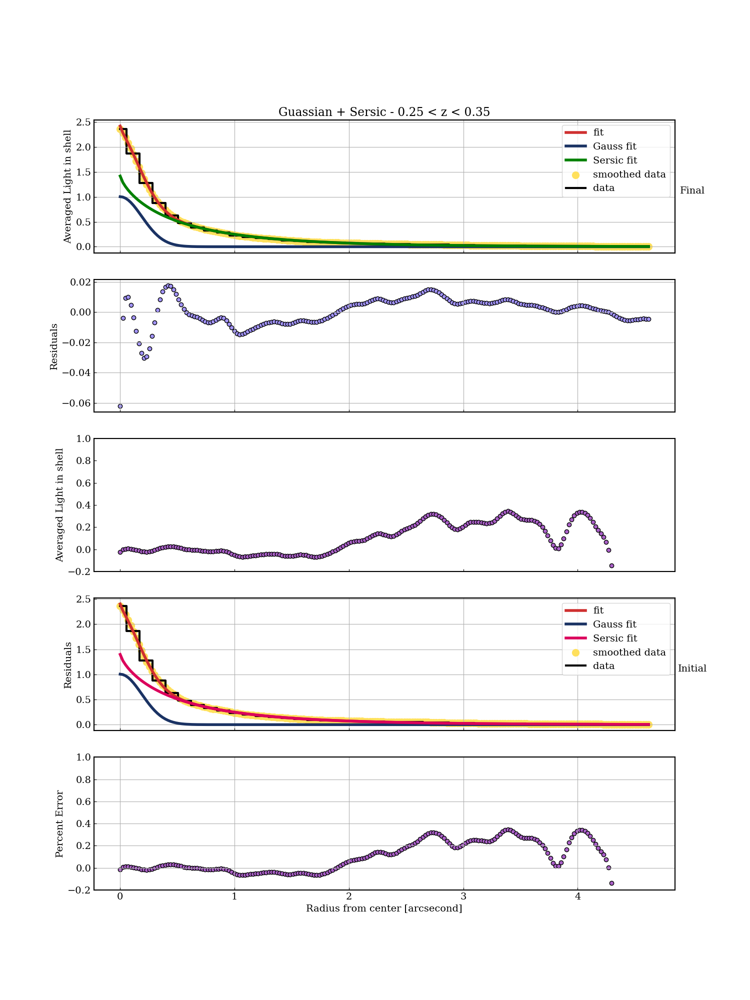

I_e = 0.15028424863158135 +0.0009613231823963619 - 0.006649118622116257

R_e = 1.3874304503862684 +0.012940286102326226 - 0.09745689364271692

N = 1.2892639076698138 +0.006410017248995148 - 0.042911434509394386

A = 1.004504244781831 +0.009120219173149202 - 0.07101246361757152

Sigma = 0.18835292216338928 +0.001960083316580652 - 0.015779327704419893


In [197]:
x_Mirror_Unindexed_025_035 = np.linspace(0,42,42)

x_data_Mirror_Unindexed_025_035 = np.multiply(x_Mirror_Unindexed_025_035, 0.11)

x_new_Mirror_Unindexed_Sersic_025_035 = np.linspace(min(x_data_Mirror_Unindexed_025_035),max(x_data_Mirror_Unindexed_025_035), 200)

x_data_Mirror_025_035 = np.multiply(x_Mirror_Unindexed_025_035, 0.11)

y_data_Mirror_Sersic_025_035 = Mirrored_Radius_array_025_035[42:85]

y_new_Mirror_Unindexed_Sersic_025_035 = CubicSpline(x_data_Mirror_Unindexed_025_035, y_data_Mirror_Sersic_025_035)

yy_new_Mirror_Unindexed_Sersic_025_035 = y_new_Mirror_Unindexed_Sersic_025_035(x_new_Mirror_Unindexed_Sersic_025_035)

Index_Sersic_025_035 = np.where(x_new_Mirror_Unindexed_Sersic_025_035 >= 0)[0]


y_err_Mirror_025_035 = 1.0 #Mirrored_Radius_array_SDE_025_035[0:84]

x_new_Mirror_Sersic_025_035 = x_new_Mirror_Unindexed_Sersic_025_035[Index_Sersic_025_035]
yy_new_Mirror_Sersic_025_035 = yy_new_Mirror_Unindexed_Sersic_025_035[Index_Sersic_025_035]

#I_e, R_e, N, A, Sigma = [0.14979659 1.38733154 1.28309877 1.00400428 0.18852659]


i_e = 0.14979659
r_e = 1.38733154
n = 1.28309877

a = 1.00400428
sigma = 0.18852659

initial_Mirror_025_035 = np.array([i_e, r_e, n, a, sigma]) #I_e,R_e,N


I_e_l_025_035 = 0
I_e_u_025_035 = i_e + (0.01*i_e)

R_e_l_025_035 = 0
R_e_u_025_035 = r_e + (0.01*r_e)

N_l_025_035 = 0
N_up_025_035 = n + (0.01*n)


a_l_025_035 = 0
a_u_025_035 = a + (0.01*a)

sigma_l_025_035 = 0
sigma_u_025_035 = sigma + (0.01*sigma)


popt_025_035, pcov_025_035 = curve_fit(Sersic_Gauss, x_new_Mirror_Sersic_025_035, yy_new_Mirror_Sersic_025_035, p0=[i_e, r_e, n, a, sigma], bounds=(0, np.inf))


# 2. Define the likelihood function ############################################################################################################################################
def log_likelihood(theta, x, y, yerr):
    i_e, r_e, n, a, sigma = theta
    model = Sersic_Gauss(x, i_e, r_e, n, a, sigma)
    sigma2 = yerr**2
    return -0.5 * np.sum((y - model)**2 / sigma2 + np.log(sigma2))

# 4. Define the prior (optional, but recommended) ############################################################################################################################################
#def log_prior(theta):
#    amp1, wid1, amp2, wid2 = theta
#    if not all(0 < param < 10 for param in [amp1, amp2, wid1, wid2]):
#        return -np.inf
#    return 0.0

def log_prior(theta):
    I_e, r_e, n, a, sigma = theta
    if (I_e_l_025_035 < I_e < I_e_u_025_035 and R_e_l_025_035 < r_e < R_e_u_025_035 and N_l_025_035 < n < N_up_025_035 and a_l_025_035 < a < a_u_025_035 and sigma_l_025_035 < sigma < sigma_u_025_035):
        return 0.0
    return -np.inf

    
# 5. Define the probability function ############################################################################################################################################
def log_probability(theta, x, y, yerr):
    lp = log_prior(theta)
    if not np.isfinite(lp):
        return -np.inf
    return lp + log_likelihood(theta, x, y, yerr)

# 3. Optimization (finding a good starting point) ############################################################################################################################################

bounds_Mirror_025_035 = [(I_e_l_025_035, I_e_u_025_035), (R_e_l_025_035, R_e_u_025_035), (N_l_025_035, N_up_025_035), (a_l_025_035, a_u_025_035), (sigma_l_025_035, sigma_u_025_035)] # Parameter bounds for optimization
soln_Mirror_025_035 = minimize(lambda *args: -log_likelihood(*args), initial_Mirror_025_035, args=(x_new_Mirror_Sersic_025_035, yy_new_Mirror_Sersic_025_035, y_err_Mirror_025_035), bounds=bounds_Mirror_025_035)

#soln = minimize(lambda *args: -log_likelihood(*args), initial, args=(x_data, y_data, y_err))
pos_Mirror_025_035 = soln_Mirror_025_035.x + 1e-4 * np.random.randn(32, len(soln_Mirror_025_035.x))
nwalkers_Mirror_025_035, ndim_Mirror_025_035 = pos_Mirror_025_035.shape


# 4. MCMC sampling ############################################################################################################################################
sampler_Mirror_025_035 = emcee.EnsembleSampler(nwalkers_Mirror_025_035, ndim_Mirror_025_035, log_probability, args=(x_new_Mirror_Sersic_025_035, yy_new_Mirror_Sersic_025_035, y_err_Mirror_025_035))
sampler_Mirror_025_035.run_mcmc(pos_Mirror_025_035, 5000, progress=True)

# 5. Analyze results
samples_Mirror_025_035 = sampler_Mirror_025_035.get_chain(flat=True)

# 6. Best fit parameters ############################################################################################################################################
best_fit_params_Mirror_025_035 = []
for i in range(ndim_Mirror_025_035):
    mcmc_Mirror_025_035 = np.percentile(samples_Mirror_025_035[:, i], [68, 95, 99.7])
    best_fit_params_Mirror_025_035.append(mcmc_Mirror_025_035[1])

# 10. Error estimation ############################################################################################################################################
errors_Mirror_025_035 = []
for i in range(ndim_Mirror_025_035):
     mcmc_Mirror_025_035 = np.percentile(samples_Mirror_025_035[:, i], [68, 95, 99.7])
     errors_Mirror_025_035.append([mcmc_Mirror_025_035[2]-mcmc_Mirror_025_035[1],mcmc_Mirror_025_035[1]-mcmc_Mirror_025_035[0]])
     
# 11. Getting the RMS Values ###########################################################################################################################################
#RMS_Bins_Mirrored_025_035 = np.arange(-10, 10, 1) # -10-10 bins of size 2
#X_Array_RMS_025_035 = np.arange(-9.5, 10.5, 1) 
#
#
#RMS_Array_025_035 = []
#RMS_Len_Array_025_035 = []
#RMS_Len_Array_Old_025_035 = []
#
#
#for i in RMS_Bins_Mirrored_025_035:
#    #print(np.where(np.logical_and(i < x_new_Mirror_Sersic_025_035, x_new_Mirror_Sersic_025_035 < i+2)))
#    #print(len(x_new_Mirror_Sersic_025_035[np.where(np.logical_and(i < x_new_Mirror_Sersic_025_035, x_new_Mirror_Sersic_025_035 < i+2))]))
#
#    index = np.where(np.logical_and(i < x_new_Mirror_Sersic_025_035, x_new_Mirror_Sersic_025_035 < i+1))[0]
#
#    index_2 = np.where(np.logical_and(i < x_data_Mirror_025_035, x_data_Mirror_025_035 < i+1))[0]
#    
#    values = yy_new_Mirror_Sersic_025_035 - two_gaussian(x_plot_Mirror_025_035, *best_fit_params_Mirror_025_035)
#
#    indexed_values = values[index]
#
#    RMS = np.sqrt( (1/len(indexed_values)) * (np.sum(indexed_values**2)) )
#
#
#    RMS_Array_025_035.append(RMS)
#    RMS_Len_Array_025_035.append(len(index))
#    RMS_Len_Array_Old_025_035.append(len(index_2))
#
#
#
#index_1_025_035 = np.where(np.logical_and(X_Array_RMS_025_035 > (40*0.11), X_Array_RMS_025_035 > 0))[0]
#index_2_025_035 = np.where(np.logical_and(X_Array_RMS_025_035 < -(40*0.11), X_Array_RMS_025_035 < 0))[0]
#index_3_025_035 = np.concatenate((index_2_025_035,index_1_025_035))
#
#Average_RMS_OutBox_025_035 = np.average(np.array(RMS_Array_025_035)[index_1_025_035])
#
#RMS_Array_InBox_025_035 = np.array(RMS_Array_025_035)
#
#RMS_Array_InBox_025_035[index_3_025_035] = Average_RMS_OutBox_025_035
     
# 12. Plot results ############################################################################################################################################

#fig = plt.figure(figsize = (20, 10),  facecolor = "white")
fig1, axes1 = plt.subplots(5, 1, sharex=True, figsize=(15, 20))

print("From Popt --- I_e, R_e, N, A, Sigma = " +str(popt_025_035))

axes1[0].plot(x_new_Mirror_Sersic_025_035, Sersic_Gauss(x_new_Mirror_Sersic_025_035, *best_fit_params_Mirror_025_035[:5]), color = "#CF3030", linewidth=4.0, label="fit", zorder=10)

axes1[0].plot(x_new_Mirror_Sersic_025_035, gaussian_3(x_new_Mirror_Sersic_025_035, *best_fit_params_Mirror_025_035[3:5]), color = "#1A3263", linewidth=4.0, label="Gauss fit", zorder=10)
axes1[0].plot(x_new_Mirror_Sersic_025_035, sersic_fit(x_new_Mirror_Sersic_025_035, *best_fit_params_Mirror_025_035[:3]), color = "green", linewidth=4.0, label="Sersic fit", zorder=10)

axes1[0].scatter(x_new_Mirror_Sersic_025_035, yy_new_Mirror_Sersic_025_035, color = "#FFE05D", label="smoothed data", s=100)#, linewidth=2.0, label="smoothed data")
axes1[0].step(x_data_Mirror_025_035, y_data_Mirror_Sersic_025_035, color = "black", linewidth=3.0, where="mid", zorder=1, label="data")

axes1[0].legend()

#axes1[0].set_ylim(-0.01, 0.03)
#ax1 = plt.subplot(3,1,2)

axes1[1].scatter(x_new_Mirror_Sersic_025_035, yy_new_Mirror_Sersic_025_035 - Sersic_Gauss(x_new_Mirror_Sersic_025_035, *best_fit_params_Mirror_025_035[:5]), c = "#A294F9", edgecolor="black") 

#ax2 = plt.subplot(3,1,3)
axes1[2].scatter(x_new_Mirror_Sersic_025_035, (yy_new_Mirror_Sersic_025_035 - Sersic_Gauss(x_new_Mirror_Sersic_025_035, *best_fit_params_Mirror_025_035[:5]))/yy_new_Mirror_Sersic_025_035, c = "#AA60C8", edgecolor="black") 

axes1[2].set_ylim(-0.2,1.0)
#axes1[2].set_xlim(-0.1,5.0)

axes1[2].grid()
#plt.ylim(-0.001,0.001)

axes1[3].plot(x_new_Mirror_Sersic_025_035, Sersic_Gauss(x_new_Mirror_Sersic_025_035, *popt_025_035[:5]), color = "#CF3030", linewidth=4.0, label="fit", zorder=10)

axes1[3].plot(x_new_Mirror_Sersic_025_035, gaussian_3(x_new_Mirror_Sersic_025_035, *popt_025_035[3:5]), color = "#1A3263", linewidth=4.0, label="Gauss fit", zorder=10)
axes1[3].plot(x_new_Mirror_Sersic_025_035, sersic_fit(x_new_Mirror_Sersic_025_035, *popt_025_035[:3]), color = "#DB005B", linewidth=4.0, label="Sersic fit", zorder=10)

axes1[3].scatter(x_new_Mirror_Sersic_025_035, yy_new_Mirror_Sersic_025_035, color = "#FFE05D", label="smoothed data", s=100)#, linewidth=2.0, label="smoothed data")
axes1[3].step(x_data_Mirror_025_035, y_data_Mirror_Sersic_025_035, color = "black", linewidth=3.0, where="mid", zorder=1, label="data")

#print(y_data_Mirror_Sersic_025_035) 
axes1[3].legend()


axes1[4].scatter(x_new_Mirror_Sersic_025_035, (yy_new_Mirror_Sersic_025_035 - Sersic_Gauss(x_new_Mirror_Sersic_025_035, *popt_025_035[:5]))/yy_new_Mirror_Sersic_025_035, c = "#AA60C8", edgecolor="black") 

axes1[4].set_ylim(-0.2,1.0)
#axes1[4].set_xlim(-0.1,5.0)

axes1[0].set_title("Guassian + Sersic - 0.25 < z < 0.35")

axes1[4].set_xlabel("Radius from center [arcsecond]")

axes1[0].set_ylabel("Averaged Light in shell")
axes1[1].set_ylabel("Residuals")
axes1[2].set_ylabel("Averaged Light in shell")
axes1[3].set_ylabel("Residuals")
axes1[4].set_ylabel("Percent Error")

ax2 = axes1[0].twinx()
ax2.set_yticks([])
ax2.set_ylabel("Final", rotation=360, labelpad=25)

ax3 = axes1[3].twinx()
ax3.set_yticks([])
ax3.set_ylabel("Initial", rotation=360, labelpad=25)


axes1[0].grid()
axes1[1].grid()
axes1[2].grid()
axes1[3].grid()
axes1[4].grid()

# Show the plot
plt.show(block=False)


# Close the figure
#############################################################################################################################################
I_e_Sersic_025_035 = best_fit_params_Mirror_025_035[0]
R_e_Sersic_025_035 = best_fit_params_Mirror_025_035[1]
N_Sersic_025_035 = best_fit_params_Mirror_025_035[2]
#############################################################################################################################################
print("I_e = " +str(best_fit_params_Mirror_025_035[0]) + " +" +str(errors_Mirror_025_035[0][0]) + " - " +str(errors_Mirror_025_035[0][1]))
print("")
print("R_e = " +str(best_fit_params_Mirror_025_035[1]) + " +" +str(errors_Mirror_025_035[1][0]) + " - " +str(errors_Mirror_025_035[1][1]))
print("")
print("N = " +str(best_fit_params_Mirror_025_035[2]) + " +" +str(errors_Mirror_025_035[2][0]) + " - " +str(errors_Mirror_025_035[2][1]))
print("")
print("A = " +str(best_fit_params_Mirror_025_035[3]) + " +" +str(errors_Mirror_025_035[3][0]) + " - " +str(errors_Mirror_025_035[3][1]))
print("")
print("Sigma = " +str(best_fit_params_Mirror_025_035[4]) + " +" +str(errors_Mirror_025_035[4][0]) + " - " +str(errors_Mirror_025_035[4][1]))



100%|██████████| 5000/5000 [00:09<00:00, 534.40it/s]


From Popt --- I_e, R_e, N, A, Sigma = [0.07601449 1.30894663 1.3954009  0.6729546  0.19731595]


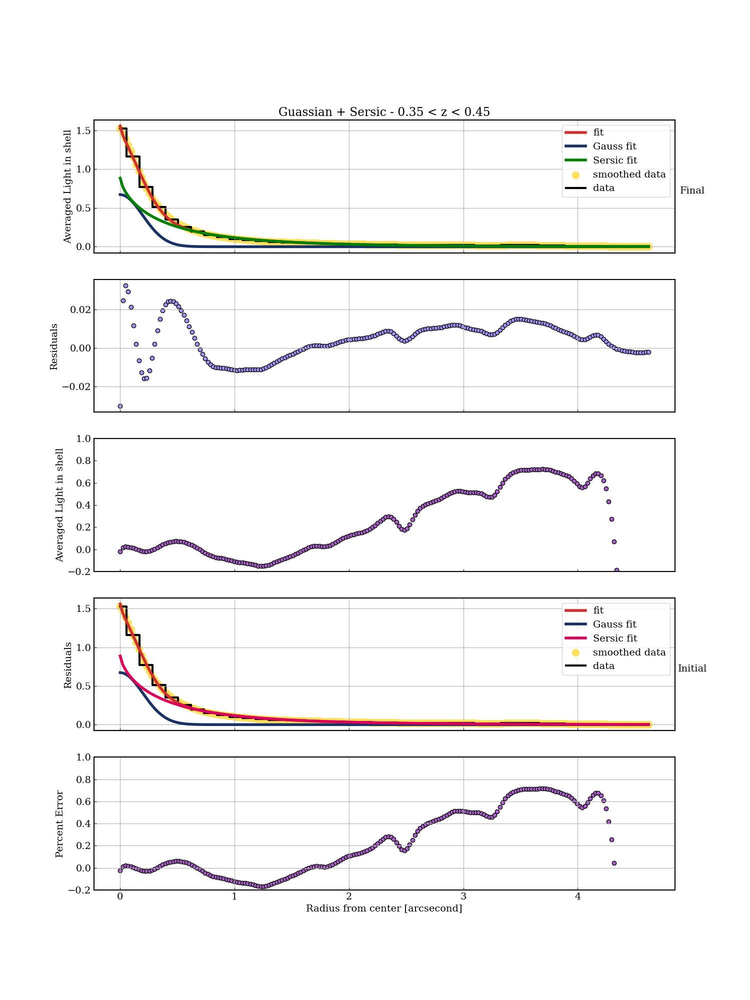

I_e = 0.0756744580058086 +0.0010509566553873473 - 0.008178743553627243

R_e = 1.3023323732194485 +0.018584697037100195 - 0.180738416704318

N = 1.3953346458899731 +0.013003721339836627 - 0.12378414316174813

A = 0.67133868815213 +0.007695377820839178 - 0.06314162213007724

Sigma = 0.19595802646086524 +0.003137876474509471 - 0.025794080724896168


In [198]:
x_Mirror_Unindexed_035_045 = np.linspace(0,42,42)

x_data_Mirror_Unindexed_035_045 = np.multiply(x_Mirror_Unindexed_035_045, 0.11)

x_new_Mirror_Unindexed_Sersic_035_045 = np.linspace(min(x_data_Mirror_Unindexed_035_045),max(x_data_Mirror_Unindexed_035_045), 200)

x_data_Mirror_035_045 = np.multiply(x_Mirror_Unindexed_035_045, 0.11)

y_data_Mirror_Sersic_035_045 = Mirrored_Radius_array_035_045[42:85]

y_new_Mirror_Unindexed_Sersic_035_045 = CubicSpline(x_data_Mirror_Unindexed_035_045, y_data_Mirror_Sersic_035_045)

yy_new_Mirror_Unindexed_Sersic_035_045 = y_new_Mirror_Unindexed_Sersic_035_045(x_new_Mirror_Unindexed_Sersic_035_045)

Index_Sersic_035_045 = np.where(x_new_Mirror_Unindexed_Sersic_035_045 >= 0)[0]


y_err_Mirror_035_045 = 1.0 #Mirrored_Radius_array_SDE_035_045[0:84]

x_new_Mirror_Sersic_035_045 = x_new_Mirror_Unindexed_Sersic_035_045[Index_Sersic_035_045]
yy_new_Mirror_Sersic_035_045 = yy_new_Mirror_Unindexed_Sersic_035_045[Index_Sersic_035_045]

#I_e, R_e, N, A, Sigma = [0.0760155  1.30893505 1.39539556 0.67295223 0.1973154 ]


i_e = 0.0760155
r_e = 1.30893505
n = 1.39539556

a = 0.67295223
sigma = 0.1973154

initial_Mirror_035_045 = np.array([i_e, r_e, n, a, sigma]) #I_e,R_e,N


I_e_l_035_045 = 0
I_e_u_035_045 = i_e + (0.01*i_e)

R_e_l_035_045 = 0
R_e_u_035_045 = r_e + (0.01*r_e)

N_l_035_045 = 0
N_up_035_045 = n + (0.01*n)


a_l_035_045 = 0
a_u_035_045 = a + (0.01*a)

sigma_l_035_045 = 0
sigma_u_035_045 = sigma + (0.01*sigma)


popt_035_045, pcov_035_045 = curve_fit(Sersic_Gauss, x_new_Mirror_Sersic_035_045, yy_new_Mirror_Sersic_035_045, p0=[i_e, r_e, n, a, sigma], bounds=(0, np.inf))


# 2. Define the likelihood function ############################################################################################################################################
def log_likelihood(theta, x, y, yerr):
    i_e, r_e, n, a, sigma = theta
    model = Sersic_Gauss(x, i_e, r_e, n, a, sigma)
    sigma2 = yerr**2
    return -0.5 * np.sum((y - model)**2 / sigma2 + np.log(sigma2))

# 4. Define the prior (optional, but recommended) ############################################################################################################################################
#def log_prior(theta):
#    amp1, wid1, amp2, wid2 = theta
#    if not all(0 < param < 10 for param in [amp1, amp2, wid1, wid2]):
#        return -np.inf
#    return 0.0

def log_prior(theta):
    I_e, r_e, n, a, sigma = theta
    if (I_e_l_035_045 < I_e < I_e_u_035_045 and R_e_l_035_045 < r_e < R_e_u_035_045 and N_l_035_045 < n < N_up_035_045 and a_l_035_045 < a < a_u_035_045 and sigma_l_035_045 < sigma < sigma_u_035_045):
        return 0.0
    return -np.inf

    
# 5. Define the probability function ############################################################################################################################################
def log_probability(theta, x, y, yerr):
    lp = log_prior(theta)
    if not np.isfinite(lp):
        return -np.inf
    return lp + log_likelihood(theta, x, y, yerr)

# 3. Optimization (finding a good starting point) ############################################################################################################################################

bounds_Mirror_035_045 = [(I_e_l_035_045, I_e_u_035_045), (R_e_l_035_045, R_e_u_035_045), (N_l_035_045, N_up_035_045), (a_l_035_045, a_u_035_045), (sigma_l_035_045, sigma_u_035_045)] # Parameter bounds for optimization
soln_Mirror_035_045 = minimize(lambda *args: -log_likelihood(*args), initial_Mirror_035_045, args=(x_new_Mirror_Sersic_035_045, yy_new_Mirror_Sersic_035_045, y_err_Mirror_035_045), bounds=bounds_Mirror_035_045)

#soln = minimize(lambda *args: -log_likelihood(*args), initial, args=(x_data, y_data, y_err))
pos_Mirror_035_045 = soln_Mirror_035_045.x + 1e-4 * np.random.randn(32, len(soln_Mirror_035_045.x))
nwalkers_Mirror_035_045, ndim_Mirror_035_045 = pos_Mirror_035_045.shape


# 4. MCMC sampling ############################################################################################################################################
sampler_Mirror_035_045 = emcee.EnsembleSampler(nwalkers_Mirror_035_045, ndim_Mirror_035_045, log_probability, args=(x_new_Mirror_Sersic_035_045, yy_new_Mirror_Sersic_035_045, y_err_Mirror_035_045))
sampler_Mirror_035_045.run_mcmc(pos_Mirror_035_045, 5000, progress=True)

# 5. Analyze results
samples_Mirror_035_045 = sampler_Mirror_035_045.get_chain(flat=True)

# 6. Best fit parameters ############################################################################################################################################
best_fit_params_Mirror_035_045 = []
for i in range(ndim_Mirror_035_045):
    mcmc_Mirror_035_045 = np.percentile(samples_Mirror_035_045[:, i], [68, 95, 99.7])
    best_fit_params_Mirror_035_045.append(mcmc_Mirror_035_045[1])

# 10. Error estimation ############################################################################################################################################
errors_Mirror_035_045 = []
for i in range(ndim_Mirror_035_045):
     mcmc_Mirror_035_045 = np.percentile(samples_Mirror_035_045[:, i], [68, 95, 99.7])
     errors_Mirror_035_045.append([mcmc_Mirror_035_045[2]-mcmc_Mirror_035_045[1],mcmc_Mirror_035_045[1]-mcmc_Mirror_035_045[0]])
     
# 11. Getting the RMS Values ###########################################################################################################################################
#RMS_Bins_Mirrored_035_045 = np.arange(-10, 10, 1) # -10-10 bins of size 2
#X_Array_RMS_035_045 = np.arange(-9.5, 10.5, 1) 
#
#
#RMS_Array_035_045 = []
#RMS_Len_Array_035_045 = []
#RMS_Len_Array_Old_035_045 = []
#
#
#for i in RMS_Bins_Mirrored_035_045:
#    #print(np.where(np.logical_and(i < x_new_Mirror_Sersic_035_045, x_new_Mirror_Sersic_035_045 < i+2)))
#    #print(len(x_new_Mirror_Sersic_035_045[np.where(np.logical_and(i < x_new_Mirror_Sersic_035_045, x_new_Mirror_Sersic_035_045 < i+2))]))
#
#    index = np.where(np.logical_and(i < x_new_Mirror_Sersic_035_045, x_new_Mirror_Sersic_035_045 < i+1))[0]
#
#    index_2 = np.where(np.logical_and(i < x_data_Mirror_035_045, x_data_Mirror_035_045 < i+1))[0]
#    
#    values = yy_new_Mirror_Sersic_035_045 - two_gaussian(x_plot_Mirror_035_045, *best_fit_params_Mirror_035_045)
#
#    indexed_values = values[index]
#
#    RMS = np.sqrt( (1/len(indexed_values)) * (np.sum(indexed_values**2)) )
#
#
#    RMS_Array_035_045.append(RMS)
#    RMS_Len_Array_035_045.append(len(index))
#    RMS_Len_Array_Old_035_045.append(len(index_2))
#
#
#
#index_1_035_045 = np.where(np.logical_and(X_Array_RMS_035_045 > (40*0.11), X_Array_RMS_035_045 > 0))[0]
#index_2_035_045 = np.where(np.logical_and(X_Array_RMS_035_045 < -(40*0.11), X_Array_RMS_035_045 < 0))[0]
#index_3_035_045 = np.concatenate((index_2_035_045,index_1_035_045))
#
#Average_RMS_OutBox_035_045 = np.average(np.array(RMS_Array_035_045)[index_1_035_045])
#
#RMS_Array_InBox_035_045 = np.array(RMS_Array_035_045)
#
#RMS_Array_InBox_035_045[index_3_035_045] = Average_RMS_OutBox_035_045
     
# 12. Plot results ############################################################################################################################################

#fig = plt.figure(figsize = (20, 10),  facecolor = "white")
fig1, axes1 = plt.subplots(5, 1, sharex=True, figsize=(15, 20))

print("From Popt --- I_e, R_e, N, A, Sigma = " +str(popt_035_045))

axes1[0].plot(x_new_Mirror_Sersic_035_045, Sersic_Gauss(x_new_Mirror_Sersic_035_045, *best_fit_params_Mirror_035_045[:5]), color = "#CF3030", linewidth=4.0, label="fit", zorder=10)

axes1[0].plot(x_new_Mirror_Sersic_035_045, gaussian_3(x_new_Mirror_Sersic_035_045, *best_fit_params_Mirror_035_045[3:5]), color = "#1A3263", linewidth=4.0, label="Gauss fit", zorder=10)
axes1[0].plot(x_new_Mirror_Sersic_035_045, sersic_fit(x_new_Mirror_Sersic_035_045, *best_fit_params_Mirror_035_045[:3]), color = "green", linewidth=4.0, label="Sersic fit", zorder=10)

axes1[0].scatter(x_new_Mirror_Sersic_035_045, yy_new_Mirror_Sersic_035_045, color = "#FFE05D", label="smoothed data", s=100)#, linewidth=2.0, label="smoothed data")
axes1[0].step(x_data_Mirror_035_045, y_data_Mirror_Sersic_035_045, color = "black", linewidth=3.0, where="mid", zorder=1, label="data")

axes1[0].legend()

#axes1[0].set_ylim(-0.01, 0.03)
#ax1 = plt.subplot(3,1,2)

axes1[1].scatter(x_new_Mirror_Sersic_035_045, yy_new_Mirror_Sersic_035_045 - Sersic_Gauss(x_new_Mirror_Sersic_035_045, *best_fit_params_Mirror_035_045[:5]), c = "#A294F9", edgecolor="black") 

#ax2 = plt.subplot(3,1,3)
axes1[2].scatter(x_new_Mirror_Sersic_035_045, (yy_new_Mirror_Sersic_035_045 - Sersic_Gauss(x_new_Mirror_Sersic_035_045, *best_fit_params_Mirror_035_045[:5]))/yy_new_Mirror_Sersic_035_045, c = "#AA60C8", edgecolor="black") 

axes1[2].set_ylim(-0.2,1.0)
#axes1[2].set_xlim(-0.1,5.0)

axes1[2].grid()
#plt.ylim(-0.001,0.001)

axes1[3].plot(x_new_Mirror_Sersic_035_045, Sersic_Gauss(x_new_Mirror_Sersic_035_045, *popt_035_045[:5]), color = "#CF3030", linewidth=4.0, label="fit", zorder=10)

axes1[3].plot(x_new_Mirror_Sersic_035_045, gaussian_3(x_new_Mirror_Sersic_035_045, *popt_035_045[3:5]), color = "#1A3263", linewidth=4.0, label="Gauss fit", zorder=10)
axes1[3].plot(x_new_Mirror_Sersic_035_045, sersic_fit(x_new_Mirror_Sersic_035_045, *popt_035_045[:3]), color = "#DB005B", linewidth=4.0, label="Sersic fit", zorder=10)

axes1[3].scatter(x_new_Mirror_Sersic_035_045, yy_new_Mirror_Sersic_035_045, color = "#FFE05D", label="smoothed data", s=100)#, linewidth=2.0, label="smoothed data")
axes1[3].step(x_data_Mirror_035_045, y_data_Mirror_Sersic_035_045, color = "black", linewidth=3.0, where="mid", zorder=1, label="data")

#print(y_data_Mirror_Sersic_035_045) 
axes1[3].legend()


axes1[4].scatter(x_new_Mirror_Sersic_035_045, (yy_new_Mirror_Sersic_035_045 - Sersic_Gauss(x_new_Mirror_Sersic_035_045, *popt_035_045[:5]))/yy_new_Mirror_Sersic_035_045, c = "#AA60C8", edgecolor="black") 

axes1[4].set_ylim(-0.2,1.0)
#axes1[4].set_xlim(-0.1,5.0)

axes1[0].set_title("Guassian + Sersic - 0.35 < z < 0.45")

axes1[4].set_xlabel("Radius from center [arcsecond]")

axes1[0].set_ylabel("Averaged Light in shell")
axes1[1].set_ylabel("Residuals")
axes1[2].set_ylabel("Averaged Light in shell")
axes1[3].set_ylabel("Residuals")
axes1[4].set_ylabel("Percent Error")

ax2 = axes1[0].twinx()
ax2.set_yticks([])
ax2.set_ylabel("Final", rotation=360, labelpad=25)

ax3 = axes1[3].twinx()
ax3.set_yticks([])
ax3.set_ylabel("Initial", rotation=360, labelpad=25)


axes1[0].grid()
axes1[1].grid()
axes1[2].grid()
axes1[3].grid()
axes1[4].grid()

# Show the plot
plt.show(block=False)


# Close the figure
#############################################################################################################################################
I_e_Sersic_035_045 = best_fit_params_Mirror_035_045[0]
R_e_Sersic_035_045 = best_fit_params_Mirror_035_045[1]
N_Sersic_035_045 = best_fit_params_Mirror_035_045[2]
#############################################################################################################################################
print("I_e = " +str(best_fit_params_Mirror_035_045[0]) + " +" +str(errors_Mirror_035_045[0][0]) + " - " +str(errors_Mirror_035_045[0][1]))
print("")
print("R_e = " +str(best_fit_params_Mirror_035_045[1]) + " +" +str(errors_Mirror_035_045[1][0]) + " - " +str(errors_Mirror_035_045[1][1]))
print("")
print("N = " +str(best_fit_params_Mirror_035_045[2]) + " +" +str(errors_Mirror_035_045[2][0]) + " - " +str(errors_Mirror_035_045[2][1]))
print("")
print("A = " +str(best_fit_params_Mirror_035_045[3]) + " +" +str(errors_Mirror_035_045[3][0]) + " - " +str(errors_Mirror_035_045[3][1]))
print("")
print("Sigma = " +str(best_fit_params_Mirror_035_045[4]) + " +" +str(errors_Mirror_035_045[4][0]) + " - " +str(errors_Mirror_035_045[4][1]))



100%|██████████| 5000/5000 [00:08<00:00, 564.24it/s]


From Popt --- I_e, R_e, N, A, Sigma = [0.04026509 1.55508276 1.52196877 0.45183957 0.19333965]


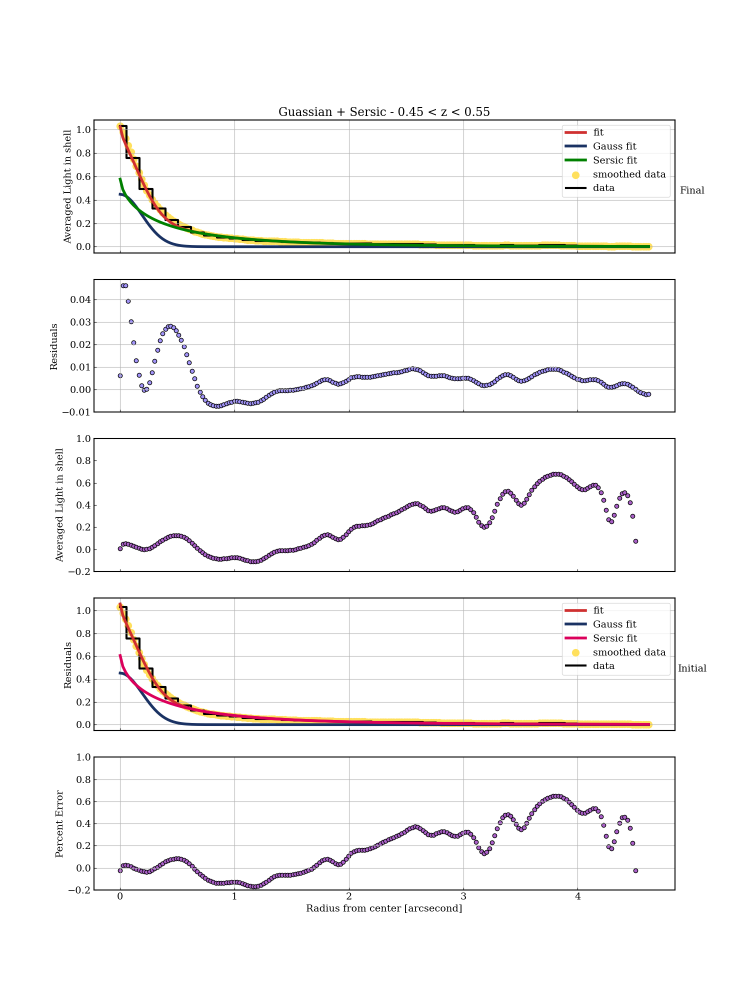

I_e = 0.03959077755005015 +0.0010099856202869864 - 0.0072933744270828535

R_e = 1.5223865777698804 +0.04593278604908324 - 0.3447387370904931

N = 1.5063973454327917 +0.028929971164812773 - 0.26574056676994484

A = 0.44773628328879767 +0.008107401166407846 - 0.0713115437568208

Sigma = 0.1905556471124131 +0.004502367863819995 - 0.03615344106878096


In [199]:
x_Mirror_Unindexed_045_055 = np.linspace(0,42,42)

x_data_Mirror_Unindexed_045_055 = np.multiply(x_Mirror_Unindexed_045_055, 0.11)

x_new_Mirror_Unindexed_Sersic_045_055 = np.linspace(min(x_data_Mirror_Unindexed_045_055),max(x_data_Mirror_Unindexed_045_055), 200)

x_data_Mirror_045_055 = np.multiply(x_Mirror_Unindexed_045_055, 0.11)

y_data_Mirror_Sersic_045_055 = Mirrored_Radius_array_045_055[42:85]

y_new_Mirror_Unindexed_Sersic_045_055 = CubicSpline(x_data_Mirror_Unindexed_045_055, y_data_Mirror_Sersic_045_055)

yy_new_Mirror_Unindexed_Sersic_045_055 = y_new_Mirror_Unindexed_Sersic_045_055(x_new_Mirror_Unindexed_Sersic_045_055)

Index_Sersic_045_055 = np.where(x_new_Mirror_Unindexed_Sersic_045_055 >= 0)[0]


y_err_Mirror_045_055 = 1.0 #Mirrored_Radius_array_SDE_045_055[0:84]

x_new_Mirror_Sersic_045_055 = x_new_Mirror_Unindexed_Sersic_045_055[Index_Sersic_045_055]
yy_new_Mirror_Sersic_045_055 = yy_new_Mirror_Unindexed_Sersic_045_055[Index_Sersic_045_055]

#I_e, R_e, N, A, Sigma = [0.04026489 1.55508795 1.52197081 0.45184007 0.19333988]


i_e = 0.04026489
r_e = 1.55508795
n = 1.52197081

a = 0.45184007
sigma = 0.19333988

initial_Mirror_045_055 = np.array([i_e, r_e, n, a, sigma]) #I_e,R_e,N


I_e_l_045_055 = 0
I_e_u_045_055 = i_e + (0.01*i_e)

R_e_l_045_055 = 0
R_e_u_045_055 = r_e + (0.01*r_e)

N_l_045_055 = 0
N_up_045_055 = n + (0.01*n)


a_l_045_055 = 0
a_u_045_055 = a + (0.01*a)

sigma_l_045_055 = 0
sigma_u_045_055 = sigma + (0.01*sigma)


popt_045_055, pcov_045_055 = curve_fit(Sersic_Gauss, x_new_Mirror_Sersic_045_055, yy_new_Mirror_Sersic_045_055, p0=[i_e, r_e, n, a, sigma], bounds=(0, np.inf))


# 2. Define the likelihood function ############################################################################################################################################
def log_likelihood(theta, x, y, yerr):
    i_e, r_e, n, a, sigma = theta
    model = Sersic_Gauss(x, i_e, r_e, n, a, sigma)
    sigma2 = yerr**2
    return -0.5 * np.sum((y - model)**2 / sigma2 + np.log(sigma2))

# 4. Define the prior (optional, but recommended) ############################################################################################################################################
#def log_prior(theta):
#    amp1, wid1, amp2, wid2 = theta
#    if not all(0 < param < 10 for param in [amp1, amp2, wid1, wid2]):
#        return -np.inf
#    return 0.0

def log_prior(theta):
    I_e, r_e, n, a, sigma = theta
    if (I_e_l_045_055 < I_e < I_e_u_045_055 and R_e_l_045_055 < r_e < R_e_u_045_055 and N_l_045_055 < n < N_up_045_055 and a_l_045_055 < a < a_u_045_055 and sigma_l_045_055 < sigma < sigma_u_045_055):
        return 0.0
    return -np.inf

    
# 5. Define the probability function ############################################################################################################################################
def log_probability(theta, x, y, yerr):
    lp = log_prior(theta)
    if not np.isfinite(lp):
        return -np.inf
    return lp + log_likelihood(theta, x, y, yerr)

# 3. Optimization (finding a good starting point) ############################################################################################################################################

bounds_Mirror_045_055 = [(I_e_l_045_055, I_e_u_045_055), (R_e_l_045_055, R_e_u_045_055), (N_l_045_055, N_up_045_055), (a_l_045_055, a_u_045_055), (sigma_l_045_055, sigma_u_045_055)] # Parameter bounds for optimization
soln_Mirror_045_055 = minimize(lambda *args: -log_likelihood(*args), initial_Mirror_045_055, args=(x_new_Mirror_Sersic_045_055, yy_new_Mirror_Sersic_045_055, y_err_Mirror_045_055), bounds=bounds_Mirror_045_055)

#soln = minimize(lambda *args: -log_likelihood(*args), initial, args=(x_data, y_data, y_err))
pos_Mirror_045_055 = soln_Mirror_045_055.x + 1e-4 * np.random.randn(32, len(soln_Mirror_045_055.x))
nwalkers_Mirror_045_055, ndim_Mirror_045_055 = pos_Mirror_045_055.shape


# 4. MCMC sampling ############################################################################################################################################
sampler_Mirror_045_055 = emcee.EnsembleSampler(nwalkers_Mirror_045_055, ndim_Mirror_045_055, log_probability, args=(x_new_Mirror_Sersic_045_055, yy_new_Mirror_Sersic_045_055, y_err_Mirror_045_055))
sampler_Mirror_045_055.run_mcmc(pos_Mirror_045_055, 5000, progress=True)

# 5. Analyze results
samples_Mirror_045_055 = sampler_Mirror_045_055.get_chain(flat=True)

# 6. Best fit parameters ############################################################################################################################################
best_fit_params_Mirror_045_055 = []
for i in range(ndim_Mirror_045_055):
    mcmc_Mirror_045_055 = np.percentile(samples_Mirror_045_055[:, i], [68, 95, 99.7])
    best_fit_params_Mirror_045_055.append(mcmc_Mirror_045_055[1])

# 10. Error estimation ############################################################################################################################################
errors_Mirror_045_055 = []
for i in range(ndim_Mirror_045_055):
     mcmc_Mirror_045_055 = np.percentile(samples_Mirror_045_055[:, i], [68, 95, 99.7])
     errors_Mirror_045_055.append([mcmc_Mirror_045_055[2]-mcmc_Mirror_045_055[1],mcmc_Mirror_045_055[1]-mcmc_Mirror_045_055[0]])
     
# 11. Getting the RMS Values ###########################################################################################################################################
#RMS_Bins_Mirrored_045_055 = np.arange(-10, 10, 1) # -10-10 bins of size 2
#X_Array_RMS_045_055 = np.arange(-9.5, 10.5, 1) 
#
#
#RMS_Array_045_055 = []
#RMS_Len_Array_045_055 = []
#RMS_Len_Array_Old_045_055 = []
#
#
#for i in RMS_Bins_Mirrored_045_055:
#    #print(np.where(np.logical_and(i < x_new_Mirror_Sersic_045_055, x_new_Mirror_Sersic_045_055 < i+2)))
#    #print(len(x_new_Mirror_Sersic_045_055[np.where(np.logical_and(i < x_new_Mirror_Sersic_045_055, x_new_Mirror_Sersic_045_055 < i+2))]))
#
#    index = np.where(np.logical_and(i < x_new_Mirror_Sersic_045_055, x_new_Mirror_Sersic_045_055 < i+1))[0]
#
#    index_2 = np.where(np.logical_and(i < x_data_Mirror_045_055, x_data_Mirror_045_055 < i+1))[0]
#    
#    values = yy_new_Mirror_Sersic_045_055 - two_gaussian(x_plot_Mirror_045_055, *best_fit_params_Mirror_045_055)
#
#    indexed_values = values[index]
#
#    RMS = np.sqrt( (1/len(indexed_values)) * (np.sum(indexed_values**2)) )
#
#
#    RMS_Array_045_055.append(RMS)
#    RMS_Len_Array_045_055.append(len(index))
#    RMS_Len_Array_Old_045_055.append(len(index_2))
#
#
#
#index_1_045_055 = np.where(np.logical_and(X_Array_RMS_045_055 > (40*0.11), X_Array_RMS_045_055 > 0))[0]
#index_2_045_055 = np.where(np.logical_and(X_Array_RMS_045_055 < -(40*0.11), X_Array_RMS_045_055 < 0))[0]
#index_3_045_055 = np.concatenate((index_2_045_055,index_1_045_055))
#
#Average_RMS_OutBox_045_055 = np.average(np.array(RMS_Array_045_055)[index_1_045_055])
#
#RMS_Array_InBox_045_055 = np.array(RMS_Array_045_055)
#
#RMS_Array_InBox_045_055[index_3_045_055] = Average_RMS_OutBox_045_055
     
# 12. Plot results ############################################################################################################################################

#fig = plt.figure(figsize = (20, 10),  facecolor = "white")
fig1, axes1 = plt.subplots(5, 1, sharex=True, figsize=(15, 20))

print("From Popt --- I_e, R_e, N, A, Sigma = " +str(popt_045_055))

axes1[0].plot(x_new_Mirror_Sersic_045_055, Sersic_Gauss(x_new_Mirror_Sersic_045_055, *best_fit_params_Mirror_045_055[:5]), color = "#CF3030", linewidth=4.0, label="fit", zorder=10)

axes1[0].plot(x_new_Mirror_Sersic_045_055, gaussian_3(x_new_Mirror_Sersic_045_055, *best_fit_params_Mirror_045_055[3:5]), color = "#1A3263", linewidth=4.0, label="Gauss fit", zorder=10)
axes1[0].plot(x_new_Mirror_Sersic_045_055, sersic_fit(x_new_Mirror_Sersic_045_055, *best_fit_params_Mirror_045_055[:3]), color = "green", linewidth=4.0, label="Sersic fit", zorder=10)

axes1[0].scatter(x_new_Mirror_Sersic_045_055, yy_new_Mirror_Sersic_045_055, color = "#FFE05D", label="smoothed data", s=100)#, linewidth=2.0, label="smoothed data")
axes1[0].step(x_data_Mirror_045_055, y_data_Mirror_Sersic_045_055, color = "black", linewidth=3.0, where="mid", zorder=1, label="data")

axes1[0].legend()

#axes1[0].set_ylim(-0.01, 0.03)
#ax1 = plt.subplot(3,1,2)

axes1[1].scatter(x_new_Mirror_Sersic_045_055, yy_new_Mirror_Sersic_045_055 - Sersic_Gauss(x_new_Mirror_Sersic_045_055, *best_fit_params_Mirror_045_055[:5]), c = "#A294F9", edgecolor="black") 

#ax2 = plt.subplot(3,1,3)
axes1[2].scatter(x_new_Mirror_Sersic_045_055, (yy_new_Mirror_Sersic_045_055 - Sersic_Gauss(x_new_Mirror_Sersic_045_055, *best_fit_params_Mirror_045_055[:5]))/yy_new_Mirror_Sersic_045_055, c = "#AA60C8", edgecolor="black") 

axes1[2].set_ylim(-0.2,1.0)
#axes1[2].set_xlim(-0.1,5.0)

axes1[2].grid()
#plt.ylim(-0.001,0.001)

axes1[3].plot(x_new_Mirror_Sersic_045_055, Sersic_Gauss(x_new_Mirror_Sersic_045_055, *popt_045_055[:5]), color = "#CF3030", linewidth=4.0, label="fit", zorder=10)

axes1[3].plot(x_new_Mirror_Sersic_045_055, gaussian_3(x_new_Mirror_Sersic_045_055, *popt_045_055[3:5]), color = "#1A3263", linewidth=4.0, label="Gauss fit", zorder=10)
axes1[3].plot(x_new_Mirror_Sersic_045_055, sersic_fit(x_new_Mirror_Sersic_045_055, *popt_045_055[:3]), color = "#DB005B", linewidth=4.0, label="Sersic fit", zorder=10)

axes1[3].scatter(x_new_Mirror_Sersic_045_055, yy_new_Mirror_Sersic_045_055, color = "#FFE05D", label="smoothed data", s=100)#, linewidth=2.0, label="smoothed data")
axes1[3].step(x_data_Mirror_045_055, y_data_Mirror_Sersic_045_055, color = "black", linewidth=3.0, where="mid", zorder=1, label="data")

#print(y_data_Mirror_Sersic_045_055) 
axes1[3].legend()


axes1[4].scatter(x_new_Mirror_Sersic_045_055, (yy_new_Mirror_Sersic_045_055 - Sersic_Gauss(x_new_Mirror_Sersic_045_055, *popt_045_055[:5]))/yy_new_Mirror_Sersic_045_055, c = "#AA60C8", edgecolor="black") 

axes1[4].set_ylim(-0.2,1.0)
#axes1[4].set_xlim(-0.1,5.0)

axes1[0].set_title("Guassian + Sersic - 0.45 < z < 0.55")

axes1[4].set_xlabel("Radius from center [arcsecond]")

axes1[0].set_ylabel("Averaged Light in shell")
axes1[1].set_ylabel("Residuals")
axes1[2].set_ylabel("Averaged Light in shell")
axes1[3].set_ylabel("Residuals")
axes1[4].set_ylabel("Percent Error")

ax2 = axes1[0].twinx()
ax2.set_yticks([])
ax2.set_ylabel("Final", rotation=360, labelpad=25)

ax3 = axes1[3].twinx()
ax3.set_yticks([])
ax3.set_ylabel("Initial", rotation=360, labelpad=25)


axes1[0].grid()
axes1[1].grid()
axes1[2].grid()
axes1[3].grid()
axes1[4].grid()

# Show the plot
plt.show(block=False)


# Close the figure
#############################################################################################################################################
I_e_Sersic_045_055 = best_fit_params_Mirror_045_055[0]
R_e_Sersic_045_055 = best_fit_params_Mirror_045_055[1]
N_Sersic_045_055 = best_fit_params_Mirror_045_055[2]
#############################################################################################################################################
print("I_e = " +str(best_fit_params_Mirror_045_055[0]) + " +" +str(errors_Mirror_045_055[0][0]) + " - " +str(errors_Mirror_045_055[0][1]))
print("")
print("R_e = " +str(best_fit_params_Mirror_045_055[1]) + " +" +str(errors_Mirror_045_055[1][0]) + " - " +str(errors_Mirror_045_055[1][1]))
print("")
print("N = " +str(best_fit_params_Mirror_045_055[2]) + " +" +str(errors_Mirror_045_055[2][0]) + " - " +str(errors_Mirror_045_055[2][1]))
print("")
print("A = " +str(best_fit_params_Mirror_045_055[3]) + " +" +str(errors_Mirror_045_055[3][0]) + " - " +str(errors_Mirror_045_055[3][1]))
print("")
print("Sigma = " +str(best_fit_params_Mirror_045_055[4]) + " +" +str(errors_Mirror_045_055[4][0]) + " - " +str(errors_Mirror_045_055[4][1]))


100%|██████████| 5000/5000 [00:08<00:00, 569.55it/s]


From Popt --- I_e, R_e, N, A, Sigma = [0.01531789 2.49349067 1.71159716 0.40613634 0.18234503]


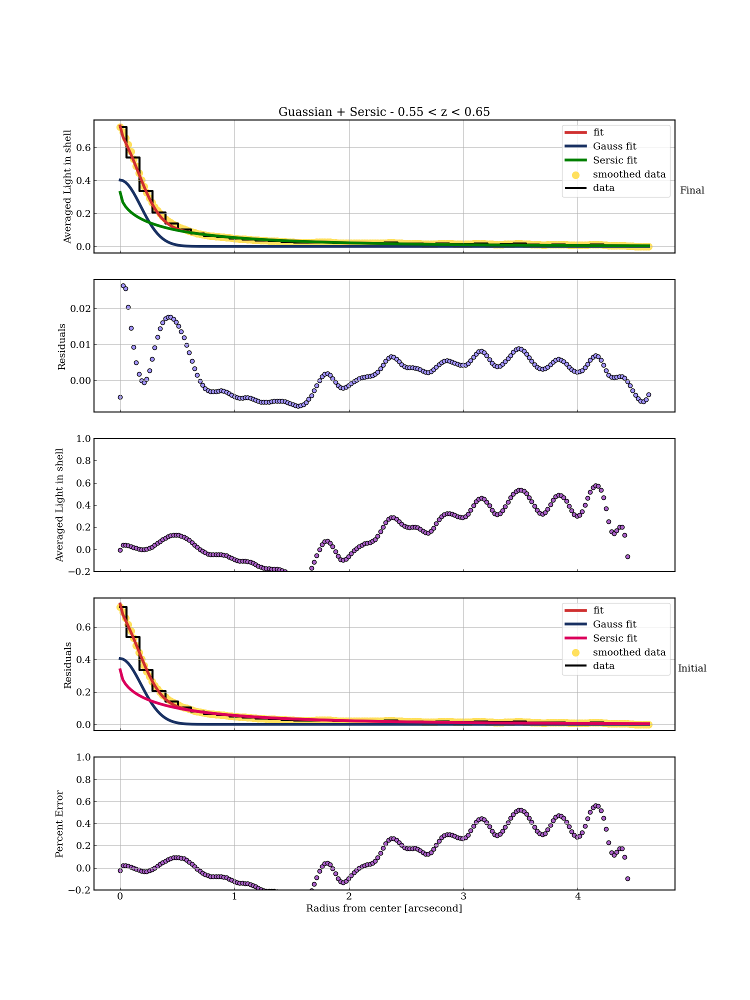

I_e = 0.01491499396435751 +0.0005306138462233181 - 0.003665897866195993

R_e = 2.4897602583283427 +0.02714595009852383 - 0.5271243625301392

N = 1.7114541117803932 +0.016515461172662782 - 0.3322346966322498

A = 0.4025067320113821 +0.007255555542529268 - 0.0736543181717868

Sigma = 0.1794238144259066 +0.004576112010910044 - 0.03811131420652261


In [200]:
x_Mirror_Unindexed_055_065 = np.linspace(0,42,42)

x_data_Mirror_Unindexed_055_065 = np.multiply(x_Mirror_Unindexed_055_065, 0.11)

x_new_Mirror_Unindexed_Sersic_055_065 = np.linspace(min(x_data_Mirror_Unindexed_055_065),max(x_data_Mirror_Unindexed_055_065), 200)

x_data_Mirror_055_065 = np.multiply(x_Mirror_Unindexed_055_065, 0.11)

y_data_Mirror_Sersic_055_065 = Mirrored_Radius_array_055_065[42:85]

y_new_Mirror_Unindexed_Sersic_055_065 = CubicSpline(x_data_Mirror_Unindexed_055_065, y_data_Mirror_Sersic_055_065)

yy_new_Mirror_Unindexed_Sersic_055_065 = y_new_Mirror_Unindexed_Sersic_055_065(x_new_Mirror_Unindexed_Sersic_055_065)

Index_Sersic_055_065 = np.where(x_new_Mirror_Unindexed_Sersic_055_065 >= 0)[0]


y_err_Mirror_055_065 = 1.0 #Mirrored_Radius_array_SDE_055_065[0:84]

x_new_Mirror_Sersic_055_065 = x_new_Mirror_Unindexed_Sersic_055_065[Index_Sersic_055_065]
yy_new_Mirror_Sersic_055_065 = yy_new_Mirror_Unindexed_Sersic_055_065[Index_Sersic_055_065]

#I_e, R_e, N, A, Sigma = [0.01531781 2.49350124 1.71159925 0.40613665 0.18234515]


i_e = 0.01531781
r_e = 2.49350124
n = 1.71159925

a = 0.40613665
sigma = 0.18234515

initial_Mirror_055_065 = np.array([i_e, r_e, n, a, sigma]) #I_e,R_e,N


I_e_l_055_065 = 0
I_e_u_055_065 = i_e + (0.01*i_e)

R_e_l_055_065 = 0
R_e_u_055_065 = r_e + (0.01*r_e)

N_l_055_065 = 0
N_up_055_065 = n + (0.01*n)


a_l_055_065 = 0
a_u_055_065 = a + (0.01*a)

sigma_l_055_065 = 0
sigma_u_055_065 = sigma + (0.01*sigma)


popt_055_065, pcov_055_065 = curve_fit(Sersic_Gauss, x_new_Mirror_Sersic_055_065, yy_new_Mirror_Sersic_055_065, p0=[i_e, r_e, n, a, sigma], bounds=(0, np.inf))


# 2. Define the likelihood function ############################################################################################################################################
def log_likelihood(theta, x, y, yerr):
    i_e, r_e, n, a, sigma = theta
    model = Sersic_Gauss(x, i_e, r_e, n, a, sigma)
    sigma2 = yerr**2
    return -0.5 * np.sum((y - model)**2 / sigma2 + np.log(sigma2))

# 4. Define the prior (optional, but recommended) ############################################################################################################################################
#def log_prior(theta):
#    amp1, wid1, amp2, wid2 = theta
#    if not all(0 < param < 10 for param in [amp1, amp2, wid1, wid2]):
#        return -np.inf
#    return 0.0

def log_prior(theta):
    I_e, r_e, n, a, sigma = theta
    if (I_e_l_055_065 < I_e < I_e_u_055_065 and R_e_l_055_065 < r_e < R_e_u_055_065 and N_l_055_065 < n < N_up_055_065 and a_l_055_065 < a < a_u_055_065 and sigma_l_055_065 < sigma < sigma_u_055_065):
        return 0.0
    return -np.inf

    
# 5. Define the probability function ############################################################################################################################################
def log_probability(theta, x, y, yerr):
    lp = log_prior(theta)
    if not np.isfinite(lp):
        return -np.inf
    return lp + log_likelihood(theta, x, y, yerr)

# 3. Optimization (finding a good starting point) ############################################################################################################################################

bounds_Mirror_055_065 = [(I_e_l_055_065, I_e_u_055_065), (R_e_l_055_065, R_e_u_055_065), (N_l_055_065, N_up_055_065), (a_l_055_065, a_u_055_065), (sigma_l_055_065, sigma_u_055_065)] # Parameter bounds for optimization
soln_Mirror_055_065 = minimize(lambda *args: -log_likelihood(*args), initial_Mirror_055_065, args=(x_new_Mirror_Sersic_055_065, yy_new_Mirror_Sersic_055_065, y_err_Mirror_055_065), bounds=bounds_Mirror_055_065)

#soln = minimize(lambda *args: -log_likelihood(*args), initial, args=(x_data, y_data, y_err))
pos_Mirror_055_065 = soln_Mirror_055_065.x + 1e-4 * np.random.randn(32, len(soln_Mirror_055_065.x))
nwalkers_Mirror_055_065, ndim_Mirror_055_065 = pos_Mirror_055_065.shape


# 4. MCMC sampling ############################################################################################################################################
sampler_Mirror_055_065 = emcee.EnsembleSampler(nwalkers_Mirror_055_065, ndim_Mirror_055_065, log_probability, args=(x_new_Mirror_Sersic_055_065, yy_new_Mirror_Sersic_055_065, y_err_Mirror_055_065))
sampler_Mirror_055_065.run_mcmc(pos_Mirror_055_065, 5000, progress=True)

# 5. Analyze results
samples_Mirror_055_065 = sampler_Mirror_055_065.get_chain(flat=True)

# 6. Best fit parameters ############################################################################################################################################
best_fit_params_Mirror_055_065 = []
for i in range(ndim_Mirror_055_065):
    mcmc_Mirror_055_065 = np.percentile(samples_Mirror_055_065[:, i], [68, 95, 99.7])
    best_fit_params_Mirror_055_065.append(mcmc_Mirror_055_065[1])

# 10. Error estimation ############################################################################################################################################
errors_Mirror_055_065 = []
for i in range(ndim_Mirror_055_065):
     mcmc_Mirror_055_065 = np.percentile(samples_Mirror_055_065[:, i], [68, 95, 99.7])
     errors_Mirror_055_065.append([mcmc_Mirror_055_065[2]-mcmc_Mirror_055_065[1],mcmc_Mirror_055_065[1]-mcmc_Mirror_055_065[0]])
     
# 11. Getting the RMS Values ###########################################################################################################################################
#RMS_Bins_Mirrored_055_065 = np.arange(-10, 10, 1) # -10-10 bins of size 2
#X_Array_RMS_055_065 = np.arange(-9.5, 10.5, 1) 
#
#
#RMS_Array_055_065 = []
#RMS_Len_Array_055_065 = []
#RMS_Len_Array_Old_055_065 = []
#
#
#for i in RMS_Bins_Mirrored_055_065:
#    #print(np.where(np.logical_and(i < x_new_Mirror_Sersic_055_065, x_new_Mirror_Sersic_055_065 < i+2)))
#    #print(len(x_new_Mirror_Sersic_055_065[np.where(np.logical_and(i < x_new_Mirror_Sersic_055_065, x_new_Mirror_Sersic_055_065 < i+2))]))
#
#    index = np.where(np.logical_and(i < x_new_Mirror_Sersic_055_065, x_new_Mirror_Sersic_055_065 < i+1))[0]
#
#    index_2 = np.where(np.logical_and(i < x_data_Mirror_055_065, x_data_Mirror_055_065 < i+1))[0]
#    
#    values = yy_new_Mirror_Sersic_055_065 - two_gaussian(x_plot_Mirror_055_065, *best_fit_params_Mirror_055_065)
#
#    indexed_values = values[index]
#
#    RMS = np.sqrt( (1/len(indexed_values)) * (np.sum(indexed_values**2)) )
#
#
#    RMS_Array_055_065.append(RMS)
#    RMS_Len_Array_055_065.append(len(index))
#    RMS_Len_Array_Old_055_065.append(len(index_2))
#
#
#
#index_1_055_065 = np.where(np.logical_and(X_Array_RMS_055_065 > (40*0.11), X_Array_RMS_055_065 > 0))[0]
#index_2_055_065 = np.where(np.logical_and(X_Array_RMS_055_065 < -(40*0.11), X_Array_RMS_055_065 < 0))[0]
#index_3_055_065 = np.concatenate((index_2_055_065,index_1_055_065))
#
#Average_RMS_OutBox_055_065 = np.average(np.array(RMS_Array_055_065)[index_1_055_065])
#
#RMS_Array_InBox_055_065 = np.array(RMS_Array_055_065)
#
#RMS_Array_InBox_055_065[index_3_055_065] = Average_RMS_OutBox_055_065
     
# 12. Plot results ############################################################################################################################################

#fig = plt.figure(figsize = (20, 10),  facecolor = "white")
fig1, axes1 = plt.subplots(5, 1, sharex=True, figsize=(15, 20))

print("From Popt --- I_e, R_e, N, A, Sigma = " +str(popt_055_065))

axes1[0].plot(x_new_Mirror_Sersic_055_065, Sersic_Gauss(x_new_Mirror_Sersic_055_065, *best_fit_params_Mirror_055_065[:5]), color = "#CF3030", linewidth=4.0, label="fit", zorder=10)

axes1[0].plot(x_new_Mirror_Sersic_055_065, gaussian_3(x_new_Mirror_Sersic_055_065, *best_fit_params_Mirror_055_065[3:5]), color = "#1A3263", linewidth=4.0, label="Gauss fit", zorder=10)
axes1[0].plot(x_new_Mirror_Sersic_055_065, sersic_fit(x_new_Mirror_Sersic_055_065, *best_fit_params_Mirror_055_065[:3]), color = "green", linewidth=4.0, label="Sersic fit", zorder=10)

axes1[0].scatter(x_new_Mirror_Sersic_055_065, yy_new_Mirror_Sersic_055_065, color = "#FFE05D", label="smoothed data", s=100)#, linewidth=2.0, label="smoothed data")
axes1[0].step(x_data_Mirror_055_065, y_data_Mirror_Sersic_055_065, color = "black", linewidth=3.0, where="mid", zorder=1, label="data")

axes1[0].legend()

#axes1[0].set_ylim(-0.01, 0.03)
#ax1 = plt.subplot(3,1,2)

axes1[1].scatter(x_new_Mirror_Sersic_055_065, yy_new_Mirror_Sersic_055_065 - Sersic_Gauss(x_new_Mirror_Sersic_055_065, *best_fit_params_Mirror_055_065[:5]), c = "#A294F9", edgecolor="black") 

#ax2 = plt.subplot(3,1,3)
axes1[2].scatter(x_new_Mirror_Sersic_055_065, (yy_new_Mirror_Sersic_055_065 - Sersic_Gauss(x_new_Mirror_Sersic_055_065, *best_fit_params_Mirror_055_065[:5]))/yy_new_Mirror_Sersic_055_065, c = "#AA60C8", edgecolor="black") 

axes1[2].set_ylim(-0.2,1.0)
#axes1[2].set_xlim(-0.1,5.0)

axes1[2].grid()
#plt.ylim(-0.001,0.001)

axes1[3].plot(x_new_Mirror_Sersic_055_065, Sersic_Gauss(x_new_Mirror_Sersic_055_065, *popt_055_065[:5]), color = "#CF3030", linewidth=4.0, label="fit", zorder=10)

axes1[3].plot(x_new_Mirror_Sersic_055_065, gaussian_3(x_new_Mirror_Sersic_055_065, *popt_055_065[3:5]), color = "#1A3263", linewidth=4.0, label="Gauss fit", zorder=10)
axes1[3].plot(x_new_Mirror_Sersic_055_065, sersic_fit(x_new_Mirror_Sersic_055_065, *popt_055_065[:3]), color = "#DB005B", linewidth=4.0, label="Sersic fit", zorder=10)

axes1[3].scatter(x_new_Mirror_Sersic_055_065, yy_new_Mirror_Sersic_055_065, color = "#FFE05D", label="smoothed data", s=100)#, linewidth=2.0, label="smoothed data")
axes1[3].step(x_data_Mirror_055_065, y_data_Mirror_Sersic_055_065, color = "black", linewidth=3.0, where="mid", zorder=1, label="data")

#print(y_data_Mirror_Sersic_055_065) 
axes1[3].legend()


axes1[4].scatter(x_new_Mirror_Sersic_055_065, (yy_new_Mirror_Sersic_055_065 - Sersic_Gauss(x_new_Mirror_Sersic_055_065, *popt_055_065[:5]))/yy_new_Mirror_Sersic_055_065, c = "#AA60C8", edgecolor="black") 

axes1[4].set_ylim(-0.2,1.0)
#axes1[4].set_xlim(-0.1,5.0)

axes1[0].set_title("Guassian + Sersic - 0.55 < z < 0.65")

axes1[4].set_xlabel("Radius from center [arcsecond]")

axes1[0].set_ylabel("Averaged Light in shell")
axes1[1].set_ylabel("Residuals")
axes1[2].set_ylabel("Averaged Light in shell")
axes1[3].set_ylabel("Residuals")
axes1[4].set_ylabel("Percent Error")

ax2 = axes1[0].twinx()
ax2.set_yticks([])
ax2.set_ylabel("Final", rotation=360, labelpad=25)

ax3 = axes1[3].twinx()
ax3.set_yticks([])
ax3.set_ylabel("Initial", rotation=360, labelpad=25)


axes1[0].grid()
axes1[1].grid()
axes1[2].grid()
axes1[3].grid()
axes1[4].grid()

# Show the plot
plt.show(block=False)


# Close the figure
#############################################################################################################################################
I_e_Sersic_055_065 = best_fit_params_Mirror_055_065[0]
R_e_Sersic_055_065 = best_fit_params_Mirror_055_065[1]
N_Sersic_055_065 = best_fit_params_Mirror_055_065[2]
#############################################################################################################################################
print("I_e = " +str(best_fit_params_Mirror_055_065[0]) + " +" +str(errors_Mirror_055_065[0][0]) + " - " +str(errors_Mirror_055_065[0][1]))
print("")
print("R_e = " +str(best_fit_params_Mirror_055_065[1]) + " +" +str(errors_Mirror_055_065[1][0]) + " - " +str(errors_Mirror_055_065[1][1]))
print("")
print("N = " +str(best_fit_params_Mirror_055_065[2]) + " +" +str(errors_Mirror_055_065[2][0]) + " - " +str(errors_Mirror_055_065[2][1]))
print("")
print("A = " +str(best_fit_params_Mirror_055_065[3]) + " +" +str(errors_Mirror_055_065[3][0]) + " - " +str(errors_Mirror_055_065[3][1]))
print("")
print("Sigma = " +str(best_fit_params_Mirror_055_065[4]) + " +" +str(errors_Mirror_055_065[4][0]) + " - " +str(errors_Mirror_055_065[4][1]))


100%|██████████| 5000/5000 [00:08<00:00, 569.79it/s]


From Popt --- I_e, R_e, N, A, Sigma = [0.022246   1.60105986 1.55633966 0.40211473 0.17400313]


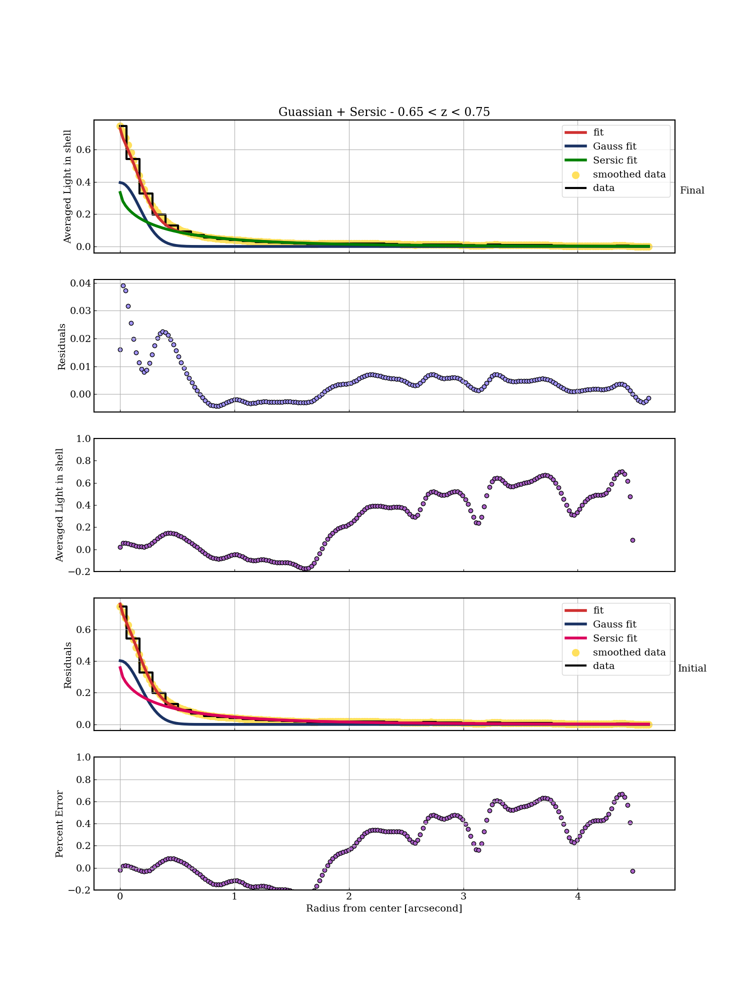

I_e = 0.02167021814406916 +0.0007606600874712974 - 0.005144637424838443

R_e = 1.563736734405808 +0.049769967779012436 - 0.3824883650852613

N = 1.5335288106785396 +0.03576897365611553 - 0.32187192306857026

A = 0.39502413521060886 +0.010488696425785538 - 0.08253590582156095

Sigma = 0.1700690295508666 +0.005385270897963812 - 0.038735989181207575


In [201]:
x_Mirror_Unindexed_065_075 = np.linspace(0,42,42)

x_data_Mirror_Unindexed_065_075 = np.multiply(x_Mirror_Unindexed_065_075, 0.11)

x_new_Mirror_Unindexed_Sersic_065_075 = np.linspace(min(x_data_Mirror_Unindexed_065_075),max(x_data_Mirror_Unindexed_065_075), 200)

x_data_Mirror_065_075 = np.multiply(x_Mirror_Unindexed_065_075, 0.11)

y_data_Mirror_Sersic_065_075 = Mirrored_Radius_array_065_075[42:85]

y_new_Mirror_Unindexed_Sersic_065_075 = CubicSpline(x_data_Mirror_Unindexed_065_075, y_data_Mirror_Sersic_065_075)

yy_new_Mirror_Unindexed_Sersic_065_075 = y_new_Mirror_Unindexed_Sersic_065_075(x_new_Mirror_Unindexed_Sersic_065_075)

Index_Sersic_065_075 = np.where(x_new_Mirror_Unindexed_Sersic_065_075 >= 0)[0]


y_err_Mirror_065_075 = 1.0 #Mirrored_Radius_array_SDE_065_075[0:84]

x_new_Mirror_Sersic_065_075 = x_new_Mirror_Unindexed_Sersic_065_075[Index_Sersic_065_075]
yy_new_Mirror_Sersic_065_075 = yy_new_Mirror_Unindexed_Sersic_065_075[Index_Sersic_065_075]

#I_e, R_e, N, A, Sigma = [0.02224604 1.60105805 1.55633848 0.40211479 0.1740031 ]


i_e = 0.02224604
r_e = 1.60105805
n = 1.55633848

a = 0.40211479
sigma = 0.1740031

initial_Mirror_065_075 = np.array([i_e, r_e, n, a, sigma]) #I_e,R_e,N


I_e_l_065_075 = 0
I_e_u_065_075 = i_e + (0.01*i_e)

R_e_l_065_075 = 0
R_e_u_065_075 = r_e + (0.01*r_e)

N_l_065_075 = 0
N_up_065_075 = n + (0.01*n)


a_l_065_075 = 0
a_u_065_075 = a + (0.01*a)

sigma_l_065_075 = 0
sigma_u_065_075 = sigma + (0.01*sigma)


popt_065_075, pcov_065_075 = curve_fit(Sersic_Gauss, x_new_Mirror_Sersic_065_075, yy_new_Mirror_Sersic_065_075, p0=[i_e, r_e, n, a, sigma], bounds=(0, np.inf))


# 2. Define the likelihood function ############################################################################################################################################
def log_likelihood(theta, x, y, yerr):
    i_e, r_e, n, a, sigma = theta
    model = Sersic_Gauss(x, i_e, r_e, n, a, sigma)
    sigma2 = yerr**2
    return -0.5 * np.sum((y - model)**2 / sigma2 + np.log(sigma2))

# 4. Define the prior (optional, but recommended) ############################################################################################################################################
#def log_prior(theta):
#    amp1, wid1, amp2, wid2 = theta
#    if not all(0 < param < 10 for param in [amp1, amp2, wid1, wid2]):
#        return -np.inf
#    return 0.0

def log_prior(theta):
    I_e, r_e, n, a, sigma = theta
    if (I_e_l_065_075 < I_e < I_e_u_065_075 and R_e_l_065_075 < r_e < R_e_u_065_075 and N_l_065_075 < n < N_up_065_075 and a_l_065_075 < a < a_u_065_075 and sigma_l_065_075 < sigma < sigma_u_065_075):
        return 0.0
    return -np.inf

    
# 5. Define the probability function ############################################################################################################################################
def log_probability(theta, x, y, yerr):
    lp = log_prior(theta)
    if not np.isfinite(lp):
        return -np.inf
    return lp + log_likelihood(theta, x, y, yerr)

# 3. Optimization (finding a good starting point) ############################################################################################################################################

bounds_Mirror_065_075 = [(I_e_l_065_075, I_e_u_065_075), (R_e_l_065_075, R_e_u_065_075), (N_l_065_075, N_up_065_075), (a_l_065_075, a_u_065_075), (sigma_l_065_075, sigma_u_065_075)] # Parameter bounds for optimization
soln_Mirror_065_075 = minimize(lambda *args: -log_likelihood(*args), initial_Mirror_065_075, args=(x_new_Mirror_Sersic_065_075, yy_new_Mirror_Sersic_065_075, y_err_Mirror_065_075), bounds=bounds_Mirror_065_075)

#soln = minimize(lambda *args: -log_likelihood(*args), initial, args=(x_data, y_data, y_err))
pos_Mirror_065_075 = soln_Mirror_065_075.x + 1e-4 * np.random.randn(32, len(soln_Mirror_065_075.x))
nwalkers_Mirror_065_075, ndim_Mirror_065_075 = pos_Mirror_065_075.shape


# 4. MCMC sampling ############################################################################################################################################
sampler_Mirror_065_075 = emcee.EnsembleSampler(nwalkers_Mirror_065_075, ndim_Mirror_065_075, log_probability, args=(x_new_Mirror_Sersic_065_075, yy_new_Mirror_Sersic_065_075, y_err_Mirror_065_075))
sampler_Mirror_065_075.run_mcmc(pos_Mirror_065_075, 5000, progress=True)

# 5. Analyze results
samples_Mirror_065_075 = sampler_Mirror_065_075.get_chain(flat=True)

# 6. Best fit parameters ############################################################################################################################################
best_fit_params_Mirror_065_075 = []
for i in range(ndim_Mirror_065_075):
    mcmc_Mirror_065_075 = np.percentile(samples_Mirror_065_075[:, i], [68, 95, 99.7])
    best_fit_params_Mirror_065_075.append(mcmc_Mirror_065_075[1])

# 10. Error estimation ############################################################################################################################################
errors_Mirror_065_075 = []
for i in range(ndim_Mirror_065_075):
     mcmc_Mirror_065_075 = np.percentile(samples_Mirror_065_075[:, i], [68, 95, 99.7])
     errors_Mirror_065_075.append([mcmc_Mirror_065_075[2]-mcmc_Mirror_065_075[1],mcmc_Mirror_065_075[1]-mcmc_Mirror_065_075[0]])
     
# 11. Getting the RMS Values ###########################################################################################################################################
#RMS_Bins_Mirrored_065_075 = np.arange(-10, 10, 1) # -10-10 bins of size 2
#X_Array_RMS_065_075 = np.arange(-9.5, 10.5, 1) 
#
#
#RMS_Array_065_075 = []
#RMS_Len_Array_065_075 = []
#RMS_Len_Array_Old_065_075 = []
#
#
#for i in RMS_Bins_Mirrored_065_075:
#    #print(np.where(np.logical_and(i < x_new_Mirror_Sersic_065_075, x_new_Mirror_Sersic_065_075 < i+2)))
#    #print(len(x_new_Mirror_Sersic_065_075[np.where(np.logical_and(i < x_new_Mirror_Sersic_065_075, x_new_Mirror_Sersic_065_075 < i+2))]))
#
#    index = np.where(np.logical_and(i < x_new_Mirror_Sersic_065_075, x_new_Mirror_Sersic_065_075 < i+1))[0]
#
#    index_2 = np.where(np.logical_and(i < x_data_Mirror_065_075, x_data_Mirror_065_075 < i+1))[0]
#    
#    values = yy_new_Mirror_Sersic_065_075 - two_gaussian(x_plot_Mirror_065_075, *best_fit_params_Mirror_065_075)
#
#    indexed_values = values[index]
#
#    RMS = np.sqrt( (1/len(indexed_values)) * (np.sum(indexed_values**2)) )
#
#
#    RMS_Array_065_075.append(RMS)
#    RMS_Len_Array_065_075.append(len(index))
#    RMS_Len_Array_Old_065_075.append(len(index_2))
#
#
#
#index_1_065_075 = np.where(np.logical_and(X_Array_RMS_065_075 > (40*0.11), X_Array_RMS_065_075 > 0))[0]
#index_2_065_075 = np.where(np.logical_and(X_Array_RMS_065_075 < -(40*0.11), X_Array_RMS_065_075 < 0))[0]
#index_3_065_075 = np.concatenate((index_2_065_075,index_1_065_075))
#
#Average_RMS_OutBox_065_075 = np.average(np.array(RMS_Array_065_075)[index_1_065_075])
#
#RMS_Array_InBox_065_075 = np.array(RMS_Array_065_075)
#
#RMS_Array_InBox_065_075[index_3_065_075] = Average_RMS_OutBox_065_075
     
# 12. Plot results ############################################################################################################################################

#fig = plt.figure(figsize = (20, 10),  facecolor = "white")
fig1, axes1 = plt.subplots(5, 1, sharex=True, figsize=(15, 20))

print("From Popt --- I_e, R_e, N, A, Sigma = " +str(popt_065_075))

axes1[0].plot(x_new_Mirror_Sersic_065_075, Sersic_Gauss(x_new_Mirror_Sersic_065_075, *best_fit_params_Mirror_065_075[:5]), color = "#CF3030", linewidth=4.0, label="fit", zorder=10)

axes1[0].plot(x_new_Mirror_Sersic_065_075, gaussian_3(x_new_Mirror_Sersic_065_075, *best_fit_params_Mirror_065_075[3:5]), color = "#1A3263", linewidth=4.0, label="Gauss fit", zorder=10)
axes1[0].plot(x_new_Mirror_Sersic_065_075, sersic_fit(x_new_Mirror_Sersic_065_075, *best_fit_params_Mirror_065_075[:3]), color = "green", linewidth=4.0, label="Sersic fit", zorder=10)

axes1[0].scatter(x_new_Mirror_Sersic_065_075, yy_new_Mirror_Sersic_065_075, color = "#FFE05D", label="smoothed data", s=100)#, linewidth=2.0, label="smoothed data")
axes1[0].step(x_data_Mirror_065_075, y_data_Mirror_Sersic_065_075, color = "black", linewidth=3.0, where="mid", zorder=1, label="data")

axes1[0].legend()

#axes1[0].set_ylim(-0.01, 0.03)
#ax1 = plt.subplot(3,1,2)

axes1[1].scatter(x_new_Mirror_Sersic_065_075, yy_new_Mirror_Sersic_065_075 - Sersic_Gauss(x_new_Mirror_Sersic_065_075, *best_fit_params_Mirror_065_075[:5]), c = "#A294F9", edgecolor="black") 

#ax2 = plt.subplot(3,1,3)
axes1[2].scatter(x_new_Mirror_Sersic_065_075, (yy_new_Mirror_Sersic_065_075 - Sersic_Gauss(x_new_Mirror_Sersic_065_075, *best_fit_params_Mirror_065_075[:5]))/yy_new_Mirror_Sersic_065_075, c = "#AA60C8", edgecolor="black") 

axes1[2].set_ylim(-0.2,1.0)
#axes1[2].set_xlim(-0.1,5.0)

axes1[2].grid()
#plt.ylim(-0.001,0.001)

axes1[3].plot(x_new_Mirror_Sersic_065_075, Sersic_Gauss(x_new_Mirror_Sersic_065_075, *popt_065_075[:5]), color = "#CF3030", linewidth=4.0, label="fit", zorder=10)

axes1[3].plot(x_new_Mirror_Sersic_065_075, gaussian_3(x_new_Mirror_Sersic_065_075, *popt_065_075[3:5]), color = "#1A3263", linewidth=4.0, label="Gauss fit", zorder=10)
axes1[3].plot(x_new_Mirror_Sersic_065_075, sersic_fit(x_new_Mirror_Sersic_065_075, *popt_065_075[:3]), color = "#DB005B", linewidth=4.0, label="Sersic fit", zorder=10)

axes1[3].scatter(x_new_Mirror_Sersic_065_075, yy_new_Mirror_Sersic_065_075, color = "#FFE05D", label="smoothed data", s=100)#, linewidth=2.0, label="smoothed data")
axes1[3].step(x_data_Mirror_065_075, y_data_Mirror_Sersic_065_075, color = "black", linewidth=3.0, where="mid", zorder=1, label="data")

#print(y_data_Mirror_Sersic_065_075) 
axes1[3].legend()


axes1[4].scatter(x_new_Mirror_Sersic_065_075, (yy_new_Mirror_Sersic_065_075 - Sersic_Gauss(x_new_Mirror_Sersic_065_075, *popt_065_075[:5]))/yy_new_Mirror_Sersic_065_075, c = "#AA60C8", edgecolor="black") 

axes1[4].set_ylim(-0.2,1.0)
#axes1[4].set_xlim(-0.1,5.0)

axes1[0].set_title("Guassian + Sersic - 0.65 < z < 0.75")

axes1[4].set_xlabel("Radius from center [arcsecond]")

axes1[0].set_ylabel("Averaged Light in shell")
axes1[1].set_ylabel("Residuals")
axes1[2].set_ylabel("Averaged Light in shell")
axes1[3].set_ylabel("Residuals")
axes1[4].set_ylabel("Percent Error")

ax2 = axes1[0].twinx()
ax2.set_yticks([])
ax2.set_ylabel("Final", rotation=360, labelpad=25)

ax3 = axes1[3].twinx()
ax3.set_yticks([])
ax3.set_ylabel("Initial", rotation=360, labelpad=25)


axes1[0].grid()
axes1[1].grid()
axes1[2].grid()
axes1[3].grid()
axes1[4].grid()

# Show the plot
plt.show(block=False)

#
# Close the figure
#############################################################################################################################################
I_e_Sersic_065_075 = best_fit_params_Mirror_065_075[0]
R_e_Sersic_065_075 = best_fit_params_Mirror_065_075[1]
N_Sersic_065_075 = best_fit_params_Mirror_065_075[2]
#############################################################################################################################################
print("I_e = " +str(best_fit_params_Mirror_065_075[0]) + " +" +str(errors_Mirror_065_075[0][0]) + " - " +str(errors_Mirror_065_075[0][1]))
print("")
print("R_e = " +str(best_fit_params_Mirror_065_075[1]) + " +" +str(errors_Mirror_065_075[1][0]) + " - " +str(errors_Mirror_065_075[1][1]))
print("")
print("N = " +str(best_fit_params_Mirror_065_075[2]) + " +" +str(errors_Mirror_065_075[2][0]) + " - " +str(errors_Mirror_065_075[2][1]))
print("")
print("A = " +str(best_fit_params_Mirror_065_075[3]) + " +" +str(errors_Mirror_065_075[3][0]) + " - " +str(errors_Mirror_065_075[3][1]))
print("")
print("Sigma = " +str(best_fit_params_Mirror_065_075[4]) + " +" +str(errors_Mirror_065_075[4][0]) + " - " +str(errors_Mirror_065_075[4][1]))


100%|██████████| 5000/5000 [00:08<00:00, 557.29it/s]


From Popt --- I_e, R_e, N, A, Sigma = [0.02501983 1.30532802 1.50492706 0.38905059 0.16058642]


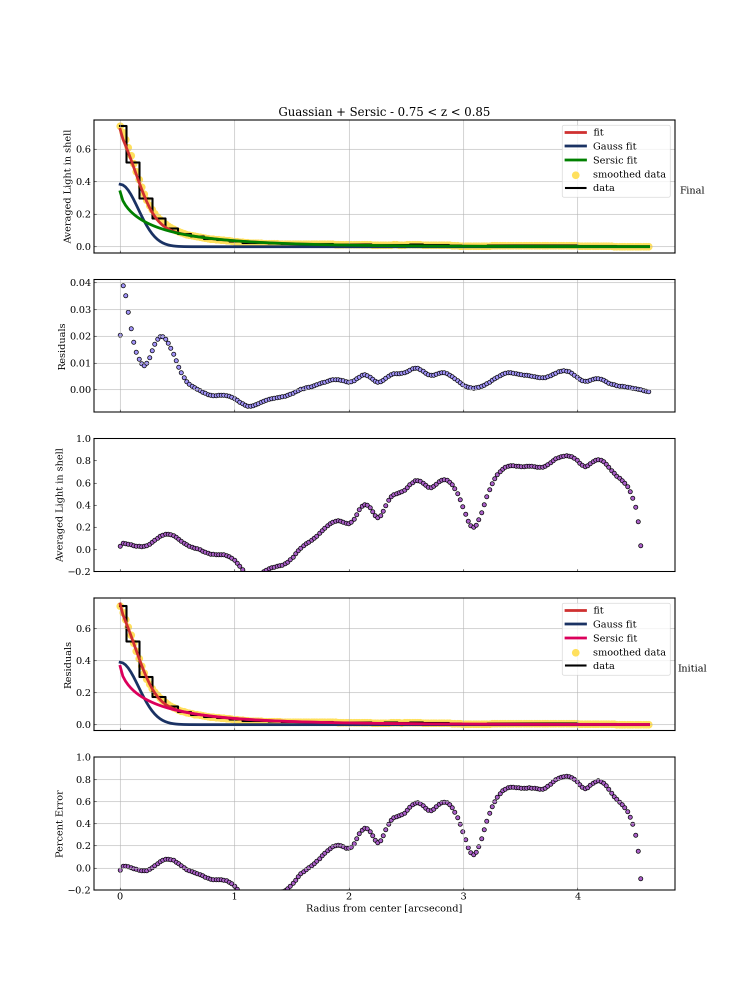

I_e = 0.02435852755915126 +0.0008588655922308376 - 0.0059799081864584

R_e = 1.2811874886329915 +0.03392434167253411 - 0.3244143588787738

N = 1.479403747127435 +0.03862286593117048 - 0.31637227444828353

A = 0.3823738371193579 +0.01005102842249056 - 0.08158083847052866

Sigma = 0.15748898687751622 +0.004483995129100415 - 0.03506031688452364


In [202]:
x_Mirror_Unindexed_075_085 = np.linspace(0,42,42)

x_data_Mirror_Unindexed_075_085 = np.multiply(x_Mirror_Unindexed_075_085, 0.11)

x_new_Mirror_Unindexed_Sersic_075_085 = np.linspace(min(x_data_Mirror_Unindexed_075_085),max(x_data_Mirror_Unindexed_075_085), 200)

x_data_Mirror_075_085 = np.multiply(x_Mirror_Unindexed_075_085, 0.11)

y_data_Mirror_Sersic_075_085 = Mirrored_Radius_array_075_085[42:85]

y_new_Mirror_Unindexed_Sersic_075_085 = CubicSpline(x_data_Mirror_Unindexed_075_085, y_data_Mirror_Sersic_075_085)

yy_new_Mirror_Unindexed_Sersic_075_085 = y_new_Mirror_Unindexed_Sersic_075_085(x_new_Mirror_Unindexed_Sersic_075_085)

Index_Sersic_075_085 = np.where(x_new_Mirror_Unindexed_Sersic_075_085 >= 0)[0]


y_err_Mirror_075_085 = 1.0 #Mirrored_Radius_array_SDE_075_085[0:84]

x_new_Mirror_Sersic_075_085 = x_new_Mirror_Unindexed_Sersic_075_085[Index_Sersic_075_085]
yy_new_Mirror_Sersic_075_085 = yy_new_Mirror_Unindexed_Sersic_075_085[Index_Sersic_075_085]

#I_e, R_e, N, A, Sigma = [0.02501925 1.30534995 1.50493629 0.38905229 0.16058682]


i_e = 0.02501925
r_e = 1.30534995
n = 1.50493629

a = 0.38905229
sigma = 0.16058682

initial_Mirror_075_085 = np.array([i_e, r_e, n, a, sigma]) #I_e,R_e,N


I_e_l_075_085 = 0
I_e_u_075_085 = i_e + (0.01*i_e)

R_e_l_075_085 = 0
R_e_u_075_085 = r_e + (0.01*r_e)

N_l_075_085 = 0
N_up_075_085 = n + (0.01*n)


a_l_075_085 = 0
a_u_075_085 = a + (0.01*a)

sigma_l_075_085 = 0
sigma_u_075_085 = sigma + (0.01*sigma)


popt_075_085, pcov_075_085 = curve_fit(Sersic_Gauss, x_new_Mirror_Sersic_075_085, yy_new_Mirror_Sersic_075_085, p0=[i_e, r_e, n, a, sigma], bounds=(0, np.inf))


# 2. Define the likelihood function ############################################################################################################################################
def log_likelihood(theta, x, y, yerr):
    i_e, r_e, n, a, sigma = theta
    model = Sersic_Gauss(x, i_e, r_e, n, a, sigma)
    sigma2 = yerr**2
    return -0.5 * np.sum((y - model)**2 / sigma2 + np.log(sigma2))

# 4. Define the prior (optional, but recommended) ############################################################################################################################################
#def log_prior(theta):
#    amp1, wid1, amp2, wid2 = theta
#    if not all(0 < param < 10 for param in [amp1, amp2, wid1, wid2]):
#        return -np.inf
#    return 0.0

def log_prior(theta):
    I_e, r_e, n, a, sigma = theta
    if (I_e_l_075_085 < I_e < I_e_u_075_085 and R_e_l_075_085 < r_e < R_e_u_075_085 and N_l_075_085 < n < N_up_075_085 and a_l_075_085 < a < a_u_075_085 and sigma_l_075_085 < sigma < sigma_u_075_085):
        return 0.0
    return -np.inf

    
# 5. Define the probability function ############################################################################################################################################
def log_probability(theta, x, y, yerr):
    lp = log_prior(theta)
    if not np.isfinite(lp):
        return -np.inf
    return lp + log_likelihood(theta, x, y, yerr)

# 3. Optimization (finding a good starting point) ############################################################################################################################################

bounds_Mirror_075_085 = [(I_e_l_075_085, I_e_u_075_085), (R_e_l_075_085, R_e_u_075_085), (N_l_075_085, N_up_075_085), (a_l_075_085, a_u_075_085), (sigma_l_075_085, sigma_u_075_085)] # Parameter bounds for optimization
soln_Mirror_075_085 = minimize(lambda *args: -log_likelihood(*args), initial_Mirror_075_085, args=(x_new_Mirror_Sersic_075_085, yy_new_Mirror_Sersic_075_085, y_err_Mirror_075_085), bounds=bounds_Mirror_075_085)

#soln = minimize(lambda *args: -log_likelihood(*args), initial, args=(x_data, y_data, y_err))
pos_Mirror_075_085 = soln_Mirror_075_085.x + 1e-4 * np.random.randn(32, len(soln_Mirror_075_085.x))
nwalkers_Mirror_075_085, ndim_Mirror_075_085 = pos_Mirror_075_085.shape


# 4. MCMC sampling ############################################################################################################################################
sampler_Mirror_075_085 = emcee.EnsembleSampler(nwalkers_Mirror_075_085, ndim_Mirror_075_085, log_probability, args=(x_new_Mirror_Sersic_075_085, yy_new_Mirror_Sersic_075_085, y_err_Mirror_075_085))
sampler_Mirror_075_085.run_mcmc(pos_Mirror_075_085, 5000, progress=True)

# 5. Analyze results
samples_Mirror_075_085 = sampler_Mirror_075_085.get_chain(flat=True)

# 6. Best fit parameters ############################################################################################################################################
best_fit_params_Mirror_075_085 = []
for i in range(ndim_Mirror_075_085):
    mcmc_Mirror_075_085 = np.percentile(samples_Mirror_075_085[:, i], [68, 95, 99.7])
    best_fit_params_Mirror_075_085.append(mcmc_Mirror_075_085[1])

# 10. Error estimation ############################################################################################################################################
errors_Mirror_075_085 = []
for i in range(ndim_Mirror_075_085):
     mcmc_Mirror_075_085 = np.percentile(samples_Mirror_075_085[:, i], [68, 95, 99.7])
     errors_Mirror_075_085.append([mcmc_Mirror_075_085[2]-mcmc_Mirror_075_085[1],mcmc_Mirror_075_085[1]-mcmc_Mirror_075_085[0]])
     
# 11. Getting the RMS Values ###########################################################################################################################################
#RMS_Bins_Mirrored_075_085 = np.arange(-10, 10, 1) # -10-10 bins of size 2
#X_Array_RMS_075_085 = np.arange(-9.5, 10.5, 1) 
#
#
#RMS_Array_075_085 = []
#RMS_Len_Array_075_085 = []
#RMS_Len_Array_Old_075_085 = []
#
#
#for i in RMS_Bins_Mirrored_075_085:
#    #print(np.where(np.logical_and(i < x_new_Mirror_Sersic_075_085, x_new_Mirror_Sersic_075_085 < i+2)))
#    #print(len(x_new_Mirror_Sersic_075_085[np.where(np.logical_and(i < x_new_Mirror_Sersic_075_085, x_new_Mirror_Sersic_075_085 < i+2))]))
#
#    index = np.where(np.logical_and(i < x_new_Mirror_Sersic_075_085, x_new_Mirror_Sersic_075_085 < i+1))[0]
#
#    index_2 = np.where(np.logical_and(i < x_data_Mirror_075_085, x_data_Mirror_075_085 < i+1))[0]
#    
#    values = yy_new_Mirror_Sersic_075_085 - two_gaussian(x_plot_Mirror_075_085, *best_fit_params_Mirror_075_085)
#
#    indexed_values = values[index]
#
#    RMS = np.sqrt( (1/len(indexed_values)) * (np.sum(indexed_values**2)) )
#
#
#    RMS_Array_075_085.append(RMS)
#    RMS_Len_Array_075_085.append(len(index))
#    RMS_Len_Array_Old_075_085.append(len(index_2))
#
#
#
#index_1_075_085 = np.where(np.logical_and(X_Array_RMS_075_085 > (40*0.11), X_Array_RMS_075_085 > 0))[0]
#index_2_075_085 = np.where(np.logical_and(X_Array_RMS_075_085 < -(40*0.11), X_Array_RMS_075_085 < 0))[0]
#index_3_075_085 = np.concatenate((index_2_075_085,index_1_075_085))
#
#Average_RMS_OutBox_075_085 = np.average(np.array(RMS_Array_075_085)[index_1_075_085])
#
#RMS_Array_InBox_075_085 = np.array(RMS_Array_075_085)
#
#RMS_Array_InBox_075_085[index_3_075_085] = Average_RMS_OutBox_075_085
     
# 12. Plot results ############################################################################################################################################

#fig = plt.figure(figsize = (20, 10),  facecolor = "white")
fig1, axes1 = plt.subplots(5, 1, sharex=True, figsize=(15, 20))

print("From Popt --- I_e, R_e, N, A, Sigma = " +str(popt_075_085))

axes1[0].plot(x_new_Mirror_Sersic_075_085, Sersic_Gauss(x_new_Mirror_Sersic_075_085, *best_fit_params_Mirror_075_085[:5]), color = "#CF3030", linewidth=4.0, label="fit", zorder=10)

axes1[0].plot(x_new_Mirror_Sersic_075_085, gaussian_3(x_new_Mirror_Sersic_075_085, *best_fit_params_Mirror_075_085[3:5]), color = "#1A3263", linewidth=4.0, label="Gauss fit", zorder=10)
axes1[0].plot(x_new_Mirror_Sersic_075_085, sersic_fit(x_new_Mirror_Sersic_075_085, *best_fit_params_Mirror_075_085[:3]), color = "green", linewidth=4.0, label="Sersic fit", zorder=10)

axes1[0].scatter(x_new_Mirror_Sersic_075_085, yy_new_Mirror_Sersic_075_085, color = "#FFE05D", label="smoothed data", s=100)#, linewidth=2.0, label="smoothed data")
axes1[0].step(x_data_Mirror_075_085, y_data_Mirror_Sersic_075_085, color = "black", linewidth=3.0, where="mid", zorder=1, label="data")

axes1[0].legend()

#axes1[0].set_ylim(-0.01, 0.03)
#ax1 = plt.subplot(3,1,2)

axes1[1].scatter(x_new_Mirror_Sersic_075_085, yy_new_Mirror_Sersic_075_085 - Sersic_Gauss(x_new_Mirror_Sersic_075_085, *best_fit_params_Mirror_075_085[:5]), c = "#A294F9", edgecolor="black") 

#ax2 = plt.subplot(3,1,3)
axes1[2].scatter(x_new_Mirror_Sersic_075_085, (yy_new_Mirror_Sersic_075_085 - Sersic_Gauss(x_new_Mirror_Sersic_075_085, *best_fit_params_Mirror_075_085[:5]))/yy_new_Mirror_Sersic_075_085, c = "#AA60C8", edgecolor="black") 

axes1[2].set_ylim(-0.2,1.0)
#axes1[2].set_xlim(-0.1,5.0)

axes1[2].grid()
#plt.ylim(-0.001,0.001)

axes1[3].plot(x_new_Mirror_Sersic_075_085, Sersic_Gauss(x_new_Mirror_Sersic_075_085, *popt_075_085[:5]), color = "#CF3030", linewidth=4.0, label="fit", zorder=10)

axes1[3].plot(x_new_Mirror_Sersic_075_085, gaussian_3(x_new_Mirror_Sersic_075_085, *popt_075_085[3:5]), color = "#1A3263", linewidth=4.0, label="Gauss fit", zorder=10)
axes1[3].plot(x_new_Mirror_Sersic_075_085, sersic_fit(x_new_Mirror_Sersic_075_085, *popt_075_085[:3]), color = "#DB005B", linewidth=4.0, label="Sersic fit", zorder=10)

axes1[3].scatter(x_new_Mirror_Sersic_075_085, yy_new_Mirror_Sersic_075_085, color = "#FFE05D", label="smoothed data", s=100)#, linewidth=2.0, label="smoothed data")
axes1[3].step(x_data_Mirror_075_085, y_data_Mirror_Sersic_075_085, color = "black", linewidth=3.0, where="mid", zorder=1, label="data")

#print(y_data_Mirror_Sersic_075_085) 
axes1[3].legend()


axes1[4].scatter(x_new_Mirror_Sersic_075_085, (yy_new_Mirror_Sersic_075_085 - Sersic_Gauss(x_new_Mirror_Sersic_075_085, *popt_075_085[:5]))/yy_new_Mirror_Sersic_075_085, c = "#AA60C8", edgecolor="black") 

axes1[4].set_ylim(-0.2,1.0)
#axes1[4].set_xlim(-0.1,5.0)

axes1[0].set_title("Guassian + Sersic - 0.75 < z < 0.85")

axes1[4].set_xlabel("Radius from center [arcsecond]")

axes1[0].set_ylabel("Averaged Light in shell")
axes1[1].set_ylabel("Residuals")
axes1[2].set_ylabel("Averaged Light in shell")
axes1[3].set_ylabel("Residuals")
axes1[4].set_ylabel("Percent Error")

ax2 = axes1[0].twinx()
ax2.set_yticks([])
ax2.set_ylabel("Final", rotation=360, labelpad=25)

ax3 = axes1[3].twinx()
ax3.set_yticks([])
ax3.set_ylabel("Initial", rotation=360, labelpad=25)


axes1[0].grid()
axes1[1].grid()
axes1[2].grid()
axes1[3].grid()
axes1[4].grid()

# Show the plot
plt.show(block=False)

#
# Close the figure
#############################################################################################################################################
I_e_Sersic_075_085 = best_fit_params_Mirror_075_085[0]
R_e_Sersic_075_085 = best_fit_params_Mirror_075_085[1]
N_Sersic_075_085 = best_fit_params_Mirror_075_085[2]
#############################################################################################################################################
print("I_e = " +str(best_fit_params_Mirror_075_085[0]) + " +" +str(errors_Mirror_075_085[0][0]) + " - " +str(errors_Mirror_075_085[0][1]))
print("")
print("R_e = " +str(best_fit_params_Mirror_075_085[1]) + " +" +str(errors_Mirror_075_085[1][0]) + " - " +str(errors_Mirror_075_085[1][1]))
print("")
print("N = " +str(best_fit_params_Mirror_075_085[2]) + " +" +str(errors_Mirror_075_085[2][0]) + " - " +str(errors_Mirror_075_085[2][1]))
print("")
print("A = " +str(best_fit_params_Mirror_075_085[3]) + " +" +str(errors_Mirror_075_085[3][0]) + " - " +str(errors_Mirror_075_085[3][1]))
print("")
print("Sigma = " +str(best_fit_params_Mirror_075_085[4]) + " +" +str(errors_Mirror_075_085[4][0]) + " - " +str(errors_Mirror_075_085[4][1]))


100%|██████████| 5000/5000 [00:08<00:00, 572.49it/s]


From Popt --- I_e, R_e, N, A, Sigma = [0.0139878  1.94530804 1.69692455 0.40821427 0.16748522]


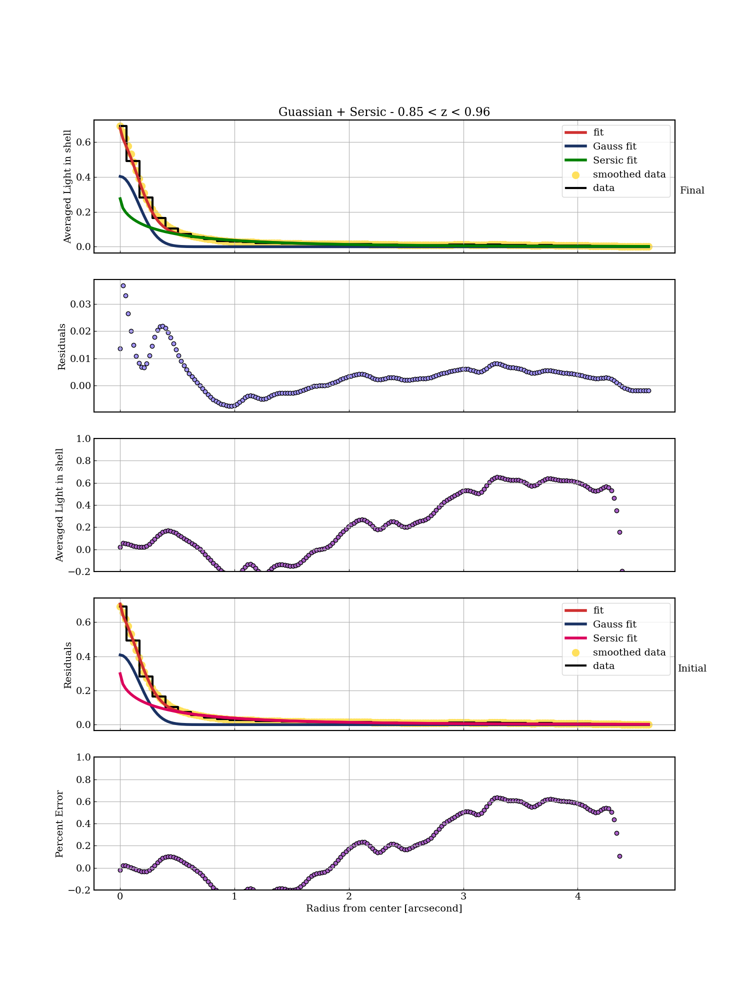

I_e = 0.013520764649763692 +0.000582922648056582 - 0.003518844743731958

R_e = 1.9360878522463352 +0.02731110072353027 - 0.4331634793839245

N = 1.6737900157988643 +0.037552107050409456 - 0.3489975083596919

A = 0.4029781648451155 +0.008874785018421594 - 0.08605845003140866

Sigma = 0.16295163449350145 +0.005853818073996764 - 0.038488186533270796


In [203]:
x_Mirror_Unindexed_085_096 = np.linspace(0,42,42)

x_data_Mirror_Unindexed_085_096 = np.multiply(x_Mirror_Unindexed_085_096, 0.11)

x_new_Mirror_Unindexed_Sersic_085_096 = np.linspace(min(x_data_Mirror_Unindexed_085_096),max(x_data_Mirror_Unindexed_085_096), 200)

x_data_Mirror_085_096 = np.multiply(x_Mirror_Unindexed_085_096, 0.11)

y_data_Mirror_Sersic_085_096 = Mirrored_Radius_array_085_096[42:85]

y_new_Mirror_Unindexed_Sersic_085_096 = CubicSpline(x_data_Mirror_Unindexed_085_096, y_data_Mirror_Sersic_085_096)

yy_new_Mirror_Unindexed_Sersic_085_096 = y_new_Mirror_Unindexed_Sersic_085_096(x_new_Mirror_Unindexed_Sersic_085_096)

Index_Sersic_085_096 = np.where(x_new_Mirror_Unindexed_Sersic_085_096 >= 0)[0]


y_err_Mirror_085_096 = 1.0 #Mirrored_Radius_array_SDE_085_096[0:84]

x_new_Mirror_Sersic_085_096 = x_new_Mirror_Unindexed_Sersic_085_096[Index_Sersic_085_096]
yy_new_Mirror_Sersic_085_096 = yy_new_Mirror_Unindexed_Sersic_085_096[Index_Sersic_085_096]

#I_e, R_e, N, A, Sigma = [0.013988   1.94528533 1.6969187  0.40821344 0.16748503]


i_e = 0.013988
r_e = 1.94528533
n = 1.6969187 

a = 0.40821344
sigma = 0.16748503

initial_Mirror_085_096 = np.array([i_e, r_e, n, a, sigma]) #I_e,R_e,N


I_e_l_085_096 = 0
I_e_u_085_096 = i_e + (0.01*i_e)

R_e_l_085_096 = 0
R_e_u_085_096 = r_e + (0.01*r_e)

N_l_085_096 = 0
N_up_085_096 = n + (0.01*n)


a_l_085_096 = 0
a_u_085_096 = a + (0.01*a)

sigma_l_085_096 = 0
sigma_u_085_096 = sigma + (0.01*sigma)


popt_085_096, pcov_085_096 = curve_fit(Sersic_Gauss, x_new_Mirror_Sersic_085_096, yy_new_Mirror_Sersic_085_096, p0=[i_e, r_e, n, a, sigma], bounds=(0, np.inf))


# 2. Define the likelihood function ############################################################################################################################################
def log_likelihood(theta, x, y, yerr):
    i_e, r_e, n, a, sigma = theta
    model = Sersic_Gauss(x, i_e, r_e, n, a, sigma)
    sigma2 = yerr**2
    return -0.5 * np.sum((y - model)**2 / sigma2 + np.log(sigma2))

# 4. Define the prior (optional, but recommended) ############################################################################################################################################
#def log_prior(theta):
#    amp1, wid1, amp2, wid2 = theta
#    if not all(0 < param < 10 for param in [amp1, amp2, wid1, wid2]):
#        return -np.inf
#    return 0.0

def log_prior(theta):
    I_e, r_e, n, a, sigma = theta
    if (I_e_l_085_096 < I_e < I_e_u_085_096 and R_e_l_085_096 < r_e < R_e_u_085_096 and N_l_085_096 < n < N_up_085_096 and a_l_085_096 < a < a_u_085_096 and sigma_l_085_096 < sigma < sigma_u_085_096):
        return 0.0
    return -np.inf

    
# 5. Define the probability function ############################################################################################################################################
def log_probability(theta, x, y, yerr):
    lp = log_prior(theta)
    if not np.isfinite(lp):
        return -np.inf
    return lp + log_likelihood(theta, x, y, yerr)

# 3. Optimization (finding a good starting point) ############################################################################################################################################

bounds_Mirror_085_096 = [(I_e_l_085_096, I_e_u_085_096), (R_e_l_085_096, R_e_u_085_096), (N_l_085_096, N_up_085_096), (a_l_085_096, a_u_085_096), (sigma_l_085_096, sigma_u_085_096)] # Parameter bounds for optimization
soln_Mirror_085_096 = minimize(lambda *args: -log_likelihood(*args), initial_Mirror_085_096, args=(x_new_Mirror_Sersic_085_096, yy_new_Mirror_Sersic_085_096, y_err_Mirror_085_096), bounds=bounds_Mirror_085_096)

#soln = minimize(lambda *args: -log_likelihood(*args), initial, args=(x_data, y_data, y_err))
pos_Mirror_085_096 = soln_Mirror_085_096.x + 1e-4 * np.random.randn(32, len(soln_Mirror_085_096.x))
nwalkers_Mirror_085_096, ndim_Mirror_085_096 = pos_Mirror_085_096.shape


# 4. MCMC sampling ############################################################################################################################################
sampler_Mirror_085_096 = emcee.EnsembleSampler(nwalkers_Mirror_085_096, ndim_Mirror_085_096, log_probability, args=(x_new_Mirror_Sersic_085_096, yy_new_Mirror_Sersic_085_096, y_err_Mirror_085_096))
sampler_Mirror_085_096.run_mcmc(pos_Mirror_085_096, 5000, progress=True)

# 5. Analyze results
samples_Mirror_085_096 = sampler_Mirror_085_096.get_chain(flat=True)

# 6. Best fit parameters ############################################################################################################################################
best_fit_params_Mirror_085_096 = []
for i in range(ndim_Mirror_085_096):
    mcmc_Mirror_085_096 = np.percentile(samples_Mirror_085_096[:, i], [68, 95, 99.7])
    best_fit_params_Mirror_085_096.append(mcmc_Mirror_085_096[1])

# 10. Error estimation ############################################################################################################################################
errors_Mirror_085_096 = []
for i in range(ndim_Mirror_085_096):
     mcmc_Mirror_085_096 = np.percentile(samples_Mirror_085_096[:, i], [68, 95, 99.7])
     errors_Mirror_085_096.append([mcmc_Mirror_085_096[2]-mcmc_Mirror_085_096[1],mcmc_Mirror_085_096[1]-mcmc_Mirror_085_096[0]])
     
# 11. Getting the RMS Values ###########################################################################################################################################
#RMS_Bins_Mirrored_085_096 = np.arange(-10, 10, 1) # -10-10 bins of size 2
#X_Array_RMS_085_096 = np.arange(-9.5, 10.5, 1) 
#
#
#RMS_Array_085_096 = []
#RMS_Len_Array_085_096 = []
#RMS_Len_Array_Old_085_096 = []
#
#
#for i in RMS_Bins_Mirrored_085_096:
#    #print(np.where(np.logical_and(i < x_new_Mirror_Sersic_085_096, x_new_Mirror_Sersic_085_096 < i+2)))
#    #print(len(x_new_Mirror_Sersic_085_096[np.where(np.logical_and(i < x_new_Mirror_Sersic_085_096, x_new_Mirror_Sersic_085_096 < i+2))]))
#
#    index = np.where(np.logical_and(i < x_new_Mirror_Sersic_085_096, x_new_Mirror_Sersic_085_096 < i+1))[0]
#
#    index_2 = np.where(np.logical_and(i < x_data_Mirror_085_096, x_data_Mirror_085_096 < i+1))[0]
#    
#    values = yy_new_Mirror_Sersic_085_096 - two_gaussian(x_plot_Mirror_085_096, *best_fit_params_Mirror_085_096)
#
#    indexed_values = values[index]
#
#    RMS = np.sqrt( (1/len(indexed_values)) * (np.sum(indexed_values**2)) )
#
#
#    RMS_Array_085_096.append(RMS)
#    RMS_Len_Array_085_096.append(len(index))
#    RMS_Len_Array_Old_085_096.append(len(index_2))
#
#
#
#index_1_085_096 = np.where(np.logical_and(X_Array_RMS_085_096 > (40*0.11), X_Array_RMS_085_096 > 0))[0]
#index_2_085_096 = np.where(np.logical_and(X_Array_RMS_085_096 < -(40*0.11), X_Array_RMS_085_096 < 0))[0]
#index_3_085_096 = np.concatenate((index_2_085_096,index_1_085_096))
#
#Average_RMS_OutBox_085_096 = np.average(np.array(RMS_Array_085_096)[index_1_085_096])
#
#RMS_Array_InBox_085_096 = np.array(RMS_Array_085_096)
#
#RMS_Array_InBox_085_096[index_3_085_096] = Average_RMS_OutBox_085_096
     
# 12. Plot results ############################################################################################################################################

#fig = plt.figure(figsize = (20, 10),  facecolor = "white")
fig1, axes1 = plt.subplots(5, 1, sharex=True, figsize=(15, 20))

print("From Popt --- I_e, R_e, N, A, Sigma = " +str(popt_085_096))

axes1[0].plot(x_new_Mirror_Sersic_085_096, Sersic_Gauss(x_new_Mirror_Sersic_085_096, *best_fit_params_Mirror_085_096[:5]), color = "#CF3030", linewidth=4.0, label="fit", zorder=10)

axes1[0].plot(x_new_Mirror_Sersic_085_096, gaussian_3(x_new_Mirror_Sersic_085_096, *best_fit_params_Mirror_085_096[3:5]), color = "#1A3263", linewidth=4.0, label="Gauss fit", zorder=10)
axes1[0].plot(x_new_Mirror_Sersic_085_096, sersic_fit(x_new_Mirror_Sersic_085_096, *best_fit_params_Mirror_085_096[:3]), color = "green", linewidth=4.0, label="Sersic fit", zorder=10)

axes1[0].scatter(x_new_Mirror_Sersic_085_096, yy_new_Mirror_Sersic_085_096, color = "#FFE05D", label="smoothed data", s=100)#, linewidth=2.0, label="smoothed data")
axes1[0].step(x_data_Mirror_085_096, y_data_Mirror_Sersic_085_096, color = "black", linewidth=3.0, where="mid", zorder=1, label="data")

axes1[0].legend()

#axes1[0].set_ylim(-0.01, 0.03)
#ax1 = plt.subplot(3,1,2)

axes1[1].scatter(x_new_Mirror_Sersic_085_096, yy_new_Mirror_Sersic_085_096 - Sersic_Gauss(x_new_Mirror_Sersic_085_096, *best_fit_params_Mirror_085_096[:5]), c = "#A294F9", edgecolor="black") 

#ax2 = plt.subplot(3,1,3)
axes1[2].scatter(x_new_Mirror_Sersic_085_096, (yy_new_Mirror_Sersic_085_096 - Sersic_Gauss(x_new_Mirror_Sersic_085_096, *best_fit_params_Mirror_085_096[:5]))/yy_new_Mirror_Sersic_085_096, c = "#AA60C8", edgecolor="black") 

axes1[2].set_ylim(-0.2,1.0)
#axes1[2].set_xlim(-0.1,5.0)


#plt.ylim(-0.001,0.001)

axes1[3].plot(x_new_Mirror_Sersic_085_096, Sersic_Gauss(x_new_Mirror_Sersic_085_096, *popt_085_096[:5]), color = "#CF3030", linewidth=4.0, label="fit", zorder=10)

axes1[3].plot(x_new_Mirror_Sersic_085_096, gaussian_3(x_new_Mirror_Sersic_085_096, *popt_085_096[3:5]), color = "#1A3263", linewidth=4.0, label="Gauss fit", zorder=10)
axes1[3].plot(x_new_Mirror_Sersic_085_096, sersic_fit(x_new_Mirror_Sersic_085_096, *popt_085_096[:3]), color = "#DB005B", linewidth=4.0, label="Sersic fit", zorder=10)

axes1[3].scatter(x_new_Mirror_Sersic_085_096, yy_new_Mirror_Sersic_085_096, color = "#FFE05D", label="smoothed data", s=100)#, linewidth=2.0, label="smoothed data")
axes1[3].step(x_data_Mirror_085_096, y_data_Mirror_Sersic_085_096, color = "black", linewidth=3.0, where="mid", zorder=1, label="data")

#print(y_data_Mirror_Sersic_085_096) 
axes1[3].legend()


axes1[4].scatter(x_new_Mirror_Sersic_085_096, (yy_new_Mirror_Sersic_085_096 - Sersic_Gauss(x_new_Mirror_Sersic_085_096, *popt_085_096[:5]))/yy_new_Mirror_Sersic_085_096, c = "#AA60C8", edgecolor="black") 

axes1[4].set_ylim(-0.2,1.0)
#axes1[4].set_xlim(-0.1,5.0)

#axes1[3].set_ylim(-0.001, 0.03)

axes1[0].set_title("Guassian + Sersic - 0.85 < z < 0.96")

axes1[4].set_xlabel("Radius from center [arcsecond]")

axes1[0].set_ylabel("Averaged Light in shell")
axes1[1].set_ylabel("Residuals")
axes1[2].set_ylabel("Averaged Light in shell")
axes1[3].set_ylabel("Residuals")
axes1[4].set_ylabel("Percent Error")

ax2 = axes1[0].twinx()
ax2.set_yticks([])
ax2.set_ylabel("Final", rotation=360, labelpad=25)

ax3 = axes1[3].twinx()
ax3.set_yticks([])
ax3.set_ylabel("Initial", rotation=360, labelpad=25)


axes1[0].grid()
axes1[1].grid()
axes1[2].grid()
axes1[3].grid()
axes1[4].grid()

plt.show(block=False)

#############################################################################################################################################
I_e_Sersic_085_096 = best_fit_params_Mirror_085_096[0]
R_e_Sersic_085_096 = best_fit_params_Mirror_085_096[1]
N_Sersic_085_096 = best_fit_params_Mirror_085_096[2]
#############################################################################################################################################
print("I_e = " +str(best_fit_params_Mirror_085_096[0]) + " +" +str(errors_Mirror_085_096[0][0]) + " - " +str(errors_Mirror_085_096[0][1]))
print("")
print("R_e = " +str(best_fit_params_Mirror_085_096[1]) + " +" +str(errors_Mirror_085_096[1][0]) + " - " +str(errors_Mirror_085_096[1][1]))
print("")
print("N = " +str(best_fit_params_Mirror_085_096[2]) + " +" +str(errors_Mirror_085_096[2][0]) + " - " +str(errors_Mirror_085_096[2][1]))
print("")
print("A = " +str(best_fit_params_Mirror_085_096[3]) + " +" +str(errors_Mirror_085_096[3][0]) + " - " +str(errors_Mirror_085_096[3][1]))
print("")
print("Sigma = " +str(best_fit_params_Mirror_085_096[4]) + " +" +str(errors_Mirror_085_096[4][0]) + " - " +str(errors_Mirror_085_096[4][1]))


In [204]:
Area_Narrow_Sersic_025_035 = np.trapz(gaussian_3(x_new_Mirror_Sersic_025_035, *best_fit_params_Mirror_025_035[3:5]), x=x_new_Mirror_Sersic_025_035)
Area_Narrow_Sersic_035_045 = np.trapz(gaussian_3(x_new_Mirror_Sersic_035_045, *best_fit_params_Mirror_035_045[3:5]), x=x_new_Mirror_Sersic_035_045)
Area_Narrow_Sersic_045_055 = np.trapz(gaussian_3(x_new_Mirror_Sersic_045_055, *best_fit_params_Mirror_045_055[3:5]), x=x_new_Mirror_Sersic_045_055)
Area_Narrow_Sersic_055_065 = np.trapz(gaussian_3(x_new_Mirror_Sersic_055_065, *best_fit_params_Mirror_055_065[3:5]), x=x_new_Mirror_Sersic_055_065)
Area_Narrow_Sersic_065_075 = np.trapz(gaussian_3(x_new_Mirror_Sersic_065_075, *best_fit_params_Mirror_065_075[3:5]), x=x_new_Mirror_Sersic_065_075)
Area_Narrow_Sersic_075_085 = np.trapz(gaussian_3(x_new_Mirror_Sersic_075_085, *best_fit_params_Mirror_075_085[3:5]), x=x_new_Mirror_Sersic_075_085)
Area_Narrow_Sersic_085_096 = np.trapz(gaussian_3(x_new_Mirror_Sersic_085_096, *best_fit_params_Mirror_085_096[3:5]), x=x_new_Mirror_Sersic_085_096)

Area_Broad_Sersic_025_035 = np.trapz(sersic_fit(x_new_Mirror_Sersic_025_035, *best_fit_params_Mirror_025_035[:3]), x=x_new_Mirror_Sersic_025_035)
Area_Broad_Sersic_035_045 = np.trapz(sersic_fit(x_new_Mirror_Sersic_035_045, *best_fit_params_Mirror_035_045[:3]), x=x_new_Mirror_Sersic_035_045)
Area_Broad_Sersic_045_055 = np.trapz(sersic_fit(x_new_Mirror_Sersic_045_055, *best_fit_params_Mirror_045_055[:3]), x=x_new_Mirror_Sersic_045_055)
Area_Broad_Sersic_055_065 = np.trapz(sersic_fit(x_new_Mirror_Sersic_055_065, *best_fit_params_Mirror_055_065[:3]), x=x_new_Mirror_Sersic_055_065)
Area_Broad_Sersic_065_075 = np.trapz(sersic_fit(x_new_Mirror_Sersic_065_075, *best_fit_params_Mirror_065_075[:3]), x=x_new_Mirror_Sersic_065_075)
Area_Broad_Sersic_075_085 = np.trapz(sersic_fit(x_new_Mirror_Sersic_075_085, *best_fit_params_Mirror_075_085[:3]), x=x_new_Mirror_Sersic_075_085)
Area_Broad_Sersic_085_096 = np.trapz(sersic_fit(x_new_Mirror_Sersic_085_096, *best_fit_params_Mirror_085_096[:3]), x=x_new_Mirror_Sersic_085_096)

In [205]:
Fractional_Area_Broad_Sersic_025_035 = Area_Broad_Sersic_025_035 / (Area_Broad_Sersic_025_035 + Area_Narrow_Sersic_025_035)
Fractional_Area_Broad_Sersic_035_045 = Area_Broad_Sersic_035_045 / (Area_Broad_Sersic_035_045 + Area_Narrow_Sersic_035_045)
Fractional_Area_Broad_Sersic_045_055 = Area_Broad_Sersic_045_055 / (Area_Broad_Sersic_045_055 + Area_Narrow_Sersic_045_055)
Fractional_Area_Broad_Sersic_055_065 = Area_Broad_Sersic_055_065 / (Area_Broad_Sersic_055_065 + Area_Narrow_Sersic_055_065)
Fractional_Area_Broad_Sersic_065_075 = Area_Broad_Sersic_065_075 / (Area_Broad_Sersic_065_075 + Area_Narrow_Sersic_065_075)
Fractional_Area_Broad_Sersic_075_085 = Area_Broad_Sersic_075_085 / (Area_Broad_Sersic_075_085 + Area_Narrow_Sersic_075_085)
Fractional_Area_Broad_Sersic_085_096 = Area_Broad_Sersic_085_096 / (Area_Broad_Sersic_085_096 + Area_Narrow_Sersic_085_096)

In [206]:
# The Magnitude of the galaxy component for each redshift
Gal_Mag_Sersic_025_035 = Mag_Total_025_035 - 2.5*np.log10(Fractional_Area_Broad_Sersic_025_035)
Gal_Mag_Sersic_035_045 = Mag_Total_035_045 - 2.5*np.log10(Fractional_Area_Broad_Sersic_035_045)
Gal_Mag_Sersic_045_055 = Mag_Total_045_055 - 2.5*np.log10(Fractional_Area_Broad_Sersic_045_055)
Gal_Mag_Sersic_055_065 = Mag_Total_055_065 - 2.5*np.log10(Fractional_Area_Broad_Sersic_055_065)
Gal_Mag_Sersic_065_075 = Mag_Total_065_075 - 2.5*np.log10(Fractional_Area_Broad_Sersic_065_075)
Gal_Mag_Sersic_075_085 = Mag_Total_075_085 - 2.5*np.log10(Fractional_Area_Broad_Sersic_075_085)
Gal_Mag_Sersic_085_096 = Mag_Total_085_096 - 2.5*np.log10(Fractional_Area_Broad_Sersic_085_096)


In [207]:
#Gal_Mag_Sersic_SD_025_035 = MC_Error_mag_gal(Mag_Total_025_035, Mag_Total_SD_025_035, Fractional_Area_Broad_Sersic_025_035, Fractional_Area_Broad_Sersic_SD_025_035, 10000)[0]
#Gal_Mag_Sersic_SD_035_045 = MC_Error_mag_gal(Mag_Total_035_045, Mag_Total_SD_035_045, Fractional_Area_Broad_Sersic_035_045, Fractional_Area_Broad_Sersic_SD_035_045, 10000)[0]
#Gal_Mag_Sersic_SD_045_055 = MC_Error_mag_gal(Mag_Total_045_055, Mag_Total_SD_045_055, Fractional_Area_Broad_Sersic_045_055, Fractional_Area_Broad_Sersic_SD_045_055, 10000)[0]
#Gal_Mag_Sersic_SD_055_065 = MC_Error_mag_gal(Mag_Total_055_065, Mag_Total_SD_055_065, Fractional_Area_Broad_Sersic_055_065, Fractional_Area_Broad_Sersic_SD_055_065, 10000)[0]
#Gal_Mag_Sersic_SD_065_075 = MC_Error_mag_gal(Mag_Total_065_075, Mag_Total_SD_065_075, Fractional_Area_Broad_Sersic_065_075, Fractional_Area_Broad_Sersic_SD_065_075, 10000)[0]
#Gal_Mag_Sersic_SD_075_085 = MC_Error_mag_gal(Mag_Total_075_085, Mag_Total_SD_075_085, Fractional_Area_Broad_Sersic_075_085, Fractional_Area_Broad_Sersic_SD_075_085, 10000)[0]
#Gal_Mag_Sersic_SD_085_096 = MC_Error_mag_gal(Mag_Total_085_096, Mag_Total_SD_085_096, Fractional_Area_Broad_Sersic_085_096, Fractional_Area_Broad_Sersic_SD_085_096, 10000)[0]

In [208]:
print(Gal_Mag_Sersic_025_035)#, Gal_Mag_Sersic_SD_025_035)
print(Gal_Mag_Sersic_035_045)#, Gal_Mag_Sersic_SD_035_045)
print(Gal_Mag_Sersic_045_055)#, Gal_Mag_Sersic_SD_045_055)
print(Gal_Mag_Sersic_055_065)#, Gal_Mag_Sersic_SD_055_065)
print(Gal_Mag_Sersic_065_075)#, Gal_Mag_Sersic_SD_065_075)
print(Gal_Mag_Sersic_075_085)#, Gal_Mag_Sersic_SD_075_085)
print(Gal_Mag_Sersic_085_096)#, Gal_Mag_Sersic_SD_085_096)

18.458161647364268
19.283404957900963
19.716953592016175
20.373362000627534
20.432540817410224
20.46652243768536
20.54623121947345


In [209]:
Gal_Mag_Sersic_Array = np.array([Gal_Mag_Sersic_025_035, Gal_Mag_Sersic_035_045, Gal_Mag_Sersic_045_055, Gal_Mag_Sersic_055_065, Gal_Mag_Sersic_065_075, Gal_Mag_Sersic_075_085, Gal_Mag_Sersic_085_096])


In [210]:
#Gal_Mag_Sersic_SD_Array = np.array([Gal_Mag_Sersic_SD_025_035, Gal_Mag_Sersic_SD_035_045, Gal_Mag_Sersic_SD_045_055, Gal_Mag_Sersic_SD_055_065, Gal_Mag_Sersic_SD_065_075, Gal_Mag_Sersic_SD_075_085, Gal_Mag_Sersic_SD_085_096])

## <font color='#e55730' size=3 >Gaussian + Sersic -> Fixed PSF and N </font>

100%|██████████| 5000/5000 [00:08<00:00, 582.00it/s]


From Popt --- I_e, R_e, A = [0.40302917 0.40182214 0.42303063]


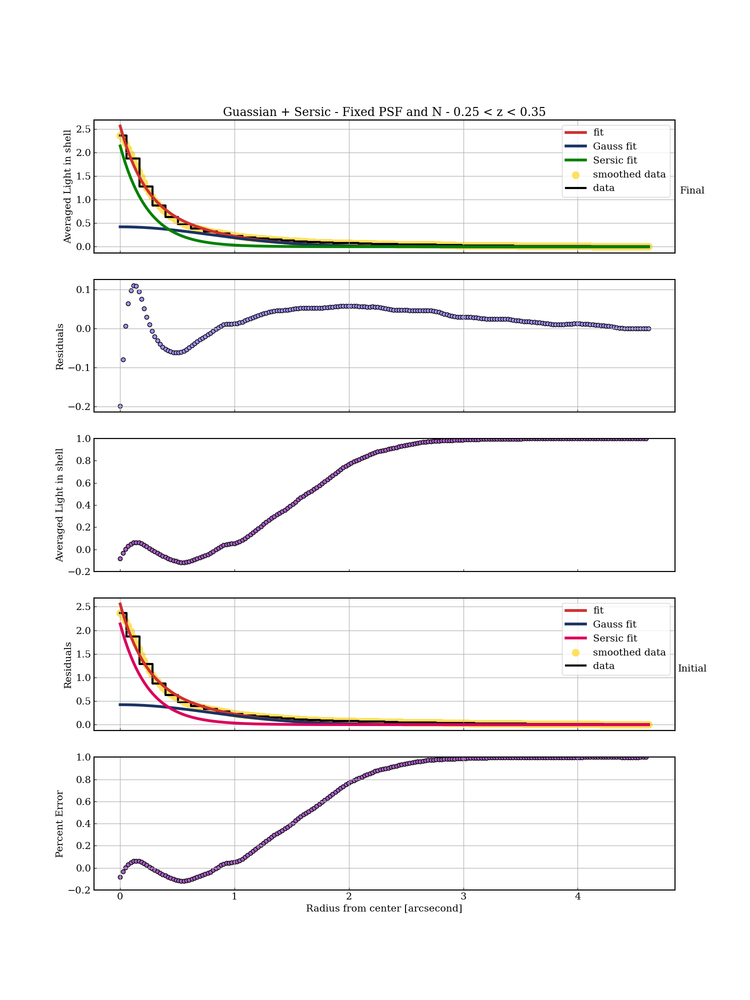

I_e = 0.4037456111791085 +0.0031477364584734935 - 0.020778783738125528

R_e = 0.4021203671710048 +0.0035349564740064787 - 0.025718190155322118

A = 0.42200825836632166 +0.004893256164012649 - 0.03747396607468795


In [211]:
x_Mirror_Unindexed_Sersic_Fixed_025_035 = np.linspace(0,42,42)

x_data_Mirror_Unindexed_Sersic_Fixed_025_035 = np.multiply(x_Mirror_Unindexed_Sersic_Fixed_025_035, 0.11)

x_new_Mirror_Unindexed_Sersic_Fixed_025_035 = np.linspace(min(x_data_Mirror_Unindexed_Sersic_Fixed_025_035),max(x_data_Mirror_Unindexed_Sersic_Fixed_025_035), 200)

x_data_Mirror_Sersic_Fixed_025_035 = np.multiply(x_Mirror_Unindexed_Sersic_Fixed_025_035, 0.11)

y_data_Mirror_Sersic_Fixed_025_035 = Mirrored_Radius_array_025_035[42:85]

y_new_Mirror_Unindexed_Sersic_Fixed_025_035 = CubicSpline(x_data_Mirror_Unindexed_Sersic_Fixed_025_035, y_data_Mirror_Sersic_Fixed_025_035)

yy_new_Mirror_Unindexed_Sersic_Fixed_025_035 = y_new_Mirror_Unindexed_Sersic_Fixed_025_035(x_new_Mirror_Unindexed_Sersic_Fixed_025_035)

Index_Sersic_Fixed_025_035 = np.where(x_new_Mirror_Unindexed_Sersic_Fixed_025_035 >= 0)[0]


y_err_Mirror_Sersic_Fixed_025_035 = 1.0 #Mirrored_Radius_array_SDE_025_035[0:84]

x_new_Mirror_Sersic_Fixed_025_035 = x_new_Mirror_Unindexed_Sersic_025_035[Index_Sersic_Fixed_025_035]
yy_new_Mirror_Sersic_Fixed_025_035 = yy_new_Mirror_Unindexed_Sersic_025_035[Index_Sersic_Fixed_025_035]

#I_e, R_e, A = [0.40302902 0.40181998 0.42303398]


i_e_Sersic_Fixed_025_035 = 0.40302902
r_e_Sersic_Fixed_025_035 = 0.40181998

a_Sersic_Fixed_025_035 = 0.42303398

initial_Mirror_Sersic_Fixed_025_035 = np.array([i_e_Sersic_Fixed_025_035, r_e_Sersic_Fixed_025_035, a_Sersic_Fixed_025_035]) #I_e,R_e,A


I_e_l_Sersic_Fixed_025_035 = 0
I_e_u_Sersic_Fixed_025_035 = i_e_Sersic_Fixed_025_035 + (0.01*i_e_Sersic_Fixed_025_035)

R_e_l_Sersic_Fixed_025_035 = 0
R_e_u_Sersic_Fixed_025_035 = r_e_Sersic_Fixed_025_035 + (0.01*r_e_Sersic_Fixed_025_035)

a_l_Sersic_Fixed_025_035 = 0
a_u_Sersic_Fixed_025_035 = a_Sersic_Fixed_025_035 + (0.01*a_Sersic_Fixed_025_035)


popt_Sersic_Fixed_025_035, pcov_Sersic_Fixed_025_035 = curve_fit(Sersic_Gauss_Fixed, x_new_Mirror_Sersic_Fixed_025_035, yy_new_Mirror_Sersic_Fixed_025_035, p0=[i_e_Sersic_Fixed_025_035, r_e_Sersic_Fixed_025_035, a_Sersic_Fixed_025_035], bounds=(0, np.inf))


# 2. Define the likelihood function ############################################################################################################################################
def log_likelihood(theta, x, y, yerr):
    i_e_Sersic_Fixed_025_035, r_e_Sersic_Fixed_025_035, a_Sersic_Fixed_025_035 = theta
    model = Sersic_Gauss_Fixed(x, i_e_Sersic_Fixed_025_035, r_e_Sersic_Fixed_025_035, a_Sersic_Fixed_025_035)
    sigma2 = yerr**2
    return -0.5 * np.sum((y - model)**2 / sigma2 + np.log(sigma2))

# 4. Define the prior (optional, but recommended) ############################################################################################################################################
#def log_prior(theta):
#    amp1, wid1, amp2, wid2 = theta
#    if not all(0 < param < 10 for param in [amp1, amp2, wid1, wid2]):
#        return -np.inf
#    return 0.0

def log_prior(theta):
    i_e_Sersic_Fixed_025_035, r_e_Sersic_Fixed_025_035, a_Sersic_Fixed_025_035 = theta
    if (I_e_l_Sersic_Fixed_025_035 < i_e_Sersic_Fixed_025_035 < I_e_u_Sersic_Fixed_025_035 and R_e_l_Sersic_Fixed_025_035 < r_e_Sersic_Fixed_025_035 < R_e_u_Sersic_Fixed_025_035 and a_l_Sersic_Fixed_025_035 < a_Sersic_Fixed_025_035 < a_u_Sersic_Fixed_025_035):
        return 0.0
    return -np.inf

    
# 5. Define the probability function ############################################################################################################################################
def log_probability(theta, x, y, yerr):
    lp = log_prior(theta)
    if not np.isfinite(lp):
        return -np.inf
    return lp + log_likelihood(theta, x, y, yerr)

# 3. Optimization (finding a good starting point) ############################################################################################################################################

bounds_Mirror_Sersic_Fixed_025_035 = [(I_e_l_Sersic_Fixed_025_035, I_e_u_Sersic_Fixed_025_035), (R_e_l_Sersic_Fixed_025_035, R_e_u_Sersic_Fixed_025_035), (a_l_Sersic_Fixed_025_035, a_u_Sersic_Fixed_025_035)] # Parameter bounds for optimization
soln_Mirror_Sersic_Fixed_025_035 = minimize(lambda *args: -log_likelihood(*args), initial_Mirror_Sersic_Fixed_025_035, args=(x_new_Mirror_Sersic_Fixed_025_035, yy_new_Mirror_Sersic_Fixed_025_035, y_err_Mirror_Sersic_Fixed_025_035), bounds=bounds_Mirror_Sersic_Fixed_025_035)

#soln = minimize(lambda *args: -log_likelihood(*args), initial, args=(x_data, y_data, y_err))
pos_Mirror_Sersic_Fixed_025_035 = soln_Mirror_Sersic_Fixed_025_035.x + 1e-4 * np.random.randn(32, len(soln_Mirror_Sersic_Fixed_025_035.x))
nwalkers_Mirror_Sersic_Fixed_025_035, ndim_Mirror_Sersic_Fixed_025_035 = pos_Mirror_Sersic_Fixed_025_035.shape


# 4. MCMC sampling ############################################################################################################################################
sampler_Mirror_Sersic_Fixed_025_035 = emcee.EnsembleSampler(nwalkers_Mirror_Sersic_Fixed_025_035, ndim_Mirror_Sersic_Fixed_025_035, log_probability, args=(x_new_Mirror_Sersic_Fixed_025_035, yy_new_Mirror_Sersic_Fixed_025_035, y_err_Mirror_Sersic_Fixed_025_035))
sampler_Mirror_Sersic_Fixed_025_035.run_mcmc(pos_Mirror_Sersic_Fixed_025_035, 5000, progress=True)

# 5. Analyze results
samples_Mirror_Sersic_Fixed_025_035 = sampler_Mirror_Sersic_Fixed_025_035.get_chain(flat=True)

# 6. Best fit parameters ############################################################################################################################################
best_fit_params_Mirror_Sersic_Fixed_025_035 = []
for i in range(ndim_Mirror_Sersic_Fixed_025_035):
    mcmc_Mirror_Sersic_Fixed_025_035 = np.percentile(samples_Mirror_Sersic_Fixed_025_035[:, i], [68, 95, 99.7])
    best_fit_params_Mirror_Sersic_Fixed_025_035.append(mcmc_Mirror_Sersic_Fixed_025_035[1])

# 10. Error estimation ############################################################################################################################################
errors_Mirror_Sersic_Fixed_025_035 = []
for i in range(ndim_Mirror_Sersic_Fixed_025_035):
     mcmc_Mirror_Sersic_Fixed_025_035 = np.percentile(samples_Mirror_Sersic_Fixed_025_035[:, i], [68, 95, 99.7])
     errors_Mirror_Sersic_Fixed_025_035.append([mcmc_Mirror_Sersic_Fixed_025_035[2]-mcmc_Mirror_Sersic_Fixed_025_035[1],mcmc_Mirror_Sersic_Fixed_025_035[1]-mcmc_Mirror_Sersic_Fixed_025_035[0]])
     
# 11. Getting the RMS Values ###########################################################################################################################################
#RMS_Bins_Mirrored_025_035 = np.arange(-10, 10, 1) # -10-10 bins of size 2
#X_Array_RMS_025_035 = np.arange(-9.5, 10.5, 1) 
#
#
#RMS_Array_025_035 = []
#RMS_Len_Array_025_035 = []
#RMS_Len_Array_Old_025_035 = []
#
#
#for i in RMS_Bins_Mirrored_025_035:
#    #print(np.where(np.logical_and(i < x_new_Mirror_Sersic_025_035, x_new_Mirror_Sersic_025_035 < i+2)))
#    #print(len(x_new_Mirror_Sersic_025_035[np.where(np.logical_and(i < x_new_Mirror_Sersic_025_035, x_new_Mirror_Sersic_025_035 < i+2))]))
#
#    index = np.where(np.logical_and(i < x_new_Mirror_Sersic_025_035, x_new_Mirror_Sersic_025_035 < i+1))[0]
#
#    index_2 = np.where(np.logical_and(i < x_data_Mirror_025_035, x_data_Mirror_025_035 < i+1))[0]
#    
#    values = yy_new_Mirror_Sersic_025_035 - two_gaussian(x_plot_Mirror_025_035, *best_fit_params_Mirror_025_035)
#
#    indexed_values = values[index]
#
#    RMS = np.sqrt( (1/len(indexed_values)) * (np.sum(indexed_values**2)) )
#
#
#    RMS_Array_025_035.append(RMS)
#    RMS_Len_Array_025_035.append(len(index))
#    RMS_Len_Array_Old_025_035.append(len(index_2))
#
#
#
#index_1_025_035 = np.where(np.logical_and(X_Array_RMS_025_035 > (40*0.11), X_Array_RMS_025_035 > 0))[0]
#index_2_025_035 = np.where(np.logical_and(X_Array_RMS_025_035 < -(40*0.11), X_Array_RMS_025_035 < 0))[0]
#index_3_025_035 = np.concatenate((index_2_025_035,index_1_025_035))
#
#Average_RMS_OutBox_025_035 = np.average(np.array(RMS_Array_025_035)[index_1_025_035])
#
#RMS_Array_InBox_025_035 = np.array(RMS_Array_025_035)
#
#RMS_Array_InBox_025_035[index_3_025_035] = Average_RMS_OutBox_025_035
     
# 12. Plot results ############################################################################################################################################

#fig = plt.figure(figsize = (20, 10),  facecolor = "white")
fig1, axes1 = plt.subplots(5, 1, sharex=True, figsize=(15, 20))

print("From Popt --- I_e, R_e, A = " +str(popt_Sersic_Fixed_025_035))

axes1[0].plot(x_new_Mirror_Sersic_Fixed_025_035, Sersic_Gauss_Fixed(x_new_Mirror_Sersic_Fixed_025_035, *best_fit_params_Mirror_Sersic_Fixed_025_035[:3]), color = "#CF3030", linewidth=4.0, label="fit", zorder=10)

axes1[0].plot(x_new_Mirror_Sersic_Fixed_025_035, gaussian_3_Fixed(x_new_Mirror_Sersic_Fixed_025_035, *best_fit_params_Mirror_Sersic_Fixed_025_035[2:3]), color = "#1A3263", linewidth=4.0, label="Gauss fit", zorder=10)
axes1[0].plot(x_new_Mirror_Sersic_Fixed_025_035, sersic_fit_Fixed(x_new_Mirror_Sersic_Fixed_025_035, *best_fit_params_Mirror_Sersic_Fixed_025_035[:2]), color = "green", linewidth=4.0, label="Sersic fit", zorder=10)

axes1[0].scatter(x_new_Mirror_Sersic_Fixed_025_035, yy_new_Mirror_Sersic_Fixed_025_035, color = "#FFE05D", label="smoothed data", s=100)#, linewidth=2.0, label="smoothed data")
axes1[0].step(x_data_Mirror_Sersic_Fixed_025_035, y_data_Mirror_Sersic_Fixed_025_035, color = "black", linewidth=3.0, where="mid", zorder=1, label="data")

axes1[0].legend()

#axes1[0].set_ylim(-0.01, 0.03)
#ax1 = plt.subplot(3,1,2)

axes1[1].scatter(x_new_Mirror_Sersic_Fixed_025_035, yy_new_Mirror_Sersic_Fixed_025_035 - Sersic_Gauss_Fixed(x_new_Mirror_Sersic_Fixed_025_035, *best_fit_params_Mirror_Sersic_Fixed_025_035[:5]), c = "#A294F9", edgecolor="black") 

#ax2 = plt.subplot(3,1,3)
axes1[2].scatter(x_new_Mirror_Sersic_Fixed_025_035, (yy_new_Mirror_Sersic_Fixed_025_035 - Sersic_Gauss_Fixed(x_new_Mirror_Sersic_Fixed_025_035, *best_fit_params_Mirror_Sersic_Fixed_025_035[:5]))/yy_new_Mirror_Sersic_Fixed_025_035, c = "#AA60C8", edgecolor="black") 

axes1[2].set_ylim(-0.2,1.0)
#axes1[2].set_xlim(-0.1,5.0)

axes1[2].grid()
#plt.ylim(-0.001,0.001)

axes1[3].plot(x_new_Mirror_Sersic_Fixed_025_035, Sersic_Gauss_Fixed(x_new_Mirror_Sersic_Fixed_025_035, *popt_Sersic_Fixed_025_035[:3]), color = "#CF3030", linewidth=4.0, label="fit", zorder=10)

axes1[3].plot(x_new_Mirror_Sersic_Fixed_025_035, gaussian_3_Fixed(x_new_Mirror_Sersic_Fixed_025_035, *popt_Sersic_Fixed_025_035[2:3]), color = "#1A3263", linewidth=4.0, label="Gauss fit", zorder=10)
axes1[3].plot(x_new_Mirror_Sersic_Fixed_025_035, sersic_fit_Fixed(x_new_Mirror_Sersic_Fixed_025_035, *popt_Sersic_Fixed_025_035[:2]), color = "#DB005B", linewidth=4.0, label="Sersic fit", zorder=10)

axes1[3].scatter(x_new_Mirror_Sersic_Fixed_025_035, yy_new_Mirror_Sersic_Fixed_025_035, color = "#FFE05D", label="smoothed data", s=100)#, linewidth=2.0, label="smoothed data")
axes1[3].step(x_data_Mirror_Sersic_Fixed_025_035, y_data_Mirror_Sersic_Fixed_025_035, color = "black", linewidth=3.0, where="mid", zorder=1, label="data")

#print(y_data_Mirror_Sersic_025_035) 
axes1[3].legend()


axes1[4].scatter(x_new_Mirror_Sersic_Fixed_025_035, (yy_new_Mirror_Sersic_Fixed_025_035 - Sersic_Gauss_Fixed(x_new_Mirror_Sersic_Fixed_025_035, *popt_Sersic_Fixed_025_035[:5]))/yy_new_Mirror_Sersic_Fixed_025_035, c = "#AA60C8", edgecolor="black") 

axes1[4].set_ylim(-0.2,1.0)
#axes1[4].set_xlim(-0.1,5.0)

axes1[0].set_title("Guassian + Sersic - Fixed PSF and N - 0.25 < z < 0.35")

axes1[4].set_xlabel("Radius from center [arcsecond]")

axes1[0].set_ylabel("Averaged Light in shell")
axes1[1].set_ylabel("Residuals")
axes1[2].set_ylabel("Averaged Light in shell")
axes1[3].set_ylabel("Residuals")
axes1[4].set_ylabel("Percent Error")

ax2 = axes1[0].twinx()
ax2.set_yticks([])
ax2.set_ylabel("Final", rotation=360, labelpad=25)

ax3 = axes1[3].twinx()
ax3.set_yticks([])
ax3.set_ylabel("Initial", rotation=360, labelpad=25)


axes1[0].grid()
axes1[1].grid()
axes1[2].grid()
axes1[3].grid()
axes1[4].grid()

# Show the plot
plt.show(block=False)


# Close the figure
#############################################################################################################################################
I_e_Sersic_025_035 = best_fit_params_Mirror_Sersic_Fixed_025_035[0]
R_e_Sersic_025_035 = best_fit_params_Mirror_Sersic_Fixed_025_035[1]
#############################################################################################################################################
print("I_e = " +str(best_fit_params_Mirror_Sersic_Fixed_025_035[0]) + " +" +str(errors_Mirror_Sersic_Fixed_025_035[0][0]) + " - " +str(errors_Mirror_Sersic_Fixed_025_035[0][1]))
print("")
print("R_e = " +str(best_fit_params_Mirror_Sersic_Fixed_025_035[1]) + " +" +str(errors_Mirror_Sersic_Fixed_025_035[1][0]) + " - " +str(errors_Mirror_Sersic_Fixed_025_035[1][1]))
print("")
print("A = " +str(best_fit_params_Mirror_Sersic_Fixed_025_035[2]) + " +" +str(errors_Mirror_Sersic_Fixed_025_035[2][0]) + " - " +str(errors_Mirror_Sersic_Fixed_025_035[2][1]))



100%|██████████| 5000/5000 [00:08<00:00, 578.43it/s]


From Popt --- I_e, R_e, A = [0.27882404 0.42159209 0.15493228]


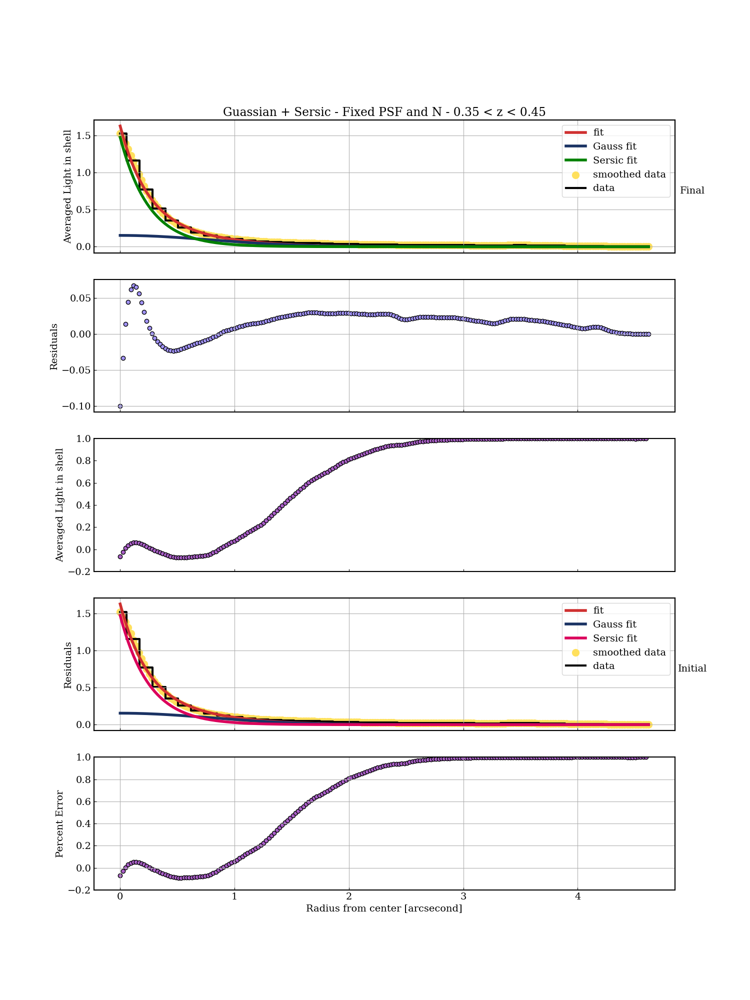

I_e = 0.2781078529441597 +0.0033106909669657347 - 0.022652295102868814

R_e = 0.41983575947185964 +0.005607365574407219 - 0.04080928307842652

A = 0.15228746835920035 +0.003965230592641283 - 0.028864041801411666


In [212]:
x_Mirror_Unindexed_Sersic_Fixed_035_045 = np.linspace(0,42,42)

x_data_Mirror_Unindexed_Sersic_Fixed_035_045 = np.multiply(x_Mirror_Unindexed_Sersic_Fixed_035_045, 0.11)

x_new_Mirror_Unindexed_Sersic_Fixed_035_045 = np.linspace(min(x_data_Mirror_Unindexed_Sersic_Fixed_035_045),max(x_data_Mirror_Unindexed_Sersic_Fixed_035_045), 200)

x_data_Mirror_Sersic_Fixed_035_045 = np.multiply(x_Mirror_Unindexed_Sersic_Fixed_035_045, 0.11)

y_data_Mirror_Sersic_Fixed_035_045 = Mirrored_Radius_array_035_045[42:85]

y_new_Mirror_Unindexed_Sersic_Fixed_035_045 = CubicSpline(x_data_Mirror_Unindexed_Sersic_Fixed_035_045, y_data_Mirror_Sersic_Fixed_035_045)

yy_new_Mirror_Unindexed_Sersic_Fixed_035_045 = y_new_Mirror_Unindexed_Sersic_Fixed_035_045(x_new_Mirror_Unindexed_Sersic_Fixed_035_045)

Index_Sersic_Fixed_035_045 = np.where(x_new_Mirror_Unindexed_Sersic_Fixed_035_045 >= 0)[0]


y_err_Mirror_Sersic_Fixed_035_045 = 1.0 #Mirrored_Radius_array_SDE_035_045[0:84]

x_new_Mirror_Sersic_Fixed_035_045 = x_new_Mirror_Unindexed_Sersic_035_045[Index_Sersic_Fixed_035_045]
yy_new_Mirror_Sersic_Fixed_035_045 = yy_new_Mirror_Unindexed_Sersic_035_045[Index_Sersic_Fixed_035_045]

#I_e, R_e, A = [0.27882388 0.42158958 0.15493504]


i_e_Sersic_Fixed_035_045 = 0.27882388
r_e_Sersic_Fixed_035_045 = 0.42158958

a_Sersic_Fixed_035_045 = 0.15493504

initial_Mirror_Sersic_Fixed_035_045 = np.array([i_e_Sersic_Fixed_035_045, r_e_Sersic_Fixed_035_045, a_Sersic_Fixed_035_045]) #I_e,R_e,A


I_e_l_Sersic_Fixed_035_045 = 0
I_e_u_Sersic_Fixed_035_045 = i_e_Sersic_Fixed_035_045 + (0.01*i_e_Sersic_Fixed_035_045)

R_e_l_Sersic_Fixed_035_045 = 0
R_e_u_Sersic_Fixed_035_045 = r_e_Sersic_Fixed_035_045 + (0.01*r_e_Sersic_Fixed_035_045)

a_l_Sersic_Fixed_035_045 = 0
a_u_Sersic_Fixed_035_045 = a_Sersic_Fixed_035_045 + (0.01*a_Sersic_Fixed_035_045)


popt_Sersic_Fixed_035_045, pcov_Sersic_Fixed_035_045 = curve_fit(Sersic_Gauss_Fixed, x_new_Mirror_Sersic_Fixed_035_045, yy_new_Mirror_Sersic_Fixed_035_045, p0=[i_e_Sersic_Fixed_035_045, r_e_Sersic_Fixed_035_045, a_Sersic_Fixed_035_045], bounds=(0, np.inf))


# 2. Define the likelihood function ############################################################################################################################################
def log_likelihood(theta, x, y, yerr):
    i_e_Sersic_Fixed_035_045, r_e_Sersic_Fixed_035_045, a_Sersic_Fixed_035_045 = theta
    model = Sersic_Gauss_Fixed(x, i_e_Sersic_Fixed_035_045, r_e_Sersic_Fixed_035_045, a_Sersic_Fixed_035_045)
    sigma2 = yerr**2
    return -0.5 * np.sum((y - model)**2 / sigma2 + np.log(sigma2))

# 4. Define the prior (optional, but recommended) ############################################################################################################################################
#def log_prior(theta):
#    amp1, wid1, amp2, wid2 = theta
#    if not all(0 < param < 10 for param in [amp1, amp2, wid1, wid2]):
#        return -np.inf
#    return 0.0

def log_prior(theta):
    i_e_Sersic_Fixed_035_045, r_e_Sersic_Fixed_035_045, a_Sersic_Fixed_035_045 = theta
    if (I_e_l_Sersic_Fixed_035_045 < i_e_Sersic_Fixed_035_045 < I_e_u_Sersic_Fixed_035_045 and R_e_l_Sersic_Fixed_035_045 < r_e_Sersic_Fixed_035_045 < R_e_u_Sersic_Fixed_035_045 and a_l_Sersic_Fixed_035_045 < a_Sersic_Fixed_035_045 < a_u_Sersic_Fixed_035_045):
        return 0.0
    return -np.inf

    
# 5. Define the probability function ############################################################################################################################################
def log_probability(theta, x, y, yerr):
    lp = log_prior(theta)
    if not np.isfinite(lp):
        return -np.inf
    return lp + log_likelihood(theta, x, y, yerr)

# 3. Optimization (finding a good starting point) ############################################################################################################################################

bounds_Mirror_Sersic_Fixed_035_045 = [(I_e_l_Sersic_Fixed_035_045, I_e_u_Sersic_Fixed_035_045), (R_e_l_Sersic_Fixed_035_045, R_e_u_Sersic_Fixed_035_045), (a_l_Sersic_Fixed_035_045, a_u_Sersic_Fixed_035_045)] # Parameter bounds for optimization
soln_Mirror_Sersic_Fixed_035_045 = minimize(lambda *args: -log_likelihood(*args), initial_Mirror_Sersic_Fixed_035_045, args=(x_new_Mirror_Sersic_Fixed_035_045, yy_new_Mirror_Sersic_Fixed_035_045, y_err_Mirror_Sersic_Fixed_035_045), bounds=bounds_Mirror_Sersic_Fixed_035_045)

#soln = minimize(lambda *args: -log_likelihood(*args), initial, args=(x_data, y_data, y_err))
pos_Mirror_Sersic_Fixed_035_045 = soln_Mirror_Sersic_Fixed_035_045.x + 1e-4 * np.random.randn(32, len(soln_Mirror_Sersic_Fixed_035_045.x))
nwalkers_Mirror_Sersic_Fixed_035_045, ndim_Mirror_Sersic_Fixed_035_045 = pos_Mirror_Sersic_Fixed_035_045.shape


# 4. MCMC sampling ############################################################################################################################################
sampler_Mirror_Sersic_Fixed_035_045 = emcee.EnsembleSampler(nwalkers_Mirror_Sersic_Fixed_035_045, ndim_Mirror_Sersic_Fixed_035_045, log_probability, args=(x_new_Mirror_Sersic_Fixed_035_045, yy_new_Mirror_Sersic_Fixed_035_045, y_err_Mirror_Sersic_Fixed_035_045))
sampler_Mirror_Sersic_Fixed_035_045.run_mcmc(pos_Mirror_Sersic_Fixed_035_045, 5000, progress=True)

# 5. Analyze results
samples_Mirror_Sersic_Fixed_035_045 = sampler_Mirror_Sersic_Fixed_035_045.get_chain(flat=True)

# 6. Best fit parameters ############################################################################################################################################
best_fit_params_Mirror_Sersic_Fixed_035_045 = []
for i in range(ndim_Mirror_Sersic_Fixed_035_045):
    mcmc_Mirror_Sersic_Fixed_035_045 = np.percentile(samples_Mirror_Sersic_Fixed_035_045[:, i], [68, 95, 99.7])
    best_fit_params_Mirror_Sersic_Fixed_035_045.append(mcmc_Mirror_Sersic_Fixed_035_045[1])

# 10. Error estimation ############################################################################################################################################
errors_Mirror_Sersic_Fixed_035_045 = []
for i in range(ndim_Mirror_Sersic_Fixed_035_045):
     mcmc_Mirror_Sersic_Fixed_035_045 = np.percentile(samples_Mirror_Sersic_Fixed_035_045[:, i], [68, 95, 99.7])
     errors_Mirror_Sersic_Fixed_035_045.append([mcmc_Mirror_Sersic_Fixed_035_045[2]-mcmc_Mirror_Sersic_Fixed_035_045[1],mcmc_Mirror_Sersic_Fixed_035_045[1]-mcmc_Mirror_Sersic_Fixed_035_045[0]])
     
# 11. Getting the RMS Values ###########################################################################################################################################
#RMS_Bins_Mirrored_035_045 = np.arange(-10, 10, 1) # -10-10 bins of size 2
#X_Array_RMS_035_045 = np.arange(-9.5, 10.5, 1) 
#
#
#RMS_Array_035_045 = []
#RMS_Len_Array_035_045 = []
#RMS_Len_Array_Old_035_045 = []
#
#
#for i in RMS_Bins_Mirrored_035_045:
#    #print(np.where(np.logical_and(i < x_new_Mirror_Sersic_035_045, x_new_Mirror_Sersic_035_045 < i+2)))
#    #print(len(x_new_Mirror_Sersic_035_045[np.where(np.logical_and(i < x_new_Mirror_Sersic_035_045, x_new_Mirror_Sersic_035_045 < i+2))]))
#
#    index = np.where(np.logical_and(i < x_new_Mirror_Sersic_035_045, x_new_Mirror_Sersic_035_045 < i+1))[0]
#
#    index_2 = np.where(np.logical_and(i < x_data_Mirror_035_045, x_data_Mirror_035_045 < i+1))[0]
#    
#    values = yy_new_Mirror_Sersic_035_045 - two_gaussian(x_plot_Mirror_035_045, *best_fit_params_Mirror_035_045)
#
#    indexed_values = values[index]
#
#    RMS = np.sqrt( (1/len(indexed_values)) * (np.sum(indexed_values**2)) )
#
#
#    RMS_Array_035_045.append(RMS)
#    RMS_Len_Array_035_045.append(len(index))
#    RMS_Len_Array_Old_035_045.append(len(index_2))
#
#
#
#index_1_035_045 = np.where(np.logical_and(X_Array_RMS_035_045 > (40*0.11), X_Array_RMS_035_045 > 0))[0]
#index_2_035_045 = np.where(np.logical_and(X_Array_RMS_035_045 < -(40*0.11), X_Array_RMS_035_045 < 0))[0]
#index_3_035_045 = np.concatenate((index_2_035_045,index_1_035_045))
#
#Average_RMS_OutBox_035_045 = np.average(np.array(RMS_Array_035_045)[index_1_035_045])
#
#RMS_Array_InBox_035_045 = np.array(RMS_Array_035_045)
#
#RMS_Array_InBox_035_045[index_3_035_045] = Average_RMS_OutBox_035_045
     
# 12. Plot results ############################################################################################################################################

#fig = plt.figure(figsize = (20, 10),  facecolor = "white")
fig1, axes1 = plt.subplots(5, 1, sharex=True, figsize=(15, 20))

print("From Popt --- I_e, R_e, A = " +str(popt_Sersic_Fixed_035_045))

axes1[0].plot(x_new_Mirror_Sersic_Fixed_035_045, Sersic_Gauss_Fixed(x_new_Mirror_Sersic_Fixed_035_045, *best_fit_params_Mirror_Sersic_Fixed_035_045[:3]), color = "#CF3030", linewidth=4.0, label="fit", zorder=10)

axes1[0].plot(x_new_Mirror_Sersic_Fixed_035_045, gaussian_3_Fixed(x_new_Mirror_Sersic_Fixed_035_045, *best_fit_params_Mirror_Sersic_Fixed_035_045[2:3]), color = "#1A3263", linewidth=4.0, label="Gauss fit", zorder=10)
axes1[0].plot(x_new_Mirror_Sersic_Fixed_035_045, sersic_fit_Fixed(x_new_Mirror_Sersic_Fixed_035_045, *best_fit_params_Mirror_Sersic_Fixed_035_045[:2]), color = "green", linewidth=4.0, label="Sersic fit", zorder=10)

axes1[0].scatter(x_new_Mirror_Sersic_Fixed_035_045, yy_new_Mirror_Sersic_Fixed_035_045, color = "#FFE05D", label="smoothed data", s=100)#, linewidth=2.0, label="smoothed data")
axes1[0].step(x_data_Mirror_Sersic_Fixed_035_045, y_data_Mirror_Sersic_Fixed_035_045, color = "black", linewidth=3.0, where="mid", zorder=1, label="data")

axes1[0].legend()

#axes1[0].set_ylim(-0.01, 0.03)
#ax1 = plt.subplot(3,1,2)

axes1[1].scatter(x_new_Mirror_Sersic_Fixed_035_045, yy_new_Mirror_Sersic_Fixed_035_045 - Sersic_Gauss_Fixed(x_new_Mirror_Sersic_Fixed_035_045, *best_fit_params_Mirror_Sersic_Fixed_035_045[:5]), c = "#A294F9", edgecolor="black") 

#ax2 = plt.subplot(3,1,3)
axes1[2].scatter(x_new_Mirror_Sersic_Fixed_035_045, (yy_new_Mirror_Sersic_Fixed_035_045 - Sersic_Gauss_Fixed(x_new_Mirror_Sersic_Fixed_035_045, *best_fit_params_Mirror_Sersic_Fixed_035_045[:5]))/yy_new_Mirror_Sersic_Fixed_035_045, c = "#AA60C8", edgecolor="black") 

axes1[2].set_ylim(-0.2,1.0)
#axes1[2].set_xlim(-0.1,5.0)

axes1[2].grid()
#plt.ylim(-0.001,0.001)

axes1[3].plot(x_new_Mirror_Sersic_Fixed_035_045, Sersic_Gauss_Fixed(x_new_Mirror_Sersic_Fixed_035_045, *popt_Sersic_Fixed_035_045[:3]), color = "#CF3030", linewidth=4.0, label="fit", zorder=10)

axes1[3].plot(x_new_Mirror_Sersic_Fixed_035_045, gaussian_3_Fixed(x_new_Mirror_Sersic_Fixed_035_045, *popt_Sersic_Fixed_035_045[2:3]), color = "#1A3263", linewidth=4.0, label="Gauss fit", zorder=10)
axes1[3].plot(x_new_Mirror_Sersic_Fixed_035_045, sersic_fit_Fixed(x_new_Mirror_Sersic_Fixed_035_045, *popt_Sersic_Fixed_035_045[:2]), color = "#DB005B", linewidth=4.0, label="Sersic fit", zorder=10)

axes1[3].scatter(x_new_Mirror_Sersic_Fixed_035_045, yy_new_Mirror_Sersic_Fixed_035_045, color = "#FFE05D", label="smoothed data", s=100)#, linewidth=2.0, label="smoothed data")
axes1[3].step(x_data_Mirror_Sersic_Fixed_035_045, y_data_Mirror_Sersic_Fixed_035_045, color = "black", linewidth=3.0, where="mid", zorder=1, label="data")

#print(y_data_Mirror_Sersic_035_045) 
axes1[3].legend()


axes1[4].scatter(x_new_Mirror_Sersic_Fixed_035_045, (yy_new_Mirror_Sersic_Fixed_035_045 - Sersic_Gauss_Fixed(x_new_Mirror_Sersic_Fixed_035_045, *popt_Sersic_Fixed_035_045[:5]))/yy_new_Mirror_Sersic_Fixed_035_045, c = "#AA60C8", edgecolor="black") 

axes1[4].set_ylim(-0.2,1.0)
#axes1[4].set_xlim(-0.1,5.0)

axes1[0].set_title("Guassian + Sersic - Fixed PSF and N - 0.35 < z < 0.45")

axes1[4].set_xlabel("Radius from center [arcsecond]")

axes1[0].set_ylabel("Averaged Light in shell")
axes1[1].set_ylabel("Residuals")
axes1[2].set_ylabel("Averaged Light in shell")
axes1[3].set_ylabel("Residuals")
axes1[4].set_ylabel("Percent Error")

ax2 = axes1[0].twinx()
ax2.set_yticks([])
ax2.set_ylabel("Final", rotation=360, labelpad=25)

ax3 = axes1[3].twinx()
ax3.set_yticks([])
ax3.set_ylabel("Initial", rotation=360, labelpad=25)


axes1[0].grid()
axes1[1].grid()
axes1[2].grid()
axes1[3].grid()
axes1[4].grid()

# Show the plot
plt.show(block=False)


# Close the figure
#############################################################################################################################################
I_e_Sersic_035_045 = best_fit_params_Mirror_Sersic_Fixed_035_045[0]
R_e_Sersic_035_045 = best_fit_params_Mirror_Sersic_Fixed_035_045[1]
#############################################################################################################################################
print("I_e = " +str(best_fit_params_Mirror_Sersic_Fixed_035_045[0]) + " +" +str(errors_Mirror_Sersic_Fixed_035_045[0][0]) + " - " +str(errors_Mirror_Sersic_Fixed_035_045[0][1]))
print("")
print("R_e = " +str(best_fit_params_Mirror_Sersic_Fixed_035_045[1]) + " +" +str(errors_Mirror_Sersic_Fixed_035_045[1][0]) + " - " +str(errors_Mirror_Sersic_Fixed_035_045[1][1]))
print("")
print("A = " +str(best_fit_params_Mirror_Sersic_Fixed_035_045[2]) + " +" +str(errors_Mirror_Sersic_Fixed_035_045[2][0]) + " - " +str(errors_Mirror_Sersic_Fixed_035_045[2][1]))



100%|██████████| 5000/5000 [00:08<00:00, 575.53it/s]


From Popt --- I_e, R_e, A = [0.18423259 0.39123686 0.11829572]


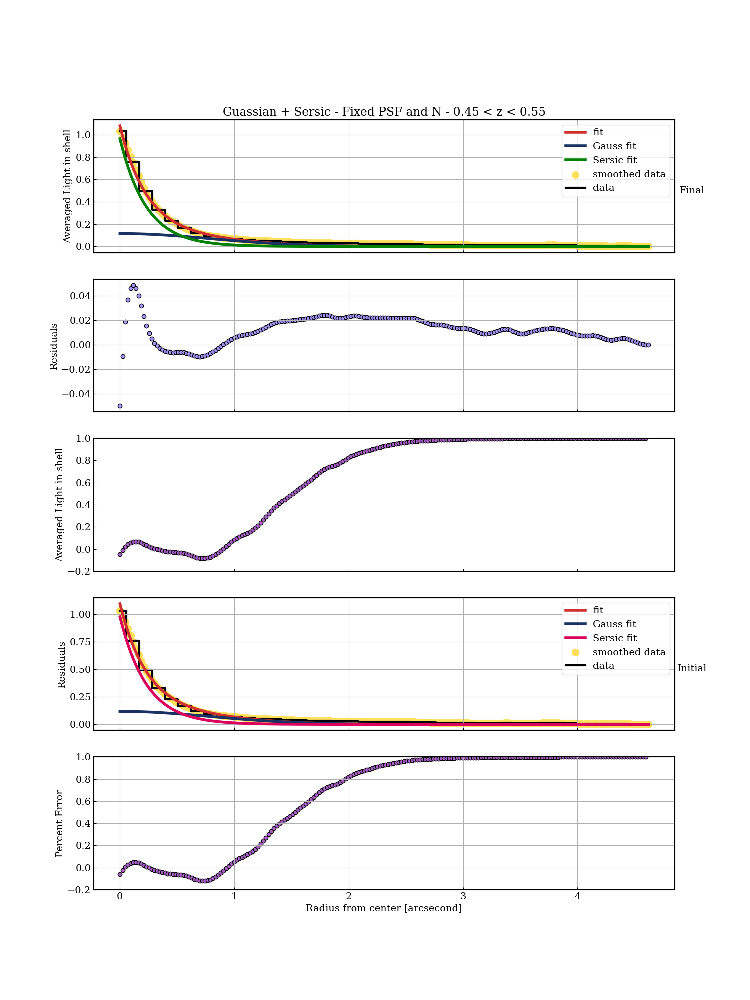

I_e = 0.18226273794099263 +0.003558635435771562 - 0.026886198920064747

R_e = 0.3862287487452818 +0.008382395932997722 - 0.06130977428610679

A = 0.11582421005747723 +0.003468656881883858 - 0.0248241864934505


In [213]:
x_Mirror_Unindexed_Sersic_Fixed_045_055 = np.linspace(0,42,42)

x_data_Mirror_Unindexed_Sersic_Fixed_045_055 = np.multiply(x_Mirror_Unindexed_Sersic_Fixed_045_055, 0.11)

x_new_Mirror_Unindexed_Sersic_Fixed_045_055 = np.linspace(min(x_data_Mirror_Unindexed_Sersic_Fixed_045_055),max(x_data_Mirror_Unindexed_Sersic_Fixed_045_055), 200)

x_data_Mirror_Sersic_Fixed_045_055 = np.multiply(x_Mirror_Unindexed_Sersic_Fixed_045_055, 0.11)

y_data_Mirror_Sersic_Fixed_045_055 = Mirrored_Radius_array_045_055[42:85]

y_new_Mirror_Unindexed_Sersic_Fixed_045_055 = CubicSpline(x_data_Mirror_Unindexed_Sersic_Fixed_045_055, y_data_Mirror_Sersic_Fixed_045_055)

yy_new_Mirror_Unindexed_Sersic_Fixed_045_055 = y_new_Mirror_Unindexed_Sersic_Fixed_045_055(x_new_Mirror_Unindexed_Sersic_Fixed_045_055)

Index_Sersic_Fixed_045_055 = np.where(x_new_Mirror_Unindexed_Sersic_Fixed_045_055 >= 0)[0]


y_err_Mirror_Sersic_Fixed_045_055 = 1.0 #Mirrored_Radius_array_SDE_045_055[0:84]

x_new_Mirror_Sersic_Fixed_045_055 = x_new_Mirror_Unindexed_Sersic_045_055[Index_Sersic_Fixed_045_055]
yy_new_Mirror_Sersic_Fixed_045_055 = yy_new_Mirror_Unindexed_Sersic_045_055[Index_Sersic_Fixed_045_055]

#I_e, R_e, A = [0.18423263 0.39123852 0.11829455]


i_e_Sersic_Fixed_045_055 = 0.18423263
r_e_Sersic_Fixed_045_055 = 0.39123852

a_Sersic_Fixed_045_055 = 0.11829455

initial_Mirror_Sersic_Fixed_045_055 = np.array([i_e_Sersic_Fixed_045_055, r_e_Sersic_Fixed_045_055, a_Sersic_Fixed_045_055]) #I_e,R_e,A


I_e_l_Sersic_Fixed_045_055 = 0
I_e_u_Sersic_Fixed_045_055 = i_e_Sersic_Fixed_045_055 + (0.01*i_e_Sersic_Fixed_045_055)

R_e_l_Sersic_Fixed_045_055 = 0
R_e_u_Sersic_Fixed_045_055 = r_e_Sersic_Fixed_045_055 + (0.01*r_e_Sersic_Fixed_045_055)

a_l_Sersic_Fixed_045_055 = 0
a_u_Sersic_Fixed_045_055 = a_Sersic_Fixed_045_055 + (0.01*a_Sersic_Fixed_045_055)


popt_Sersic_Fixed_045_055, pcov_Sersic_Fixed_045_055 = curve_fit(Sersic_Gauss_Fixed, x_new_Mirror_Sersic_Fixed_045_055, yy_new_Mirror_Sersic_Fixed_045_055, p0=[i_e_Sersic_Fixed_045_055, r_e_Sersic_Fixed_045_055, a_Sersic_Fixed_045_055], bounds=(0, np.inf))


# 2. Define the likelihood function ############################################################################################################################################
def log_likelihood(theta, x, y, yerr):
    i_e_Sersic_Fixed_045_055, r_e_Sersic_Fixed_045_055, a_Sersic_Fixed_045_055 = theta
    model = Sersic_Gauss_Fixed(x, i_e_Sersic_Fixed_045_055, r_e_Sersic_Fixed_045_055, a_Sersic_Fixed_045_055)
    sigma2 = yerr**2
    return -0.5 * np.sum((y - model)**2 / sigma2 + np.log(sigma2))

# 4. Define the prior (optional, but recommended) ############################################################################################################################################
#def log_prior(theta):
#    amp1, wid1, amp2, wid2 = theta
#    if not all(0 < param < 10 for param in [amp1, amp2, wid1, wid2]):
#        return -np.inf
#    return 0.0

def log_prior(theta):
    i_e_Sersic_Fixed_045_055, r_e_Sersic_Fixed_045_055, a_Sersic_Fixed_045_055 = theta
    if (I_e_l_Sersic_Fixed_045_055 < i_e_Sersic_Fixed_045_055 < I_e_u_Sersic_Fixed_045_055 and R_e_l_Sersic_Fixed_045_055 < r_e_Sersic_Fixed_045_055 < R_e_u_Sersic_Fixed_045_055 and a_l_Sersic_Fixed_045_055 < a_Sersic_Fixed_045_055 < a_u_Sersic_Fixed_045_055):
        return 0.0
    return -np.inf

    
# 5. Define the probability function ############################################################################################################################################
def log_probability(theta, x, y, yerr):
    lp = log_prior(theta)
    if not np.isfinite(lp):
        return -np.inf
    return lp + log_likelihood(theta, x, y, yerr)

# 3. Optimization (finding a good starting point) ############################################################################################################################################

bounds_Mirror_Sersic_Fixed_045_055 = [(I_e_l_Sersic_Fixed_045_055, I_e_u_Sersic_Fixed_045_055), (R_e_l_Sersic_Fixed_045_055, R_e_u_Sersic_Fixed_045_055), (a_l_Sersic_Fixed_045_055, a_u_Sersic_Fixed_045_055)] # Parameter bounds for optimization
soln_Mirror_Sersic_Fixed_045_055 = minimize(lambda *args: -log_likelihood(*args), initial_Mirror_Sersic_Fixed_045_055, args=(x_new_Mirror_Sersic_Fixed_045_055, yy_new_Mirror_Sersic_Fixed_045_055, y_err_Mirror_Sersic_Fixed_045_055), bounds=bounds_Mirror_Sersic_Fixed_045_055)

#soln = minimize(lambda *args: -log_likelihood(*args), initial, args=(x_data, y_data, y_err))
pos_Mirror_Sersic_Fixed_045_055 = soln_Mirror_Sersic_Fixed_045_055.x + 1e-4 * np.random.randn(32, len(soln_Mirror_Sersic_Fixed_045_055.x))
nwalkers_Mirror_Sersic_Fixed_045_055, ndim_Mirror_Sersic_Fixed_045_055 = pos_Mirror_Sersic_Fixed_045_055.shape


# 4. MCMC sampling ############################################################################################################################################
sampler_Mirror_Sersic_Fixed_045_055 = emcee.EnsembleSampler(nwalkers_Mirror_Sersic_Fixed_045_055, ndim_Mirror_Sersic_Fixed_045_055, log_probability, args=(x_new_Mirror_Sersic_Fixed_045_055, yy_new_Mirror_Sersic_Fixed_045_055, y_err_Mirror_Sersic_Fixed_045_055))
sampler_Mirror_Sersic_Fixed_045_055.run_mcmc(pos_Mirror_Sersic_Fixed_045_055, 5000, progress=True)

# 5. Analyze results
samples_Mirror_Sersic_Fixed_045_055 = sampler_Mirror_Sersic_Fixed_045_055.get_chain(flat=True)

# 6. Best fit parameters ############################################################################################################################################
best_fit_params_Mirror_Sersic_Fixed_045_055 = []
for i in range(ndim_Mirror_Sersic_Fixed_045_055):
    mcmc_Mirror_Sersic_Fixed_045_055 = np.percentile(samples_Mirror_Sersic_Fixed_045_055[:, i], [68, 95, 99.7])
    best_fit_params_Mirror_Sersic_Fixed_045_055.append(mcmc_Mirror_Sersic_Fixed_045_055[1])

# 10. Error estimation ############################################################################################################################################
errors_Mirror_Sersic_Fixed_045_055 = []
for i in range(ndim_Mirror_Sersic_Fixed_045_055):
     mcmc_Mirror_Sersic_Fixed_045_055 = np.percentile(samples_Mirror_Sersic_Fixed_045_055[:, i], [68, 95, 99.7])
     errors_Mirror_Sersic_Fixed_045_055.append([mcmc_Mirror_Sersic_Fixed_045_055[2]-mcmc_Mirror_Sersic_Fixed_045_055[1],mcmc_Mirror_Sersic_Fixed_045_055[1]-mcmc_Mirror_Sersic_Fixed_045_055[0]])
     
# 11. Getting the RMS Values ###########################################################################################################################################
#RMS_Bins_Mirrored_045_055 = np.arange(-10, 10, 1) # -10-10 bins of size 2
#X_Array_RMS_045_055 = np.arange(-9.5, 10.5, 1) 
#
#
#RMS_Array_045_055 = []
#RMS_Len_Array_045_055 = []
#RMS_Len_Array_Old_045_055 = []
#
#
#for i in RMS_Bins_Mirrored_045_055:
#    #print(np.where(np.logical_and(i < x_new_Mirror_Sersic_045_055, x_new_Mirror_Sersic_045_055 < i+2)))
#    #print(len(x_new_Mirror_Sersic_045_055[np.where(np.logical_and(i < x_new_Mirror_Sersic_045_055, x_new_Mirror_Sersic_045_055 < i+2))]))
#
#    index = np.where(np.logical_and(i < x_new_Mirror_Sersic_045_055, x_new_Mirror_Sersic_045_055 < i+1))[0]
#
#    index_2 = np.where(np.logical_and(i < x_data_Mirror_045_055, x_data_Mirror_045_055 < i+1))[0]
#    
#    values = yy_new_Mirror_Sersic_045_055 - two_gaussian(x_plot_Mirror_045_055, *best_fit_params_Mirror_045_055)
#
#    indexed_values = values[index]
#
#    RMS = np.sqrt( (1/len(indexed_values)) * (np.sum(indexed_values**2)) )
#
#
#    RMS_Array_045_055.append(RMS)
#    RMS_Len_Array_045_055.append(len(index))
#    RMS_Len_Array_Old_045_055.append(len(index_2))
#
#
#
#index_1_045_055 = np.where(np.logical_and(X_Array_RMS_045_055 > (40*0.11), X_Array_RMS_045_055 > 0))[0]
#index_2_045_055 = np.where(np.logical_and(X_Array_RMS_045_055 < -(40*0.11), X_Array_RMS_045_055 < 0))[0]
#index_3_045_055 = np.concatenate((index_2_045_055,index_1_045_055))
#
#Average_RMS_OutBox_045_055 = np.average(np.array(RMS_Array_045_055)[index_1_045_055])
#
#RMS_Array_InBox_045_055 = np.array(RMS_Array_045_055)
#
#RMS_Array_InBox_045_055[index_3_045_055] = Average_RMS_OutBox_045_055
     
# 12. Plot results ############################################################################################################################################

#fig = plt.figure(figsize = (20, 10),  facecolor = "white")
fig1, axes1 = plt.subplots(5, 1, sharex=True, figsize=(15, 20))

print("From Popt --- I_e, R_e, A = " +str(popt_Sersic_Fixed_045_055))

axes1[0].plot(x_new_Mirror_Sersic_Fixed_045_055, Sersic_Gauss_Fixed(x_new_Mirror_Sersic_Fixed_045_055, *best_fit_params_Mirror_Sersic_Fixed_045_055[:3]), color = "#CF3030", linewidth=4.0, label="fit", zorder=10)

axes1[0].plot(x_new_Mirror_Sersic_Fixed_045_055, gaussian_3_Fixed(x_new_Mirror_Sersic_Fixed_045_055, *best_fit_params_Mirror_Sersic_Fixed_045_055[2:3]), color = "#1A3263", linewidth=4.0, label="Gauss fit", zorder=10)
axes1[0].plot(x_new_Mirror_Sersic_Fixed_045_055, sersic_fit_Fixed(x_new_Mirror_Sersic_Fixed_045_055, *best_fit_params_Mirror_Sersic_Fixed_045_055[:2]), color = "green", linewidth=4.0, label="Sersic fit", zorder=10)

axes1[0].scatter(x_new_Mirror_Sersic_Fixed_045_055, yy_new_Mirror_Sersic_Fixed_045_055, color = "#FFE05D", label="smoothed data", s=100)#, linewidth=2.0, label="smoothed data")
axes1[0].step(x_data_Mirror_Sersic_Fixed_045_055, y_data_Mirror_Sersic_Fixed_045_055, color = "black", linewidth=3.0, where="mid", zorder=1, label="data")

axes1[0].legend()

#axes1[0].set_ylim(-0.01, 0.03)
#ax1 = plt.subplot(3,1,2)

axes1[1].scatter(x_new_Mirror_Sersic_Fixed_045_055, yy_new_Mirror_Sersic_Fixed_045_055 - Sersic_Gauss_Fixed(x_new_Mirror_Sersic_Fixed_045_055, *best_fit_params_Mirror_Sersic_Fixed_045_055[:5]), c = "#A294F9", edgecolor="black") 

#ax2 = plt.subplot(3,1,3)
axes1[2].scatter(x_new_Mirror_Sersic_Fixed_045_055, (yy_new_Mirror_Sersic_Fixed_045_055 - Sersic_Gauss_Fixed(x_new_Mirror_Sersic_Fixed_045_055, *best_fit_params_Mirror_Sersic_Fixed_045_055[:5]))/yy_new_Mirror_Sersic_Fixed_045_055, c = "#AA60C8", edgecolor="black") 

axes1[2].set_ylim(-0.2,1.0)
#axes1[2].set_xlim(-0.1,5.0)

axes1[2].grid()
#plt.ylim(-0.001,0.001)

axes1[3].plot(x_new_Mirror_Sersic_Fixed_045_055, Sersic_Gauss_Fixed(x_new_Mirror_Sersic_Fixed_045_055, *popt_Sersic_Fixed_045_055[:3]), color = "#CF3030", linewidth=4.0, label="fit", zorder=10)

axes1[3].plot(x_new_Mirror_Sersic_Fixed_045_055, gaussian_3_Fixed(x_new_Mirror_Sersic_Fixed_045_055, *popt_Sersic_Fixed_045_055[2:3]), color = "#1A3263", linewidth=4.0, label="Gauss fit", zorder=10)
axes1[3].plot(x_new_Mirror_Sersic_Fixed_045_055, sersic_fit_Fixed(x_new_Mirror_Sersic_Fixed_045_055, *popt_Sersic_Fixed_045_055[:2]), color = "#DB005B", linewidth=4.0, label="Sersic fit", zorder=10)

axes1[3].scatter(x_new_Mirror_Sersic_Fixed_045_055, yy_new_Mirror_Sersic_Fixed_045_055, color = "#FFE05D", label="smoothed data", s=100)#, linewidth=2.0, label="smoothed data")
axes1[3].step(x_data_Mirror_Sersic_Fixed_045_055, y_data_Mirror_Sersic_Fixed_045_055, color = "black", linewidth=3.0, where="mid", zorder=1, label="data")

#print(y_data_Mirror_Sersic_045_055) 
axes1[3].legend()


axes1[4].scatter(x_new_Mirror_Sersic_Fixed_045_055, (yy_new_Mirror_Sersic_Fixed_045_055 - Sersic_Gauss_Fixed(x_new_Mirror_Sersic_Fixed_045_055, *popt_Sersic_Fixed_045_055[:5]))/yy_new_Mirror_Sersic_Fixed_045_055, c = "#AA60C8", edgecolor="black") 

axes1[4].set_ylim(-0.2,1.0)
#axes1[4].set_xlim(-0.1,5.0)

axes1[0].set_title("Guassian + Sersic - Fixed PSF and N - 0.45 < z < 0.55")

axes1[4].set_xlabel("Radius from center [arcsecond]")

axes1[0].set_ylabel("Averaged Light in shell")
axes1[1].set_ylabel("Residuals")
axes1[2].set_ylabel("Averaged Light in shell")
axes1[3].set_ylabel("Residuals")
axes1[4].set_ylabel("Percent Error")

ax2 = axes1[0].twinx()
ax2.set_yticks([])
ax2.set_ylabel("Final", rotation=360, labelpad=25)

ax3 = axes1[3].twinx()
ax3.set_yticks([])
ax3.set_ylabel("Initial", rotation=360, labelpad=25)


axes1[0].grid()
axes1[1].grid()
axes1[2].grid()
axes1[3].grid()
axes1[4].grid()

# Show the plot
plt.show(block=False)


# Close the figure
#############################################################################################################################################
I_e_Sersic_045_055 = best_fit_params_Mirror_Sersic_Fixed_045_055[0]
R_e_Sersic_045_055 = best_fit_params_Mirror_Sersic_Fixed_045_055[1]
#############################################################################################################################################
print("I_e = " +str(best_fit_params_Mirror_Sersic_Fixed_045_055[0]) + " +" +str(errors_Mirror_Sersic_Fixed_045_055[0][0]) + " - " +str(errors_Mirror_Sersic_Fixed_045_055[0][1]))
print("")
print("R_e = " +str(best_fit_params_Mirror_Sersic_Fixed_045_055[1]) + " +" +str(errors_Mirror_Sersic_Fixed_045_055[1][0]) + " - " +str(errors_Mirror_Sersic_Fixed_045_055[1][1]))
print("")
print("A = " +str(best_fit_params_Mirror_Sersic_Fixed_045_055[2]) + " +" +str(errors_Mirror_Sersic_Fixed_045_055[2][0]) + " - " +str(errors_Mirror_Sersic_Fixed_045_055[2][1]))



100%|██████████| 5000/5000 [00:08<00:00, 595.96it/s]


From Popt --- I_e, R_e, A = [0.13337711 0.36452338 0.08004544]


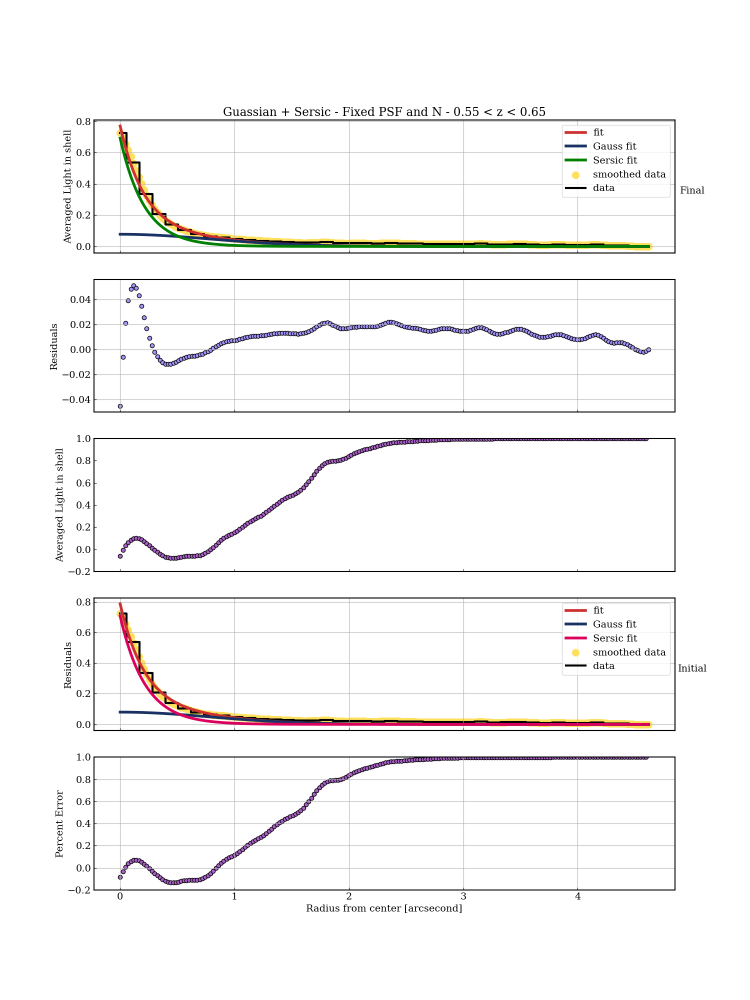

I_e = 0.13083563185292776 +0.0036882061483772544 - 0.02615494422866385

R_e = 0.3571829914632246 +0.010281598070432663 - 0.07669747791096132

A = 0.0780207193167517 +0.002648189617356647 - 0.01895144085059476


In [214]:
x_Mirror_Unindexed_Sersic_Fixed_055_065 = np.linspace(0,42,42)

x_data_Mirror_Unindexed_Sersic_Fixed_055_065 = np.multiply(x_Mirror_Unindexed_Sersic_Fixed_055_065, 0.11)

x_new_Mirror_Unindexed_Sersic_Fixed_055_065 = np.linspace(min(x_data_Mirror_Unindexed_Sersic_Fixed_055_065),max(x_data_Mirror_Unindexed_Sersic_Fixed_055_065), 200)

x_data_Mirror_Sersic_Fixed_055_065 = np.multiply(x_Mirror_Unindexed_Sersic_Fixed_055_065, 0.11)

y_data_Mirror_Sersic_Fixed_055_065 = Mirrored_Radius_array_055_065[42:85]

y_new_Mirror_Unindexed_Sersic_Fixed_055_065 = CubicSpline(x_data_Mirror_Unindexed_Sersic_Fixed_055_065, y_data_Mirror_Sersic_Fixed_055_065)

yy_new_Mirror_Unindexed_Sersic_Fixed_055_065 = y_new_Mirror_Unindexed_Sersic_Fixed_055_065(x_new_Mirror_Unindexed_Sersic_Fixed_055_065)

Index_Sersic_Fixed_055_065 = np.where(x_new_Mirror_Unindexed_Sersic_Fixed_055_065 >= 0)[0]


y_err_Mirror_Sersic_Fixed_055_065 = 1.0 #Mirrored_Radius_array_SDE_055_065[0:84]

x_new_Mirror_Sersic_Fixed_055_065 = x_new_Mirror_Unindexed_Sersic_055_065[Index_Sersic_Fixed_055_065]
yy_new_Mirror_Sersic_Fixed_055_065 = yy_new_Mirror_Unindexed_Sersic_055_065[Index_Sersic_Fixed_055_065]

#I_e, R_e, A = [0.13337712 0.36452537 0.08004444]


i_e_Sersic_Fixed_055_065 = 0.13337712
r_e_Sersic_Fixed_055_065 = 0.36452537

a_Sersic_Fixed_055_065 = 0.08004444

initial_Mirror_Sersic_Fixed_055_065 = np.array([i_e_Sersic_Fixed_055_065, r_e_Sersic_Fixed_055_065, a_Sersic_Fixed_055_065]) #I_e,R_e,A


I_e_l_Sersic_Fixed_055_065 = 0
I_e_u_Sersic_Fixed_055_065 = i_e_Sersic_Fixed_055_065 + (0.01*i_e_Sersic_Fixed_055_065)

R_e_l_Sersic_Fixed_055_065 = 0
R_e_u_Sersic_Fixed_055_065 = r_e_Sersic_Fixed_055_065 + (0.01*r_e_Sersic_Fixed_055_065)

a_l_Sersic_Fixed_055_065 = 0
a_u_Sersic_Fixed_055_065 = a_Sersic_Fixed_055_065 + (0.01*a_Sersic_Fixed_055_065)


popt_Sersic_Fixed_055_065, pcov_Sersic_Fixed_055_065 = curve_fit(Sersic_Gauss_Fixed, x_new_Mirror_Sersic_Fixed_055_065, yy_new_Mirror_Sersic_Fixed_055_065, p0=[i_e_Sersic_Fixed_055_065, r_e_Sersic_Fixed_055_065, a_Sersic_Fixed_055_065], bounds=(0, np.inf))


# 2. Define the likelihood function ############################################################################################################################################
def log_likelihood(theta, x, y, yerr):
    i_e_Sersic_Fixed_055_065, r_e_Sersic_Fixed_055_065, a_Sersic_Fixed_055_065 = theta
    model = Sersic_Gauss_Fixed(x, i_e_Sersic_Fixed_055_065, r_e_Sersic_Fixed_055_065, a_Sersic_Fixed_055_065)
    sigma2 = yerr**2
    return -0.5 * np.sum((y - model)**2 / sigma2 + np.log(sigma2))

# 4. Define the prior (optional, but recommended) ############################################################################################################################################
#def log_prior(theta):
#    amp1, wid1, amp2, wid2 = theta
#    if not all(0 < param < 10 for param in [amp1, amp2, wid1, wid2]):
#        return -np.inf
#    return 0.0

def log_prior(theta):
    i_e_Sersic_Fixed_055_065, r_e_Sersic_Fixed_055_065, a_Sersic_Fixed_055_065 = theta
    if (I_e_l_Sersic_Fixed_055_065 < i_e_Sersic_Fixed_055_065 < I_e_u_Sersic_Fixed_055_065 and R_e_l_Sersic_Fixed_055_065 < r_e_Sersic_Fixed_055_065 < R_e_u_Sersic_Fixed_055_065 and a_l_Sersic_Fixed_055_065 < a_Sersic_Fixed_055_065 < a_u_Sersic_Fixed_055_065):
        return 0.0
    return -np.inf

    
# 5. Define the probability function ############################################################################################################################################
def log_probability(theta, x, y, yerr):
    lp = log_prior(theta)
    if not np.isfinite(lp):
        return -np.inf
    return lp + log_likelihood(theta, x, y, yerr)

# 3. Optimization (finding a good starting point) ############################################################################################################################################

bounds_Mirror_Sersic_Fixed_055_065 = [(I_e_l_Sersic_Fixed_055_065, I_e_u_Sersic_Fixed_055_065), (R_e_l_Sersic_Fixed_055_065, R_e_u_Sersic_Fixed_055_065), (a_l_Sersic_Fixed_055_065, a_u_Sersic_Fixed_055_065)] # Parameter bounds for optimization
soln_Mirror_Sersic_Fixed_055_065 = minimize(lambda *args: -log_likelihood(*args), initial_Mirror_Sersic_Fixed_055_065, args=(x_new_Mirror_Sersic_Fixed_055_065, yy_new_Mirror_Sersic_Fixed_055_065, y_err_Mirror_Sersic_Fixed_055_065), bounds=bounds_Mirror_Sersic_Fixed_055_065)

#soln = minimize(lambda *args: -log_likelihood(*args), initial, args=(x_data, y_data, y_err))
pos_Mirror_Sersic_Fixed_055_065 = soln_Mirror_Sersic_Fixed_055_065.x + 1e-4 * np.random.randn(32, len(soln_Mirror_Sersic_Fixed_055_065.x))
nwalkers_Mirror_Sersic_Fixed_055_065, ndim_Mirror_Sersic_Fixed_055_065 = pos_Mirror_Sersic_Fixed_055_065.shape


# 4. MCMC sampling ############################################################################################################################################
sampler_Mirror_Sersic_Fixed_055_065 = emcee.EnsembleSampler(nwalkers_Mirror_Sersic_Fixed_055_065, ndim_Mirror_Sersic_Fixed_055_065, log_probability, args=(x_new_Mirror_Sersic_Fixed_055_065, yy_new_Mirror_Sersic_Fixed_055_065, y_err_Mirror_Sersic_Fixed_055_065))
sampler_Mirror_Sersic_Fixed_055_065.run_mcmc(pos_Mirror_Sersic_Fixed_055_065, 5000, progress=True)

# 5. Analyze results
samples_Mirror_Sersic_Fixed_055_065 = sampler_Mirror_Sersic_Fixed_055_065.get_chain(flat=True)

# 6. Best fit parameters ############################################################################################################################################
best_fit_params_Mirror_Sersic_Fixed_055_065 = []
for i in range(ndim_Mirror_Sersic_Fixed_055_065):
    mcmc_Mirror_Sersic_Fixed_055_065 = np.percentile(samples_Mirror_Sersic_Fixed_055_065[:, i], [68, 95, 99.7])
    best_fit_params_Mirror_Sersic_Fixed_055_065.append(mcmc_Mirror_Sersic_Fixed_055_065[1])

# 10. Error estimation ############################################################################################################################################
errors_Mirror_Sersic_Fixed_055_065 = []
for i in range(ndim_Mirror_Sersic_Fixed_055_065):
     mcmc_Mirror_Sersic_Fixed_055_065 = np.percentile(samples_Mirror_Sersic_Fixed_055_065[:, i], [68, 95, 99.7])
     errors_Mirror_Sersic_Fixed_055_065.append([mcmc_Mirror_Sersic_Fixed_055_065[2]-mcmc_Mirror_Sersic_Fixed_055_065[1],mcmc_Mirror_Sersic_Fixed_055_065[1]-mcmc_Mirror_Sersic_Fixed_055_065[0]])
     
# 11. Getting the RMS Values ###########################################################################################################################################
#RMS_Bins_Mirrored_055_065 = np.arange(-10, 10, 1) # -10-10 bins of size 2
#X_Array_RMS_055_065 = np.arange(-9.5, 10.5, 1) 
#
#
#RMS_Array_055_065 = []
#RMS_Len_Array_055_065 = []
#RMS_Len_Array_Old_055_065 = []
#
#
#for i in RMS_Bins_Mirrored_055_065:
#    #print(np.where(np.logical_and(i < x_new_Mirror_Sersic_055_065, x_new_Mirror_Sersic_055_065 < i+2)))
#    #print(len(x_new_Mirror_Sersic_055_065[np.where(np.logical_and(i < x_new_Mirror_Sersic_055_065, x_new_Mirror_Sersic_055_065 < i+2))]))
#
#    index = np.where(np.logical_and(i < x_new_Mirror_Sersic_055_065, x_new_Mirror_Sersic_055_065 < i+1))[0]
#
#    index_2 = np.where(np.logical_and(i < x_data_Mirror_055_065, x_data_Mirror_055_065 < i+1))[0]
#    
#    values = yy_new_Mirror_Sersic_055_065 - two_gaussian(x_plot_Mirror_055_065, *best_fit_params_Mirror_055_065)
#
#    indexed_values = values[index]
#
#    RMS = np.sqrt( (1/len(indexed_values)) * (np.sum(indexed_values**2)) )
#
#
#    RMS_Array_055_065.append(RMS)
#    RMS_Len_Array_055_065.append(len(index))
#    RMS_Len_Array_Old_055_065.append(len(index_2))
#
#
#
#index_1_055_065 = np.where(np.logical_and(X_Array_RMS_055_065 > (40*0.11), X_Array_RMS_055_065 > 0))[0]
#index_2_055_065 = np.where(np.logical_and(X_Array_RMS_055_065 < -(40*0.11), X_Array_RMS_055_065 < 0))[0]
#index_3_055_065 = np.concatenate((index_2_055_065,index_1_055_065))
#
#Average_RMS_OutBox_055_065 = np.average(np.array(RMS_Array_055_065)[index_1_055_065])
#
#RMS_Array_InBox_055_065 = np.array(RMS_Array_055_065)
#
#RMS_Array_InBox_055_065[index_3_055_065] = Average_RMS_OutBox_055_065
     
# 12. Plot results ############################################################################################################################################

#fig = plt.figure(figsize = (20, 10),  facecolor = "white")
fig1, axes1 = plt.subplots(5, 1, sharex=True, figsize=(15, 20))

print("From Popt --- I_e, R_e, A = " +str(popt_Sersic_Fixed_055_065))

axes1[0].plot(x_new_Mirror_Sersic_Fixed_055_065, Sersic_Gauss_Fixed(x_new_Mirror_Sersic_Fixed_055_065, *best_fit_params_Mirror_Sersic_Fixed_055_065[:3]), color = "#CF3030", linewidth=4.0, label="fit", zorder=10)

axes1[0].plot(x_new_Mirror_Sersic_Fixed_055_065, gaussian_3_Fixed(x_new_Mirror_Sersic_Fixed_055_065, *best_fit_params_Mirror_Sersic_Fixed_055_065[2:3]), color = "#1A3263", linewidth=4.0, label="Gauss fit", zorder=10)
axes1[0].plot(x_new_Mirror_Sersic_Fixed_055_065, sersic_fit_Fixed(x_new_Mirror_Sersic_Fixed_055_065, *best_fit_params_Mirror_Sersic_Fixed_055_065[:2]), color = "green", linewidth=4.0, label="Sersic fit", zorder=10)

axes1[0].scatter(x_new_Mirror_Sersic_Fixed_055_065, yy_new_Mirror_Sersic_Fixed_055_065, color = "#FFE05D", label="smoothed data", s=100)#, linewidth=2.0, label="smoothed data")
axes1[0].step(x_data_Mirror_Sersic_Fixed_055_065, y_data_Mirror_Sersic_Fixed_055_065, color = "black", linewidth=3.0, where="mid", zorder=1, label="data")

axes1[0].legend()

#axes1[0].set_ylim(-0.01, 0.03)
#ax1 = plt.subplot(3,1,2)

axes1[1].scatter(x_new_Mirror_Sersic_Fixed_055_065, yy_new_Mirror_Sersic_Fixed_055_065 - Sersic_Gauss_Fixed(x_new_Mirror_Sersic_Fixed_055_065, *best_fit_params_Mirror_Sersic_Fixed_055_065[:5]), c = "#A294F9", edgecolor="black") 

#ax2 = plt.subplot(3,1,3)
axes1[2].scatter(x_new_Mirror_Sersic_Fixed_055_065, (yy_new_Mirror_Sersic_Fixed_055_065 - Sersic_Gauss_Fixed(x_new_Mirror_Sersic_Fixed_055_065, *best_fit_params_Mirror_Sersic_Fixed_055_065[:5]))/yy_new_Mirror_Sersic_Fixed_055_065, c = "#AA60C8", edgecolor="black") 

axes1[2].set_ylim(-0.2,1.0)
#axes1[2].set_xlim(-0.1,5.0)

axes1[2].grid()
#plt.ylim(-0.001,0.001)

axes1[3].plot(x_new_Mirror_Sersic_Fixed_055_065, Sersic_Gauss_Fixed(x_new_Mirror_Sersic_Fixed_055_065, *popt_Sersic_Fixed_055_065[:3]), color = "#CF3030", linewidth=4.0, label="fit", zorder=10)

axes1[3].plot(x_new_Mirror_Sersic_Fixed_055_065, gaussian_3_Fixed(x_new_Mirror_Sersic_Fixed_055_065, *popt_Sersic_Fixed_055_065[2:3]), color = "#1A3263", linewidth=4.0, label="Gauss fit", zorder=10)
axes1[3].plot(x_new_Mirror_Sersic_Fixed_055_065, sersic_fit_Fixed(x_new_Mirror_Sersic_Fixed_055_065, *popt_Sersic_Fixed_055_065[:2]), color = "#DB005B", linewidth=4.0, label="Sersic fit", zorder=10)

axes1[3].scatter(x_new_Mirror_Sersic_Fixed_055_065, yy_new_Mirror_Sersic_Fixed_055_065, color = "#FFE05D", label="smoothed data", s=100)#, linewidth=2.0, label="smoothed data")
axes1[3].step(x_data_Mirror_Sersic_Fixed_055_065, y_data_Mirror_Sersic_Fixed_055_065, color = "black", linewidth=3.0, where="mid", zorder=1, label="data")

#print(y_data_Mirror_Sersic_055_065) 
axes1[3].legend()


axes1[4].scatter(x_new_Mirror_Sersic_Fixed_055_065, (yy_new_Mirror_Sersic_Fixed_055_065 - Sersic_Gauss_Fixed(x_new_Mirror_Sersic_Fixed_055_065, *popt_Sersic_Fixed_055_065[:5]))/yy_new_Mirror_Sersic_Fixed_055_065, c = "#AA60C8", edgecolor="black") 

axes1[4].set_ylim(-0.2,1.0)
#axes1[4].set_xlim(-0.1,5.0)

axes1[0].set_title("Guassian + Sersic - Fixed PSF and N - 0.55 < z < 0.65")

axes1[4].set_xlabel("Radius from center [arcsecond]")

axes1[0].set_ylabel("Averaged Light in shell")
axes1[1].set_ylabel("Residuals")
axes1[2].set_ylabel("Averaged Light in shell")
axes1[3].set_ylabel("Residuals")
axes1[4].set_ylabel("Percent Error")

ax2 = axes1[0].twinx()
ax2.set_yticks([])
ax2.set_ylabel("Final", rotation=360, labelpad=25)

ax3 = axes1[3].twinx()
ax3.set_yticks([])
ax3.set_ylabel("Initial", rotation=360, labelpad=25)


axes1[0].grid()
axes1[1].grid()
axes1[2].grid()
axes1[3].grid()
axes1[4].grid()

# Show the plot
plt.show(block=False)


# Close the figure
#############################################################################################################################################
I_e_Sersic_055_065 = best_fit_params_Mirror_Sersic_Fixed_055_065[0]
R_e_Sersic_055_065 = best_fit_params_Mirror_Sersic_Fixed_055_065[1]
#############################################################################################################################################
print("I_e = " +str(best_fit_params_Mirror_Sersic_Fixed_055_065[0]) + " +" +str(errors_Mirror_Sersic_Fixed_055_065[0][0]) + " - " +str(errors_Mirror_Sersic_Fixed_055_065[0][1]))
print("")
print("R_e = " +str(best_fit_params_Mirror_Sersic_Fixed_055_065[1]) + " +" +str(errors_Mirror_Sersic_Fixed_055_065[1][0]) + " - " +str(errors_Mirror_Sersic_Fixed_055_065[1][1]))
print("")
print("A = " +str(best_fit_params_Mirror_Sersic_Fixed_055_065[2]) + " +" +str(errors_Mirror_Sersic_Fixed_055_065[2][0]) + " - " +str(errors_Mirror_Sersic_Fixed_055_065[2][1]))



100%|██████████| 5000/5000 [00:08<00:00, 605.22it/s]


From Popt --- I_e, R_e, A = [0.14092691 0.36574844 0.05887561]


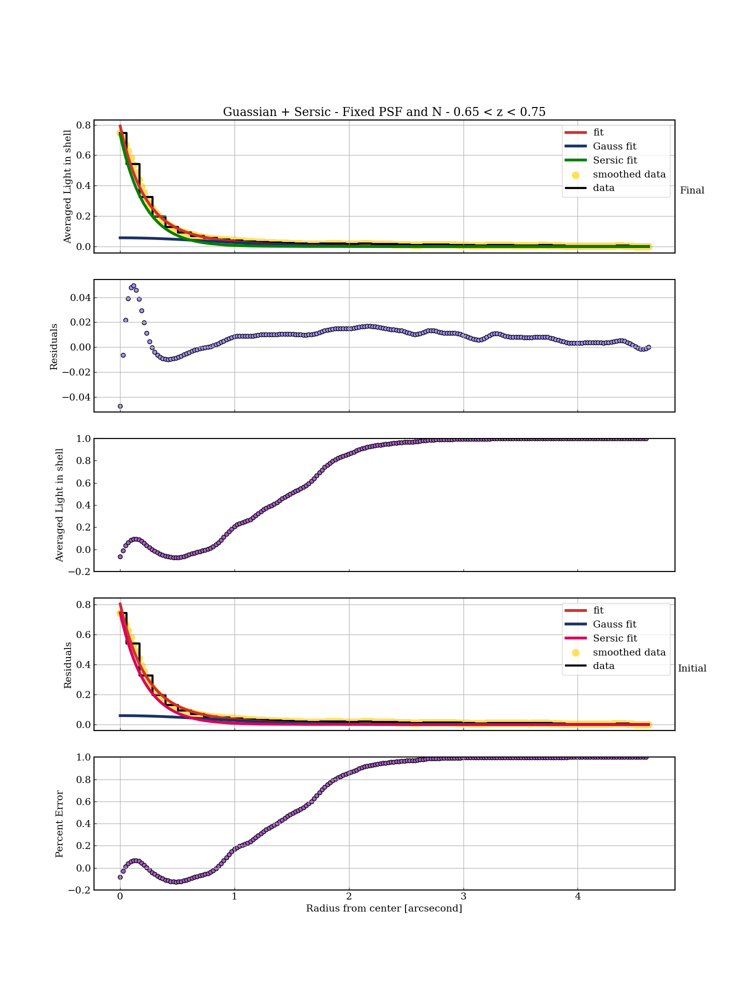

I_e = 0.1387535725234299 +0.0034426373415937517 - 0.024967623571267347

R_e = 0.3590491941841104 +0.009678383867594731 - 0.07267334252478047

A = 0.057131920034007876 +0.002208863384318173 - 0.014900550982958206


In [215]:
x_Mirror_Unindexed_Sersic_Fixed_065_075 = np.linspace(0,42,42)

x_data_Mirror_Unindexed_Sersic_Fixed_065_075 = np.multiply(x_Mirror_Unindexed_Sersic_Fixed_065_075, 0.11)

x_new_Mirror_Unindexed_Sersic_Fixed_065_075 = np.linspace(min(x_data_Mirror_Unindexed_Sersic_Fixed_065_075),max(x_data_Mirror_Unindexed_Sersic_Fixed_065_075), 200)

x_data_Mirror_Sersic_Fixed_065_075 = np.multiply(x_Mirror_Unindexed_Sersic_Fixed_065_075, 0.11)

y_data_Mirror_Sersic_Fixed_065_075 = Mirrored_Radius_array_065_075[42:85]

y_new_Mirror_Unindexed_Sersic_Fixed_065_075 = CubicSpline(x_data_Mirror_Unindexed_Sersic_Fixed_065_075, y_data_Mirror_Sersic_Fixed_065_075)

yy_new_Mirror_Unindexed_Sersic_Fixed_065_075 = y_new_Mirror_Unindexed_Sersic_Fixed_065_075(x_new_Mirror_Unindexed_Sersic_Fixed_065_075)

Index_Sersic_Fixed_065_075 = np.where(x_new_Mirror_Unindexed_Sersic_Fixed_065_075 >= 0)[0]


y_err_Mirror_Sersic_Fixed_065_075 = 1.0 #Mirrored_Radius_array_SDE_065_075[0:84]

x_new_Mirror_Sersic_Fixed_065_075 = x_new_Mirror_Unindexed_Sersic_065_075[Index_Sersic_Fixed_065_075]
yy_new_Mirror_Sersic_Fixed_065_075 = yy_new_Mirror_Unindexed_Sersic_065_075[Index_Sersic_Fixed_065_075]

#I_e, R_e, A = [0.1409269  0.36574641 0.05887668]


i_e_Sersic_Fixed_065_075 = 0.1409269
r_e_Sersic_Fixed_065_075 = 0.36574641

a_Sersic_Fixed_065_075 = 0.05887668

initial_Mirror_Sersic_Fixed_065_075 = np.array([i_e_Sersic_Fixed_065_075, r_e_Sersic_Fixed_065_075, a_Sersic_Fixed_065_075]) #I_e,R_e,A


I_e_l_Sersic_Fixed_065_075 = 0
I_e_u_Sersic_Fixed_065_075 = i_e_Sersic_Fixed_065_075 + (0.01*i_e_Sersic_Fixed_065_075)

R_e_l_Sersic_Fixed_065_075 = 0
R_e_u_Sersic_Fixed_065_075 = r_e_Sersic_Fixed_065_075 + (0.01*r_e_Sersic_Fixed_065_075)

a_l_Sersic_Fixed_065_075 = 0
a_u_Sersic_Fixed_065_075 = a_Sersic_Fixed_065_075 + (0.01*a_Sersic_Fixed_065_075)


popt_Sersic_Fixed_065_075, pcov_Sersic_Fixed_065_075 = curve_fit(Sersic_Gauss_Fixed, x_new_Mirror_Sersic_Fixed_065_075, yy_new_Mirror_Sersic_Fixed_065_075, p0=[i_e_Sersic_Fixed_065_075, r_e_Sersic_Fixed_065_075, a_Sersic_Fixed_065_075], bounds=(0, np.inf))


# 2. Define the likelihood function ############################################################################################################################################
def log_likelihood(theta, x, y, yerr):
    i_e_Sersic_Fixed_065_075, r_e_Sersic_Fixed_065_075, a_Sersic_Fixed_065_075 = theta
    model = Sersic_Gauss_Fixed(x, i_e_Sersic_Fixed_065_075, r_e_Sersic_Fixed_065_075, a_Sersic_Fixed_065_075)
    sigma2 = yerr**2
    return -0.5 * np.sum((y - model)**2 / sigma2 + np.log(sigma2))

# 4. Define the prior (optional, but recommended) ############################################################################################################################################
#def log_prior(theta):
#    amp1, wid1, amp2, wid2 = theta
#    if not all(0 < param < 10 for param in [amp1, amp2, wid1, wid2]):
#        return -np.inf
#    return 0.0

def log_prior(theta):
    i_e_Sersic_Fixed_065_075, r_e_Sersic_Fixed_065_075, a_Sersic_Fixed_065_075 = theta
    if (I_e_l_Sersic_Fixed_065_075 < i_e_Sersic_Fixed_065_075 < I_e_u_Sersic_Fixed_065_075 and R_e_l_Sersic_Fixed_065_075 < r_e_Sersic_Fixed_065_075 < R_e_u_Sersic_Fixed_065_075 and a_l_Sersic_Fixed_065_075 < a_Sersic_Fixed_065_075 < a_u_Sersic_Fixed_065_075):
        return 0.0
    return -np.inf

    
# 5. Define the probability function ############################################################################################################################################
def log_probability(theta, x, y, yerr):
    lp = log_prior(theta)
    if not np.isfinite(lp):
        return -np.inf
    return lp + log_likelihood(theta, x, y, yerr)

# 3. Optimization (finding a good starting point) ############################################################################################################################################

bounds_Mirror_Sersic_Fixed_065_075 = [(I_e_l_Sersic_Fixed_065_075, I_e_u_Sersic_Fixed_065_075), (R_e_l_Sersic_Fixed_065_075, R_e_u_Sersic_Fixed_065_075), (a_l_Sersic_Fixed_065_075, a_u_Sersic_Fixed_065_075)] # Parameter bounds for optimization
soln_Mirror_Sersic_Fixed_065_075 = minimize(lambda *args: -log_likelihood(*args), initial_Mirror_Sersic_Fixed_065_075, args=(x_new_Mirror_Sersic_Fixed_065_075, yy_new_Mirror_Sersic_Fixed_065_075, y_err_Mirror_Sersic_Fixed_065_075), bounds=bounds_Mirror_Sersic_Fixed_065_075)

#soln = minimize(lambda *args: -log_likelihood(*args), initial, args=(x_data, y_data, y_err))
pos_Mirror_Sersic_Fixed_065_075 = soln_Mirror_Sersic_Fixed_065_075.x + 1e-4 * np.random.randn(32, len(soln_Mirror_Sersic_Fixed_065_075.x))
nwalkers_Mirror_Sersic_Fixed_065_075, ndim_Mirror_Sersic_Fixed_065_075 = pos_Mirror_Sersic_Fixed_065_075.shape


# 4. MCMC sampling ############################################################################################################################################
sampler_Mirror_Sersic_Fixed_065_075 = emcee.EnsembleSampler(nwalkers_Mirror_Sersic_Fixed_065_075, ndim_Mirror_Sersic_Fixed_065_075, log_probability, args=(x_new_Mirror_Sersic_Fixed_065_075, yy_new_Mirror_Sersic_Fixed_065_075, y_err_Mirror_Sersic_Fixed_065_075))
sampler_Mirror_Sersic_Fixed_065_075.run_mcmc(pos_Mirror_Sersic_Fixed_065_075, 5000, progress=True)

# 5. Analyze results
samples_Mirror_Sersic_Fixed_065_075 = sampler_Mirror_Sersic_Fixed_065_075.get_chain(flat=True)

# 6. Best fit parameters ############################################################################################################################################
best_fit_params_Mirror_Sersic_Fixed_065_075 = []
for i in range(ndim_Mirror_Sersic_Fixed_065_075):
    mcmc_Mirror_Sersic_Fixed_065_075 = np.percentile(samples_Mirror_Sersic_Fixed_065_075[:, i], [68, 95, 99.7])
    best_fit_params_Mirror_Sersic_Fixed_065_075.append(mcmc_Mirror_Sersic_Fixed_065_075[1])

# 10. Error estimation ############################################################################################################################################
errors_Mirror_Sersic_Fixed_065_075 = []
for i in range(ndim_Mirror_Sersic_Fixed_065_075):
     mcmc_Mirror_Sersic_Fixed_065_075 = np.percentile(samples_Mirror_Sersic_Fixed_065_075[:, i], [68, 95, 99.7])
     errors_Mirror_Sersic_Fixed_065_075.append([mcmc_Mirror_Sersic_Fixed_065_075[2]-mcmc_Mirror_Sersic_Fixed_065_075[1],mcmc_Mirror_Sersic_Fixed_065_075[1]-mcmc_Mirror_Sersic_Fixed_065_075[0]])
     
# 11. Getting the RMS Values ###########################################################################################################################################
#RMS_Bins_Mirrored_065_075 = np.arange(-10, 10, 1) # -10-10 bins of size 2
#X_Array_RMS_065_075 = np.arange(-9.5, 10.5, 1) 
#
#
#RMS_Array_065_075 = []
#RMS_Len_Array_065_075 = []
#RMS_Len_Array_Old_065_075 = []
#
#
#for i in RMS_Bins_Mirrored_065_075:
#    #print(np.where(np.logical_and(i < x_new_Mirror_Sersic_065_075, x_new_Mirror_Sersic_065_075 < i+2)))
#    #print(len(x_new_Mirror_Sersic_065_075[np.where(np.logical_and(i < x_new_Mirror_Sersic_065_075, x_new_Mirror_Sersic_065_075 < i+2))]))
#
#    index = np.where(np.logical_and(i < x_new_Mirror_Sersic_065_075, x_new_Mirror_Sersic_065_075 < i+1))[0]
#
#    index_2 = np.where(np.logical_and(i < x_data_Mirror_065_075, x_data_Mirror_065_075 < i+1))[0]
#    
#    values = yy_new_Mirror_Sersic_065_075 - two_gaussian(x_plot_Mirror_065_075, *best_fit_params_Mirror_065_075)
#
#    indexed_values = values[index]
#
#    RMS = np.sqrt( (1/len(indexed_values)) * (np.sum(indexed_values**2)) )
#
#
#    RMS_Array_065_075.append(RMS)
#    RMS_Len_Array_065_075.append(len(index))
#    RMS_Len_Array_Old_065_075.append(len(index_2))
#
#
#
#index_1_065_075 = np.where(np.logical_and(X_Array_RMS_065_075 > (40*0.11), X_Array_RMS_065_075 > 0))[0]
#index_2_065_075 = np.where(np.logical_and(X_Array_RMS_065_075 < -(40*0.11), X_Array_RMS_065_075 < 0))[0]
#index_3_065_075 = np.concatenate((index_2_065_075,index_1_065_075))
#
#Average_RMS_OutBox_065_075 = np.average(np.array(RMS_Array_065_075)[index_1_065_075])
#
#RMS_Array_InBox_065_075 = np.array(RMS_Array_065_075)
#
#RMS_Array_InBox_065_075[index_3_065_075] = Average_RMS_OutBox_065_075
     
# 12. Plot results ############################################################################################################################################

#fig = plt.figure(figsize = (20, 10),  facecolor = "white")
fig1, axes1 = plt.subplots(5, 1, sharex=True, figsize=(15, 20))

print("From Popt --- I_e, R_e, A = " +str(popt_Sersic_Fixed_065_075))

axes1[0].plot(x_new_Mirror_Sersic_Fixed_065_075, Sersic_Gauss_Fixed(x_new_Mirror_Sersic_Fixed_065_075, *best_fit_params_Mirror_Sersic_Fixed_065_075[:3]), color = "#CF3030", linewidth=4.0, label="fit", zorder=10)

axes1[0].plot(x_new_Mirror_Sersic_Fixed_065_075, gaussian_3_Fixed(x_new_Mirror_Sersic_Fixed_065_075, *best_fit_params_Mirror_Sersic_Fixed_065_075[2:3]), color = "#1A3263", linewidth=4.0, label="Gauss fit", zorder=10)
axes1[0].plot(x_new_Mirror_Sersic_Fixed_065_075, sersic_fit_Fixed(x_new_Mirror_Sersic_Fixed_065_075, *best_fit_params_Mirror_Sersic_Fixed_065_075[:2]), color = "green", linewidth=4.0, label="Sersic fit", zorder=10)

axes1[0].scatter(x_new_Mirror_Sersic_Fixed_065_075, yy_new_Mirror_Sersic_Fixed_065_075, color = "#FFE05D", label="smoothed data", s=100)#, linewidth=2.0, label="smoothed data")
axes1[0].step(x_data_Mirror_Sersic_Fixed_065_075, y_data_Mirror_Sersic_Fixed_065_075, color = "black", linewidth=3.0, where="mid", zorder=1, label="data")

axes1[0].legend()

#axes1[0].set_ylim(-0.01, 0.03)
#ax1 = plt.subplot(3,1,2)

axes1[1].scatter(x_new_Mirror_Sersic_Fixed_065_075, yy_new_Mirror_Sersic_Fixed_065_075 - Sersic_Gauss_Fixed(x_new_Mirror_Sersic_Fixed_065_075, *best_fit_params_Mirror_Sersic_Fixed_065_075[:5]), c = "#A294F9", edgecolor="black") 

#ax2 = plt.subplot(3,1,3)
axes1[2].scatter(x_new_Mirror_Sersic_Fixed_065_075, (yy_new_Mirror_Sersic_Fixed_065_075 - Sersic_Gauss_Fixed(x_new_Mirror_Sersic_Fixed_065_075, *best_fit_params_Mirror_Sersic_Fixed_065_075[:5]))/yy_new_Mirror_Sersic_Fixed_065_075, c = "#AA60C8", edgecolor="black") 

axes1[2].set_ylim(-0.2,1.0)
#axes1[2].set_xlim(-0.1,5.0)

axes1[2].grid()
#plt.ylim(-0.001,0.001)

axes1[3].plot(x_new_Mirror_Sersic_Fixed_065_075, Sersic_Gauss_Fixed(x_new_Mirror_Sersic_Fixed_065_075, *popt_Sersic_Fixed_065_075[:3]), color = "#CF3030", linewidth=4.0, label="fit", zorder=10)

axes1[3].plot(x_new_Mirror_Sersic_Fixed_065_075, gaussian_3_Fixed(x_new_Mirror_Sersic_Fixed_065_075, *popt_Sersic_Fixed_065_075[2:3]), color = "#1A3263", linewidth=4.0, label="Gauss fit", zorder=10)
axes1[3].plot(x_new_Mirror_Sersic_Fixed_065_075, sersic_fit_Fixed(x_new_Mirror_Sersic_Fixed_065_075, *popt_Sersic_Fixed_065_075[:2]), color = "#DB005B", linewidth=4.0, label="Sersic fit", zorder=10)

axes1[3].scatter(x_new_Mirror_Sersic_Fixed_065_075, yy_new_Mirror_Sersic_Fixed_065_075, color = "#FFE05D", label="smoothed data", s=100)#, linewidth=2.0, label="smoothed data")
axes1[3].step(x_data_Mirror_Sersic_Fixed_065_075, y_data_Mirror_Sersic_Fixed_065_075, color = "black", linewidth=3.0, where="mid", zorder=1, label="data")

#print(y_data_Mirror_Sersic_065_075) 
axes1[3].legend()


axes1[4].scatter(x_new_Mirror_Sersic_Fixed_065_075, (yy_new_Mirror_Sersic_Fixed_065_075 - Sersic_Gauss_Fixed(x_new_Mirror_Sersic_Fixed_065_075, *popt_Sersic_Fixed_065_075[:5]))/yy_new_Mirror_Sersic_Fixed_065_075, c = "#AA60C8", edgecolor="black") 

axes1[4].set_ylim(-0.2,1.0)
#axes1[4].set_xlim(-0.1,5.0)

axes1[0].set_title("Guassian + Sersic - Fixed PSF and N - 0.65 < z < 0.75")

axes1[4].set_xlabel("Radius from center [arcsecond]")

axes1[0].set_ylabel("Averaged Light in shell")
axes1[1].set_ylabel("Residuals")
axes1[2].set_ylabel("Averaged Light in shell")
axes1[3].set_ylabel("Residuals")
axes1[4].set_ylabel("Percent Error")

ax2 = axes1[0].twinx()
ax2.set_yticks([])
ax2.set_ylabel("Final", rotation=360, labelpad=25)

ax3 = axes1[3].twinx()
ax3.set_yticks([])
ax3.set_ylabel("Initial", rotation=360, labelpad=25)


axes1[0].grid()
axes1[1].grid()
axes1[2].grid()
axes1[3].grid()
axes1[4].grid()

# Show the plot
plt.show(block=False)


# Close the figure
#############################################################################################################################################
I_e_Sersic_065_075 = best_fit_params_Mirror_Sersic_Fixed_065_075[0]
R_e_Sersic_065_075 = best_fit_params_Mirror_Sersic_Fixed_065_075[1]
#############################################################################################################################################
print("I_e = " +str(best_fit_params_Mirror_Sersic_Fixed_065_075[0]) + " +" +str(errors_Mirror_Sersic_Fixed_065_075[0][0]) + " - " +str(errors_Mirror_Sersic_Fixed_065_075[0][1]))
print("")
print("R_e = " +str(best_fit_params_Mirror_Sersic_Fixed_065_075[1]) + " +" +str(errors_Mirror_Sersic_Fixed_065_075[1][0]) + " - " +str(errors_Mirror_Sersic_Fixed_065_075[1][1]))
print("")
print("A = " +str(best_fit_params_Mirror_Sersic_Fixed_065_075[2]) + " +" +str(errors_Mirror_Sersic_Fixed_065_075[2][0]) + " - " +str(errors_Mirror_Sersic_Fixed_065_075[2][1]))



100%|██████████| 5000/5000 [00:08<00:00, 608.85it/s]


From Popt --- I_e, R_e, A = [0.14091621 0.34510827 0.04923404]


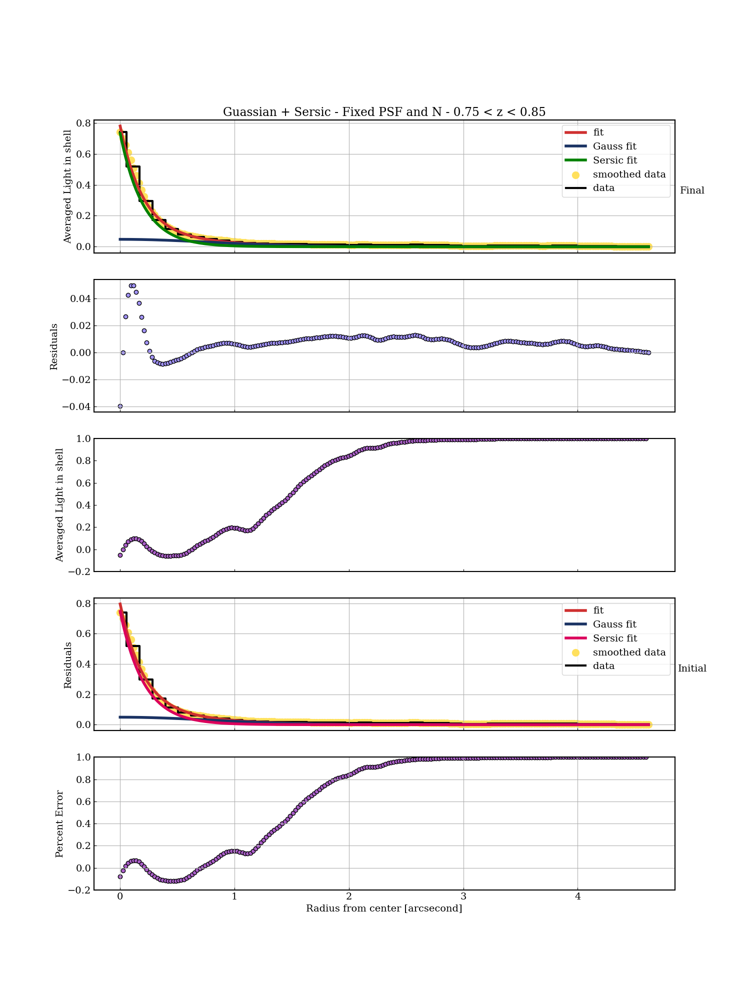

I_e = 0.13811535945578318 +0.003940370806615023 - 0.02719547779874161

R_e = 0.3379550244765234 +0.009969276586896891 - 0.0699349703179839

A = 0.04780848150253747 +0.001826971121476506 - 0.01225459871473028


In [216]:
x_Mirror_Unindexed_Sersic_Fixed_075_085 = np.linspace(0,42,42)

x_data_Mirror_Unindexed_Sersic_Fixed_075_085 = np.multiply(x_Mirror_Unindexed_Sersic_Fixed_075_085, 0.11)

x_new_Mirror_Unindexed_Sersic_Fixed_075_085 = np.linspace(min(x_data_Mirror_Unindexed_Sersic_Fixed_075_085),max(x_data_Mirror_Unindexed_Sersic_Fixed_075_085), 200)

x_data_Mirror_Sersic_Fixed_075_085 = np.multiply(x_Mirror_Unindexed_Sersic_Fixed_075_085, 0.11)

y_data_Mirror_Sersic_Fixed_075_085 = Mirrored_Radius_array_075_085[42:85]

y_new_Mirror_Unindexed_Sersic_Fixed_075_085 = CubicSpline(x_data_Mirror_Unindexed_Sersic_Fixed_075_085, y_data_Mirror_Sersic_Fixed_075_085)

yy_new_Mirror_Unindexed_Sersic_Fixed_075_085 = y_new_Mirror_Unindexed_Sersic_Fixed_075_085(x_new_Mirror_Unindexed_Sersic_Fixed_075_085)

Index_Sersic_Fixed_075_085 = np.where(x_new_Mirror_Unindexed_Sersic_Fixed_075_085 >= 0)[0]


y_err_Mirror_Sersic_Fixed_075_085 = 1.0 #Mirrored_Radius_array_SDE_075_085[0:84]

x_new_Mirror_Sersic_Fixed_075_085 = x_new_Mirror_Unindexed_Sersic_075_085[Index_Sersic_Fixed_075_085]
yy_new_Mirror_Sersic_Fixed_075_085 = yy_new_Mirror_Unindexed_Sersic_075_085[Index_Sersic_Fixed_075_085]

#I_e, R_e, A = [0.14091622 0.34510751 0.04923444]


i_e_Sersic_Fixed_075_085 = 0.14091622
r_e_Sersic_Fixed_075_085 = 0.34510751

a_Sersic_Fixed_075_085 = 0.04923444

initial_Mirror_Sersic_Fixed_075_085 = np.array([i_e_Sersic_Fixed_075_085, r_e_Sersic_Fixed_075_085, a_Sersic_Fixed_075_085]) #I_e,R_e,A


I_e_l_Sersic_Fixed_075_085 = 0
I_e_u_Sersic_Fixed_075_085 = i_e_Sersic_Fixed_075_085 + (0.01*i_e_Sersic_Fixed_075_085)

R_e_l_Sersic_Fixed_075_085 = 0
R_e_u_Sersic_Fixed_075_085 = r_e_Sersic_Fixed_075_085 + (0.01*r_e_Sersic_Fixed_075_085)

a_l_Sersic_Fixed_075_085 = 0
a_u_Sersic_Fixed_075_085 = a_Sersic_Fixed_075_085 + (0.01*a_Sersic_Fixed_075_085)


popt_Sersic_Fixed_075_085, pcov_Sersic_Fixed_075_085 = curve_fit(Sersic_Gauss_Fixed, x_new_Mirror_Sersic_Fixed_075_085, yy_new_Mirror_Sersic_Fixed_075_085, p0=[i_e_Sersic_Fixed_075_085, r_e_Sersic_Fixed_075_085, a_Sersic_Fixed_075_085], bounds=(0, np.inf))


# 2. Define the likelihood function ############################################################################################################################################
def log_likelihood(theta, x, y, yerr):
    i_e_Sersic_Fixed_075_085, r_e_Sersic_Fixed_075_085, a_Sersic_Fixed_075_085 = theta
    model = Sersic_Gauss_Fixed(x, i_e_Sersic_Fixed_075_085, r_e_Sersic_Fixed_075_085, a_Sersic_Fixed_075_085)
    sigma2 = yerr**2
    return -0.5 * np.sum((y - model)**2 / sigma2 + np.log(sigma2))

# 4. Define the prior (optional, but recommended) ############################################################################################################################################
#def log_prior(theta):
#    amp1, wid1, amp2, wid2 = theta
#    if not all(0 < param < 10 for param in [amp1, amp2, wid1, wid2]):
#        return -np.inf
#    return 0.0

def log_prior(theta):
    i_e_Sersic_Fixed_075_085, r_e_Sersic_Fixed_075_085, a_Sersic_Fixed_075_085 = theta
    if (I_e_l_Sersic_Fixed_075_085 < i_e_Sersic_Fixed_075_085 < I_e_u_Sersic_Fixed_075_085 and R_e_l_Sersic_Fixed_075_085 < r_e_Sersic_Fixed_075_085 < R_e_u_Sersic_Fixed_075_085 and a_l_Sersic_Fixed_075_085 < a_Sersic_Fixed_075_085 < a_u_Sersic_Fixed_075_085):
        return 0.0
    return -np.inf

    
# 5. Define the probability function ############################################################################################################################################
def log_probability(theta, x, y, yerr):
    lp = log_prior(theta)
    if not np.isfinite(lp):
        return -np.inf
    return lp + log_likelihood(theta, x, y, yerr)

# 3. Optimization (finding a good starting point) ############################################################################################################################################

bounds_Mirror_Sersic_Fixed_075_085 = [(I_e_l_Sersic_Fixed_075_085, I_e_u_Sersic_Fixed_075_085), (R_e_l_Sersic_Fixed_075_085, R_e_u_Sersic_Fixed_075_085), (a_l_Sersic_Fixed_075_085, a_u_Sersic_Fixed_075_085)] # Parameter bounds for optimization
soln_Mirror_Sersic_Fixed_075_085 = minimize(lambda *args: -log_likelihood(*args), initial_Mirror_Sersic_Fixed_075_085, args=(x_new_Mirror_Sersic_Fixed_075_085, yy_new_Mirror_Sersic_Fixed_075_085, y_err_Mirror_Sersic_Fixed_075_085), bounds=bounds_Mirror_Sersic_Fixed_075_085)

#soln = minimize(lambda *args: -log_likelihood(*args), initial, args=(x_data, y_data, y_err))
pos_Mirror_Sersic_Fixed_075_085 = soln_Mirror_Sersic_Fixed_075_085.x + 1e-4 * np.random.randn(32, len(soln_Mirror_Sersic_Fixed_075_085.x))
nwalkers_Mirror_Sersic_Fixed_075_085, ndim_Mirror_Sersic_Fixed_075_085 = pos_Mirror_Sersic_Fixed_075_085.shape


# 4. MCMC sampling ############################################################################################################################################
sampler_Mirror_Sersic_Fixed_075_085 = emcee.EnsembleSampler(nwalkers_Mirror_Sersic_Fixed_075_085, ndim_Mirror_Sersic_Fixed_075_085, log_probability, args=(x_new_Mirror_Sersic_Fixed_075_085, yy_new_Mirror_Sersic_Fixed_075_085, y_err_Mirror_Sersic_Fixed_075_085))
sampler_Mirror_Sersic_Fixed_075_085.run_mcmc(pos_Mirror_Sersic_Fixed_075_085, 5000, progress=True)

# 5. Analyze results
samples_Mirror_Sersic_Fixed_075_085 = sampler_Mirror_Sersic_Fixed_075_085.get_chain(flat=True)

# 6. Best fit parameters ############################################################################################################################################
best_fit_params_Mirror_Sersic_Fixed_075_085 = []
for i in range(ndim_Mirror_Sersic_Fixed_075_085):
    mcmc_Mirror_Sersic_Fixed_075_085 = np.percentile(samples_Mirror_Sersic_Fixed_075_085[:, i], [68, 95, 99.7])
    best_fit_params_Mirror_Sersic_Fixed_075_085.append(mcmc_Mirror_Sersic_Fixed_075_085[1])

# 10. Error estimation ############################################################################################################################################
errors_Mirror_Sersic_Fixed_075_085 = []
for i in range(ndim_Mirror_Sersic_Fixed_075_085):
     mcmc_Mirror_Sersic_Fixed_075_085 = np.percentile(samples_Mirror_Sersic_Fixed_075_085[:, i], [68, 95, 99.7])
     errors_Mirror_Sersic_Fixed_075_085.append([mcmc_Mirror_Sersic_Fixed_075_085[2]-mcmc_Mirror_Sersic_Fixed_075_085[1],mcmc_Mirror_Sersic_Fixed_075_085[1]-mcmc_Mirror_Sersic_Fixed_075_085[0]])
     
# 11. Getting the RMS Values ###########################################################################################################################################
#RMS_Bins_Mirrored_075_085 = np.arange(-10, 10, 1) # -10-10 bins of size 2
#X_Array_RMS_075_085 = np.arange(-9.5, 10.5, 1) 
#
#
#RMS_Array_075_085 = []
#RMS_Len_Array_075_085 = []
#RMS_Len_Array_Old_075_085 = []
#
#
#for i in RMS_Bins_Mirrored_075_085:
#    #print(np.where(np.logical_and(i < x_new_Mirror_Sersic_075_085, x_new_Mirror_Sersic_075_085 < i+2)))
#    #print(len(x_new_Mirror_Sersic_075_085[np.where(np.logical_and(i < x_new_Mirror_Sersic_075_085, x_new_Mirror_Sersic_075_085 < i+2))]))
#
#    index = np.where(np.logical_and(i < x_new_Mirror_Sersic_075_085, x_new_Mirror_Sersic_075_085 < i+1))[0]
#
#    index_2 = np.where(np.logical_and(i < x_data_Mirror_075_085, x_data_Mirror_075_085 < i+1))[0]
#    
#    values = yy_new_Mirror_Sersic_075_085 - two_gaussian(x_plot_Mirror_075_085, *best_fit_params_Mirror_075_085)
#
#    indexed_values = values[index]
#
#    RMS = np.sqrt( (1/len(indexed_values)) * (np.sum(indexed_values**2)) )
#
#
#    RMS_Array_075_085.append(RMS)
#    RMS_Len_Array_075_085.append(len(index))
#    RMS_Len_Array_Old_075_085.append(len(index_2))
#
#
#
#index_1_075_085 = np.where(np.logical_and(X_Array_RMS_075_085 > (40*0.11), X_Array_RMS_075_085 > 0))[0]
#index_2_075_085 = np.where(np.logical_and(X_Array_RMS_075_085 < -(40*0.11), X_Array_RMS_075_085 < 0))[0]
#index_3_075_085 = np.concatenate((index_2_075_085,index_1_075_085))
#
#Average_RMS_OutBox_075_085 = np.average(np.array(RMS_Array_075_085)[index_1_075_085])
#
#RMS_Array_InBox_075_085 = np.array(RMS_Array_075_085)
#
#RMS_Array_InBox_075_085[index_3_075_085] = Average_RMS_OutBox_075_085
     
# 12. Plot results ############################################################################################################################################

#fig = plt.figure(figsize = (20, 10),  facecolor = "white")
fig1, axes1 = plt.subplots(5, 1, sharex=True, figsize=(15, 20))

print("From Popt --- I_e, R_e, A = " +str(popt_Sersic_Fixed_075_085))

axes1[0].plot(x_new_Mirror_Sersic_Fixed_075_085, Sersic_Gauss_Fixed(x_new_Mirror_Sersic_Fixed_075_085, *best_fit_params_Mirror_Sersic_Fixed_075_085[:3]), color = "#CF3030", linewidth=4.0, label="fit", zorder=10)

axes1[0].plot(x_new_Mirror_Sersic_Fixed_075_085, gaussian_3_Fixed(x_new_Mirror_Sersic_Fixed_075_085, *best_fit_params_Mirror_Sersic_Fixed_075_085[2:3]), color = "#1A3263", linewidth=4.0, label="Gauss fit", zorder=10)
axes1[0].plot(x_new_Mirror_Sersic_Fixed_075_085, sersic_fit_Fixed(x_new_Mirror_Sersic_Fixed_075_085, *best_fit_params_Mirror_Sersic_Fixed_075_085[:2]), color = "green", linewidth=4.0, label="Sersic fit", zorder=10)

axes1[0].scatter(x_new_Mirror_Sersic_Fixed_075_085, yy_new_Mirror_Sersic_Fixed_075_085, color = "#FFE05D", label="smoothed data", s=100)#, linewidth=2.0, label="smoothed data")
axes1[0].step(x_data_Mirror_Sersic_Fixed_075_085, y_data_Mirror_Sersic_Fixed_075_085, color = "black", linewidth=3.0, where="mid", zorder=1, label="data")

axes1[0].legend()

#axes1[0].set_ylim(-0.01, 0.03)
#ax1 = plt.subplot(3,1,2)

axes1[1].scatter(x_new_Mirror_Sersic_Fixed_075_085, yy_new_Mirror_Sersic_Fixed_075_085 - Sersic_Gauss_Fixed(x_new_Mirror_Sersic_Fixed_075_085, *best_fit_params_Mirror_Sersic_Fixed_075_085[:5]), c = "#A294F9", edgecolor="black") 

#ax2 = plt.subplot(3,1,3)
axes1[2].scatter(x_new_Mirror_Sersic_Fixed_075_085, (yy_new_Mirror_Sersic_Fixed_075_085 - Sersic_Gauss_Fixed(x_new_Mirror_Sersic_Fixed_075_085, *best_fit_params_Mirror_Sersic_Fixed_075_085[:5]))/yy_new_Mirror_Sersic_Fixed_075_085, c = "#AA60C8", edgecolor="black") 

axes1[2].set_ylim(-0.2,1.0)
#axes1[2].set_xlim(-0.1,5.0)

axes1[2].grid()
#plt.ylim(-0.001,0.001)

axes1[3].plot(x_new_Mirror_Sersic_Fixed_075_085, Sersic_Gauss_Fixed(x_new_Mirror_Sersic_Fixed_075_085, *popt_Sersic_Fixed_075_085[:3]), color = "#CF3030", linewidth=4.0, label="fit", zorder=10)

axes1[3].plot(x_new_Mirror_Sersic_Fixed_075_085, gaussian_3_Fixed(x_new_Mirror_Sersic_Fixed_075_085, *popt_Sersic_Fixed_075_085[2:3]), color = "#1A3263", linewidth=4.0, label="Gauss fit", zorder=10)
axes1[3].plot(x_new_Mirror_Sersic_Fixed_075_085, sersic_fit_Fixed(x_new_Mirror_Sersic_Fixed_075_085, *popt_Sersic_Fixed_075_085[:2]), color = "#DB005B", linewidth=4.0, label="Sersic fit", zorder=10)

axes1[3].scatter(x_new_Mirror_Sersic_Fixed_075_085, yy_new_Mirror_Sersic_Fixed_075_085, color = "#FFE05D", label="smoothed data", s=100)#, linewidth=2.0, label="smoothed data")
axes1[3].step(x_data_Mirror_Sersic_Fixed_075_085, y_data_Mirror_Sersic_Fixed_075_085, color = "black", linewidth=3.0, where="mid", zorder=1, label="data")

#print(y_data_Mirror_Sersic_075_085) 
axes1[3].legend()


axes1[4].scatter(x_new_Mirror_Sersic_Fixed_075_085, (yy_new_Mirror_Sersic_Fixed_075_085 - Sersic_Gauss_Fixed(x_new_Mirror_Sersic_Fixed_075_085, *popt_Sersic_Fixed_075_085[:5]))/yy_new_Mirror_Sersic_Fixed_075_085, c = "#AA60C8", edgecolor="black") 

axes1[4].set_ylim(-0.2,1.0)
#axes1[4].set_xlim(-0.1,5.0)

axes1[0].set_title("Guassian + Sersic - Fixed PSF and N - 0.75 < z < 0.85")

axes1[4].set_xlabel("Radius from center [arcsecond]")

axes1[0].set_ylabel("Averaged Light in shell")
axes1[1].set_ylabel("Residuals")
axes1[2].set_ylabel("Averaged Light in shell")
axes1[3].set_ylabel("Residuals")
axes1[4].set_ylabel("Percent Error")

ax2 = axes1[0].twinx()
ax2.set_yticks([])
ax2.set_ylabel("Final", rotation=360, labelpad=25)

ax3 = axes1[3].twinx()
ax3.set_yticks([])
ax3.set_ylabel("Initial", rotation=360, labelpad=25)


axes1[0].grid()
axes1[1].grid()
axes1[2].grid()
axes1[3].grid()
axes1[4].grid()

# Show the plot
plt.show(block=False)


# Close the figure
#############################################################################################################################################
I_e_Sersic_075_085 = best_fit_params_Mirror_Sersic_Fixed_075_085[0]
R_e_Sersic_075_085 = best_fit_params_Mirror_Sersic_Fixed_075_085[1]
#############################################################################################################################################
print("I_e = " +str(best_fit_params_Mirror_Sersic_Fixed_075_085[0]) + " +" +str(errors_Mirror_Sersic_Fixed_075_085[0][0]) + " - " +str(errors_Mirror_Sersic_Fixed_075_085[0][1]))
print("")
print("R_e = " +str(best_fit_params_Mirror_Sersic_Fixed_075_085[1]) + " +" +str(errors_Mirror_Sersic_Fixed_075_085[1][0]) + " - " +str(errors_Mirror_Sersic_Fixed_075_085[1][1]))
print("")
print("A = " +str(best_fit_params_Mirror_Sersic_Fixed_075_085[2]) + " +" +str(errors_Mirror_Sersic_Fixed_075_085[2][0]) + " - " +str(errors_Mirror_Sersic_Fixed_075_085[2][1]))



100%|██████████| 5000/5000 [00:08<00:00, 603.50it/s]


From Popt --- I_e, R_e, A = [0.13338016 0.34812308 0.04399631]


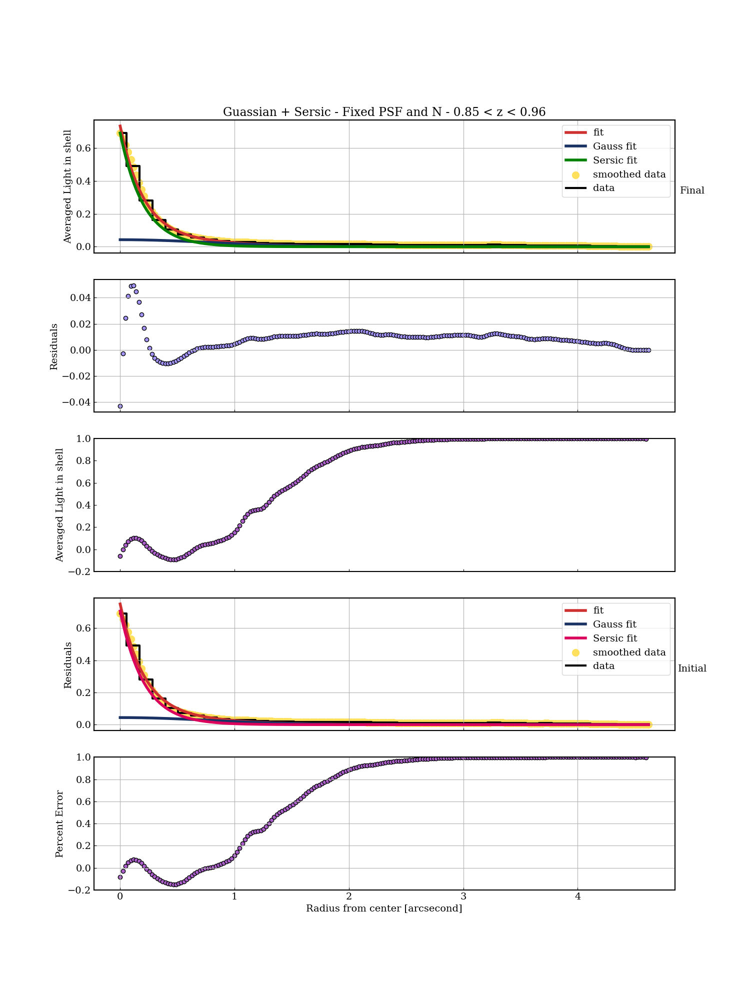

I_e = 0.13074730737467344 +0.003768259841739563 - 0.02708133331480299

R_e = 0.3417791428451876 +0.00916982409109568 - 0.07175821911101588

A = 0.042753614979231594 +0.0015895247803929605 - 0.010815950104032024


In [217]:
x_Mirror_Unindexed_Sersic_Fixed_085_096 = np.linspace(0,42,42)

x_data_Mirror_Unindexed_Sersic_Fixed_085_096 = np.multiply(x_Mirror_Unindexed_Sersic_Fixed_085_096, 0.11)

x_new_Mirror_Unindexed_Sersic_Fixed_085_096 = np.linspace(min(x_data_Mirror_Unindexed_Sersic_Fixed_085_096),max(x_data_Mirror_Unindexed_Sersic_Fixed_085_096), 200)

x_data_Mirror_Sersic_Fixed_085_096 = np.multiply(x_Mirror_Unindexed_Sersic_Fixed_085_096, 0.11)

y_data_Mirror_Sersic_Fixed_085_096 = Mirrored_Radius_array_085_096[42:85]

y_new_Mirror_Unindexed_Sersic_Fixed_085_096 = CubicSpline(x_data_Mirror_Unindexed_Sersic_Fixed_085_096, y_data_Mirror_Sersic_Fixed_085_096)

yy_new_Mirror_Unindexed_Sersic_Fixed_085_096 = y_new_Mirror_Unindexed_Sersic_Fixed_085_096(x_new_Mirror_Unindexed_Sersic_Fixed_085_096)

Index_Sersic_Fixed_085_096 = np.where(x_new_Mirror_Unindexed_Sersic_Fixed_085_096 >= 0)[0]


y_err_Mirror_Sersic_Fixed_085_096 = 1.0 #Mirrored_Radius_array_SDE_085_096[0:84]

x_new_Mirror_Sersic_Fixed_085_096 = x_new_Mirror_Unindexed_Sersic_085_096[Index_Sersic_Fixed_085_096]
yy_new_Mirror_Sersic_Fixed_085_096 = yy_new_Mirror_Unindexed_Sersic_085_096[Index_Sersic_Fixed_085_096]

#I_e, R_e, A = [0.13338016 0.34812235 0.04399667]


i_e_Sersic_Fixed_085_096 = 0.13338016
r_e_Sersic_Fixed_085_096 = 0.34812235

a_Sersic_Fixed_085_096 = 0.04399667

initial_Mirror_Sersic_Fixed_085_096 = np.array([i_e_Sersic_Fixed_085_096, r_e_Sersic_Fixed_085_096, a_Sersic_Fixed_085_096]) #I_e,R_e,A


I_e_l_Sersic_Fixed_085_096 = 0
I_e_u_Sersic_Fixed_085_096 = i_e_Sersic_Fixed_085_096 + (0.01*i_e_Sersic_Fixed_085_096)

R_e_l_Sersic_Fixed_085_096 = 0
R_e_u_Sersic_Fixed_085_096 = r_e_Sersic_Fixed_085_096 + (0.01*r_e_Sersic_Fixed_085_096)

a_l_Sersic_Fixed_085_096 = 0
a_u_Sersic_Fixed_085_096 = a_Sersic_Fixed_085_096 + (0.01*a_Sersic_Fixed_085_096)


popt_Sersic_Fixed_085_096, pcov_Sersic_Fixed_085_096 = curve_fit(Sersic_Gauss_Fixed, x_new_Mirror_Sersic_Fixed_085_096, yy_new_Mirror_Sersic_Fixed_085_096, p0=[i_e_Sersic_Fixed_085_096, r_e_Sersic_Fixed_085_096, a_Sersic_Fixed_085_096], bounds=(0, np.inf))


# 2. Define the likelihood function ############################################################################################################################################
def log_likelihood(theta, x, y, yerr):
    i_e_Sersic_Fixed_085_096, r_e_Sersic_Fixed_085_096, a_Sersic_Fixed_085_096 = theta
    model = Sersic_Gauss_Fixed(x, i_e_Sersic_Fixed_085_096, r_e_Sersic_Fixed_085_096, a_Sersic_Fixed_085_096)
    sigma2 = yerr**2
    return -0.5 * np.sum((y - model)**2 / sigma2 + np.log(sigma2))

# 4. Define the prior (optional, but recommended) ############################################################################################################################################
#def log_prior(theta):
#    amp1, wid1, amp2, wid2 = theta
#    if not all(0 < param < 10 for param in [amp1, amp2, wid1, wid2]):
#        return -np.inf
#    return 0.0

def log_prior(theta):
    i_e_Sersic_Fixed_085_096, r_e_Sersic_Fixed_085_096, a_Sersic_Fixed_085_096 = theta
    if (I_e_l_Sersic_Fixed_085_096 < i_e_Sersic_Fixed_085_096 < I_e_u_Sersic_Fixed_085_096 and R_e_l_Sersic_Fixed_085_096 < r_e_Sersic_Fixed_085_096 < R_e_u_Sersic_Fixed_085_096 and a_l_Sersic_Fixed_085_096 < a_Sersic_Fixed_085_096 < a_u_Sersic_Fixed_085_096):
        return 0.0
    return -np.inf

    
# 5. Define the probability function ############################################################################################################################################
def log_probability(theta, x, y, yerr):
    lp = log_prior(theta)
    if not np.isfinite(lp):
        return -np.inf
    return lp + log_likelihood(theta, x, y, yerr)

# 3. Optimization (finding a good starting point) ############################################################################################################################################

bounds_Mirror_Sersic_Fixed_085_096 = [(I_e_l_Sersic_Fixed_085_096, I_e_u_Sersic_Fixed_085_096), (R_e_l_Sersic_Fixed_085_096, R_e_u_Sersic_Fixed_085_096), (a_l_Sersic_Fixed_085_096, a_u_Sersic_Fixed_085_096)] # Parameter bounds for optimization
soln_Mirror_Sersic_Fixed_085_096 = minimize(lambda *args: -log_likelihood(*args), initial_Mirror_Sersic_Fixed_085_096, args=(x_new_Mirror_Sersic_Fixed_085_096, yy_new_Mirror_Sersic_Fixed_085_096, y_err_Mirror_Sersic_Fixed_085_096), bounds=bounds_Mirror_Sersic_Fixed_085_096)

#soln = minimize(lambda *args: -log_likelihood(*args), initial, args=(x_data, y_data, y_err))
pos_Mirror_Sersic_Fixed_085_096 = soln_Mirror_Sersic_Fixed_085_096.x + 1e-4 * np.random.randn(32, len(soln_Mirror_Sersic_Fixed_085_096.x))
nwalkers_Mirror_Sersic_Fixed_085_096, ndim_Mirror_Sersic_Fixed_085_096 = pos_Mirror_Sersic_Fixed_085_096.shape


# 4. MCMC sampling ############################################################################################################################################
sampler_Mirror_Sersic_Fixed_085_096 = emcee.EnsembleSampler(nwalkers_Mirror_Sersic_Fixed_085_096, ndim_Mirror_Sersic_Fixed_085_096, log_probability, args=(x_new_Mirror_Sersic_Fixed_085_096, yy_new_Mirror_Sersic_Fixed_085_096, y_err_Mirror_Sersic_Fixed_085_096))
sampler_Mirror_Sersic_Fixed_085_096.run_mcmc(pos_Mirror_Sersic_Fixed_085_096, 5000, progress=True)

# 5. Analyze results
samples_Mirror_Sersic_Fixed_085_096 = sampler_Mirror_Sersic_Fixed_085_096.get_chain(flat=True)

# 6. Best fit parameters ############################################################################################################################################
best_fit_params_Mirror_Sersic_Fixed_085_096 = []
for i in range(ndim_Mirror_Sersic_Fixed_085_096):
    mcmc_Mirror_Sersic_Fixed_085_096 = np.percentile(samples_Mirror_Sersic_Fixed_085_096[:, i], [68, 95, 99.7])
    best_fit_params_Mirror_Sersic_Fixed_085_096.append(mcmc_Mirror_Sersic_Fixed_085_096[1])

# 10. Error estimation ############################################################################################################################################
errors_Mirror_Sersic_Fixed_085_096 = []
for i in range(ndim_Mirror_Sersic_Fixed_085_096):
     mcmc_Mirror_Sersic_Fixed_085_096 = np.percentile(samples_Mirror_Sersic_Fixed_085_096[:, i], [68, 95, 99.7])
     errors_Mirror_Sersic_Fixed_085_096.append([mcmc_Mirror_Sersic_Fixed_085_096[2]-mcmc_Mirror_Sersic_Fixed_085_096[1],mcmc_Mirror_Sersic_Fixed_085_096[1]-mcmc_Mirror_Sersic_Fixed_085_096[0]])
     
# 11. Getting the RMS Values ###########################################################################################################################################
#RMS_Bins_Mirrored_085_096 = np.arange(-10, 10, 1) # -10-10 bins of size 2
#X_Array_RMS_085_096 = np.arange(-9.5, 10.5, 1) 
#
#
#RMS_Array_085_096 = []
#RMS_Len_Array_085_096 = []
#RMS_Len_Array_Old_085_096 = []
#
#
#for i in RMS_Bins_Mirrored_085_096:
#    #print(np.where(np.logical_and(i < x_new_Mirror_Sersic_085_096, x_new_Mirror_Sersic_085_096 < i+2)))
#    #print(len(x_new_Mirror_Sersic_085_096[np.where(np.logical_and(i < x_new_Mirror_Sersic_085_096, x_new_Mirror_Sersic_085_096 < i+2))]))
#
#    index = np.where(np.logical_and(i < x_new_Mirror_Sersic_085_096, x_new_Mirror_Sersic_085_096 < i+1))[0]
#
#    index_2 = np.where(np.logical_and(i < x_data_Mirror_085_096, x_data_Mirror_085_096 < i+1))[0]
#    
#    values = yy_new_Mirror_Sersic_085_096 - two_gaussian(x_plot_Mirror_085_096, *best_fit_params_Mirror_085_096)
#
#    indexed_values = values[index]
#
#    RMS = np.sqrt( (1/len(indexed_values)) * (np.sum(indexed_values**2)) )
#
#
#    RMS_Array_085_096.append(RMS)
#    RMS_Len_Array_085_096.append(len(index))
#    RMS_Len_Array_Old_085_096.append(len(index_2))
#
#
#
#index_1_085_096 = np.where(np.logical_and(X_Array_RMS_085_096 > (40*0.11), X_Array_RMS_085_096 > 0))[0]
#index_2_085_096 = np.where(np.logical_and(X_Array_RMS_085_096 < -(40*0.11), X_Array_RMS_085_096 < 0))[0]
#index_3_085_096 = np.concatenate((index_2_085_096,index_1_085_096))
#
#Average_RMS_OutBox_085_096 = np.average(np.array(RMS_Array_085_096)[index_1_085_096])
#
#RMS_Array_InBox_085_096 = np.array(RMS_Array_085_096)
#
#RMS_Array_InBox_085_096[index_3_085_096] = Average_RMS_OutBox_085_096
     
# 12. Plot results ############################################################################################################################################

#fig = plt.figure(figsize = (20, 10),  facecolor = "white")
fig1, axes1 = plt.subplots(5, 1, sharex=True, figsize=(15, 20))

print("From Popt --- I_e, R_e, A = " +str(popt_Sersic_Fixed_085_096))

axes1[0].plot(x_new_Mirror_Sersic_Fixed_085_096, Sersic_Gauss_Fixed(x_new_Mirror_Sersic_Fixed_085_096, *best_fit_params_Mirror_Sersic_Fixed_085_096[:3]), color = "#CF3030", linewidth=4.0, label="fit", zorder=10)

axes1[0].plot(x_new_Mirror_Sersic_Fixed_085_096, gaussian_3_Fixed(x_new_Mirror_Sersic_Fixed_085_096, *best_fit_params_Mirror_Sersic_Fixed_085_096[2:3]), color = "#1A3263", linewidth=4.0, label="Gauss fit", zorder=10)
axes1[0].plot(x_new_Mirror_Sersic_Fixed_085_096, sersic_fit_Fixed(x_new_Mirror_Sersic_Fixed_085_096, *best_fit_params_Mirror_Sersic_Fixed_085_096[:2]), color = "green", linewidth=4.0, label="Sersic fit", zorder=10)

axes1[0].scatter(x_new_Mirror_Sersic_Fixed_085_096, yy_new_Mirror_Sersic_Fixed_085_096, color = "#FFE05D", label="smoothed data", s=100)#, linewidth=2.0, label="smoothed data")
axes1[0].step(x_data_Mirror_Sersic_Fixed_085_096, y_data_Mirror_Sersic_Fixed_085_096, color = "black", linewidth=3.0, where="mid", zorder=1, label="data")

axes1[0].legend()

#axes1[0].set_ylim(-0.01, 0.03)
#ax1 = plt.subplot(3,1,2)

axes1[1].scatter(x_new_Mirror_Sersic_Fixed_085_096, yy_new_Mirror_Sersic_Fixed_085_096 - Sersic_Gauss_Fixed(x_new_Mirror_Sersic_Fixed_085_096, *best_fit_params_Mirror_Sersic_Fixed_085_096[:5]), c = "#A294F9", edgecolor="black") 

#ax2 = plt.subplot(3,1,3)
axes1[2].scatter(x_new_Mirror_Sersic_Fixed_085_096, (yy_new_Mirror_Sersic_Fixed_085_096 - Sersic_Gauss_Fixed(x_new_Mirror_Sersic_Fixed_085_096, *best_fit_params_Mirror_Sersic_Fixed_085_096[:5]))/yy_new_Mirror_Sersic_Fixed_085_096, c = "#AA60C8", edgecolor="black") 

axes1[2].set_ylim(-0.2,1.0)
#axes1[2].set_xlim(-0.1,5.0)

axes1[2].grid()
#plt.ylim(-0.001,0.001)

axes1[3].plot(x_new_Mirror_Sersic_Fixed_085_096, Sersic_Gauss_Fixed(x_new_Mirror_Sersic_Fixed_085_096, *popt_Sersic_Fixed_085_096[:3]), color = "#CF3030", linewidth=4.0, label="fit", zorder=10)

axes1[3].plot(x_new_Mirror_Sersic_Fixed_085_096, gaussian_3_Fixed(x_new_Mirror_Sersic_Fixed_085_096, *popt_Sersic_Fixed_085_096[2:3]), color = "#1A3263", linewidth=4.0, label="Gauss fit", zorder=10)
axes1[3].plot(x_new_Mirror_Sersic_Fixed_085_096, sersic_fit_Fixed(x_new_Mirror_Sersic_Fixed_085_096, *popt_Sersic_Fixed_085_096[:2]), color = "#DB005B", linewidth=4.0, label="Sersic fit", zorder=10)

axes1[3].scatter(x_new_Mirror_Sersic_Fixed_085_096, yy_new_Mirror_Sersic_Fixed_085_096, color = "#FFE05D", label="smoothed data", s=100)#, linewidth=2.0, label="smoothed data")
axes1[3].step(x_data_Mirror_Sersic_Fixed_085_096, y_data_Mirror_Sersic_Fixed_085_096, color = "black", linewidth=3.0, where="mid", zorder=1, label="data")

#print(y_data_Mirror_Sersic_085_096) 
axes1[3].legend()


axes1[4].scatter(x_new_Mirror_Sersic_Fixed_085_096, (yy_new_Mirror_Sersic_Fixed_085_096 - Sersic_Gauss_Fixed(x_new_Mirror_Sersic_Fixed_085_096, *popt_Sersic_Fixed_085_096[:5]))/yy_new_Mirror_Sersic_Fixed_085_096, c = "#AA60C8", edgecolor="black") 

axes1[4].set_ylim(-0.2,1.0)
#axes1[4].set_xlim(-0.1,5.0)

axes1[0].set_title("Guassian + Sersic - Fixed PSF and N - 0.85 < z < 0.96")

axes1[4].set_xlabel("Radius from center [arcsecond]")

axes1[0].set_ylabel("Averaged Light in shell")
axes1[1].set_ylabel("Residuals")
axes1[2].set_ylabel("Averaged Light in shell")
axes1[3].set_ylabel("Residuals")
axes1[4].set_ylabel("Percent Error")

ax2 = axes1[0].twinx()
ax2.set_yticks([])
ax2.set_ylabel("Final", rotation=360, labelpad=25)

ax3 = axes1[3].twinx()
ax3.set_yticks([])
ax3.set_ylabel("Initial", rotation=360, labelpad=25)


axes1[0].grid()
axes1[1].grid()
axes1[2].grid()
axes1[3].grid()
axes1[4].grid()

# Show the plot
plt.show(block=False)


# Close the figure
#############################################################################################################################################
I_e_Sersic_085_096 = best_fit_params_Mirror_Sersic_Fixed_085_096[0]
R_e_Sersic_085_096 = best_fit_params_Mirror_Sersic_Fixed_085_096[1]
#############################################################################################################################################
print("I_e = " +str(best_fit_params_Mirror_Sersic_Fixed_085_096[0]) + " +" +str(errors_Mirror_Sersic_Fixed_085_096[0][0]) + " - " +str(errors_Mirror_Sersic_Fixed_085_096[0][1]))
print("")
print("R_e = " +str(best_fit_params_Mirror_Sersic_Fixed_085_096[1]) + " +" +str(errors_Mirror_Sersic_Fixed_085_096[1][0]) + " - " +str(errors_Mirror_Sersic_Fixed_085_096[1][1]))
print("")
print("A = " +str(best_fit_params_Mirror_Sersic_Fixed_085_096[2]) + " +" +str(errors_Mirror_Sersic_Fixed_085_096[2][0]) + " - " +str(errors_Mirror_Sersic_Fixed_085_096[2][1]))



In [218]:
Area_Narrow_Sersic_Fixed_025_035 = np.trapz(gaussian_3_Fixed(x_new_Mirror_Sersic_Fixed_025_035, *best_fit_params_Mirror_Sersic_Fixed_025_035[2:3]), x=x_new_Mirror_Sersic_Fixed_025_035)
Area_Narrow_Sersic_Fixed_035_045 = np.trapz(gaussian_3_Fixed(x_new_Mirror_Sersic_Fixed_035_045, *best_fit_params_Mirror_Sersic_Fixed_035_045[2:3]), x=x_new_Mirror_Sersic_Fixed_035_045)
Area_Narrow_Sersic_Fixed_045_055 = np.trapz(gaussian_3_Fixed(x_new_Mirror_Sersic_Fixed_045_055, *best_fit_params_Mirror_Sersic_Fixed_045_055[2:3]), x=x_new_Mirror_Sersic_Fixed_045_055)
Area_Narrow_Sersic_Fixed_055_065 = np.trapz(gaussian_3_Fixed(x_new_Mirror_Sersic_Fixed_055_065, *best_fit_params_Mirror_Sersic_Fixed_055_065[2:3]), x=x_new_Mirror_Sersic_Fixed_055_065)
Area_Narrow_Sersic_Fixed_065_075 = np.trapz(gaussian_3_Fixed(x_new_Mirror_Sersic_Fixed_065_075, *best_fit_params_Mirror_Sersic_Fixed_065_075[2:3]), x=x_new_Mirror_Sersic_Fixed_065_075)
Area_Narrow_Sersic_Fixed_075_085 = np.trapz(gaussian_3_Fixed(x_new_Mirror_Sersic_Fixed_075_085, *best_fit_params_Mirror_Sersic_Fixed_075_085[2:3]), x=x_new_Mirror_Sersic_Fixed_075_085)
Area_Narrow_Sersic_Fixed_085_096 = np.trapz(gaussian_3_Fixed(x_new_Mirror_Sersic_Fixed_085_096, *best_fit_params_Mirror_Sersic_Fixed_085_096[2:3]), x=x_new_Mirror_Sersic_Fixed_085_096)

Area_Broad_Sersic_Fixed_025_035 = np.trapz(sersic_fit_Fixed(x_new_Mirror_Sersic_Fixed_025_035, *best_fit_params_Mirror_Sersic_Fixed_025_035[:2]), x=x_new_Mirror_Sersic_Fixed_025_035)
Area_Broad_Sersic_Fixed_035_045 = np.trapz(sersic_fit_Fixed(x_new_Mirror_Sersic_Fixed_035_045, *best_fit_params_Mirror_Sersic_Fixed_035_045[:2]), x=x_new_Mirror_Sersic_Fixed_035_045)
Area_Broad_Sersic_Fixed_045_055 = np.trapz(sersic_fit_Fixed(x_new_Mirror_Sersic_Fixed_045_055, *best_fit_params_Mirror_Sersic_Fixed_045_055[:2]), x=x_new_Mirror_Sersic_Fixed_045_055)
Area_Broad_Sersic_Fixed_055_065 = np.trapz(sersic_fit_Fixed(x_new_Mirror_Sersic_Fixed_055_065, *best_fit_params_Mirror_Sersic_Fixed_055_065[:2]), x=x_new_Mirror_Sersic_Fixed_055_065)
Area_Broad_Sersic_Fixed_065_075 = np.trapz(sersic_fit_Fixed(x_new_Mirror_Sersic_Fixed_065_075, *best_fit_params_Mirror_Sersic_Fixed_065_075[:2]), x=x_new_Mirror_Sersic_Fixed_065_075)
Area_Broad_Sersic_Fixed_075_085 = np.trapz(sersic_fit_Fixed(x_new_Mirror_Sersic_Fixed_075_085, *best_fit_params_Mirror_Sersic_Fixed_075_085[:2]), x=x_new_Mirror_Sersic_Fixed_075_085)
Area_Broad_Sersic_Fixed_085_096 = np.trapz(sersic_fit_Fixed(x_new_Mirror_Sersic_Fixed_085_096, *best_fit_params_Mirror_Sersic_Fixed_085_096[:2]), x=x_new_Mirror_Sersic_Fixed_085_096)

In [219]:
Fractional_Area_Broad_Sersic_Fixed_025_035 = Area_Broad_Sersic_Fixed_025_035 / (Area_Broad_Sersic_Fixed_025_035 + Area_Narrow_Sersic_Fixed_025_035)
Fractional_Area_Broad_Sersic_Fixed_035_045 = Area_Broad_Sersic_Fixed_035_045 / (Area_Broad_Sersic_Fixed_035_045 + Area_Narrow_Sersic_Fixed_035_045)
Fractional_Area_Broad_Sersic_Fixed_045_055 = Area_Broad_Sersic_Fixed_045_055 / (Area_Broad_Sersic_Fixed_045_055 + Area_Narrow_Sersic_Fixed_045_055)
Fractional_Area_Broad_Sersic_Fixed_055_065 = Area_Broad_Sersic_Fixed_055_065 / (Area_Broad_Sersic_Fixed_055_065 + Area_Narrow_Sersic_Fixed_055_065)
Fractional_Area_Broad_Sersic_Fixed_065_075 = Area_Broad_Sersic_Fixed_065_075 / (Area_Broad_Sersic_Fixed_065_075 + Area_Narrow_Sersic_Fixed_065_075)
Fractional_Area_Broad_Sersic_Fixed_075_085 = Area_Broad_Sersic_Fixed_075_085 / (Area_Broad_Sersic_Fixed_075_085 + Area_Narrow_Sersic_Fixed_075_085)
Fractional_Area_Broad_Sersic_Fixed_085_096 = Area_Broad_Sersic_Fixed_085_096 / (Area_Broad_Sersic_Fixed_085_096 + Area_Narrow_Sersic_Fixed_085_096)

In [220]:
# The Magnitude of the galaxy component for each redshift
Gal_Mag_Sersic_Fixed_025_035 = Mag_Total_025_035 - 2.5*np.log10(Fractional_Area_Broad_Sersic_Fixed_025_035)
Gal_Mag_Sersic_Fixed_035_045 = Mag_Total_035_045 - 2.5*np.log10(Fractional_Area_Broad_Sersic_Fixed_035_045)
Gal_Mag_Sersic_Fixed_045_055 = Mag_Total_045_055 - 2.5*np.log10(Fractional_Area_Broad_Sersic_Fixed_045_055)
Gal_Mag_Sersic_Fixed_055_065 = Mag_Total_055_065 - 2.5*np.log10(Fractional_Area_Broad_Sersic_Fixed_055_065)
Gal_Mag_Sersic_Fixed_065_075 = Mag_Total_065_075 - 2.5*np.log10(Fractional_Area_Broad_Sersic_Fixed_065_075)
Gal_Mag_Sersic_Fixed_075_085 = Mag_Total_075_085 - 2.5*np.log10(Fractional_Area_Broad_Sersic_Fixed_075_085)
Gal_Mag_Sersic_Fixed_085_096 = Mag_Total_085_096 - 2.5*np.log10(Fractional_Area_Broad_Sersic_Fixed_085_096)


In [221]:
#Gal_Mag_Sersic_Fixed_SD_025_035 = MC_Error_mag_gal(Mag_Total_025_035, Mag_Total_SD_025_035, Fractional_Area_Broad_Sersic_Fixed_025_035, Fractional_Area_Broad_Sersic_Fixed_SD_025_035, 10000)[0]
#Gal_Mag_Sersic_Fixed_SD_035_045 = MC_Error_mag_gal(Mag_Total_035_045, Mag_Total_SD_035_045, Fractional_Area_Broad_Sersic_Fixed_035_045, Fractional_Area_Broad_Sersic_Fixed_SD_035_045, 10000)[0]
#Gal_Mag_Sersic_Fixed_SD_045_055 = MC_Error_mag_gal(Mag_Total_045_055, Mag_Total_SD_045_055, Fractional_Area_Broad_Sersic_Fixed_045_055, Fractional_Area_Broad_Sersic_Fixed_SD_045_055, 10000)[0]
#Gal_Mag_Sersic_Fixed_SD_055_065 = MC_Error_mag_gal(Mag_Total_055_065, Mag_Total_SD_055_065, Fractional_Area_Broad_Sersic_Fixed_055_065, Fractional_Area_Broad_Sersic_Fixed_SD_055_065, 10000)[0]
#Gal_Mag_Sersic_Fixed_SD_065_075 = MC_Error_mag_gal(Mag_Total_065_075, Mag_Total_SD_065_075, Fractional_Area_Broad_Sersic_Fixed_065_075, Fractional_Area_Broad_Sersic_Fixed_SD_065_075, 10000)[0]
#Gal_Mag_Sersic_Fixed_SD_075_085 = MC_Error_mag_gal(Mag_Total_075_085, Mag_Total_SD_075_085, Fractional_Area_Broad_Sersic_Fixed_075_085, Fractional_Area_Broad_Sersic_Fixed_SD_075_085, 10000)[0]
#Gal_Mag_Sersic_Fixed_SD_085_096 = MC_Error_mag_gal(Mag_Total_085_096, Mag_Total_SD_085_096, Fractional_Area_Broad_Sersic_Fixed_085_096, Fractional_Area_Broad_Sersic_Fixed_SD_085_096, 10000)[0]

In [222]:
print(Gal_Mag_Sersic_Fixed_025_035)#, Gal_Mag_Sersic_Fixed_SD_025_035)
print(Gal_Mag_Sersic_Fixed_035_045)#, Gal_Mag_Sersic_Fixed_SD_035_045)
print(Gal_Mag_Sersic_Fixed_045_055)#, Gal_Mag_Sersic_Fixed_SD_045_055)
print(Gal_Mag_Sersic_Fixed_055_065)#, Gal_Mag_Sersic_Fixed_SD_055_065)
print(Gal_Mag_Sersic_Fixed_065_075)#, Gal_Mag_Sersic_Fixed_SD_065_075)
print(Gal_Mag_Sersic_Fixed_075_085)#, Gal_Mag_Sersic_Fixed_SD_075_085)
print(Gal_Mag_Sersic_Fixed_085_096)#, Gal_Mag_Sersic_Fixed_SD_085_096)

18.820140054677886
19.282346580912318
19.796033809087994
20.37892071921205
20.28100507933781
20.284501280632476
20.278511556797618


In [223]:
Gal_Mag_Sersic_Fixed_Array = np.array([Gal_Mag_Sersic_Fixed_025_035, Gal_Mag_Sersic_Fixed_035_045, Gal_Mag_Sersic_Fixed_045_055, Gal_Mag_Sersic_Fixed_055_065, Gal_Mag_Sersic_Fixed_065_075, Gal_Mag_Sersic_Fixed_075_085, Gal_Mag_Sersic_Fixed_085_096])


In [224]:
#Gal_Mag_Sersic_Fixed_SD_Array = np.array([Gal_Mag_Sersic_Fixed_SD_025_035, Gal_Mag_Sersic_Fixed_SD_035_045, Gal_Mag_Sersic_Fixed_SD_045_055, Gal_Mag_Sersic_Fixed_SD_055_065, Gal_Mag_Sersic_Fixed_SD_065_075, Gal_Mag_Sersic_Fixed_SD_075_085, Gal_Mag_Sersic_Fixed_SD_085_096])

In [225]:
Table_start_a = ([(Gal_Mag_OG_Array[0])])
Table_start_b = ([(Gal_Mag_RE_Array[0])])
Table_start_c = ([(Gal_Mag_InBox_Array[0])])
Table_start_d = ([(Gal_Mag_OG_SD_Array[0])])
Table_start_e = ([(Gal_Mag_RE_SD_Array[0])])
Table_start_f = ([(Gal_Mag_InBox_SD_Array[0])])
Table_start_g = ([(Gal_Mag_Sersic_Array[0])])
Table_start_h = ([(Gal_Mag_Sersic_Fixed_Array[0])])


Table_b = QTable([Table_start_a, Table_start_b, Table_start_c, Table_start_d, Table_start_e, Table_start_f, Table_start_g, Table_start_h], names=("Gal_Mag_OG","Gal_Mag_RE","Gal_Mag_InBox","Gal_Mag_OG_SD","Gal_Mag_RE_SD","Gal_Mag_InBox_SD", "Gal_Mag_Sersic","Gal_Mag_Sersic_Fixed_Array"))


In [226]:
for i in np.arange(1,len(Gal_Mag_InBox_Array),1):
    a = ([(Gal_Mag_OG_Array[i])])
    b = ([(Gal_Mag_RE_Array[i])])
    c = ([(Gal_Mag_InBox_Array[i])])
    d = ([(Gal_Mag_OG_SD_Array[i])])
    e = ([(Gal_Mag_RE_SD_Array[i])])
    f = ([(Gal_Mag_InBox_SD_Array[i])])
    g = ([(Gal_Mag_Sersic_Array[i])])
    h = ([(Gal_Mag_Sersic_Fixed_Array[i])])
    
    Table_b.add_row([a,b,c,d,e,f,g,h])
    

In [227]:
Table_b.write("/home/jovyan/work/stampede3/Table_Gal_Mags_Z.fits", overwrite = True)


In [228]:
from matplotlib.backends.backend_pdf import PdfPages


In [229]:
pdf_filename = "/home/jovyan/work/stampede3/AGN-Black-Hole-Research/Figures_For_Filter_Z.pdf"
with PdfPages(pdf_filename) as pdf:
    figures = [plt.figure(n) for n in plt.get_fignums()]
    print(plt.get_fignums())
    for fig in figures:
        pdf.savefig(fig)
    plt.close('all')
print(f"All figures saved to {pdf_filename}")


[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47]
All figures saved to /home/jovyan/work/stampede3/AGN-Black-Hole-Research/Figures_For_Filter_Z.pdf
